<a href="https://colab.research.google.com/github/ssravali/Practice_solutions/blob/master/Mnist_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
#Libraries
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Conv2D, Dropout, Flatten, MaxPooling2D
from keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix

Using TensorFlow backend.


In [0]:
# Loading dataset
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.mnist.load_data()
# Reshaping the array to 4-dims so that it can work with the Keras API
x_train = x_train.reshape(x_train.shape[0], 28, 28, 1)
x_test = x_test.reshape(x_test.shape[0], 28, 28, 1)
input_shape = (28, 28, 1)
# Making sure that the values are float so that we can get decimal points after division
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
# Normalizing the RGB codes by dividing it to the max RGB value.
x_train /= 255
x_test /= 255
print('x_train shape:', x_train.shape)
print('Number of images in x_train', x_train.shape[0])
print('Number of images in x_test', x_test.shape[0])

x_train shape: (60000, 28, 28, 1)
Number of images in x_train 60000
Number of images in x_test 10000


In [0]:
# Creating a Sequential Model and adding the layers
model = Sequential()
model.add(Conv2D(28, kernel_size=(3,1), input_shape=input_shape))
model.add(Conv2D(28, kernel_size=(1,3), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(28, kernel_size=(3,3), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten()) # Flattening the 2D arrays for fully connected layers
model.add(Dense(128, activation=tf.nn.relu))
model.add(Dropout(0.5))      
model.add(Dense(10,activation=tf.nn.softmax))
model.compile(optimizer='adam', 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)
his = model.fit(x=x_train,y=y_train, epochs=50)

Epoch 1/50
60000/60000 [==============================] - 77s 1ms/step - loss: 0.2164 - acc: 0.9350
Epoch 2/50
60000/60000 [==============================] - 76s 1ms/step - loss: 0.0932 - acc: 0.9719
Epoch 3/50
60000/60000 [==============================] - 75s 1ms/step - loss: 0.0747 - acc: 0.9782
Epoch 4/50
60000/60000 [==============================] - 75s 1ms/step - loss: 0.0614 - acc: 0.9810
Epoch 5/50
60000/60000 [==============================] - 75s 1ms/step - loss: 0.0557 - acc: 0.9832
Epoch 6/50
60000/60000 [==============================] - 75s 1ms/step - loss: 0.0518 - acc: 0.9836
Epoch 7/50
60000/60000 [==============================] - 76s 1ms/step - loss: 0.0456 - acc: 0.9861
Epoch 8/50
60000/60000 [==============================] - 77s 1ms/step - loss: 0.0432 - acc: 0.9860
Epoch 9/50
60000/60000 [==============================] - 77s 1ms/step - loss: 0.0389 - acc: 0.9874
Epoch 10/50
60000/60000 [==============================] - 76s 1ms/step - loss: 0.0359 - acc: 0.9881

In [0]:
_, train_acc = model.evaluate(x_train, y_train, verbose=0)
_, test_acc = model.evaluate(x_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

Train: 1.000, Test: 0.991


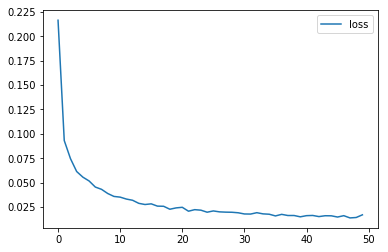

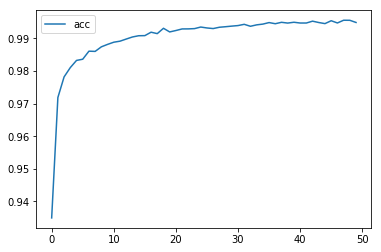

In [0]:
# plot training history
pyplot.plot(his.history['loss'], label='loss')
pyplot.legend()
pyplot.show()
pyplot.plot(his.history['acc'], label='acc')
pyplot.legend()
pyplot.show()

In [0]:
y_pred = model.predict(x_test)
print(y_pred.shape)
print(y_test.shape)
y = np.argmax(y_pred, axis=1)
print(y.shape)

(10000, 10)
(10000,)
(10000,)


In [0]:
confusion_matrix(y_test, y)

array([[ 976,    0,    0,    0,    0,    1,    2,    1,    0,    0],
       [   0, 1133,    0,    0,    0,    0,    1,    1,    0,    0],
       [   3,    2, 1018,    0,    2,    0,    1,    4,    2,    0],
       [   0,    0,    1, 1001,    0,    4,    0,    3,    1,    0],
       [   0,    0,    0,    0,  976,    0,    3,    0,    0,    3],
       [   1,    0,    0,    5,    0,  885,    1,    0,    0,    0],
       [   4,    2,    0,    0,    2,    2,  947,    0,    1,    0],
       [   0,    3,    2,    0,    0,    0,    0, 1021,    1,    1],
       [   2,    1,    3,    1,    0,    1,    1,    3,  961,    1],
       [   3,    0,    0,    0,    9,    3,    0,    3,    3,  988]])

Pred value: 5
True value: 3


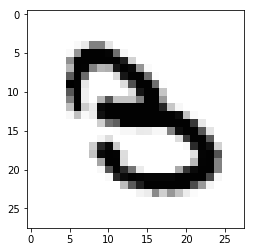

Pred value: 4
True value: 9


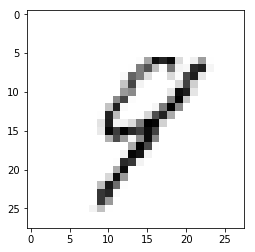

Pred value: 7
True value: 2


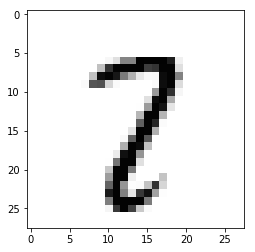

Pred value: 6
True value: 8


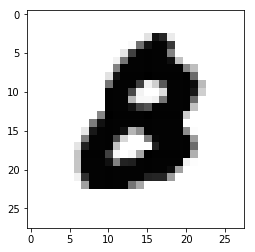

Pred value: 2
True value: 8


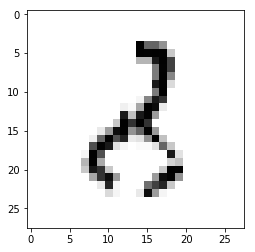

Pred value: 4
True value: 6


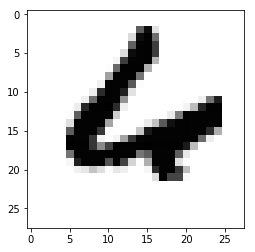

Pred value: 6
True value: 2


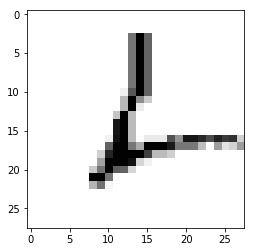

Pred value: 1
True value: 2


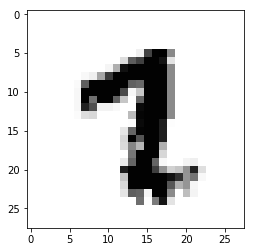

Pred value: 5
True value: 0


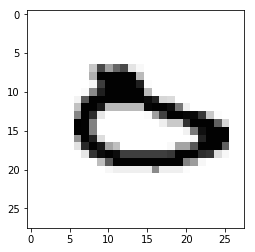

Pred value: 4
True value: 9


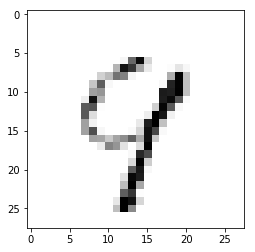

Pred value: 9
True value: 8


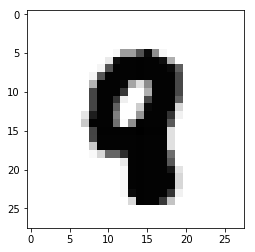

Pred value: 5
True value: 6


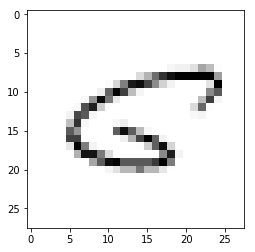

Pred value: 1
True value: 7


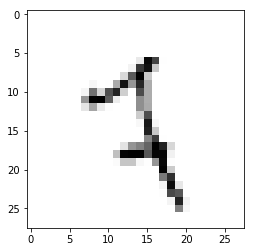

Pred value: 6
True value: 4


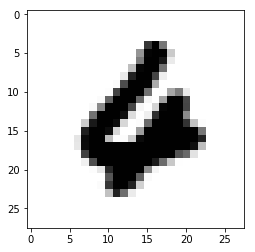

Pred value: 4
True value: 2


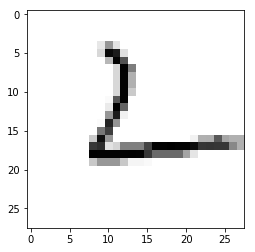

Pred value: 4
True value: 9


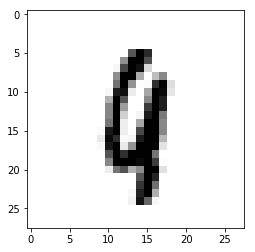

Pred value: 9
True value: 4


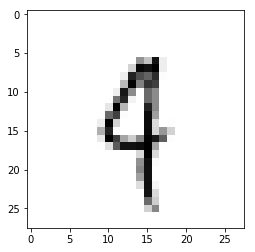

Pred value: 1
True value: 7


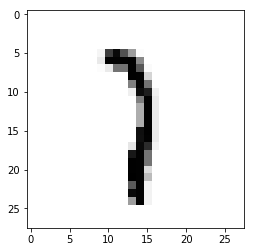

Pred value: 2
True value: 8


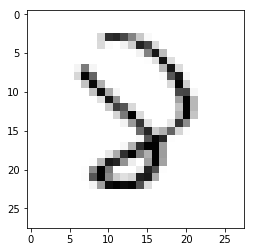

Pred value: 4
True value: 9


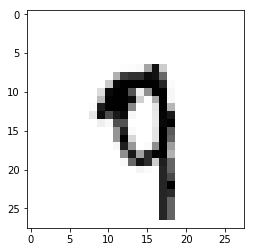

Pred value: 7
True value: 8


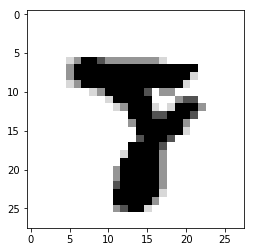

Pred value: 5
True value: 9


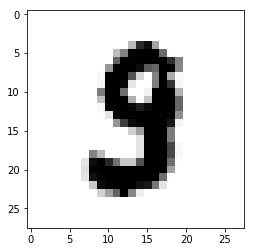

Pred value: 6
True value: 0


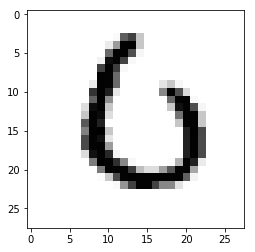

Pred value: 7
True value: 3


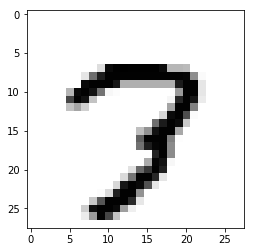

Pred value: 3
True value: 5


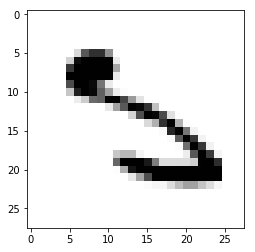

Pred value: 3
True value: 8


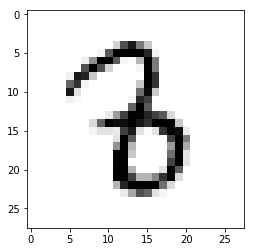

Pred value: 4
True value: 9


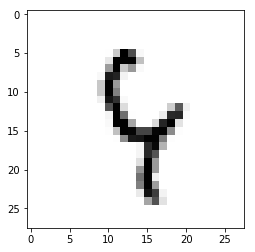

Pred value: 2
True value: 8


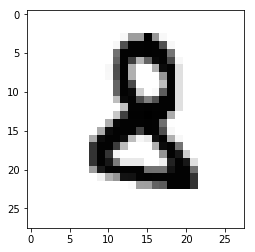

Pred value: 3
True value: 5


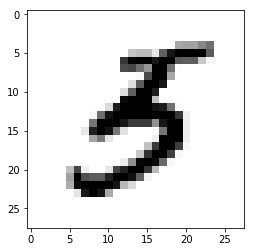

Pred value: 9
True value: 7


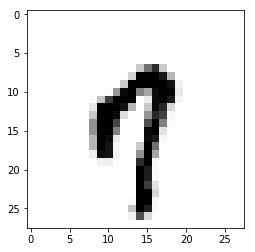

Pred value: 0
True value: 2


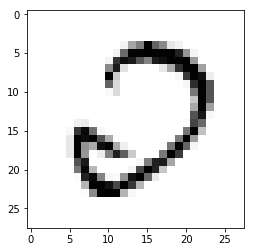

Pred value: 7
True value: 3


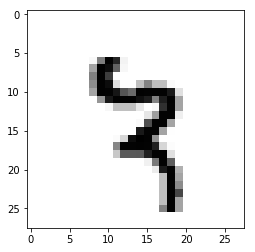

Pred value: 0
True value: 6


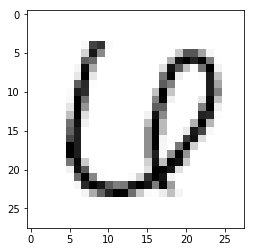

Pred value: 9
True value: 4


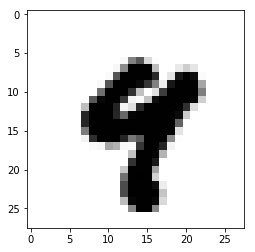

Pred value: 1
True value: 6


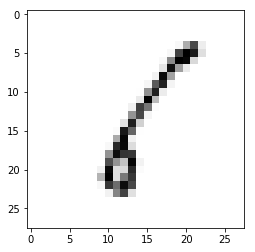

Pred value: 0
True value: 9


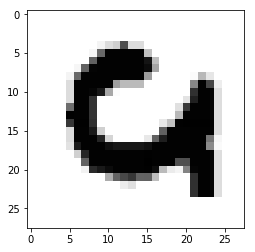

Pred value: 8
True value: 9


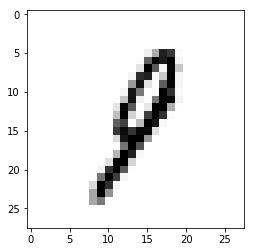

Pred value: 5
True value: 6


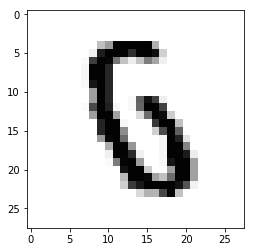

Pred value: 0
True value: 2


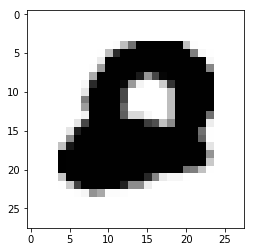

Pred value: 3
True value: 5


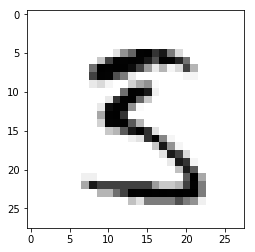

Pred value: 1
True value: 6


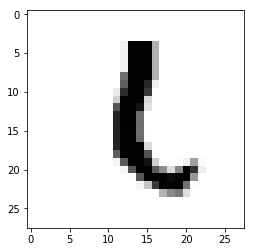

Pred value: 4
True value: 9


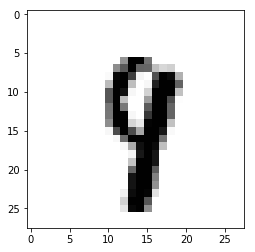

Pred value: 0
True value: 9


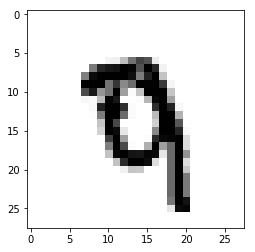

Pred value: 0
True value: 8


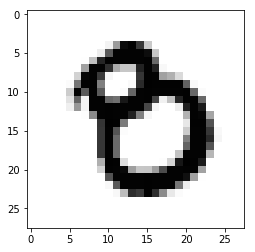

Pred value: 2
True value: 3


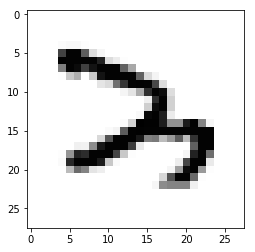

Pred value: 5
True value: 9


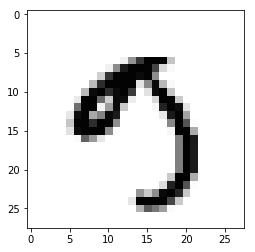

Pred value: 5
True value: 3


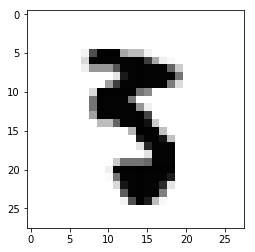

Pred value: 8
True value: 9


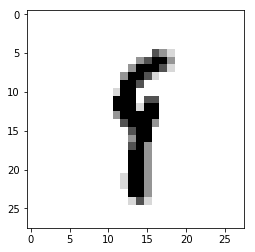

Pred value: 7
True value: 9


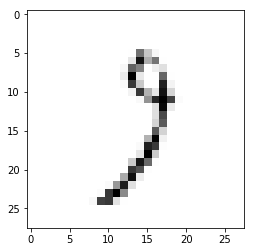

Pred value: 0
True value: 6


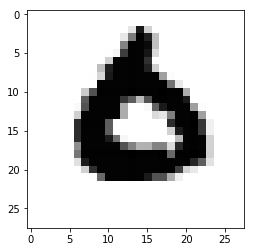

Pred value: 4
True value: 6


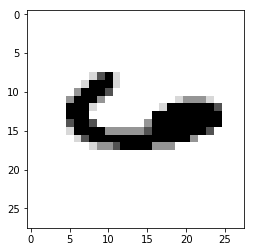

Pred value: 3
True value: 5


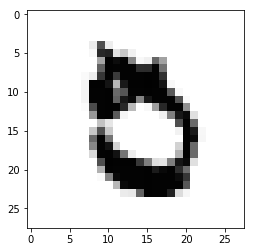

Pred value: 5
True value: 8


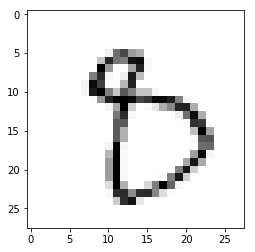

Pred value: 8
True value: 2


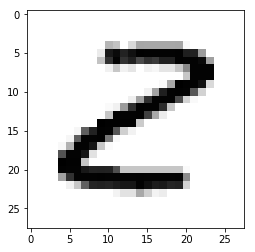

Pred value: 8
True value: 6


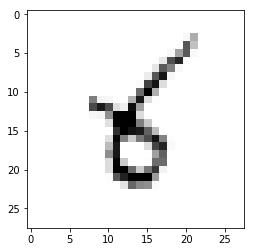

Pred value: 0
True value: 5


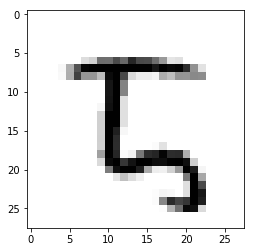

Pred value: 6
True value: 4


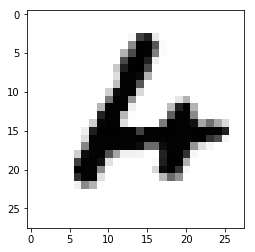

Pred value: 8
True value: 7


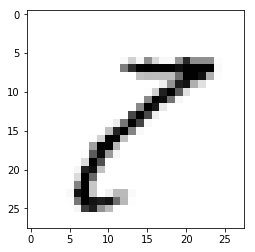

Pred value: 0
True value: 6


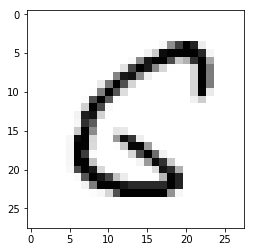

Pred value: 6
True value: 4


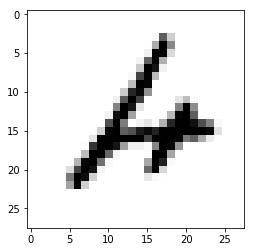

Pred value: 7
True value: 2


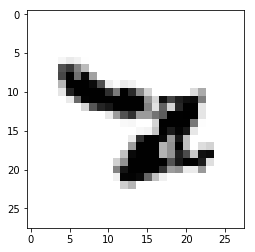

Pred value: 7
True value: 1


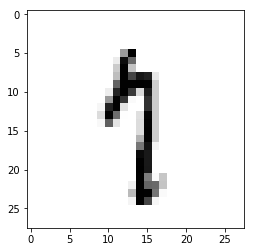

Pred value: 0
True value: 2


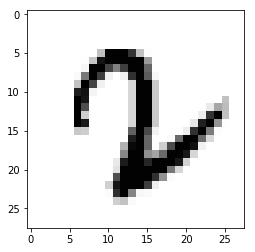

Pred value: 8
True value: 2


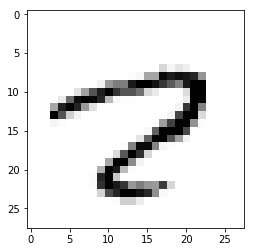

Pred value: 4
True value: 9


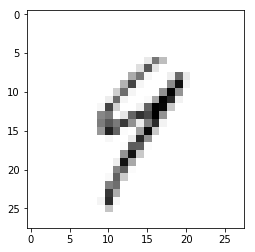

Pred value: 7
True value: 8


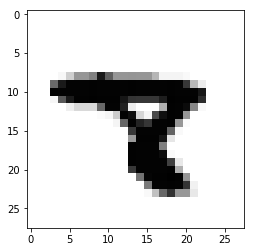

Pred value: 7
True value: 8


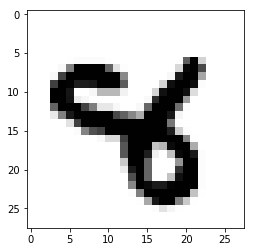

Pred value: 5
True value: 3


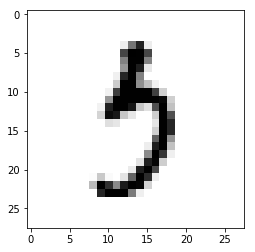

Pred value: 8
True value: 9


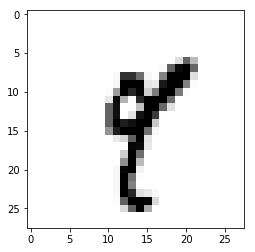

Pred value: 0
True value: 8


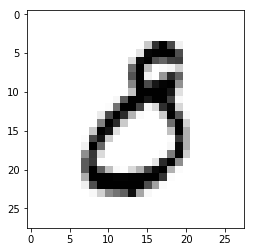

Pred value: 0
True value: 6


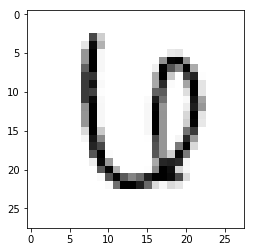

Pred value: 4
True value: 9


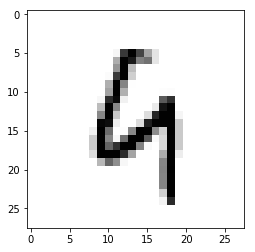

Pred value: 4
True value: 2


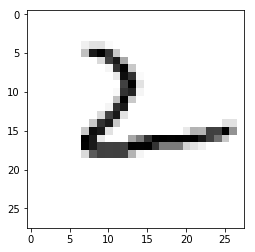

Pred value: 6
True value: 1


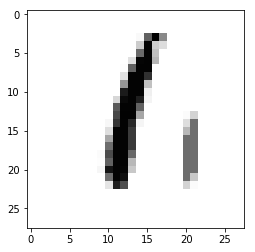

Pred value: 3
True value: 5


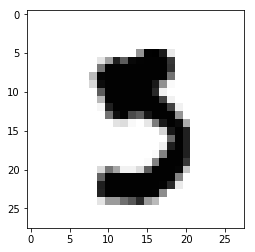

Pred value: 8
True value: 3


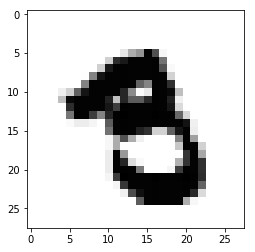

Pred value: 0
True value: 9


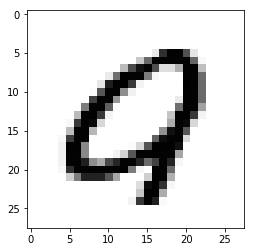

Pred value: 5
True value: 9


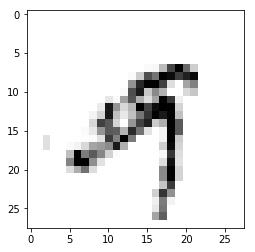

Pred value: 1
True value: 7


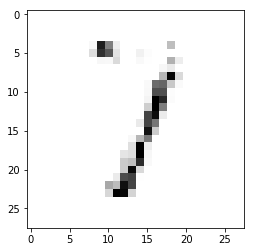

Pred value: 7
True value: 0


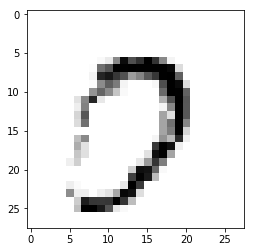

Pred value: 1
True value: 8


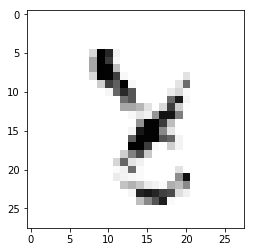

Pred value: 6
True value: 0


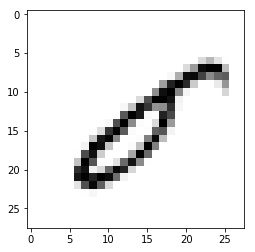

Pred value: 1
True value: 2


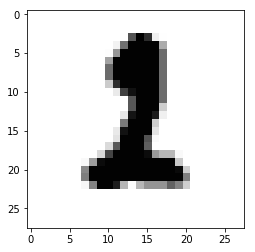

Pred value: 5
True value: 3


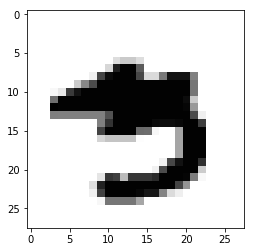

Pred value: 9
True value: 4


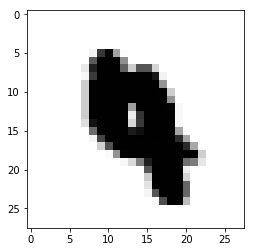

Pred value: 2
True value: 7


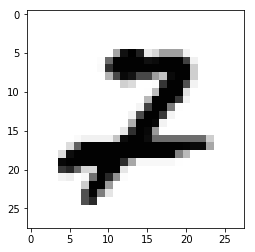

Pred value: 2
True value: 7


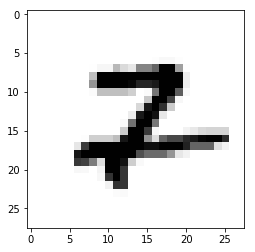

Pred value: 7
True value: 9


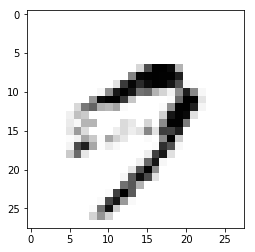

Pred value: 7
True value: 2


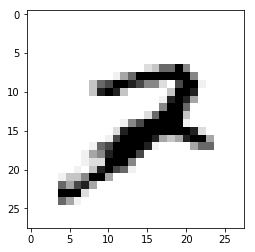

Pred value: 7
True value: 9


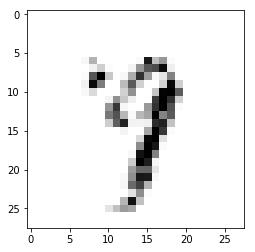

Pred value: 6
True value: 5


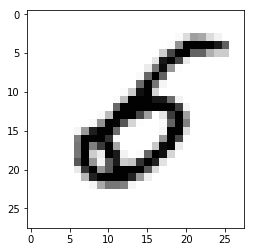

Pred value: 7
True value: 2


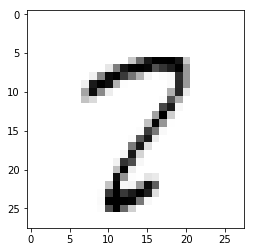

Pred value: 4
True value: 9


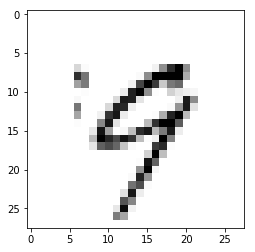

Pred value: 7
True value: 3


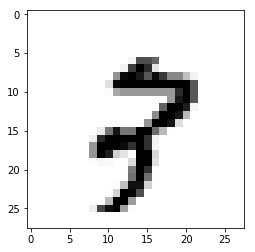

In [0]:
for i in range(10000):
    if(y[i] != y_test[i]):
        print("Pred value:",y[i])
        print("True value:",y_test[i])
        plt.figure
        plt.imshow(x_test[i].reshape(28, 28),cmap='Greys')
        plt.show()

Pred value: 8
True value: 3


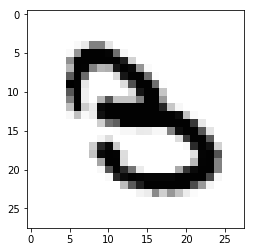

Pred value: 7
True value: 2


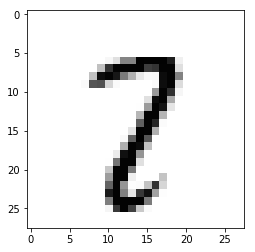

Pred value: 3
True value: 5


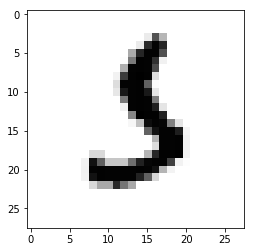

Pred value: 0
True value: 6


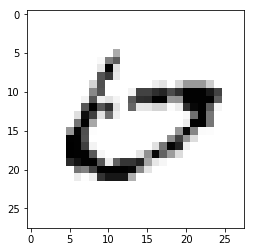

Pred value: 0
True value: 8


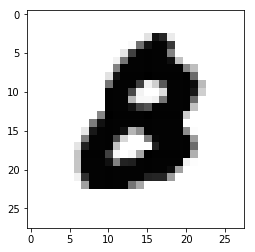

Pred value: 7
True value: 2


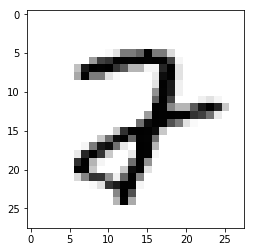

Pred value: 1
True value: 2


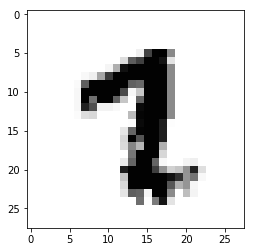

Pred value: 7
True value: 1


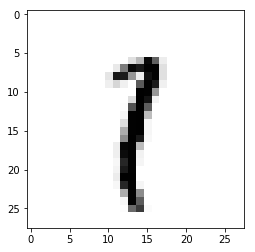

Pred value: 8
True value: 5


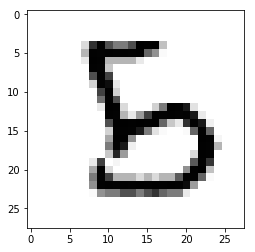

Pred value: 9
True value: 4


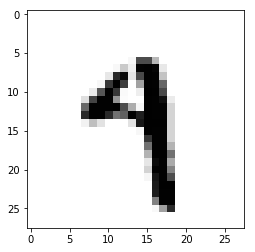

Pred value: 3
True value: 8


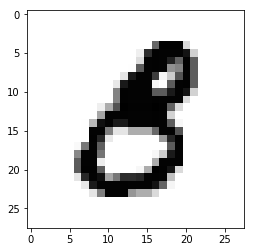

Pred value: 7
True value: 9


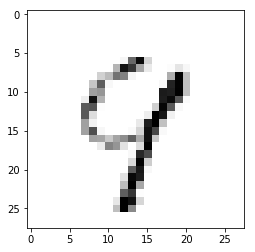

Pred value: 5
True value: 3


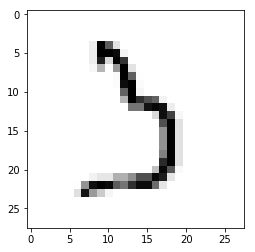

Pred value: 7
True value: 2


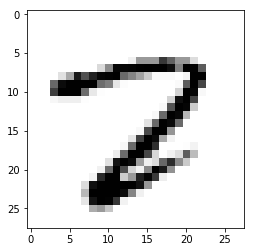

Pred value: 9
True value: 8


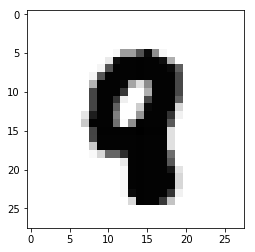

Pred value: 2
True value: 1


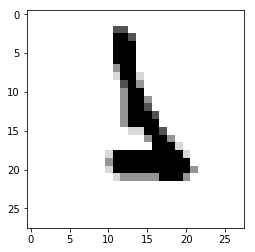

Pred value: 5
True value: 6


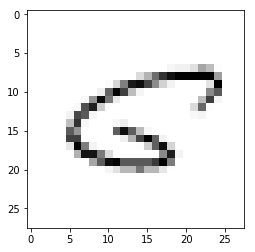

Pred value: 9
True value: 5


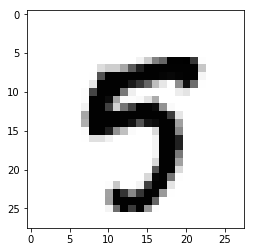

Pred value: 4
True value: 7


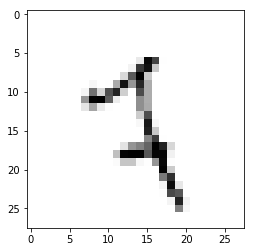

Pred value: 2
True value: 7


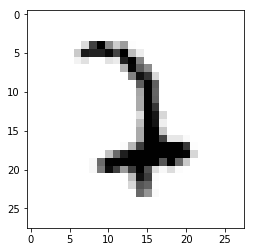

Pred value: 4
True value: 9


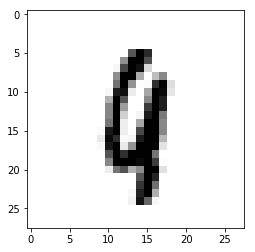

Pred value: 2
True value: 9


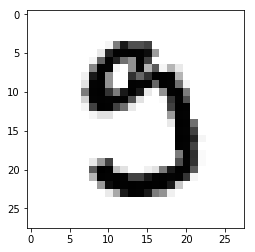

Pred value: 1
True value: 7


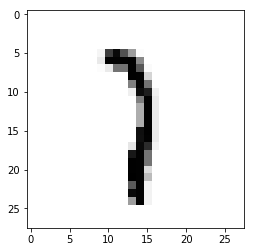

Pred value: 7
True value: 5


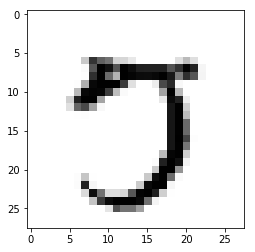

Pred value: 0
True value: 8


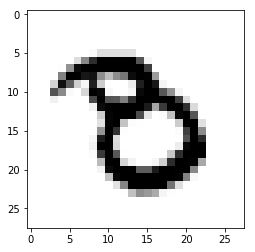

Pred value: 6
True value: 5


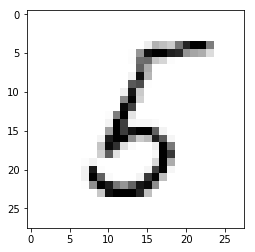

Pred value: 7
True value: 9


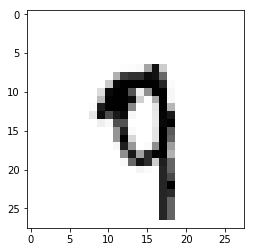

Pred value: 7
True value: 2


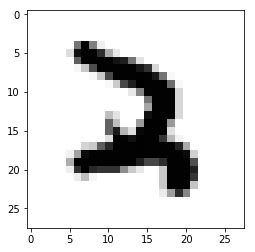

Pred value: 7
True value: 8


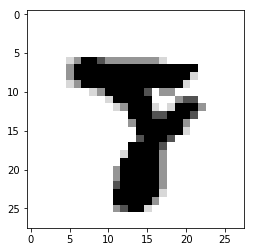

Pred value: 3
True value: 9


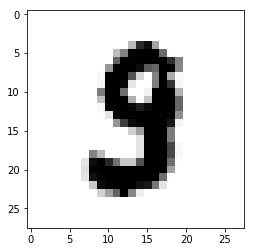

Pred value: 6
True value: 5


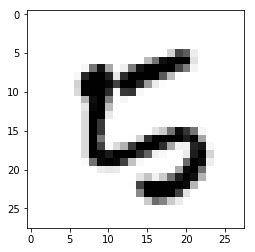

Pred value: 7
True value: 2


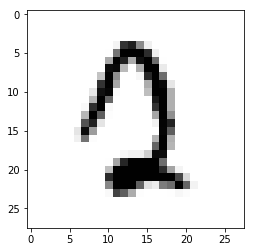

Pred value: 7
True value: 3


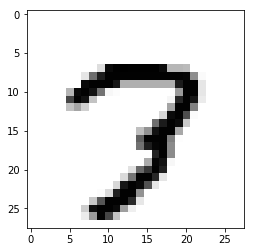

Pred value: 3
True value: 9


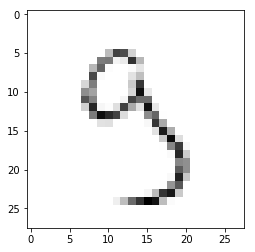

Pred value: 0
True value: 8


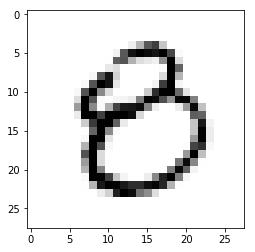

Pred value: 3
True value: 7


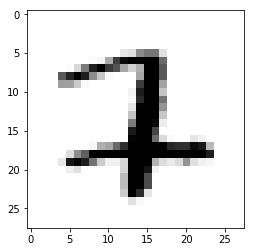

Pred value: 7
True value: 2


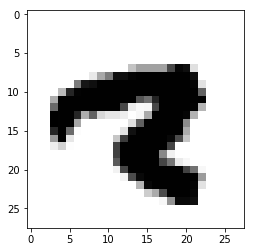

Pred value: 3
True value: 8


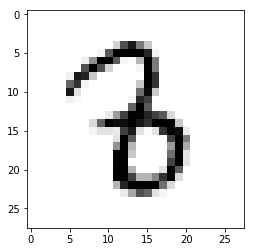

Pred value: 4
True value: 9


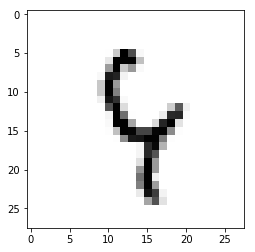

Pred value: 2
True value: 8


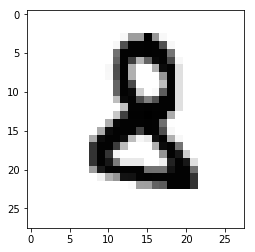

Pred value: 3
True value: 5


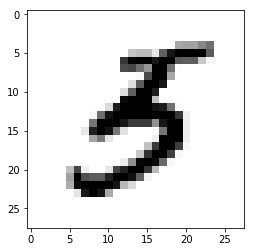

Pred value: 6
True value: 5


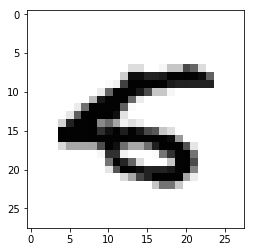

Pred value: 8
True value: 4


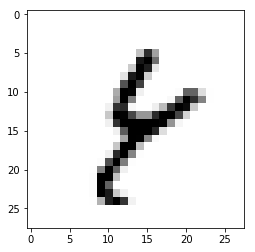

Pred value: 7
True value: 2


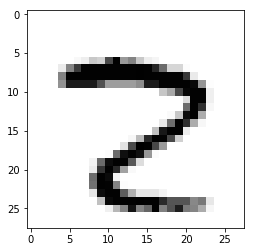

Pred value: 9
True value: 4


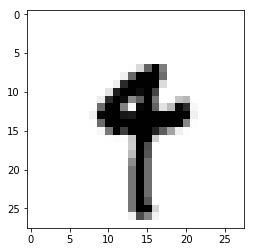

Pred value: 9
True value: 7


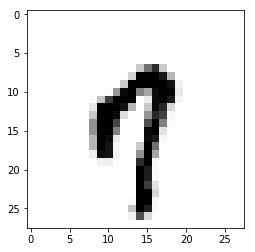

Pred value: 7
True value: 3


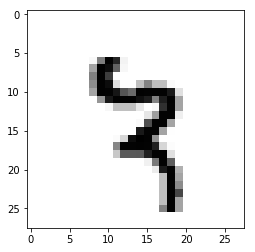

Pred value: 0
True value: 6


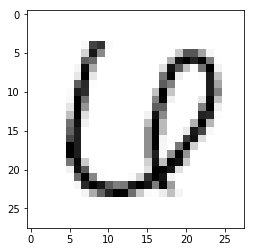

Pred value: 8
True value: 9


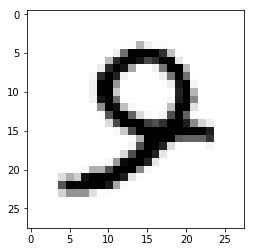

Pred value: 9
True value: 4


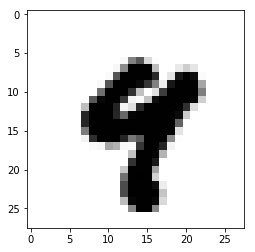

Pred value: 1
True value: 6


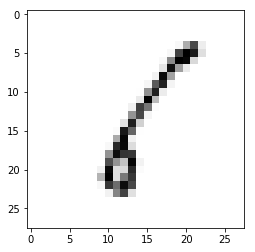

Pred value: 2
True value: 1


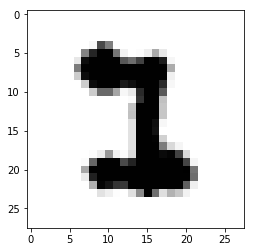

Pred value: 0
True value: 9


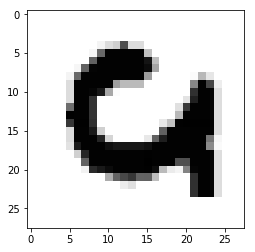

Pred value: 2
True value: 0


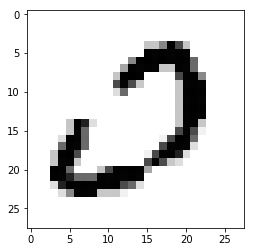

Pred value: 8
True value: 5


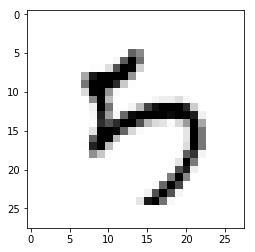

Pred value: 1
True value: 9


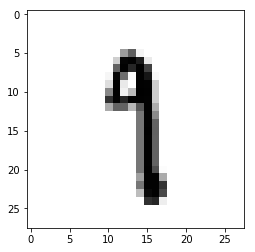

Pred value: 4
True value: 9


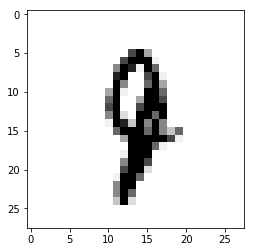

Pred value: 0
True value: 2


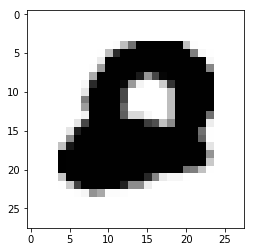

Pred value: 4
True value: 2


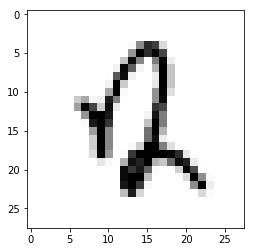

Pred value: 8
True value: 3


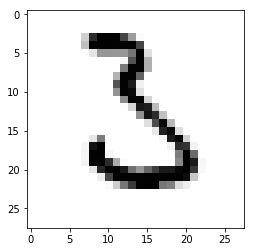

Pred value: 3
True value: 5


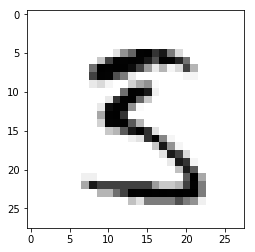

Pred value: 1
True value: 6


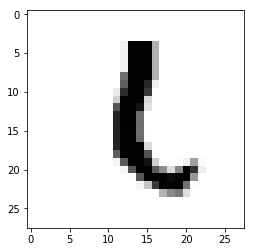

Pred value: 8
True value: 0


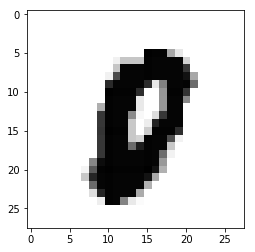

Pred value: 4
True value: 9


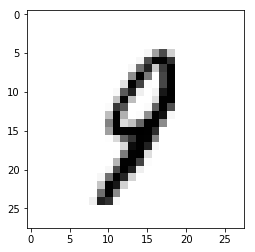

Pred value: 7
True value: 3


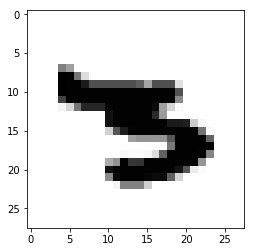

Pred value: 0
True value: 8


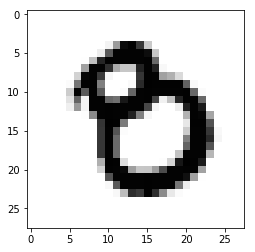

Pred value: 7
True value: 3


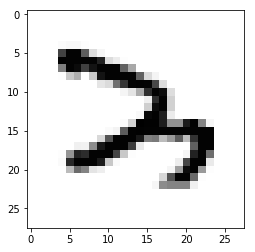

Pred value: 5
True value: 9


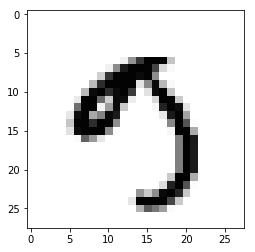

Pred value: 5
True value: 3


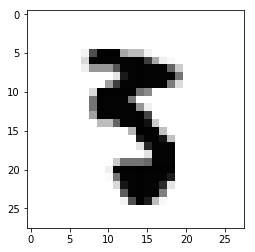

Pred value: 7
True value: 9


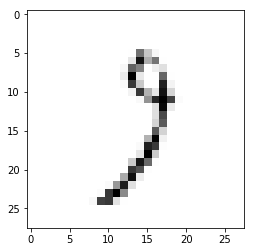

Pred value: 2
True value: 1


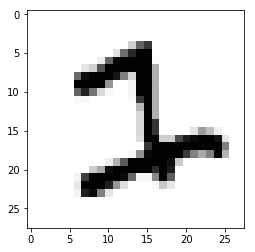

Pred value: 3
True value: 5


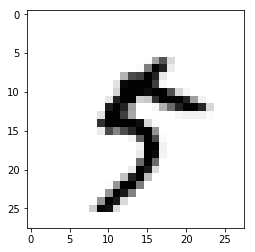

Pred value: 8
True value: 2


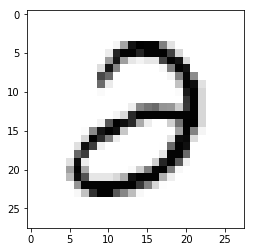

Pred value: 7
True value: 5


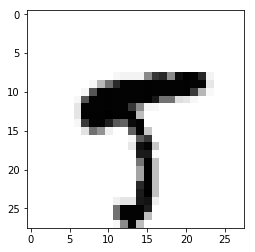

Pred value: 0
True value: 6


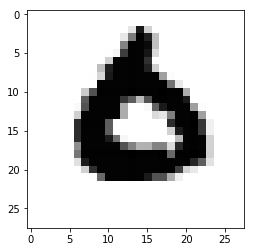

Pred value: 1
True value: 2


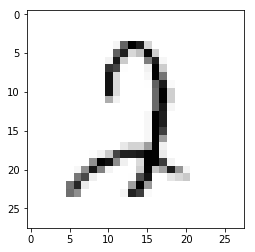

Pred value: 1
True value: 9


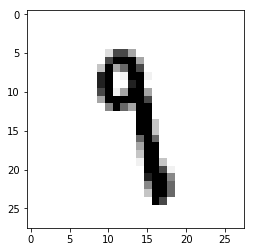

Pred value: 4
True value: 6


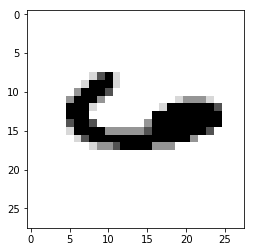

Pred value: 0
True value: 5


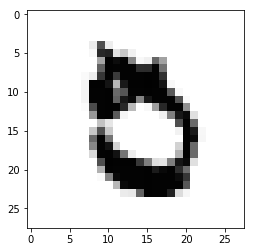

Pred value: 5
True value: 8


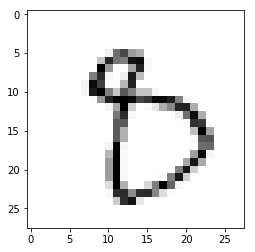

Pred value: 3
True value: 9


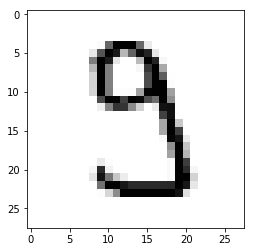

Pred value: 6
True value: 8


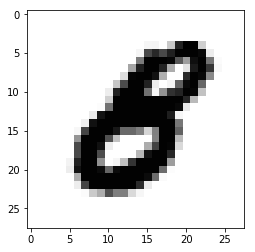

Pred value: 3
True value: 2


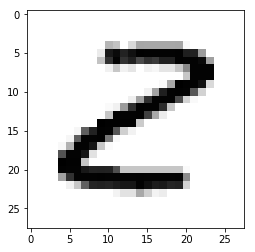

Pred value: 2
True value: 5


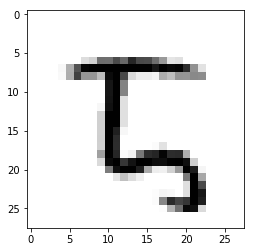

Pred value: 4
True value: 9


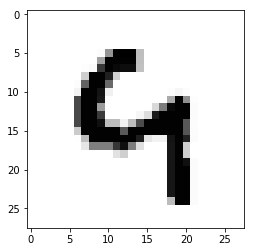

Pred value: 4
True value: 9


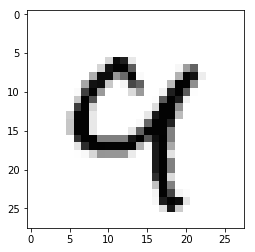

Pred value: 3
True value: 1


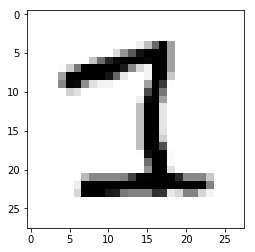

Pred value: 6
True value: 4


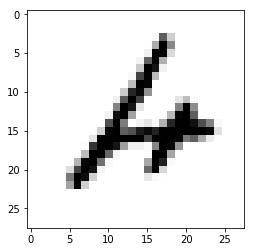

Pred value: 4
True value: 9


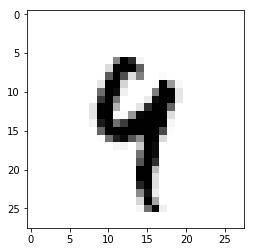

Pred value: 0
True value: 8


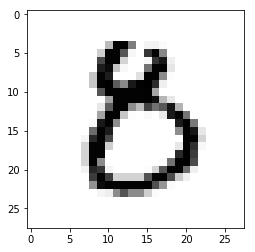

Pred value: 0
True value: 9


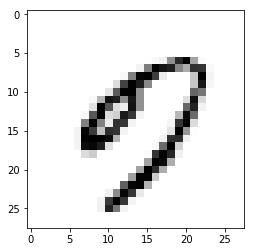

Pred value: 7
True value: 2


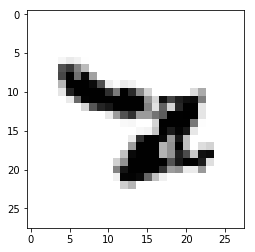

Pred value: 7
True value: 1


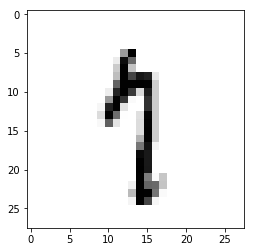

Pred value: 4
True value: 9


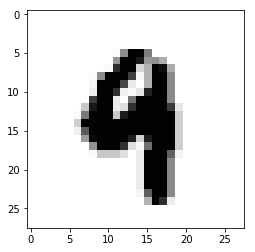

Pred value: 7
True value: 8


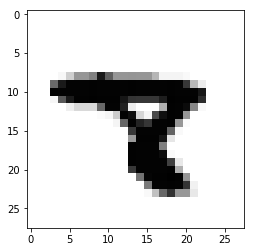

Pred value: 1
True value: 9


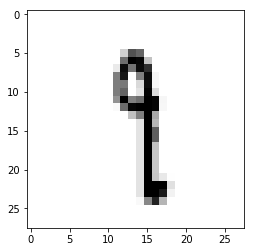

Pred value: 4
True value: 8


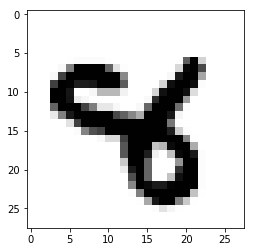

Pred value: 7
True value: 8


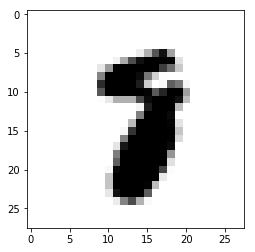

Pred value: 4
True value: 9


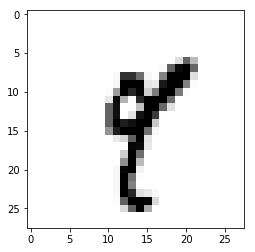

Pred value: 0
True value: 8


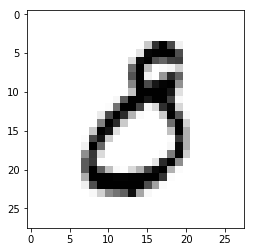

Pred value: 0
True value: 6


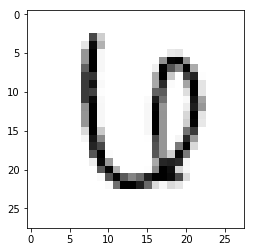

Pred value: 4
True value: 9


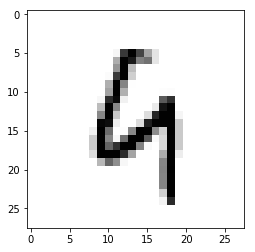

Pred value: 1
True value: 7


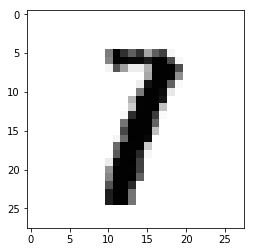

Pred value: 4
True value: 8


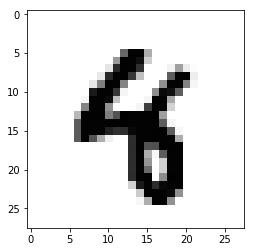

Pred value: 6
True value: 1


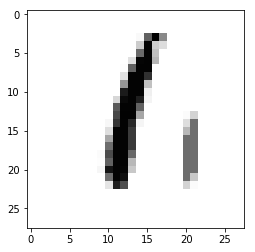

Pred value: 7
True value: 3


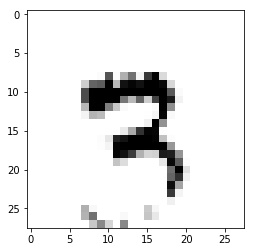

Pred value: 8
True value: 3


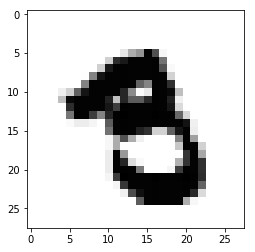

Pred value: 8
True value: 3


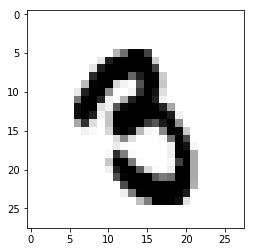

Pred value: 9
True value: 5


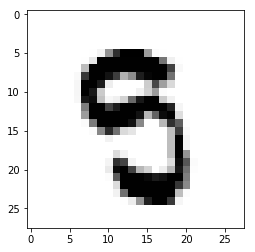

Pred value: 8
True value: 3


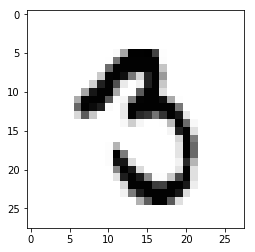

Pred value: 5
True value: 9


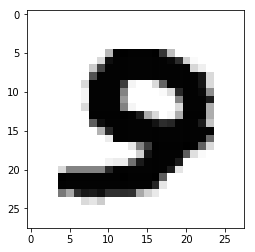

Pred value: 5
True value: 9


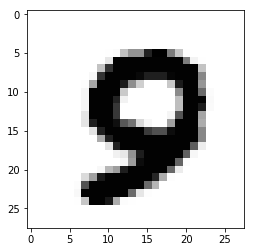

Pred value: 5
True value: 9


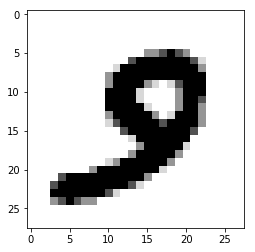

Pred value: 8
True value: 9


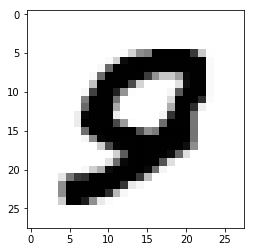

Pred value: 6
True value: 0


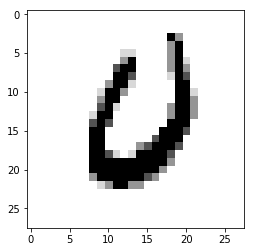

Pred value: 0
True value: 9


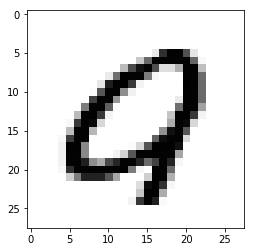

Pred value: 2
True value: 6


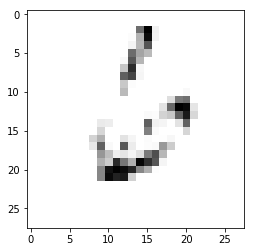

Pred value: 8
True value: 9


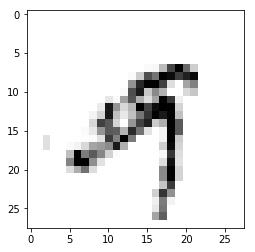

Pred value: 7
True value: 9


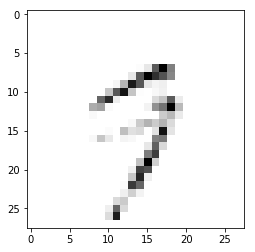

Pred value: 6
True value: 2


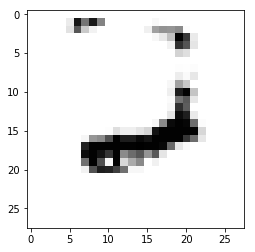

Pred value: 1
True value: 7


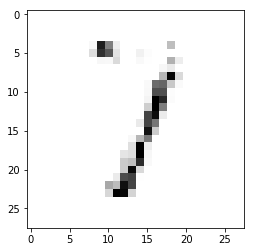

Pred value: 7
True value: 0


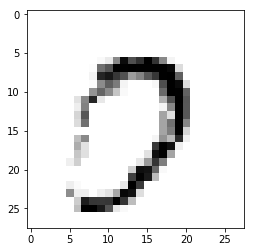

Pred value: 2
True value: 0


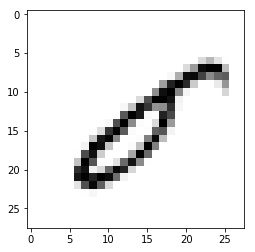

Pred value: 9
True value: 8


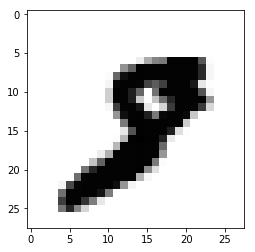

Pred value: 4
True value: 6


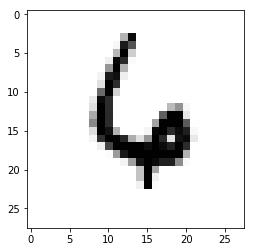

Pred value: 0
True value: 8


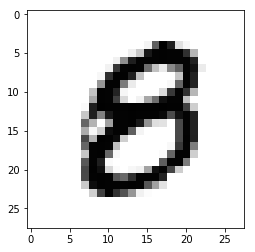

Pred value: 1
True value: 2


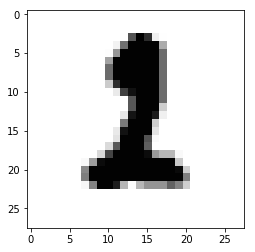

Pred value: 8
True value: 2


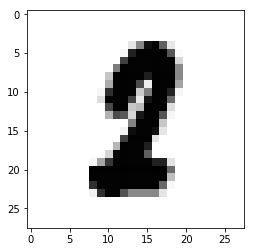

Pred value: 9
True value: 3


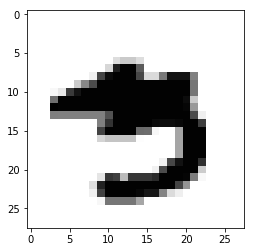

Pred value: 5
True value: 8


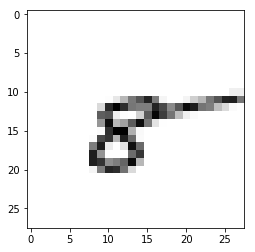

Pred value: 2
True value: 7


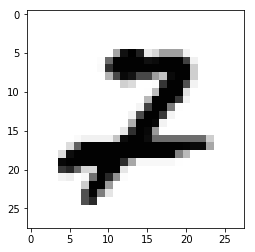

Pred value: 2
True value: 7


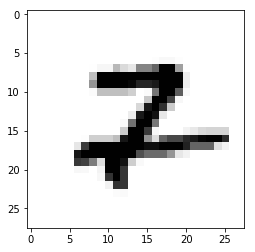

Pred value: 2
True value: 7


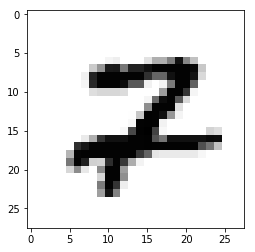

Pred value: 2
True value: 0


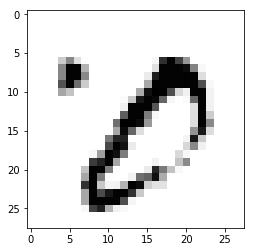

Pred value: 7
True value: 9


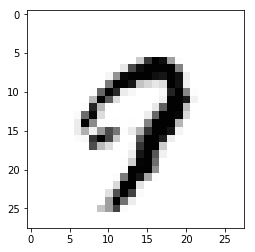

Pred value: 7
True value: 9


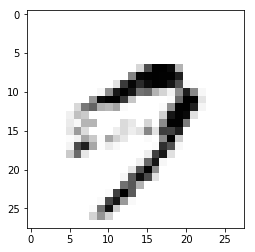

Pred value: 7
True value: 2


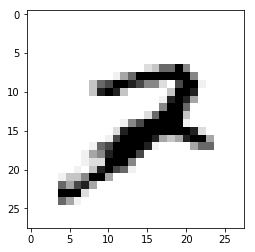

Pred value: 3
True value: 6


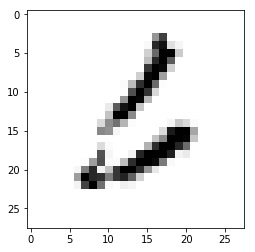

Pred value: 5
True value: 6


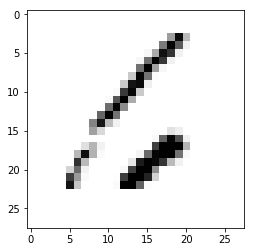

Pred value: 6
True value: 5


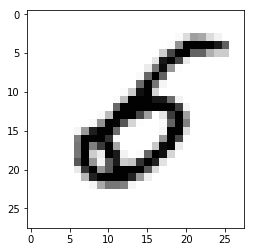

Pred value: 6
True value: 5


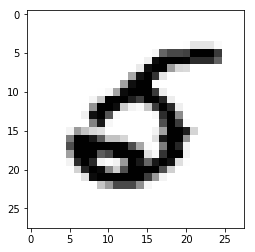

Pred value: 0
True value: 5


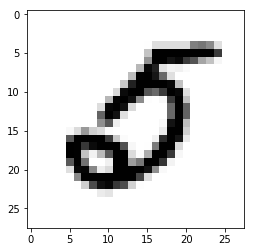

Pred value: 7
True value: 2


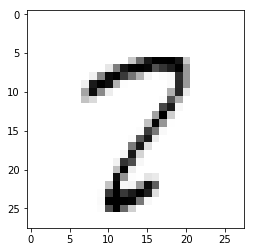

In [0]:
for i in range(10000):
    if(y[i] != y_test[i]):
        print("Pred value:",y[i])
        print("True value:",y_test[i])
        plt.figure
        plt.imshow(x_test[i].reshape(28, 28),cmap='Greys')
        plt.show()

x_train shape: (60000, 28, 28, 1)
Number of images in x_train 60000
Number of images in x_test 10000
Epoch 1/50
60000/60000 [==============================] - 81s 1ms/step - loss: 5.3270 - acc: 0.6629
Epoch 2/50
60000/60000 [==============================] - 81s 1ms/step - loss: 3.6602 - acc: 0.7714
Epoch 3/50
60000/60000 [==============================] - 82s 1ms/step - loss: 3.7194 - acc: 0.7686
Epoch 4/50
60000/60000 [==============================] - 83s 1ms/step - loss: 3.7745 - acc: 0.7654
Epoch 5/50
60000/60000 [==============================] - 83s 1ms/step - loss: 3.8410 - acc: 0.7614
Epoch 6/50
60000/60000 [==============================] - 82s 1ms/step - loss: 3.8250 - acc: 0.7625
Epoch 7/50
60000/60000 [==============================] - 81s 1ms/step - loss: 3.6976 - acc: 0.7705
Epoch 8/50
60000/60000 [==============================] - 81s 1ms/step - loss: 4.2048 - acc: 0.7390
Epoch 9/50
60000/60000 [==============================] - 81s 1ms/step - loss: 4.3187 - acc: 0.7320

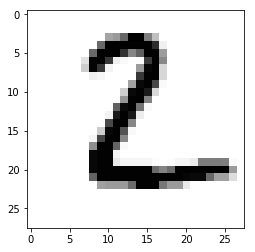

Pred value: 6
True value: 0


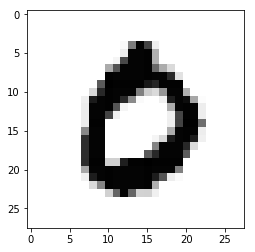

Pred value: 7
True value: 4


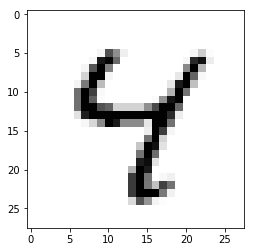

Pred value: 4
True value: 9


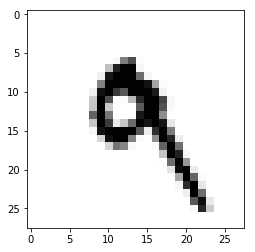

Pred value: 6
True value: 5


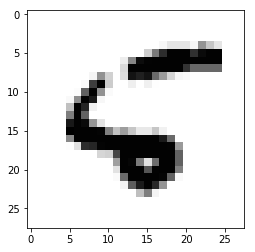

Pred value: 4
True value: 9


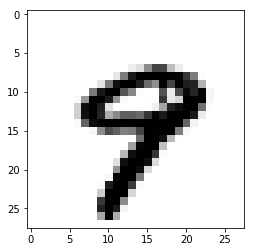

Pred value: 4
True value: 9


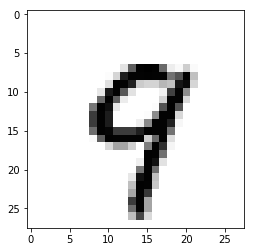

Pred value: 3
True value: 5


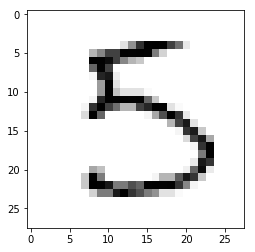

Pred value: 4
True value: 9


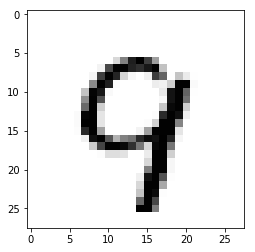

Pred value: 7
True value: 9


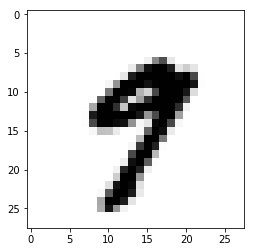

Pred value: 6
True value: 0


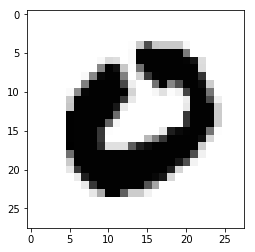

Pred value: 6
True value: 4


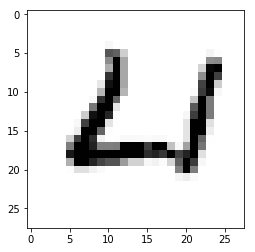

Pred value: 6
True value: 2


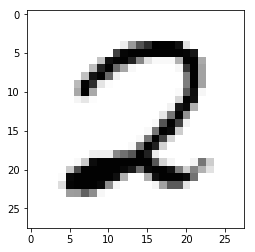

Pred value: 4
True value: 2


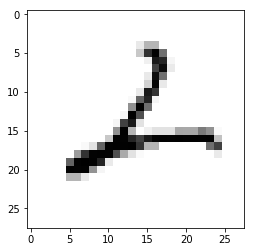

Pred value: 4
True value: 9


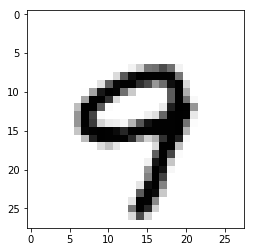

Pred value: 6
True value: 8


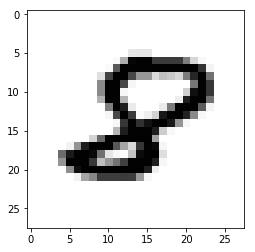

Pred value: 5
True value: 9


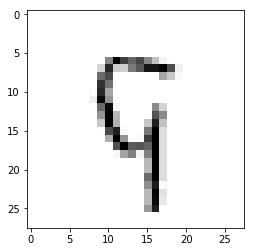

Pred value: 2
True value: 3


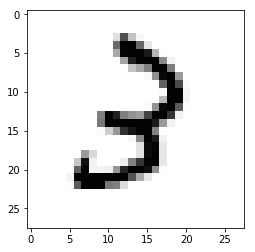

Pred value: 6
True value: 0


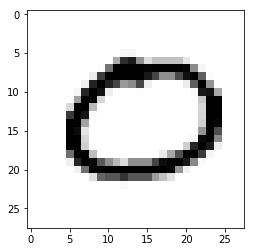

Pred value: 6
True value: 0


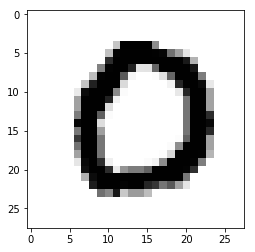

Pred value: 1
True value: 9


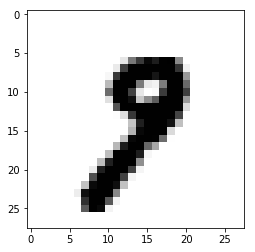

Pred value: 4
True value: 9


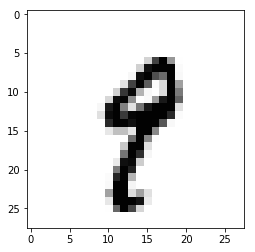

Pred value: 5
True value: 8


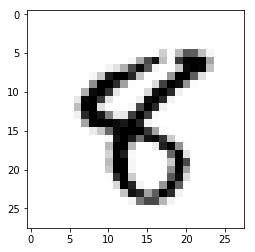

Pred value: 4
True value: 9


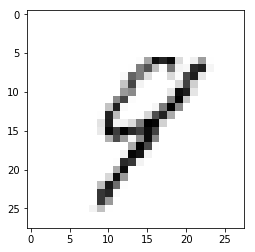

Pred value: 1
True value: 7


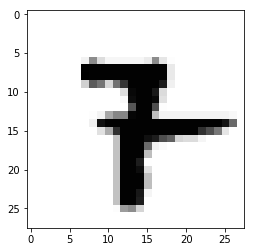

Pred value: 4
True value: 9


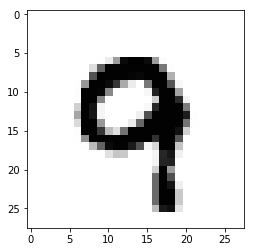

Pred value: 4
True value: 9


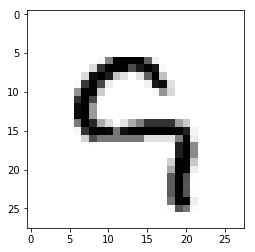

Pred value: 4
True value: 9


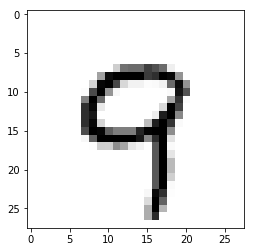

Pred value: 7
True value: 9


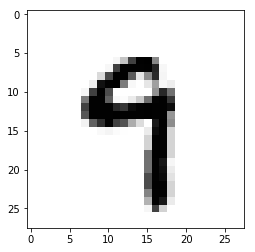

Pred value: 6
True value: 8


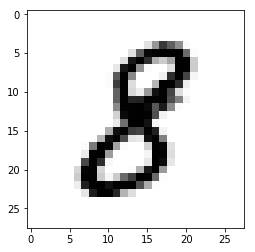

Pred value: 1
True value: 7


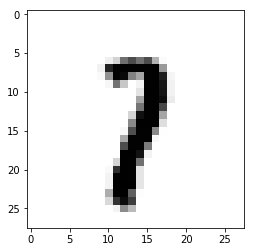

Pred value: 4
True value: 9


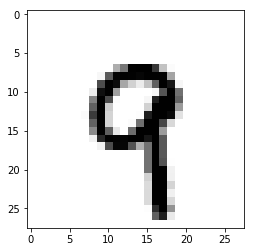

Pred value: 4
True value: 7


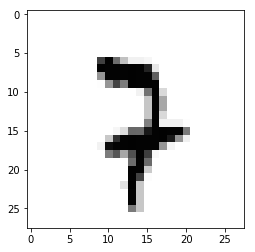

Pred value: 4
True value: 9


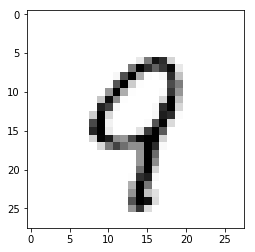

Pred value: 7
True value: 2


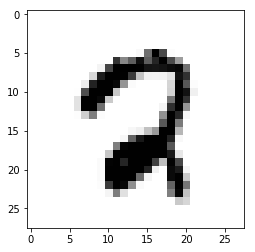

Pred value: 4
True value: 9


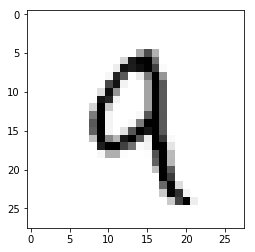

Pred value: 6
True value: 0


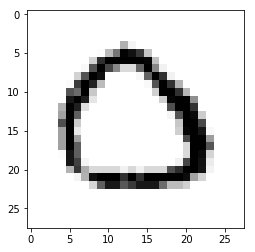

Pred value: 5
True value: 8


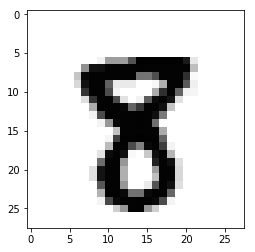

Pred value: 6
True value: 5


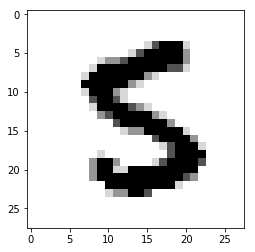

Pred value: 5
True value: 8


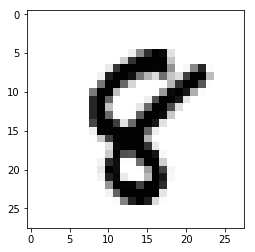

Pred value: 6
True value: 2


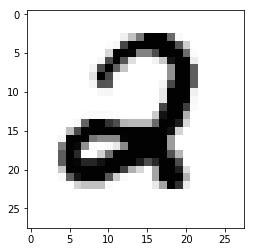

Pred value: 4
True value: 2


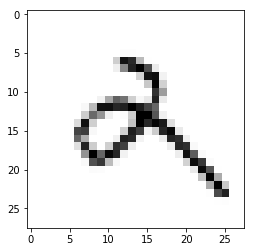

Pred value: 4
True value: 9


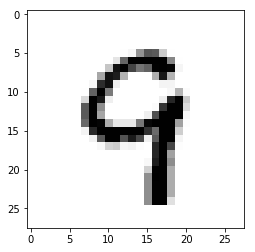

Pred value: 4
True value: 9


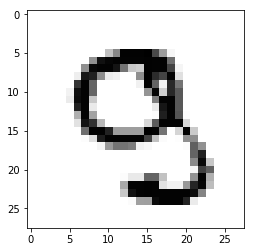

Pred value: 6
True value: 0


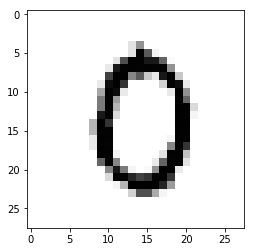

Pred value: 4
True value: 5


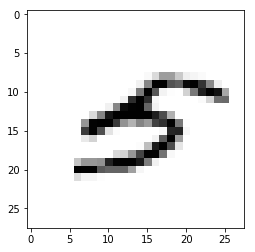

Pred value: 3
True value: 2


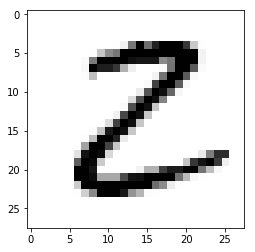

Pred value: 5
True value: 8


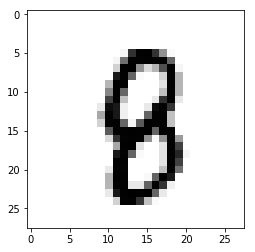

Pred value: 1
True value: 8


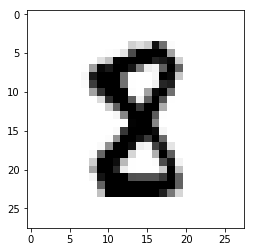

Pred value: 6
True value: 8


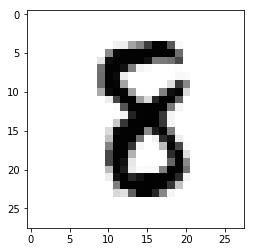

Pred value: 6
True value: 0


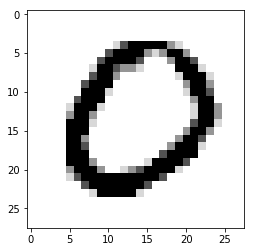

Pred value: 6
True value: 8


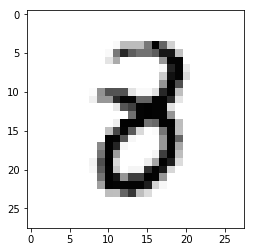

Pred value: 4
True value: 9


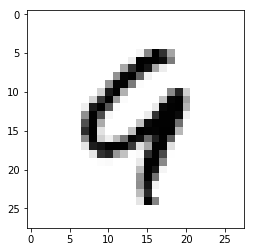

Pred value: 6
True value: 0


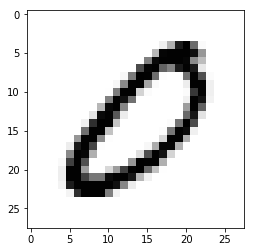

Pred value: 4
True value: 9


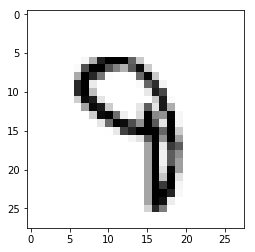

Pred value: 2
True value: 3


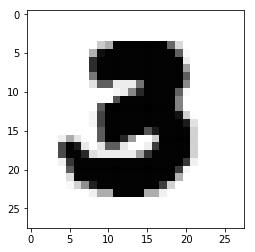

Pred value: 5
True value: 9


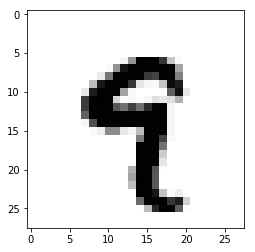

Pred value: 6
True value: 2


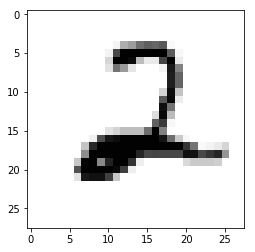

Pred value: 4
True value: 9


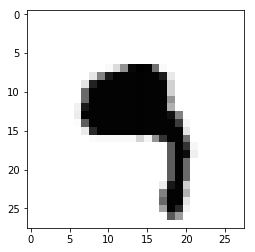

Pred value: 4
True value: 9


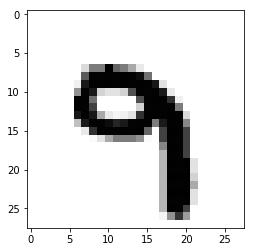

Pred value: 4
True value: 9


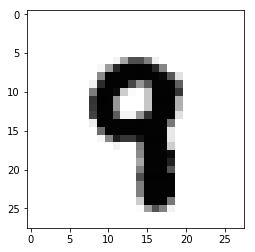

Pred value: 6
True value: 0


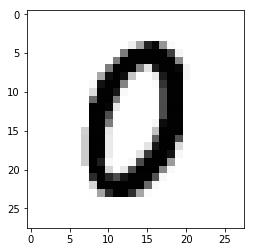

Pred value: 5
True value: 6


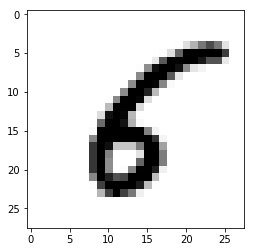

Pred value: 3
True value: 2


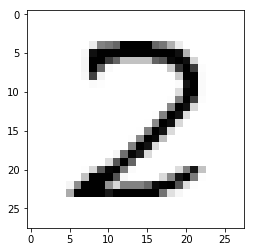

Pred value: 7
True value: 8


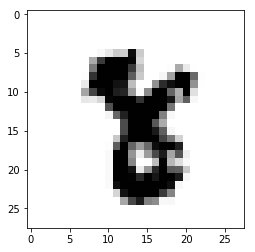

Pred value: 6
True value: 3


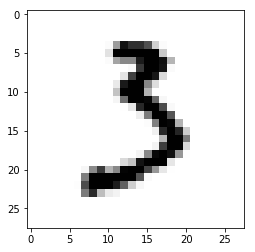

Pred value: 6
True value: 8


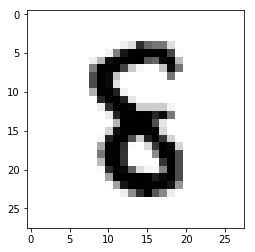

Pred value: 7
True value: 8


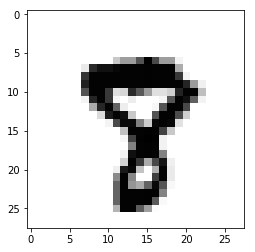

Pred value: 4
True value: 9


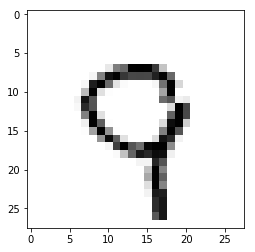

Pred value: 5
True value: 9


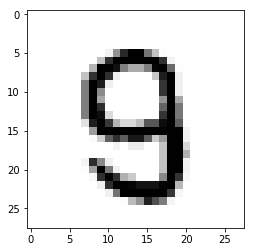

Pred value: 6
True value: 8


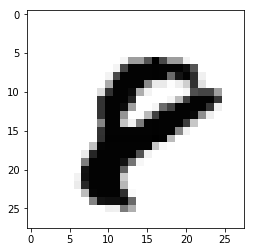

Pred value: 3
True value: 7


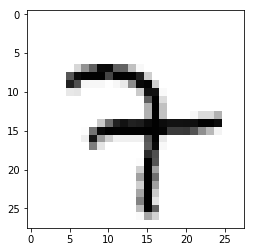

Pred value: 6
True value: 0


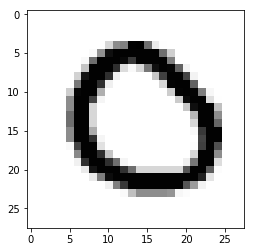

Pred value: 6
True value: 2


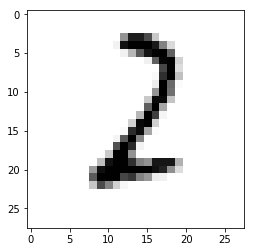

Pred value: 4
True value: 9


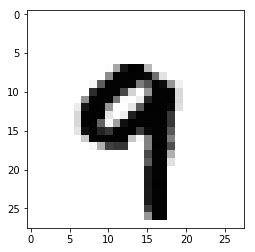

Pred value: 1
True value: 8


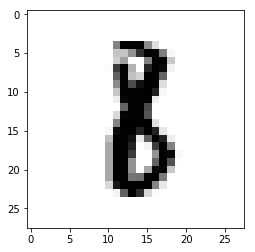

Pred value: 5
True value: 8


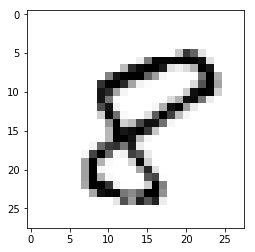

Pred value: 4
True value: 9


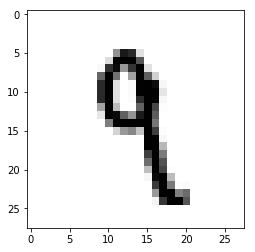

Pred value: 6
True value: 8


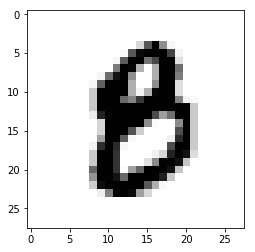

Pred value: 3
True value: 8


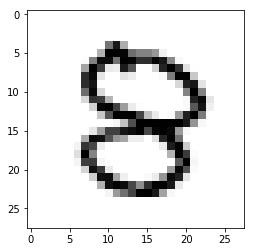

Pred value: 6
True value: 0


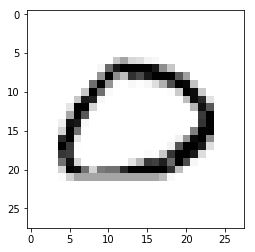

Pred value: 6
True value: 0


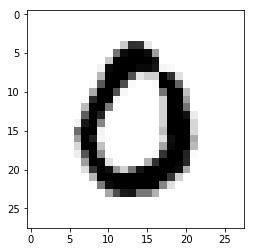

Pred value: 4
True value: 9


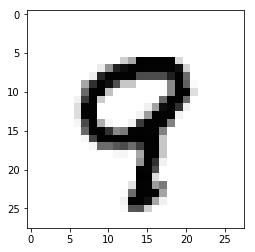

Pred value: 4
True value: 9


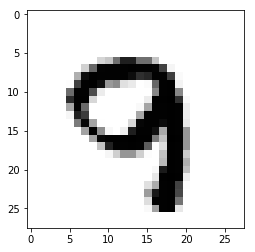

Pred value: 7
True value: 8


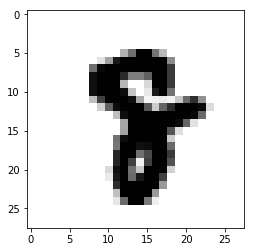

Pred value: 6
True value: 2


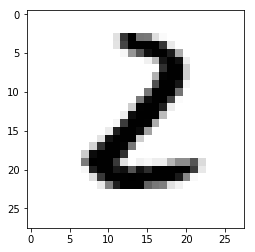

Pred value: 4
True value: 9


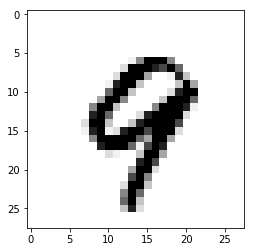

Pred value: 1
True value: 7


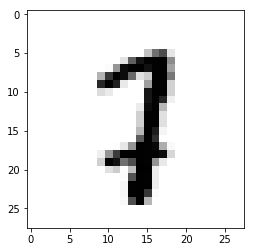

Pred value: 4
True value: 9


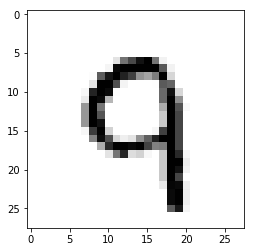

Pred value: 6
True value: 5


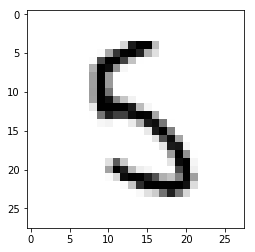

Pred value: 4
True value: 8


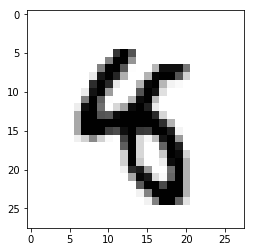

Pred value: 6
True value: 2


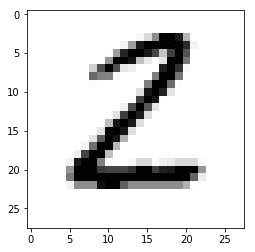

Pred value: 4
True value: 9


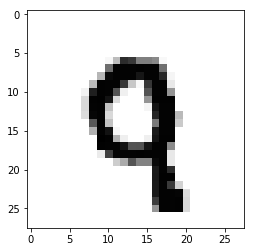

Pred value: 6
True value: 0


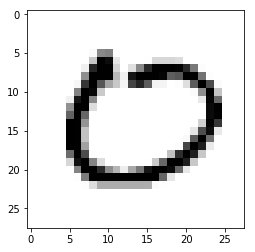

Pred value: 6
True value: 2


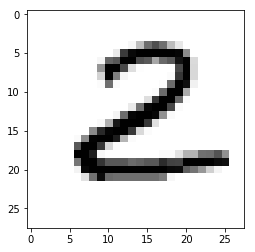

Pred value: 3
True value: 8


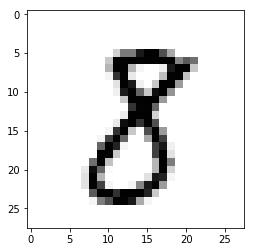

Pred value: 4
True value: 7


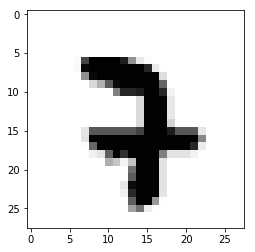

Pred value: 5
True value: 0


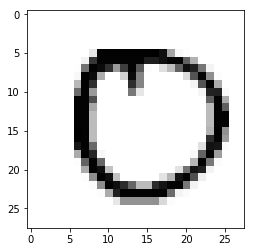

Pred value: 4
True value: 7


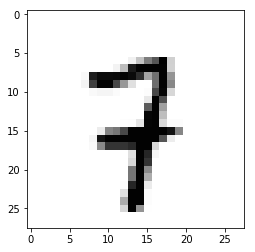

Pred value: 6
True value: 0


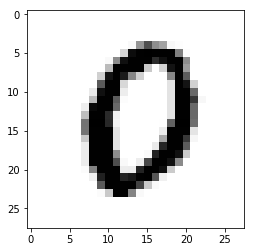

Pred value: 4
True value: 9


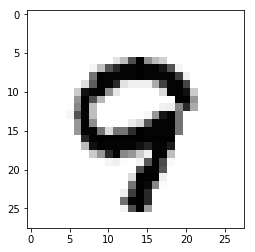

Pred value: 4
True value: 5


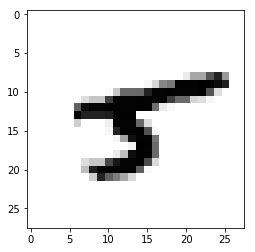

Pred value: 3
True value: 2


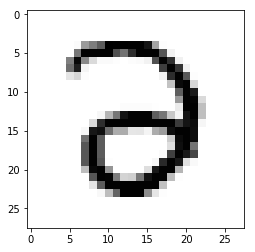

Pred value: 6
True value: 5


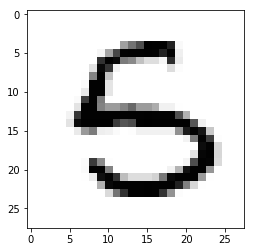

Pred value: 7
True value: 9


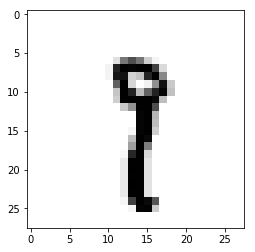

Pred value: 7
True value: 2


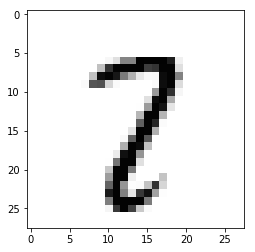

Pred value: 4
True value: 9


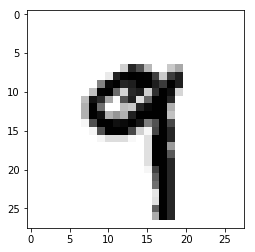

Pred value: 6
True value: 0


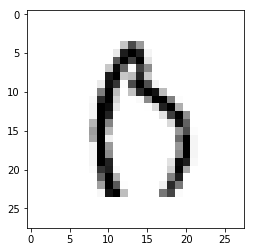

Pred value: 6
True value: 2


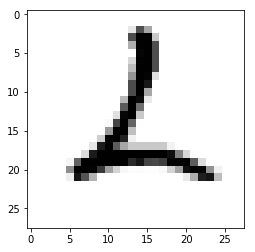

Pred value: 6
True value: 0


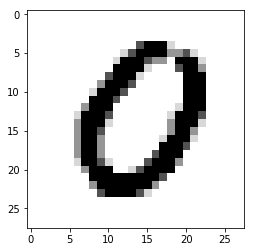

Pred value: 4
True value: 9


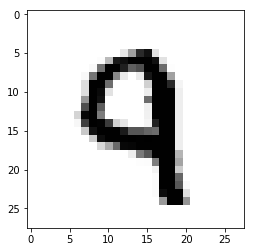

Pred value: 3
True value: 8


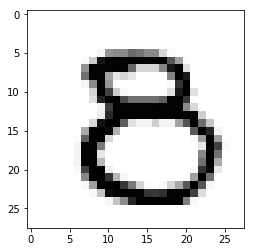

Pred value: 6
True value: 5


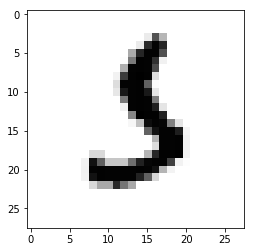

Pred value: 6
True value: 8


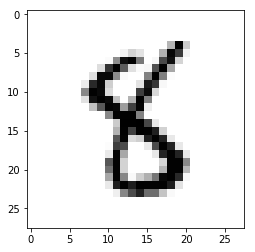

Pred value: 6
True value: 5


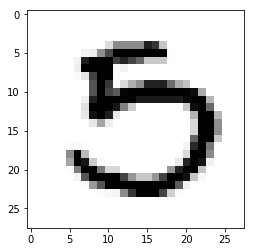

Pred value: 5
True value: 8


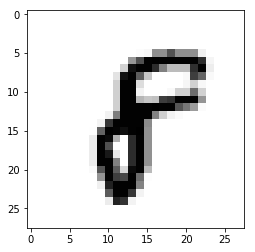

Pred value: 4
True value: 9


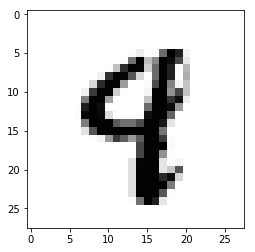

Pred value: 7
True value: 2


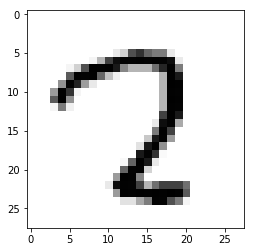

Pred value: 6
True value: 2


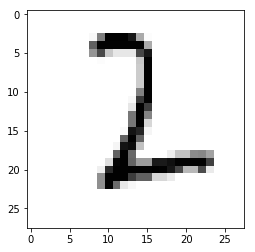

Pred value: 1
True value: 8


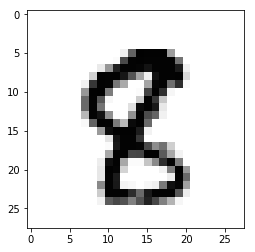

Pred value: 2
True value: 8


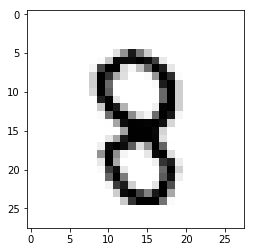

Pred value: 6
True value: 0


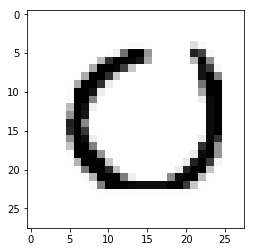

Pred value: 7
True value: 9


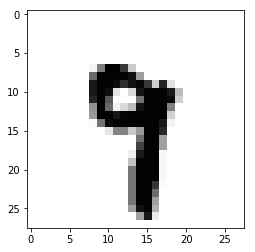

Pred value: 6
True value: 2


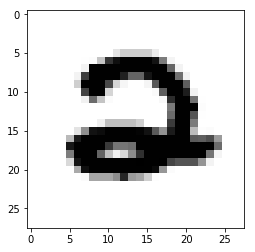

Pred value: 6
True value: 8


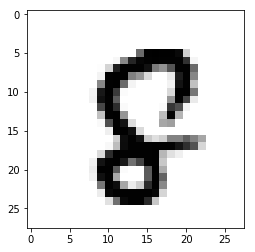

Pred value: 4
True value: 9


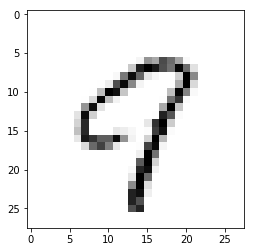

Pred value: 6
True value: 2


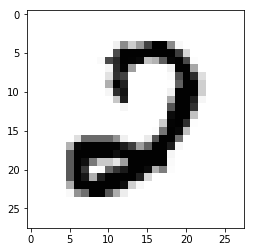

Pred value: 3
True value: 8


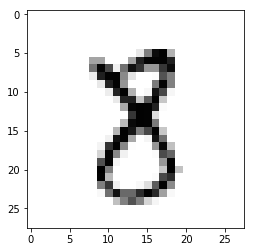

Pred value: 4
True value: 8


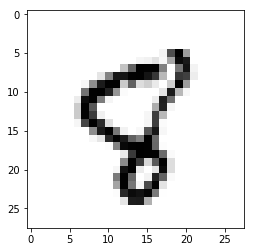

Pred value: 6
True value: 5


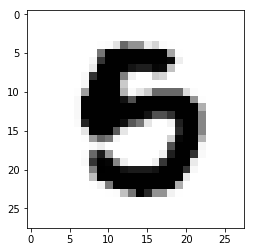

Pred value: 4
True value: 9


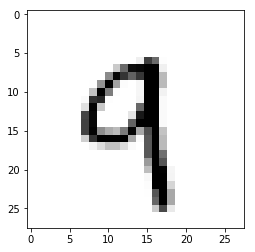

Pred value: 4
True value: 9


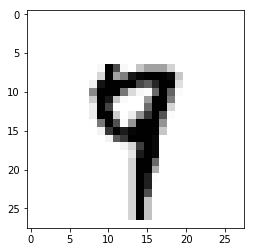

Pred value: 4
True value: 2


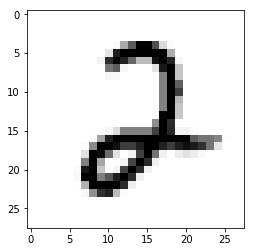

Pred value: 6
True value: 2


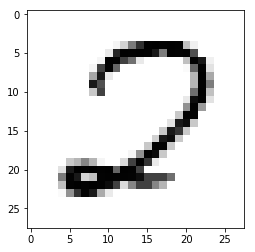

Pred value: 4
True value: 9


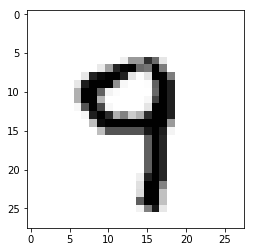

Pred value: 6
True value: 0


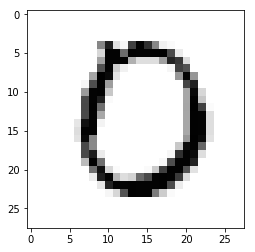

Pred value: 4
True value: 9


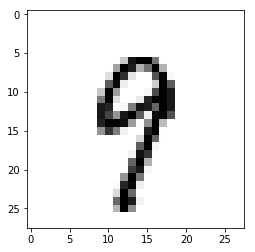

Pred value: 5
True value: 8


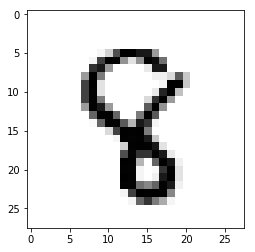

Pred value: 2
True value: 8


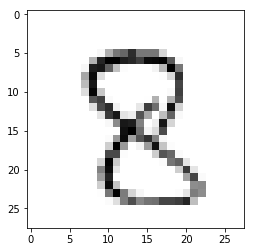

Pred value: 4
True value: 5


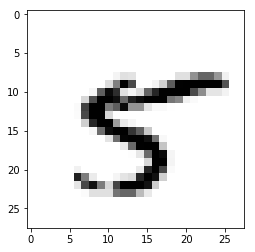

Pred value: 4
True value: 9


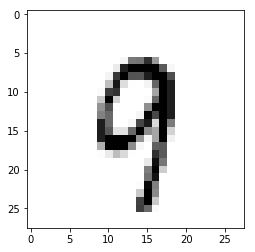

Pred value: 7
True value: 8


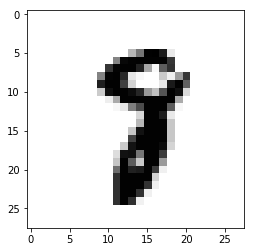

Pred value: 5
True value: 8


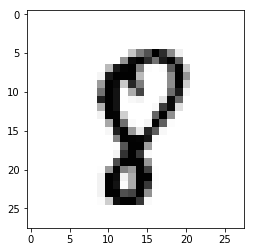

Pred value: 6
True value: 0


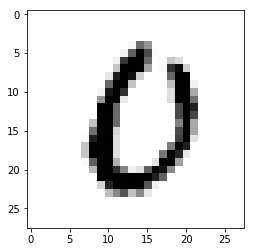

Pred value: 3
True value: 2


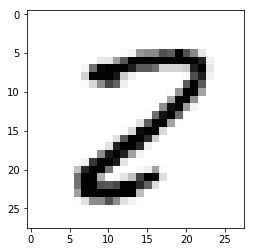

Pred value: 5
True value: 9


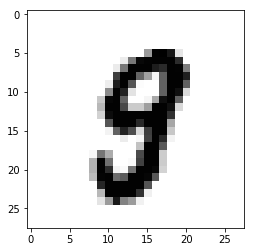

Pred value: 5
True value: 3


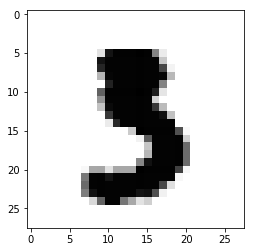

Pred value: 4
True value: 9


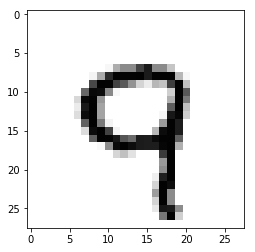

Pred value: 5
True value: 8


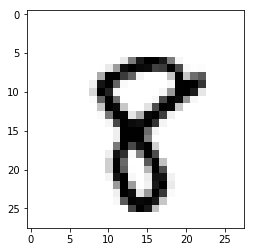

Pred value: 6
True value: 0


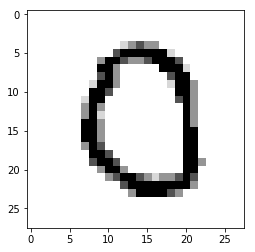

Pred value: 7
True value: 8


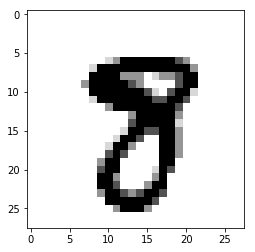

Pred value: 5
True value: 8


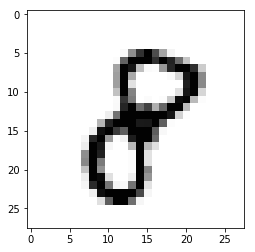

Pred value: 1
True value: 7


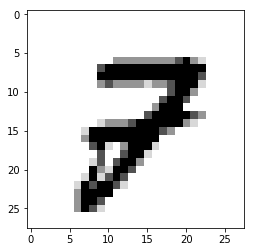

Pred value: 5
True value: 8


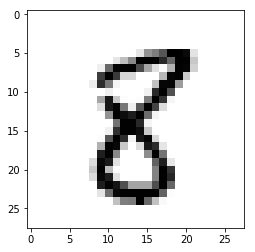

Pred value: 7
True value: 9


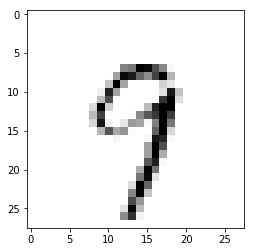

Pred value: 5
True value: 8


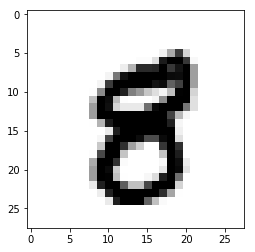

Pred value: 6
True value: 2


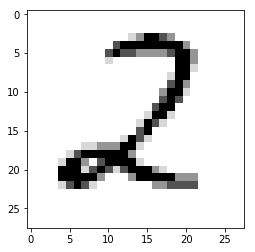

Pred value: 4
True value: 5


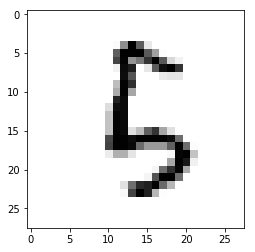

Pred value: 3
True value: 9


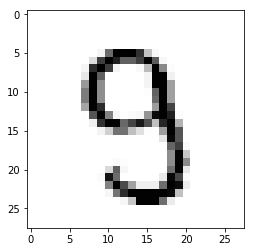

Pred value: 4
True value: 9


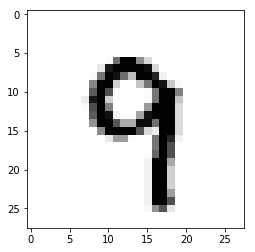

Pred value: 4
True value: 5


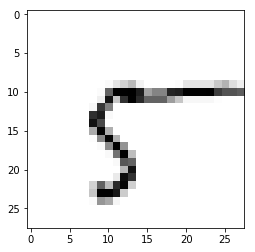

Pred value: 6
True value: 0


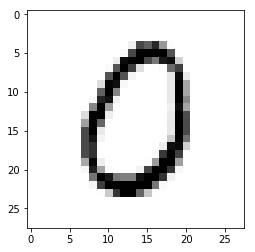

Pred value: 7
True value: 8


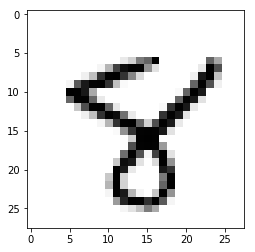

Pred value: 4
True value: 9


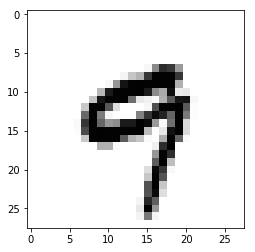

Pred value: 4
True value: 9


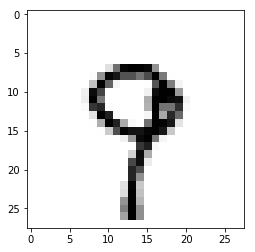

Pred value: 6
True value: 0


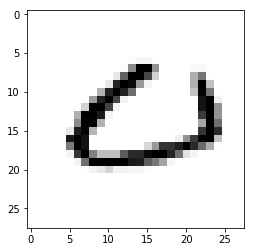

Pred value: 6
True value: 2


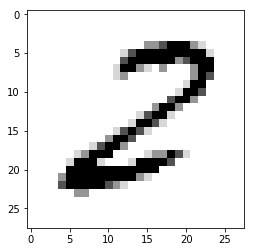

Pred value: 6
True value: 8


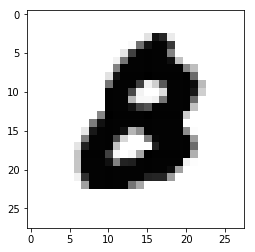

Pred value: 4
True value: 9


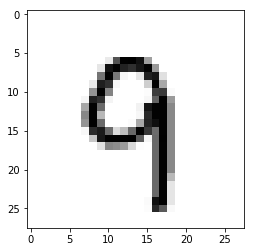

Pred value: 6
True value: 0


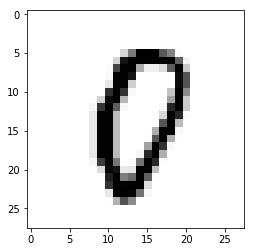

Pred value: 4
True value: 9


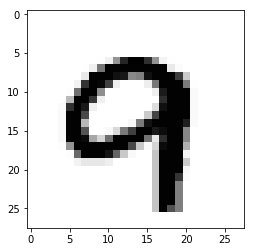

Pred value: 6
True value: 5


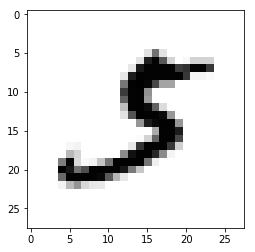

Pred value: 5
True value: 3


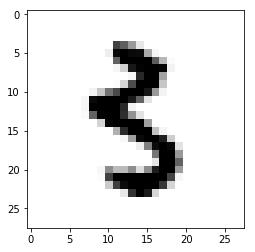

Pred value: 1
True value: 4


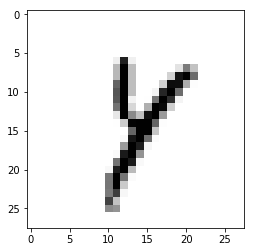

Pred value: 4
True value: 2


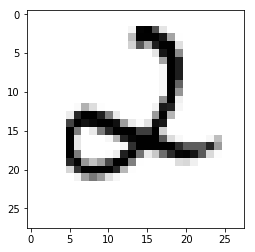

Pred value: 6
True value: 8


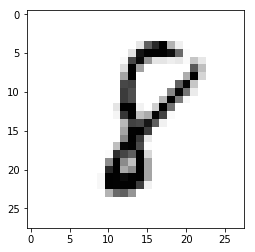

Pred value: 4
True value: 9


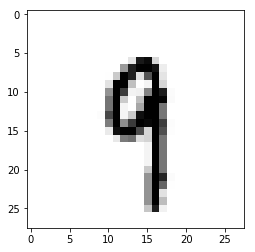

Pred value: 6
True value: 0


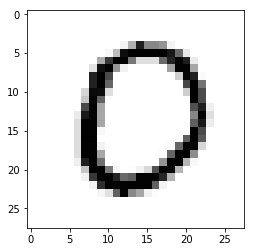

Pred value: 0
True value: 8


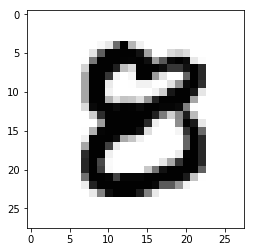

Pred value: 4
True value: 9


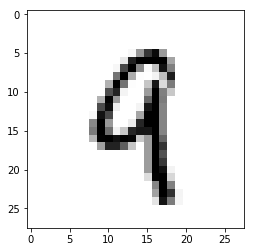

Pred value: 6
True value: 3


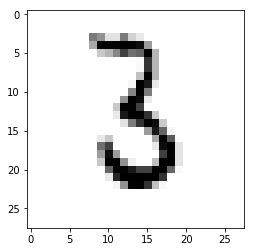

Pred value: 6
True value: 8


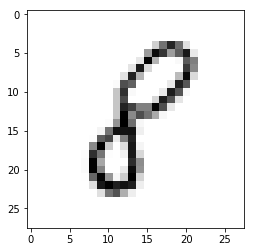

Pred value: 6
True value: 2


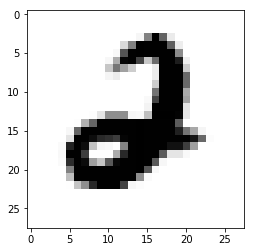

Pred value: 4
True value: 8


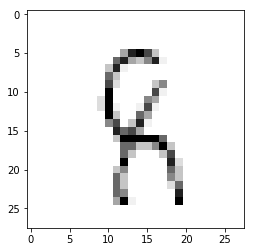

Pred value: 3
True value: 8


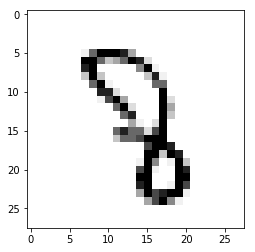

Pred value: 6
True value: 0


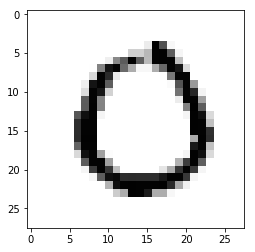

Pred value: 6
True value: 2


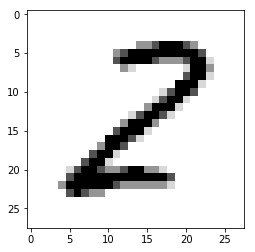

Pred value: 4
True value: 3


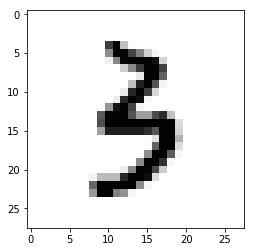

Pred value: 4
True value: 7


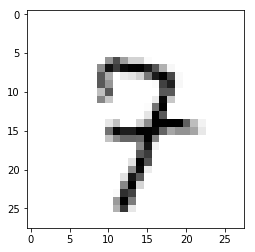

Pred value: 3
True value: 7


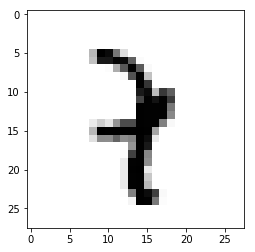

Pred value: 6
True value: 0


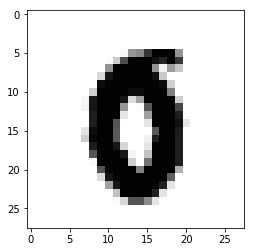

Pred value: 6
True value: 8


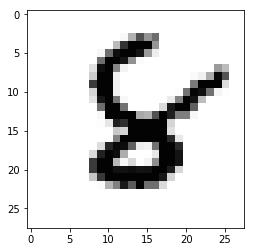

Pred value: 4
True value: 9


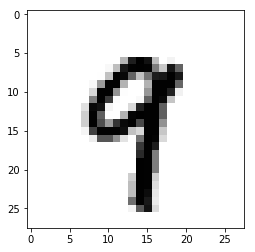

Pred value: 4
True value: 9


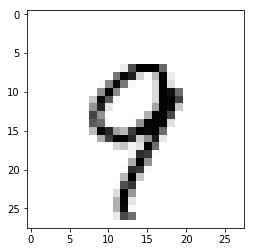

Pred value: 6
True value: 0


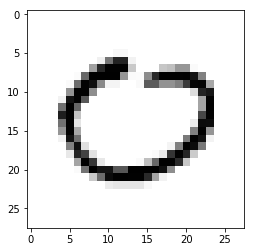

Pred value: 4
True value: 9


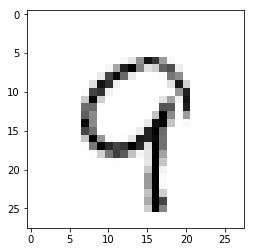

Pred value: 5
True value: 8


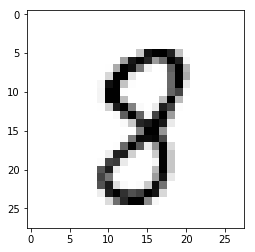

Pred value: 7
True value: 4


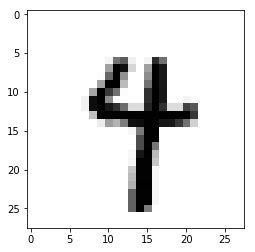

Pred value: 5
True value: 8


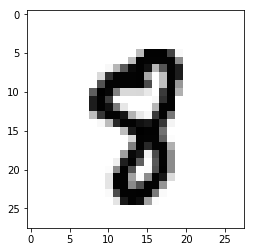

Pred value: 4
True value: 9


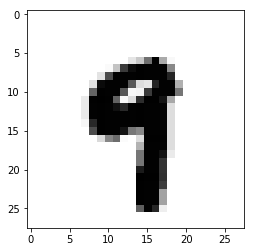

Pred value: 1
True value: 8


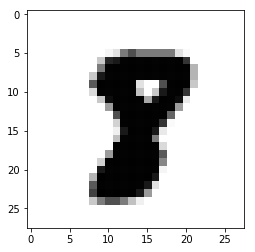

Pred value: 6
True value: 0


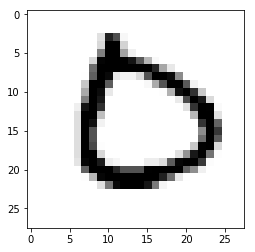

Pred value: 6
True value: 8


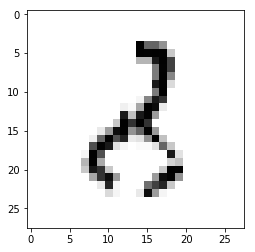

Pred value: 6
True value: 0


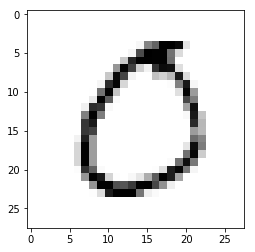

Pred value: 3
True value: 8


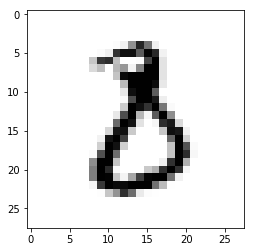

Pred value: 7
True value: 9


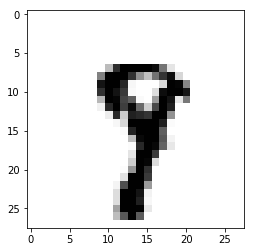

Pred value: 5
True value: 8


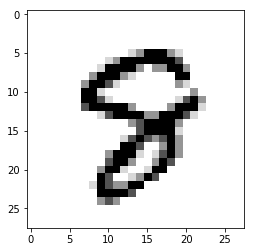

Pred value: 6
True value: 0


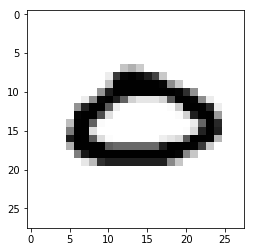

Pred value: 7
True value: 9


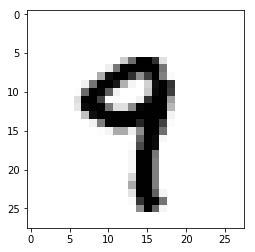

Pred value: 4
True value: 9


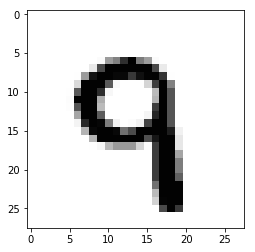

Pred value: 1
True value: 8


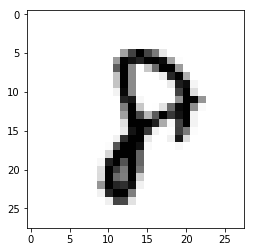

Pred value: 5
True value: 8


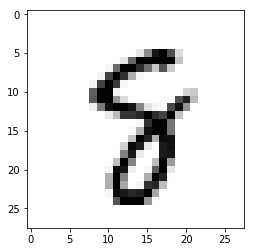

Pred value: 3
True value: 8


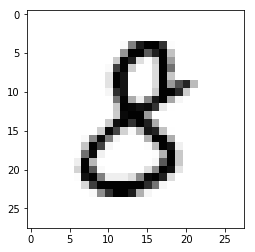

Pred value: 6
True value: 0


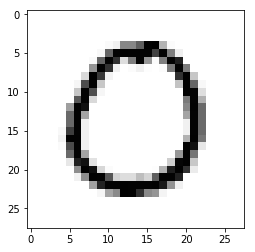

Pred value: 6
True value: 0


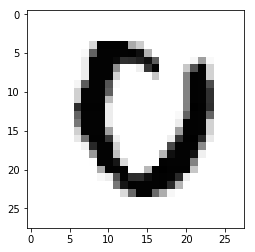

Pred value: 1
True value: 2


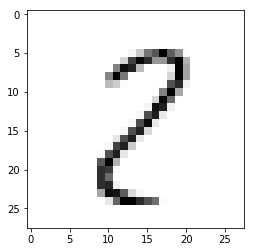

Pred value: 7
True value: 9


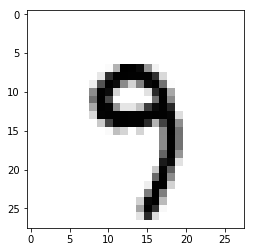

Pred value: 5
True value: 8


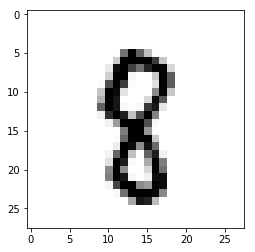

Pred value: 1
True value: 2


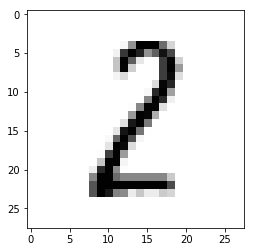

Pred value: 4
True value: 9


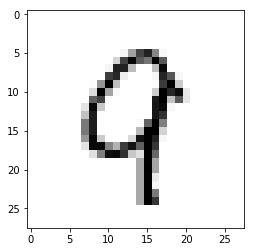

Pred value: 6
True value: 2


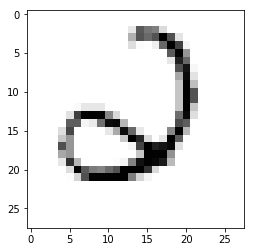

Pred value: 4
True value: 9


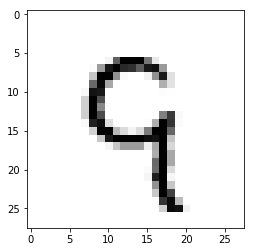

Pred value: 6
True value: 2


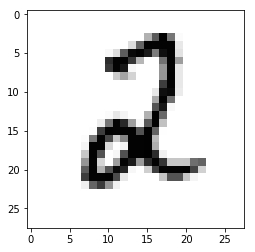

Pred value: 4
True value: 9


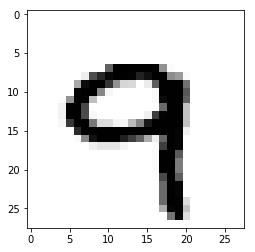

Pred value: 6
True value: 2


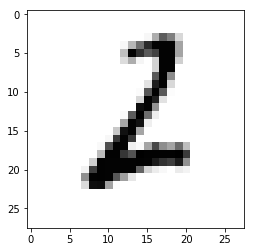

Pred value: 4
True value: 9


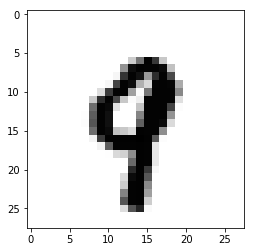

Pred value: 6
True value: 8


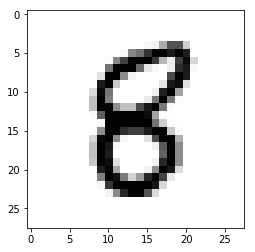

Pred value: 6
True value: 0


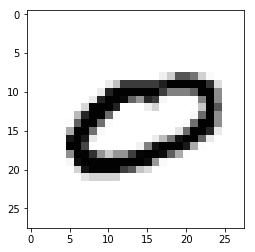

Pred value: 6
True value: 0


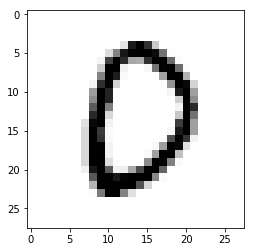

Pred value: 6
True value: 5


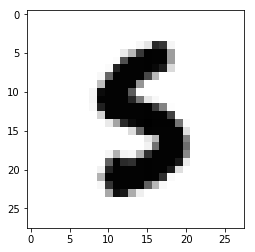

Pred value: 6
True value: 2


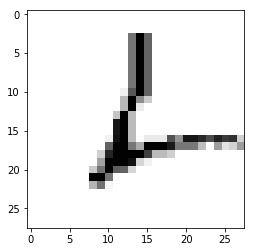

Pred value: 3
True value: 8


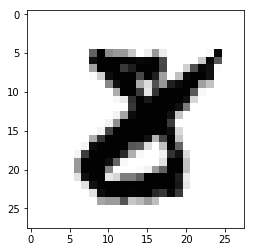

Pred value: 4
True value: 7


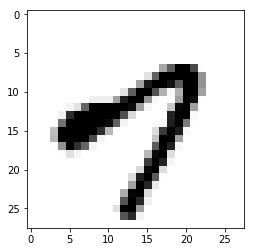

Pred value: 7
True value: 2


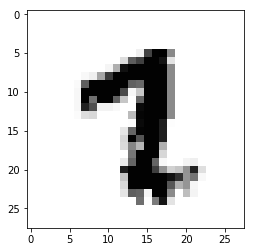

Pred value: 6
True value: 0


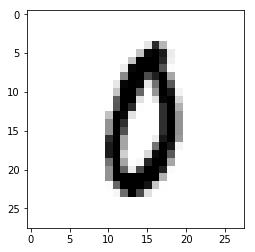

Pred value: 4
True value: 9


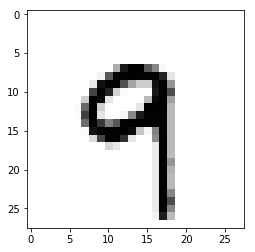

Pred value: 6
True value: 8


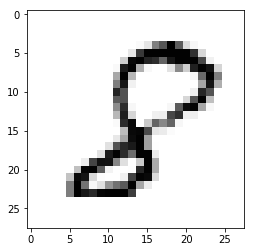

Pred value: 4
True value: 9


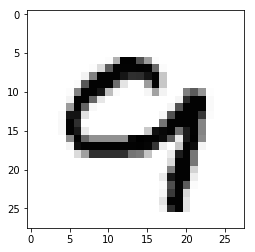

Pred value: 4
True value: 9


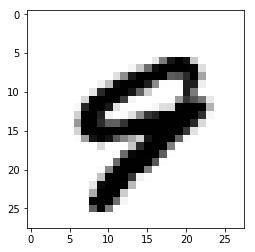

Pred value: 6
True value: 5


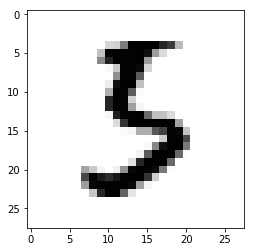

Pred value: 4
True value: 9


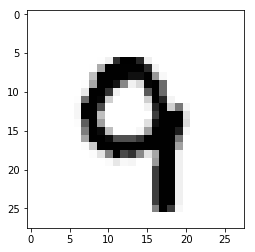

Pred value: 4
True value: 9


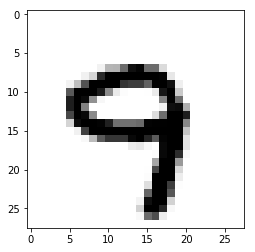

Pred value: 3
True value: 7


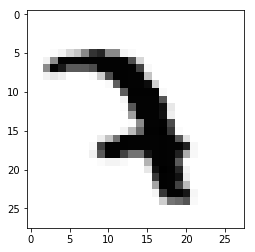

Pred value: 5
True value: 8


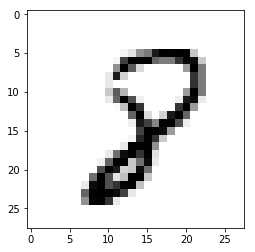

Pred value: 6
True value: 2


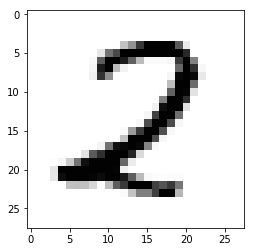

Pred value: 4
True value: 8


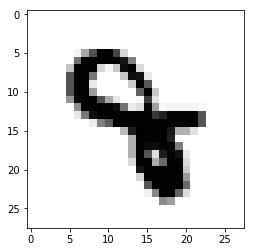

Pred value: 6
True value: 8


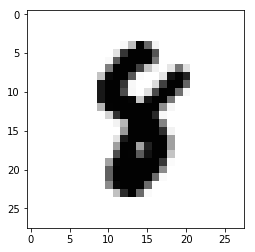

Pred value: 5
True value: 3


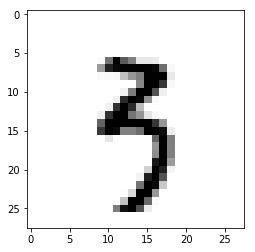

Pred value: 3
True value: 7


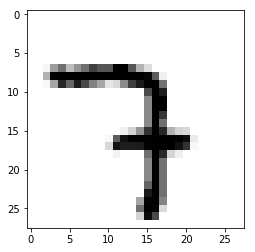

Pred value: 6
True value: 0


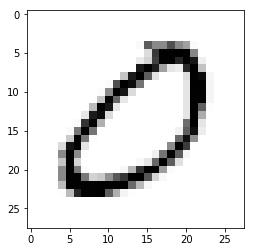

Pred value: 7
True value: 9


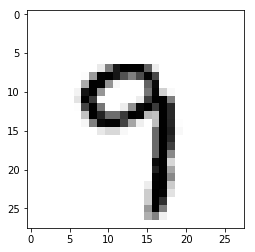

Pred value: 3
True value: 8


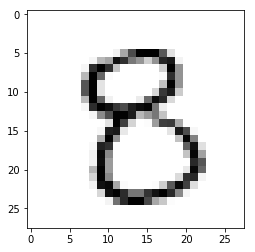

Pred value: 6
True value: 0


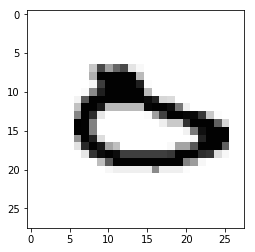

Pred value: 6
True value: 5


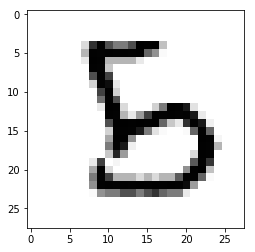

Pred value: 6
True value: 0


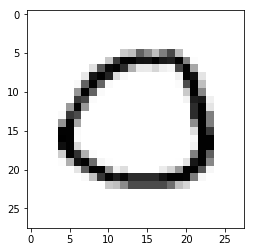

Pred value: 6
True value: 0


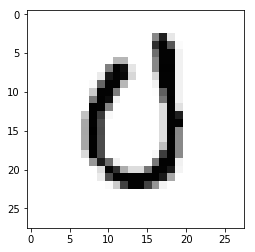

Pred value: 7
True value: 2


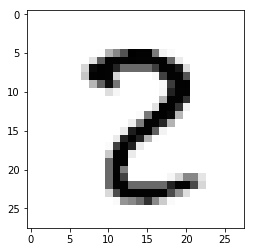

Pred value: 4
True value: 9


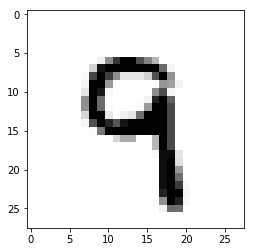

Pred value: 6
True value: 5


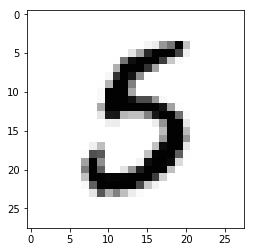

Pred value: 7
True value: 4


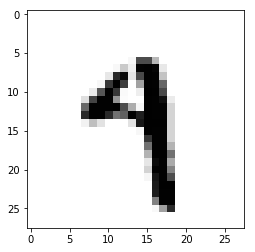

Pred value: 6
True value: 0


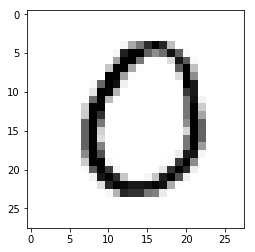

Pred value: 4
True value: 9


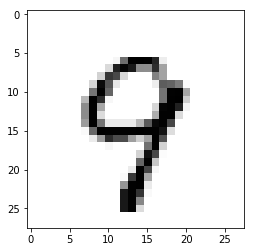

Pred value: 7
True value: 9


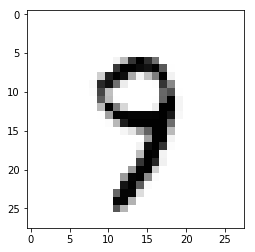

Pred value: 5
True value: 8


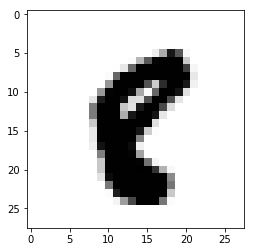

Pred value: 6
True value: 0


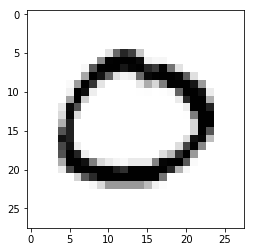

Pred value: 4
True value: 9


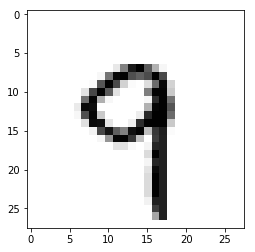

Pred value: 6
True value: 5


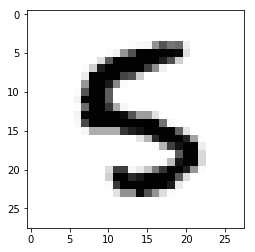

Pred value: 3
True value: 8


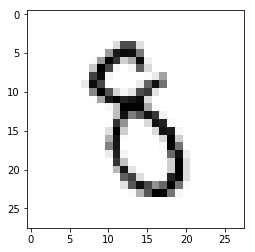

Pred value: 2
True value: 8


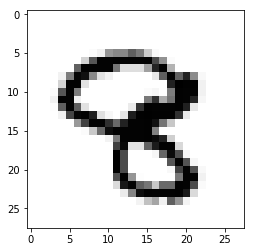

Pred value: 4
True value: 9


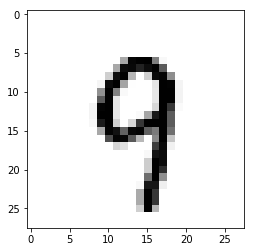

Pred value: 1
True value: 8


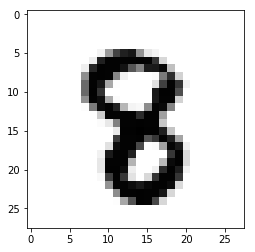

Pred value: 6
True value: 0


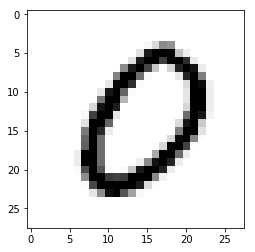

Pred value: 6
True value: 3


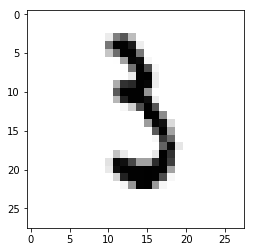

Pred value: 6
True value: 2


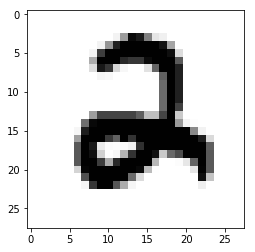

Pred value: 5
True value: 8


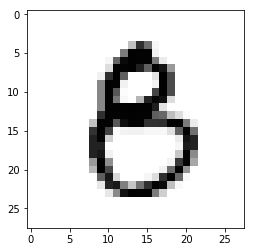

Pred value: 6
True value: 0


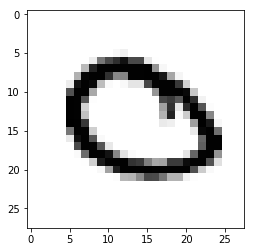

Pred value: 2
True value: 8


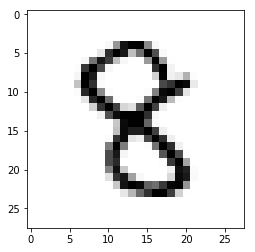

Pred value: 4
True value: 9


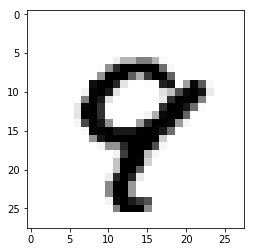

Pred value: 6
True value: 0


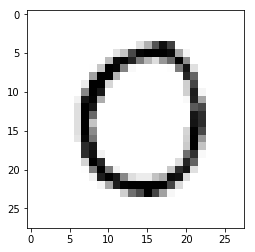

Pred value: 6
True value: 2


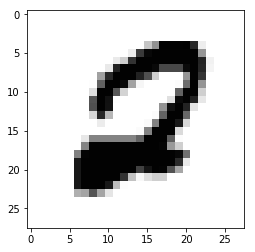

Pred value: 3
True value: 2


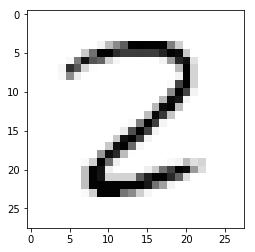

Pred value: 4
True value: 2


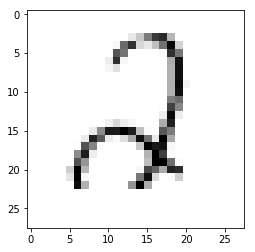

Pred value: 4
True value: 9


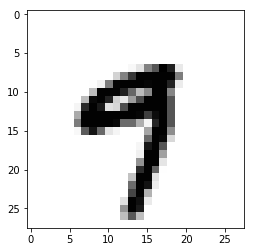

Pred value: 4
True value: 8


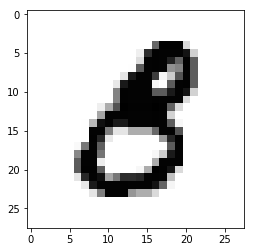

Pred value: 7
True value: 8


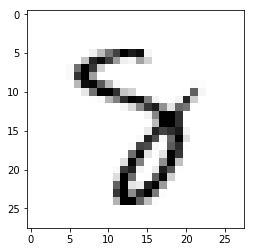

Pred value: 6
True value: 2


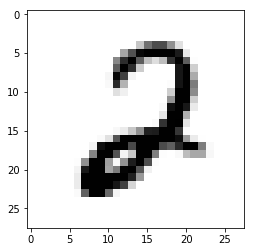

Pred value: 4
True value: 9


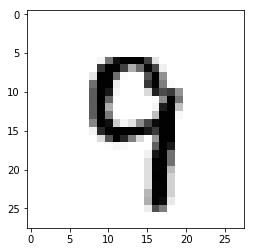

Pred value: 6
True value: 2


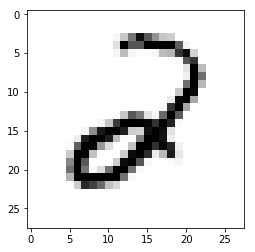

Pred value: 5
True value: 8


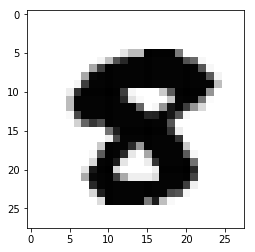

Pred value: 6
True value: 5


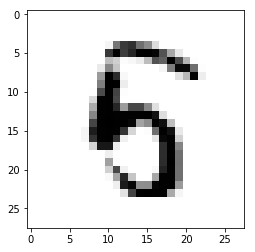

Pred value: 6
True value: 2


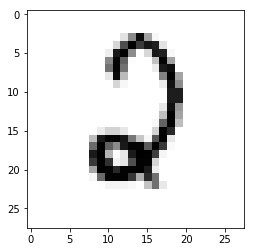

Pred value: 6
True value: 0


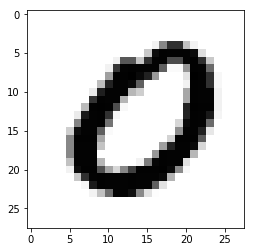

Pred value: 7
True value: 8


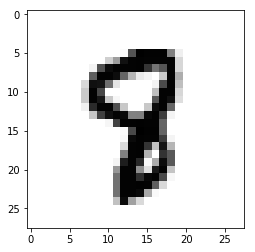

Pred value: 4
True value: 9


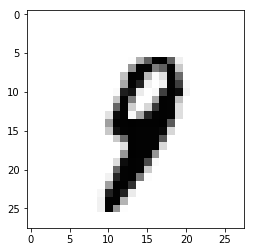

Pred value: 6
True value: 2


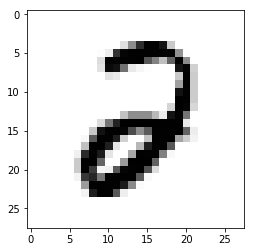

Pred value: 3
True value: 8


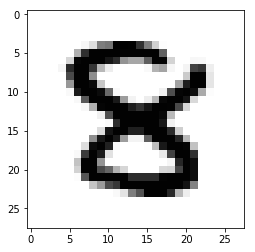

Pred value: 6
True value: 8


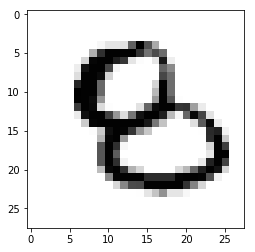

Pred value: 5
True value: 8


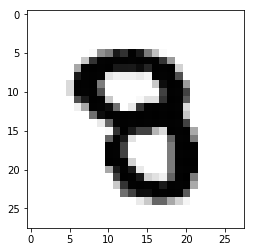

Pred value: 5
True value: 8


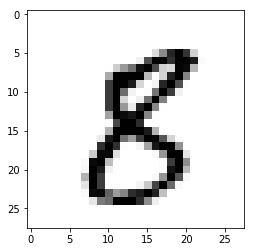

Pred value: 4
True value: 9


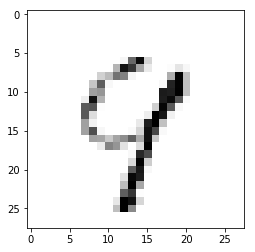

Pred value: 6
True value: 0


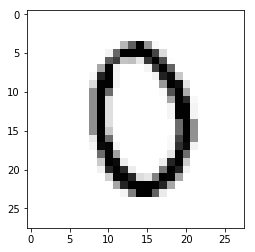

Pred value: 6
True value: 2


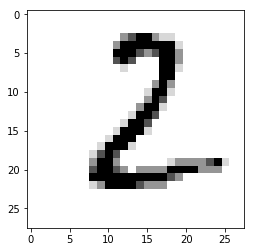

Pred value: 4
True value: 9


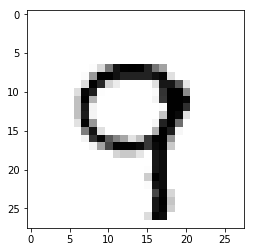

Pred value: 6
True value: 0


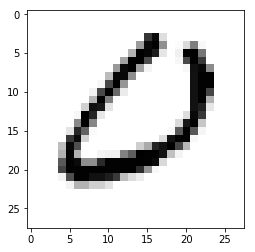

Pred value: 1
True value: 7


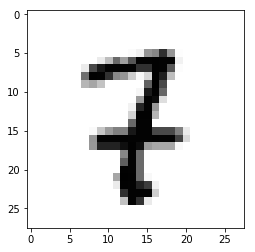

Pred value: 5
True value: 8


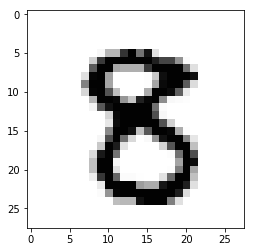

Pred value: 7
True value: 4


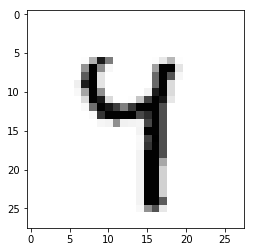

Pred value: 4
True value: 9


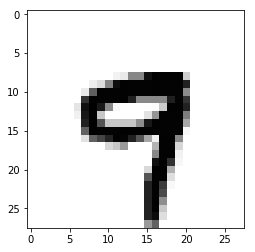

Pred value: 4
True value: 9


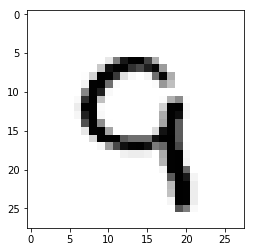

Pred value: 6
True value: 8


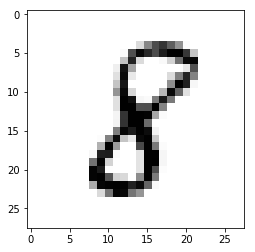

Pred value: 6
True value: 8


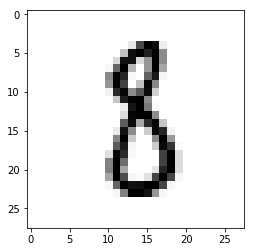

Pred value: 7
True value: 2


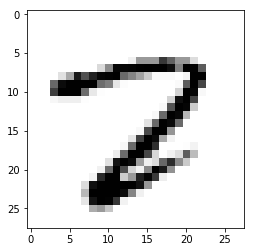

Pred value: 6
True value: 2


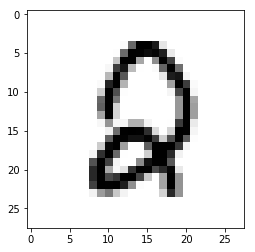

Pred value: 4
True value: 9


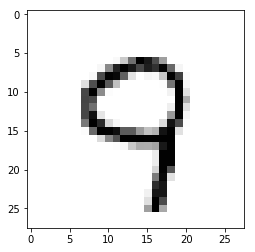

Pred value: 4
True value: 7


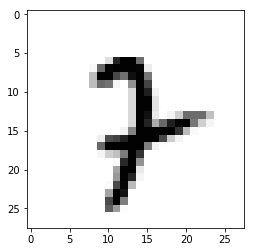

Pred value: 4
True value: 5


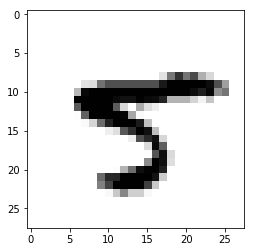

Pred value: 6
True value: 8


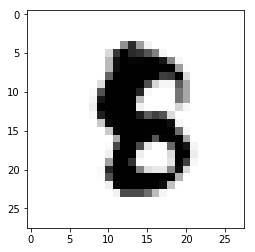

Pred value: 5
True value: 3


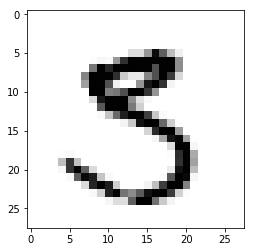

Pred value: 7
True value: 2


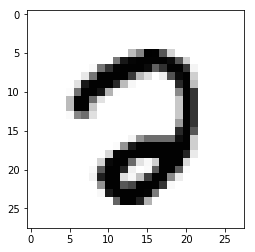

Pred value: 4
True value: 8


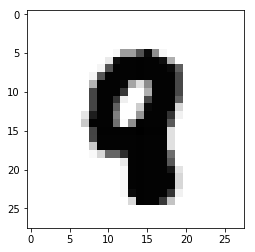

Pred value: 2
True value: 7


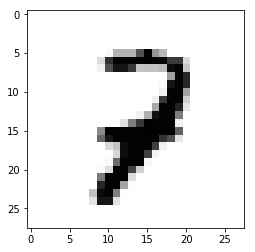

Pred value: 4
True value: 9


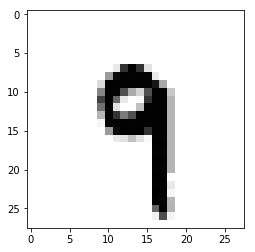

Pred value: 6
True value: 5


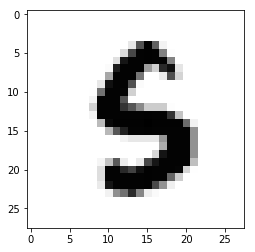

Pred value: 6
True value: 1


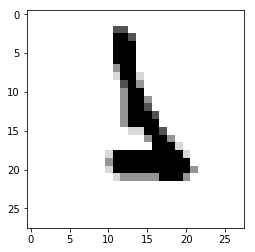

Pred value: 5
True value: 7


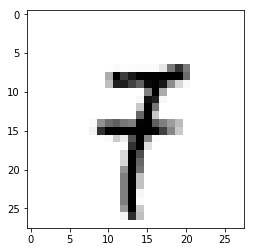

Pred value: 1
True value: 8


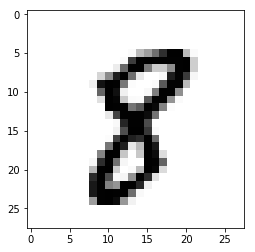

Pred value: 7
True value: 9


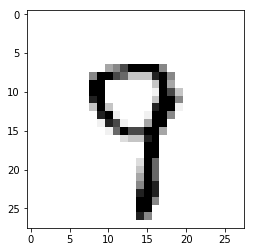

Pred value: 7
True value: 9


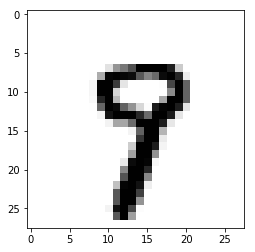

Pred value: 3
True value: 2


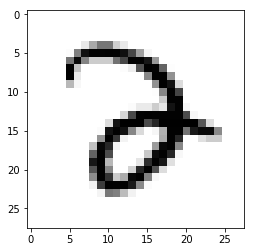

Pred value: 6
True value: 0


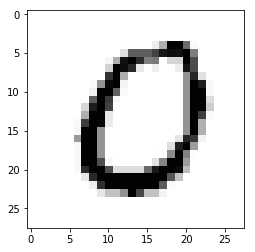

Pred value: 6
True value: 8


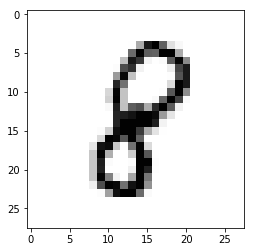

Pred value: 4
True value: 2


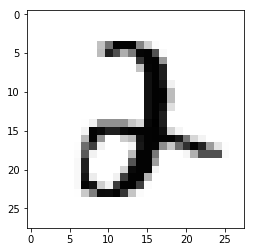

Pred value: 4
True value: 9


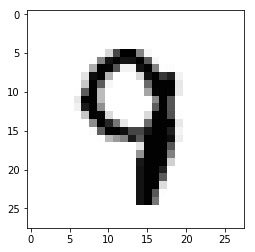

Pred value: 6
True value: 2


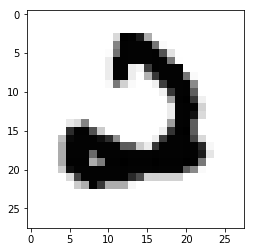

Pred value: 6
True value: 2


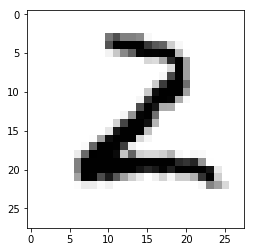

Pred value: 6
True value: 8


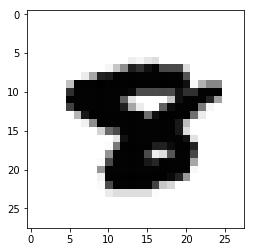

Pred value: 4
True value: 9


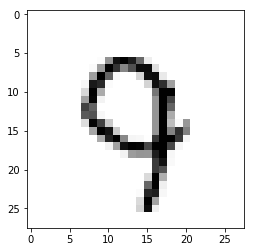

Pred value: 4
True value: 9


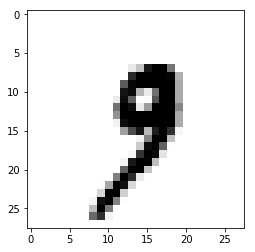

Pred value: 6
True value: 0


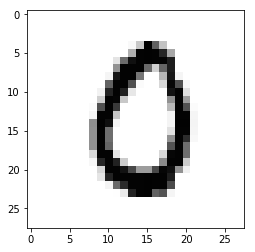

Pred value: 6
True value: 2


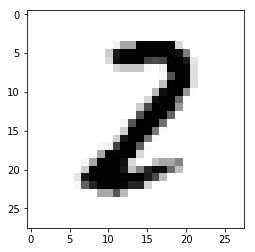

Pred value: 4
True value: 9


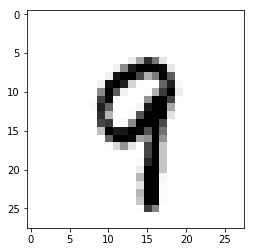

Pred value: 5
True value: 8


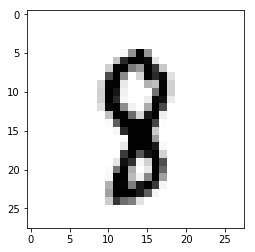

Pred value: 4
True value: 9


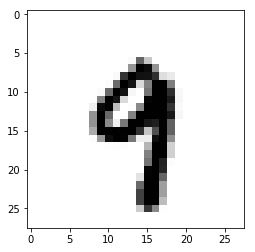

Pred value: 5
True value: 6


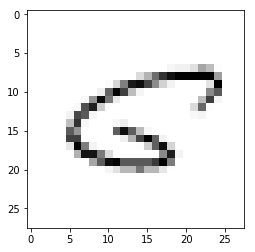

Pred value: 6
True value: 2


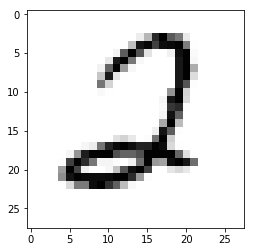

Pred value: 5
True value: 8


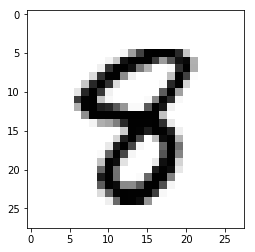

Pred value: 5
True value: 8


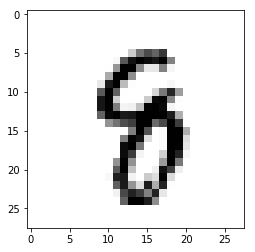

Pred value: 1
True value: 8


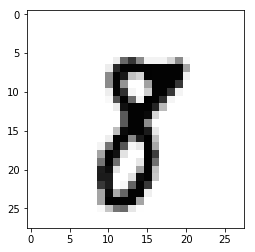

Pred value: 4
True value: 2


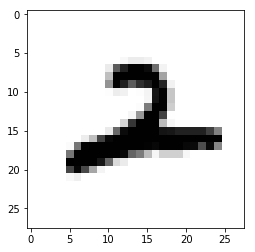

Pred value: 6
True value: 5


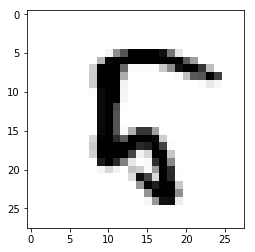

Pred value: 1
True value: 8


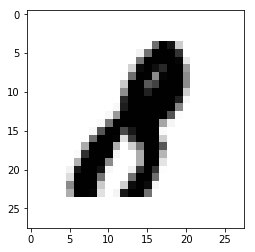

Pred value: 1
True value: 9


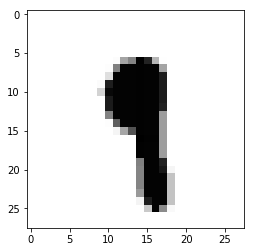

Pred value: 6
True value: 0


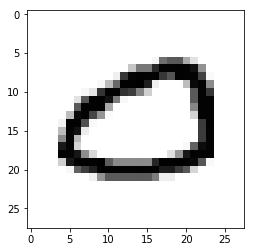

Pred value: 4
True value: 9


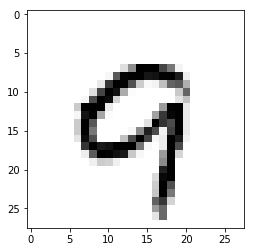

Pred value: 6
True value: 2


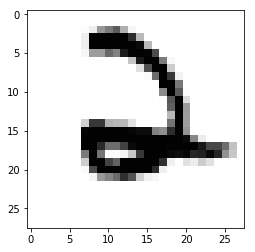

Pred value: 4
True value: 2


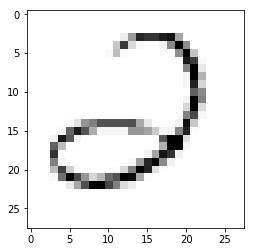

Pred value: 5
True value: 8


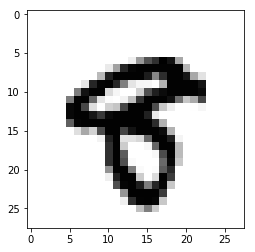

Pred value: 6
True value: 2


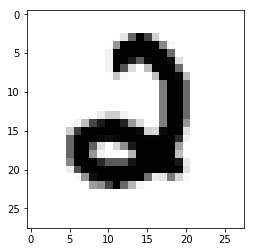

Pred value: 4
True value: 9


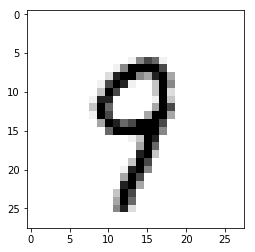

Pred value: 4
True value: 9


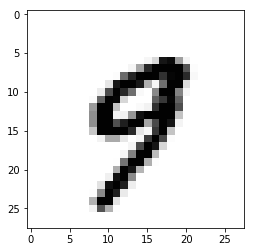

Pred value: 4
True value: 8


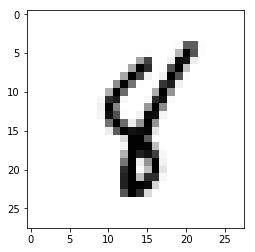

Pred value: 5
True value: 3


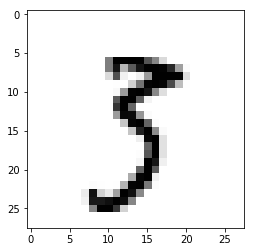

Pred value: 7
True value: 5


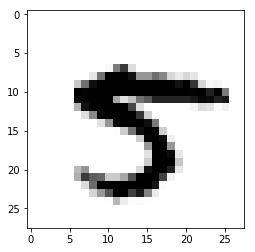

Pred value: 2
True value: 8


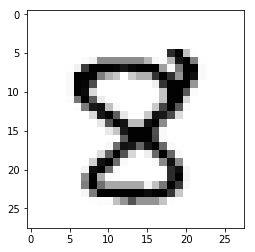

Pred value: 4
True value: 9


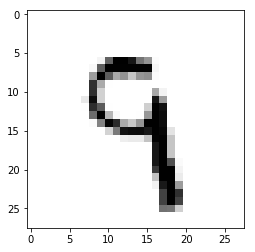

Pred value: 4
True value: 9


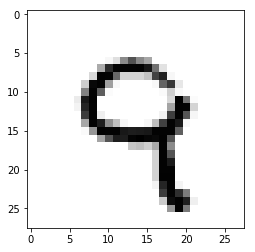

Pred value: 4
True value: 9


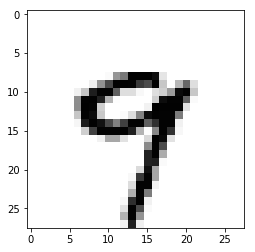

Pred value: 6
True value: 5


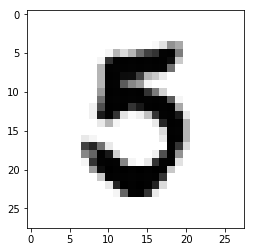

Pred value: 4
True value: 9


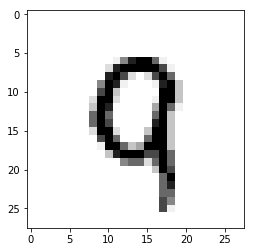

Pred value: 4
True value: 7


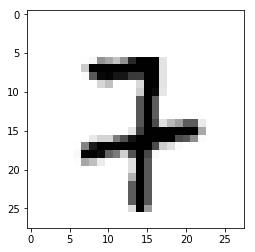

Pred value: 4
True value: 3


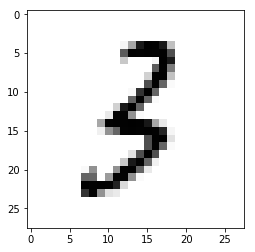

Pred value: 6
True value: 8


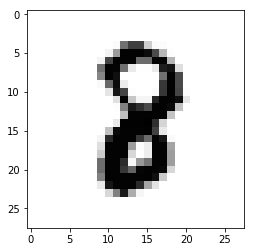

Pred value: 6
True value: 8


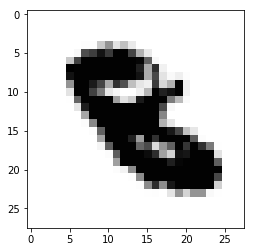

Pred value: 4
True value: 9


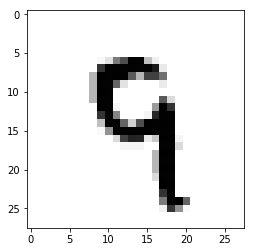

Pred value: 4
True value: 9


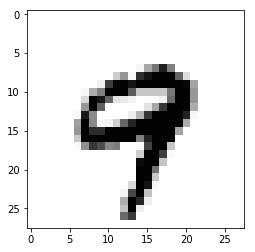

Pred value: 4
True value: 9


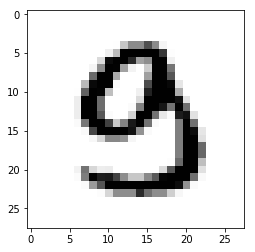

Pred value: 6
True value: 4


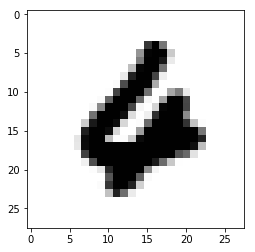

Pred value: 2
True value: 3


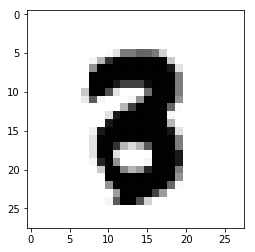

Pred value: 3
True value: 8


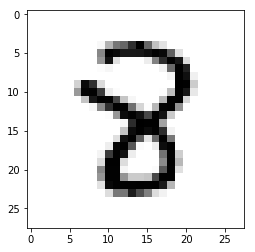

Pred value: 2
True value: 7


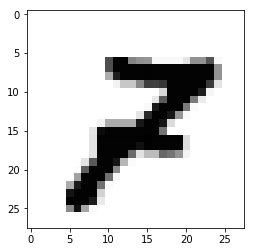

Pred value: 6
True value: 8


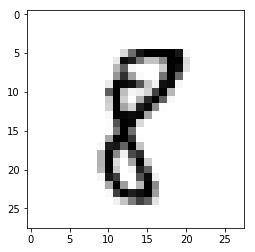

Pred value: 6
True value: 0


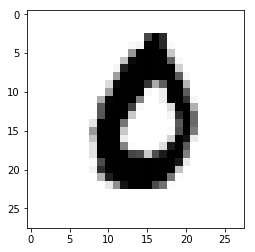

Pred value: 5
True value: 8


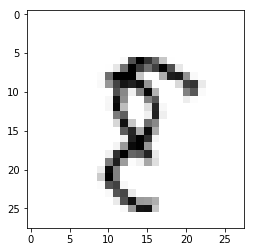

Pred value: 7
True value: 8


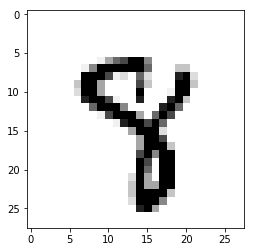

Pred value: 2
True value: 3


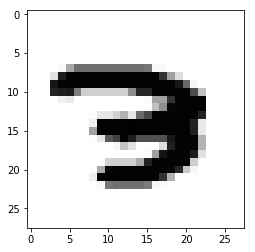

Pred value: 4
True value: 9


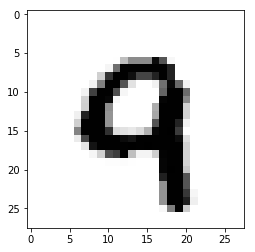

Pred value: 6
True value: 2


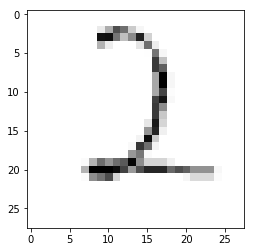

Pred value: 7
True value: 4


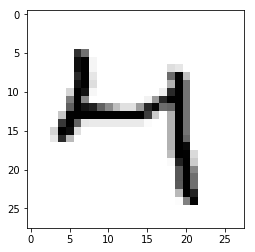

Pred value: 6
True value: 0


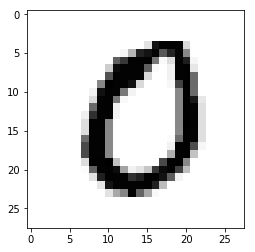

Pred value: 5
True value: 8


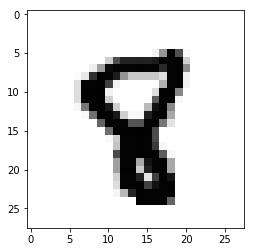

Pred value: 7
True value: 9


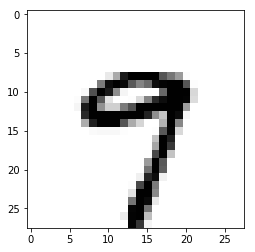

Pred value: 4
True value: 9


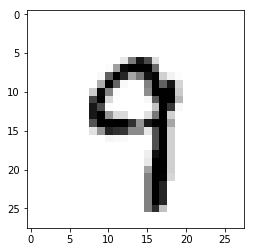

Pred value: 1
True value: 8


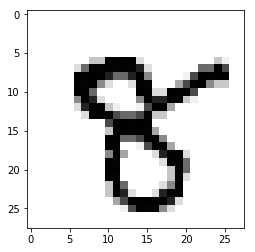

Pred value: 4
True value: 9


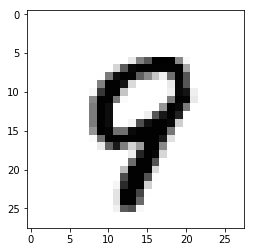

Pred value: 5
True value: 8


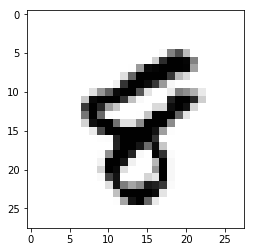

Pred value: 6
True value: 2


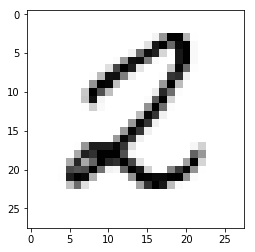

Pred value: 6
True value: 0


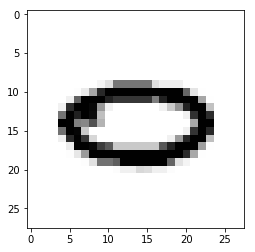

Pred value: 7
True value: 9


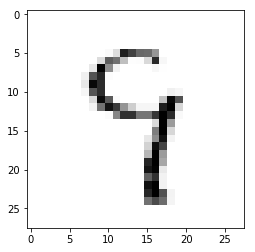

Pred value: 6
True value: 0


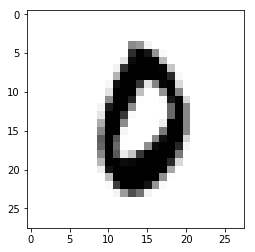

Pred value: 6
True value: 8


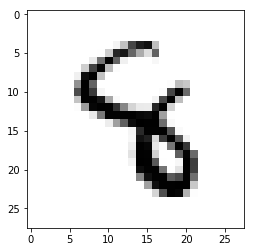

Pred value: 5
True value: 8


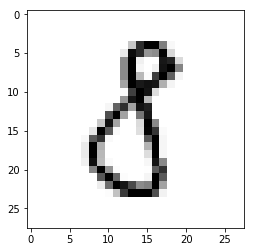

Pred value: 6
True value: 8


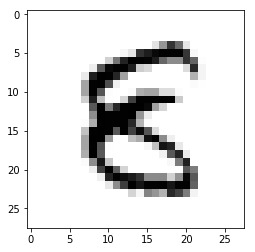

Pred value: 1
True value: 7


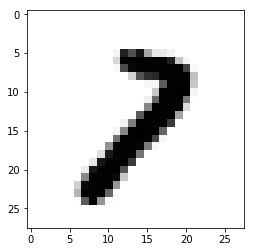

Pred value: 4
True value: 3


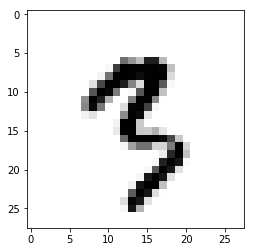

Pred value: 7
True value: 9


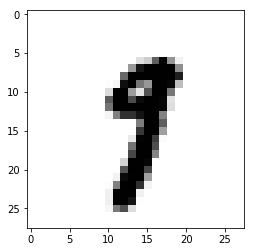

Pred value: 6
True value: 8


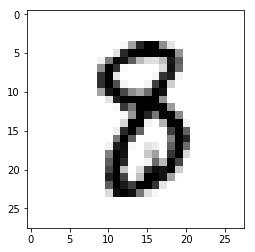

Pred value: 6
True value: 0


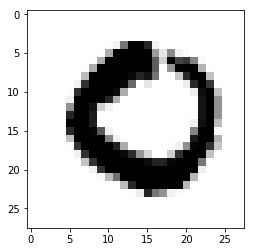

Pred value: 6
True value: 2


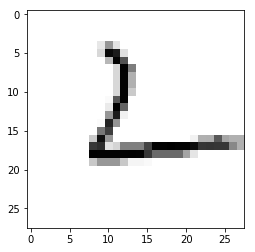

Pred value: 6
True value: 8


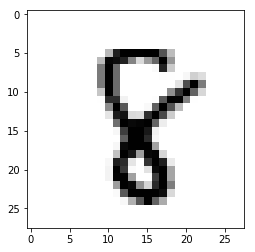

Pred value: 6
True value: 7


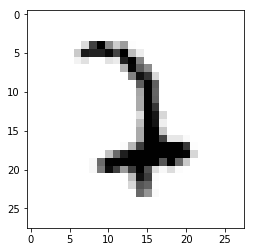

Pred value: 4
True value: 9


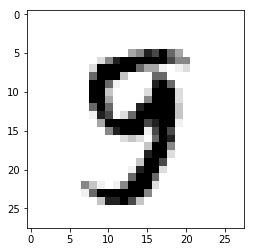

Pred value: 3
True value: 8


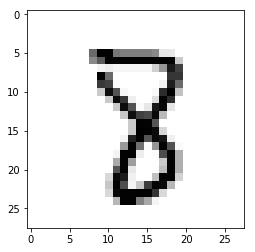

Pred value: 6
True value: 9


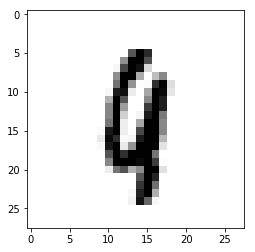

Pred value: 6
True value: 5


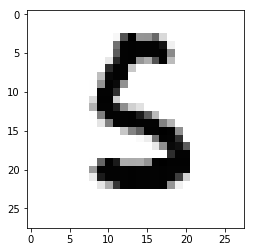

Pred value: 6
True value: 8


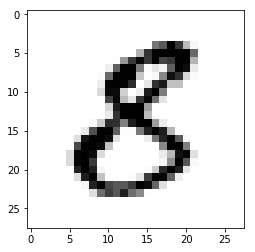

Pred value: 6
True value: 5


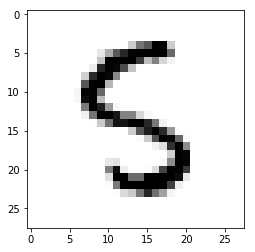

Pred value: 6
True value: 5


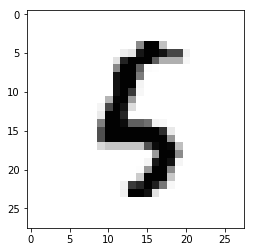

Pred value: 0
True value: 9


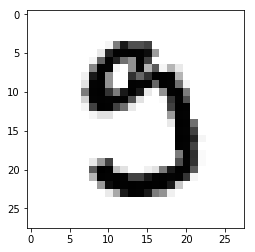

Pred value: 6
True value: 8


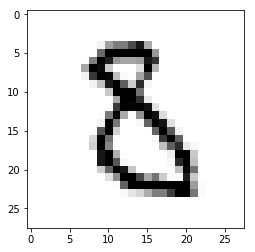

Pred value: 1
True value: 8


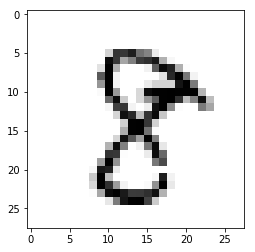

Pred value: 6
True value: 2


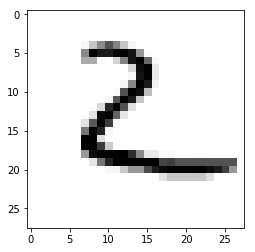

Pred value: 3
True value: 5


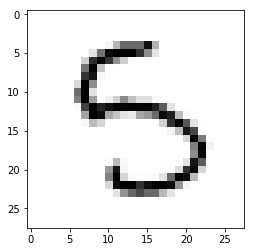

Pred value: 4
True value: 9


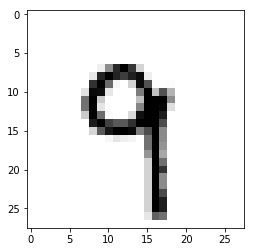

Pred value: 7
True value: 2


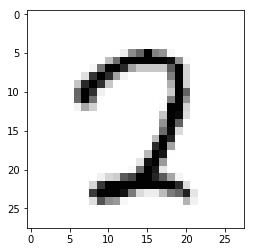

Pred value: 2
True value: 8


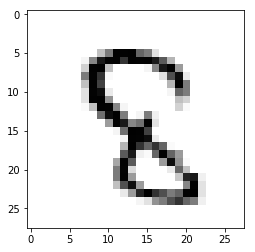

Pred value: 1
True value: 7


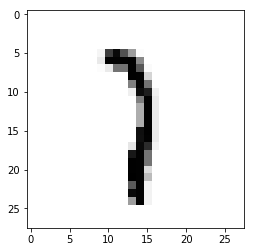

Pred value: 7
True value: 8


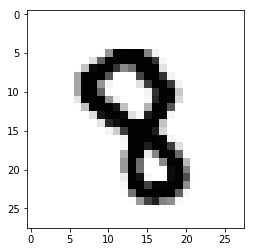

Pred value: 6
True value: 2


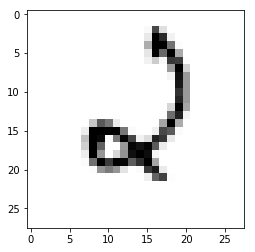

Pred value: 6
True value: 0


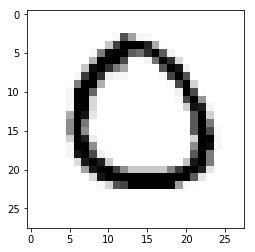

Pred value: 4
True value: 5


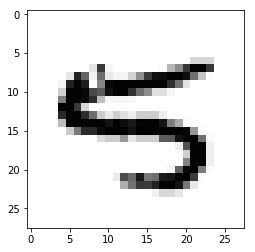

Pred value: 6
True value: 0


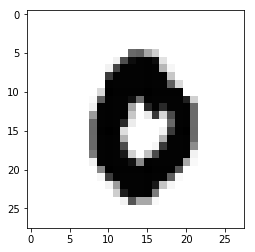

Pred value: 6
True value: 4


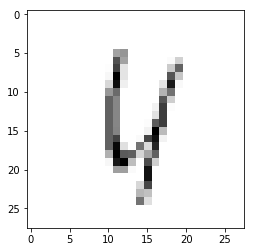

Pred value: 4
True value: 9


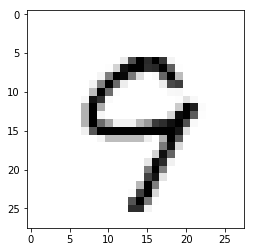

Pred value: 4
True value: 9


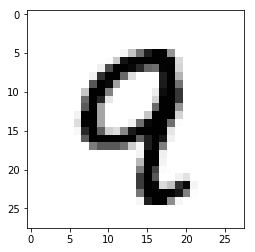

Pred value: 4
True value: 7


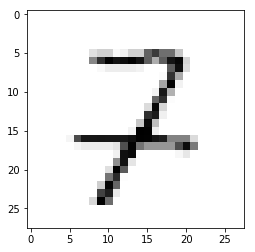

Pred value: 6
True value: 8


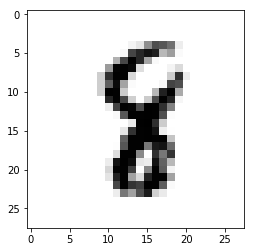

Pred value: 5
True value: 8


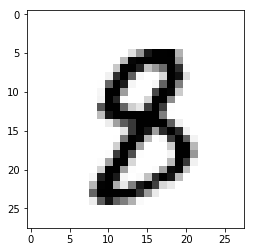

Pred value: 6
True value: 0


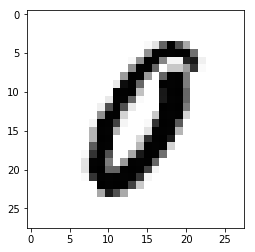

Pred value: 7
True value: 5


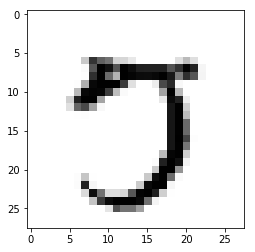

Pred value: 4
True value: 9


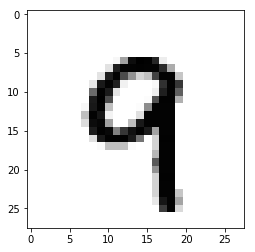

Pred value: 4
True value: 9


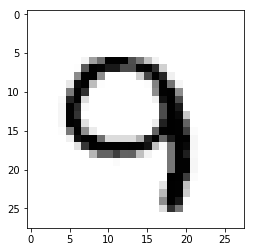

Pred value: 4
True value: 9


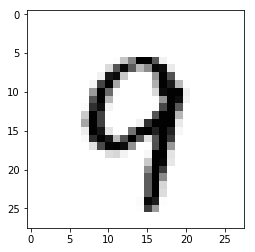

Pred value: 4
True value: 9


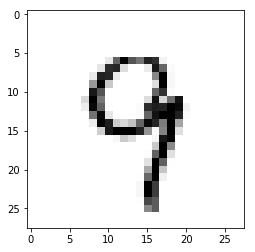

Pred value: 6
True value: 8


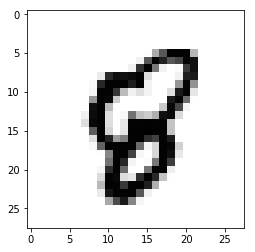

Pred value: 6
True value: 8


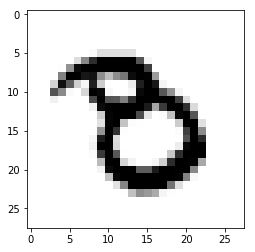

Pred value: 6
True value: 8


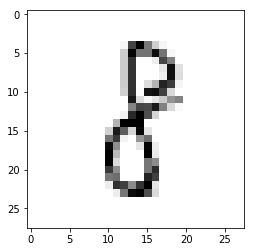

Pred value: 4
True value: 9


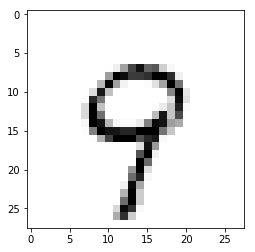

Pred value: 1
True value: 8


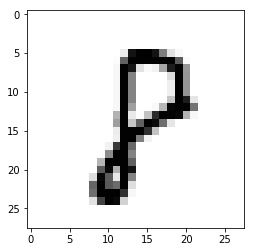

Pred value: 6
True value: 8


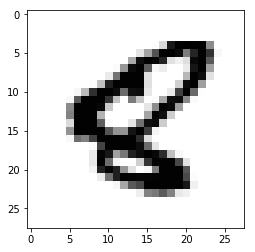

Pred value: 1
True value: 7


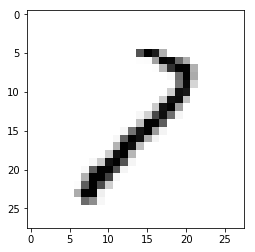

Pred value: 4
True value: 9


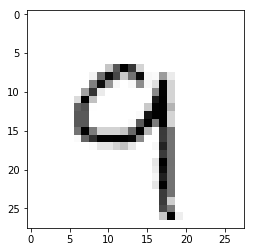

Pred value: 6
True value: 2


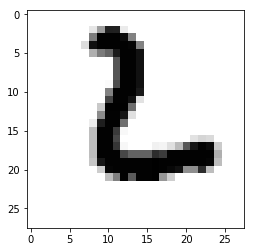

Pred value: 3
True value: 5


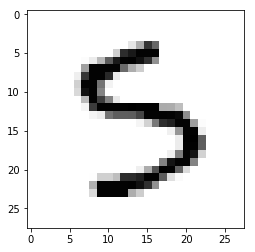

Pred value: 4
True value: 9


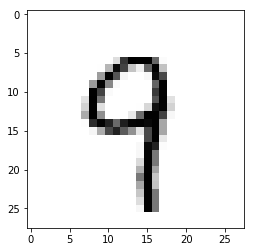

Pred value: 4
True value: 2


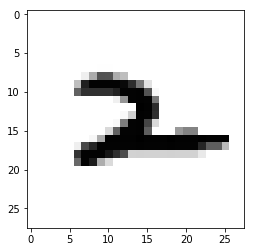

Pred value: 6
True value: 2


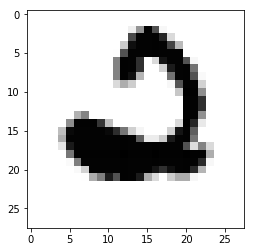

Pred value: 6
True value: 2


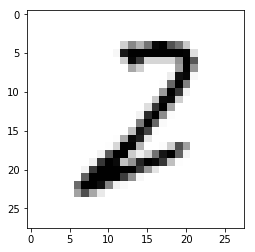

Pred value: 6
True value: 4


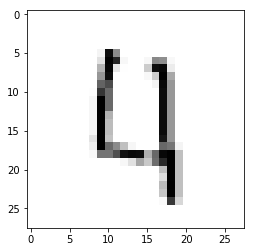

Pred value: 7
True value: 8


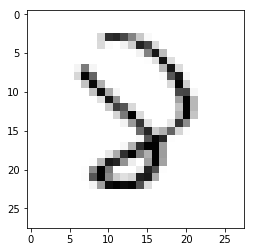

Pred value: 6
True value: 2


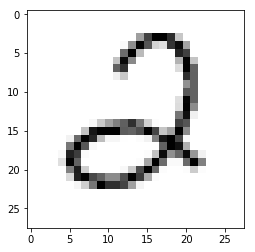

Pred value: 6
True value: 5


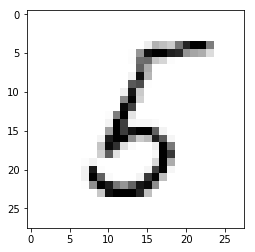

Pred value: 4
True value: 9


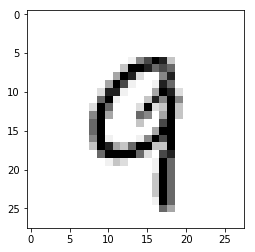

Pred value: 6
True value: 3


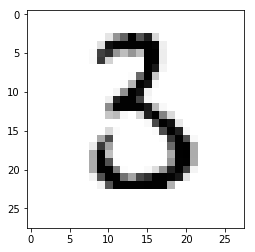

Pred value: 4
True value: 9


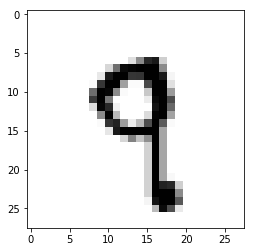

Pred value: 5
True value: 8


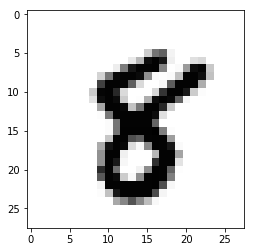

Pred value: 6
True value: 0


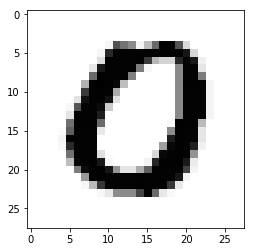

Pred value: 3
True value: 5


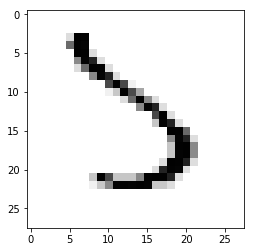

Pred value: 3
True value: 8


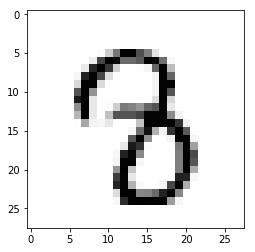

Pred value: 4
True value: 9


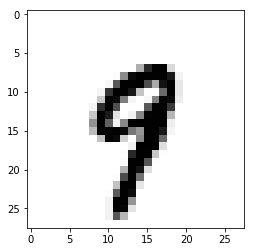

Pred value: 3
True value: 8


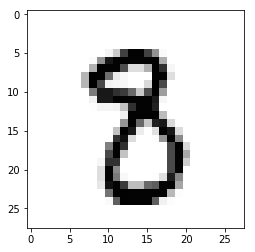

Pred value: 1
True value: 0


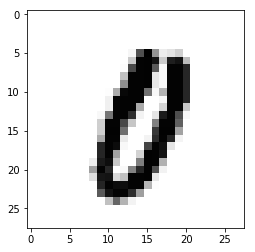

Pred value: 6
True value: 0


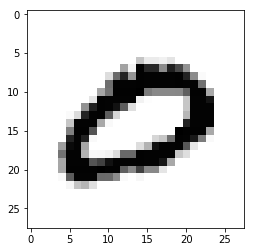

Pred value: 1
True value: 2


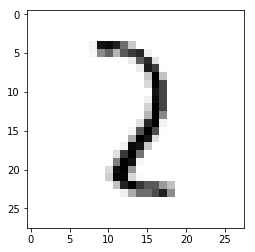

Pred value: 6
True value: 2


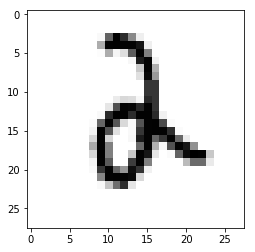

Pred value: 4
True value: 9


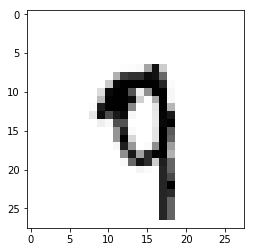

Pred value: 6
True value: 8


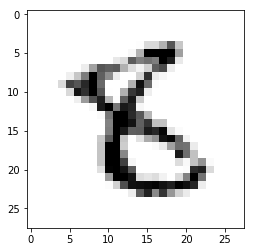

Pred value: 4
True value: 9


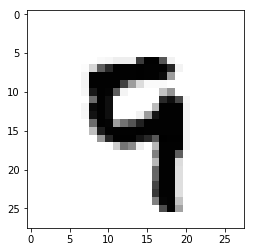

Pred value: 4
True value: 9


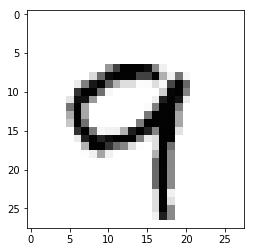

Pred value: 4
True value: 9


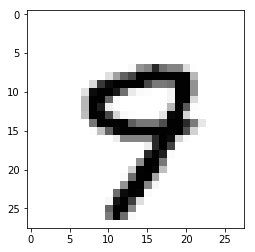

Pred value: 6
True value: 8


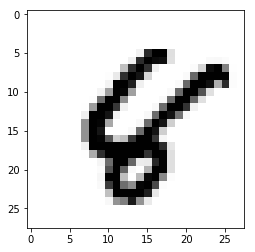

Pred value: 4
True value: 9


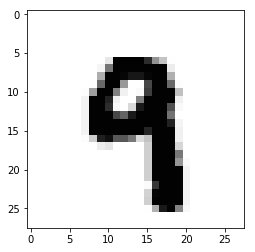

Pred value: 4
True value: 9


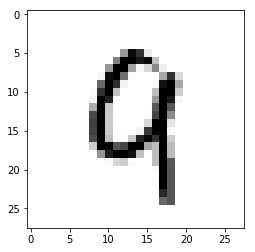

Pred value: 1
True value: 8


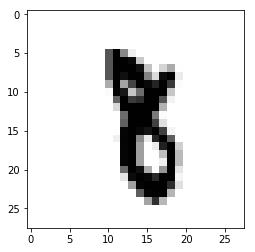

Pred value: 4
True value: 9


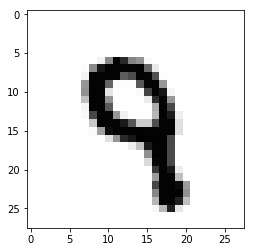

Pred value: 6
True value: 0


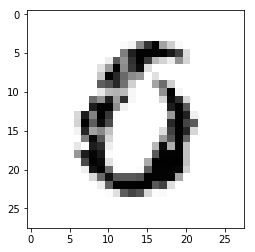

Pred value: 4
True value: 9


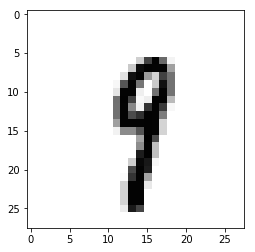

Pred value: 1
True value: 8


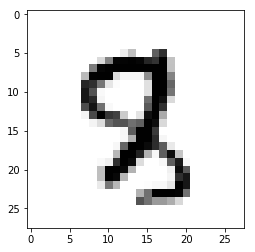

Pred value: 5
True value: 8


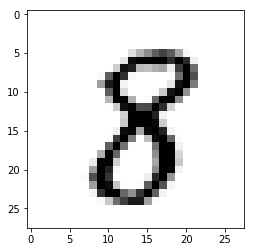

Pred value: 6
True value: 0


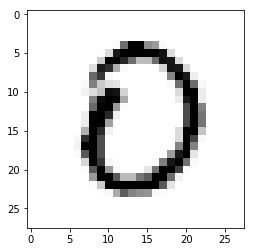

Pred value: 6
True value: 5


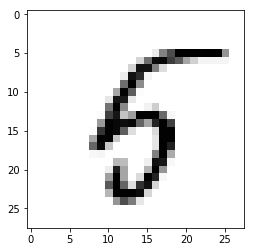

Pred value: 4
True value: 9


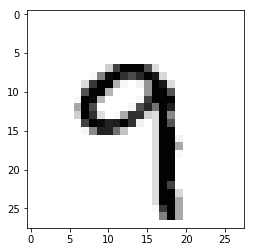

Pred value: 4
True value: 9


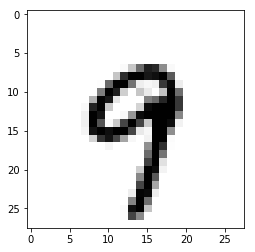

Pred value: 5
True value: 0


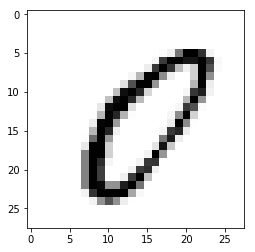

Pred value: 4
True value: 9


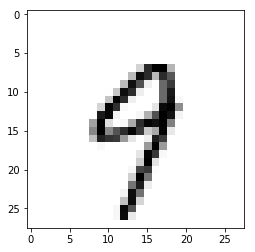

Pred value: 4
True value: 2


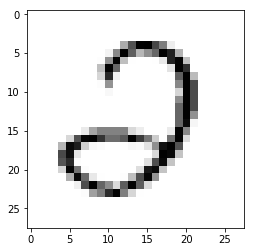

Pred value: 3
True value: 8


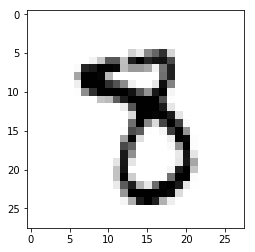

Pred value: 6
True value: 0


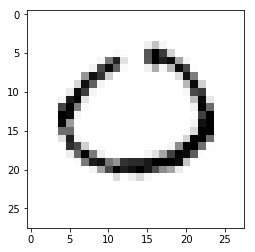

Pred value: 6
True value: 3


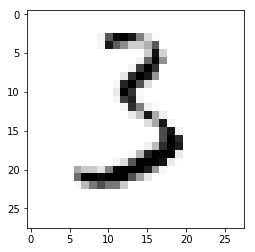

Pred value: 3
True value: 8


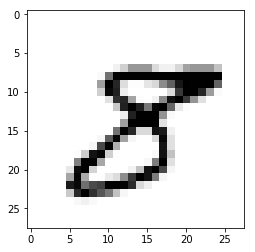

Pred value: 1
True value: 8


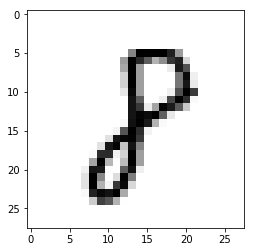

Pred value: 6
True value: 5


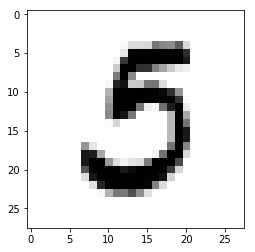

Pred value: 4
True value: 9


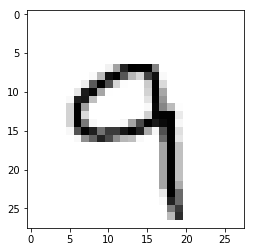

Pred value: 4
True value: 9


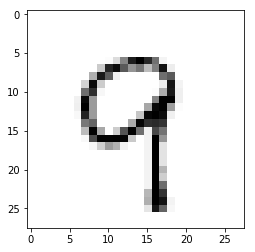

Pred value: 6
True value: 0


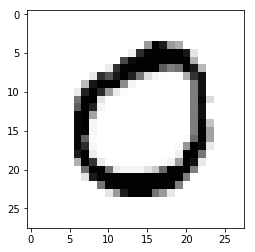

Pred value: 7
True value: 9


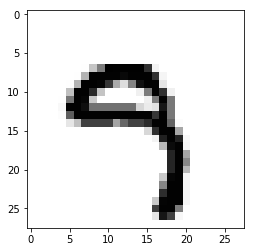

Pred value: 6
True value: 3


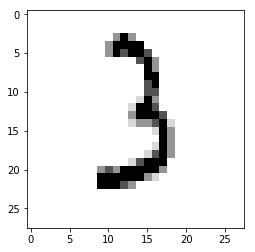

Pred value: 3
True value: 8


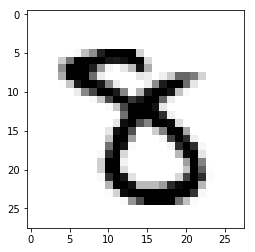

Pred value: 1
True value: 7


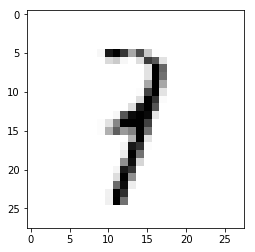

Pred value: 4
True value: 9


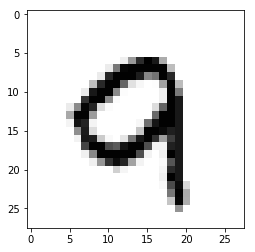

Pred value: 6
True value: 8


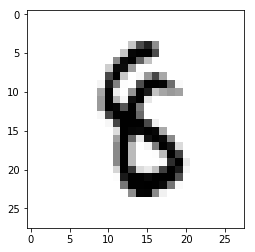

Pred value: 4
True value: 9


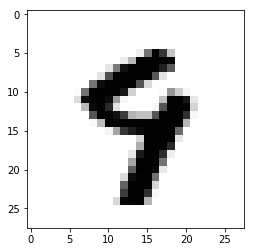

Pred value: 4
True value: 9


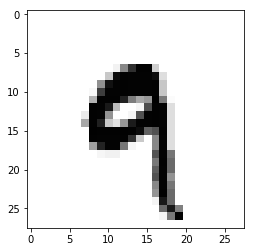

Pred value: 6
True value: 0


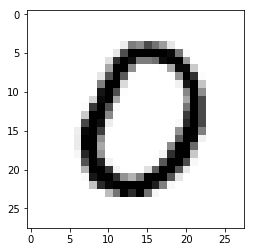

Pred value: 6
True value: 8


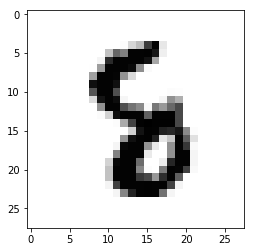

Pred value: 7
True value: 5


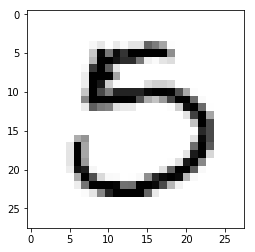

Pred value: 5
True value: 0


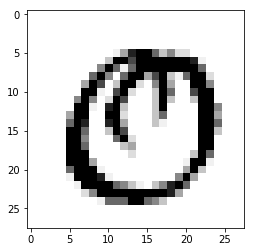

Pred value: 6
True value: 1


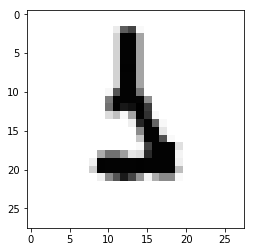

Pred value: 7
True value: 8


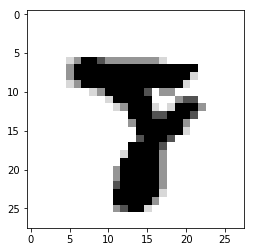

Pred value: 4
True value: 9


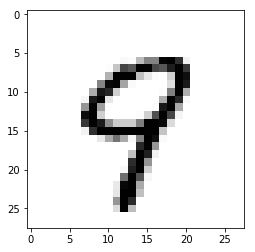

Pred value: 6
True value: 0


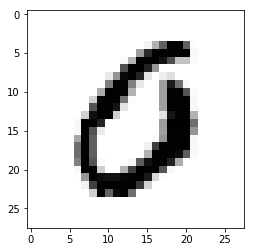

Pred value: 6
True value: 0


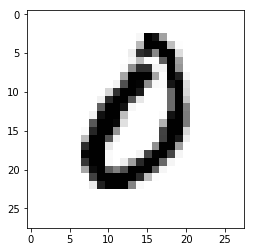

Pred value: 6
True value: 8


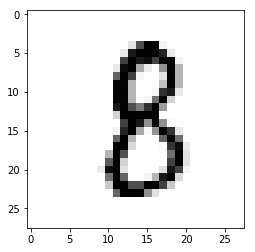

Pred value: 4
True value: 9


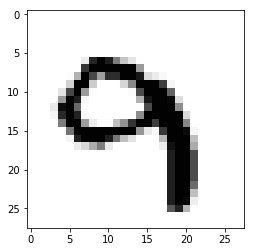

Pred value: 6
True value: 9


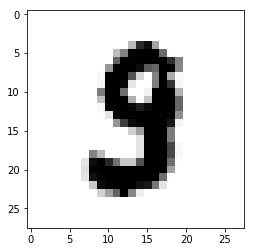

Pred value: 7
True value: 9


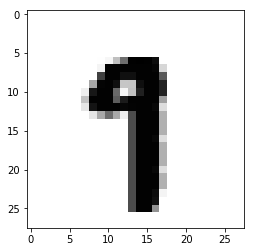

Pred value: 5
True value: 8


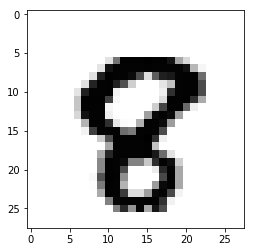

Pred value: 7
True value: 9


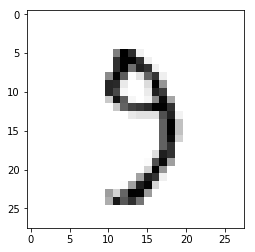

Pred value: 6
True value: 8


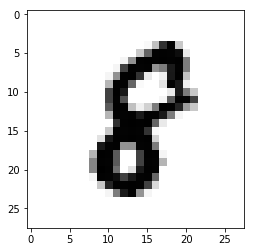

Pred value: 0
True value: 8


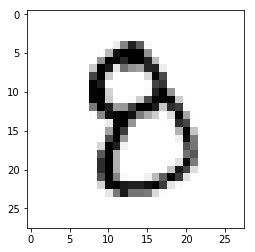

Pred value: 6
True value: 0


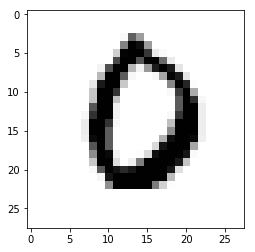

Pred value: 7
True value: 8


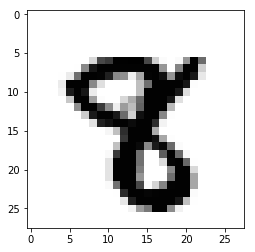

Pred value: 5
True value: 8


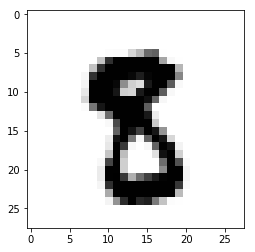

Pred value: 6
True value: 0


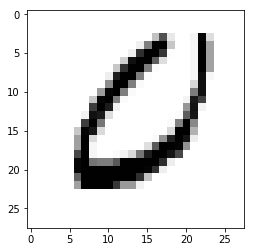

Pred value: 5
True value: 8


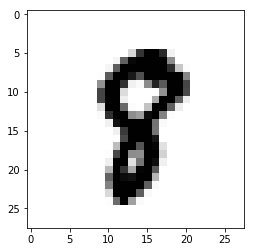

Pred value: 6
True value: 8


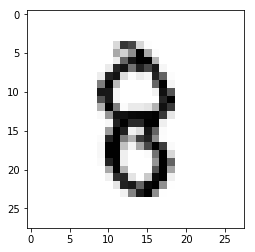

Pred value: 6
True value: 2


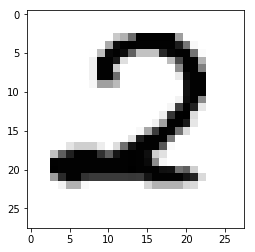

Pred value: 4
True value: 7


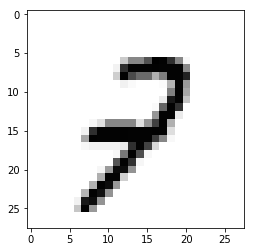

Pred value: 7
True value: 8


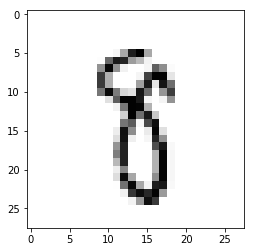

Pred value: 5
True value: 8


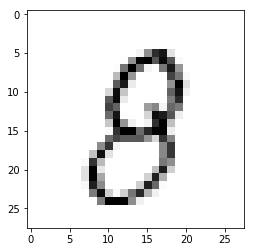

Pred value: 6
True value: 0


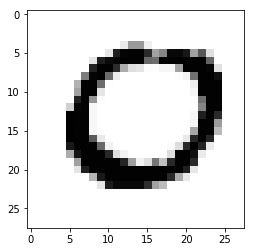

Pred value: 4
True value: 9


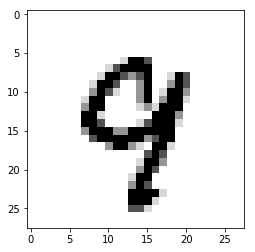

Pred value: 4
True value: 9


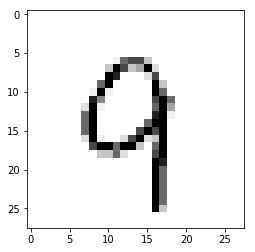

Pred value: 7
True value: 9


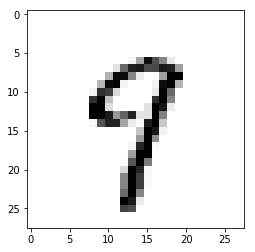

Pred value: 6
True value: 2


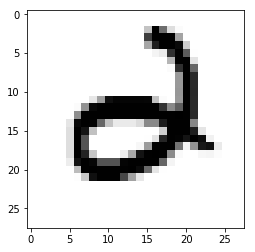

Pred value: 6
True value: 3


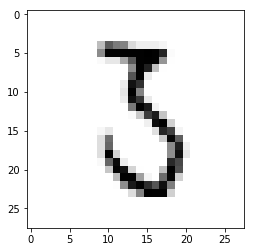

Pred value: 7
True value: 8


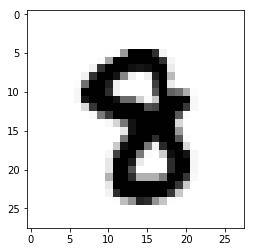

Pred value: 7
True value: 5


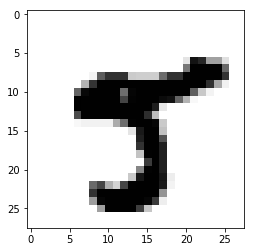

Pred value: 6
True value: 0


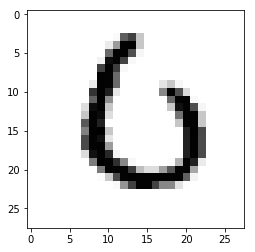

Pred value: 4
True value: 9


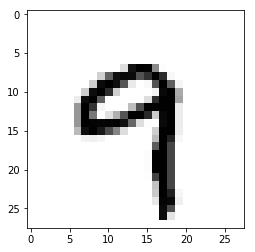

Pred value: 4
True value: 9


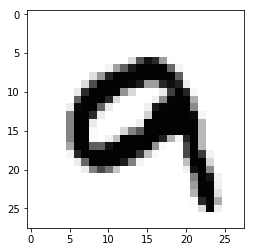

Pred value: 7
True value: 9


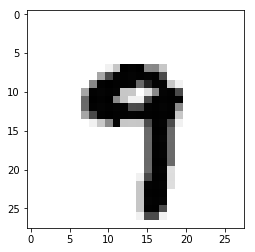

Pred value: 7
True value: 4


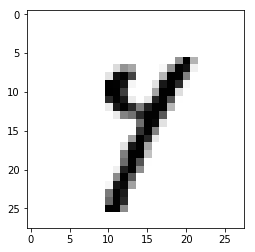

Pred value: 6
True value: 5


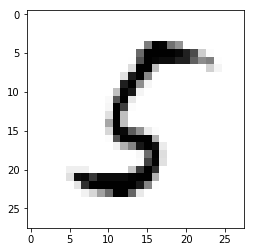

Pred value: 6
True value: 5


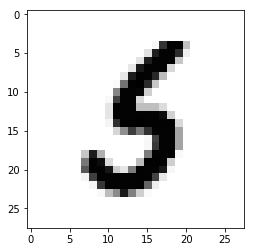

Pred value: 6
True value: 0


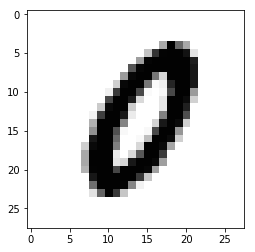

Pred value: 4
True value: 9


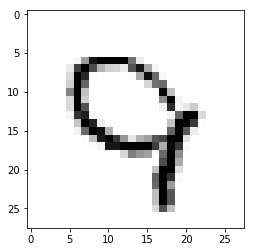

Pred value: 6
True value: 5


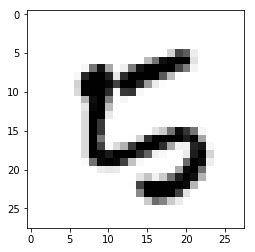

Pred value: 6
True value: 2


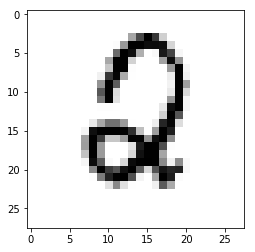

Pred value: 3
True value: 2


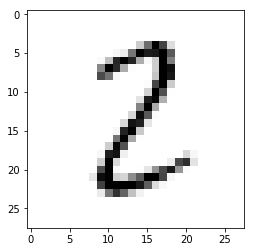

Pred value: 4
True value: 9


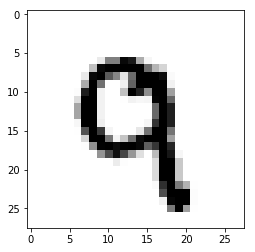

Pred value: 4
True value: 9


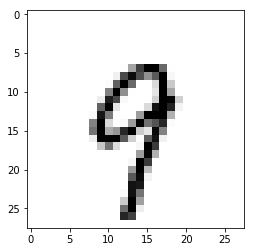

Pred value: 7
True value: 9


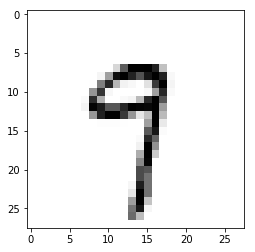

Pred value: 6
True value: 0


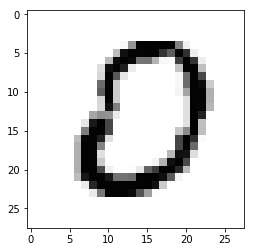

Pred value: 4
True value: 9


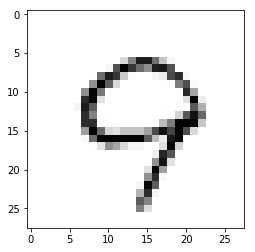

Pred value: 1
True value: 7


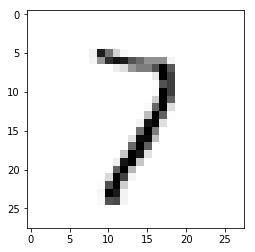

Pred value: 7
True value: 8


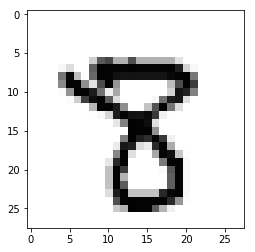

Pred value: 5
True value: 8


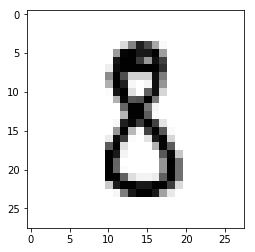

Pred value: 4
True value: 9


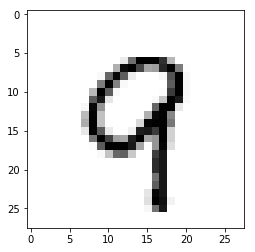

Pred value: 4
True value: 9


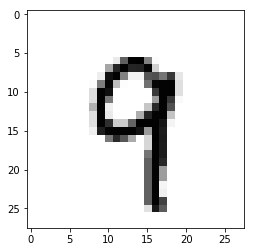

Pred value: 5
True value: 8


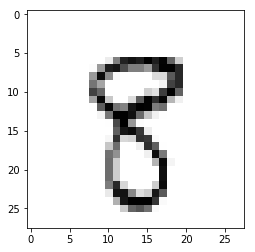

Pred value: 6
True value: 8


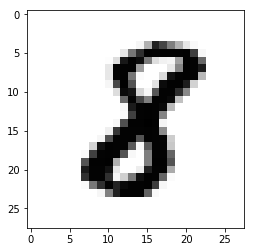

Pred value: 6
True value: 2


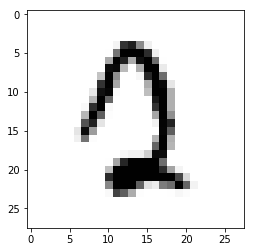

Pred value: 7
True value: 3


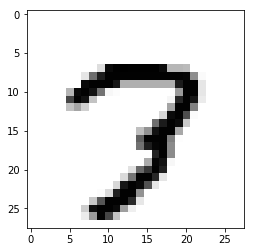

Pred value: 6
True value: 2


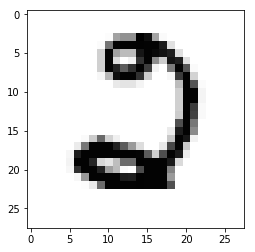

Pred value: 6
True value: 8


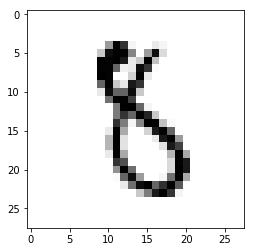

Pred value: 1
True value: 8


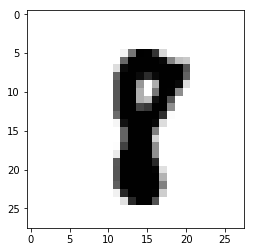

Pred value: 4
True value: 2


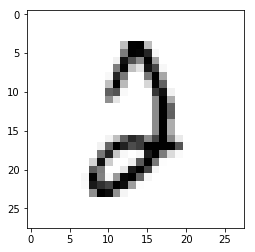

Pred value: 6
True value: 0


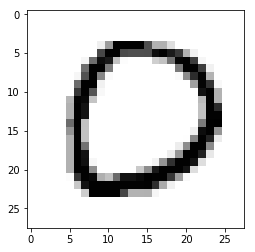

Pred value: 1
True value: 8


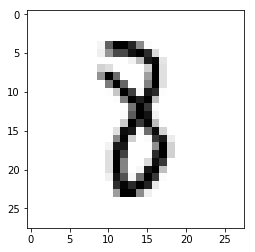

Pred value: 7
True value: 9


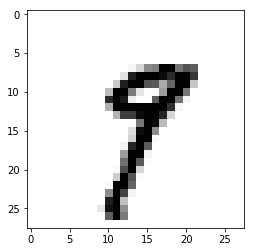

Pred value: 6
True value: 2


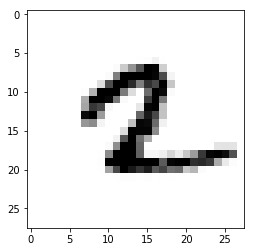

Pred value: 4
True value: 9


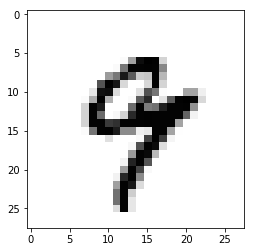

Pred value: 7
True value: 4


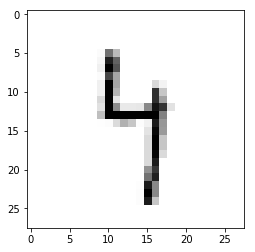

Pred value: 5
True value: 8


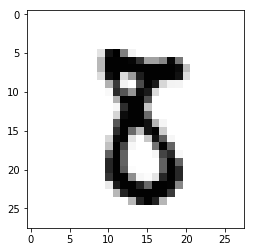

Pred value: 6
True value: 0


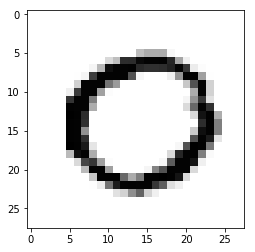

Pred value: 7
True value: 9


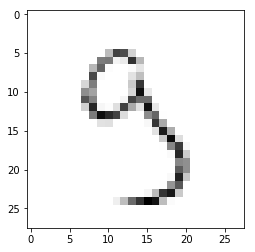

Pred value: 6
True value: 0


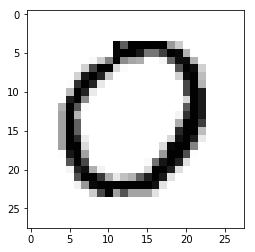

Pred value: 5
True value: 9


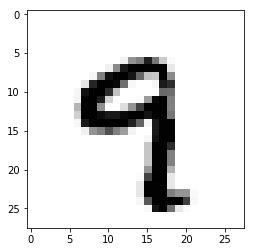

Pred value: 1
True value: 7


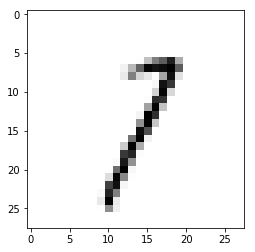

Pred value: 6
True value: 8


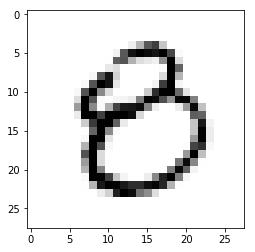

Pred value: 4
True value: 7


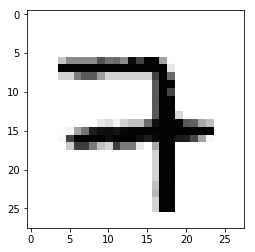

Pred value: 1
True value: 8


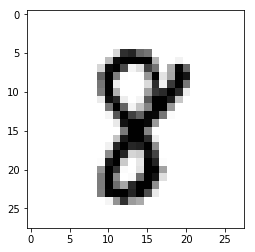

Pred value: 4
True value: 2


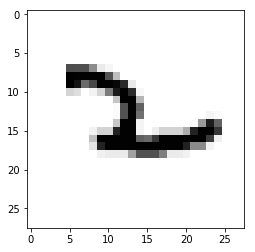

Pred value: 6
True value: 0


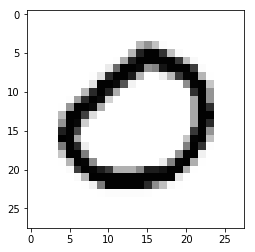

Pred value: 5
True value: 9


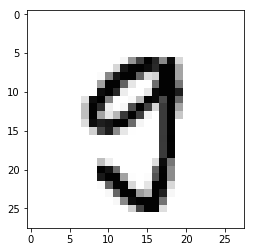

Pred value: 2
True value: 5


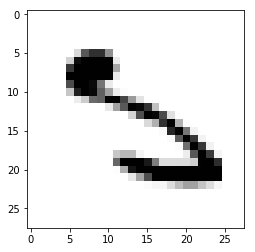

Pred value: 6
True value: 0


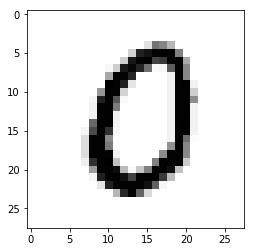

Pred value: 6
True value: 8


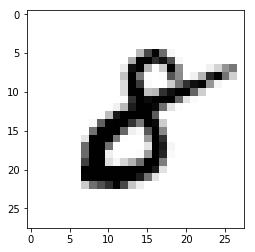

Pred value: 1
True value: 7


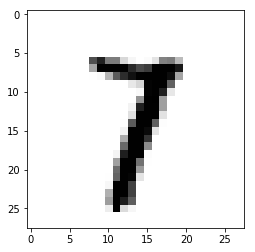

Pred value: 4
True value: 9


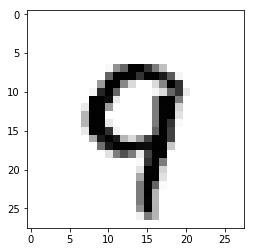

Pred value: 4
True value: 9


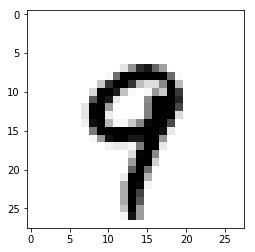

Pred value: 4
True value: 0


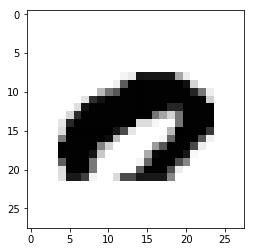

Pred value: 2
True value: 7


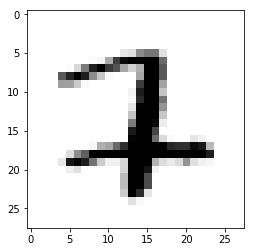

Pred value: 6
True value: 5


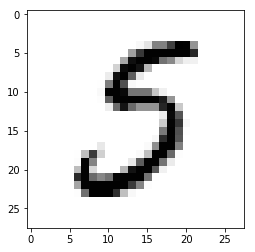

Pred value: 5
True value: 8


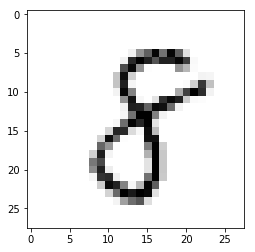

Pred value: 6
True value: 0


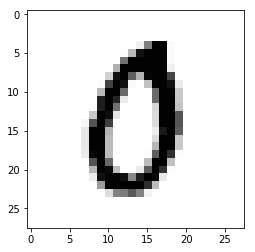

Pred value: 6
True value: 8


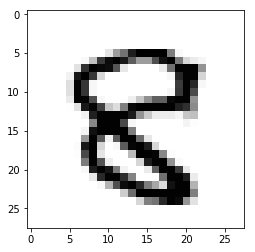

Pred value: 6
True value: 8


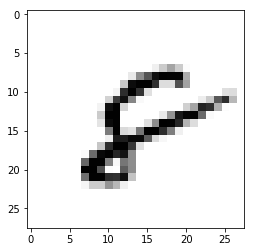

Pred value: 6
True value: 0


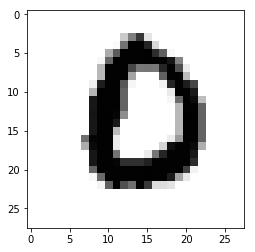

Pred value: 6
True value: 1


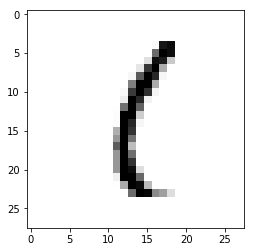

Pred value: 5
True value: 8


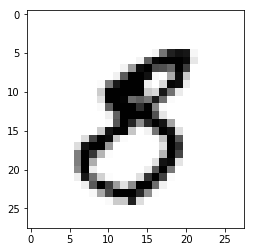

Pred value: 6
True value: 0


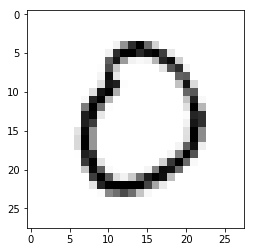

Pred value: 6
True value: 9


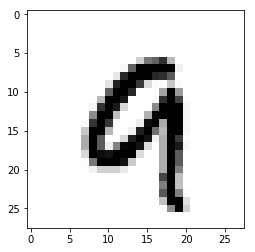

Pred value: 7
True value: 8


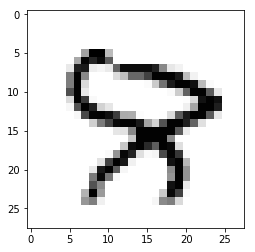

Pred value: 4
True value: 9


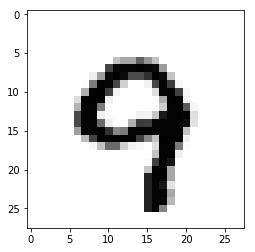

Pred value: 4
True value: 9


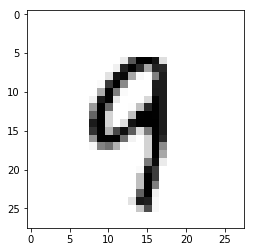

Pred value: 7
True value: 2


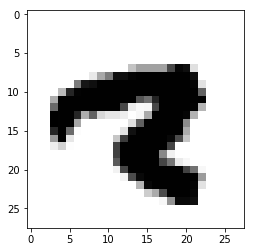

Pred value: 4
True value: 9


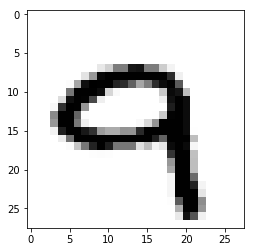

Pred value: 6
True value: 0


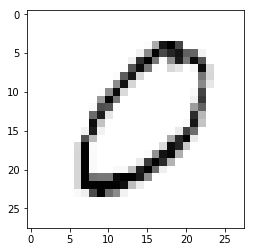

Pred value: 6
True value: 0


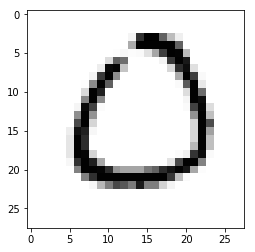

Pred value: 4
True value: 6


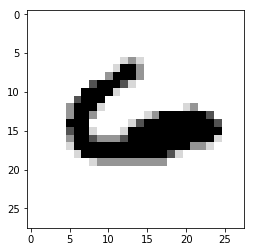

Pred value: 4
True value: 9


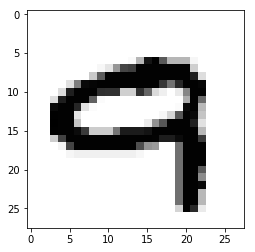

Pred value: 6
True value: 2


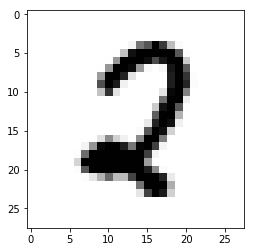

Pred value: 6
True value: 0


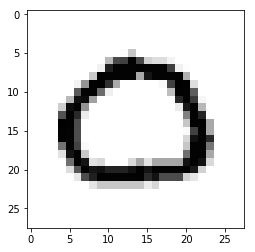

Pred value: 6
True value: 0


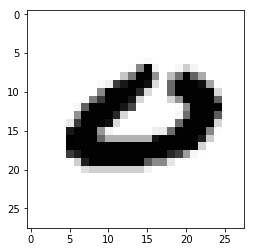

Pred value: 4
True value: 9


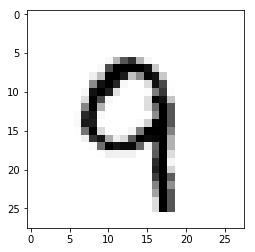

Pred value: 5
True value: 8


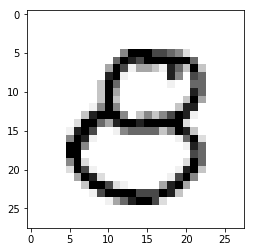

Pred value: 6
True value: 2


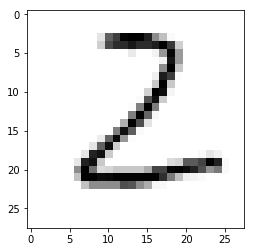

Pred value: 4
True value: 9


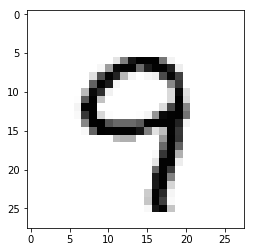

Pred value: 6
True value: 8


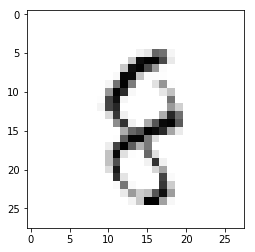

Pred value: 4
True value: 9


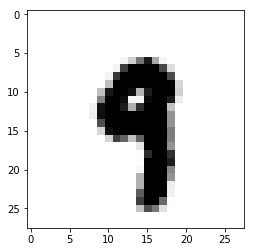

Pred value: 6
True value: 8


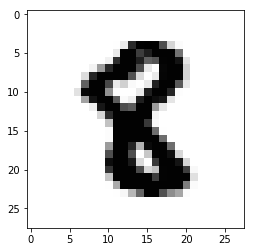

Pred value: 7
True value: 3


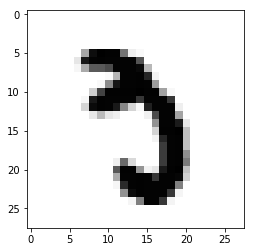

Pred value: 5
True value: 3


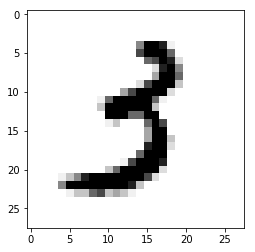

Pred value: 3
True value: 2


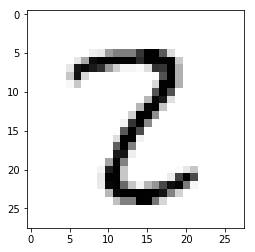

Pred value: 6
True value: 2


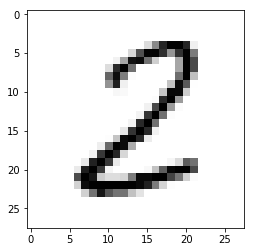

Pred value: 6
True value: 0


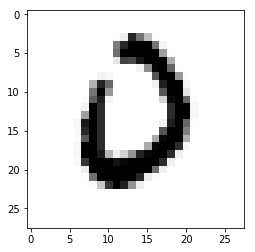

Pred value: 7
True value: 8


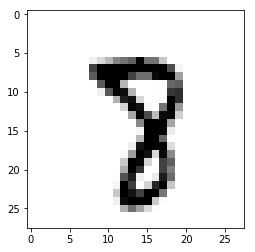

Pred value: 4
True value: 9


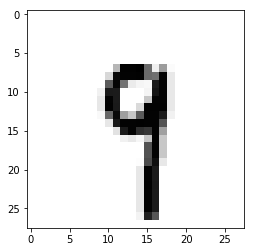

Pred value: 4
True value: 9


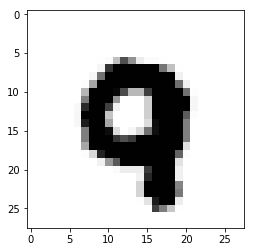

Pred value: 4
True value: 8


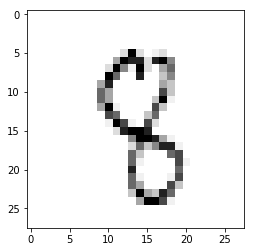

Pred value: 6
True value: 5


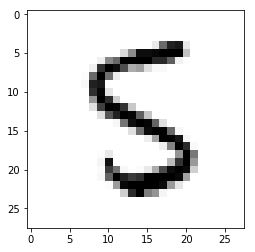

Pred value: 4
True value: 1


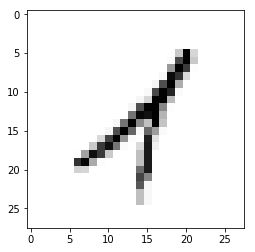

Pred value: 4
True value: 9


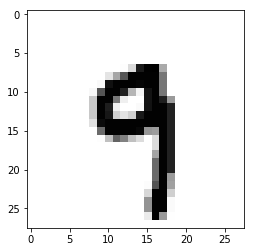

Pred value: 4
True value: 9


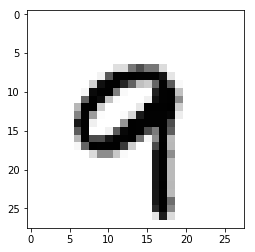

Pred value: 6
True value: 5


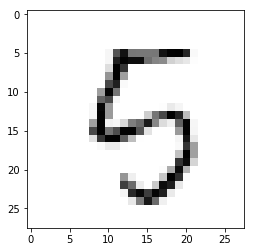

Pred value: 5
True value: 8


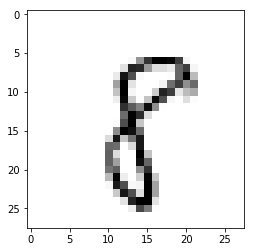

Pred value: 3
True value: 8


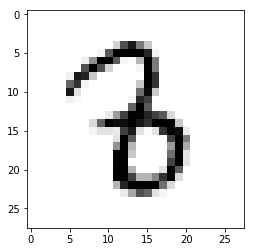

Pred value: 7
True value: 9


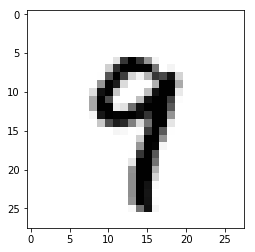

Pred value: 7
True value: 8


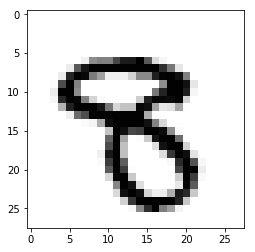

Pred value: 2
True value: 8


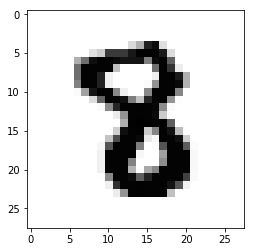

Pred value: 5
True value: 9


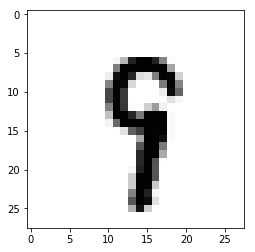

Pred value: 6
True value: 0


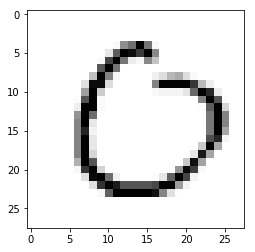

Pred value: 1
True value: 8


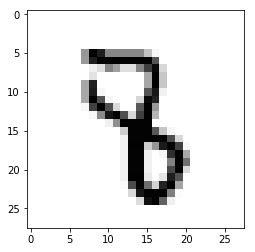

Pred value: 4
True value: 9


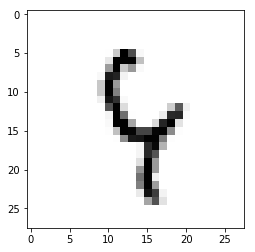

Pred value: 4
True value: 7


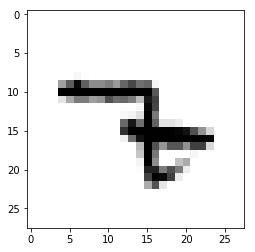

Pred value: 4
True value: 9


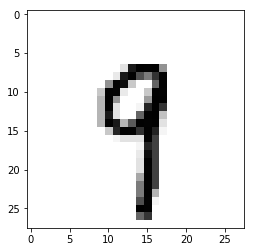

Pred value: 4
True value: 9


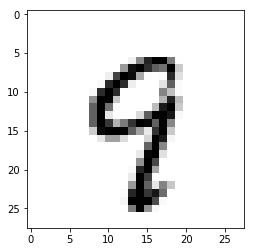

Pred value: 1
True value: 8


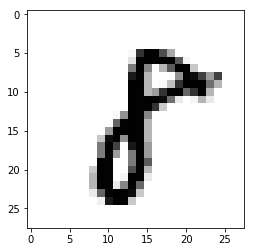

Pred value: 5
True value: 8


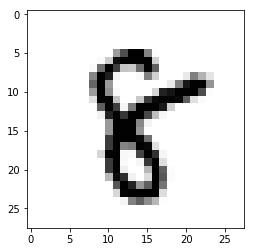

Pred value: 6
True value: 0


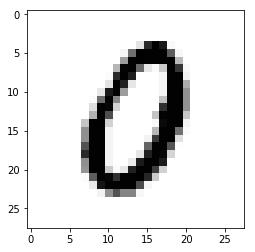

Pred value: 4
True value: 3


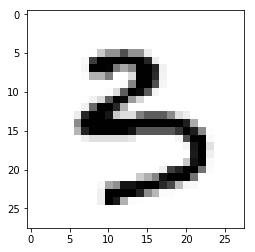

Pred value: 6
True value: 2


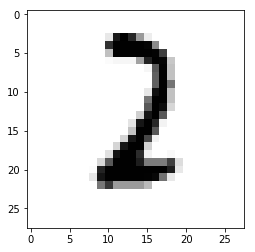

Pred value: 4
True value: 2


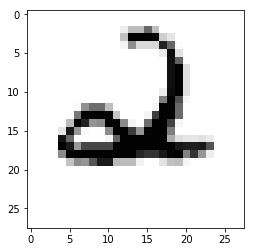

Pred value: 6
True value: 5


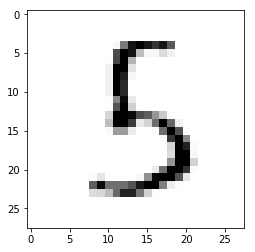

Pred value: 3
True value: 7


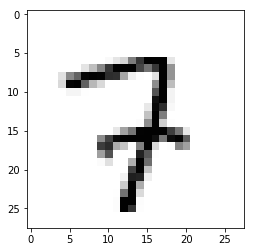

Pred value: 6
True value: 4


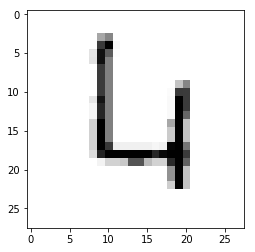

Pred value: 4
True value: 7


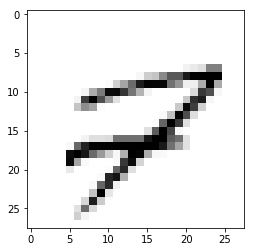

Pred value: 6
True value: 8


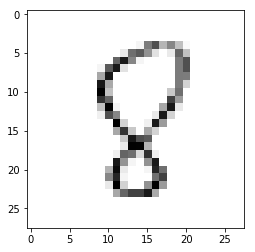

Pred value: 6
True value: 0


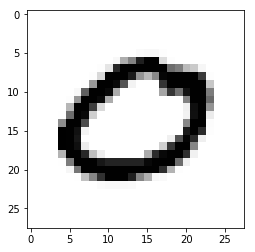

Pred value: 5
True value: 8


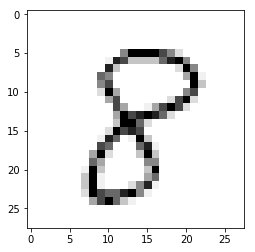

Pred value: 7
True value: 9


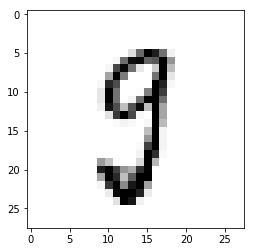

Pred value: 6
True value: 8


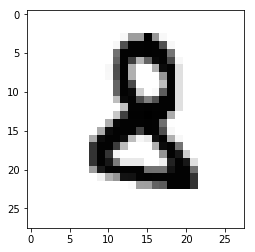

Pred value: 6
True value: 2


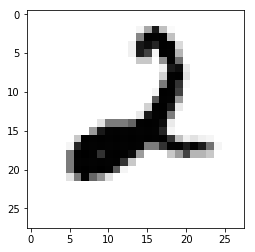

Pred value: 6
True value: 8


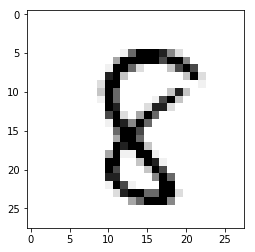

Pred value: 6
True value: 8


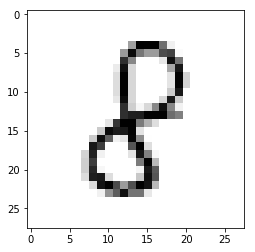

Pred value: 4
True value: 9


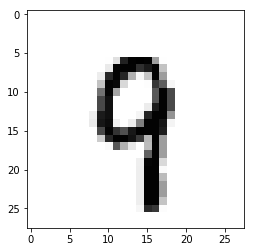

Pred value: 6
True value: 2


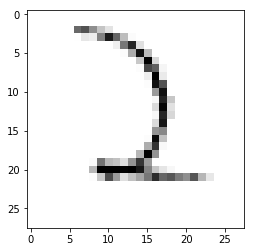

Pred value: 5
True value: 8


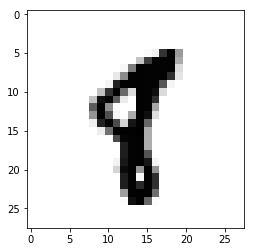

Pred value: 5
True value: 8


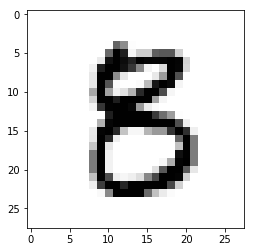

Pred value: 4
True value: 9


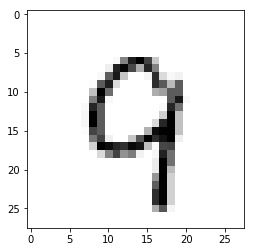

Pred value: 6
True value: 2


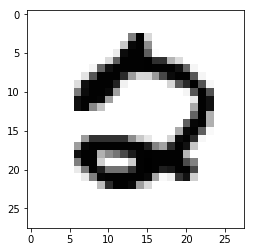

Pred value: 6
True value: 0


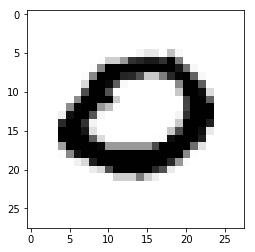

Pred value: 5
True value: 9


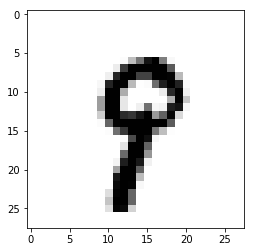

Pred value: 4
True value: 9


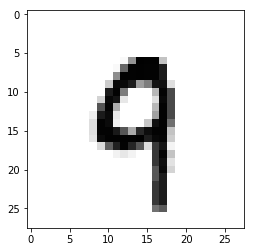

Pred value: 7
True value: 8


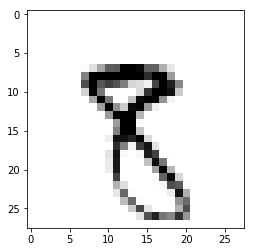

Pred value: 5
True value: 3


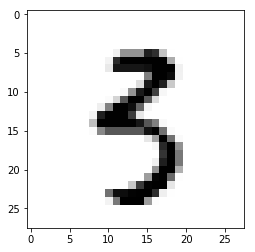

Pred value: 6
True value: 9


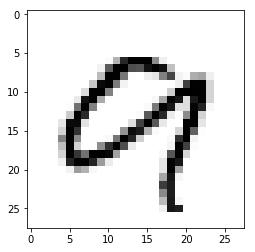

Pred value: 4
True value: 9


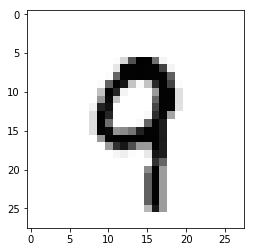

Pred value: 4
True value: 7


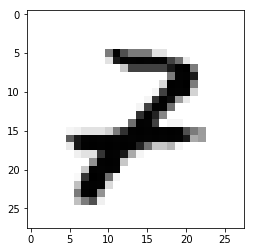

Pred value: 4
True value: 9


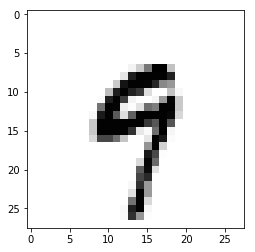

Pred value: 5
True value: 0


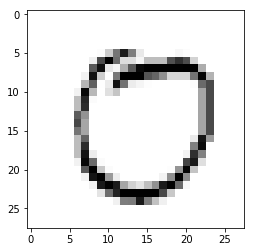

Pred value: 4
True value: 7


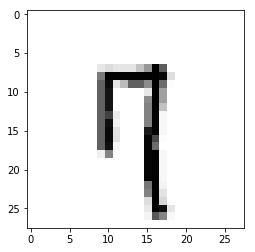

Pred value: 6
True value: 0


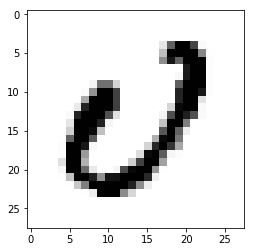

Pred value: 6
True value: 5


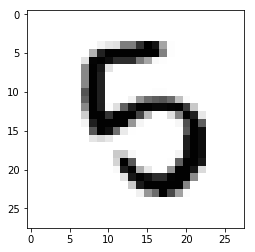

Pred value: 1
True value: 8


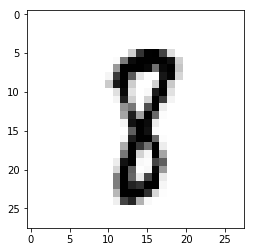

Pred value: 4
True value: 5


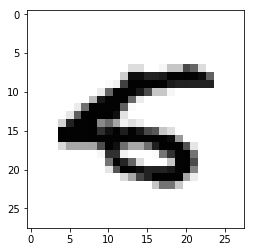

Pred value: 7
True value: 2


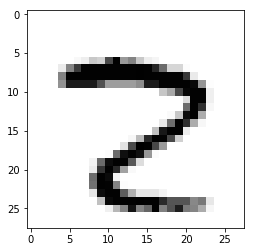

Pred value: 4
True value: 9


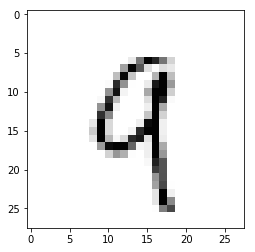

Pred value: 1
True value: 8


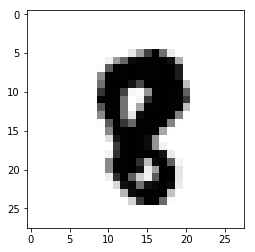

Pred value: 6
True value: 8


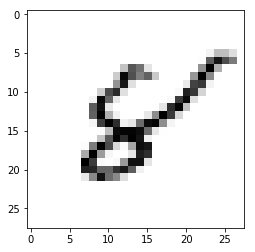

Pred value: 4
True value: 9


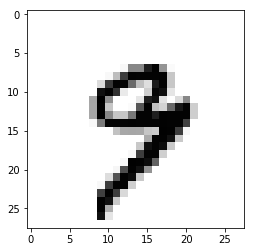

Pred value: 6
True value: 2


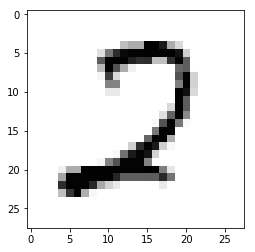

Pred value: 6
True value: 8


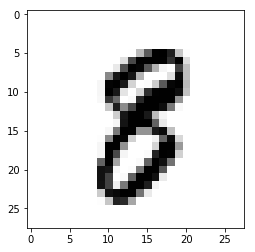

Pred value: 6
True value: 0


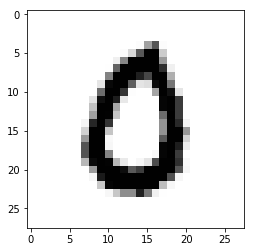

Pred value: 6
True value: 8


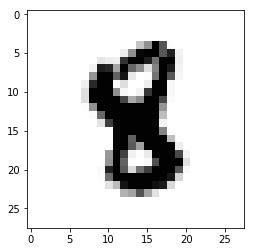

Pred value: 6
True value: 0


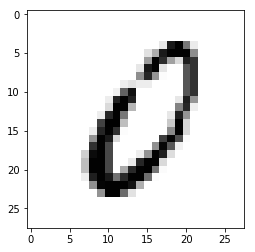

Pred value: 4
True value: 9


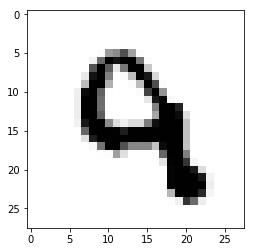

Pred value: 4
True value: 7


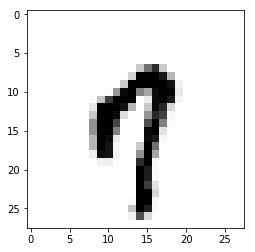

Pred value: 6
True value: 5


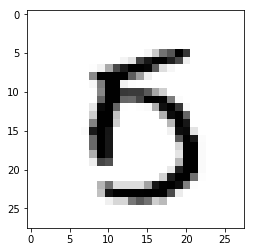

Pred value: 6
True value: 0


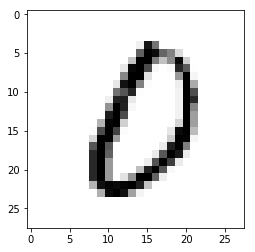

Pred value: 4
True value: 9


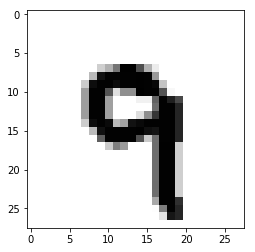

Pred value: 7
True value: 9


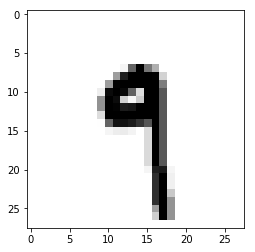

Pred value: 1
True value: 8


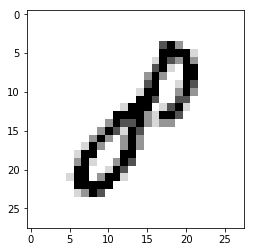

Pred value: 3
True value: 7


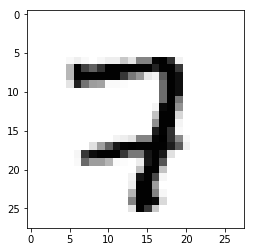

Pred value: 6
True value: 2


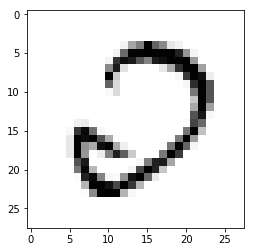

Pred value: 7
True value: 8


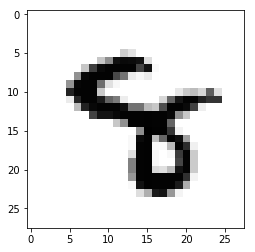

Pred value: 3
True value: 5


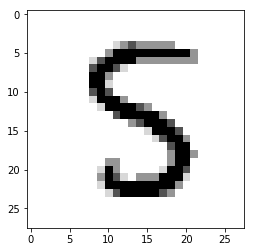

Pred value: 6
True value: 8


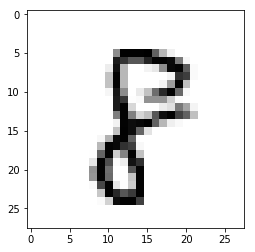

Pred value: 6
True value: 0


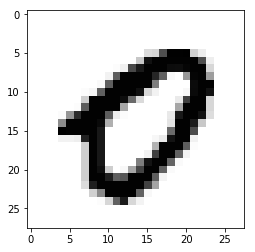

Pred value: 6
True value: 8


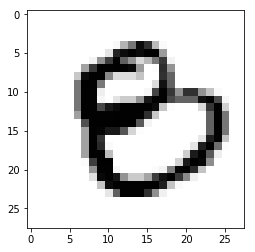

Pred value: 4
True value: 3


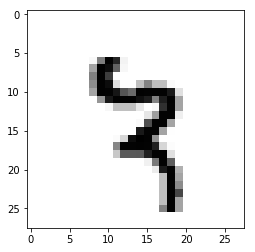

Pred value: 6
True value: 2


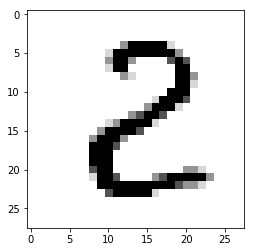

Pred value: 5
True value: 8


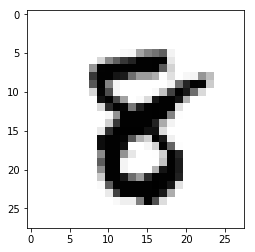

Pred value: 1
True value: 6


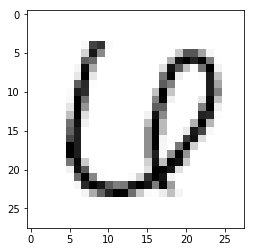

Pred value: 6
True value: 8


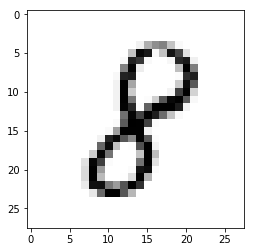

Pred value: 6
True value: 8


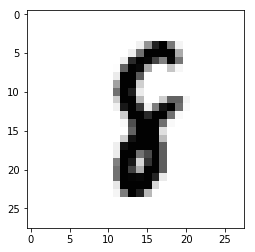

Pred value: 4
True value: 9


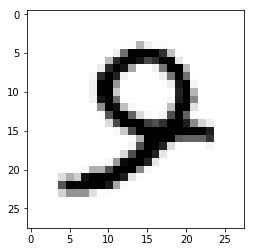

Pred value: 4
True value: 5


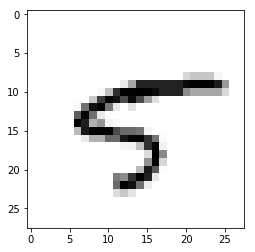

Pred value: 3
True value: 2


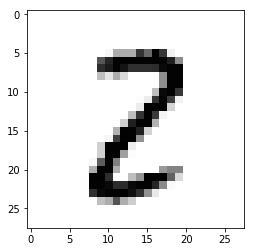

Pred value: 6
True value: 8


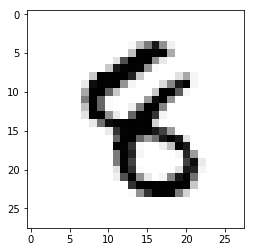

Pred value: 1
True value: 8


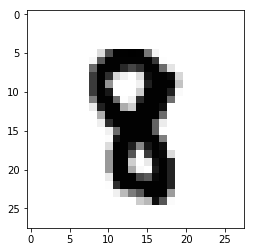

Pred value: 4
True value: 9


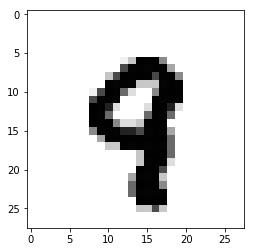

Pred value: 7
True value: 8


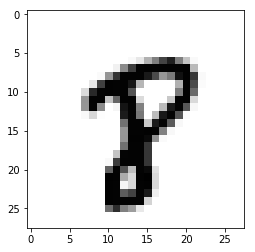

Pred value: 3
True value: 8


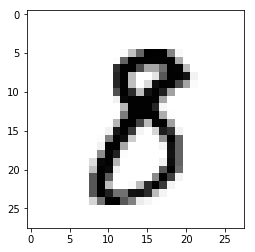

Pred value: 5
True value: 3


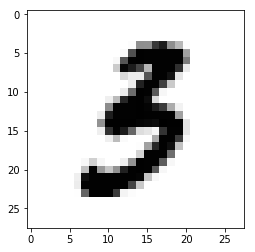

Pred value: 6
True value: 0


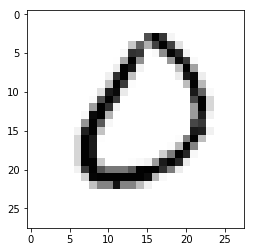

Pred value: 4
True value: 9


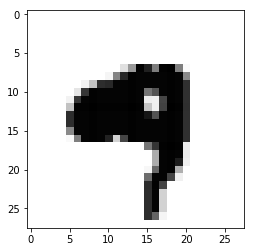

Pred value: 1
True value: 8


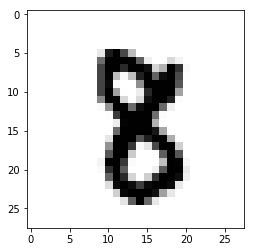

Pred value: 1
True value: 8


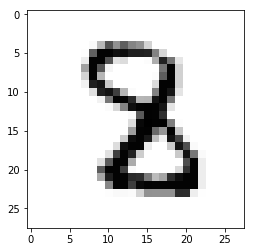

Pred value: 5
True value: 8


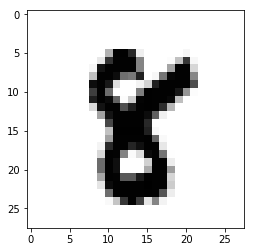

Pred value: 4
True value: 2


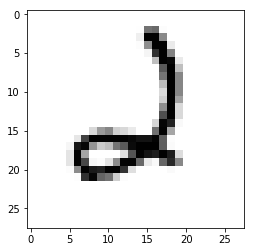

Pred value: 3
True value: 8


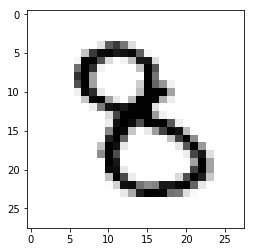

Pred value: 6
True value: 0


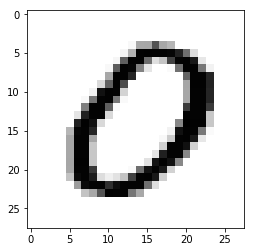

Pred value: 3
True value: 8


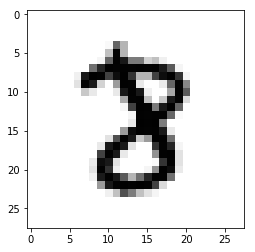

Pred value: 6
True value: 5


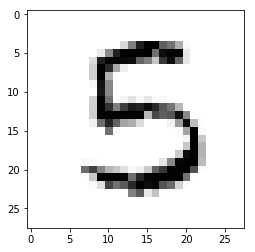

Pred value: 4
True value: 9


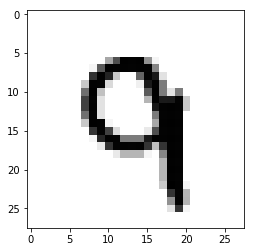

Pred value: 2
True value: 1


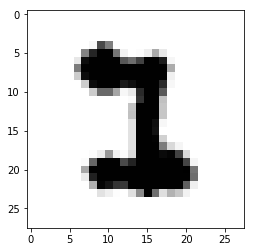

Pred value: 3
True value: 2


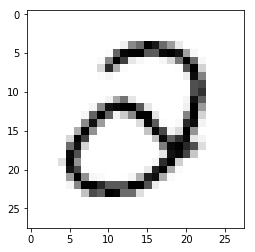

Pred value: 1
True value: 9


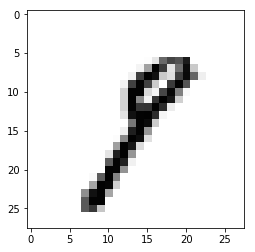

Pred value: 6
True value: 0


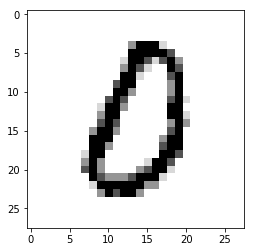

Pred value: 6
True value: 5


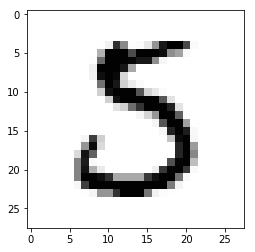

Pred value: 4
True value: 9


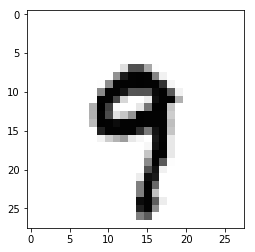

Pred value: 6
True value: 2


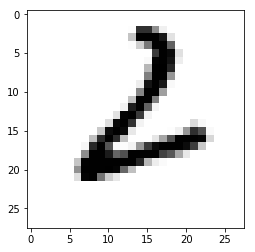

Pred value: 1
True value: 8


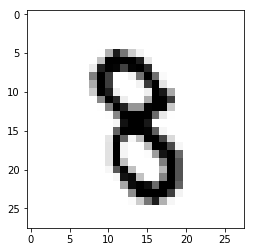

Pred value: 1
True value: 8


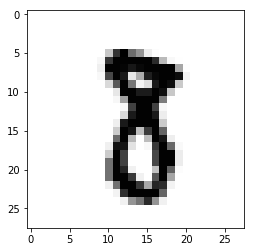

Pred value: 6
True value: 0


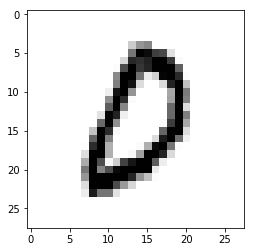

Pred value: 1
True value: 8


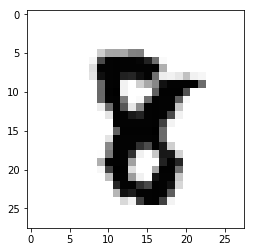

Pred value: 4
True value: 9


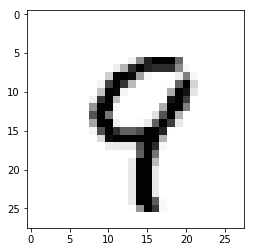

Pred value: 6
True value: 5


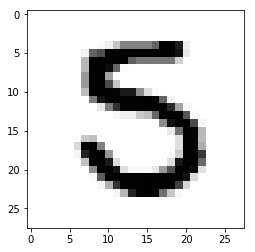

Pred value: 4
True value: 9


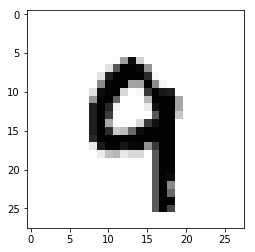

Pred value: 6
True value: 0


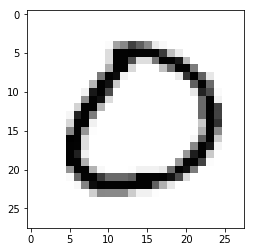

Pred value: 6
True value: 5


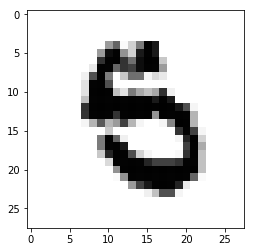

Pred value: 4
True value: 8


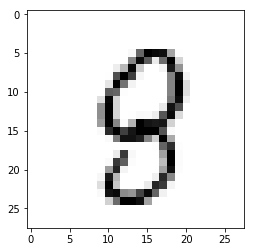

Pred value: 6
True value: 0


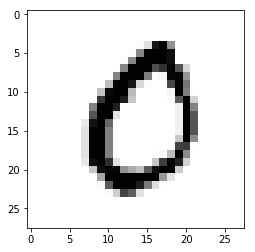

Pred value: 4
True value: 9


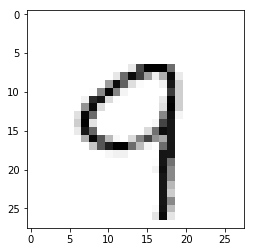

Pred value: 4
True value: 9


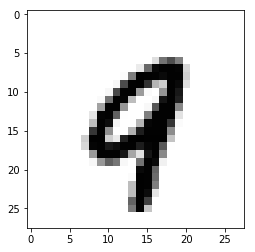

Pred value: 4
True value: 8


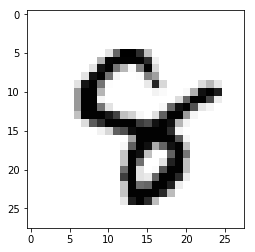

Pred value: 6
True value: 5


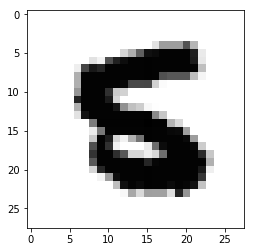

Pred value: 4
True value: 9


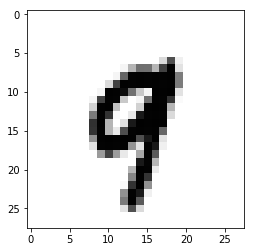

Pred value: 6
True value: 8


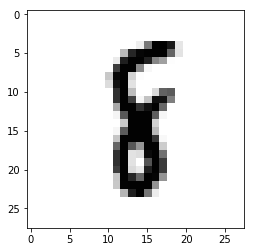

Pred value: 4
True value: 9


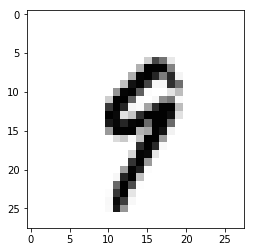

Pred value: 6
True value: 2


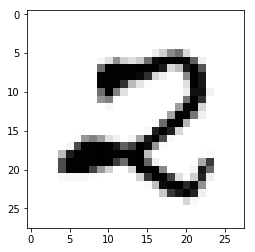

Pred value: 6
True value: 2


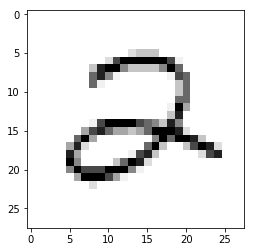

Pred value: 4
True value: 9


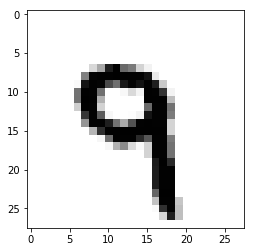

Pred value: 4
True value: 9


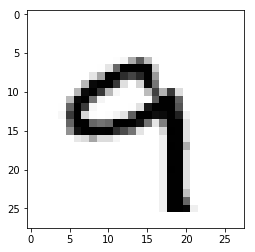

Pred value: 6
True value: 2


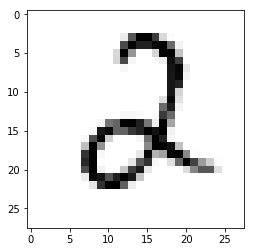

Pred value: 4
True value: 9


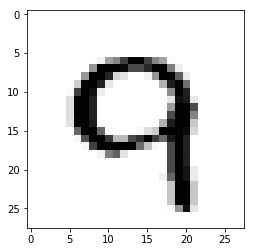

Pred value: 6
True value: 1


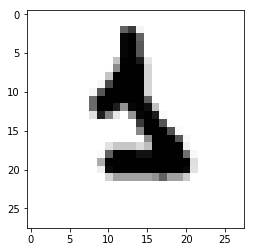

Pred value: 4
True value: 8


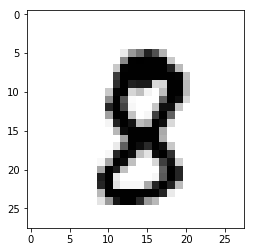

Pred value: 6
True value: 8


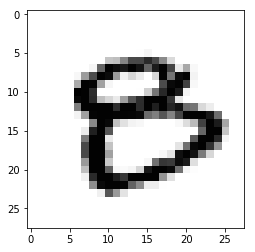

Pred value: 4
True value: 9


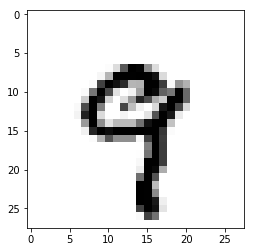

Pred value: 3
True value: 5


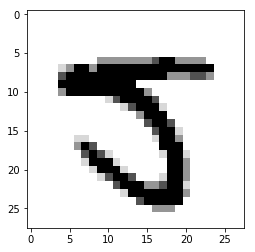

Pred value: 4
True value: 9


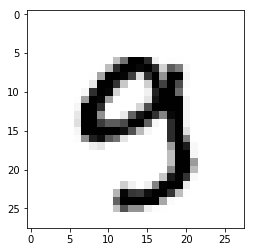

Pred value: 6
True value: 9


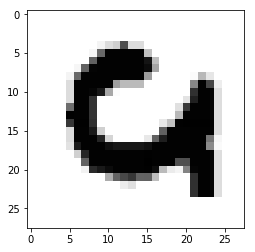

Pred value: 5
True value: 0


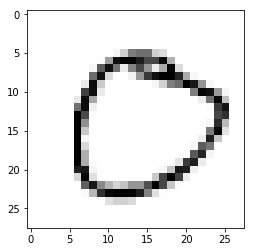

Pred value: 6
True value: 0


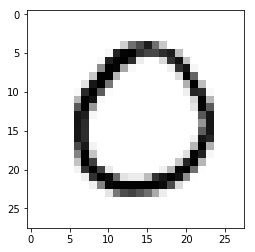

Pred value: 6
True value: 8


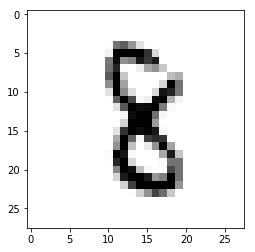

Pred value: 1
True value: 8


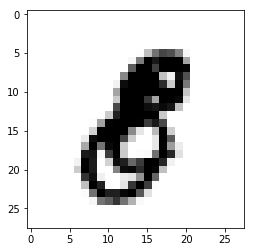

Pred value: 7
True value: 2


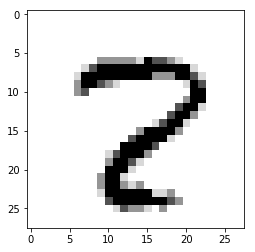

Pred value: 6
True value: 0


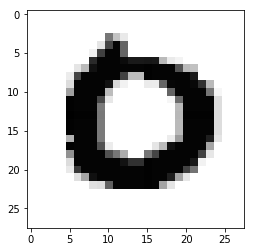

Pred value: 5
True value: 3


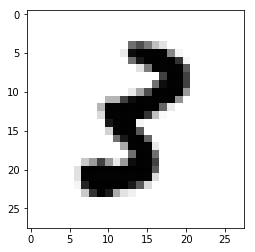

Pred value: 6
True value: 8


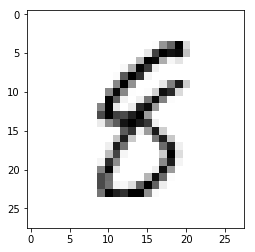

Pred value: 4
True value: 9


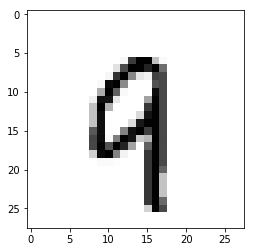

Pred value: 5
True value: 3


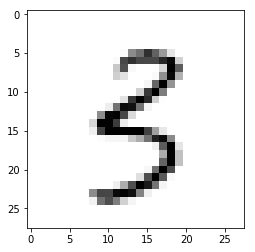

Pred value: 4
True value: 9


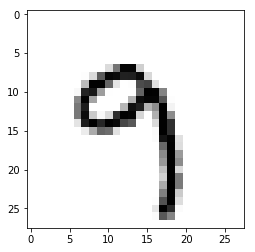

Pred value: 6
True value: 0


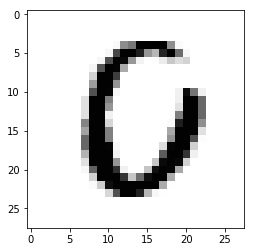

Pred value: 4
True value: 9


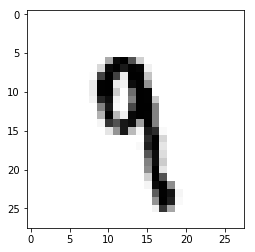

Pred value: 4
True value: 9


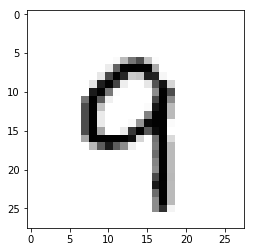

Pred value: 3
True value: 7


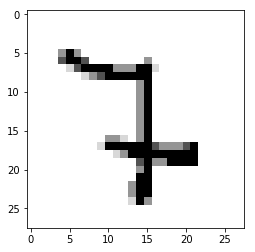

Pred value: 5
True value: 0


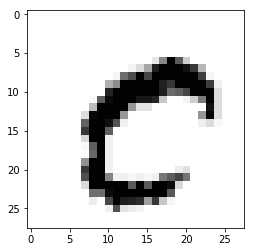

Pred value: 6
True value: 0


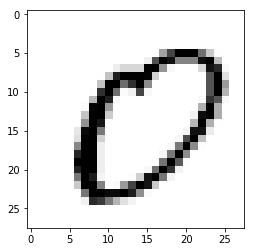

Pred value: 6
True value: 0


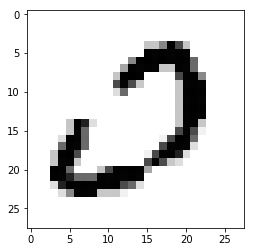

Pred value: 6
True value: 0


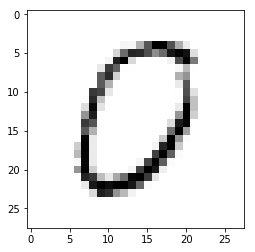

Pred value: 4
True value: 9


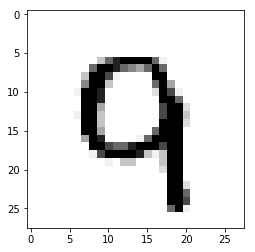

Pred value: 4
True value: 9


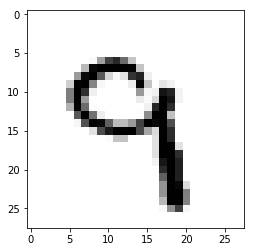

Pred value: 4
True value: 9


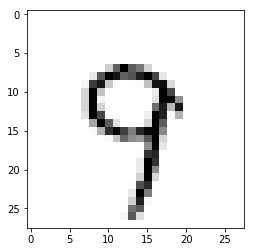

Pred value: 5
True value: 8


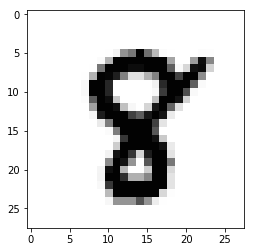

Pred value: 6
True value: 2


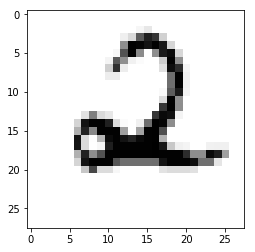

Pred value: 6
True value: 3


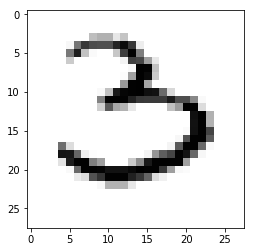

Pred value: 6
True value: 1


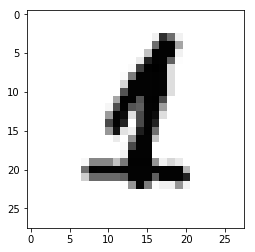

Pred value: 4
True value: 9


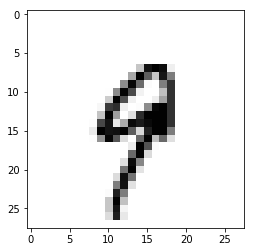

Pred value: 1
True value: 8


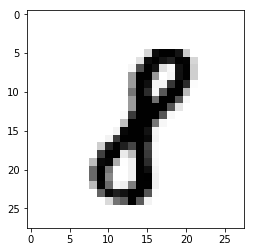

Pred value: 6
True value: 5


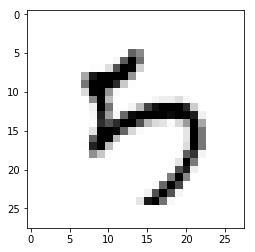

Pred value: 6
True value: 0


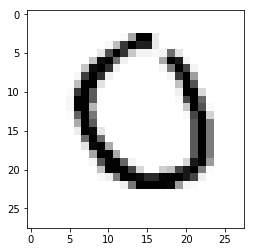

Pred value: 6
True value: 9


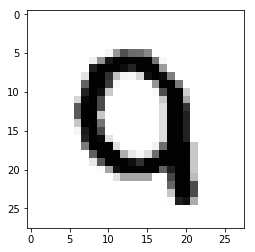

Pred value: 7
True value: 8


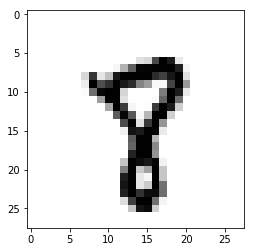

Pred value: 2
True value: 8


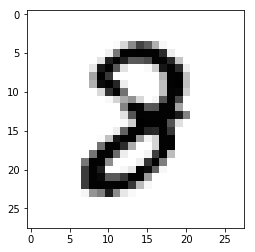

Pred value: 7
True value: 4


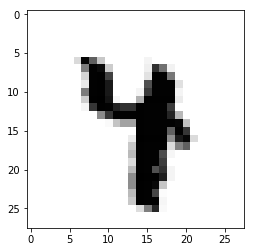

Pred value: 7
True value: 9


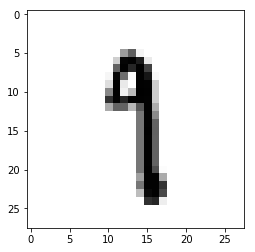

Pred value: 6
True value: 8


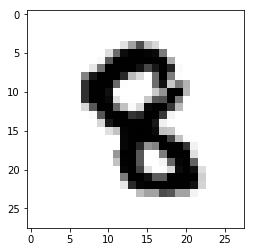

Pred value: 6
True value: 2


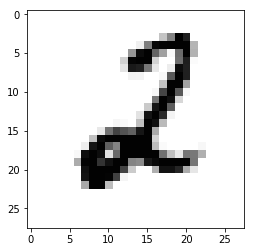

Pred value: 5
True value: 8


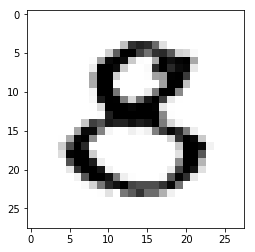

Pred value: 6
True value: 8


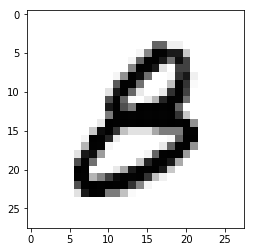

Pred value: 6
True value: 2


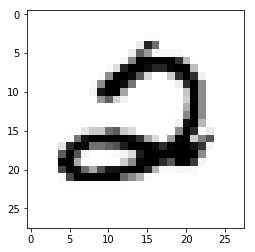

Pred value: 7
True value: 5


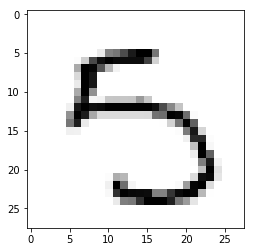

Pred value: 6
True value: 0


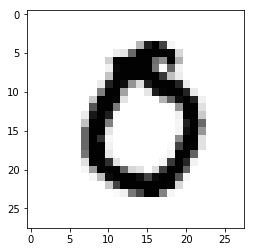

Pred value: 1
True value: 9


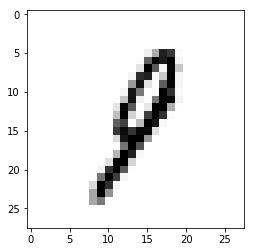

Pred value: 7
True value: 3


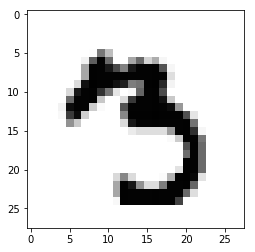

Pred value: 6
True value: 2


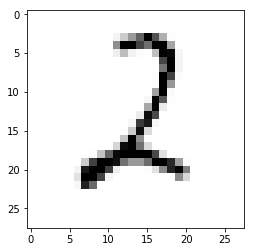

Pred value: 6
True value: 5


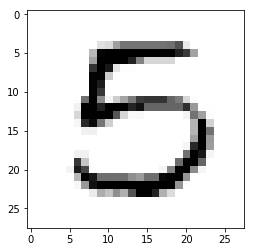

Pred value: 4
True value: 9


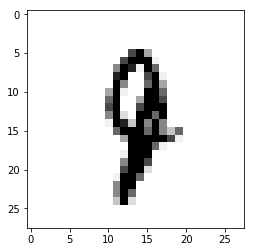

Pred value: 6
True value: 2


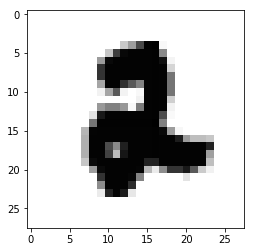

Pred value: 6
True value: 0


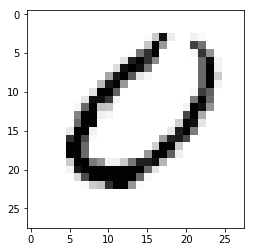

Pred value: 6
True value: 8


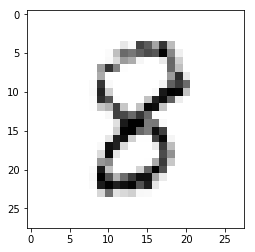

Pred value: 4
True value: 9


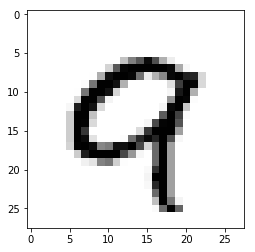

Pred value: 7
True value: 8


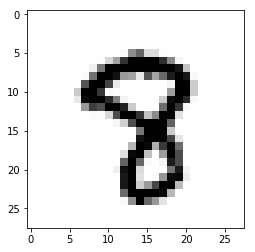

Pred value: 7
True value: 8


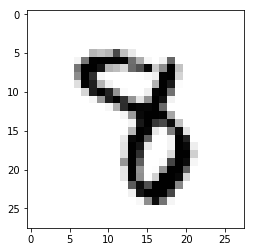

Pred value: 4
True value: 9


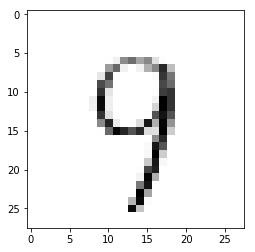

Pred value: 6
True value: 8


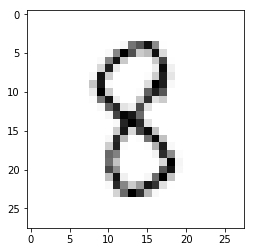

Pred value: 6
True value: 2


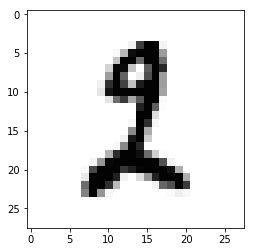

Pred value: 4
True value: 2


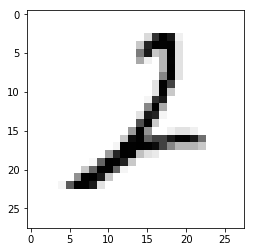

Pred value: 7
True value: 9


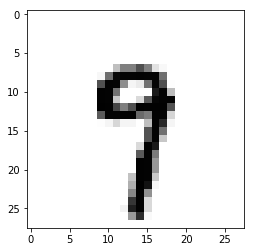

Pred value: 4
True value: 9


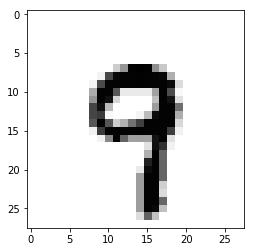

Pred value: 4
True value: 9


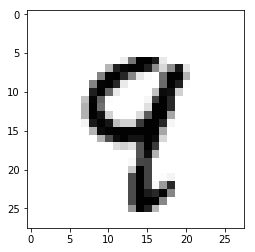

Pred value: 6
True value: 3


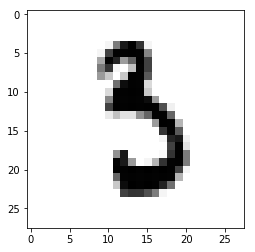

Pred value: 6
True value: 0


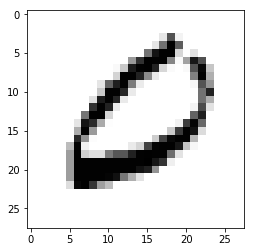

Pred value: 7
True value: 9


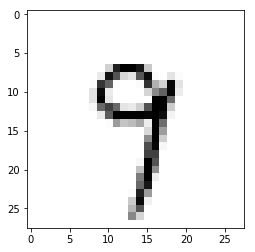

Pred value: 4
True value: 5


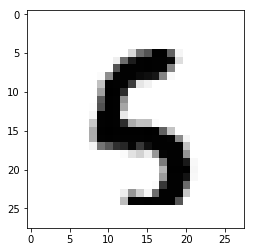

Pred value: 6
True value: 0


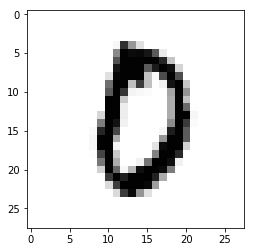

Pred value: 6
True value: 2


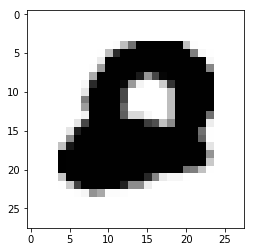

Pred value: 5
True value: 8


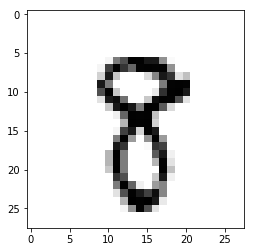

Pred value: 7
True value: 8


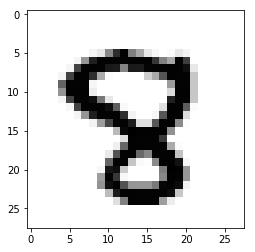

Pred value: 4
True value: 9


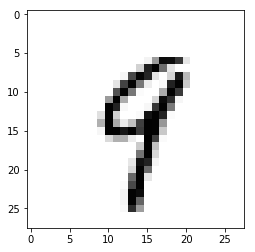

Pred value: 3
True value: 2


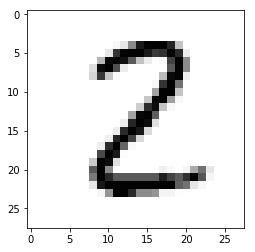

Pred value: 4
True value: 9


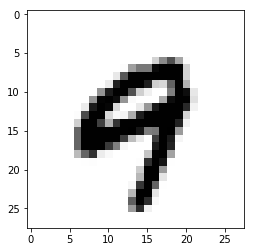

Pred value: 4
True value: 9


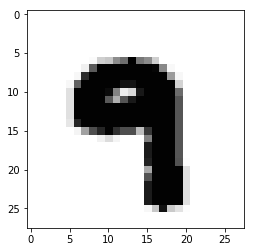

Pred value: 6
True value: 0


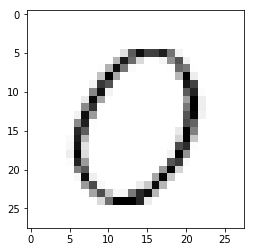

Pred value: 6
True value: 2


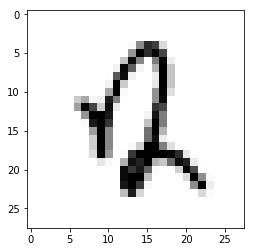

Pred value: 4
True value: 9


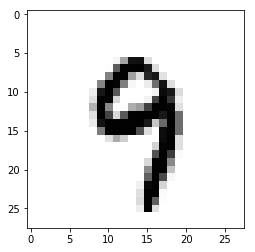

Pred value: 4
True value: 9


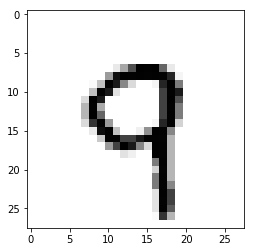

Pred value: 3
True value: 2


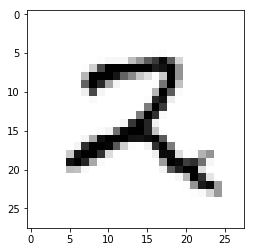

Pred value: 4
True value: 9


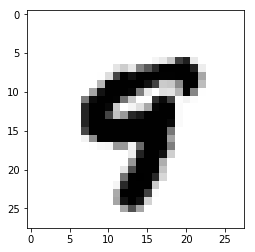

Pred value: 6
True value: 0


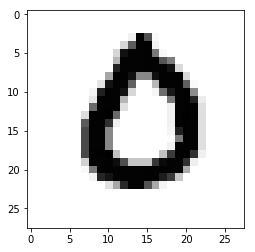

Pred value: 4
True value: 7


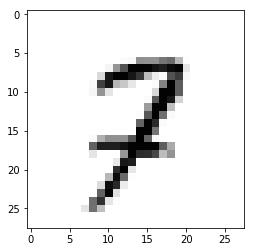

Pred value: 5
True value: 8


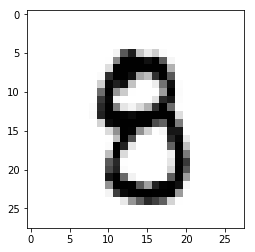

Pred value: 1
True value: 7


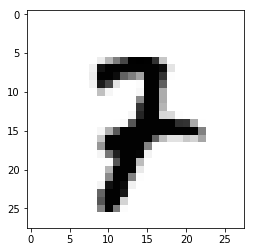

Pred value: 6
True value: 5


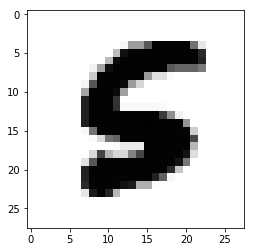

Pred value: 4
True value: 9


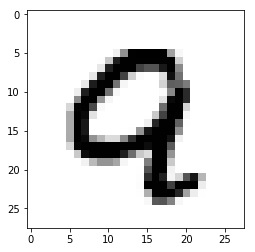

Pred value: 6
True value: 2


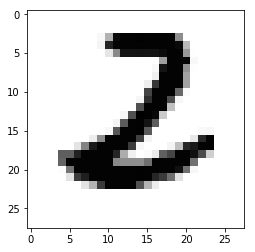

Pred value: 6
True value: 8


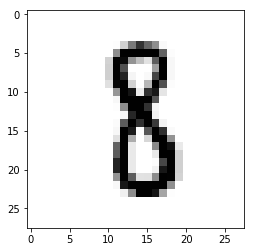

Pred value: 6
True value: 0


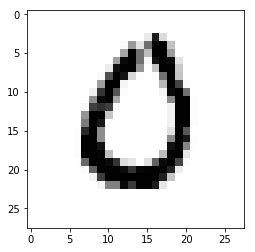

Pred value: 4
True value: 9


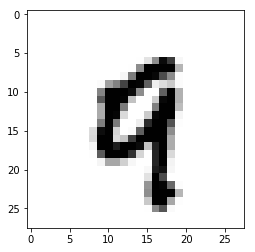

Pred value: 4
True value: 9


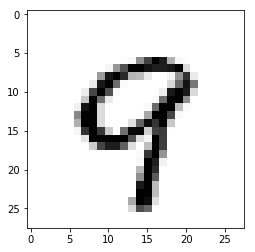

Pred value: 1
True value: 8


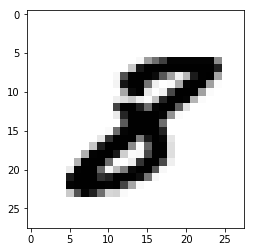

Pred value: 4
True value: 9


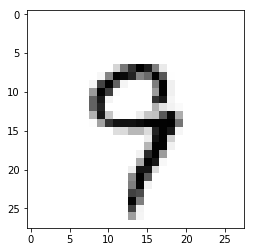

Pred value: 4
True value: 9


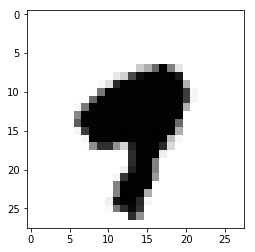

Pred value: 5
True value: 8


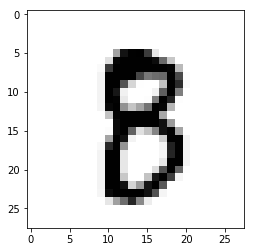

Pred value: 7
True value: 8


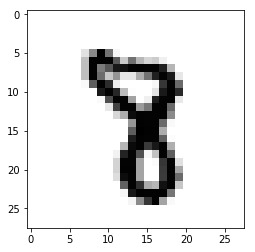

Pred value: 6
True value: 5


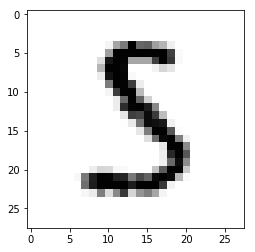

Pred value: 6
True value: 3


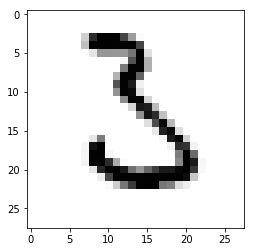

Pred value: 1
True value: 7


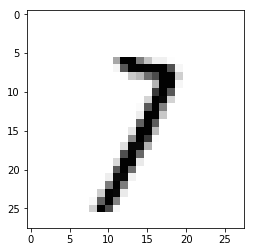

Pred value: 4
True value: 9


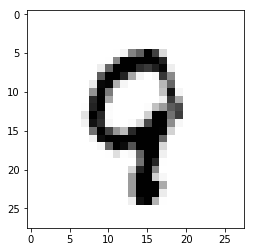

Pred value: 7
True value: 5


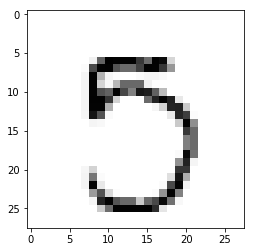

Pred value: 1
True value: 7


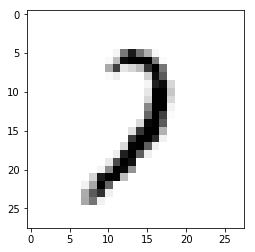

Pred value: 7
True value: 9


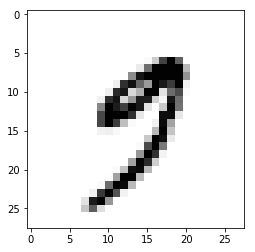

Pred value: 6
True value: 8


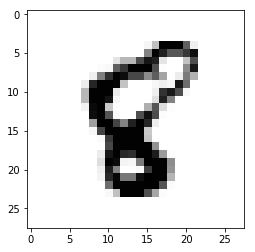

Pred value: 4
True value: 9


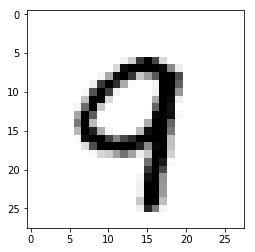

Pred value: 4
True value: 9


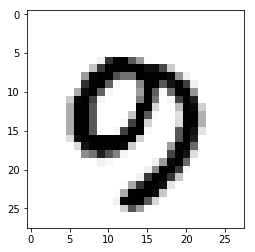

Pred value: 6
True value: 8


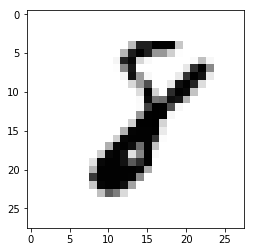

Pred value: 1
True value: 8


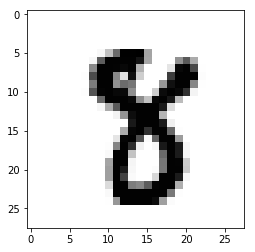

Pred value: 7
True value: 9


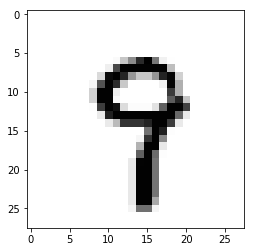

Pred value: 6
True value: 5


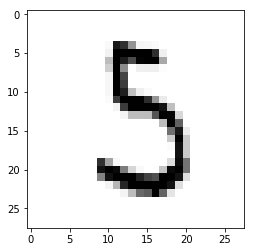

Pred value: 4
True value: 7


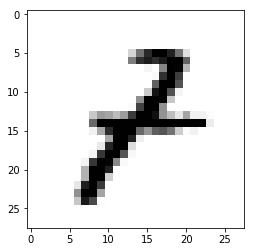

Pred value: 1
True value: 8


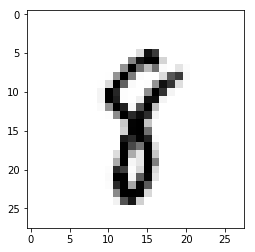

Pred value: 6
True value: 8


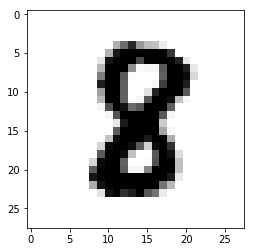

Pred value: 6
True value: 5


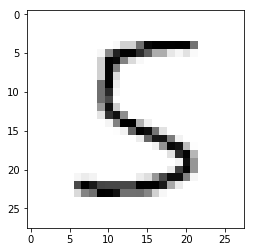

Pred value: 5
True value: 8


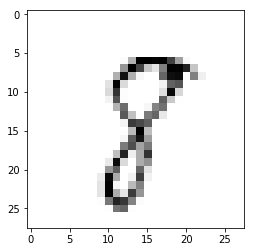

Pred value: 6
True value: 2


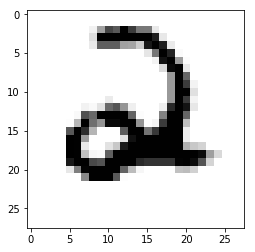

Pred value: 4
True value: 7


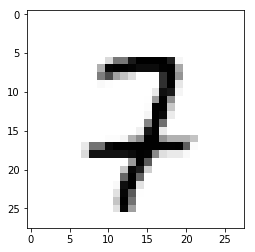

Pred value: 6
True value: 0


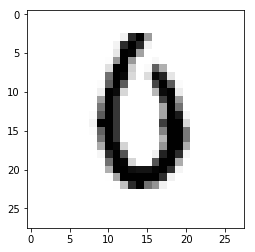

Pred value: 5
True value: 9


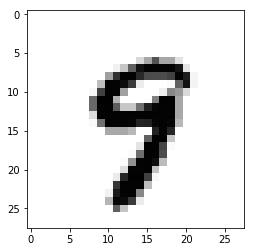

Pred value: 4
True value: 2


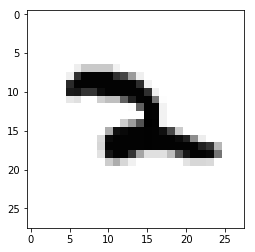

Pred value: 0
True value: 8


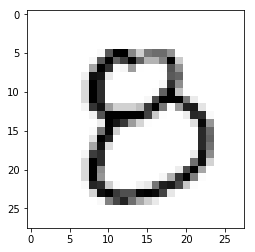

Pred value: 4
True value: 9


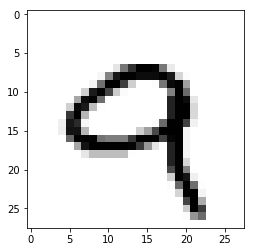

Pred value: 6
True value: 0


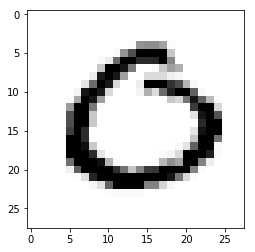

Pred value: 5
True value: 8


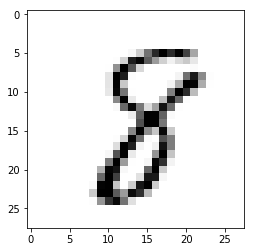

Pred value: 6
True value: 0


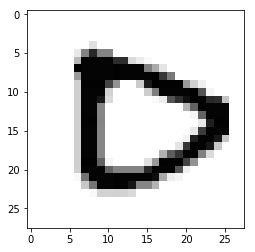

Pred value: 5
True value: 9


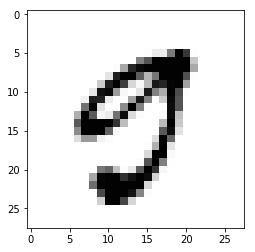

Pred value: 6
True value: 0


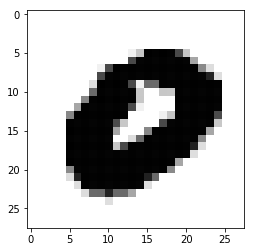

Pred value: 5
True value: 8


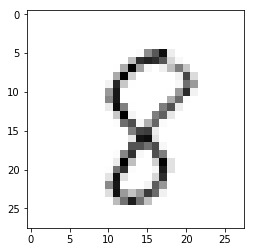

Pred value: 6
True value: 2


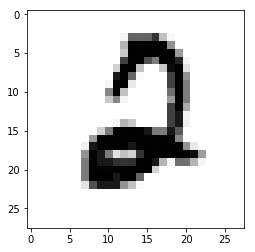

Pred value: 6
True value: 2


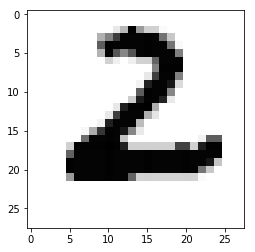

Pred value: 2
True value: 7


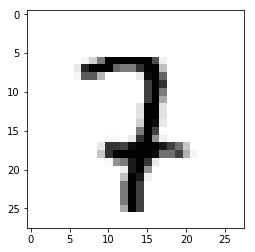

Pred value: 5
True value: 8


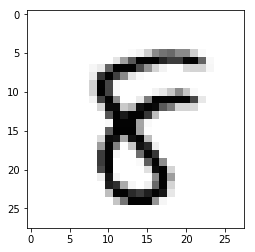

Pred value: 6
True value: 5


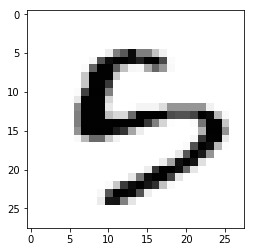

Pred value: 4
True value: 9


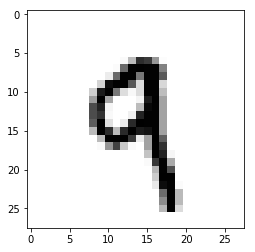

Pred value: 4
True value: 3


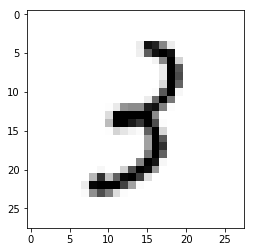

Pred value: 4
True value: 9


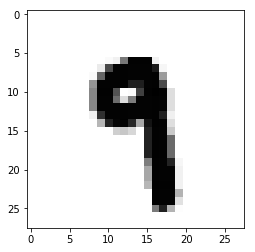

Pred value: 6
True value: 5


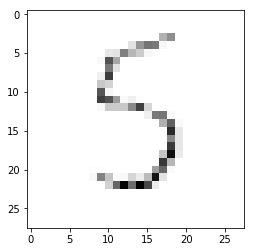

Pred value: 5
True value: 8


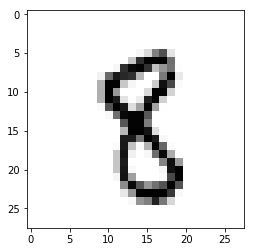

Pred value: 4
True value: 9


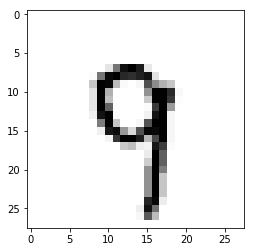

Pred value: 4
True value: 9


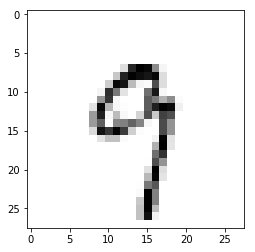

Pred value: 4
True value: 9


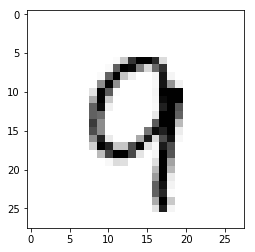

Pred value: 6
True value: 2


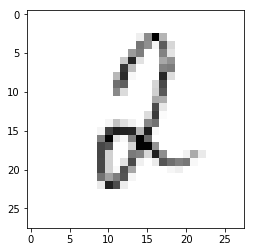

Pred value: 6
True value: 0


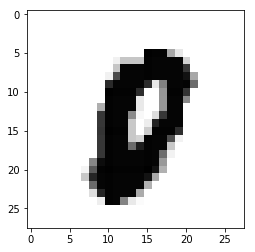

Pred value: 6
True value: 0


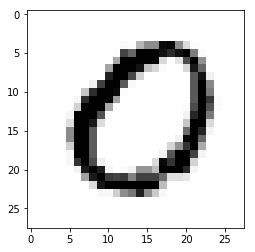

Pred value: 6
True value: 0


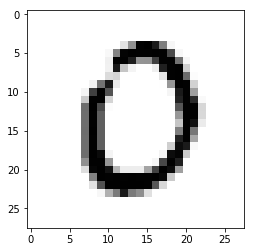

Pred value: 4
True value: 9


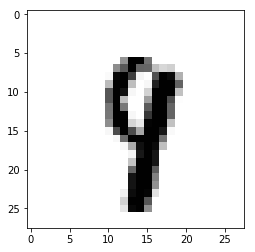

Pred value: 6
True value: 8


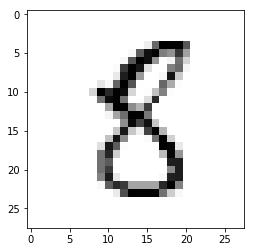

Pred value: 6
True value: 2


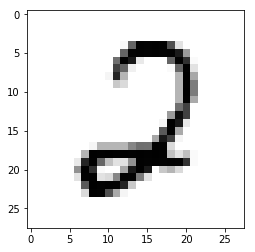

Pred value: 4
True value: 7


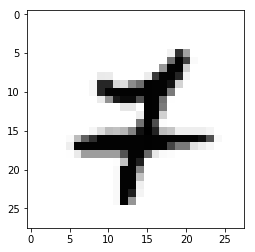

Pred value: 6
True value: 9


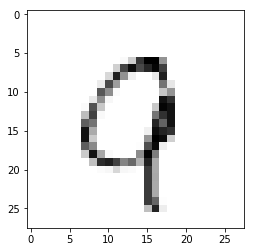

Pred value: 1
True value: 8


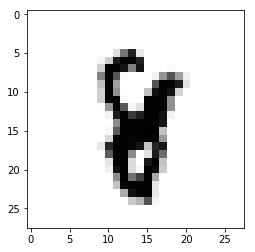

Pred value: 7
True value: 9


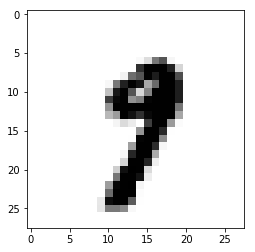

Pred value: 4
True value: 9


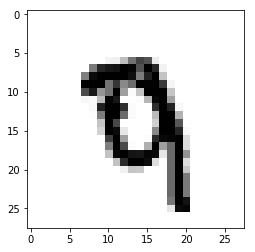

Pred value: 6
True value: 5


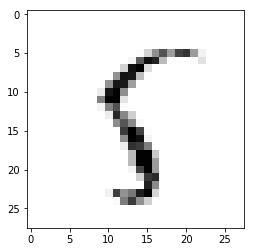

Pred value: 5
True value: 8


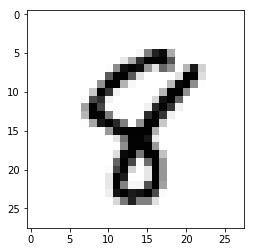

Pred value: 6
True value: 0


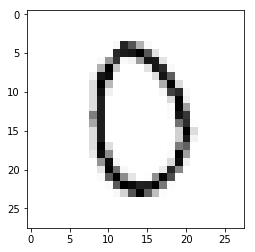

Pred value: 6
True value: 2


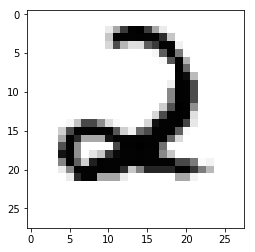

Pred value: 4
True value: 9


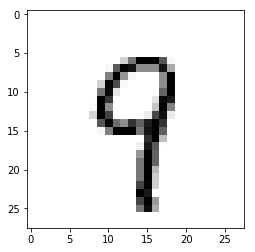

Pred value: 0
True value: 8


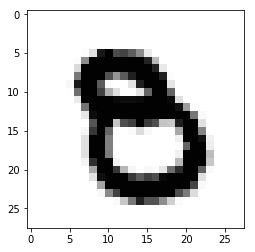

Pred value: 4
True value: 9


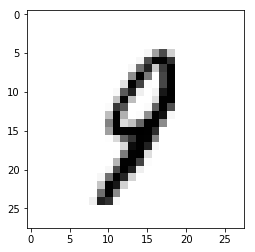

Pred value: 6
True value: 0


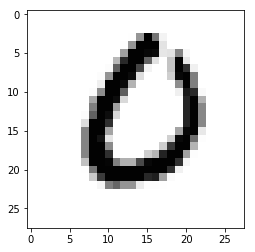

Pred value: 6
True value: 0


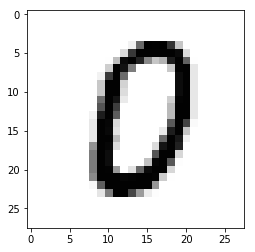

Pred value: 6
True value: 0


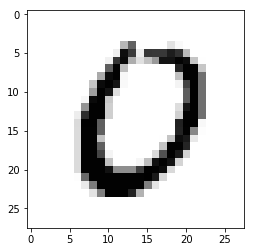

Pred value: 4
True value: 9


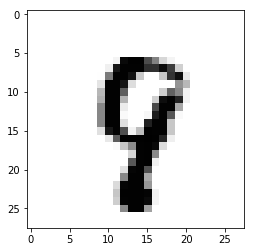

Pred value: 6
True value: 3


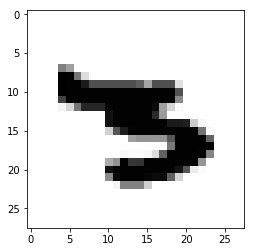

Pred value: 6
True value: 0


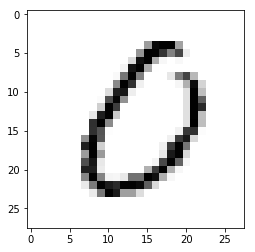

Pred value: 6
True value: 4


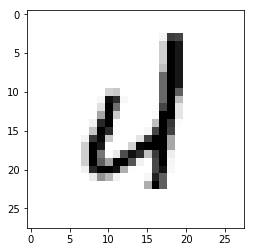

Pred value: 3
True value: 2


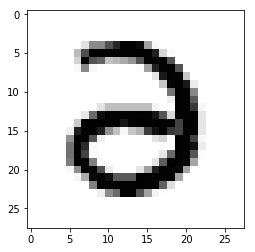

Pred value: 4
True value: 9


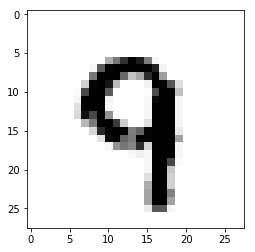

Pred value: 6
True value: 8


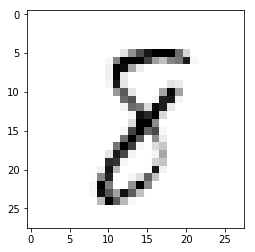

Pred value: 4
True value: 9


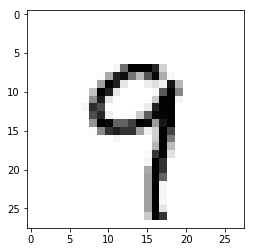

Pred value: 6
True value: 8


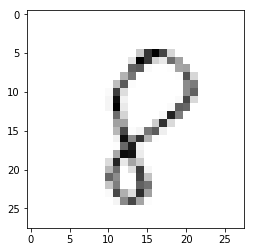

Pred value: 6
True value: 0


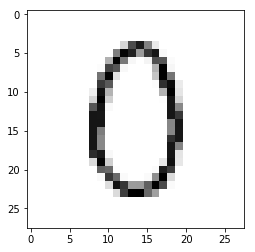

Pred value: 6
True value: 8


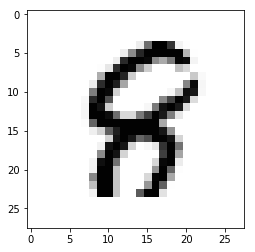

Pred value: 4
True value: 5


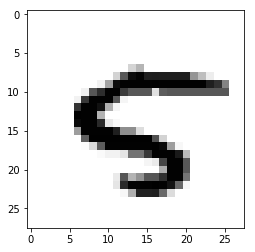

Pred value: 5
True value: 8


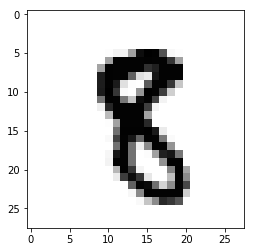

Pred value: 7
True value: 5


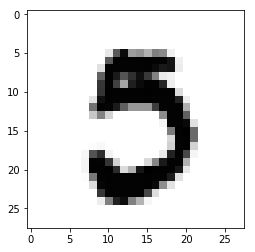

Pred value: 6
True value: 0


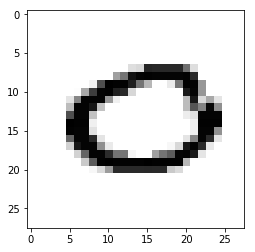

Pred value: 4
True value: 9


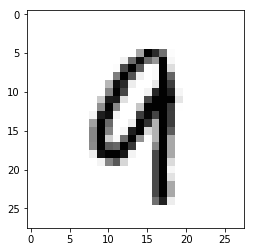

Pred value: 6
True value: 3


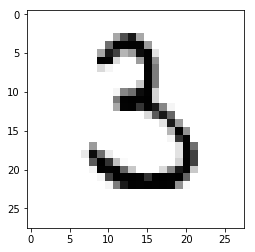

Pred value: 3
True value: 7


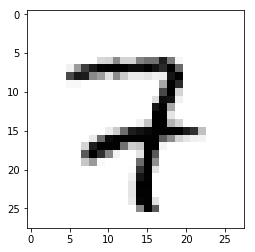

Pred value: 6
True value: 0


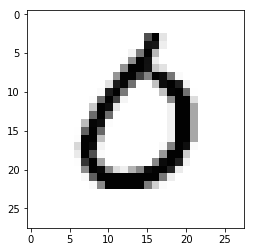

Pred value: 4
True value: 7


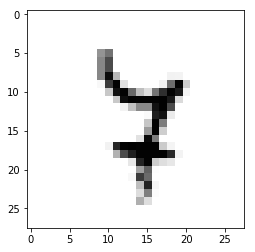

Pred value: 6
True value: 8


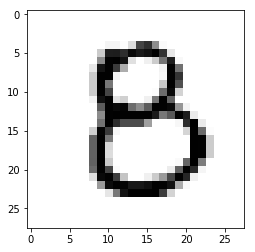

Pred value: 6
True value: 2


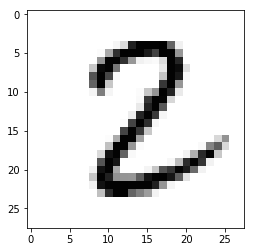

Pred value: 4
True value: 9


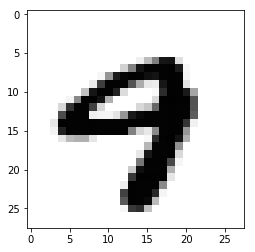

Pred value: 6
True value: 2


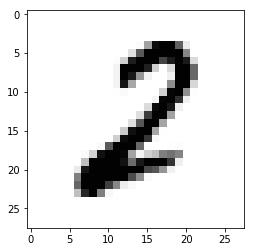

Pred value: 5
True value: 8


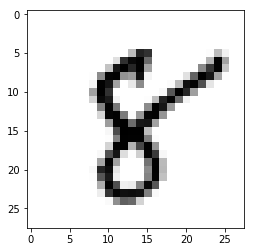

Pred value: 6
True value: 5


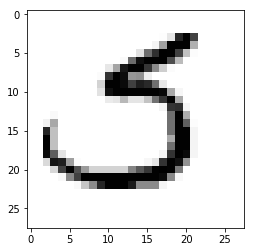

Pred value: 1
True value: 8


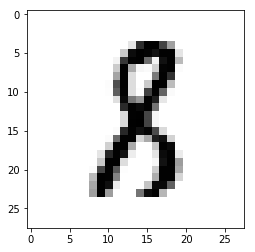

Pred value: 4
True value: 9


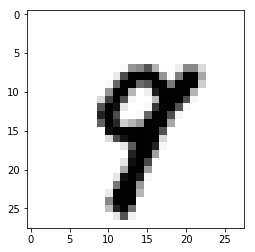

Pred value: 1
True value: 8


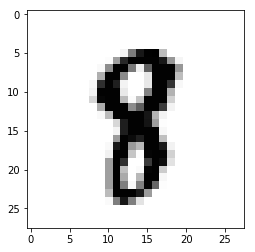

Pred value: 4
True value: 9


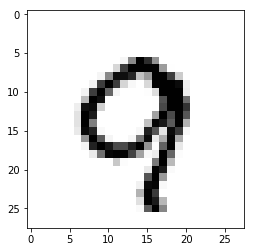

Pred value: 4
True value: 9


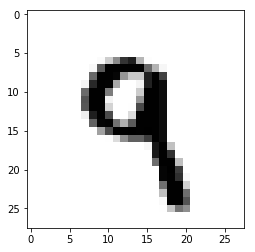

Pred value: 6
True value: 8


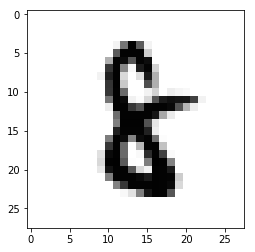

Pred value: 1
True value: 8


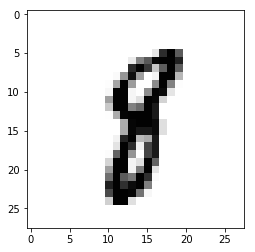

Pred value: 4
True value: 9


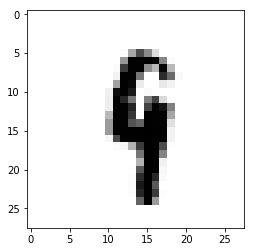

Pred value: 5
True value: 8


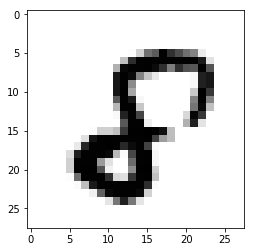

Pred value: 4
True value: 9


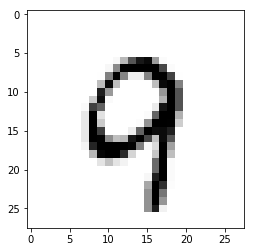

Pred value: 4
True value: 9


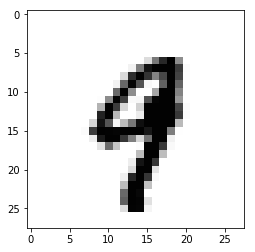

Pred value: 4
True value: 9


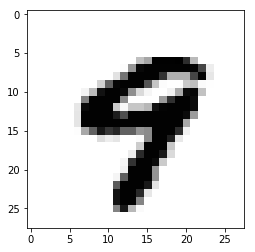

Pred value: 4
True value: 9


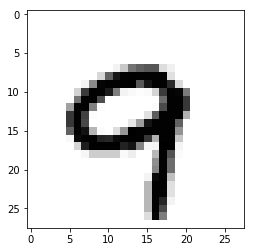

Pred value: 6
True value: 0


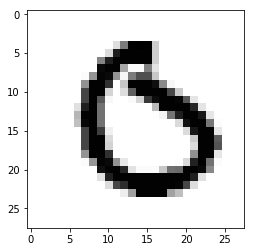

Pred value: 5
True value: 8


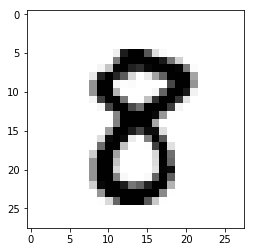

Pred value: 0
True value: 8


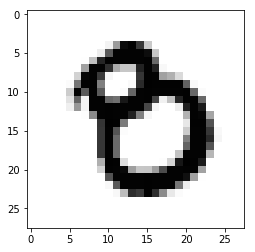

Pred value: 5
True value: 8


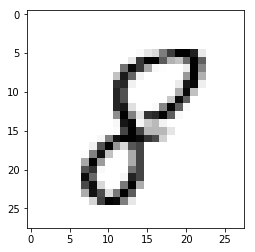

Pred value: 6
True value: 0


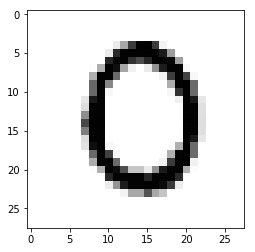

Pred value: 3
True value: 8


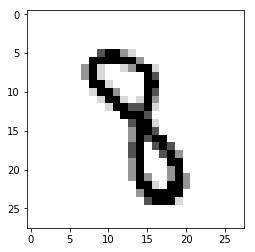

Pred value: 4
True value: 9


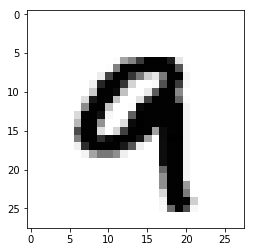

Pred value: 1
True value: 8


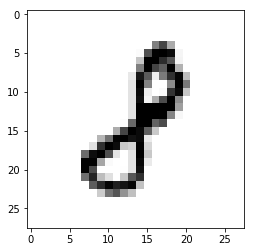

Pred value: 4
True value: 9


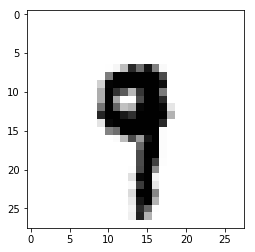

Pred value: 4
True value: 5


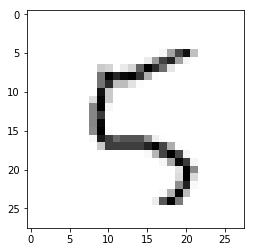

Pred value: 4
True value: 9


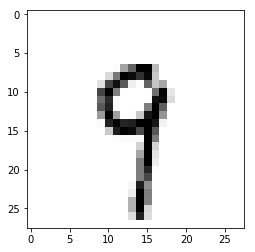

Pred value: 4
True value: 5


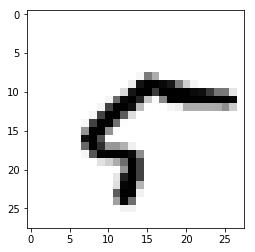

Pred value: 4
True value: 9


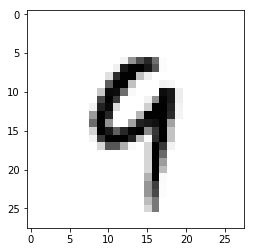

Pred value: 4
True value: 9


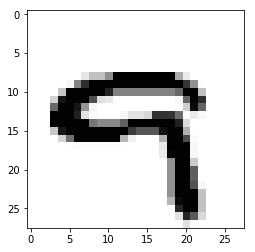

Pred value: 6
True value: 0


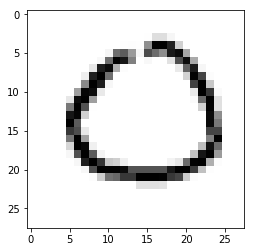

Pred value: 7
True value: 9


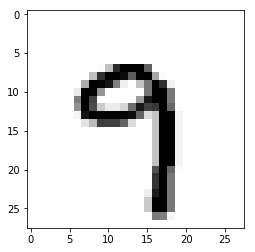

Pred value: 5
True value: 9


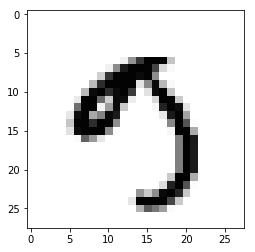

Pred value: 6
True value: 2


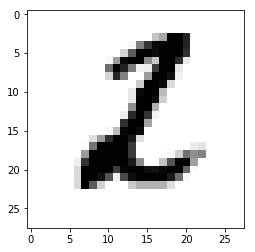

Pred value: 5
True value: 9


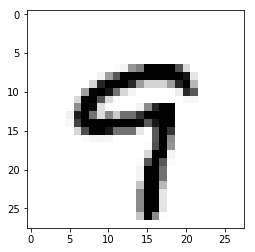

Pred value: 5
True value: 8


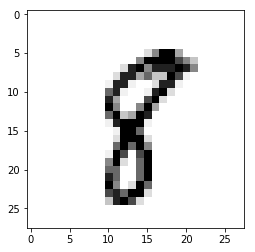

Pred value: 6
True value: 5


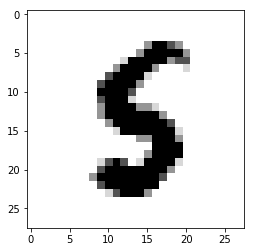

Pred value: 5
True value: 3


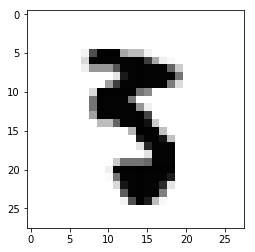

Pred value: 6
True value: 0


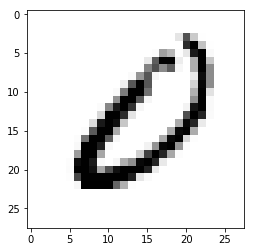

Pred value: 4
True value: 9


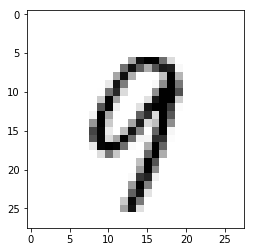

Pred value: 7
True value: 8


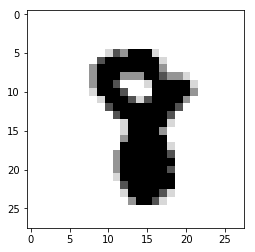

Pred value: 2
True value: 7


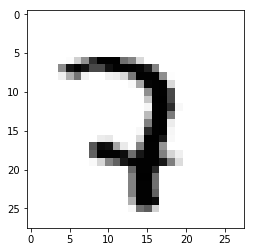

Pred value: 4
True value: 9


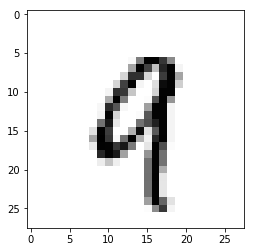

Pred value: 4
True value: 9


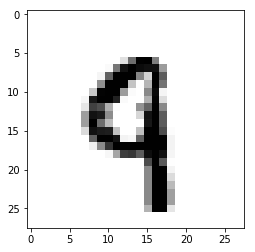

Pred value: 4
True value: 5


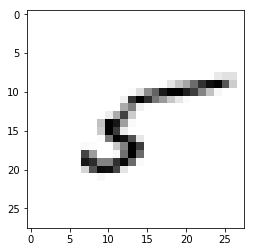

Pred value: 7
True value: 5


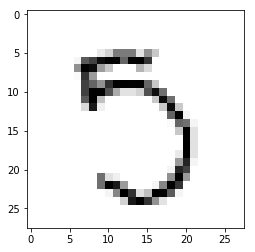

Pred value: 6
True value: 0


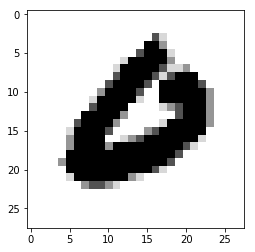

Pred value: 4
True value: 9


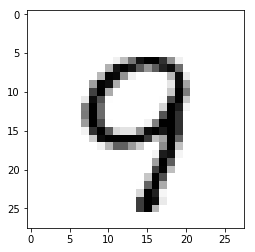

Pred value: 6
True value: 8


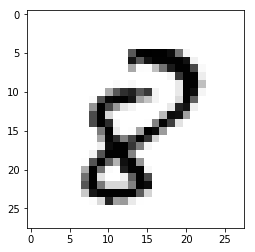

Pred value: 4
True value: 9


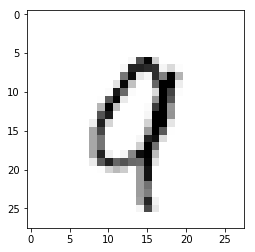

Pred value: 6
True value: 2


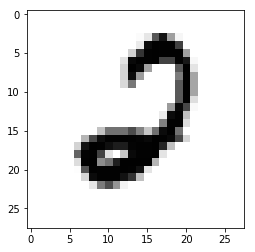

Pred value: 4
True value: 9


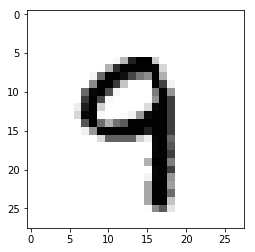

Pred value: 4
True value: 5


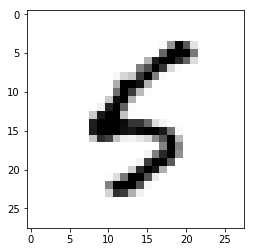

Pred value: 5
True value: 3


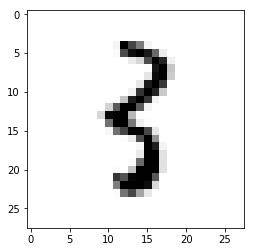

Pred value: 7
True value: 8


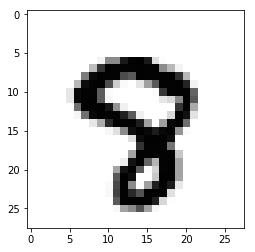

Pred value: 4
True value: 9


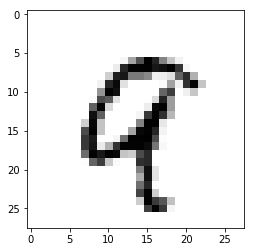

Pred value: 1
True value: 8


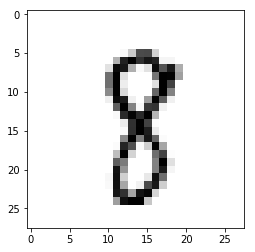

Pred value: 5
True value: 9


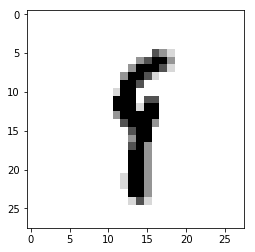

Pred value: 4
True value: 9


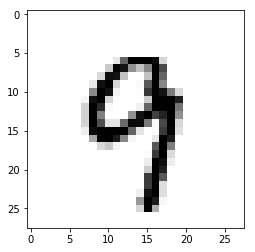

Pred value: 4
True value: 9


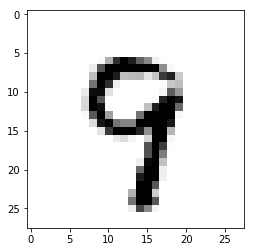

Pred value: 4
True value: 8


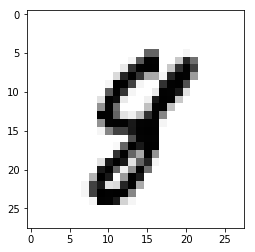

Pred value: 5
True value: 0


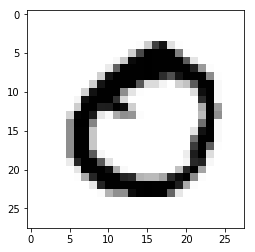

Pred value: 6
True value: 0


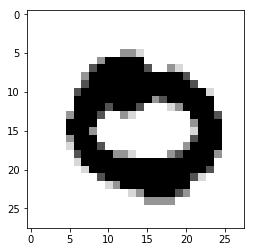

Pred value: 6
True value: 8


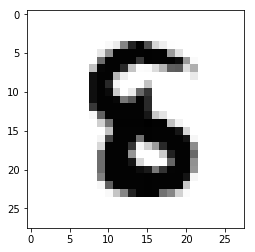

Pred value: 4
True value: 9


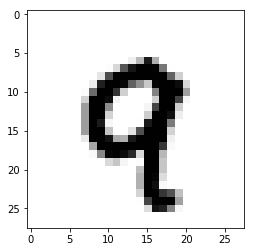

Pred value: 4
True value: 2


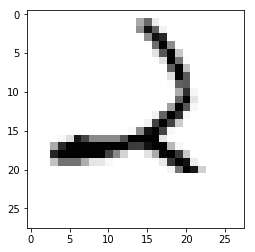

Pred value: 4
True value: 9


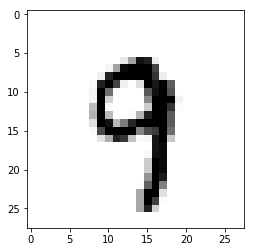

Pred value: 6
True value: 0


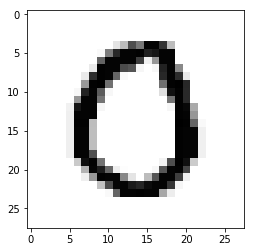

Pred value: 3
True value: 8


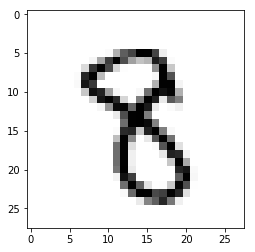

Pred value: 6
True value: 2


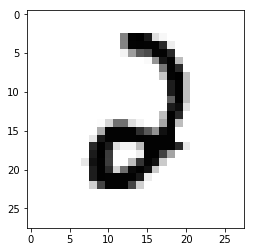

Pred value: 4
True value: 9


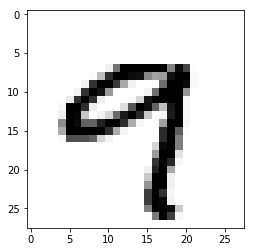

Pred value: 4
True value: 2


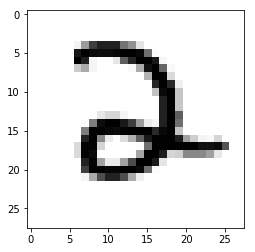

Pred value: 7
True value: 9


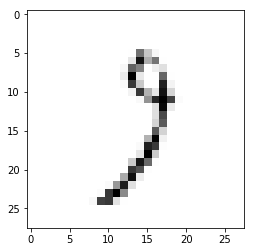

Pred value: 5
True value: 8


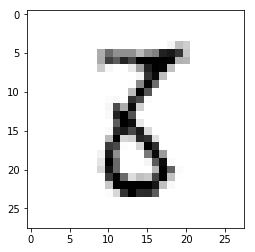

Pred value: 5
True value: 8


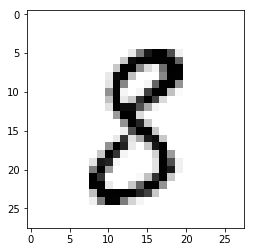

Pred value: 5
True value: 8


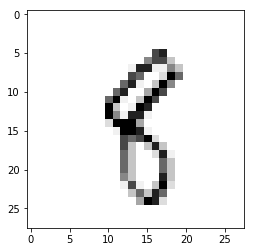

Pred value: 1
True value: 8


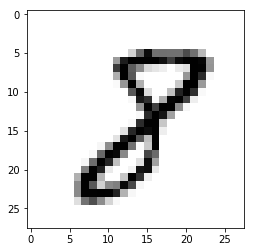

Pred value: 6
True value: 2


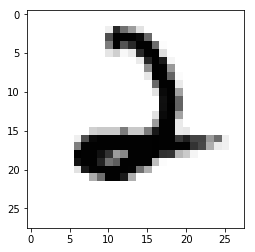

Pred value: 2
True value: 1


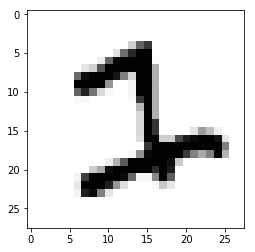

Pred value: 4
True value: 9


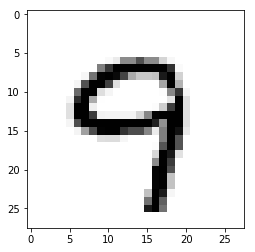

Pred value: 6
True value: 0


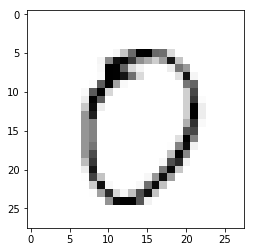

Pred value: 6
True value: 2


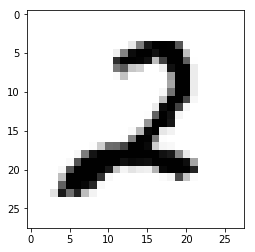

Pred value: 7
True value: 4


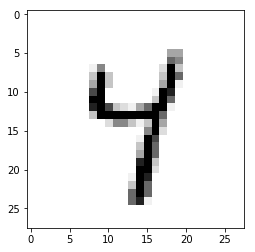

Pred value: 6
True value: 0


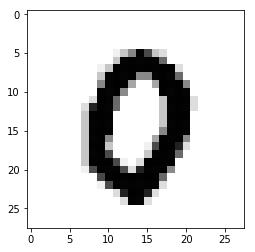

Pred value: 5
True value: 8


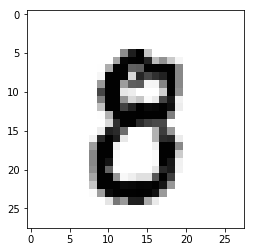

Pred value: 6
True value: 5


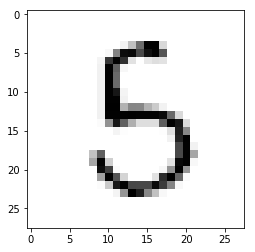

Pred value: 3
True value: 5


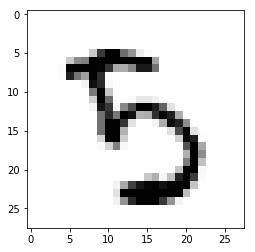

Pred value: 6
True value: 2


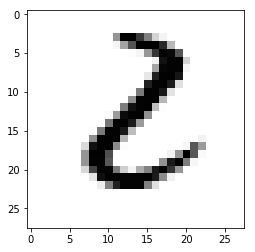

Pred value: 6
True value: 3


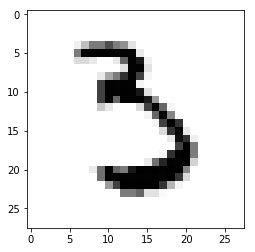

Pred value: 6
True value: 8


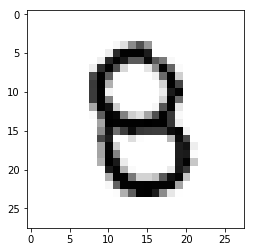

Pred value: 6
True value: 4


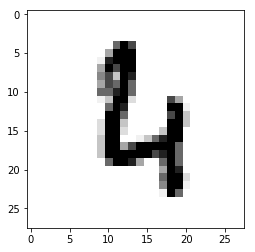

Pred value: 4
True value: 5


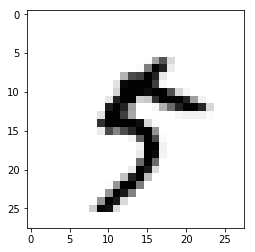

Pred value: 4
True value: 7


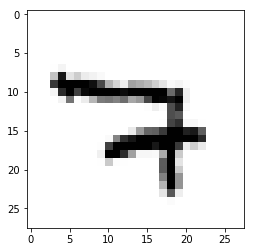

Pred value: 6
True value: 2


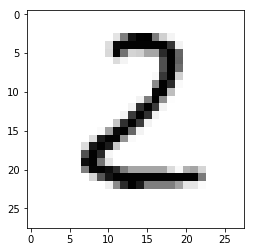

Pred value: 2
True value: 1


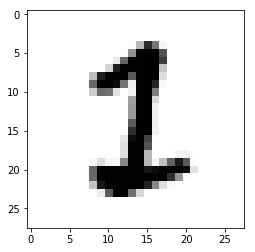

Pred value: 4
True value: 7


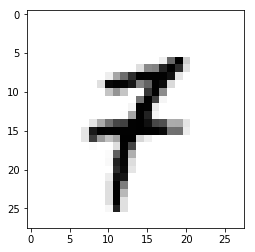

Pred value: 6
True value: 8


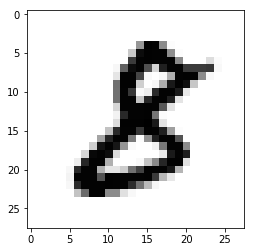

Pred value: 6
True value: 2


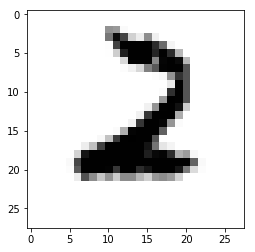

Pred value: 5
True value: 3


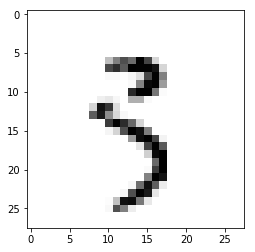

Pred value: 4
True value: 9


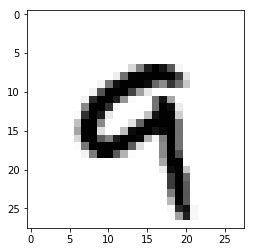

Pred value: 4
True value: 9


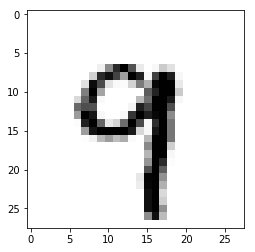

Pred value: 6
True value: 2


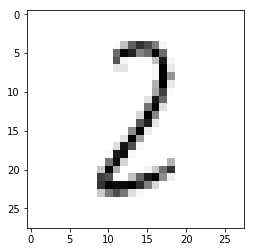

Pred value: 6
True value: 8


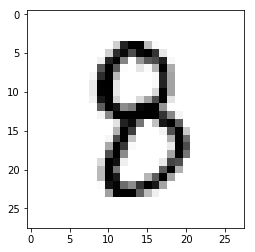

Pred value: 7
True value: 5


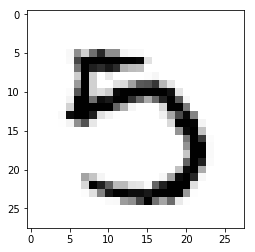

Pred value: 6
True value: 8


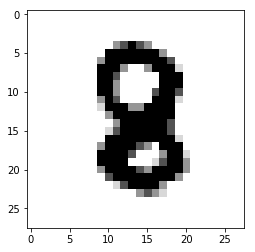

Pred value: 4
True value: 9


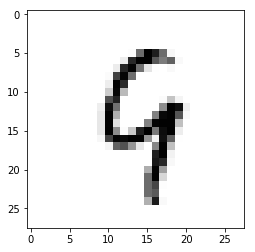

Pred value: 1
True value: 8


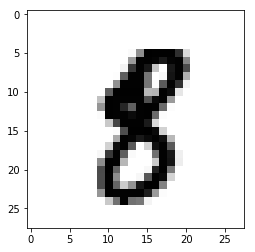

Pred value: 7
True value: 9


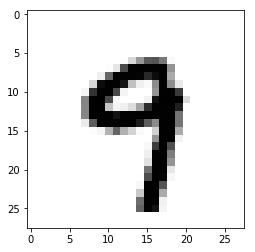

Pred value: 4
True value: 7


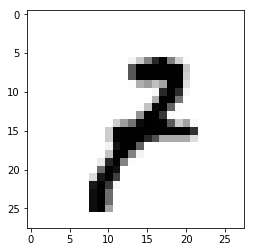

Pred value: 6
True value: 3


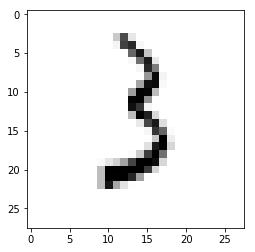

Pred value: 4
True value: 9


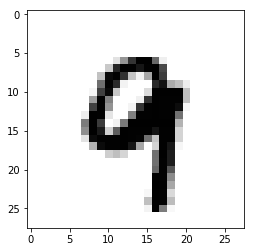

Pred value: 7
True value: 2


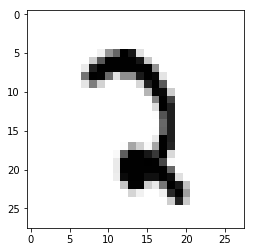

Pred value: 6
True value: 0


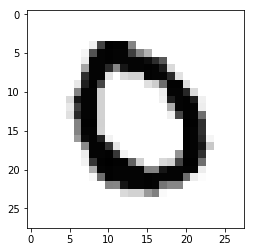

Pred value: 6
True value: 5


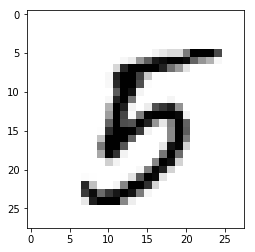

Pred value: 6
True value: 0


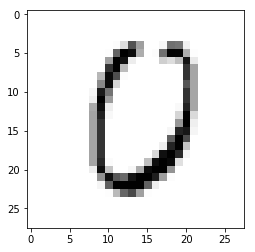

Pred value: 6
True value: 8


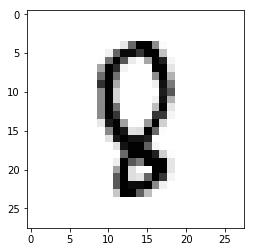

Pred value: 4
True value: 9


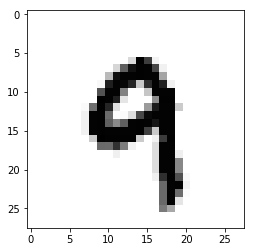

Pred value: 6
True value: 8


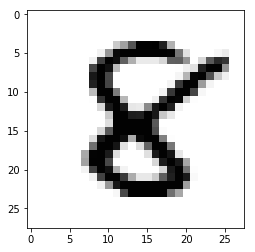

Pred value: 4
True value: 9


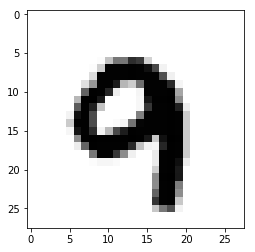

Pred value: 6
True value: 2


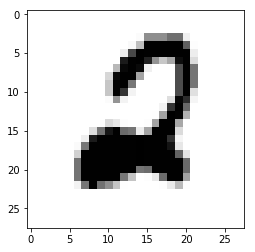

Pred value: 4
True value: 8


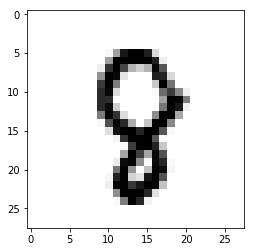

Pred value: 6
True value: 8


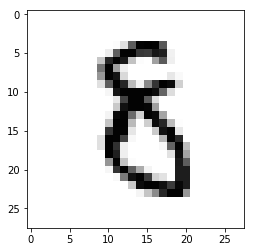

Pred value: 3
True value: 8


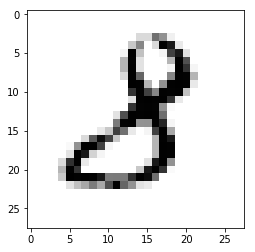

Pred value: 6
True value: 2


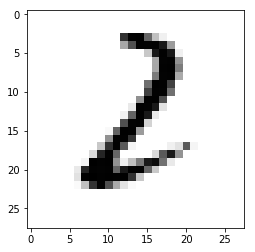

Pred value: 6
True value: 0


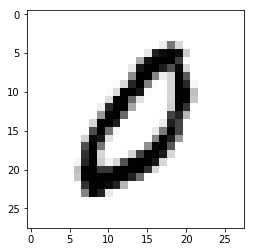

Pred value: 6
True value: 0


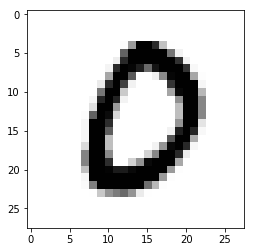

Pred value: 1
True value: 8


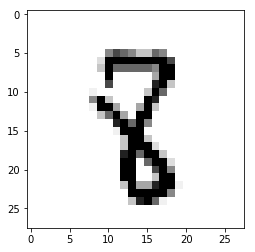

Pred value: 6
True value: 0


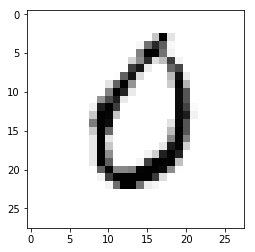

Pred value: 5
True value: 8


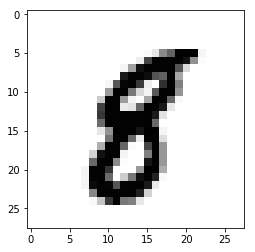

Pred value: 1
True value: 7


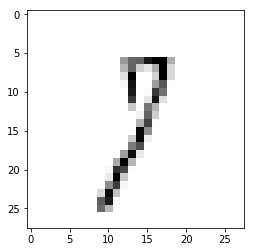

Pred value: 4
True value: 9


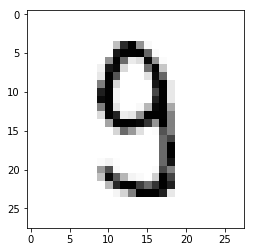

Pred value: 4
True value: 9


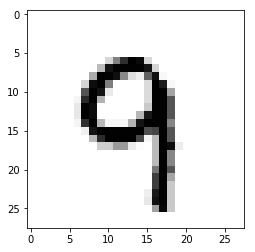

Pred value: 6
True value: 0


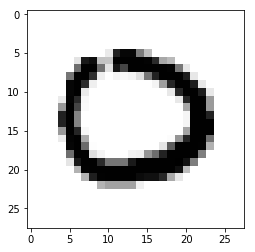

Pred value: 1
True value: 8


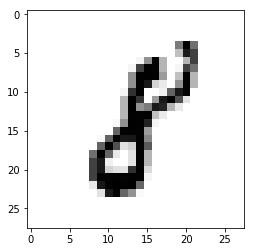

Pred value: 5
True value: 8


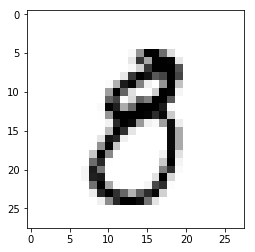

Pred value: 6
True value: 2


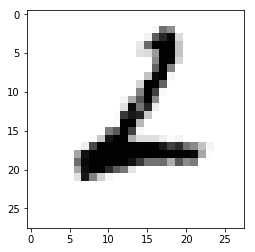

Pred value: 6
True value: 0


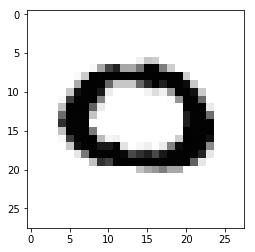

Pred value: 7
True value: 8


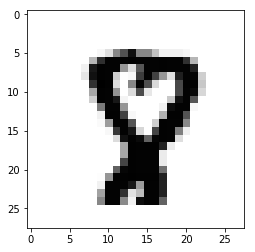

Pred value: 6
True value: 0


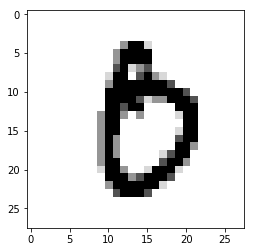

Pred value: 6
True value: 0


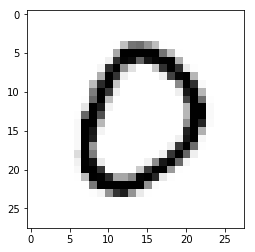

Pred value: 6
True value: 5


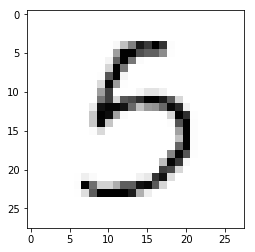

Pred value: 5
True value: 8


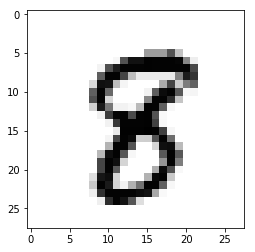

Pred value: 7
True value: 2


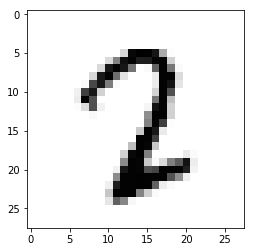

Pred value: 7
True value: 8


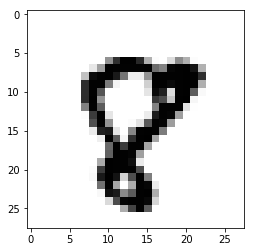

Pred value: 4
True value: 9


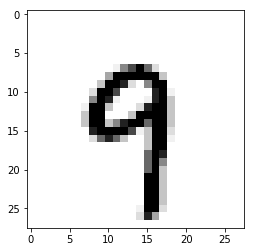

Pred value: 4
True value: 9


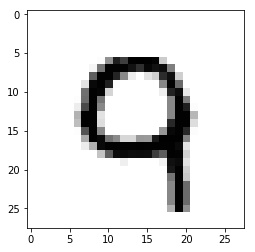

Pred value: 7
True value: 8


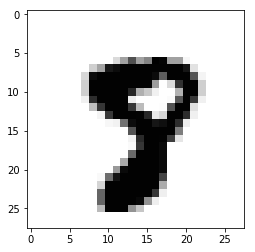

Pred value: 6
True value: 0


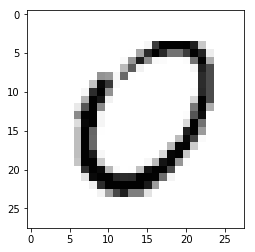

Pred value: 6
True value: 0


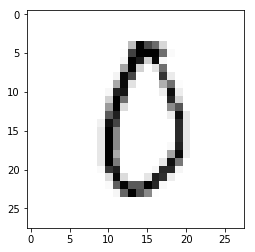

Pred value: 6
True value: 0


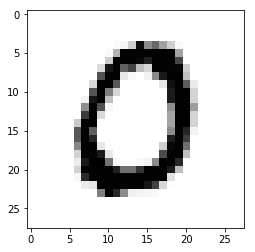

Pred value: 4
True value: 7


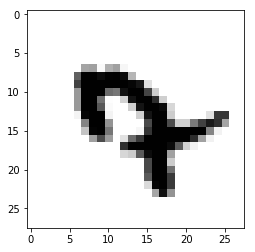

Pred value: 6
True value: 0


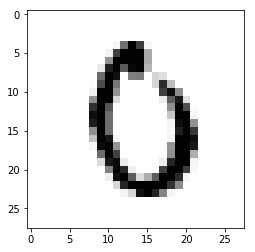

Pred value: 6
True value: 2


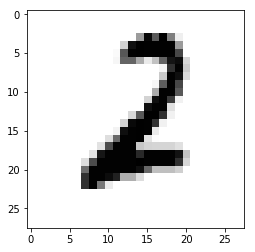

Pred value: 7
True value: 8


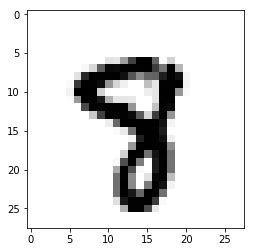

Pred value: 5
True value: 8


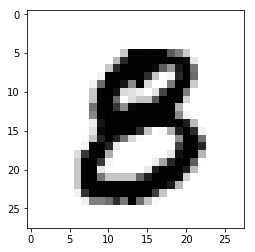

Pred value: 1
True value: 8


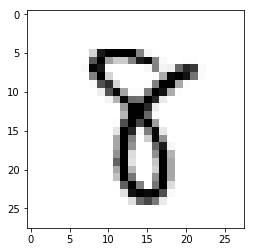

Pred value: 1
True value: 7


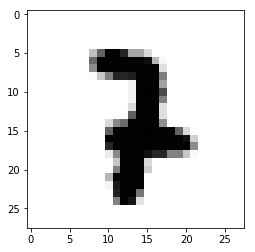

Pred value: 3
True value: 2


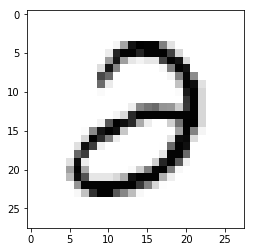

Pred value: 4
True value: 7


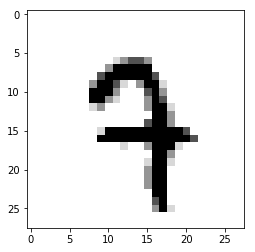

Pred value: 1
True value: 2


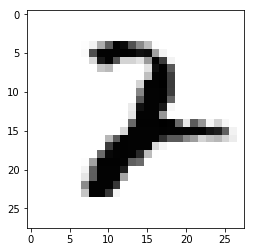

Pred value: 4
True value: 9


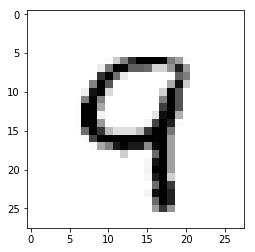

Pred value: 5
True value: 8


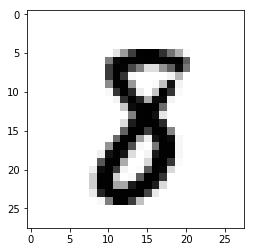

Pred value: 5
True value: 8


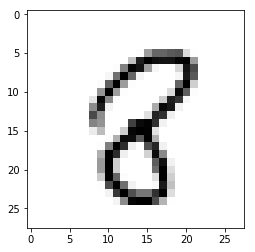

Pred value: 6
True value: 5


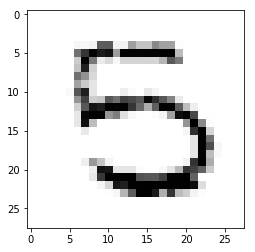

Pred value: 6
True value: 0


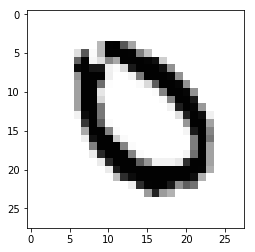

Pred value: 5
True value: 8


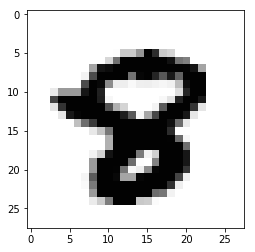

Pred value: 5
True value: 0


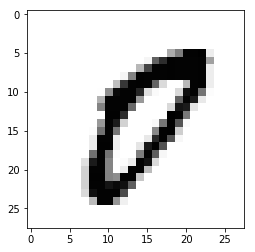

Pred value: 6
True value: 0


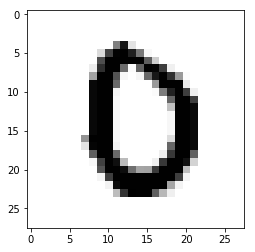

Pred value: 7
True value: 9


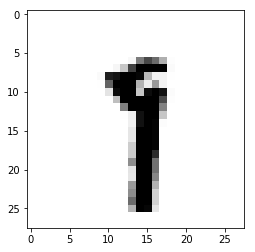

Pred value: 6
True value: 0


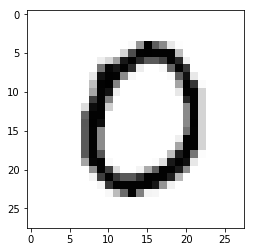

Pred value: 6
True value: 5


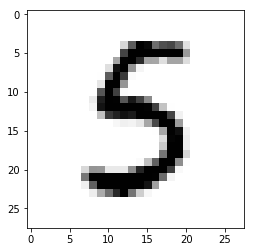

Pred value: 5
True value: 8


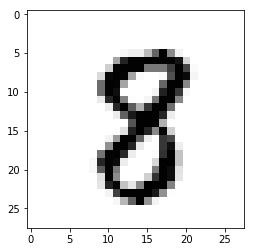

Pred value: 6
True value: 2


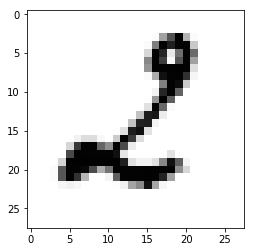

Pred value: 4
True value: 3


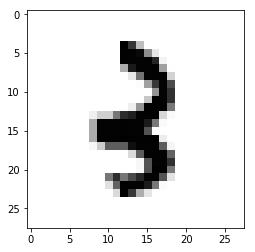

Pred value: 6
True value: 2


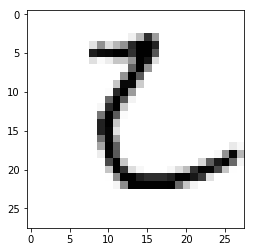

Pred value: 4
True value: 9


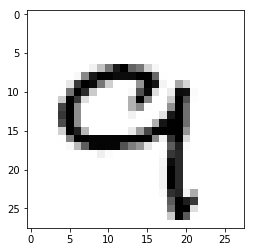

Pred value: 4
True value: 9


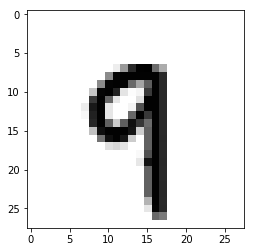

Pred value: 1
True value: 8


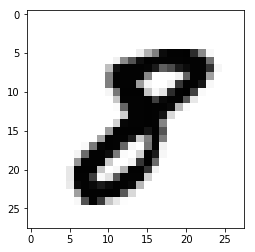

Pred value: 5
True value: 9


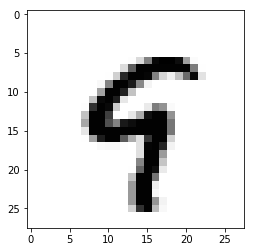

Pred value: 6
True value: 5


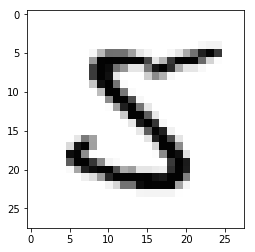

Pred value: 4
True value: 9


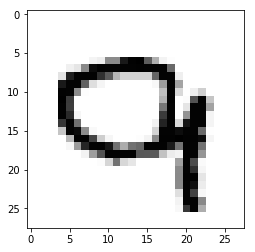

Pred value: 6
True value: 2


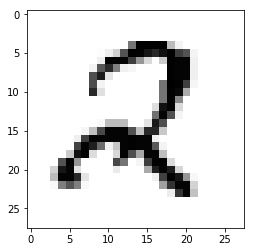

Pred value: 6
True value: 0


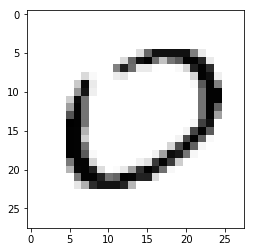

Pred value: 6
True value: 9


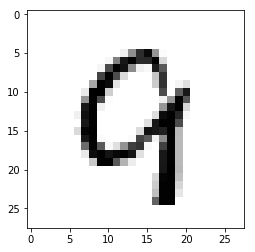

Pred value: 7
True value: 8


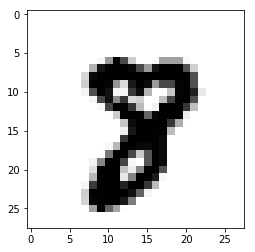

Pred value: 4
True value: 9


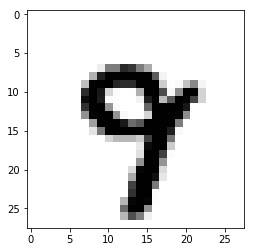

Pred value: 5
True value: 0


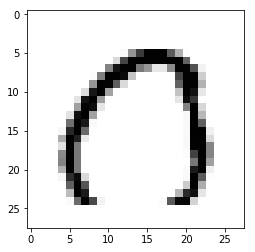

Pred value: 6
True value: 5


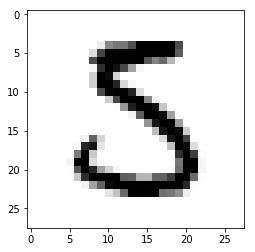

Pred value: 6
True value: 2


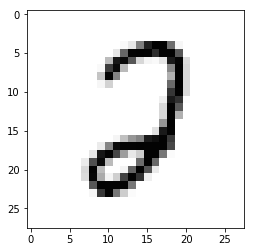

Pred value: 4
True value: 9


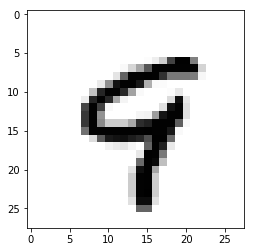

Pred value: 6
True value: 2


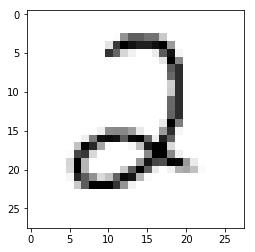

Pred value: 7
True value: 2


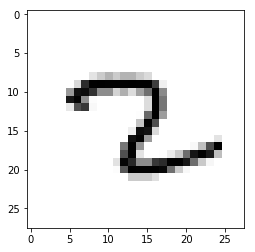

Pred value: 5
True value: 8


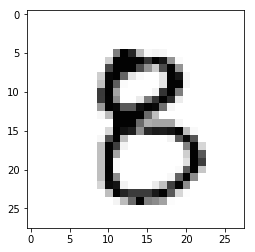

Pred value: 6
True value: 0


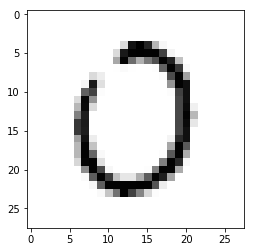

Pred value: 1
True value: 0


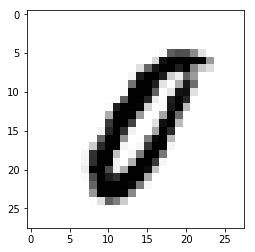

Pred value: 4
True value: 9


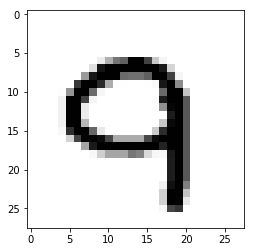

Pred value: 6
True value: 9


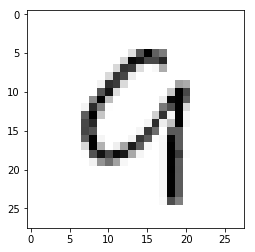

Pred value: 5
True value: 8


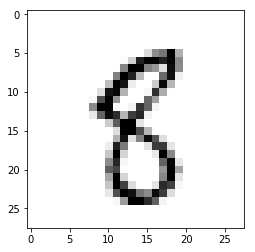

Pred value: 5
True value: 9


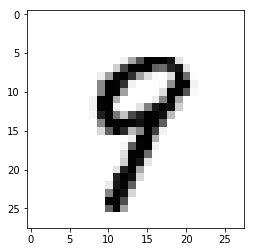

Pred value: 4
True value: 5


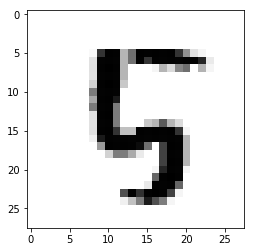

Pred value: 6
True value: 5


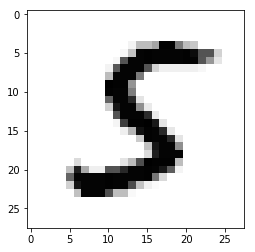

Pred value: 4
True value: 9


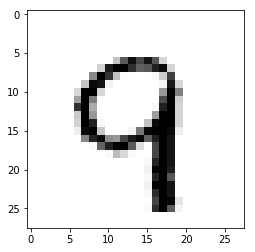

Pred value: 5
True value: 8


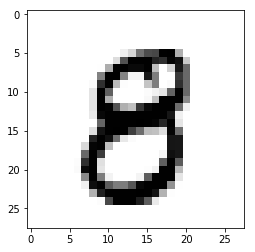

Pred value: 6
True value: 2


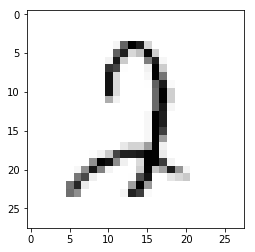

Pred value: 4
True value: 9


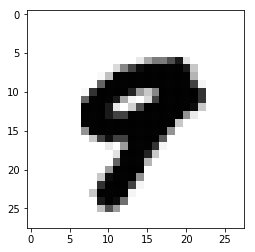

Pred value: 4
True value: 9


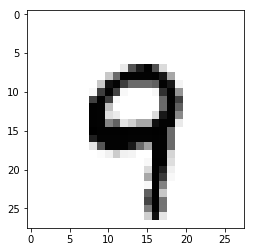

Pred value: 5
True value: 0


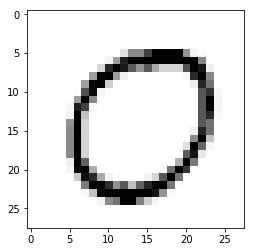

Pred value: 6
True value: 2


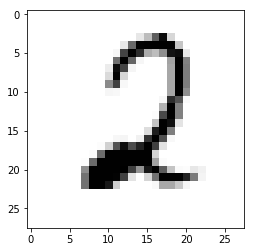

Pred value: 4
True value: 9


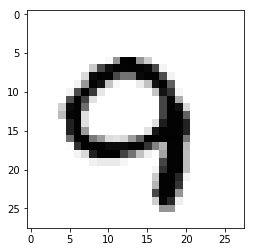

Pred value: 4
True value: 9


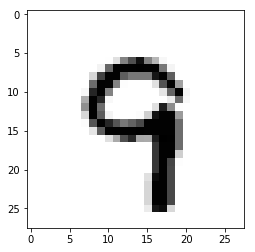

Pred value: 6
True value: 2


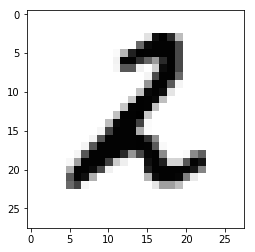

Pred value: 4
True value: 9


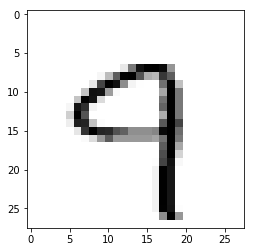

Pred value: 6
True value: 8


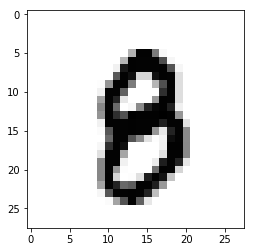

Pred value: 1
True value: 7


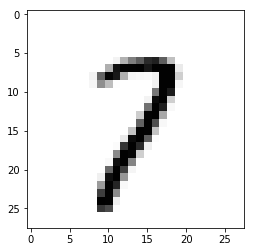

Pred value: 1
True value: 8


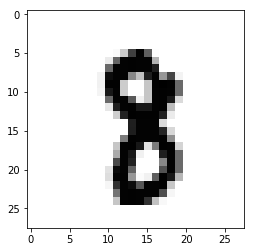

Pred value: 4
True value: 9


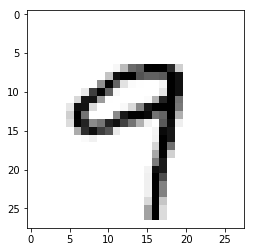

Pred value: 6
True value: 8


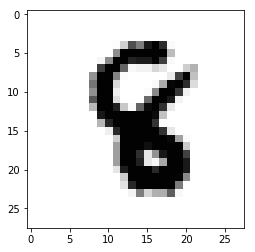

Pred value: 7
True value: 9


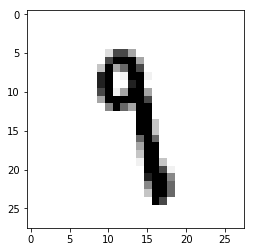

Pred value: 4
True value: 9


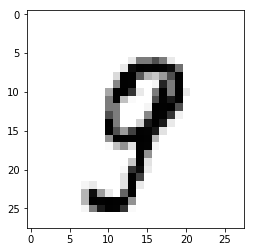

Pred value: 6
True value: 5


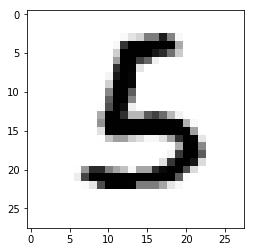

Pred value: 4
True value: 9


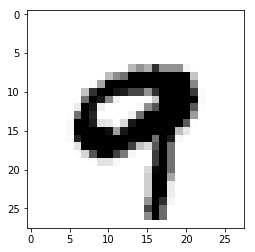

Pred value: 3
True value: 8


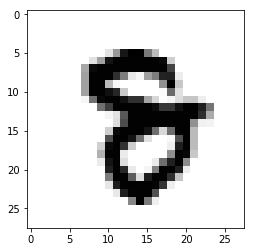

Pred value: 7
True value: 2


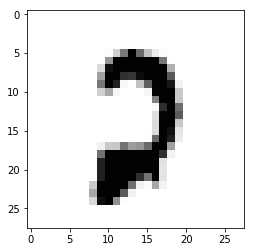

Pred value: 6
True value: 2


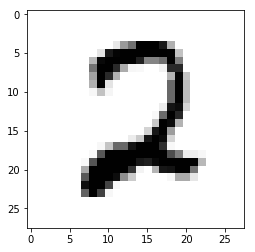

Pred value: 5
True value: 8


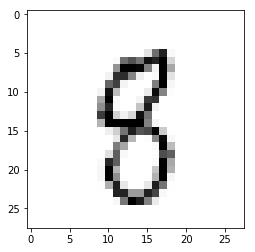

Pred value: 3
True value: 8


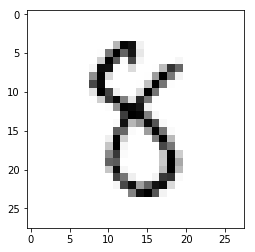

Pred value: 4
True value: 6


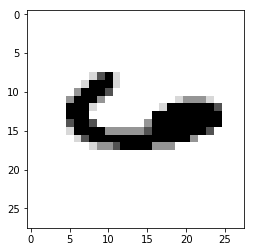

Pred value: 5
True value: 8


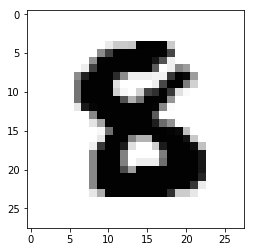

Pred value: 2
True value: 7


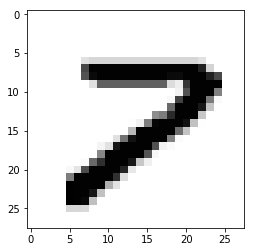

Pred value: 4
True value: 9


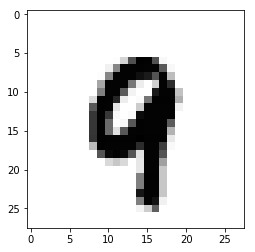

Pred value: 4
True value: 9


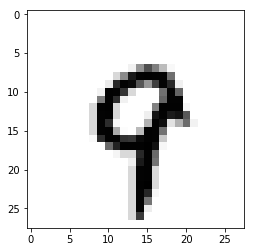

Pred value: 5
True value: 3


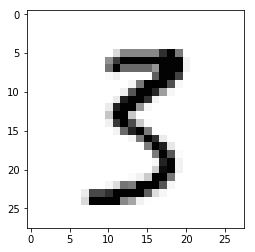

Pred value: 4
True value: 9


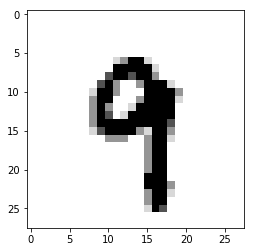

Pred value: 6
True value: 0


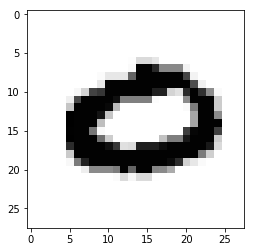

Pred value: 6
True value: 2


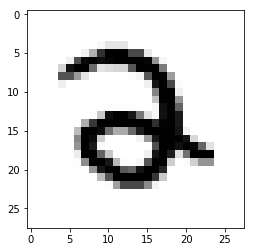

Pred value: 6
True value: 3


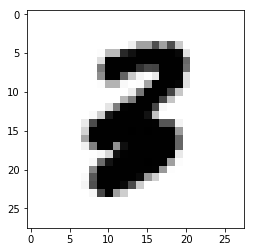

Pred value: 4
True value: 9


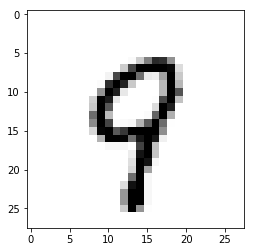

Pred value: 6
True value: 8


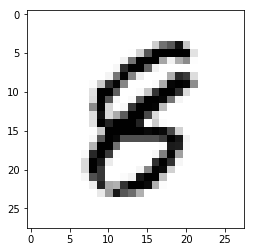

Pred value: 4
True value: 5


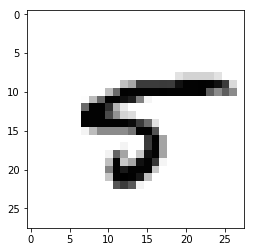

Pred value: 6
True value: 5


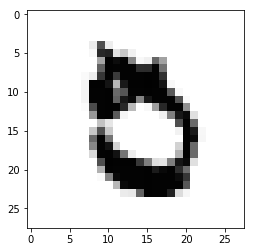

Pred value: 7
True value: 8


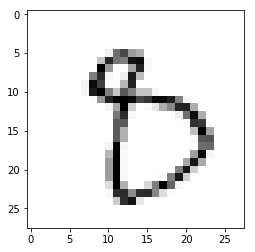

Pred value: 5
True value: 8


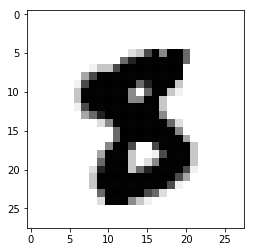

Pred value: 3
True value: 5


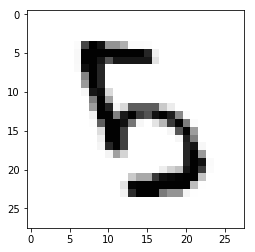

Pred value: 5
True value: 8


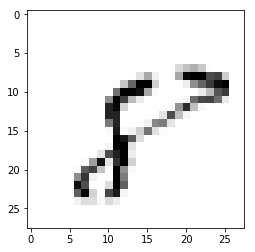

Pred value: 4
True value: 7


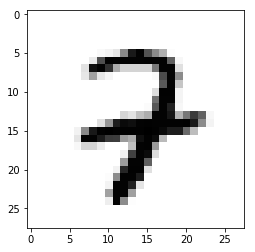

Pred value: 6
True value: 2


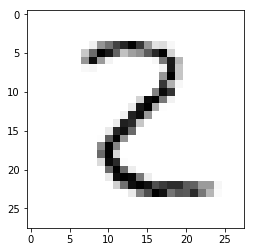

Pred value: 1
True value: 7


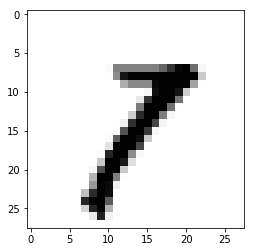

Pred value: 6
True value: 0


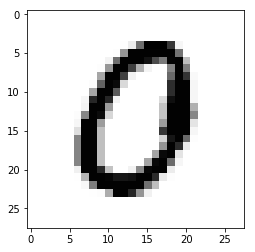

Pred value: 7
True value: 8


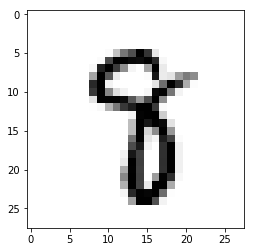

Pred value: 4
True value: 9


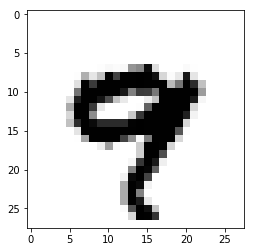

Pred value: 5
True value: 8


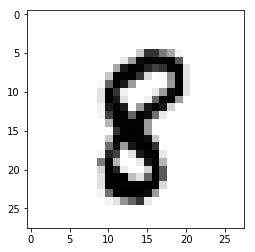

Pred value: 4
True value: 9


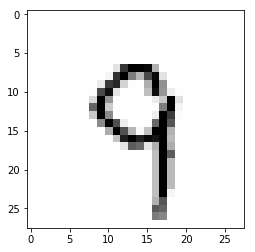

Pred value: 3
True value: 9


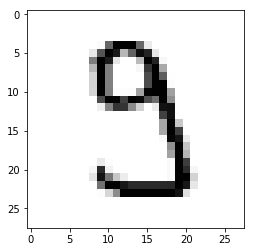

Pred value: 1
True value: 2


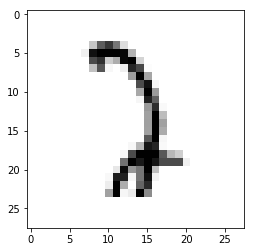

Pred value: 6
True value: 1


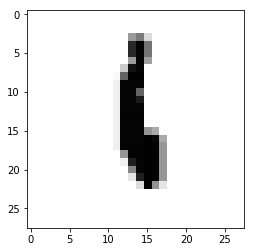

Pred value: 6
True value: 7


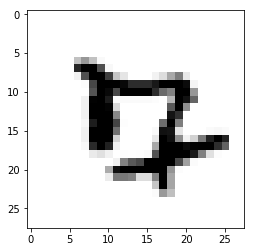

Pred value: 6
True value: 0


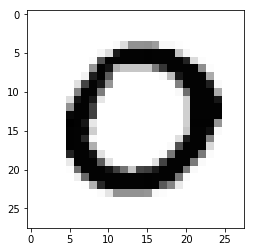

Pred value: 4
True value: 9


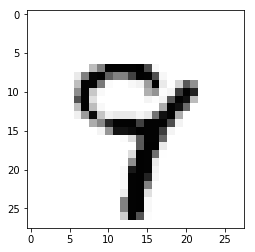

Pred value: 6
True value: 0


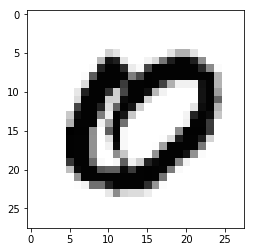

Pred value: 3
True value: 8


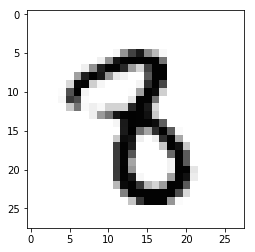

Pred value: 1
True value: 8


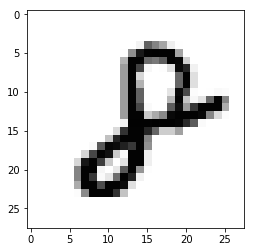

Pred value: 5
True value: 8


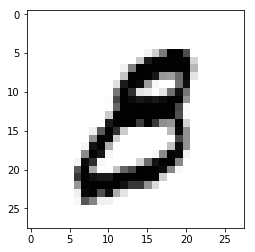

Pred value: 5
True value: 8


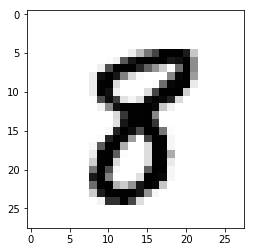

Pred value: 6
True value: 0


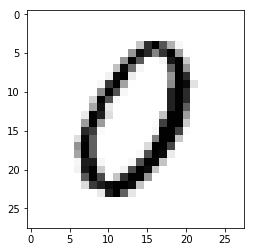

Pred value: 6
True value: 8


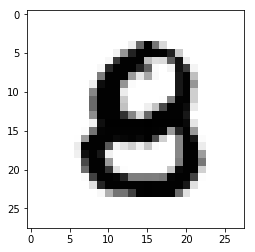

Pred value: 6
True value: 8


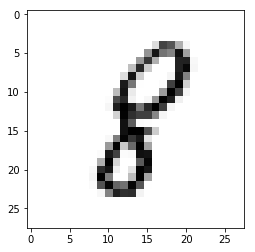

Pred value: 6
True value: 0


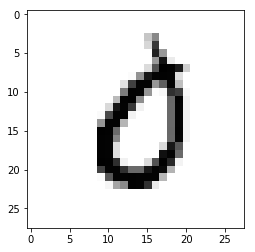

Pred value: 6
True value: 0


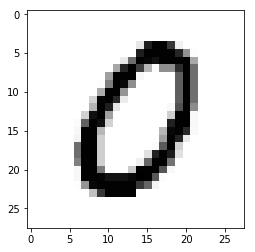

Pred value: 6
True value: 5


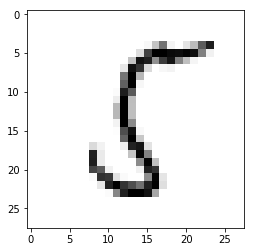

Pred value: 6
True value: 0


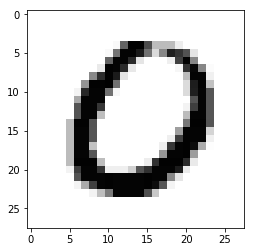

Pred value: 6
True value: 8


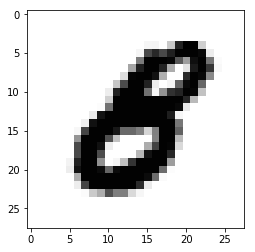

Pred value: 4
True value: 9


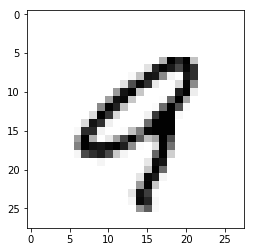

Pred value: 4
True value: 9


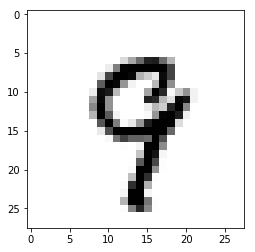

Pred value: 5
True value: 8


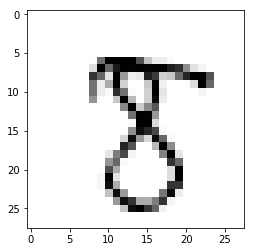

Pred value: 6
True value: 5


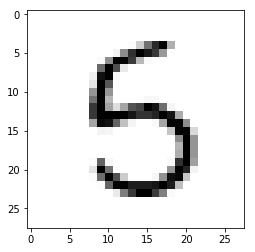

Pred value: 6
True value: 2


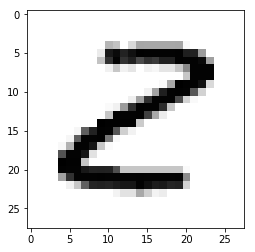

Pred value: 6
True value: 2


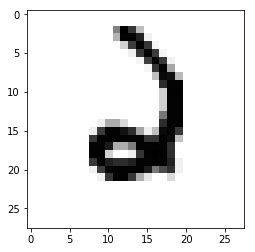

Pred value: 4
True value: 9


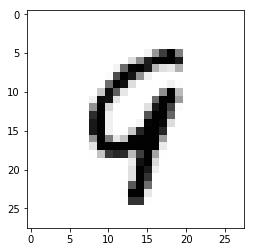

Pred value: 6
True value: 5


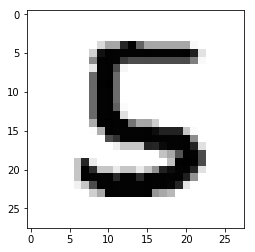

Pred value: 4
True value: 9


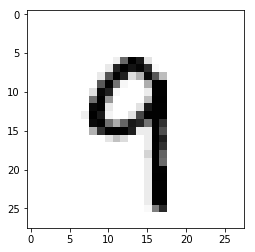

Pred value: 6
True value: 2


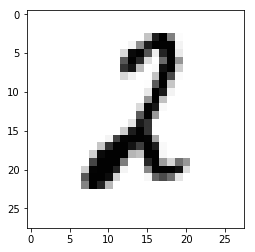

Pred value: 6
True value: 0


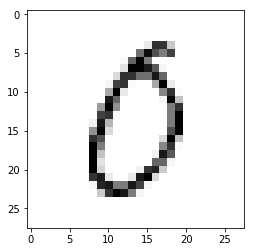

Pred value: 4
True value: 5


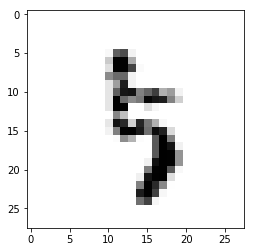

Pred value: 5
True value: 8


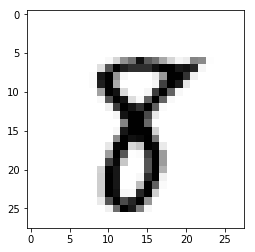

Pred value: 6
True value: 8


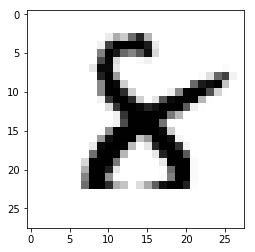

Pred value: 5
True value: 8


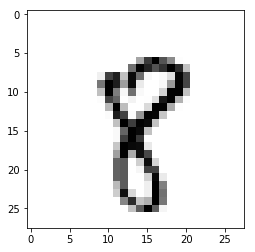

Pred value: 3
True value: 8


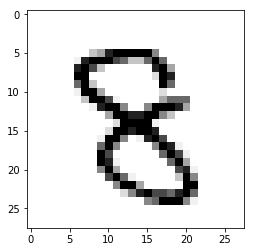

Pred value: 4
True value: 9


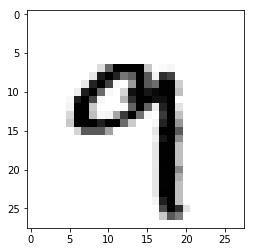

Pred value: 6
True value: 0


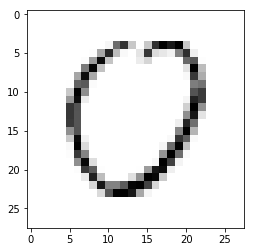

Pred value: 4
True value: 9


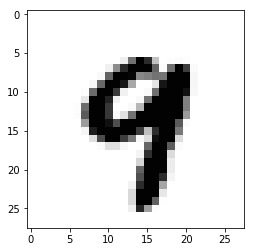

Pred value: 3
True value: 9


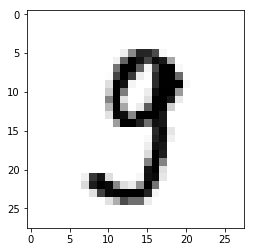

Pred value: 5
True value: 3


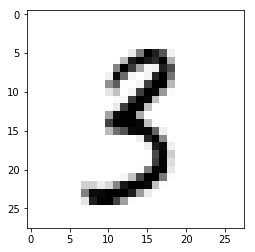

Pred value: 7
True value: 4


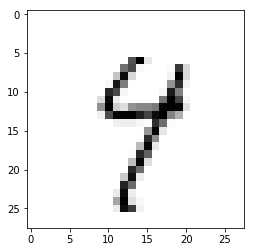

Pred value: 6
True value: 9


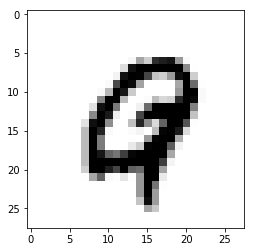

Pred value: 6
True value: 8


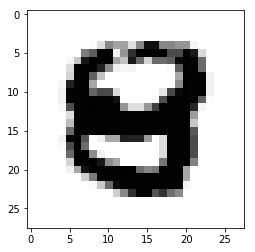

Pred value: 6
True value: 8


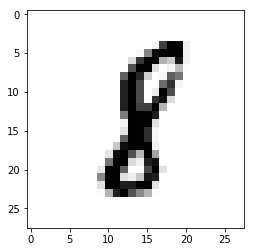

Pred value: 5
True value: 8


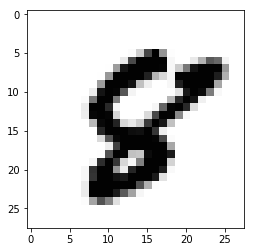

Pred value: 6
True value: 3


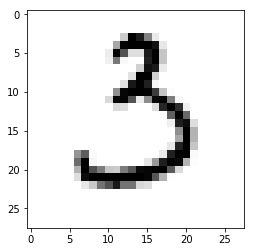

Pred value: 4
True value: 7


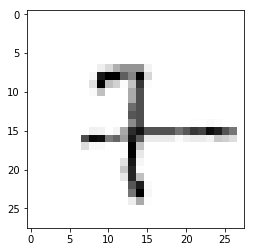

Pred value: 6
True value: 4


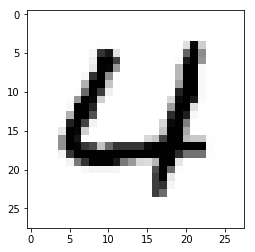

Pred value: 6
True value: 9


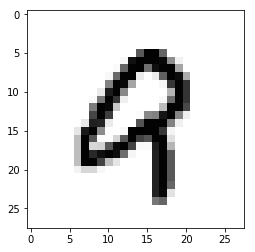

Pred value: 4
True value: 8


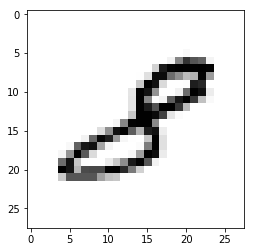

Pred value: 4
True value: 9


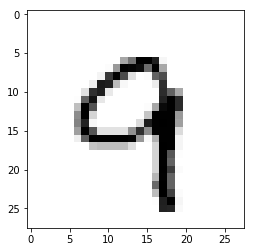

Pred value: 4
True value: 9


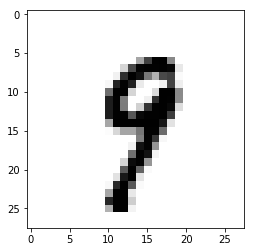

Pred value: 2
True value: 7


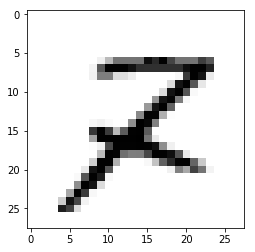

Pred value: 5
True value: 8


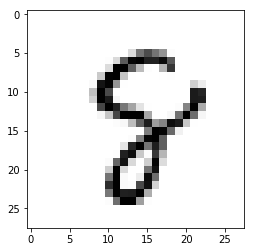

Pred value: 6
True value: 2


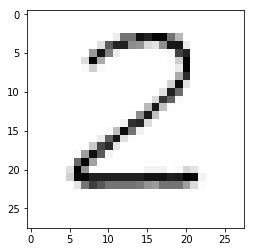

Pred value: 6
True value: 2


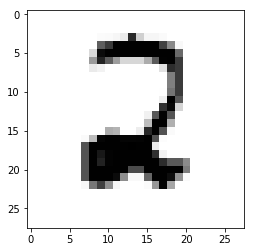

Pred value: 6
True value: 5


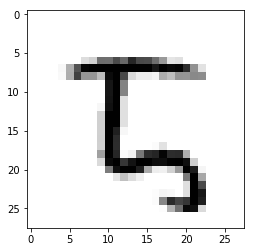

Pred value: 6
True value: 4


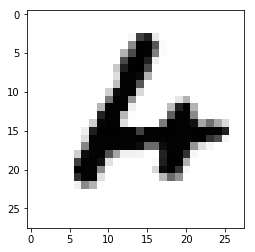

Pred value: 6
True value: 8


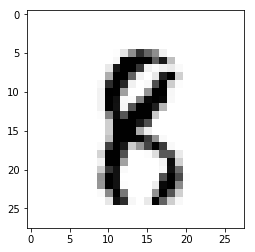

Pred value: 6
True value: 8


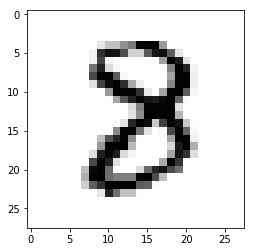

Pred value: 4
True value: 9


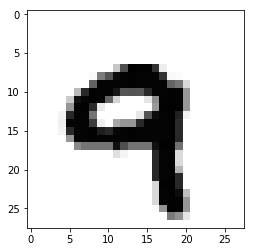

Pred value: 1
True value: 2


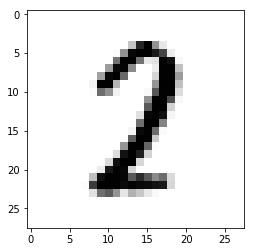

Pred value: 1
True value: 3


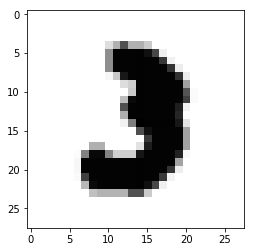

Pred value: 6
True value: 0


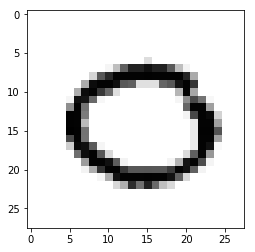

Pred value: 6
True value: 9


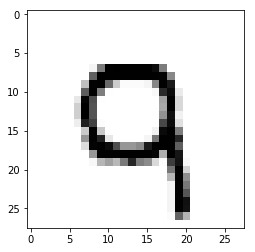

Pred value: 3
True value: 8


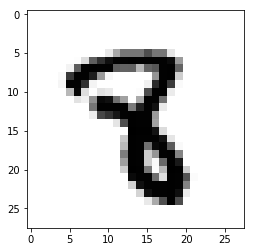

Pred value: 1
True value: 2


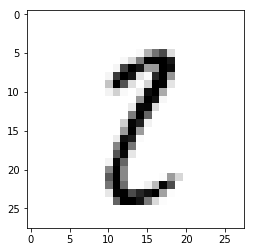

Pred value: 4
True value: 9


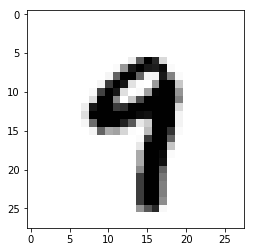

Pred value: 6
True value: 0


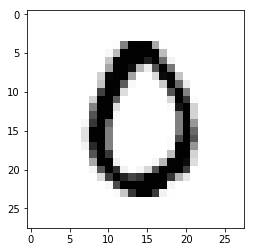

Pred value: 4
True value: 5


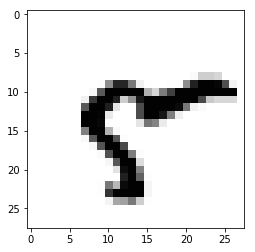

Pred value: 5
True value: 8


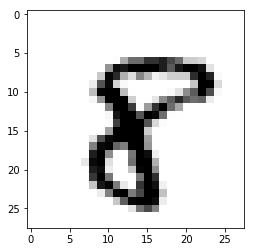

Pred value: 5
True value: 7


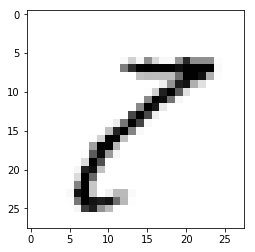

Pred value: 7
True value: 2


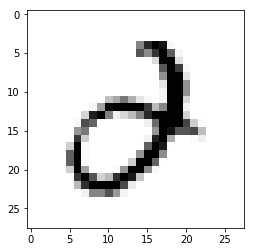

Pred value: 6
True value: 3


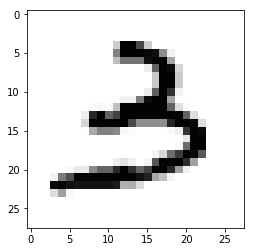

Pred value: 2
True value: 8


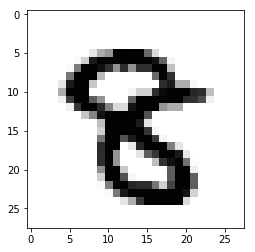

Pred value: 5
True value: 8


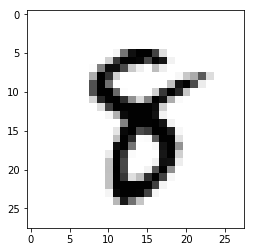

Pred value: 6
True value: 2


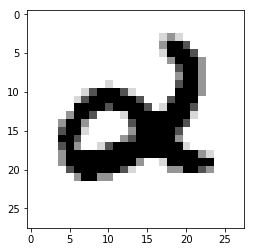

Pred value: 6
True value: 0


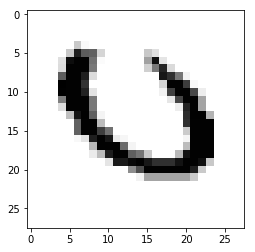

Pred value: 6
True value: 9


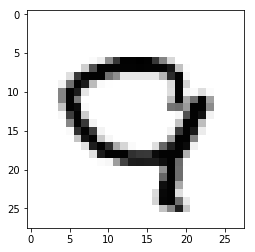

Pred value: 4
True value: 9


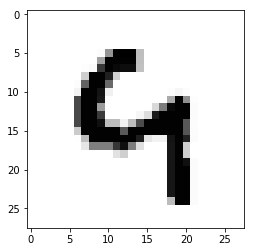

Pred value: 6
True value: 8


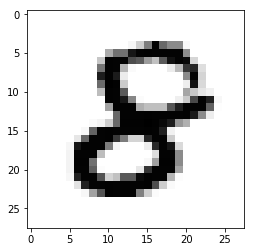

Pred value: 4
True value: 9


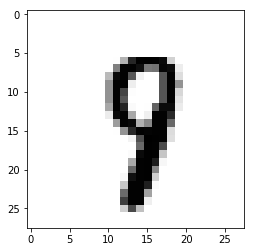

Pred value: 1
True value: 8


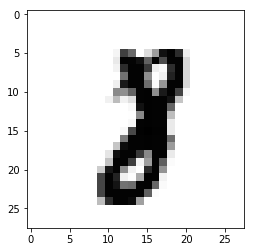

Pred value: 4
True value: 7


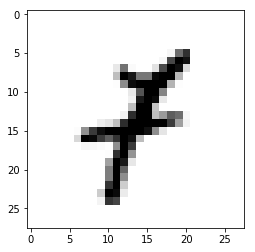

Pred value: 4
True value: 9


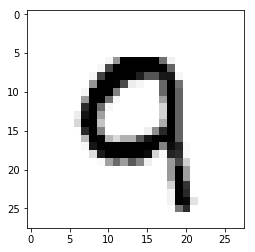

Pred value: 4
True value: 9


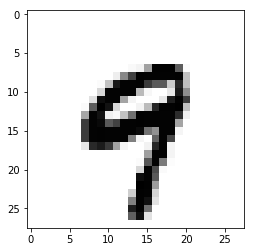

Pred value: 4
True value: 2


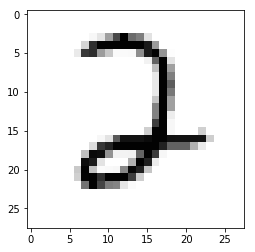

Pred value: 1
True value: 7


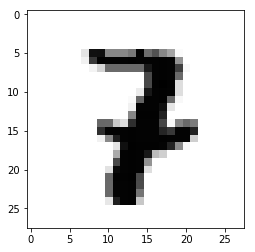

Pred value: 4
True value: 9


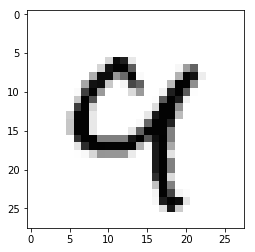

Pred value: 0
True value: 5


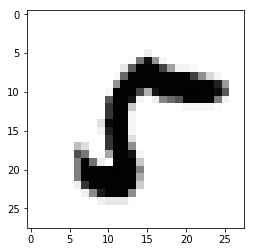

Pred value: 4
True value: 9


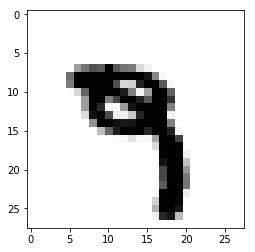

Pred value: 4
True value: 9


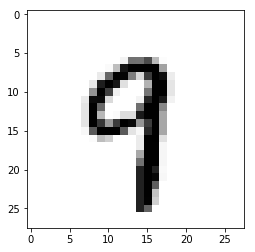

Pred value: 4
True value: 9


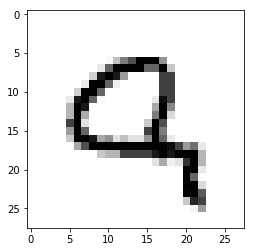

Pred value: 6
True value: 5


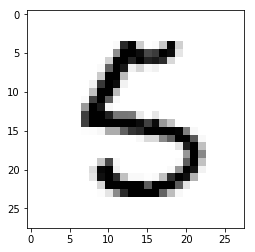

Pred value: 4
True value: 9


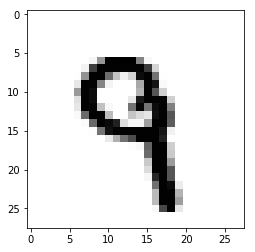

Pred value: 6
True value: 5


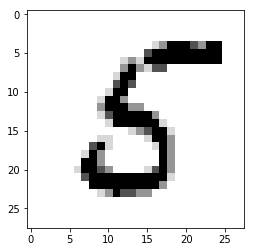

Pred value: 6
True value: 0


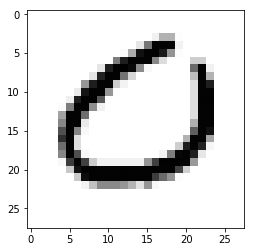

Pred value: 5
True value: 8


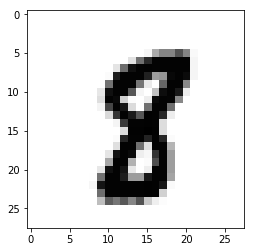

Pred value: 4
True value: 9


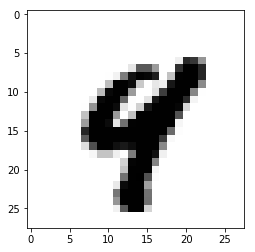

Pred value: 6
True value: 0


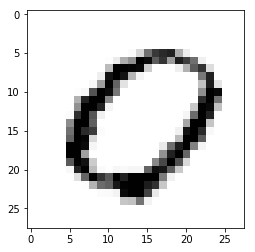

Pred value: 7
True value: 8


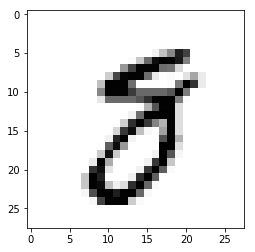

Pred value: 4
True value: 9


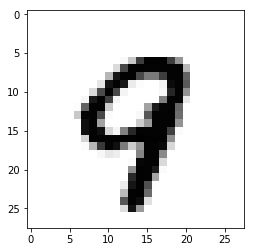

Pred value: 5
True value: 8


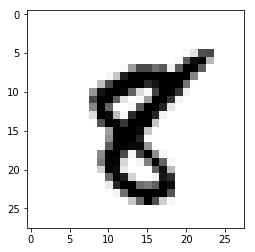

Pred value: 4
True value: 9


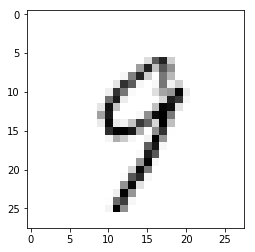

Pred value: 6
True value: 2


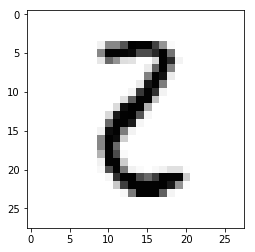

Pred value: 6
True value: 9


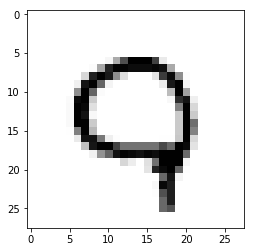

Pred value: 5
True value: 8


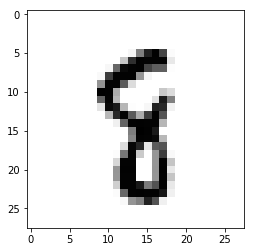

Pred value: 4
True value: 9


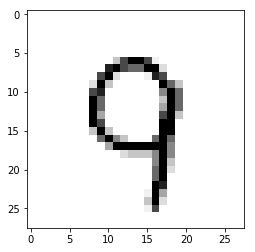

Pred value: 5
True value: 8


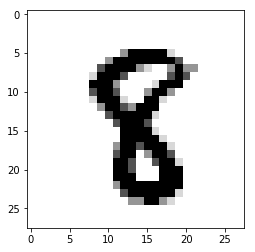

Pred value: 6
True value: 9


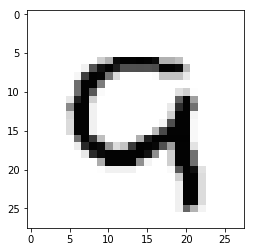

Pred value: 4
True value: 9


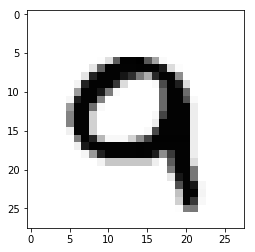

Pred value: 5
True value: 8


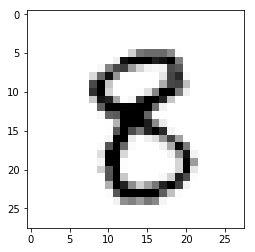

Pred value: 4
True value: 9


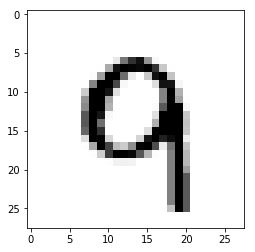

Pred value: 4
True value: 9


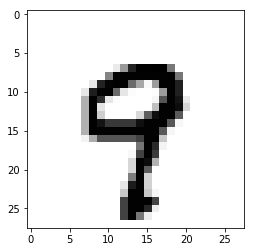

Pred value: 5
True value: 9


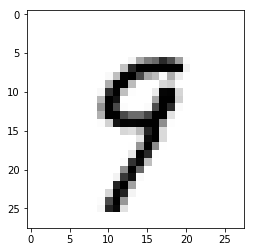

Pred value: 6
True value: 8


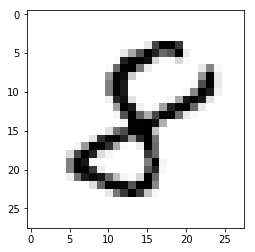

Pred value: 6
True value: 5


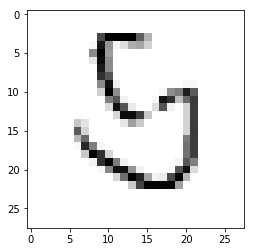

Pred value: 6
True value: 5


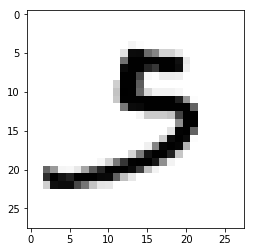

Pred value: 7
True value: 8


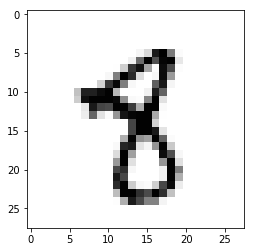

Pred value: 3
True value: 1


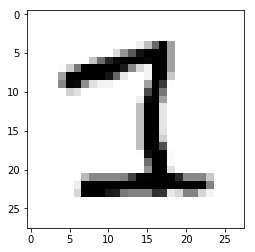

Pred value: 6
True value: 0


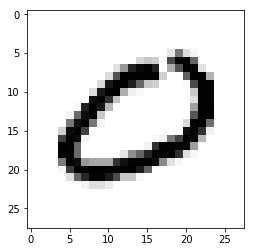

Pred value: 4
True value: 2


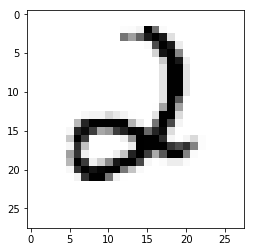

Pred value: 6
True value: 2


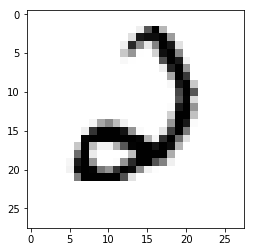

Pred value: 6
True value: 2


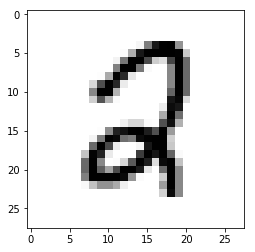

Pred value: 4
True value: 9


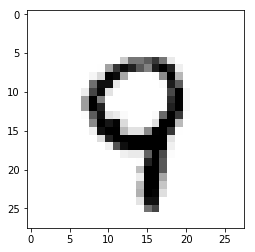

Pred value: 5
True value: 9


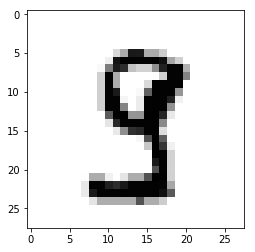

Pred value: 4
True value: 9


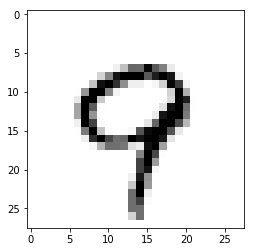

Pred value: 3
True value: 2


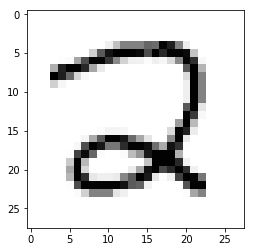

Pred value: 5
True value: 8


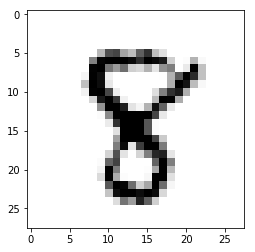

Pred value: 6
True value: 0


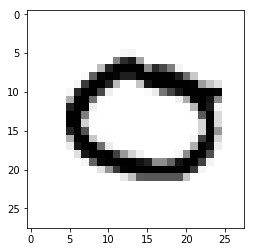

Pred value: 6
True value: 0


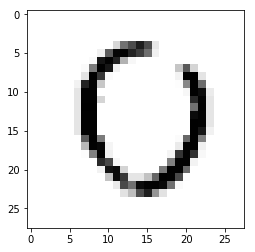

Pred value: 1
True value: 2


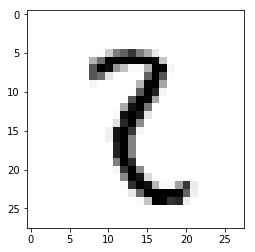

Pred value: 6
True value: 8


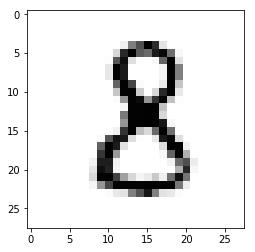

Pred value: 4
True value: 9


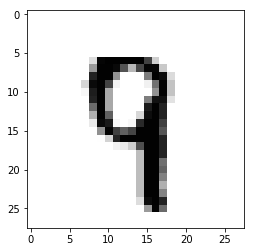

Pred value: 5
True value: 8


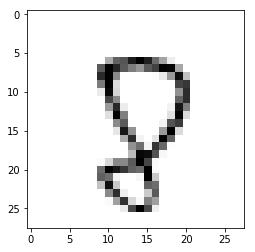

Pred value: 6
True value: 5


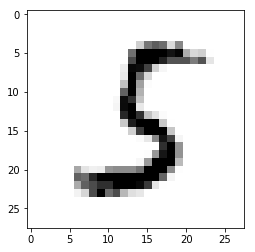

Pred value: 7
True value: 8


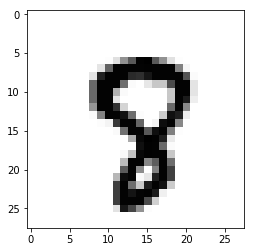

Pred value: 4
True value: 3


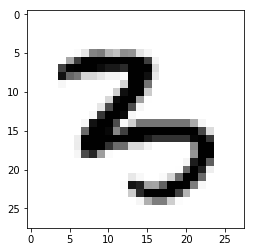

Pred value: 5
True value: 8


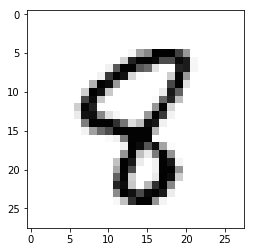

Pred value: 4
True value: 9


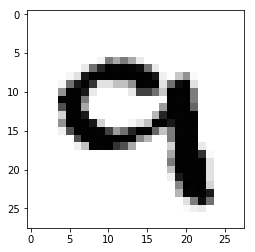

Pred value: 4
True value: 9


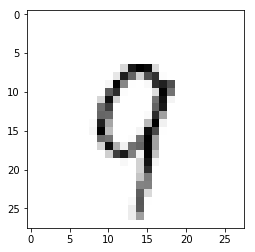

Pred value: 3
True value: 5


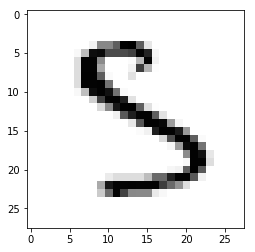

Pred value: 4
True value: 9


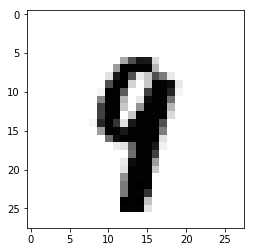

Pred value: 6
True value: 3


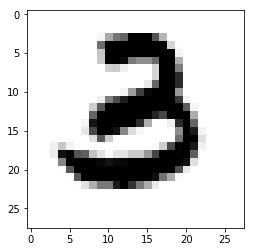

Pred value: 3
True value: 7


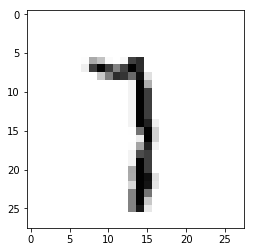

Pred value: 4
True value: 9


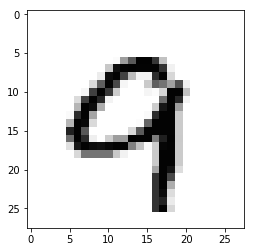

Pred value: 1
True value: 9


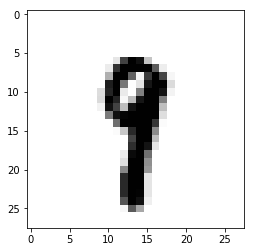

Pred value: 4
True value: 9


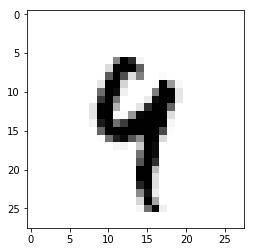

Pred value: 5
True value: 8


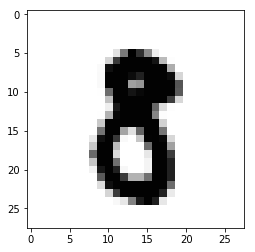

Pred value: 4
True value: 8


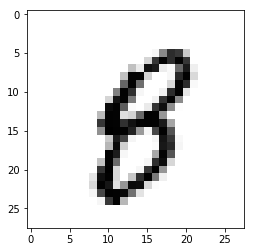

Pred value: 6
True value: 0


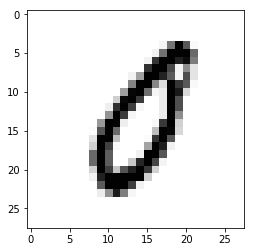

Pred value: 4
True value: 9


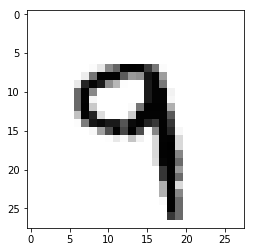

Pred value: 4
True value: 9


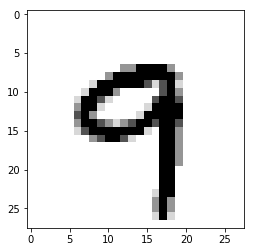

Pred value: 4
True value: 9


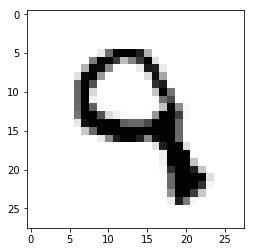

Pred value: 5
True value: 3


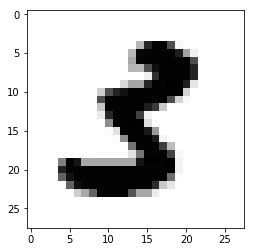

Pred value: 4
True value: 7


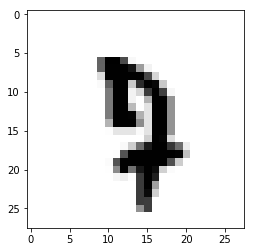

Pred value: 4
True value: 9


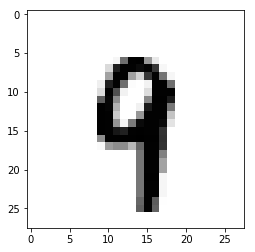

Pred value: 1
True value: 8


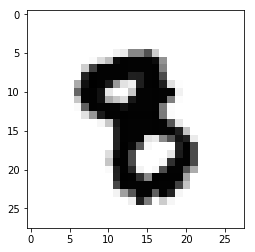

Pred value: 4
True value: 9


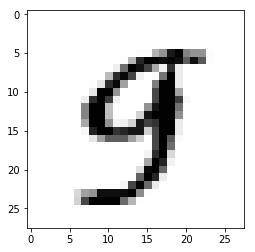

Pred value: 4
True value: 9


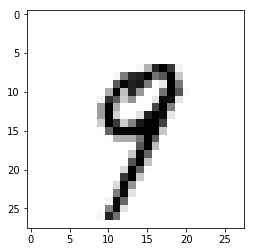

Pred value: 1
True value: 8


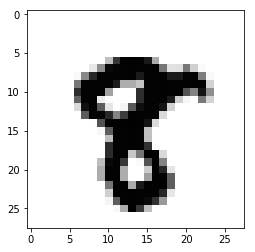

Pred value: 4
True value: 9


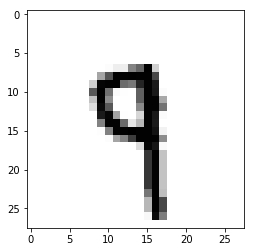

Pred value: 6
True value: 5


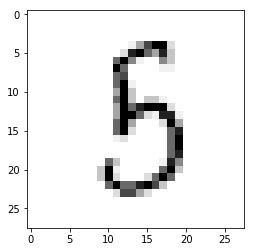

Pred value: 6
True value: 0


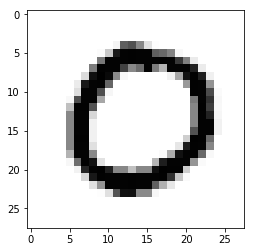

Pred value: 4
True value: 9


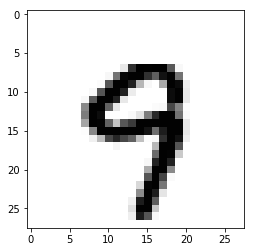

Pred value: 3
True value: 8


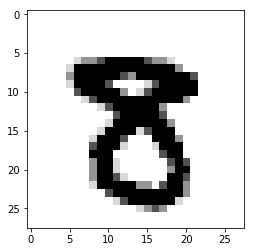

Pred value: 4
True value: 9


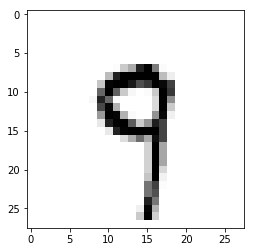

Pred value: 6
True value: 5


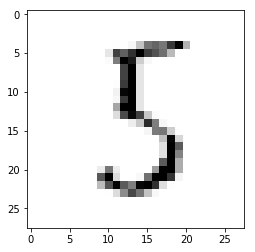

Pred value: 3
True value: 8


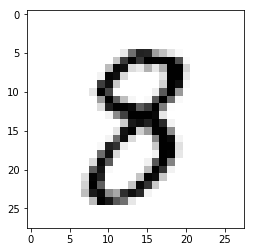

Pred value: 6
True value: 5


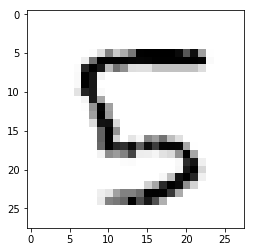

Pred value: 5
True value: 6


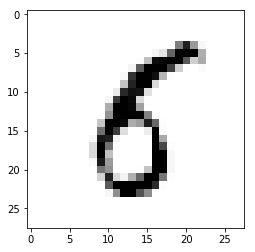

Pred value: 6
True value: 0


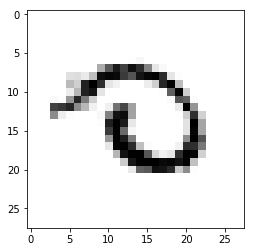

Pred value: 3
True value: 8


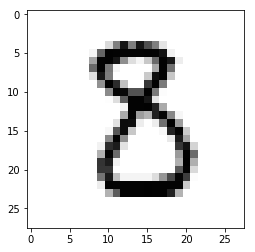

Pred value: 6
True value: 4


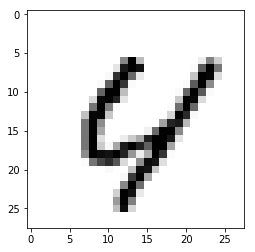

Pred value: 6
True value: 8


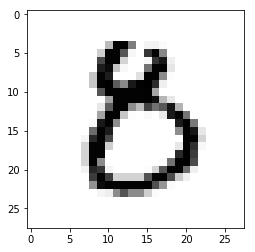

Pred value: 7
True value: 9


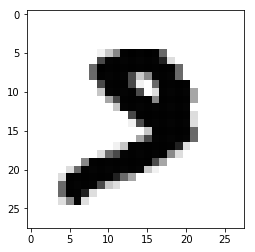

Pred value: 6
True value: 0


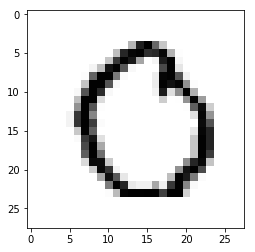

Pred value: 6
True value: 0


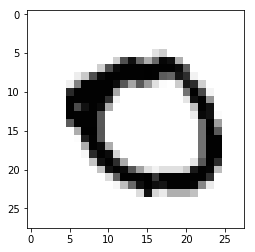

Pred value: 6
True value: 8


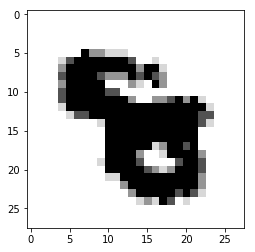

Pred value: 4
True value: 9


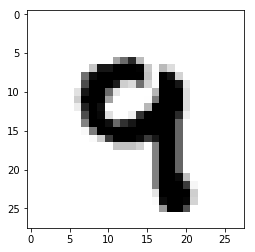

Pred value: 6
True value: 0


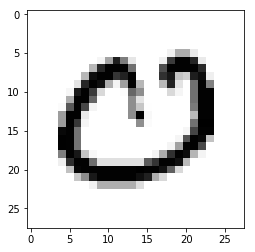

Pred value: 1
True value: 8


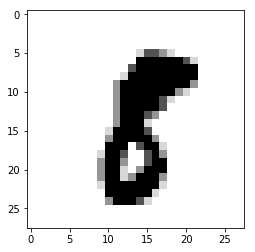

Pred value: 4
True value: 9


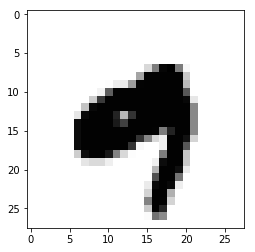

Pred value: 4
True value: 9


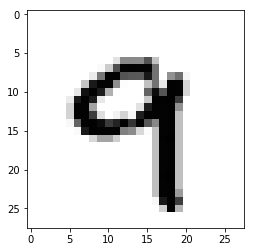

Pred value: 4
True value: 8


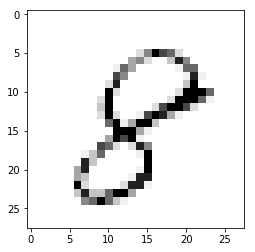

Pred value: 4
True value: 9


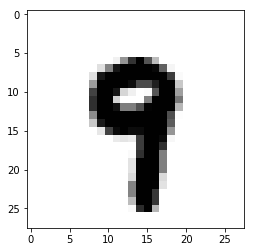

Pred value: 4
True value: 9


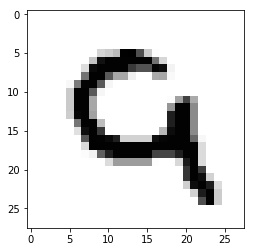

Pred value: 6
True value: 2


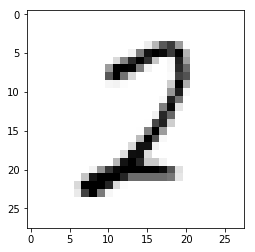

Pred value: 6
True value: 8


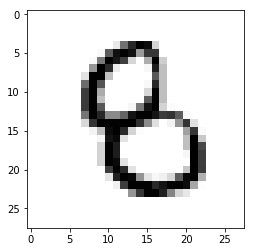

Pred value: 3
True value: 8


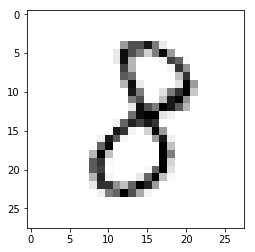

Pred value: 4
True value: 9


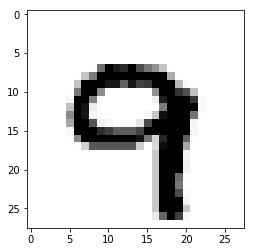

Pred value: 3
True value: 8


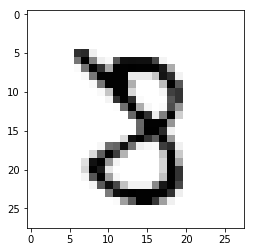

Pred value: 6
True value: 8


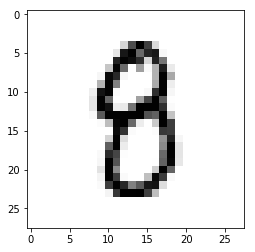

Pred value: 7
True value: 8


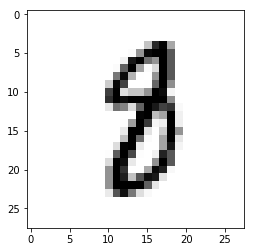

Pred value: 4
True value: 9


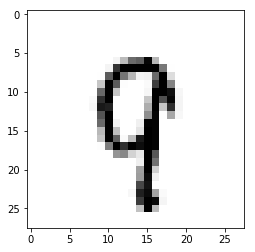

Pred value: 6
True value: 2


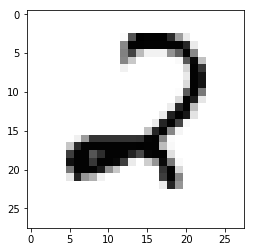

Pred value: 4
True value: 9


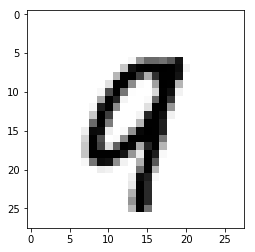

Pred value: 2
True value: 8


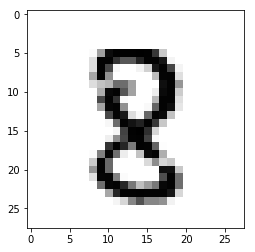

Pred value: 6
True value: 8


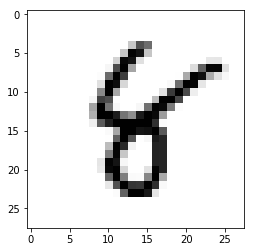

Pred value: 4
True value: 6


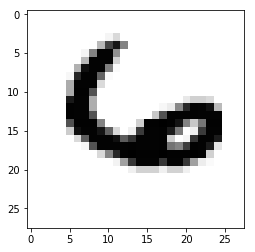

Pred value: 3
True value: 8


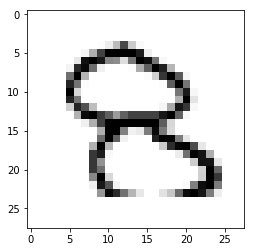

Pred value: 5
True value: 8


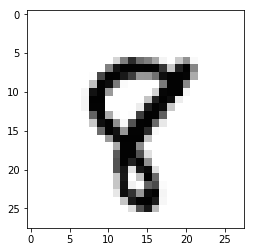

Pred value: 4
True value: 9


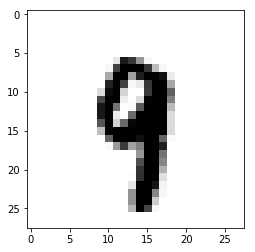

Pred value: 0
True value: 8


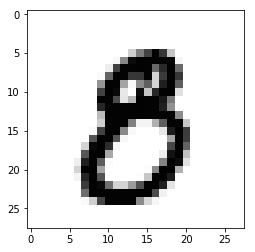

Pred value: 6
True value: 0


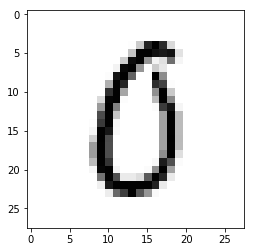

Pred value: 4
True value: 9


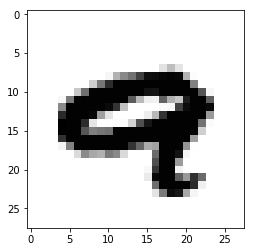

Pred value: 4
True value: 9


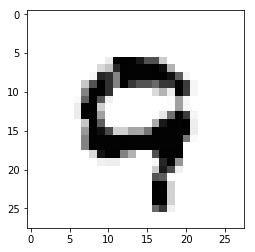

Pred value: 3
True value: 8


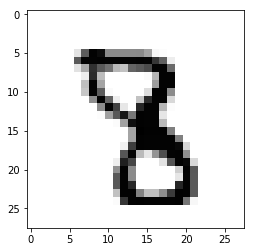

Pred value: 6
True value: 2


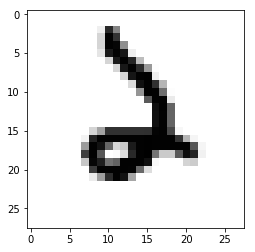

Pred value: 4
True value: 9


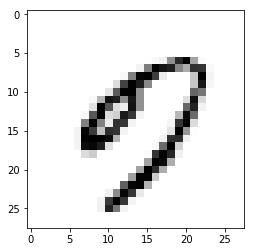

Pred value: 5
True value: 8


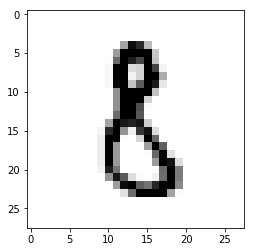

Pred value: 4
True value: 2


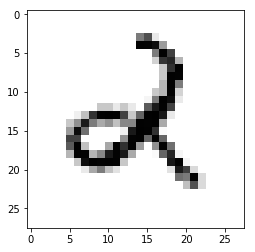

Pred value: 4
True value: 9


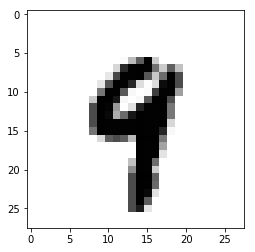

Pred value: 7
True value: 2


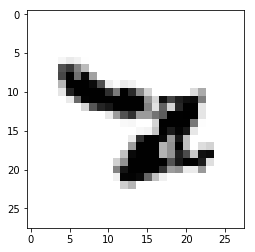

Pred value: 4
True value: 5


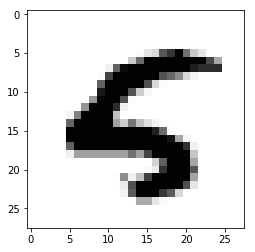

Pred value: 6
True value: 2


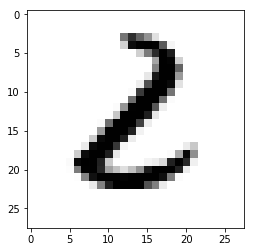

Pred value: 4
True value: 9


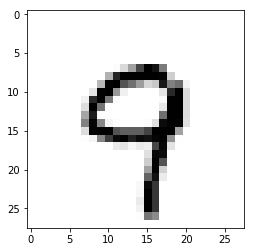

Pred value: 4
True value: 9


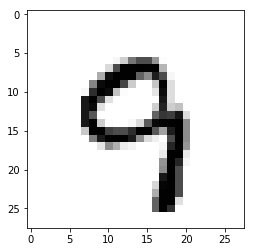

Pred value: 4
True value: 9


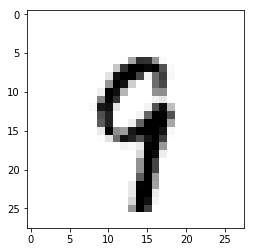

Pred value: 6
True value: 0


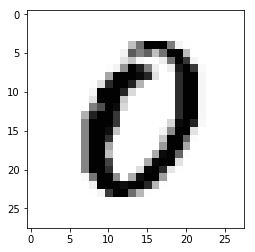

Pred value: 6
True value: 2


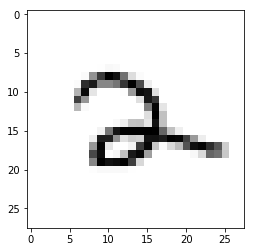

Pred value: 5
True value: 0


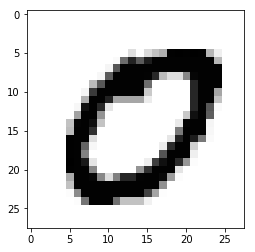

Pred value: 4
True value: 9


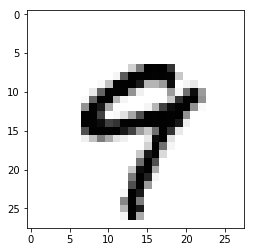

Pred value: 7
True value: 1


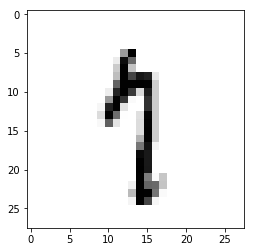

Pred value: 1
True value: 2


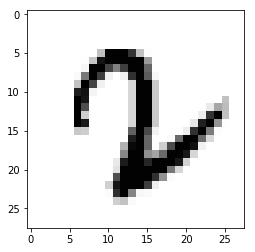

Pred value: 6
True value: 8


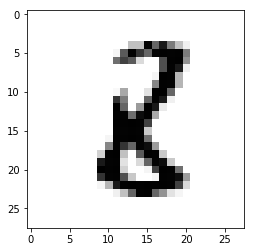

Pred value: 6
True value: 0


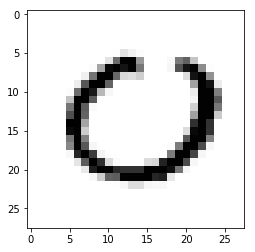

Pred value: 4
True value: 9


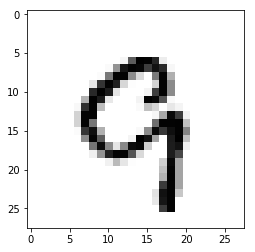

Pred value: 4
True value: 9


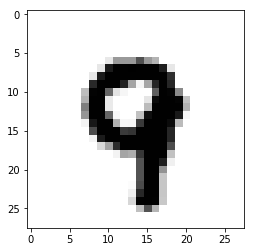

Pred value: 5
True value: 8


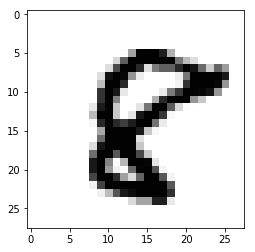

Pred value: 7
True value: 9


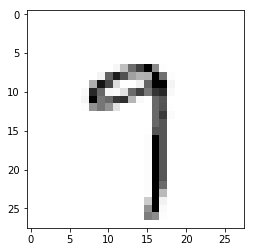

Pred value: 3
True value: 7


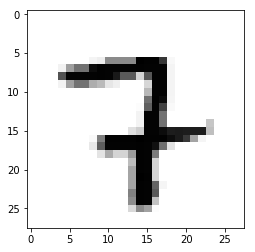

Pred value: 4
True value: 7


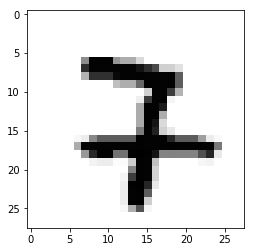

Pred value: 6
True value: 8


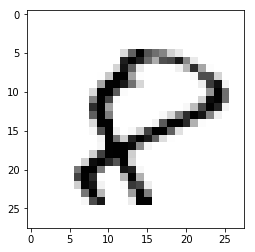

Pred value: 5
True value: 8


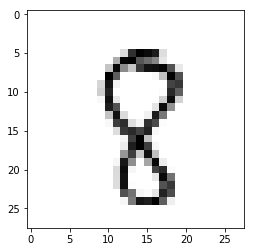

Pred value: 4
True value: 9


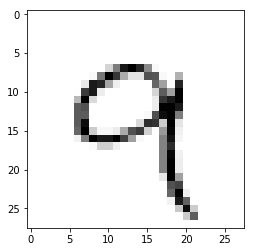

Pred value: 4
True value: 9


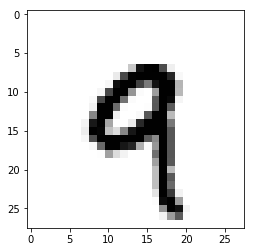

Pred value: 3
True value: 7


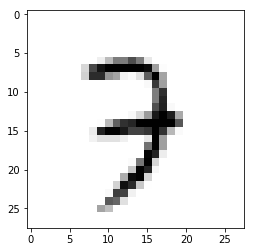

Pred value: 4
True value: 9


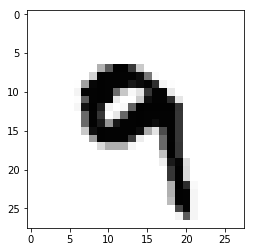

Pred value: 5
True value: 3


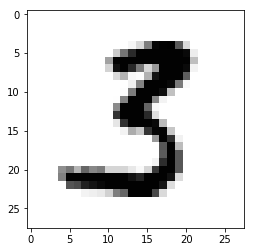

Pred value: 4
True value: 9


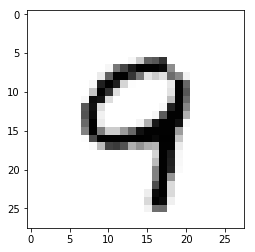

Pred value: 5
True value: 8


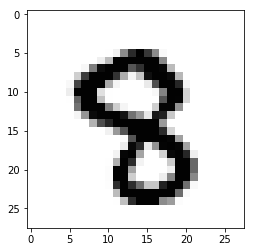

Pred value: 6
True value: 2


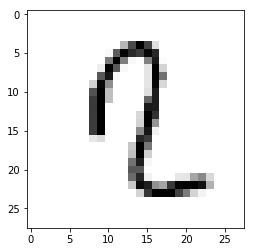

Pred value: 1
True value: 8


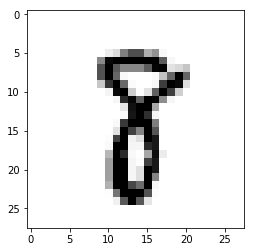

Pred value: 6
True value: 8


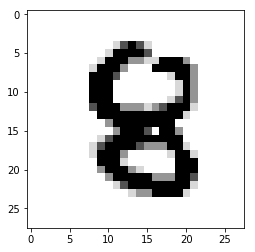

Pred value: 6
True value: 5


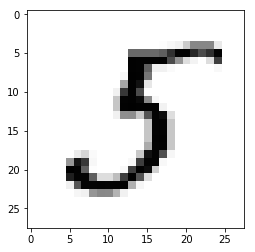

Pred value: 6
True value: 5


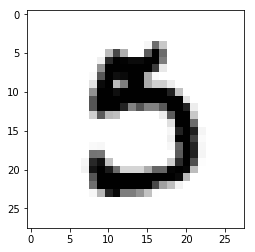

Pred value: 6
True value: 3


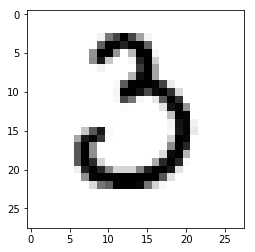

Pred value: 4
True value: 9


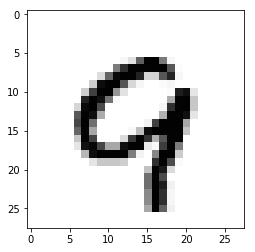

Pred value: 4
True value: 9


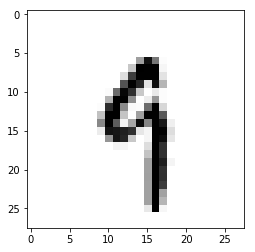

Pred value: 4
True value: 5


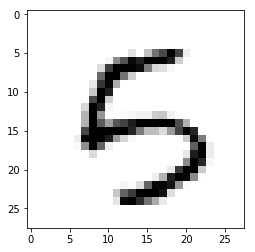

Pred value: 3
True value: 5


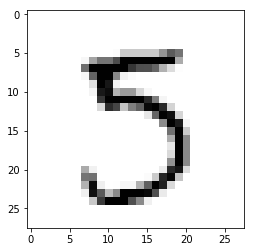

Pred value: 5
True value: 3


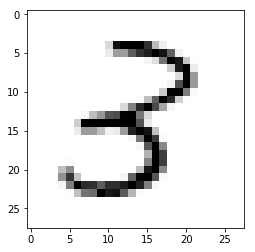

Pred value: 4
True value: 9


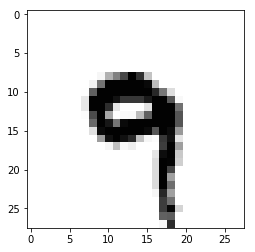

Pred value: 6
True value: 2


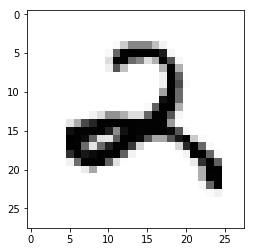

Pred value: 4
True value: 9


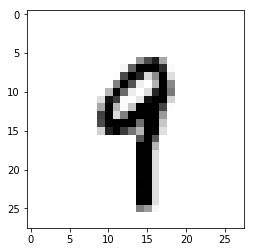

Pred value: 6
True value: 0


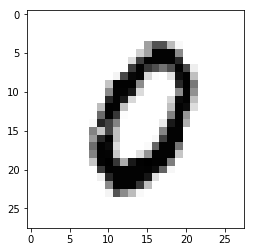

Pred value: 4
True value: 9


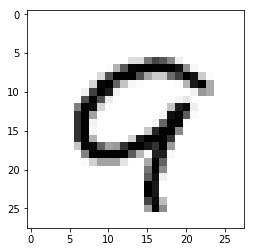

Pred value: 7
True value: 9


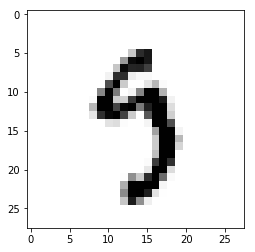

Pred value: 4
True value: 9


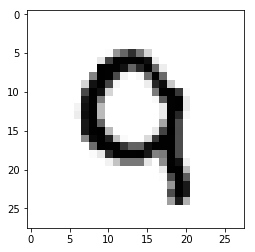

Pred value: 7
True value: 2


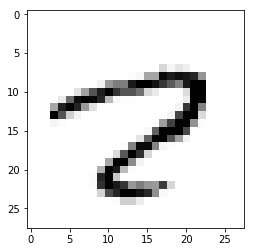

Pred value: 5
True value: 8


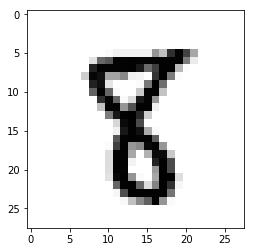

Pred value: 4
True value: 9


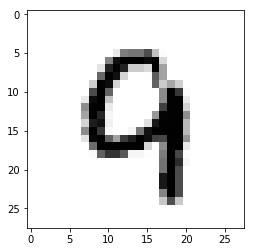

Pred value: 4
True value: 9


KeyboardInterrupt: ignored

In [0]:
# Loading dataset
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.mnist.load_data()
# Reshaping the array to 4-dims so that it can work with the Keras API
x_train = x_train.reshape(x_train.shape[0], 28, 28, 1)
x_test = x_test.reshape(x_test.shape[0], 28, 28, 1)
input_shape = (28, 28, 1)
# Making sure that the values are float so that we can get decimal points after division
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
# Normalizing the RGB codes by dividing it to the max RGB value.
#x_train /= 255
#x_test /= 255
print('x_train shape:', x_train.shape)
print('Number of images in x_train', x_train.shape[0])
print('Number of images in x_test', x_test.shape[0])
# Creating a Sequential Model and adding the layers
model = Sequential()
model.add(Conv2D(28, kernel_size=(3,1), input_shape=input_shape))
model.add(Conv2D(28, kernel_size=(1,3), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(28, kernel_size=(3,3), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten()) # Flattening the 2D arrays for fully connected layers
model.add(Dense(128, activation=tf.nn.relu))
model.add(Dropout(0.5))      
model.add(Dense(10,activation=tf.nn.softmax))
model.compile(optimizer='adam', 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)
his = model.fit(x=x_train,y=y_train, epochs=50)
_, train_acc = model.evaluate(x_train, y_train, verbose=0)
_, test_acc = model.evaluate(x_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
y_pred = model.predict(x_test)
print(y_pred.shape)
print(y_test.shape)
y = np.argmax(y_pred, axis=1)
print(y.shape)
confusion_matrix(y_test, y)
for i in range(10000):
    if(y[i] != y_test[i]):
        print("Pred value:",y[i])
        print("True value:",y_test[i])
        plt.figure
        plt.imshow(x_test[i].reshape(28, 28),cmap='Greys')
        plt.show()

x_train shape: (60000, 28, 28, 1)
Number of images in x_train 60000
Number of images in x_test 10000
Epoch 1/10
60000/60000 [==============================] - 72s 1ms/step - loss: 2.1124 - acc: 0.7803
Epoch 2/10
60000/60000 [==============================] - 69s 1ms/step - loss: 0.2792 - acc: 0.9269
Epoch 3/10
60000/60000 [==============================] - 71s 1ms/step - loss: 0.1972 - acc: 0.9465
Epoch 4/10
60000/60000 [==============================] - 71s 1ms/step - loss: 0.1661 - acc: 0.9562
Epoch 5/10
60000/60000 [==============================] - 72s 1ms/step - loss: 0.1496 - acc: 0.9597
Epoch 6/10
60000/60000 [==============================] - 73s 1ms/step - loss: 0.1298 - acc: 0.9660
Epoch 7/10
60000/60000 [==============================] - 72s 1ms/step - loss: 0.1247 - acc: 0.9678
Epoch 8/10
60000/60000 [==============================] - 70s 1ms/step - loss: 0.1176 - acc: 0.9691
Epoch 9/10
60000/60000 [==============================] - 69s 1ms/step - loss: 0.1099 - acc: 0.9716

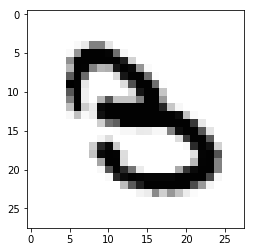

Pred value: 8
True value: 9


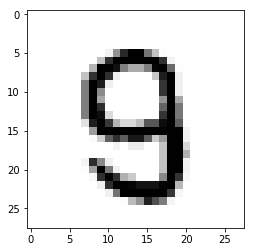

Pred value: 4
True value: 9


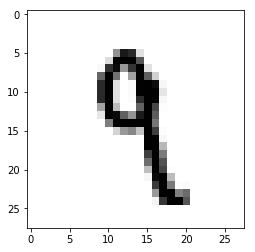

Pred value: 8
True value: 0


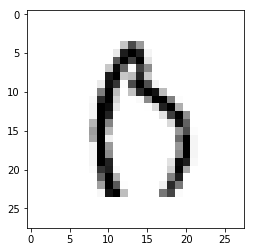

Pred value: 8
True value: 5


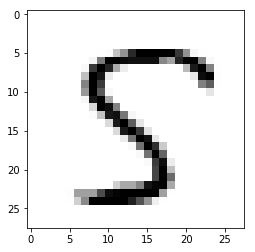

Pred value: 4
True value: 9


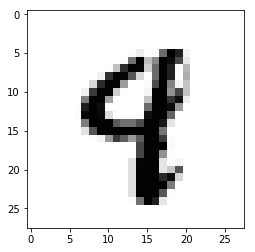

Pred value: 0
True value: 6


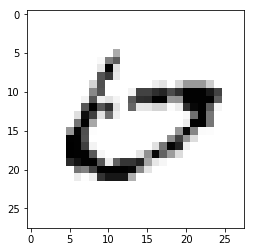

Pred value: 2
True value: 8


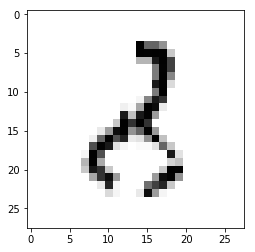

Pred value: 4
True value: 6


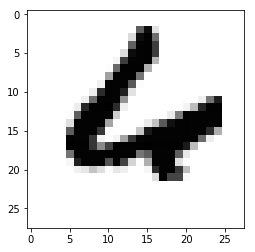

Pred value: 4
True value: 2


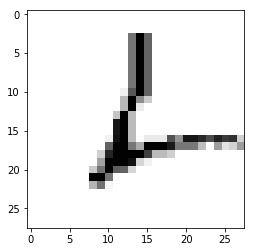

Pred value: 3
True value: 5


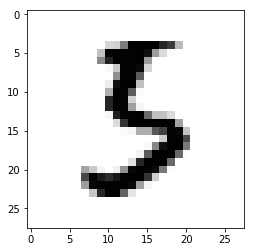

Pred value: 2
True value: 7


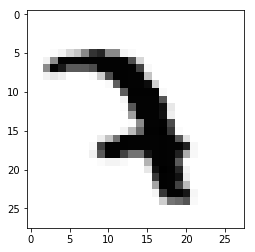

Pred value: 4
True value: 8


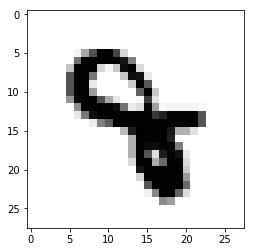

Pred value: 7
True value: 1


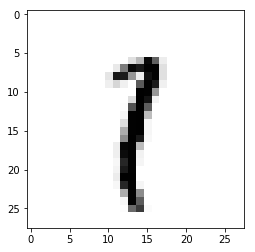

Pred value: 8
True value: 5


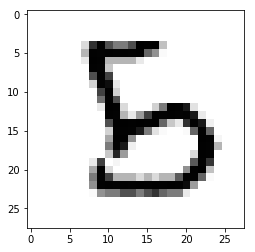

Pred value: 5
True value: 3


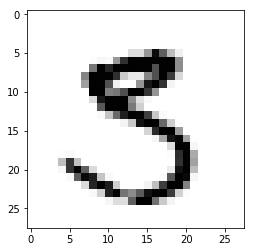

Pred value: 9
True value: 8


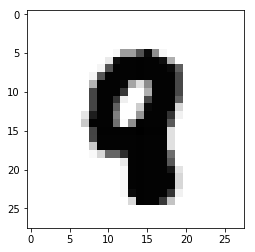

Pred value: 2
True value: 1


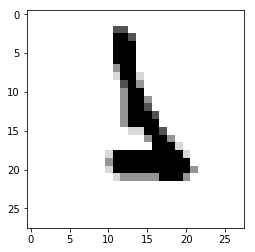

Pred value: 0
True value: 6


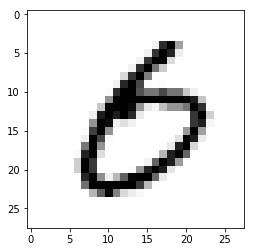

Pred value: 5
True value: 6


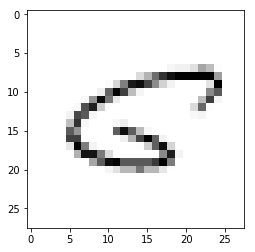

Pred value: 2
True value: 7


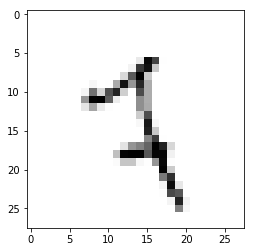

Pred value: 8
True value: 6


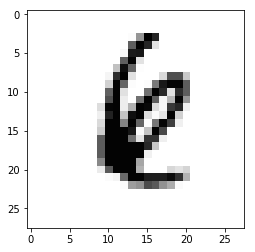

Pred value: 8
True value: 9


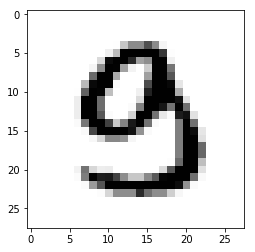

Pred value: 2
True value: 7


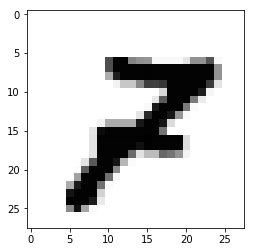

Pred value: 8
True value: 3


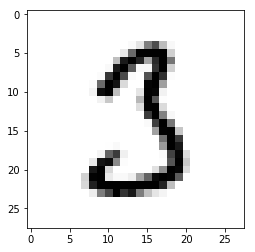

Pred value: 8
True value: 6


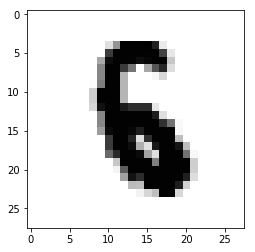

Pred value: 8
True value: 0


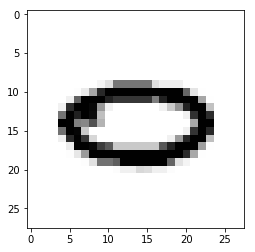

Pred value: 4
True value: 9


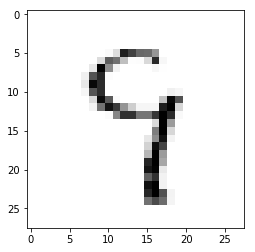

Pred value: 2
True value: 7


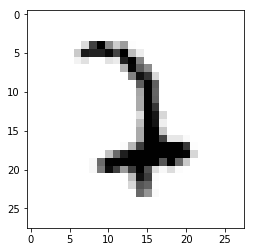

Pred value: 8
True value: 9


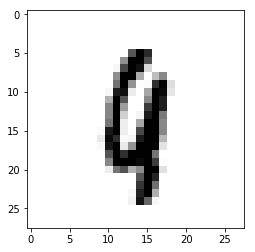

Pred value: 3
True value: 5


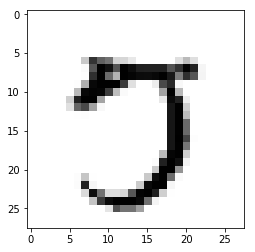

Pred value: 8
True value: 5


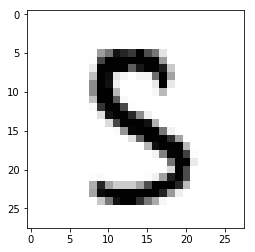

Pred value: 3
True value: 5


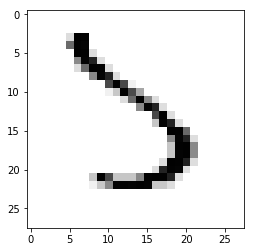

Pred value: 8
True value: 9


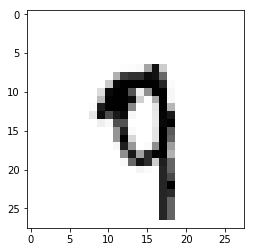

Pred value: 8
True value: 7


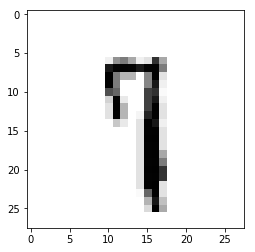

Pred value: 3
True value: 1


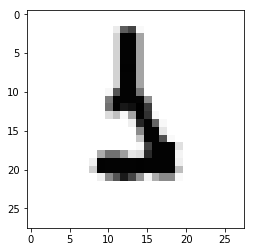

Pred value: 8
True value: 9


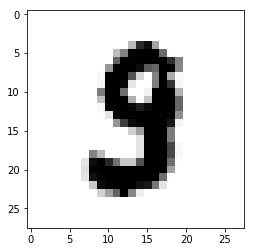

Pred value: 4
True value: 6


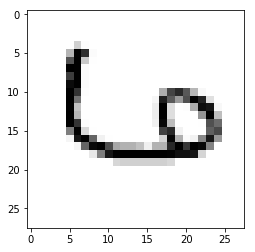

Pred value: 9
True value: 7


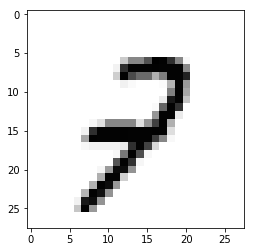

Pred value: 6
True value: 0


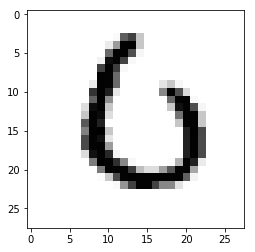

Pred value: 8
True value: 5


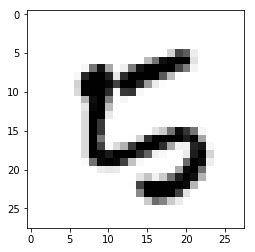

Pred value: 8
True value: 9


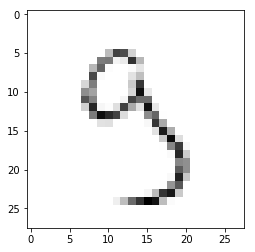

Pred value: 9
True value: 7


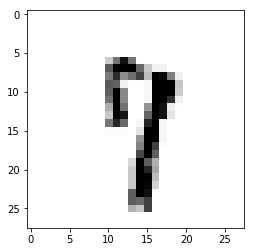

Pred value: 2
True value: 5


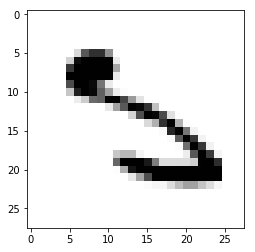

Pred value: 7
True value: 0


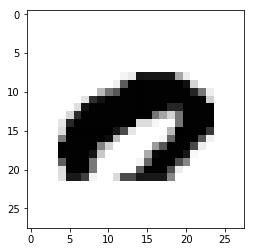

Pred value: 4
True value: 6


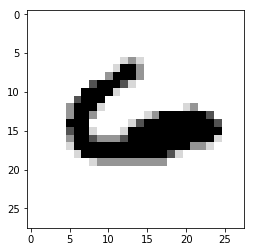

Pred value: 4
True value: 9


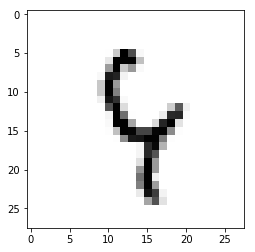

Pred value: 7
True value: 1


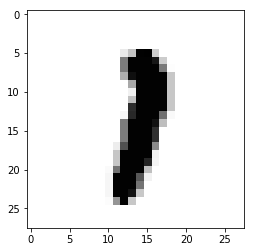

Pred value: 2
True value: 1


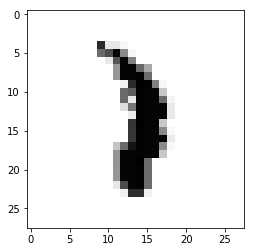

Pred value: 3
True value: 5


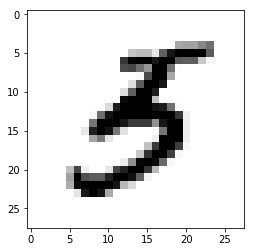

Pred value: 6
True value: 5


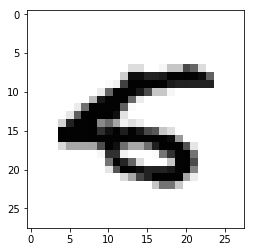

Pred value: 4
True value: 8


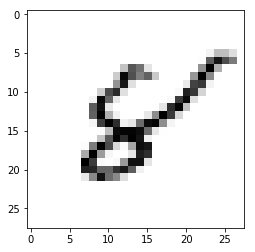

Pred value: 0
True value: 7


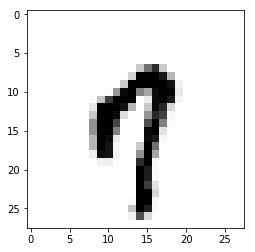

Pred value: 0
True value: 2


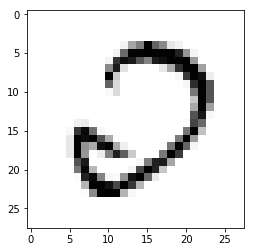

Pred value: 7
True value: 3


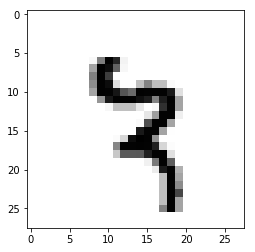

Pred value: 0
True value: 6


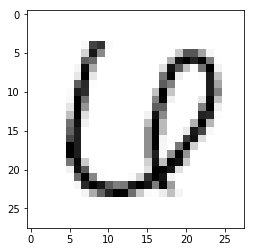

Pred value: 8
True value: 9


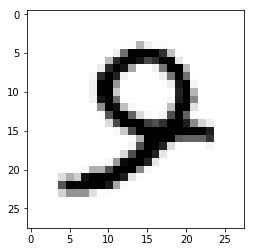

Pred value: 9
True value: 4


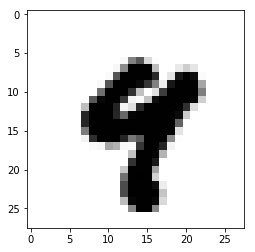

Pred value: 1
True value: 6


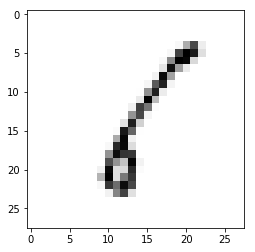

Pred value: 7
True value: 1


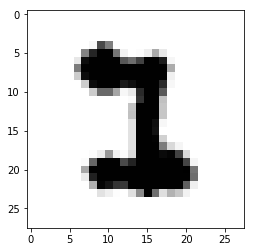

Pred value: 2
True value: 7


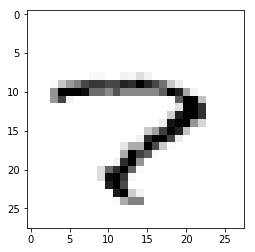

Pred value: 8
True value: 5


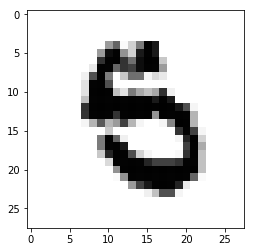

Pred value: 8
True value: 5


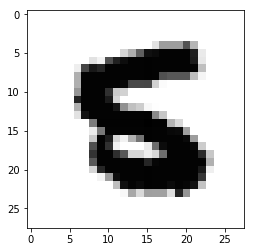

Pred value: 3
True value: 1


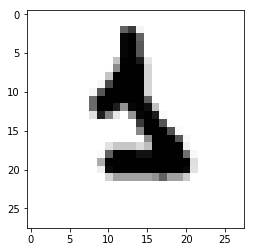

Pred value: 5
True value: 3


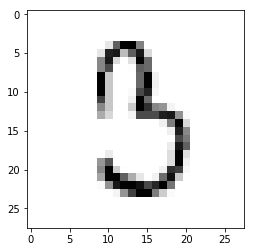

Pred value: 0
True value: 9


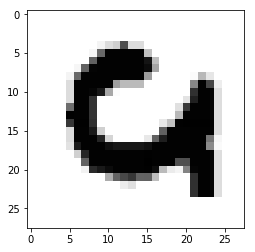

Pred value: 2
True value: 0


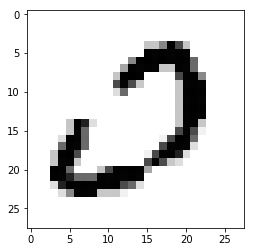

Pred value: 8
True value: 5


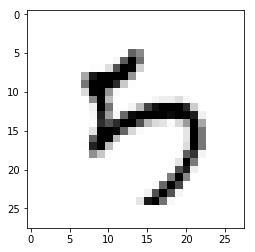

Pred value: 8
True value: 6


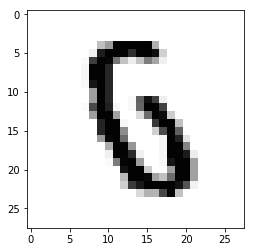

Pred value: 3
True value: 5


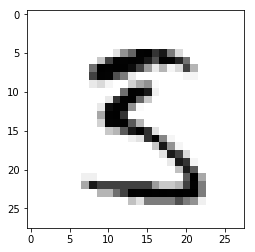

Pred value: 2
True value: 6


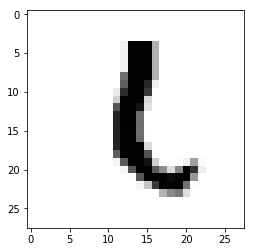

Pred value: 4
True value: 7


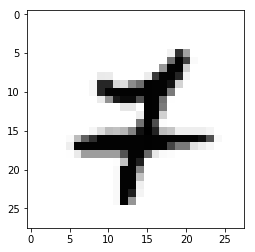

Pred value: 4
True value: 7


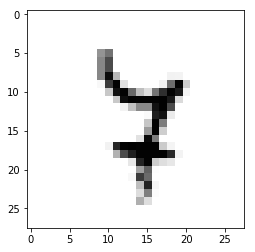

Pred value: 5
True value: 9


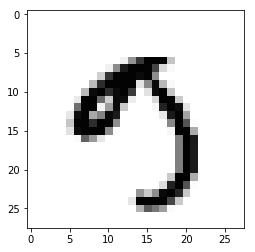

Pred value: 8
True value: 6


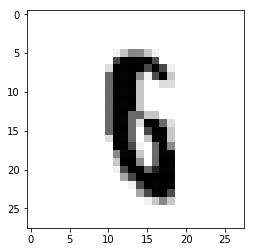

Pred value: 8
True value: 9


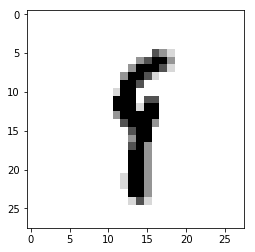

Pred value: 8
True value: 6


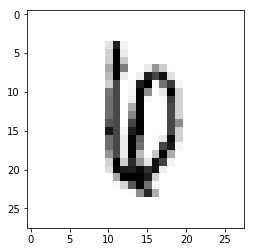

Pred value: 2
True value: 1


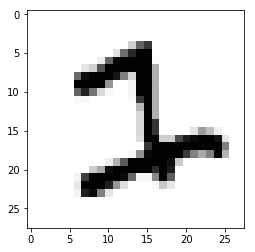

Pred value: 8
True value: 2


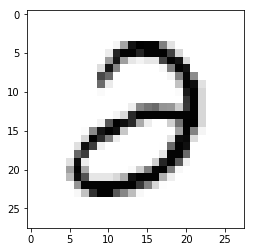

Pred value: 7
True value: 2


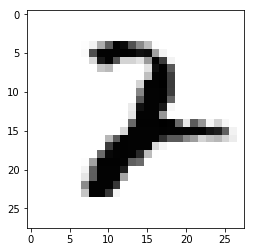

Pred value: 8
True value: 5


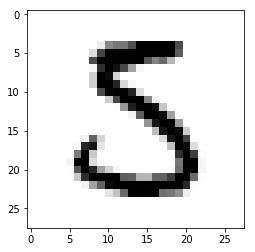

Pred value: 0
True value: 6


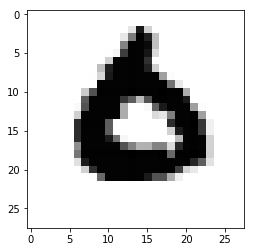

Pred value: 4
True value: 6


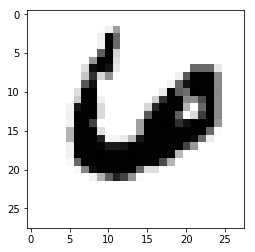

Pred value: 4
True value: 6


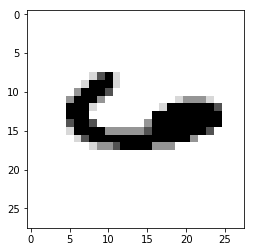

Pred value: 8
True value: 5


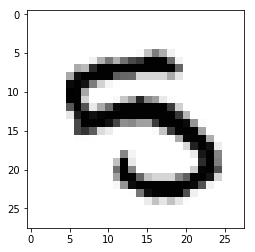

Pred value: 7
True value: 2


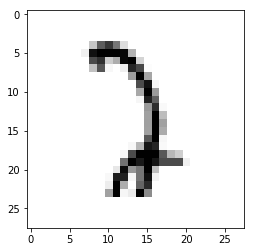

Pred value: 8
True value: 5


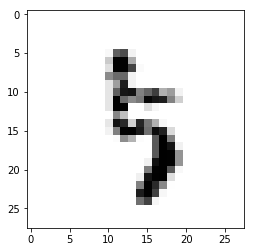

Pred value: 8
True value: 6


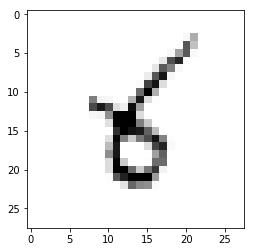

Pred value: 2
True value: 7


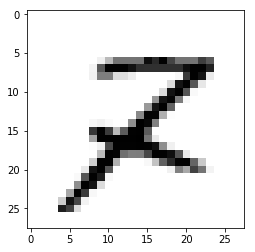

Pred value: 2
True value: 7


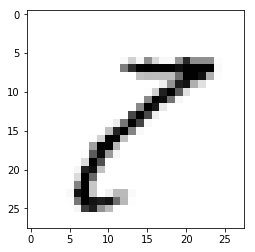

Pred value: 4
True value: 7


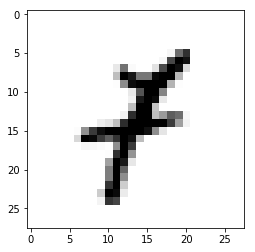

Pred value: 0
True value: 6


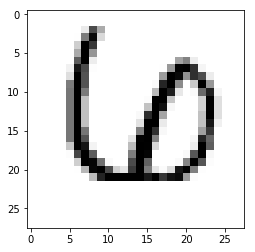

Pred value: 8
True value: 5


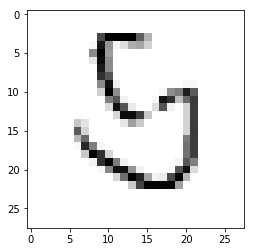

Pred value: 3
True value: 1


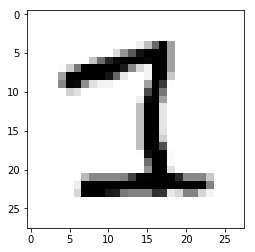

Pred value: 8
True value: 9


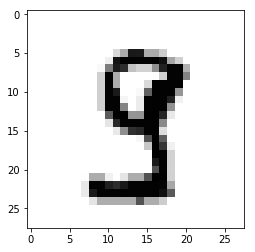

Pred value: 4
True value: 9


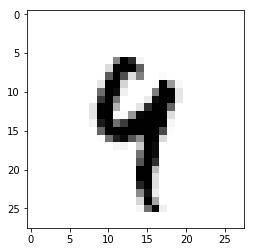

Pred value: 9
True value: 7


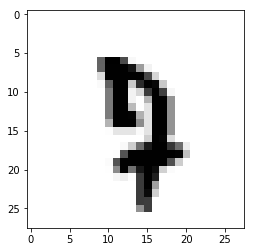

Pred value: 2
True value: 0


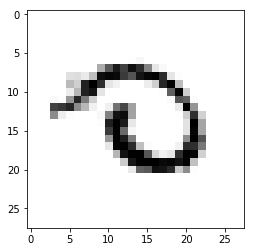

Pred value: 8
True value: 9


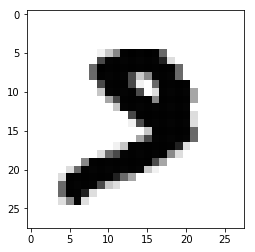

Pred value: 8
True value: 9


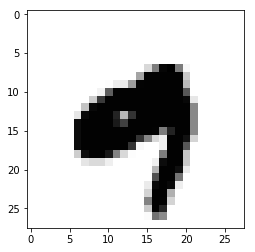

Pred value: 7
True value: 2


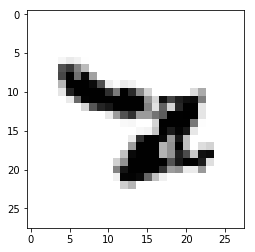

Pred value: 9
True value: 7


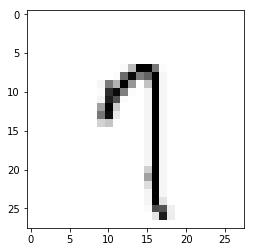

Pred value: 7
True value: 1


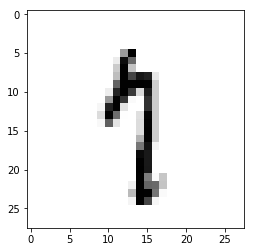

Pred value: 7
True value: 9


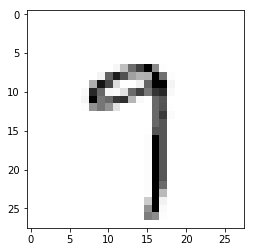

Pred value: 3
True value: 5


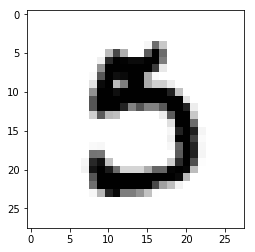

Pred value: 2
True value: 3


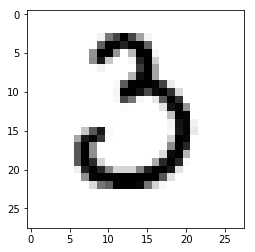

Pred value: 8
True value: 5


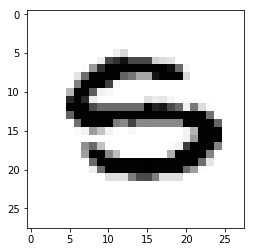

Pred value: 2
True value: 7


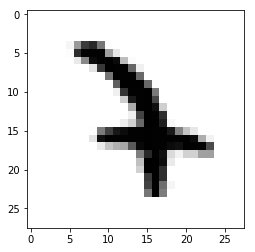

Pred value: 0
True value: 6


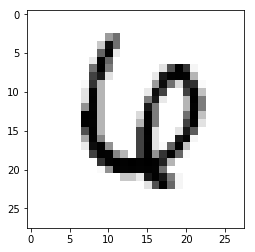

Pred value: 3
True value: 9


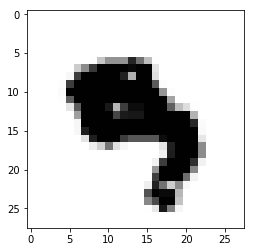

Pred value: 7
True value: 1


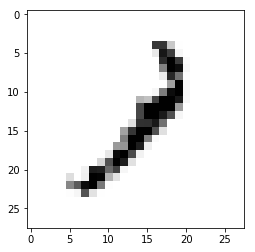

Pred value: 4
True value: 6


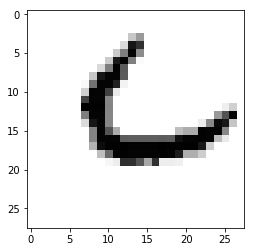

Pred value: 0
True value: 6


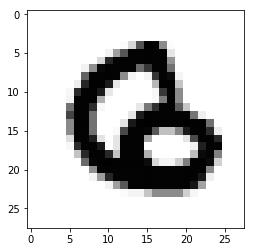

Pred value: 2
True value: 4


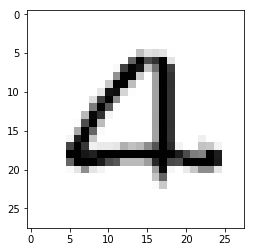

Pred value: 2
True value: 8


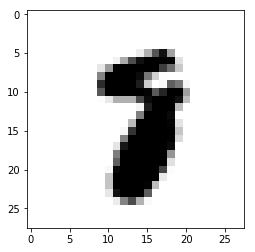

Pred value: 8
True value: 9


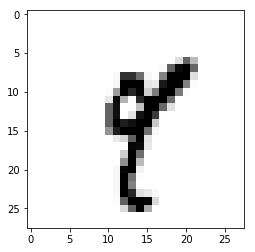

Pred value: 0
True value: 6


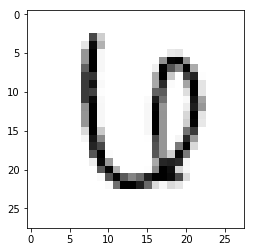

Pred value: 0
True value: 9


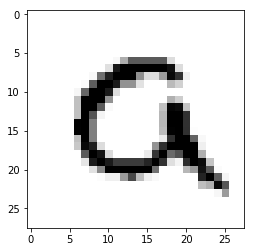

Pred value: 4
True value: 2


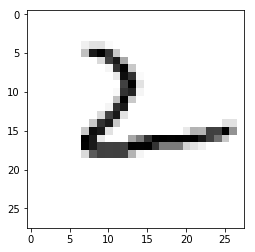

Pred value: 4
True value: 6


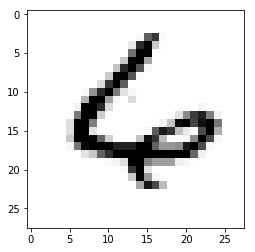

Pred value: 8
True value: 9


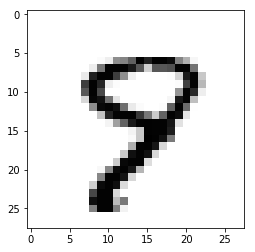

Pred value: 0
True value: 1


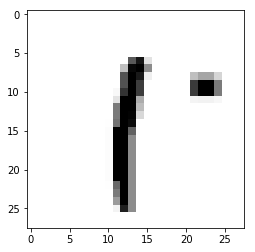

Pred value: 2
True value: 7


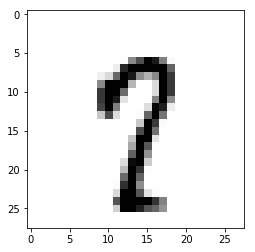

Pred value: 2
True value: 7


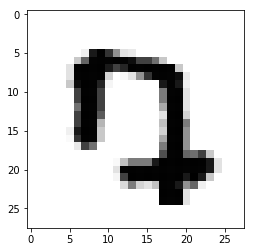

Pred value: 3
True value: 5


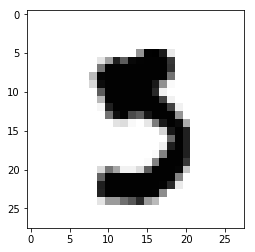

Pred value: 8
True value: 3


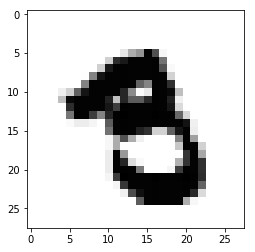

Pred value: 3
True value: 5


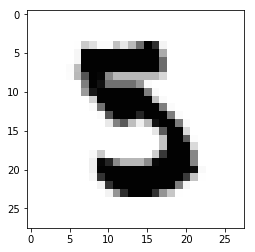

Pred value: 8
True value: 5


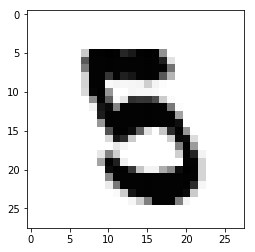

Pred value: 8
True value: 5


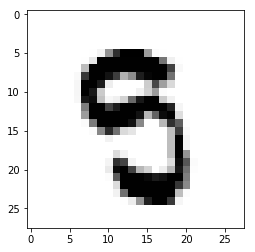

Pred value: 8
True value: 5


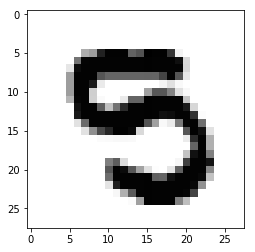

Pred value: 8
True value: 3


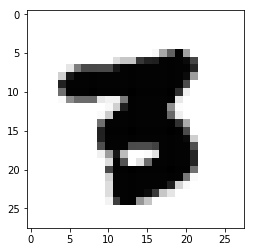

Pred value: 8
True value: 9


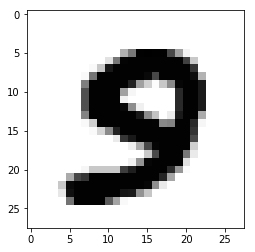

Pred value: 5
True value: 9


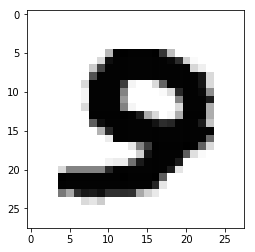

Pred value: 8
True value: 9


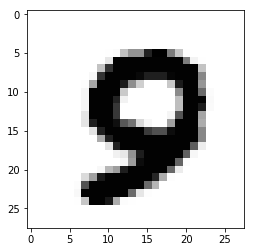

Pred value: 8
True value: 9


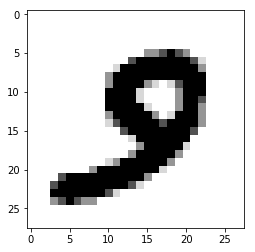

Pred value: 5
True value: 9


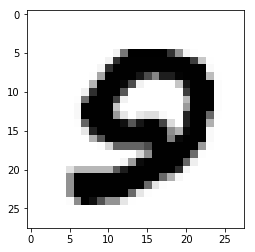

Pred value: 0
True value: 6


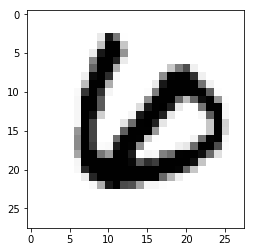

Pred value: 0
True value: 9


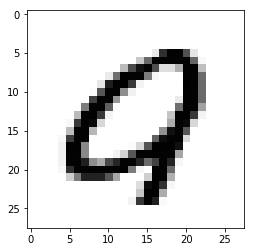

Pred value: 1
True value: 7


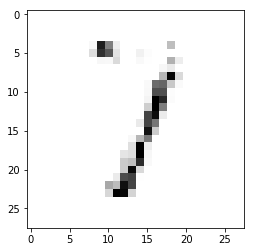

Pred value: 7
True value: 0


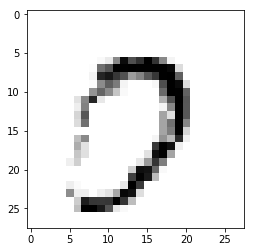

Pred value: 7
True value: 8


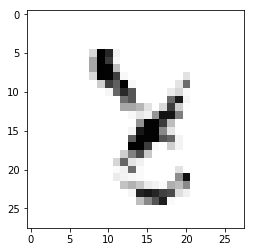

Pred value: 8
True value: 0


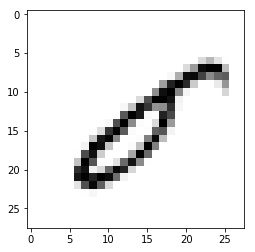

Pred value: 8
True value: 9


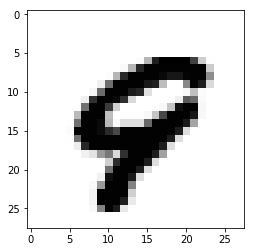

Pred value: 4
True value: 6


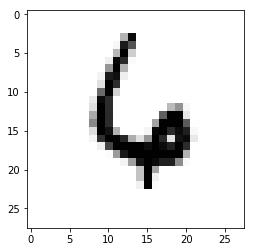

Pred value: 8
True value: 0


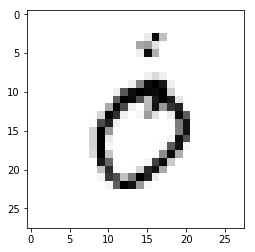

Pred value: 8
True value: 4


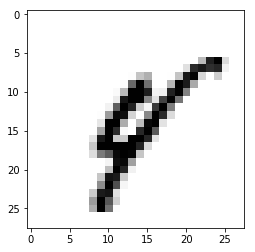

Pred value: 8
True value: 1


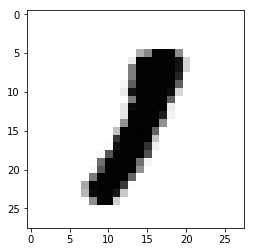

Pred value: 8
True value: 1


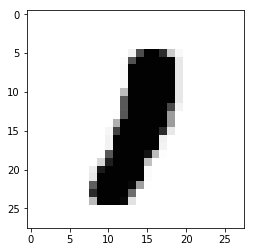

Pred value: 8
True value: 1


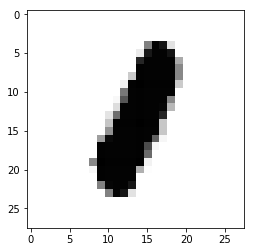

Pred value: 8
True value: 5


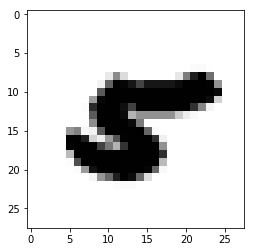

Pred value: 8
True value: 1


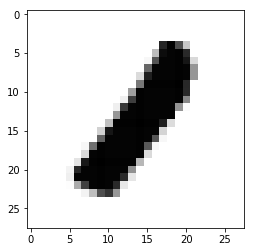

Pred value: 8
True value: 5


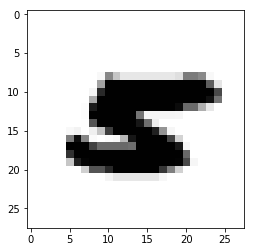

Pred value: 8
True value: 1


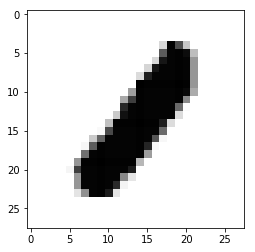

Pred value: 8
True value: 1


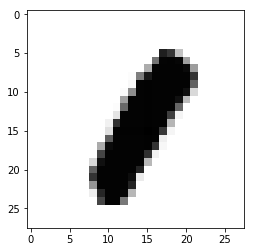

Pred value: 8
True value: 1


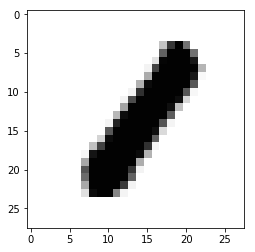

Pred value: 8
True value: 1


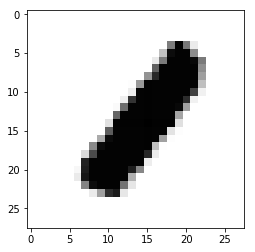

Pred value: 2
True value: 7


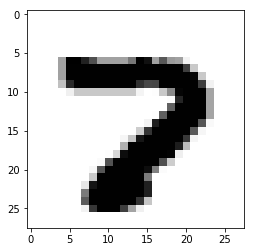

Pred value: 8
True value: 1


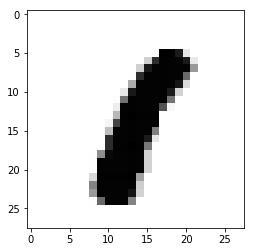

Pred value: 9
True value: 4


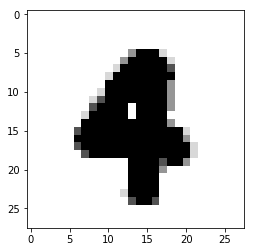

Pred value: 9
True value: 4


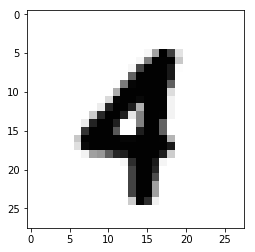

Pred value: 9
True value: 4


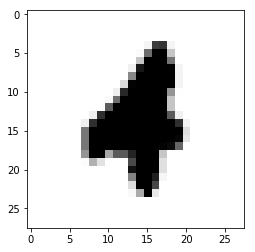

Pred value: 8
True value: 2


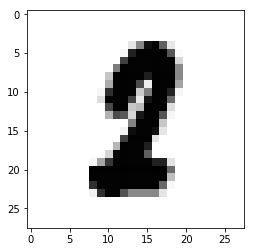

Pred value: 8
True value: 4


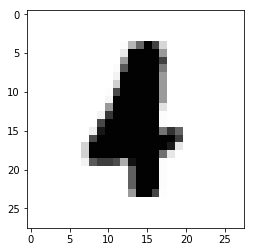

Pred value: 8
True value: 4


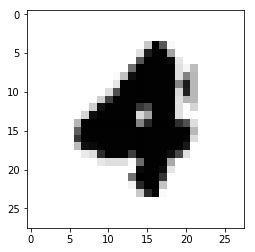

Pred value: 8
True value: 9


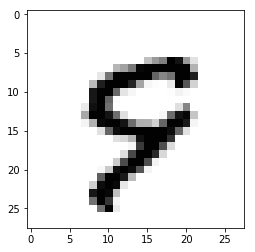

Pred value: 8
True value: 9


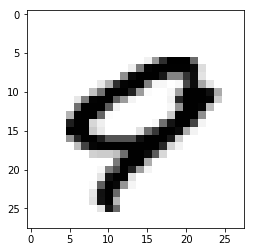

Pred value: 2
True value: 7


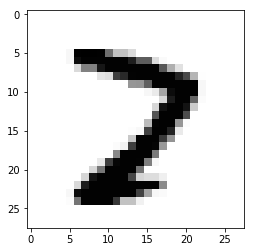

Pred value: 4
True value: 6


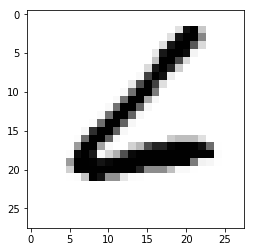

Pred value: 6
True value: 8


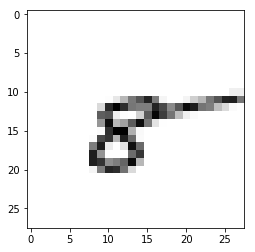

Pred value: 9
True value: 4


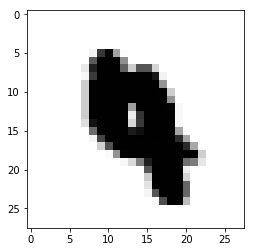

Pred value: 2
True value: 7


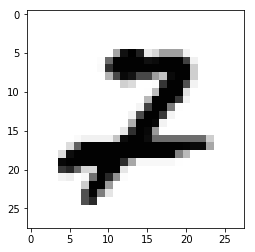

Pred value: 8
True value: 1


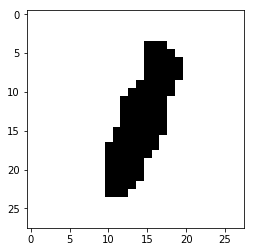

Pred value: 8
True value: 1


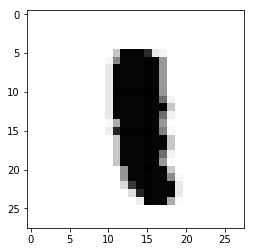

Pred value: 0
True value: 2


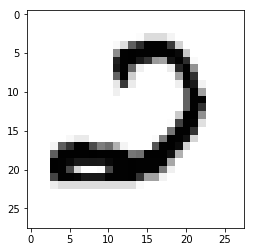

Pred value: 8
True value: 9


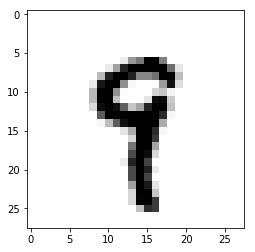

Pred value: 8
True value: 9


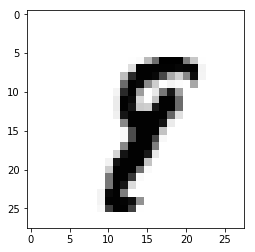

Pred value: 7
True value: 9


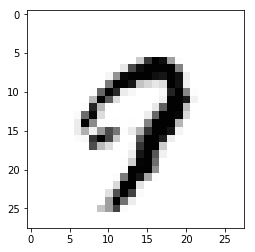

Pred value: 7
True value: 9


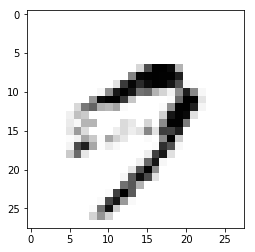

Pred value: 3
True value: 6


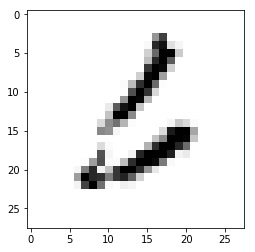

Pred value: 6
True value: 5


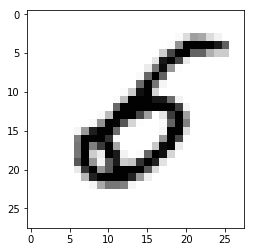

Pred value: 6
True value: 5


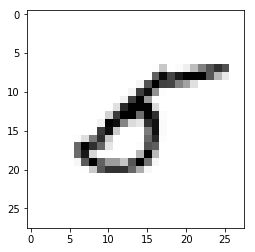

Pred value: 0
True value: 5


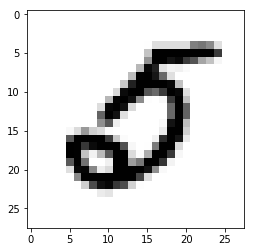

Pred value: 8
True value: 2


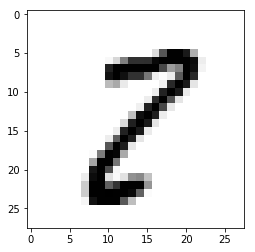

Pred value: 8
True value: 6


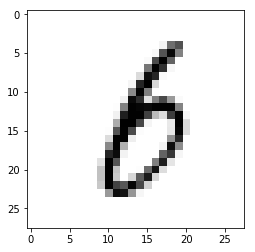

Pred value: 4
True value: 6


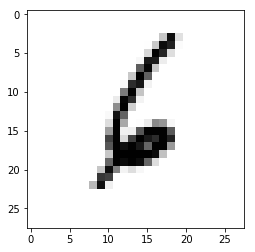

Pred value: 8
True value: 5


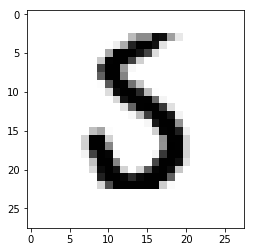

In [0]:
# Loading dataset
(train_x, y_train), (test_x, y_test) = tf.keras.datasets.mnist.load_data()
# Reshaping the array to 4-dims so that it can work with the Keras API
x_train = train_x.reshape(train_x.shape[0], 28, 28, 1)
x_test = test_x.reshape(test_x.shape[0], 28, 28, 1)
input_shape = (28, 28, 1)
# Making sure that the values are float so that we can get decimal points after division
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
# Normalizing the RGB codes by dividing it to the max RGB value.
#x_train /= 255
#x_test /= 255
print('x_train shape:', x_train.shape)
print('Number of images in x_train', x_train.shape[0])
print('Number of images in x_test', x_test.shape[0])
# Creating a Sequential Model and adding the layers
model = Sequential()
#model.add(Conv2D(28, kernel_size=(5,5), input_shape=input_shape))
#model.add(MaxPooling2D(pool_size=(2, 2)))
#model.add(Conv2D(28, kernel_size=(3,3), input_shape=input_shape))
#model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(28, kernel_size=(5,1)))
model.add(Conv2D(28, kernel_size=(1,5)))
model.add(MaxPooling2D(pool_size=(4, 4)))
model.add(Conv2D(28, kernel_size=(3,1)))
model.add(Conv2D(28, kernel_size=(1,3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten()) # Flattening the 2D arrays for fully connected layers
model.add(Dense(128, activation=tf.nn.relu))
model.add(Dropout(0.5))      
model.add(Dense(10,activation=tf.nn.softmax))
model.compile(optimizer='adam', 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)
his = model.fit(x=x_train,y=y_train, epochs=10)
_, train_acc = model.evaluate(x_train, y_train, verbose=0)
_, test_acc = model.evaluate(x_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
y_pred = model.predict(x_test)
print(y_pred.shape)
print(y_test.shape)
y = np.argmax(y_pred, axis=1)
print(y.shape)
confusion_matrix(y_test, y)
for i in range(10000):
    if(y[i] != y_test[i]):
        print("Pred value:",y[i])
        print("True value:",y_test[i])
        plt.figure
        plt.imshow(x_test[i].reshape(28, 28),cmap='Greys')
        plt.show()

x_train shape: (60000, 28, 28, 1)
Number of images in x_train 60000
Number of images in x_test 10000
Epoch 1/10
60000/60000 [==============================] - 65s 1ms/step - loss: 2.4294 - acc: 0.8281
Epoch 2/10
60000/60000 [==============================] - 66s 1ms/step - loss: 0.9517 - acc: 0.9330
Epoch 3/10
60000/60000 [==============================] - 66s 1ms/step - loss: 1.0064 - acc: 0.9332
Epoch 4/10
60000/60000 [==============================] - 69s 1ms/step - loss: 1.0837 - acc: 0.9306
Epoch 5/10
60000/60000 [==============================] - 68s 1ms/step - loss: 1.1893 - acc: 0.9246
Epoch 6/10
60000/60000 [==============================] - 68s 1ms/step - loss: 1.1683 - acc: 0.9267
Epoch 7/10
60000/60000 [==============================] - 68s 1ms/step - loss: 1.3761 - acc: 0.9139
Epoch 8/10
60000/60000 [==============================] - 70s 1ms/step - loss: 1.4899 - acc: 0.9070
Epoch 9/10
60000/60000 [==============================] - 69s 1ms/step - loss: 1.4390 - acc: 0.9103

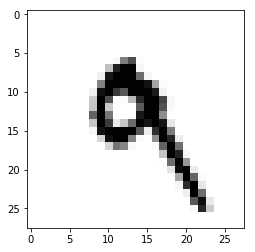

Pred value: 3
True value: 5


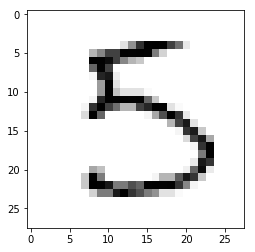

Pred value: 8
True value: 1


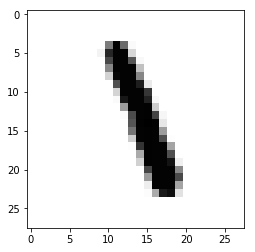

Pred value: 5
True value: 9


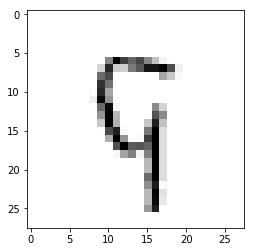

Pred value: 8
True value: 9


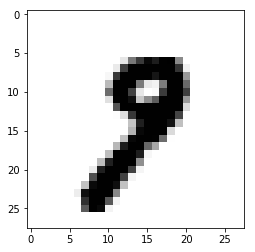

Pred value: 5
True value: 9


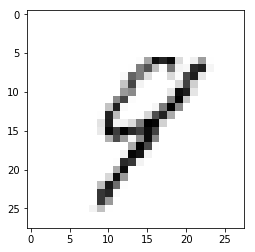

Pred value: 7
True value: 1


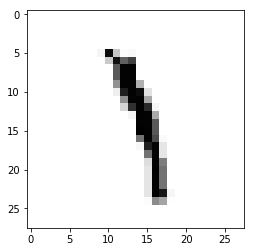

Pred value: 2
True value: 6


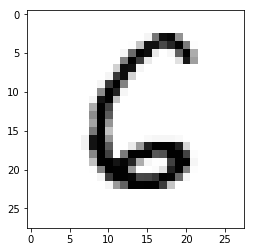

Pred value: 5
True value: 9


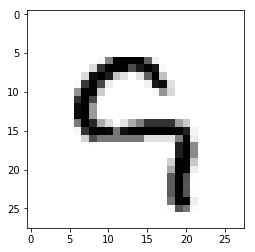

Pred value: 3
True value: 7


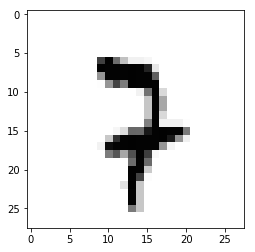

Pred value: 9
True value: 4


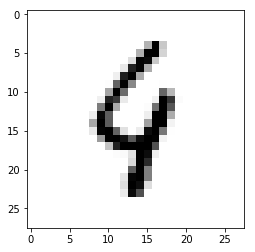

Pred value: 2
True value: 7


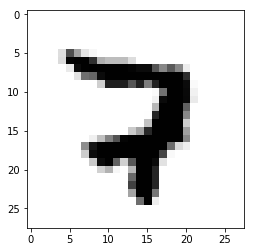

Pred value: 2
True value: 7


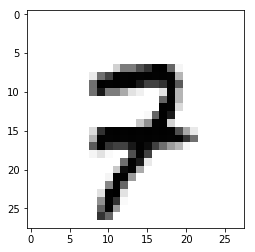

Pred value: 3
True value: 9


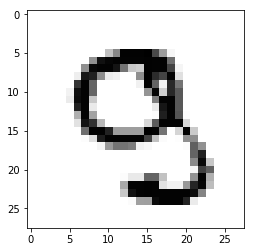

Pred value: 5
True value: 4


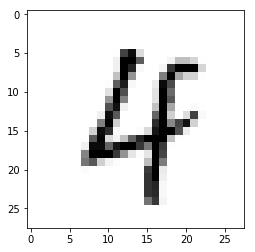

Pred value: 8
True value: 7


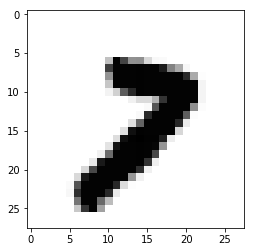

Pred value: 5
True value: 6


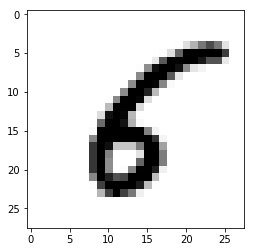

Pred value: 3
True value: 9


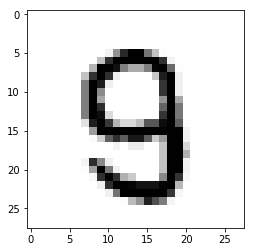

Pred value: 2
True value: 4


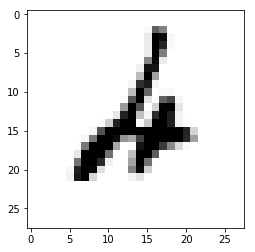

Pred value: 0
True value: 6


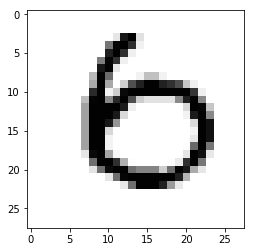

Pred value: 2
True value: 7


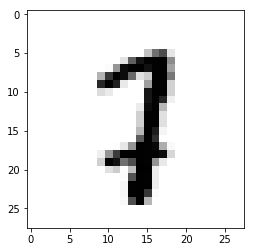

Pred value: 5
True value: 8


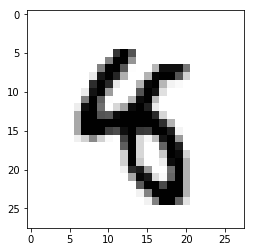

Pred value: 3
True value: 7


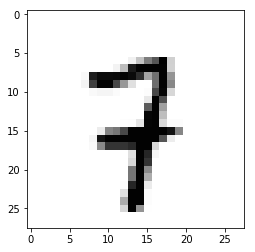

Pred value: 8
True value: 9


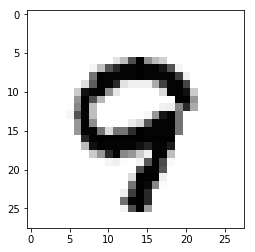

Pred value: 5
True value: 6


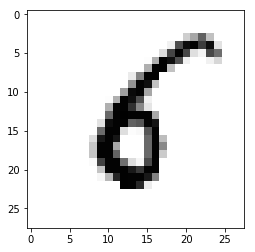

Pred value: 8
True value: 9


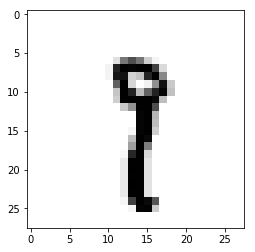

Pred value: 8
True value: 2


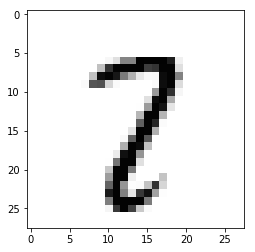

Pred value: 5
True value: 0


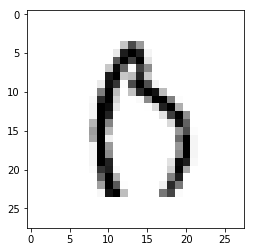

Pred value: 5
True value: 6


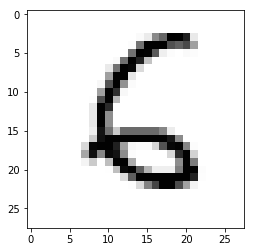

Pred value: 3
True value: 5


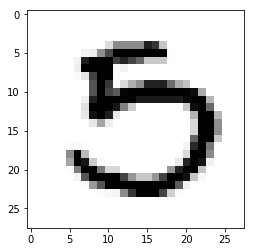

Pred value: 4
True value: 1


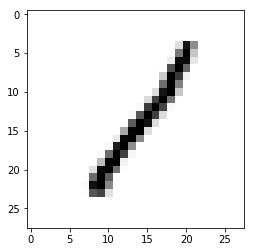

Pred value: 2
True value: 3


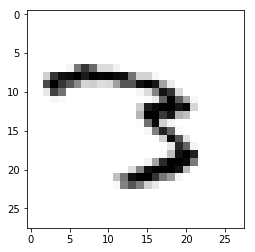

Pred value: 5
True value: 6


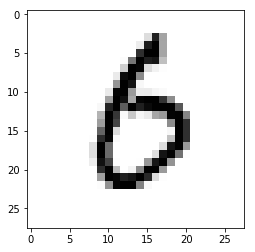

Pred value: 5
True value: 1


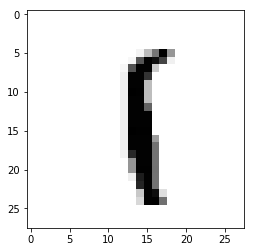

Pred value: 5
True value: 6


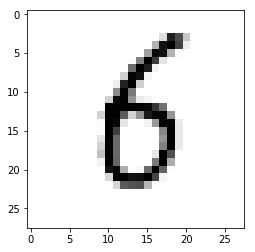

Pred value: 8
True value: 2


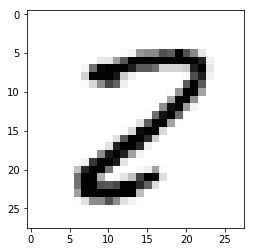

Pred value: 5
True value: 6


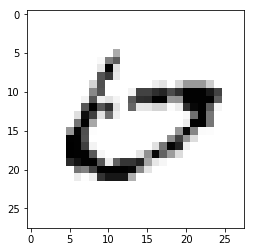

Pred value: 5
True value: 6


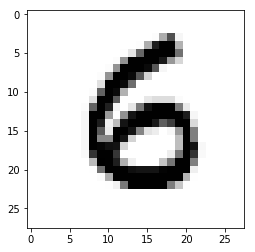

Pred value: 3
True value: 9


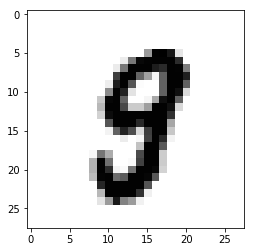

Pred value: 5
True value: 6


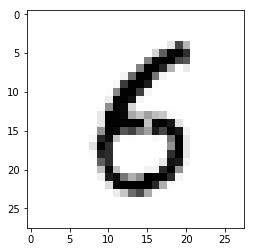

Pred value: 8
True value: 7


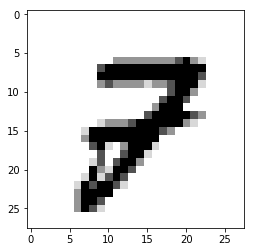

Pred value: 3
True value: 9


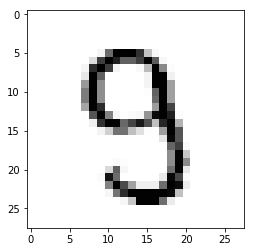

Pred value: 2
True value: 0


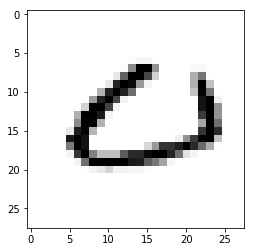

Pred value: 8
True value: 4


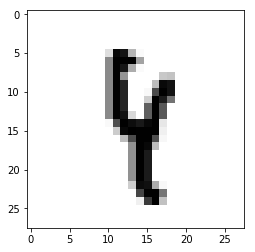

Pred value: 8
True value: 3


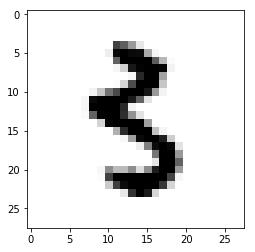

Pred value: 5
True value: 6


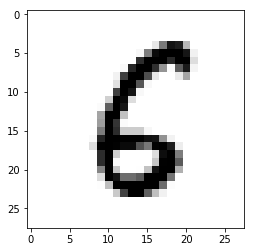

Pred value: 8
True value: 7


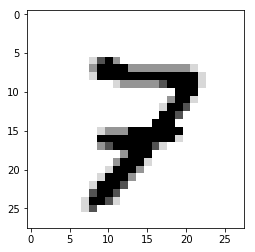

Pred value: 8
True value: 4


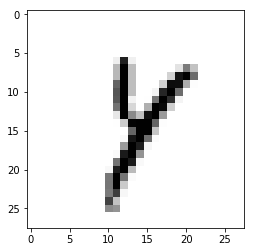

Pred value: 3
True value: 7


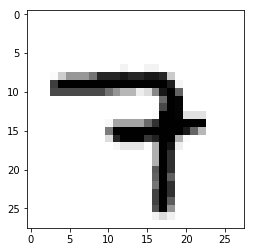

Pred value: 4
True value: 1


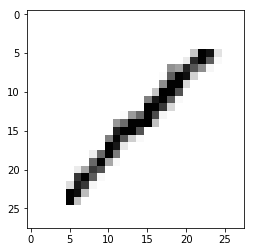

Pred value: 8
True value: 2


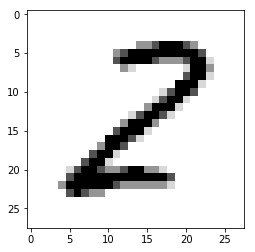

Pred value: 8
True value: 7


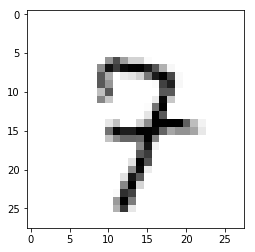

Pred value: 2
True value: 7


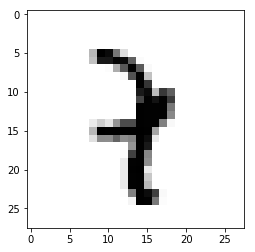

Pred value: 5
True value: 0


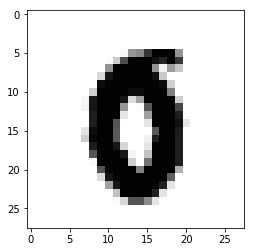

Pred value: 4
True value: 6


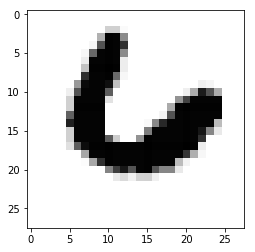

Pred value: 5
True value: 0


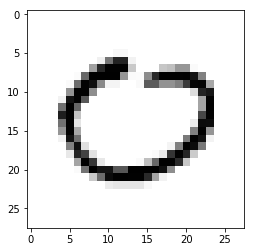

Pred value: 9
True value: 4


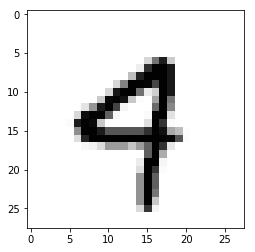

Pred value: 2
True value: 8


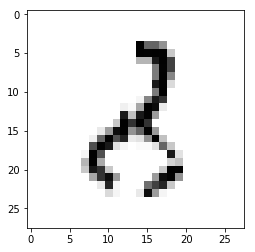

Pred value: 8
True value: 9


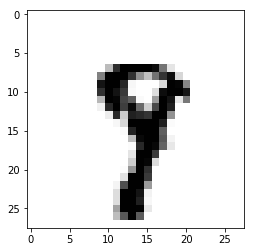

Pred value: 5
True value: 0


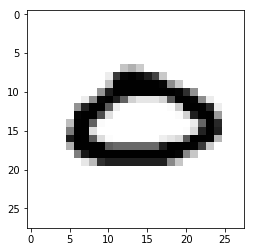

Pred value: 8
True value: 7


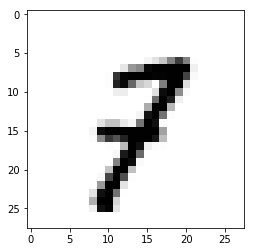

Pred value: 8
True value: 2


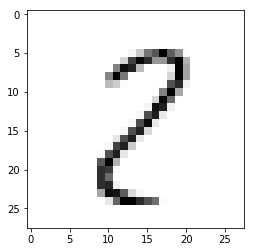

Pred value: 2
True value: 1


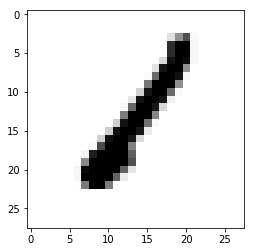

Pred value: 8
True value: 1


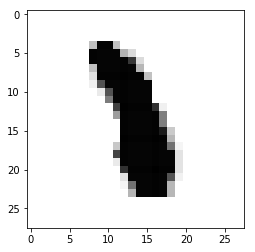

Pred value: 2
True value: 6


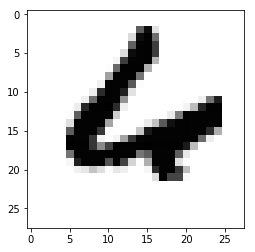

Pred value: 5
True value: 0


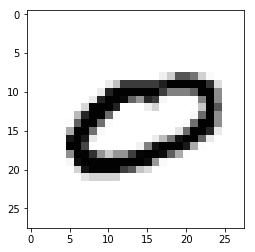

Pred value: 7
True value: 2


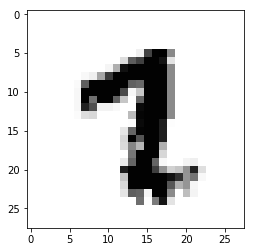

Pred value: 3
True value: 5


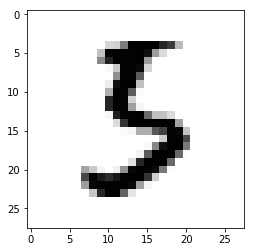

Pred value: 3
True value: 7


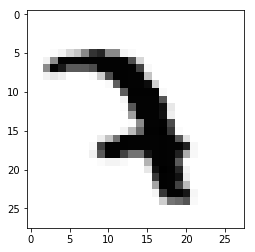

Pred value: 5
True value: 6


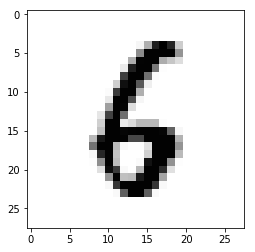

Pred value: 9
True value: 7


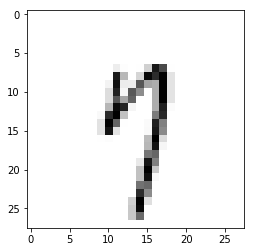

Pred value: 7
True value: 1


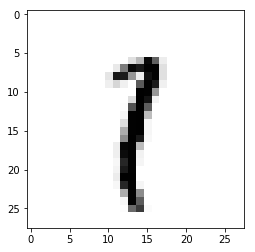

Pred value: 2
True value: 0


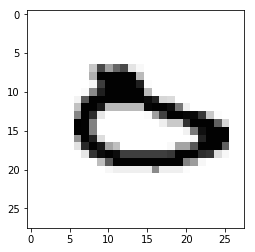

Pred value: 8
True value: 5


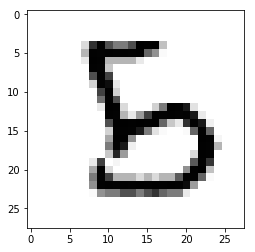

Pred value: 5
True value: 7


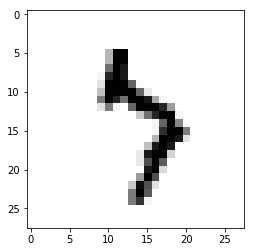

Pred value: 8
True value: 2


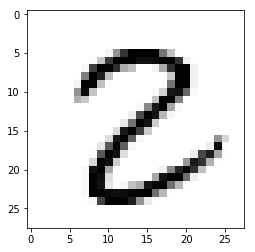

Pred value: 9
True value: 4


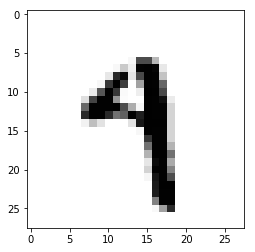

Pred value: 8
True value: 6


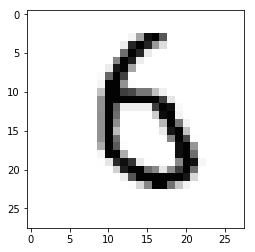

Pred value: 2
True value: 3


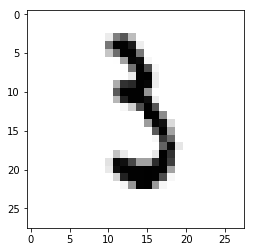

Pred value: 2
True value: 7


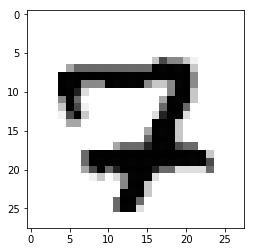

Pred value: 8
True value: 9


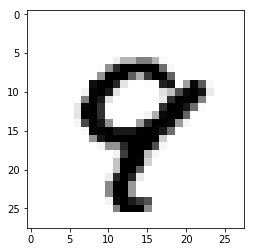

Pred value: 8
True value: 4


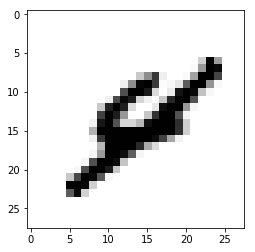

Pred value: 0
True value: 7


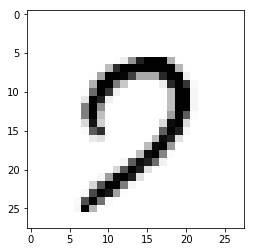

Pred value: 8
True value: 7


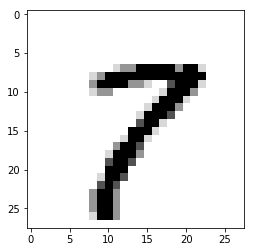

Pred value: 5
True value: 6


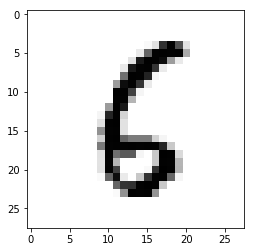

Pred value: 8
True value: 9


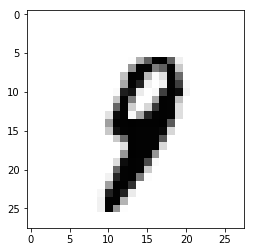

Pred value: 2
True value: 0


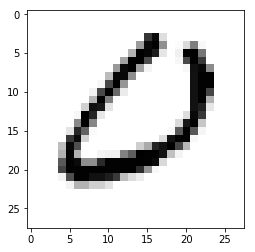

Pred value: 3
True value: 7


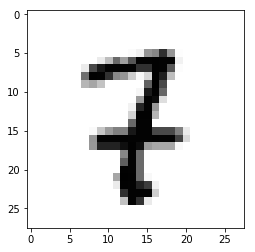

Pred value: 5
True value: 1


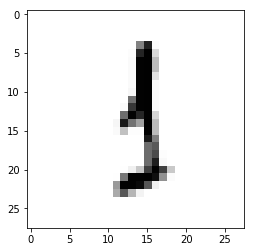

Pred value: 7
True value: 4


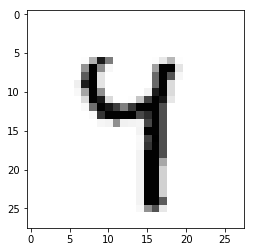

Pred value: 5
True value: 3


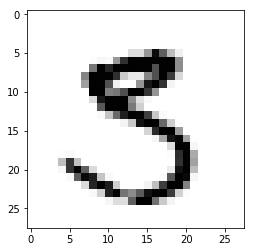

Pred value: 5
True value: 6


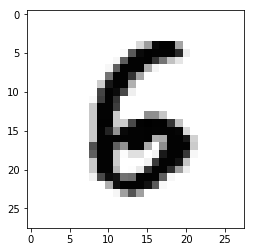

Pred value: 5
True value: 6


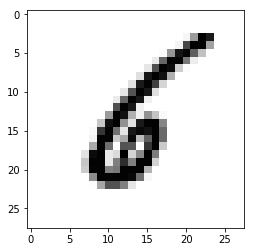

Pred value: 2
True value: 7


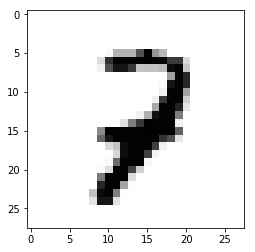

Pred value: 2
True value: 1


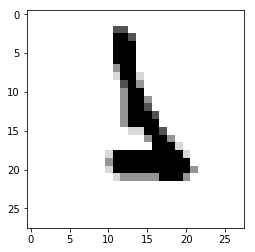

Pred value: 5
True value: 6


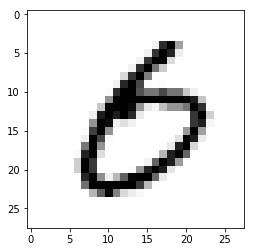

Pred value: 8
True value: 9


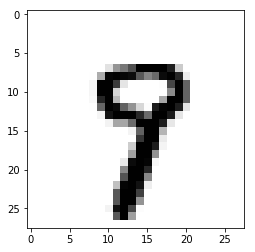

Pred value: 8
True value: 3


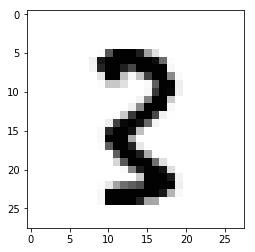

Pred value: 8
True value: 1


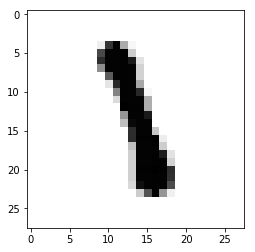

Pred value: 5
True value: 6


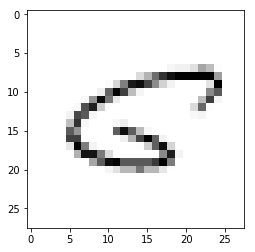

Pred value: 2
True value: 6


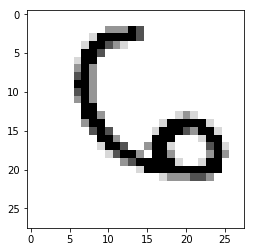

Pred value: 2
True value: 7


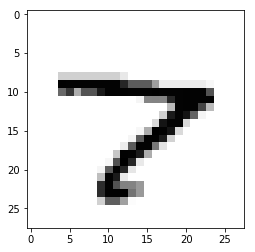

Pred value: 2
True value: 7


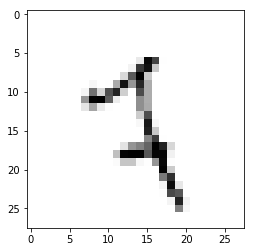

Pred value: 8
True value: 6


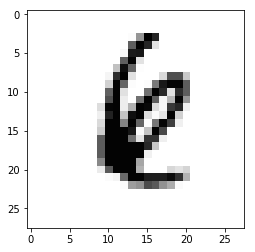

Pred value: 2
True value: 7


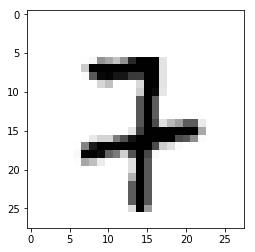

Pred value: 9
True value: 7


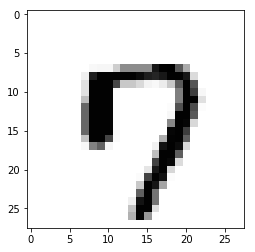

Pred value: 3
True value: 9


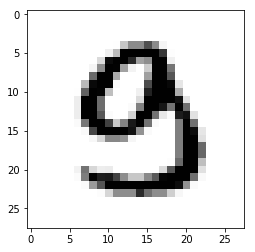

Pred value: 5
True value: 6


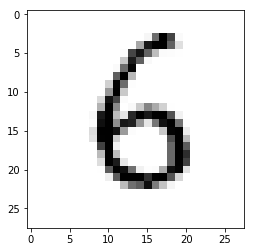

Pred value: 2
True value: 4


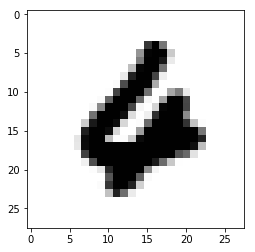

Pred value: 8
True value: 3


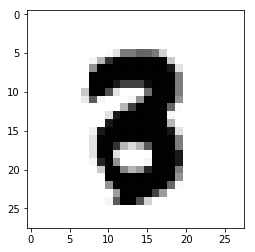

Pred value: 8
True value: 7


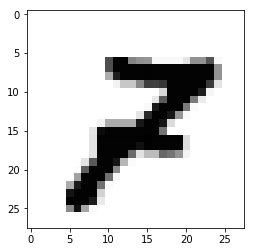

Pred value: 8
True value: 7


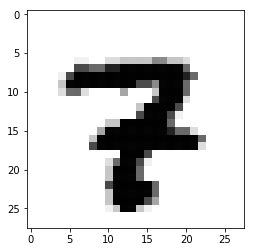

Pred value: 5
True value: 6


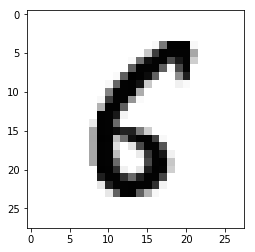

Pred value: 5
True value: 6


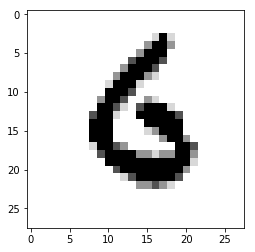

Pred value: 8
True value: 3


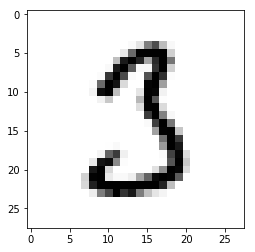

Pred value: 8
True value: 4


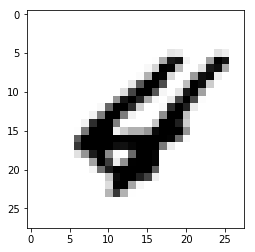

Pred value: 8
True value: 6


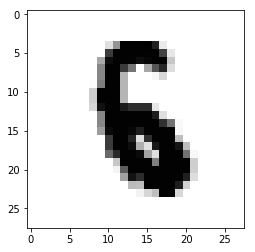

Pred value: 5
True value: 0


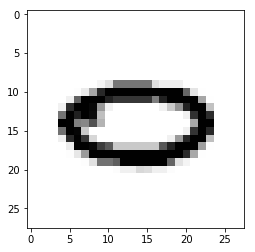

Pred value: 7
True value: 9


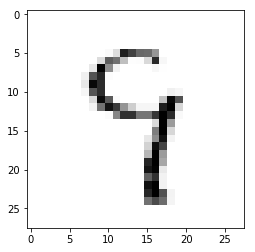

Pred value: 8
True value: 7


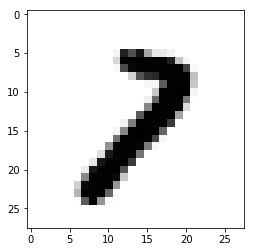

Pred value: 5
True value: 6


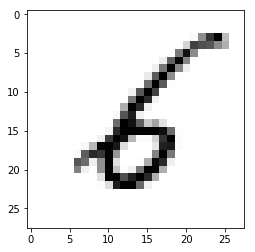

Pred value: 3
True value: 9


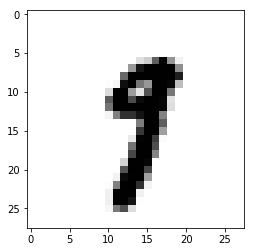

Pred value: 2
True value: 7


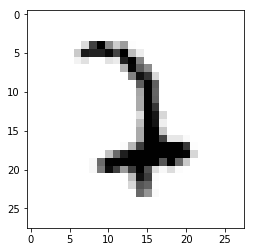

Pred value: 3
True value: 9


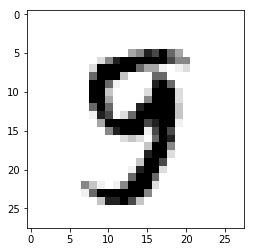

Pred value: 8
True value: 9


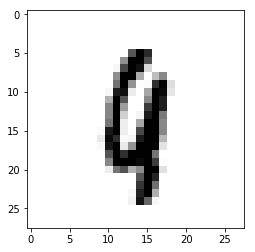

Pred value: 3
True value: 9


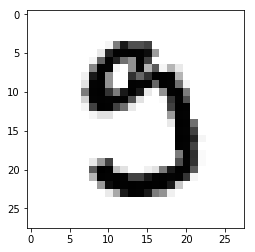

Pred value: 3
True value: 5


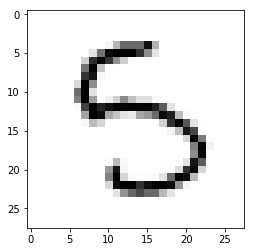

Pred value: 4
True value: 6


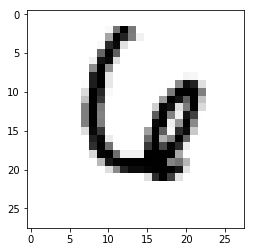

Pred value: 2
True value: 7


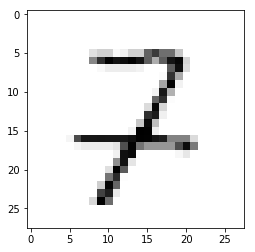

Pred value: 2
True value: 6


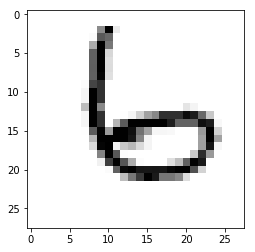

Pred value: 2
True value: 7


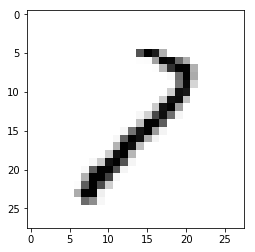

Pred value: 8
True value: 5


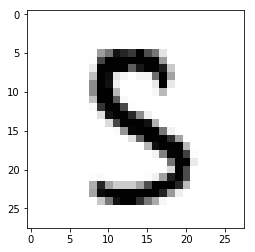

Pred value: 5
True value: 6


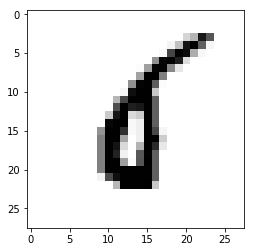

Pred value: 5
True value: 7


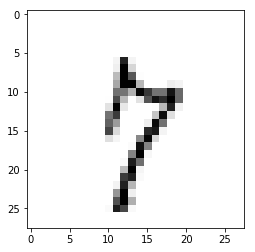

Pred value: 2
True value: 8


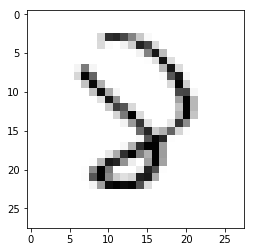

Pred value: 8
True value: 6


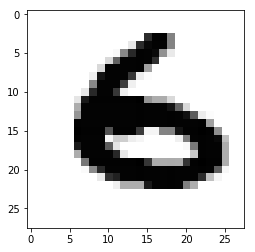

Pred value: 3
True value: 5


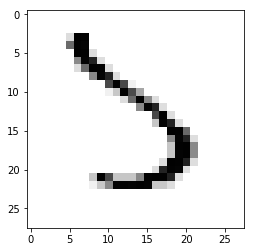

Pred value: 6
True value: 1


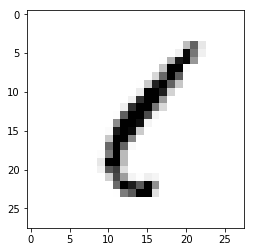

Pred value: 2
True value: 0


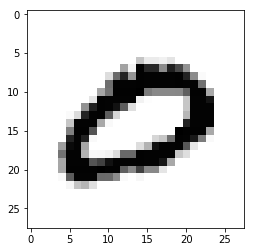

Pred value: 3
True value: 9


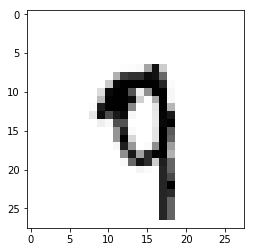

Pred value: 8
True value: 6


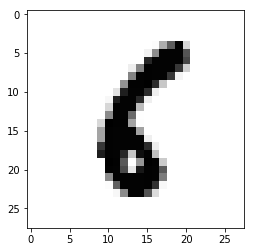

Pred value: 5
True value: 4


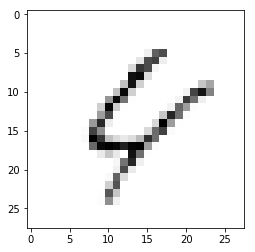

Pred value: 0
True value: 6


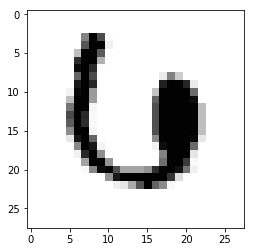

Pred value: 9
True value: 4


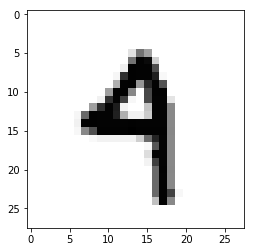

Pred value: 5
True value: 0


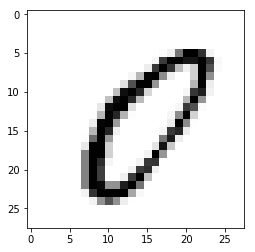

Pred value: 5
True value: 6


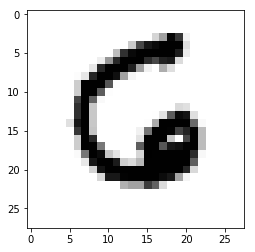

Pred value: 2
True value: 0


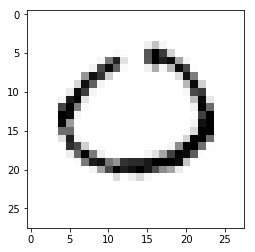

Pred value: 5
True value: 8


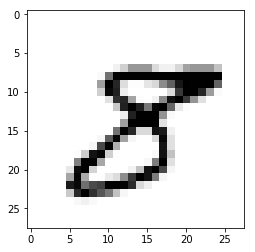

Pred value: 2
True value: 7


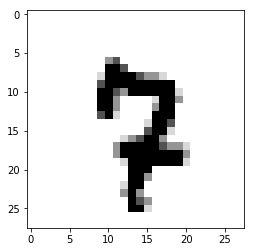

Pred value: 3
True value: 7


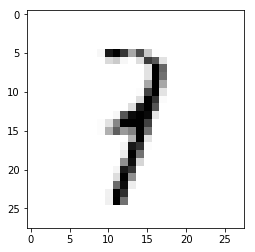

Pred value: 8
True value: 9


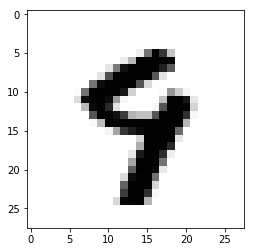

Pred value: 8
True value: 2


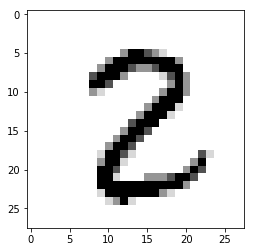

Pred value: 2
True value: 7


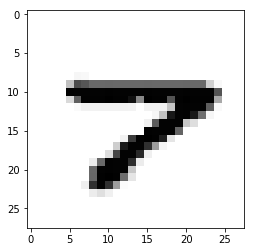

Pred value: 8
True value: 5


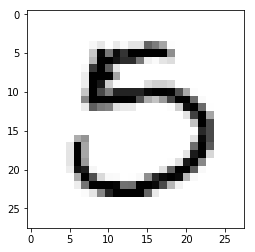

Pred value: 2
True value: 1


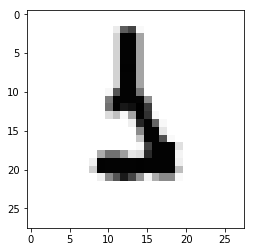

Pred value: 3
True value: 9


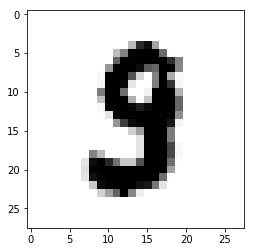

Pred value: 7
True value: 9


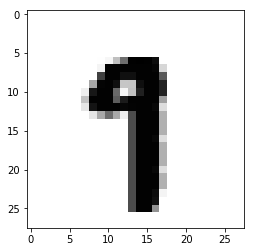

Pred value: 3
True value: 9


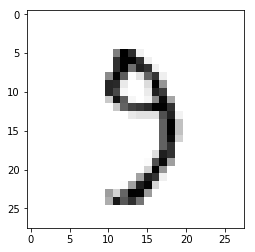

Pred value: 4
True value: 6


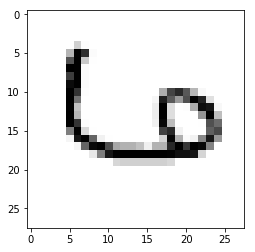

Pred value: 2
True value: 0


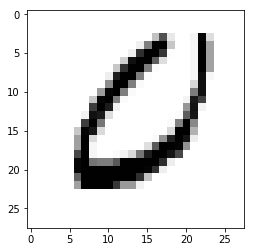

Pred value: 5
True value: 6


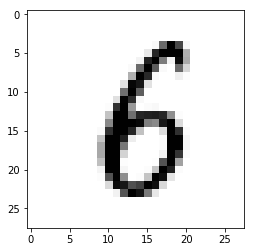

Pred value: 8
True value: 7


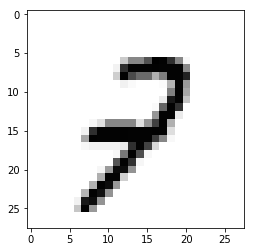

Pred value: 5
True value: 6


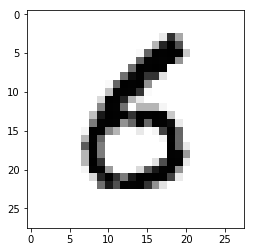

Pred value: 5
True value: 6


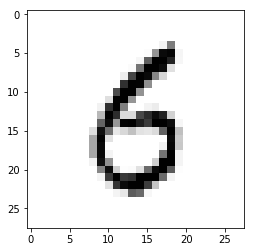

Pred value: 8
True value: 4


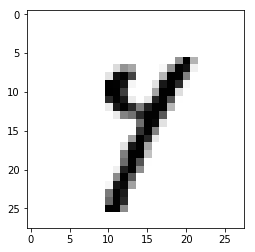

Pred value: 2
True value: 7


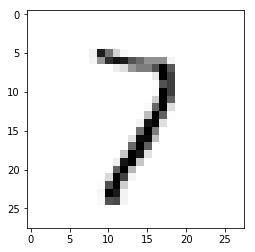

Pred value: 5
True value: 6


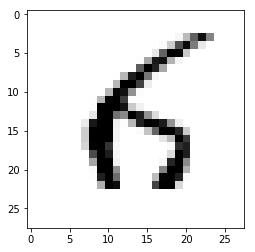

Pred value: 8
True value: 1


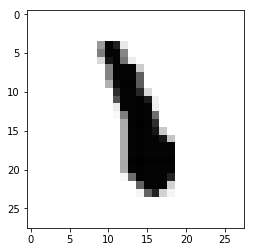

Pred value: 8
True value: 9


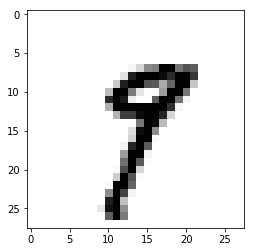

Pred value: 3
True value: 9


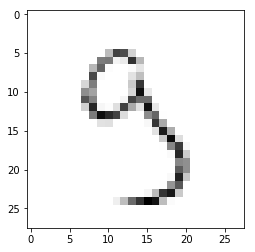

Pred value: 2
True value: 7


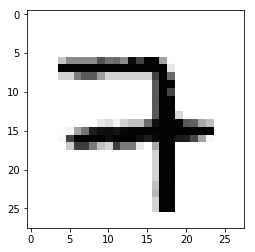

Pred value: 9
True value: 7


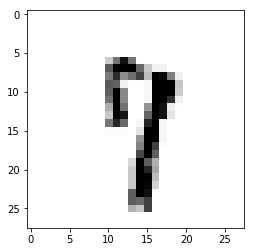

Pred value: 2
True value: 5


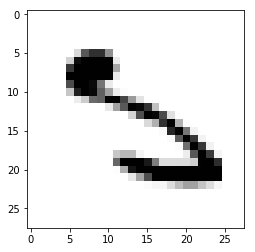

Pred value: 5
True value: 8


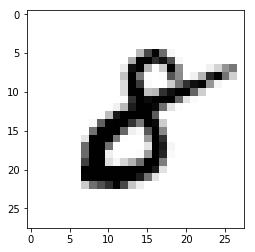

Pred value: 2
True value: 7


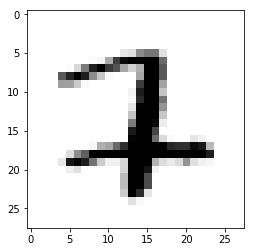

Pred value: 5
True value: 8


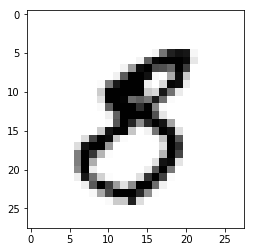

Pred value: 8
True value: 1


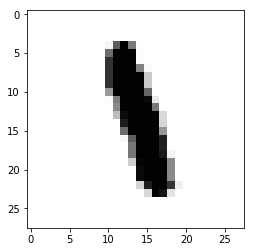

Pred value: 7
True value: 2


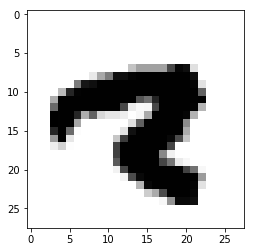

Pred value: 2
True value: 6


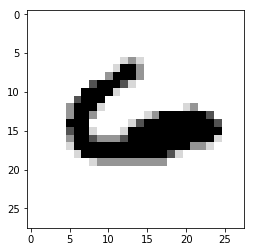

Pred value: 3
True value: 9


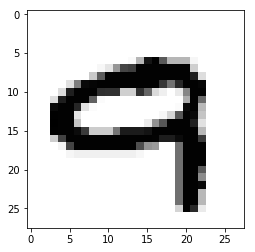

Pred value: 5
True value: 8


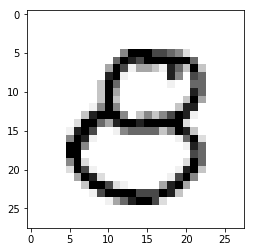

Pred value: 5
True value: 6


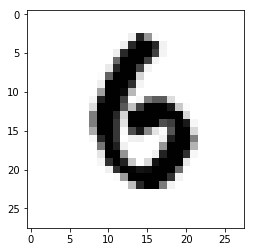

Pred value: 8
True value: 6


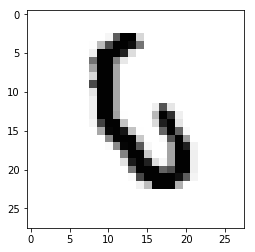

Pred value: 5
True value: 6


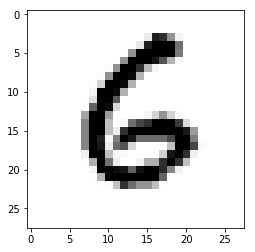

Pred value: 2
True value: 1


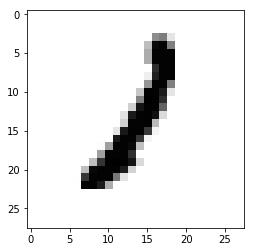

Pred value: 2
True value: 0


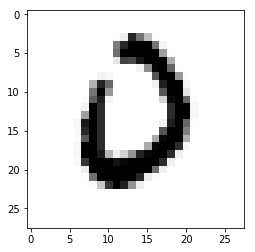

Pred value: 5
True value: 9


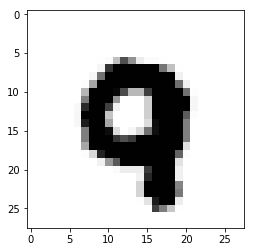

Pred value: 4
True value: 1


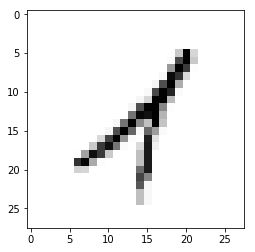

Pred value: 3
True value: 8


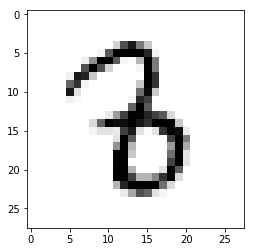

Pred value: 0
True value: 6


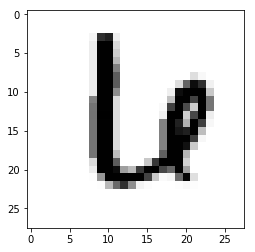

Pred value: 8
True value: 1


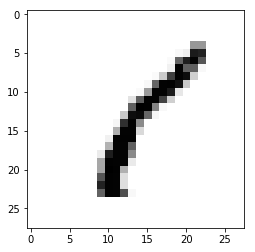

Pred value: 8
True value: 6


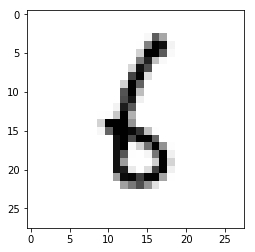

Pred value: 5
True value: 9


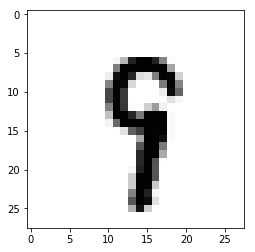

Pred value: 4
True value: 1


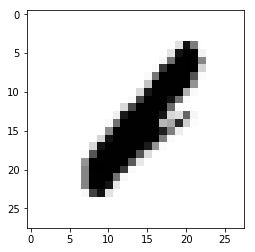

Pred value: 8
True value: 9


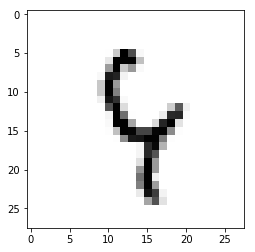

Pred value: 8
True value: 1


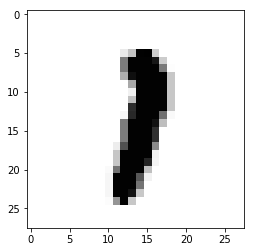

Pred value: 2
True value: 3


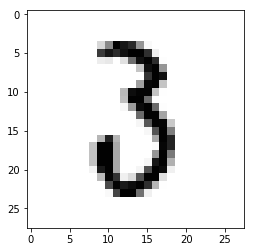

Pred value: 2
True value: 7


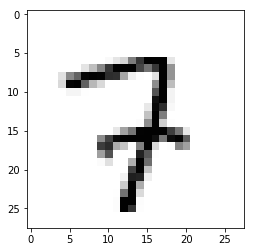

Pred value: 2
True value: 7


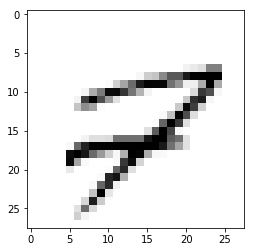

Pred value: 3
True value: 9


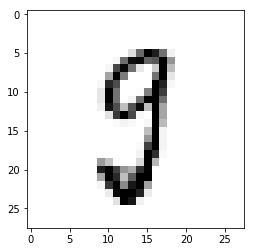

Pred value: 9
True value: 4


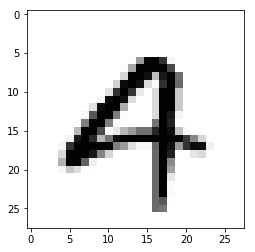

Pred value: 5
True value: 6


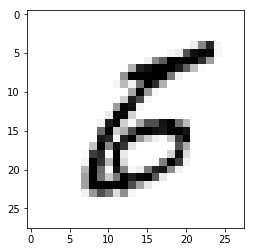

Pred value: 8
True value: 9


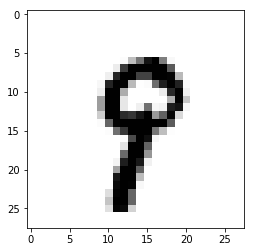

Pred value: 8
True value: 1


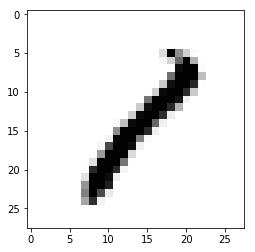

Pred value: 2
True value: 7


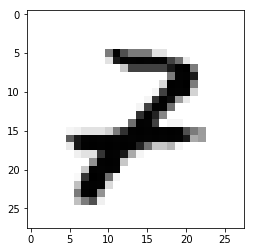

Pred value: 2
True value: 1


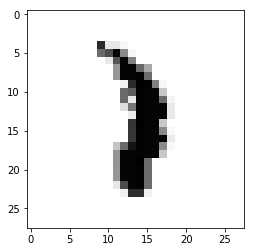

Pred value: 8
True value: 4


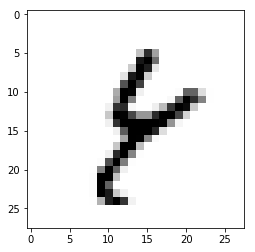

Pred value: 8
True value: 2


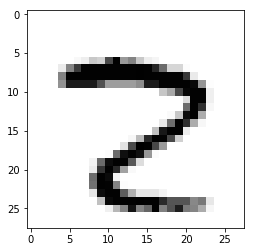

Pred value: 5
True value: 6


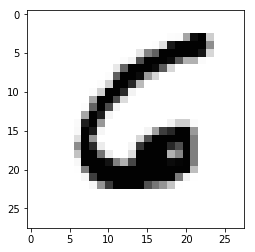

Pred value: 3
True value: 9


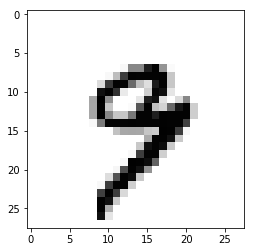

Pred value: 2
True value: 0


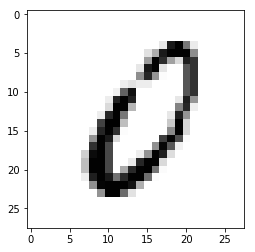

Pred value: 9
True value: 7


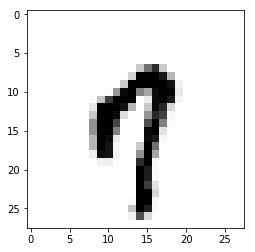

Pred value: 2
True value: 8


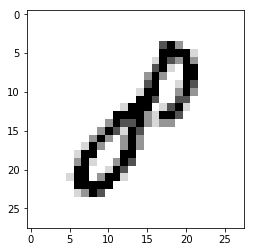

Pred value: 5
True value: 6


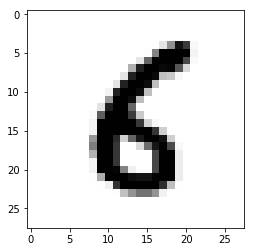

Pred value: 0
True value: 6


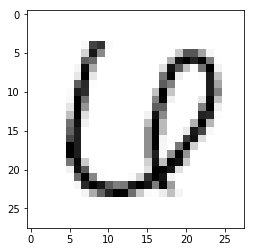

Pred value: 8
True value: 9


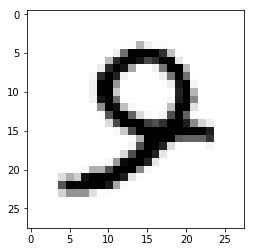

Pred value: 9
True value: 4


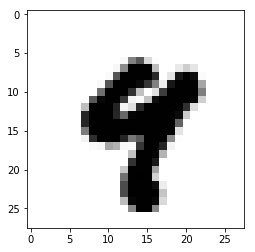

Pred value: 5
True value: 6


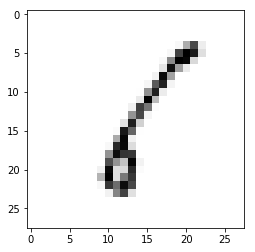

Pred value: 8
True value: 2


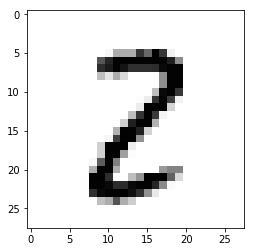

Pred value: 9
True value: 4


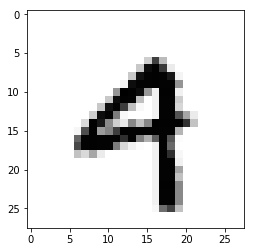

Pred value: 5
True value: 3


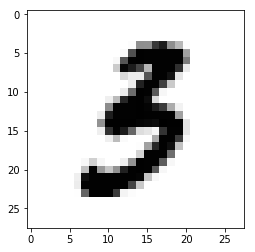

Pred value: 8
True value: 1


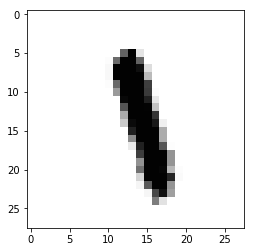

Pred value: 4
True value: 1


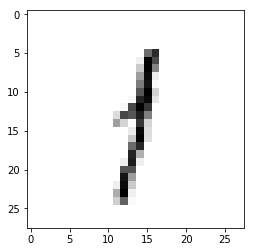

Pred value: 2
True value: 1


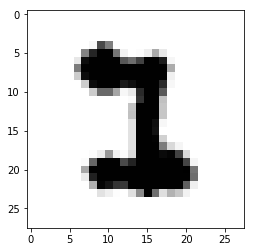

Pred value: 8
True value: 9


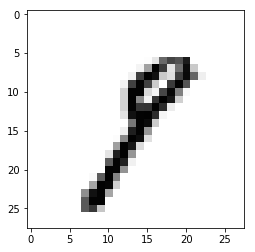

Pred value: 8
True value: 7


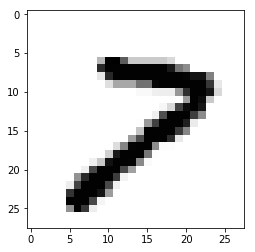

Pred value: 5
True value: 6


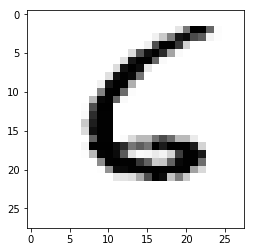

Pred value: 2
True value: 7


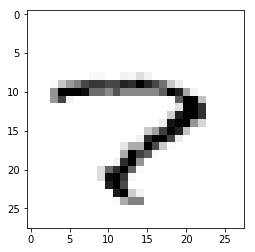

Pred value: 5
True value: 6


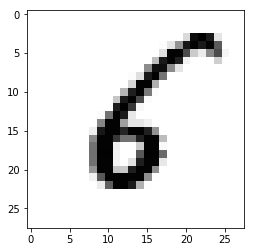

Pred value: 2
True value: 6


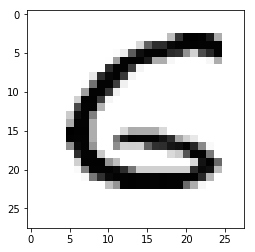

Pred value: 4
True value: 1


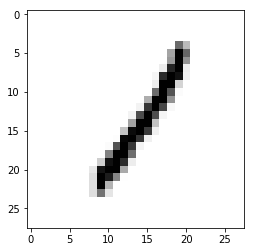

Pred value: 8
True value: 9


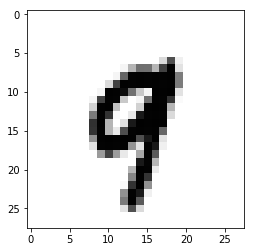

Pred value: 2
True value: 1


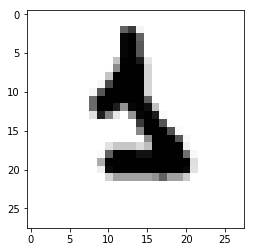

Pred value: 8
True value: 1


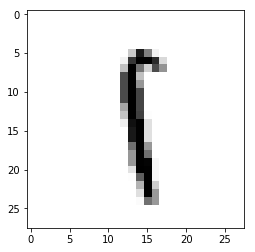

Pred value: 2
True value: 9


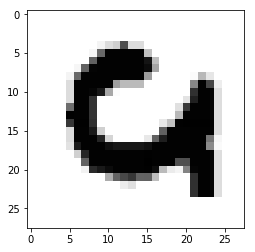

Pred value: 8
True value: 2


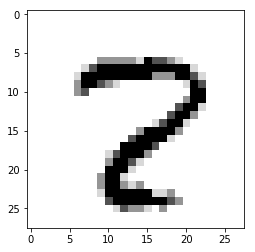

Pred value: 8
True value: 3


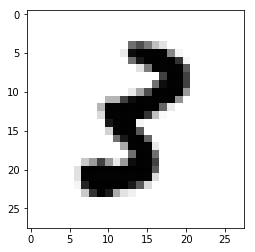

Pred value: 5
True value: 3


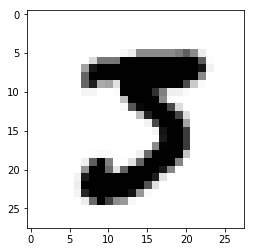

Pred value: 8
True value: 7


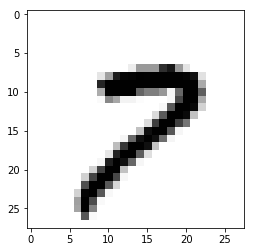

Pred value: 2
True value: 7


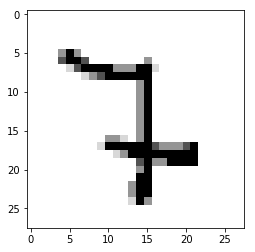

Pred value: 5
True value: 0


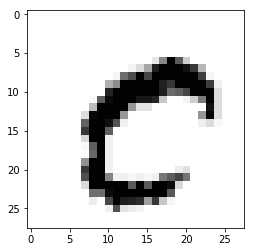

Pred value: 5
True value: 1


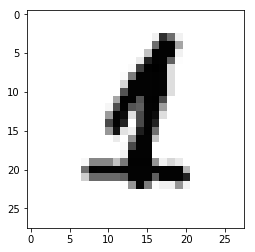

Pred value: 3
True value: 5


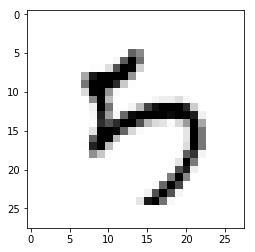

Pred value: 5
True value: 9


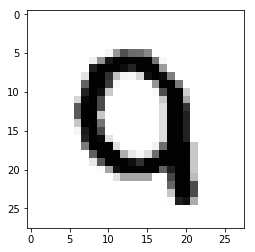

Pred value: 2
True value: 8


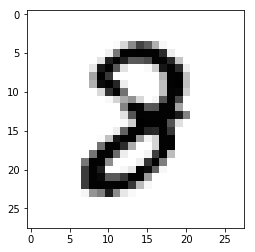

Pred value: 7
True value: 9


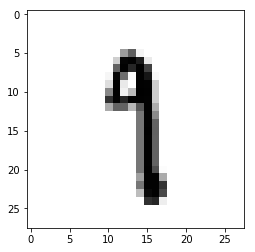

Pred value: 8
True value: 1


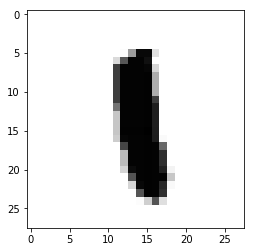

Pred value: 3
True value: 5


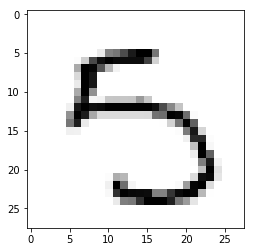

Pred value: 8
True value: 9


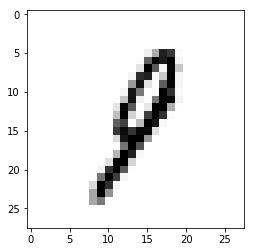

Pred value: 8
True value: 9


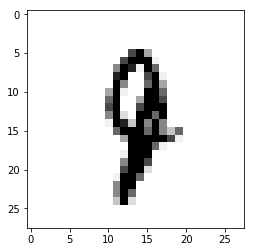

Pred value: 8
True value: 1


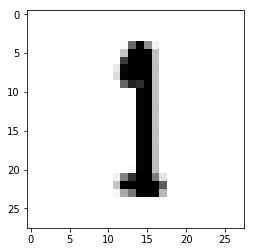

Pred value: 9
True value: 4


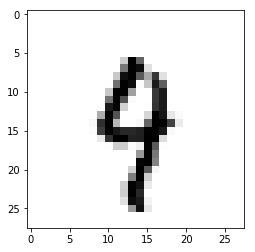

Pred value: 5
True value: 6


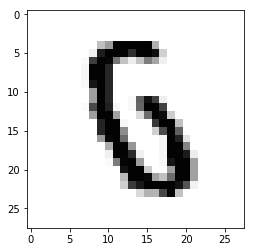

Pred value: 2
True value: 0


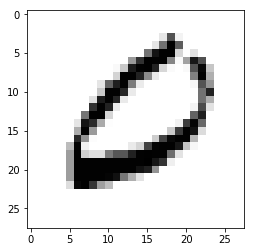

Pred value: 8
True value: 1


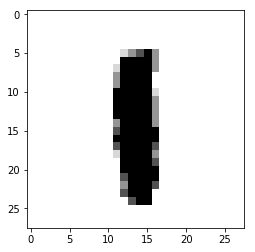

Pred value: 8
True value: 7


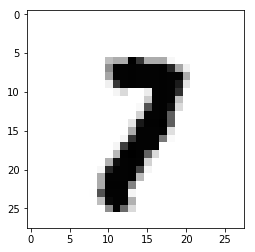

Pred value: 5
True value: 9


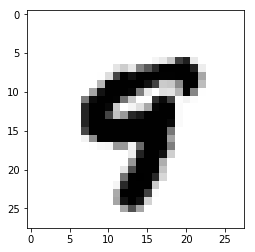

Pred value: 3
True value: 7


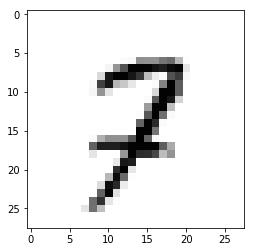

Pred value: 9
True value: 4


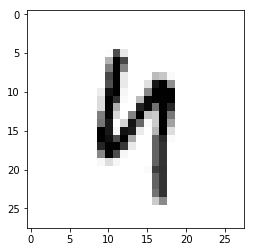

Pred value: 3
True value: 7


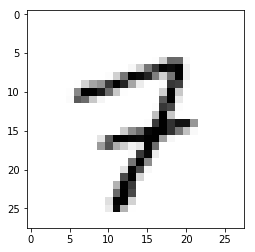

Pred value: 2
True value: 6


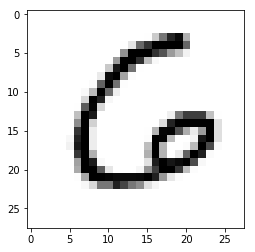

Pred value: 2
True value: 7


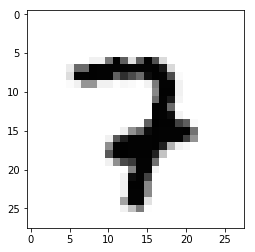

Pred value: 8
True value: 9


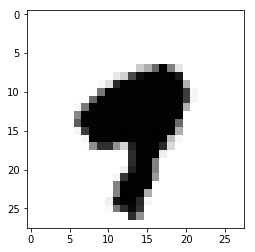

Pred value: 8
True value: 5


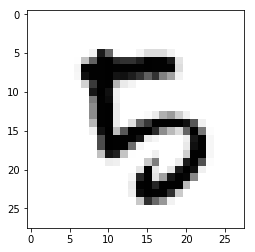

Pred value: 2
True value: 7


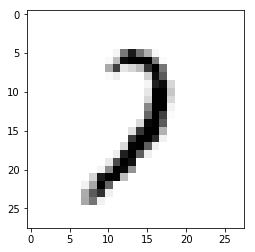

Pred value: 0
True value: 9


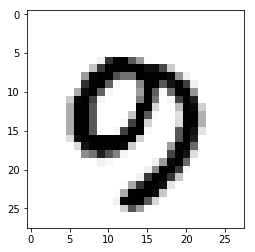

Pred value: 3
True value: 5


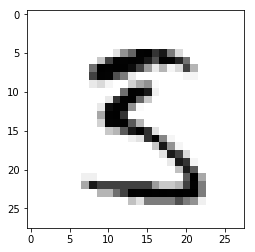

Pred value: 2
True value: 7


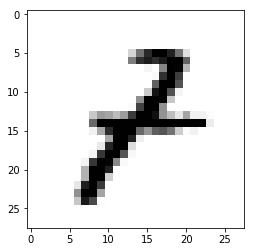

Pred value: 8
True value: 6


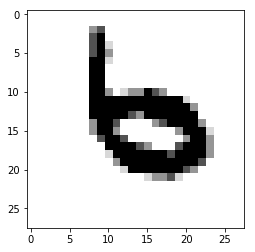

Pred value: 8
True value: 2


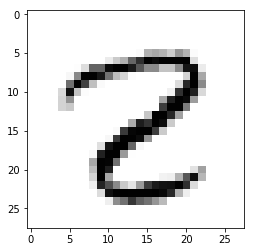

Pred value: 5
True value: 3


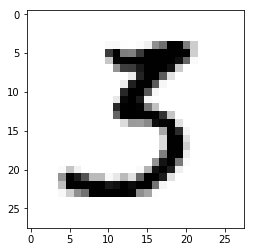

Pred value: 2
True value: 7


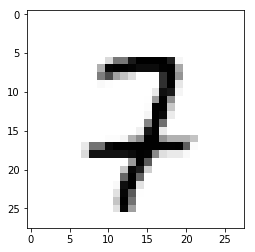

Pred value: 6
True value: 0


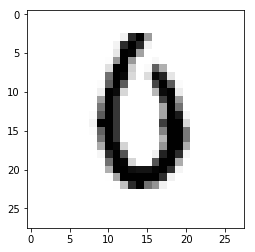

Pred value: 6
True value: 0


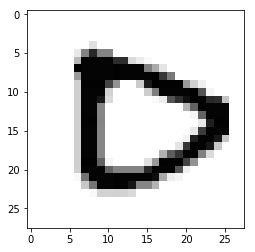

Pred value: 8
True value: 4


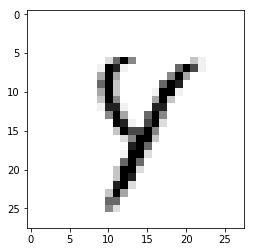

Pred value: 2
True value: 7


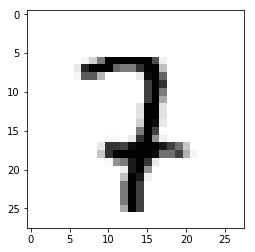

Pred value: 8
True value: 5


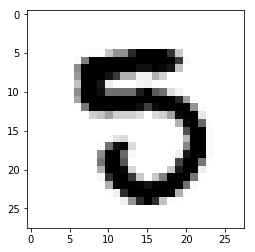

Pred value: 8
True value: 7


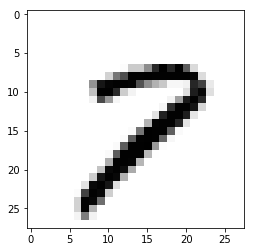

Pred value: 8
True value: 1


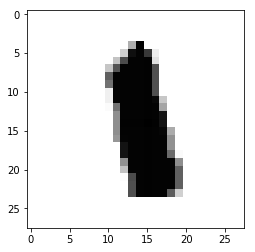

Pred value: 8
True value: 0


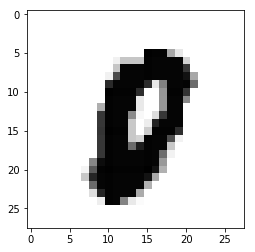

Pred value: 2
True value: 6


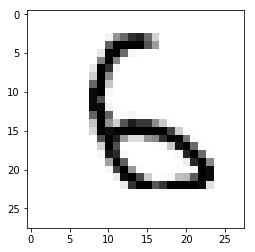

Pred value: 2
True value: 7


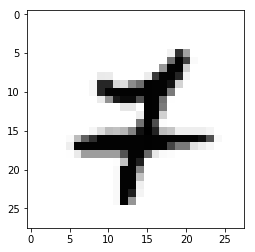

Pred value: 8
True value: 1


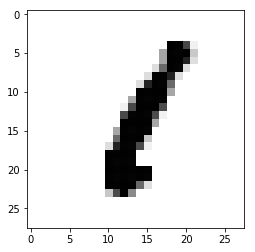

Pred value: 2
True value: 7


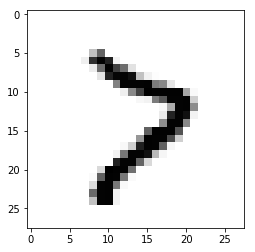

Pred value: 5
True value: 9


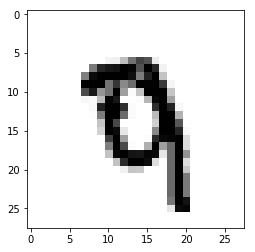

Pred value: 5
True value: 6


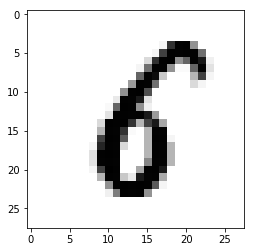

Pred value: 5
True value: 6


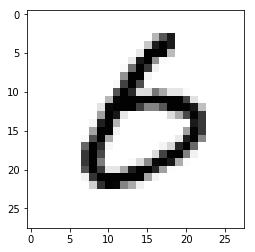

Pred value: 8
True value: 1


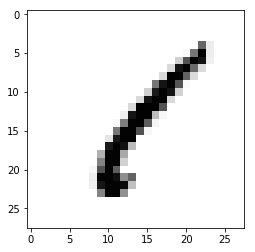

Pred value: 0
True value: 6


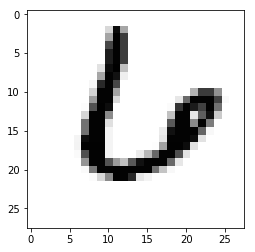

Pred value: 8
True value: 9


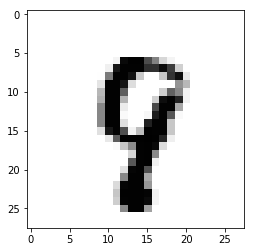

Pred value: 8
True value: 3


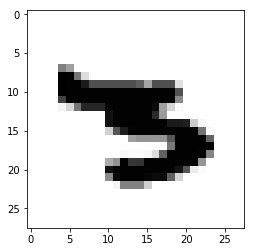

Pred value: 3
True value: 2


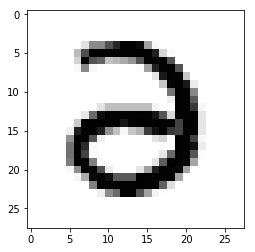

Pred value: 4
True value: 1


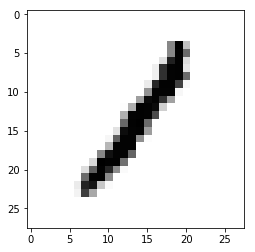

Pred value: 2
True value: 6


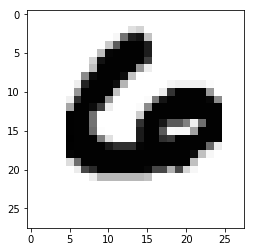

Pred value: 4
True value: 1


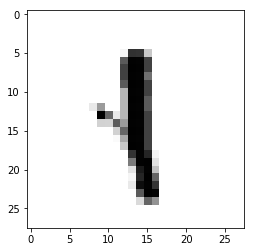

Pred value: 5
True value: 0


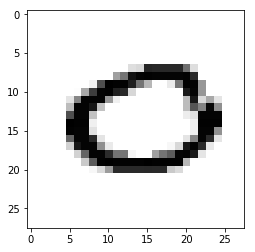

Pred value: 3
True value: 7


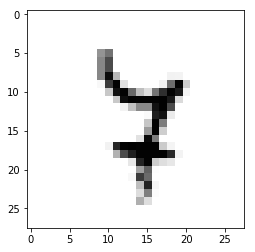

Pred value: 8
True value: 1


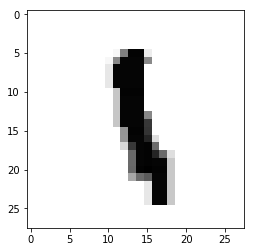

Pred value: 2
True value: 6


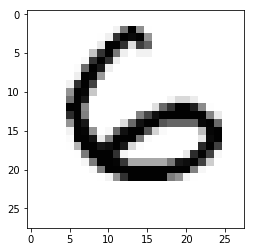

Pred value: 5
True value: 6


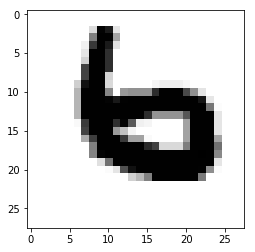

Pred value: 5
True value: 6


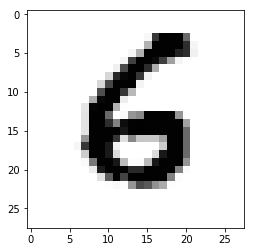

Pred value: 2
True value: 4


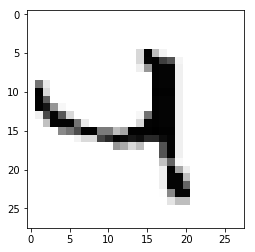

Pred value: 2
True value: 7


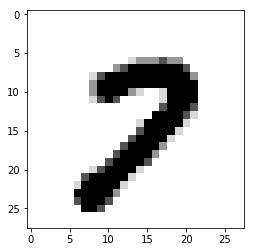

Pred value: 8
True value: 9


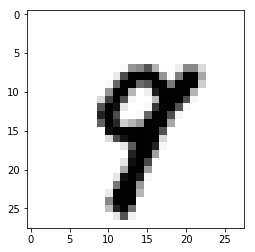

Pred value: 5
True value: 6


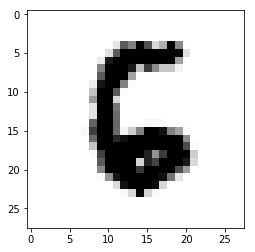

Pred value: 5
True value: 9


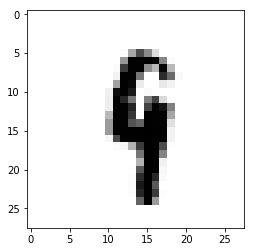

Pred value: 5
True value: 6


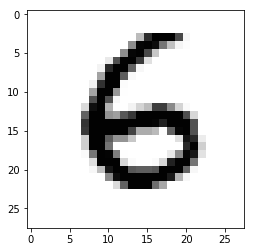

Pred value: 2
True value: 4


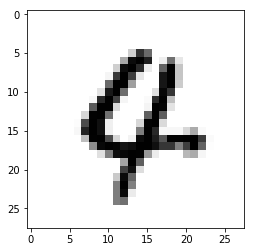

Pred value: 8
True value: 7


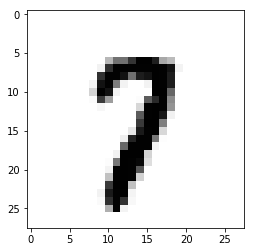

Pred value: 5
True value: 0


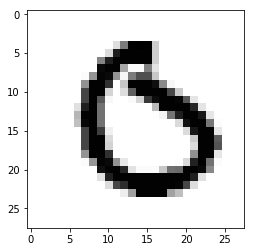

Pred value: 8
True value: 1


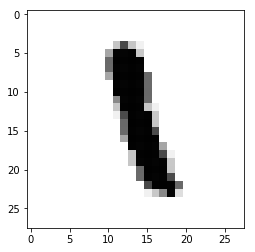

Pred value: 9
True value: 4


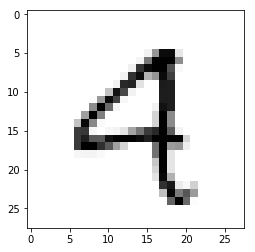

Pred value: 5
True value: 6


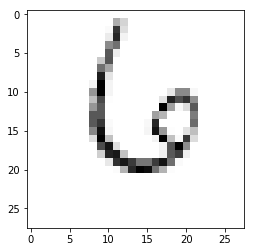

Pred value: 2
True value: 3


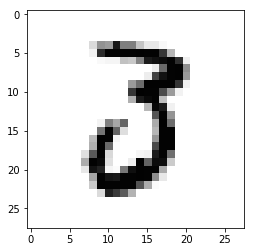

Pred value: 2
True value: 3


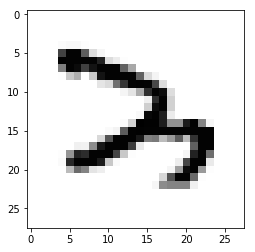

Pred value: 5
True value: 9


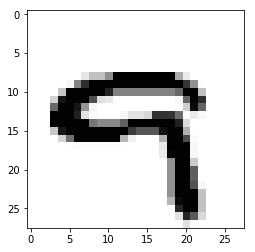

Pred value: 5
True value: 9


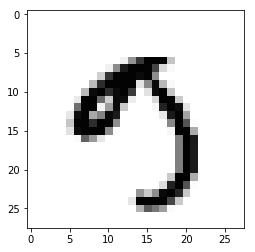

Pred value: 2
True value: 0


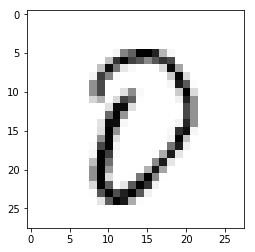

Pred value: 5
True value: 1


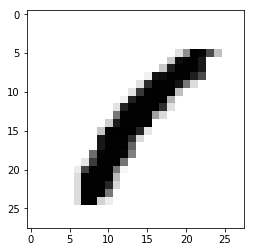

Pred value: 5
True value: 3


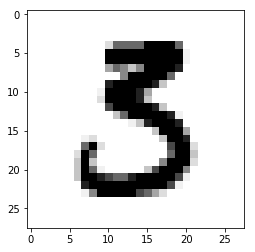

Pred value: 2
True value: 0


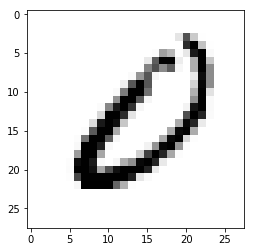

Pred value: 8
True value: 5


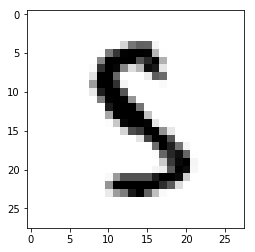

Pred value: 2
True value: 7


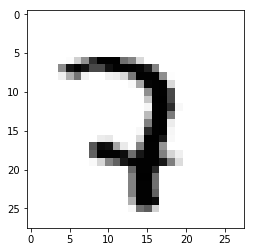

Pred value: 3
True value: 5


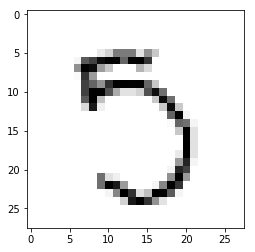

Pred value: 5
True value: 6


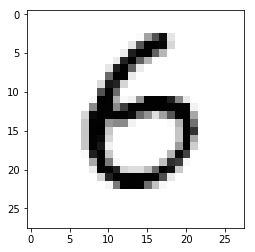

Pred value: 8
True value: 7


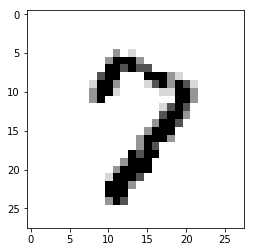

Pred value: 5
True value: 6


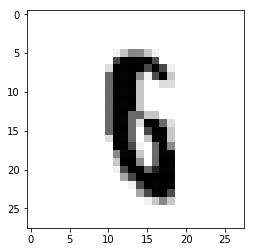

Pred value: 8
True value: 9


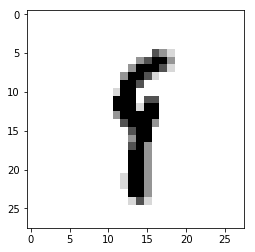

Pred value: 8
True value: 6


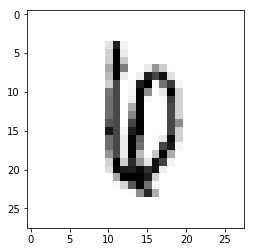

Pred value: 5
True value: 9


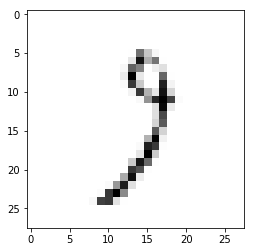

Pred value: 2
True value: 7


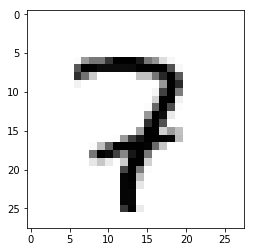

Pred value: 8
True value: 6


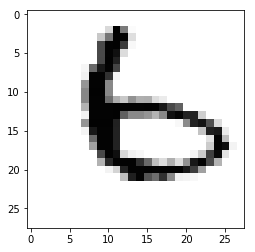

Pred value: 2
True value: 1


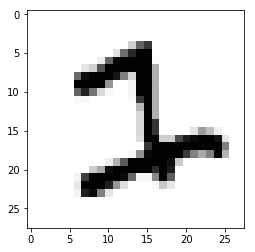

Pred value: 5
True value: 1


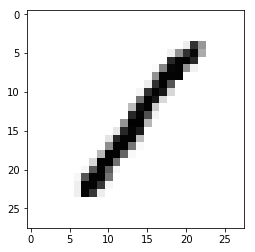

Pred value: 3
True value: 5


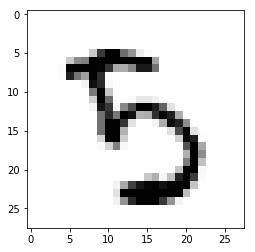

Pred value: 3
True value: 7


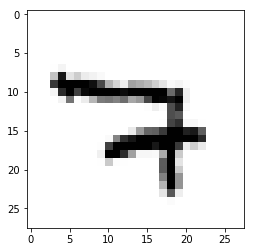

Pred value: 8
True value: 1


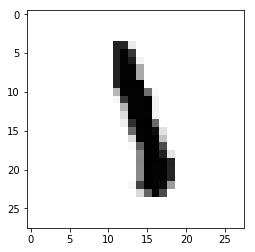

Pred value: 8
True value: 3


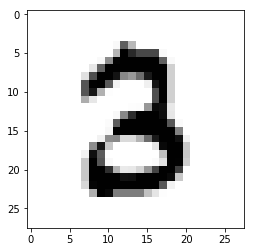

Pred value: 2
True value: 1


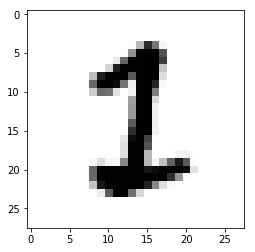

Pred value: 3
True value: 5


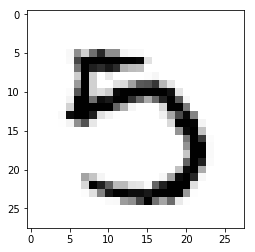

Pred value: 5
True value: 9


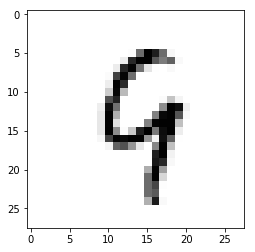

Pred value: 8
True value: 7


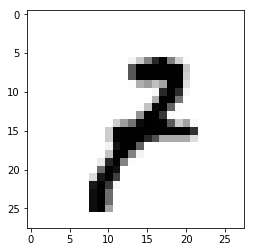

Pred value: 3
True value: 7


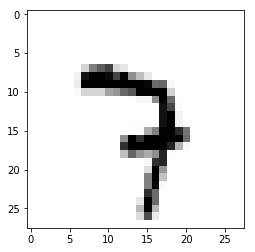

Pred value: 2
True value: 7


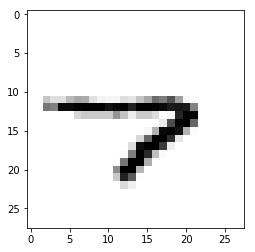

Pred value: 3
True value: 8


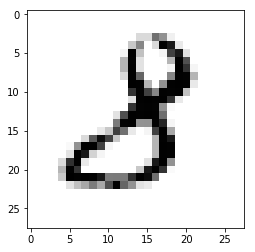

Pred value: 3
True value: 7


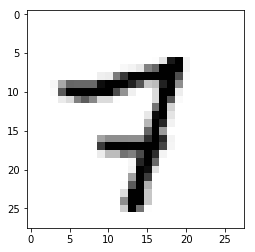

Pred value: 2
True value: 0


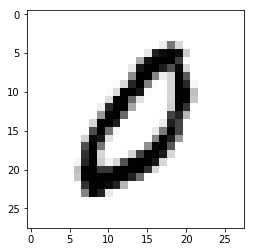

Pred value: 5
True value: 6


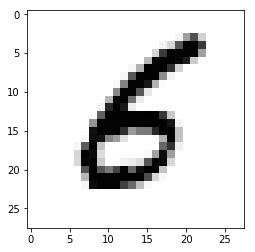

Pred value: 2
True value: 6


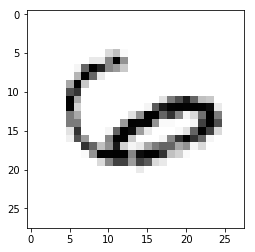

Pred value: 8
True value: 7


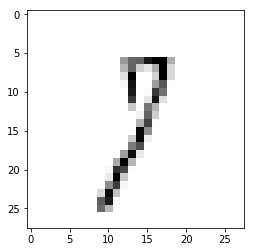

Pred value: 5
True value: 6


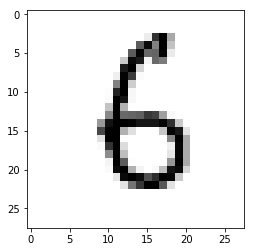

Pred value: 3
True value: 9


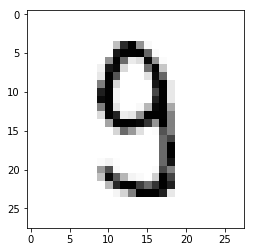

Pred value: 5
True value: 0


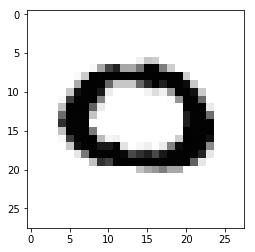

Pred value: 5
True value: 6


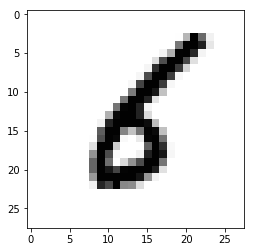

Pred value: 5
True value: 6


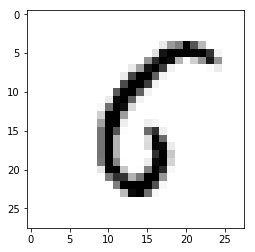

Pred value: 5
True value: 6


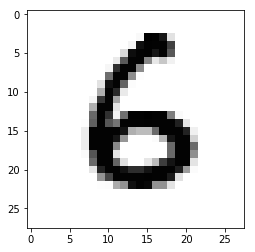

Pred value: 8
True value: 7


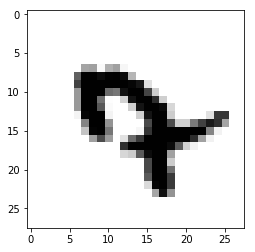

Pred value: 2
True value: 7


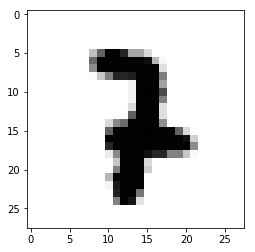

Pred value: 3
True value: 7


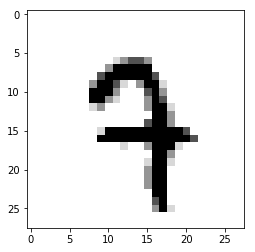

Pred value: 5
True value: 6


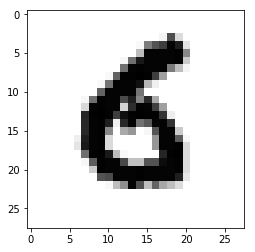

Pred value: 3
True value: 5


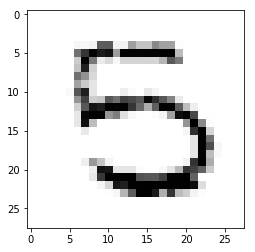

Pred value: 2
True value: 7


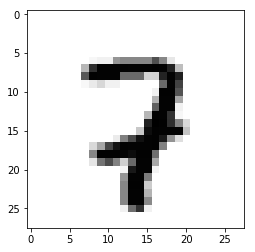

Pred value: 4
True value: 1


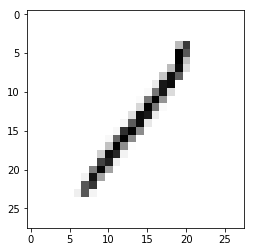

Pred value: 8
True value: 0


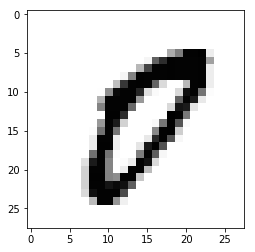

Pred value: 8
True value: 6


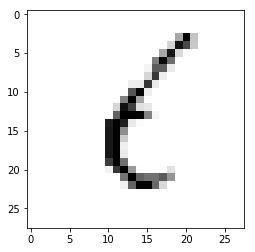

Pred value: 7
True value: 9


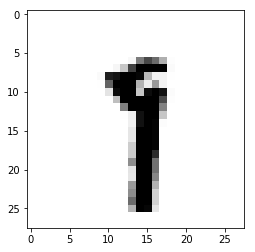

Pred value: 8
True value: 3


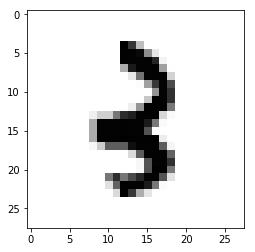

Pred value: 5
True value: 9


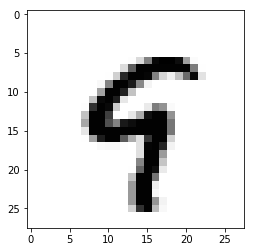

Pred value: 3
True value: 9


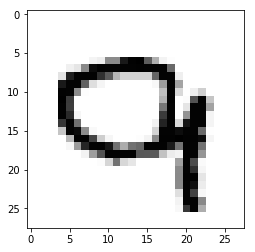

Pred value: 5
True value: 9


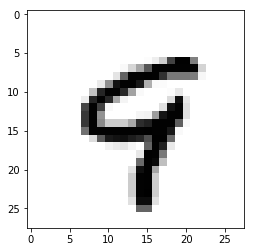

Pred value: 8
True value: 7


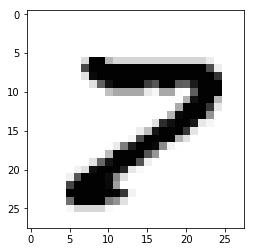

Pred value: 5
True value: 6


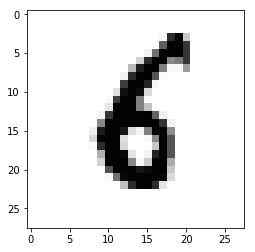

Pred value: 4
True value: 6


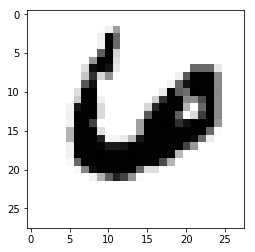

Pred value: 5
True value: 0


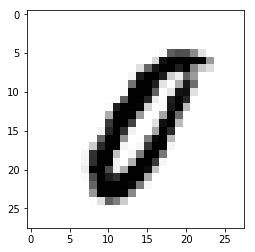

Pred value: 8
True value: 1


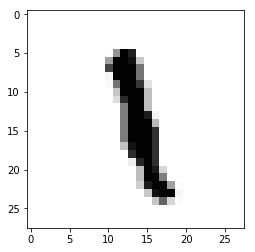

Pred value: 8
True value: 9


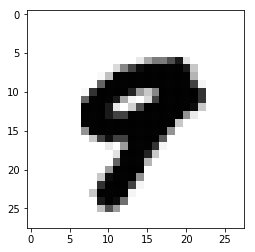

Pred value: 7
True value: 9


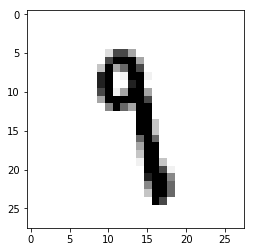

Pred value: 3
True value: 9


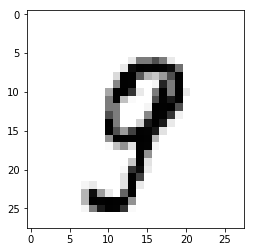

Pred value: 5
True value: 6


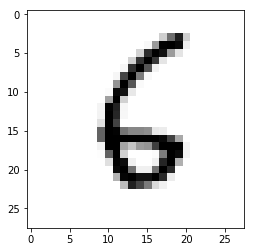

Pred value: 4
True value: 6


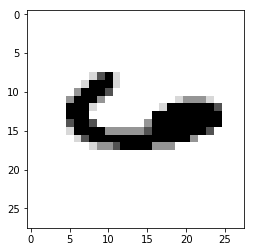

Pred value: 8
True value: 7


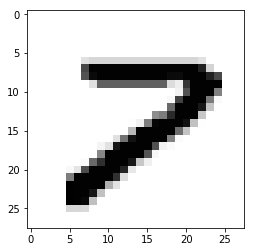

Pred value: 3
True value: 4


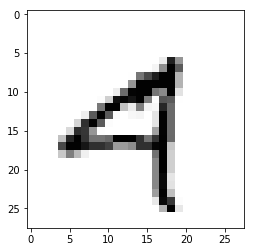

Pred value: 2
True value: 6


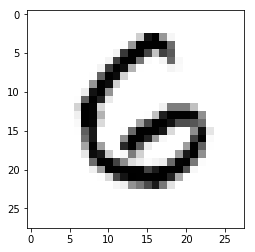

Pred value: 5
True value: 0


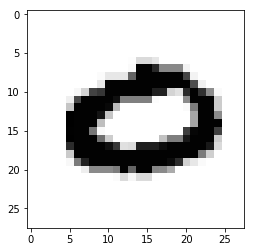

Pred value: 2
True value: 4


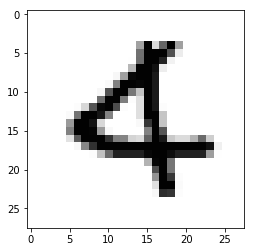

Pred value: 8
True value: 3


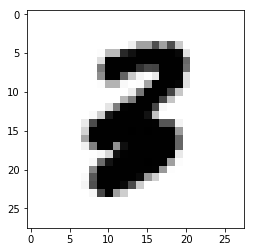

Pred value: 5
True value: 6


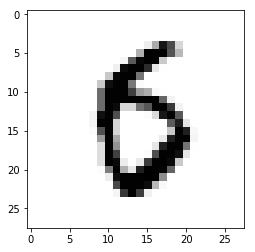

Pred value: 8
True value: 6


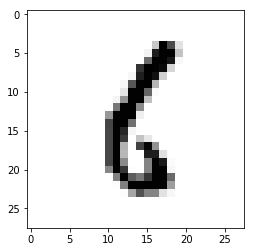

Pred value: 3
True value: 5


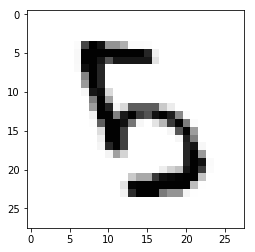

Pred value: 5
True value: 8


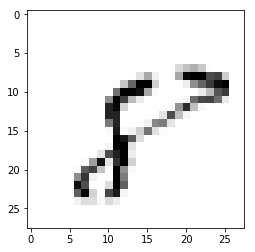

Pred value: 2
True value: 7


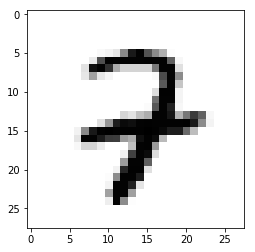

Pred value: 8
True value: 7


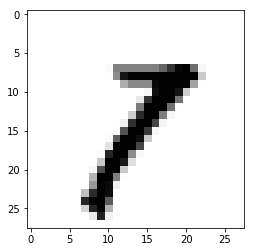

Pred value: 3
True value: 5


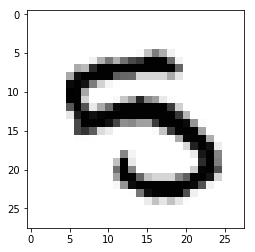

Pred value: 3
True value: 9


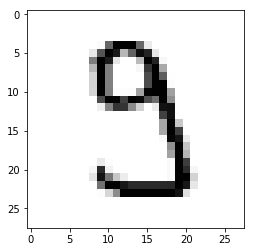

Pred value: 8
True value: 1


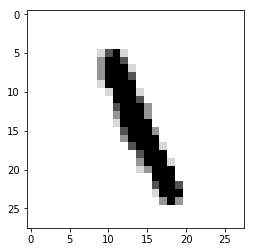

Pred value: 4
True value: 1


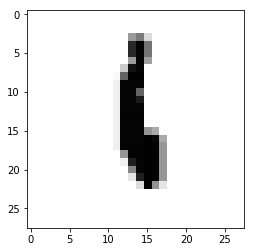

Pred value: 8
True value: 9


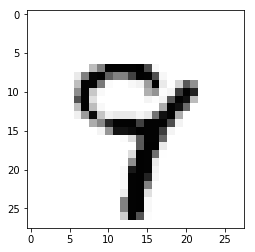

Pred value: 5
True value: 8


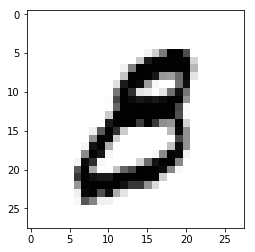

Pred value: 5
True value: 8


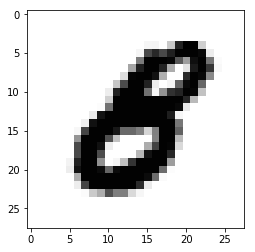

Pred value: 3
True value: 2


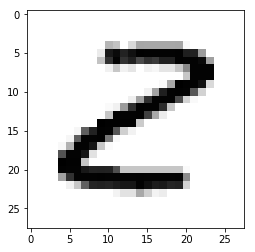

Pred value: 5
True value: 9


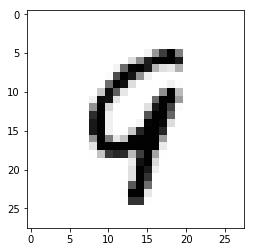

Pred value: 8
True value: 6


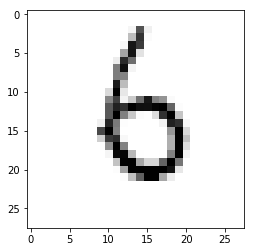

Pred value: 3
True value: 9


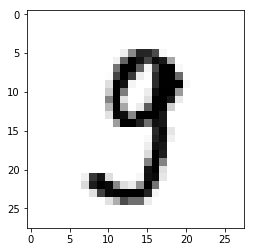

Pred value: 3
True value: 4


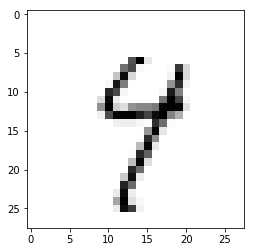

Pred value: 3
True value: 7


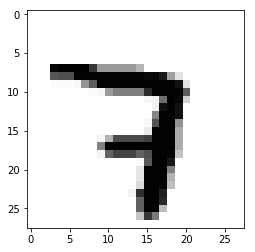

Pred value: 5
True value: 9


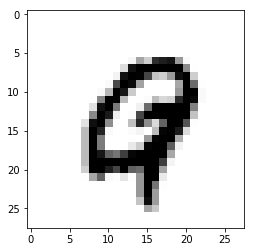

Pred value: 9
True value: 4


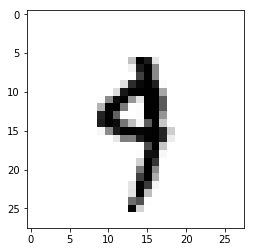

Pred value: 5
True value: 8


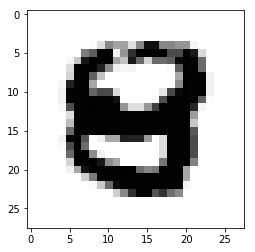

Pred value: 9
True value: 7


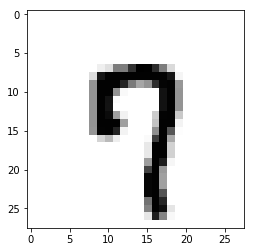

Pred value: 5
True value: 6


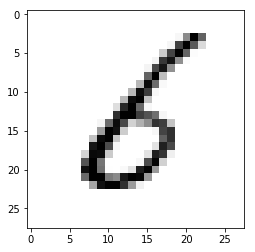

Pred value: 0
True value: 6


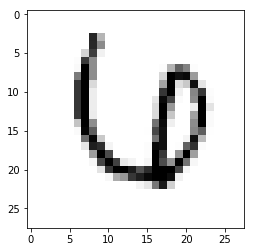

Pred value: 5
True value: 8


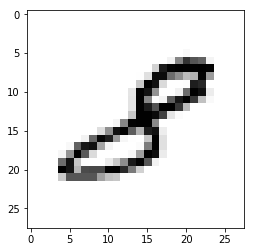

Pred value: 5
True value: 6


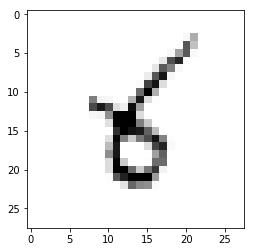

Pred value: 2
True value: 7


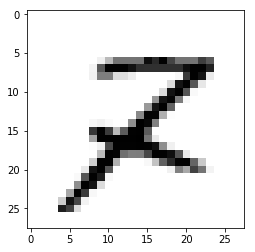

Pred value: 6
True value: 4


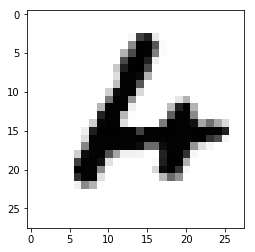

Pred value: 8
True value: 2


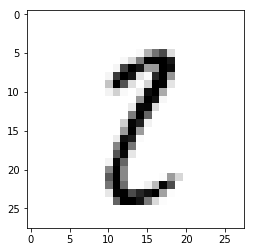

Pred value: 5
True value: 6


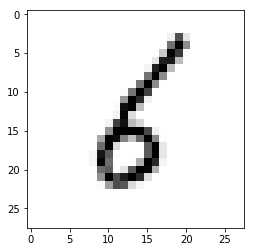

Pred value: 8
True value: 7


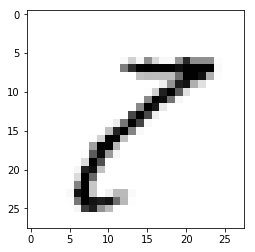

Pred value: 3
True value: 9


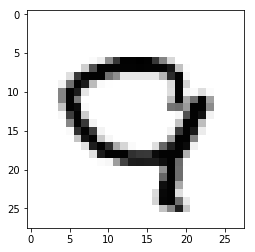

Pred value: 4
True value: 7


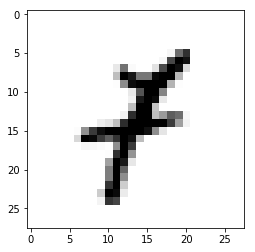

Pred value: 2
True value: 7


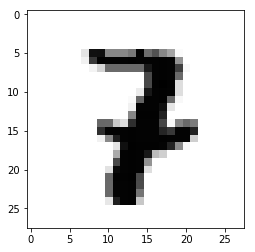

Pred value: 4
True value: 9


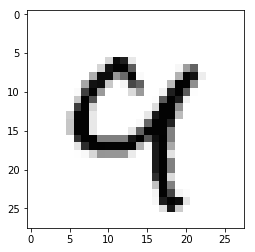

Pred value: 5
True value: 6


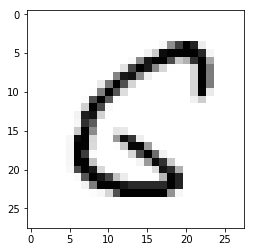

Pred value: 3
True value: 9


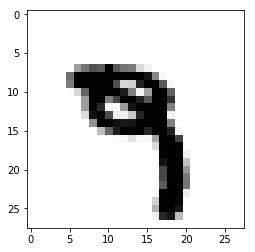

Pred value: 2
True value: 9


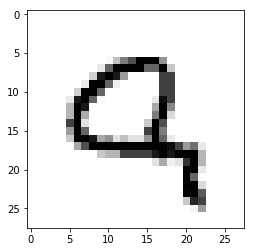

Pred value: 8
True value: 9


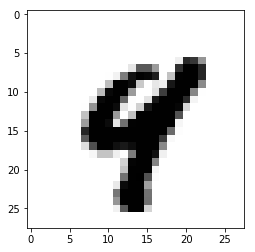

Pred value: 5
True value: 9


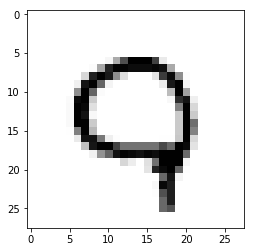

Pred value: 5
True value: 9


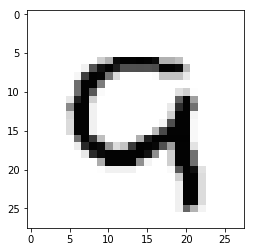

Pred value: 5
True value: 6


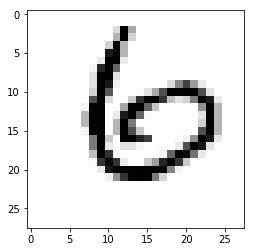

Pred value: 2
True value: 1


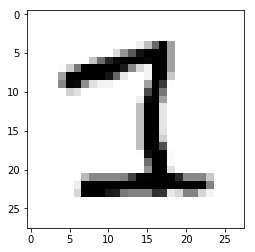

Pred value: 2
True value: 0


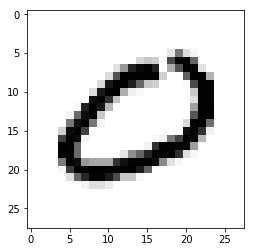

Pred value: 4
True value: 1


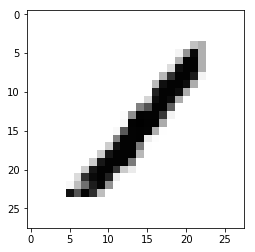

Pred value: 3
True value: 9


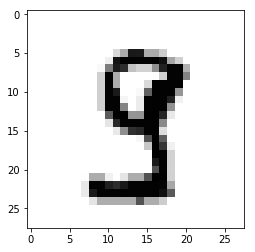

Pred value: 2
True value: 6


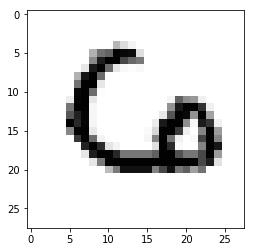

Pred value: 5
True value: 0


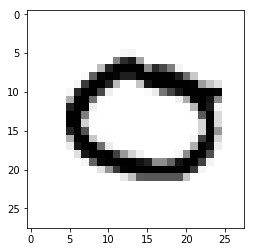

Pred value: 5
True value: 6


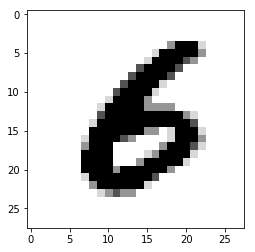

Pred value: 8
True value: 5


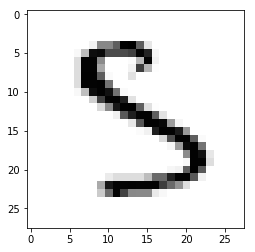

Pred value: 5
True value: 3


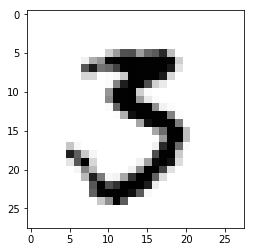

Pred value: 5
True value: 4


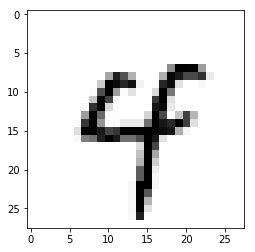

Pred value: 8
True value: 3


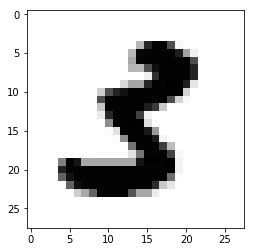

Pred value: 8
True value: 7


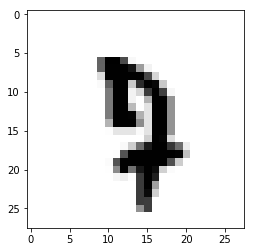

Pred value: 3
True value: 1


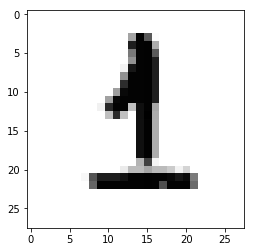

Pred value: 5
True value: 9


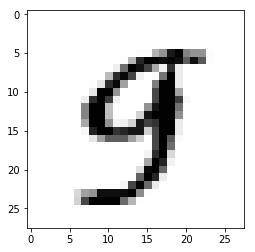

Pred value: 8
True value: 4


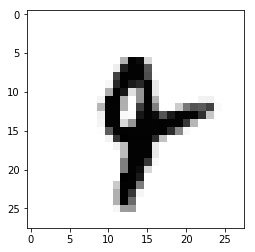

Pred value: 5
True value: 6


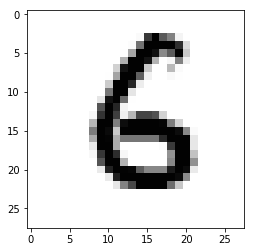

Pred value: 5
True value: 6


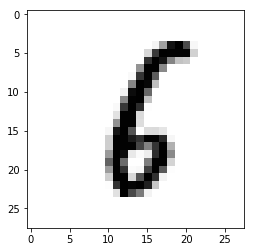

Pred value: 5
True value: 6


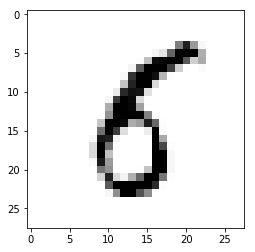

Pred value: 2
True value: 0


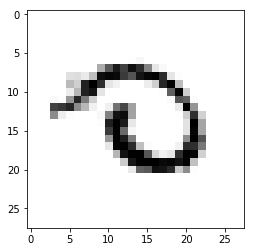

Pred value: 8
True value: 9


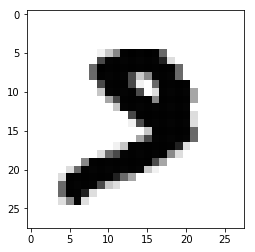

Pred value: 8
True value: 9


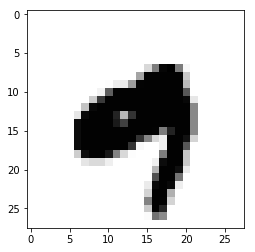

Pred value: 2
True value: 7


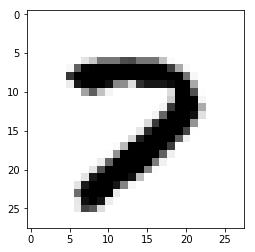

Pred value: 5
True value: 8


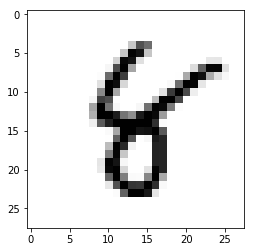

Pred value: 2
True value: 8


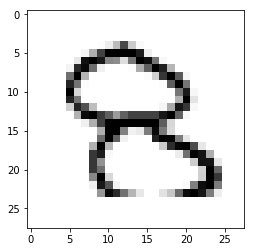

Pred value: 3
True value: 9


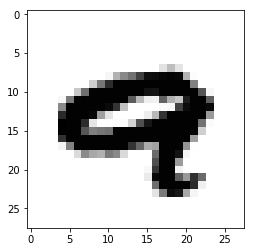

Pred value: 5
True value: 9


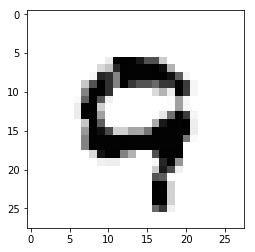

Pred value: 0
True value: 9


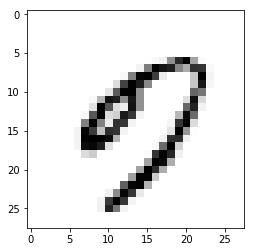

Pred value: 8
True value: 1


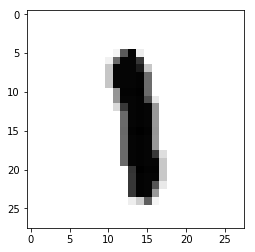

Pred value: 7
True value: 1


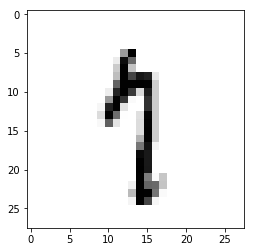

Pred value: 3
True value: 9


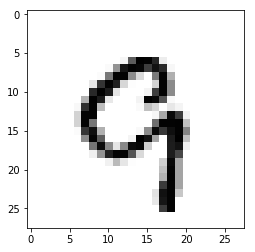

Pred value: 5
True value: 6


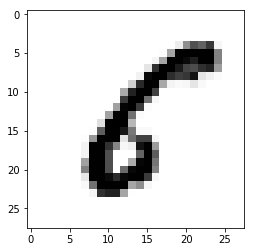

Pred value: 2
True value: 1


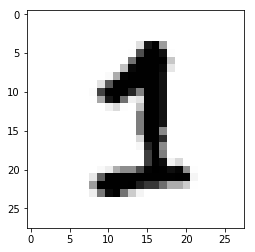

Pred value: 7
True value: 9


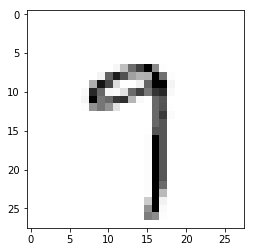

Pred value: 2
True value: 7


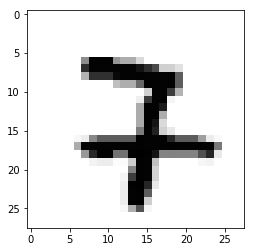

Pred value: 3
True value: 7


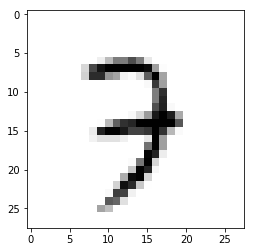

Pred value: 5
True value: 6


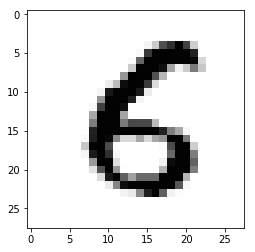

Pred value: 2
True value: 3


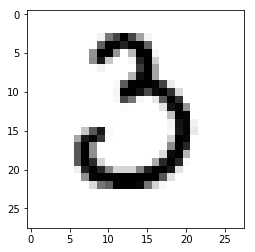

Pred value: 5
True value: 9


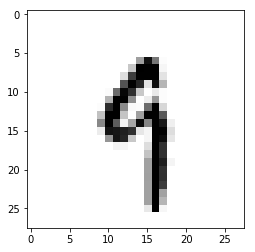

Pred value: 3
True value: 4


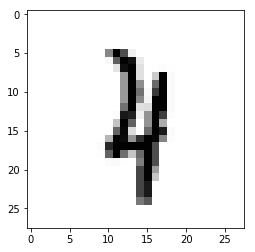

Pred value: 5
True value: 9


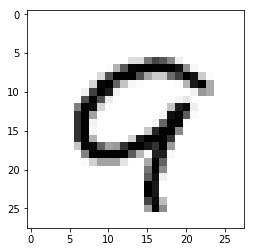

Pred value: 3
True value: 9


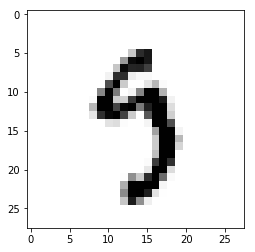

Pred value: 5
True value: 9


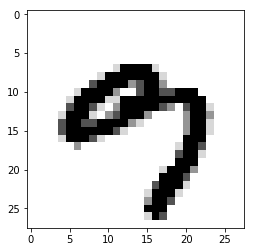

Pred value: 8
True value: 7


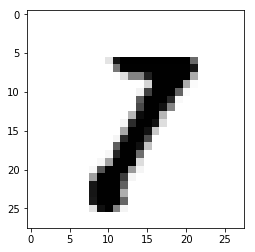

Pred value: 5
True value: 9


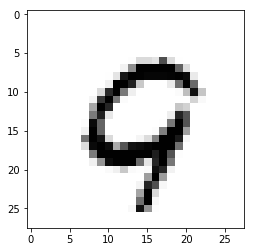

Pred value: 7
True value: 4


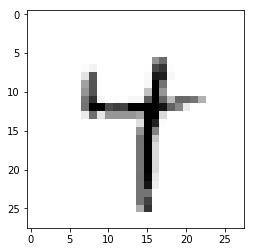

Pred value: 7
True value: 9


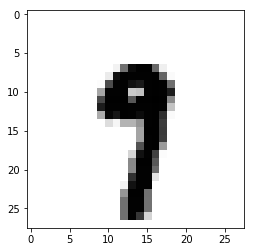

Pred value: 8
True value: 5


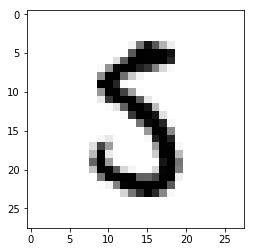

Pred value: 5
True value: 0


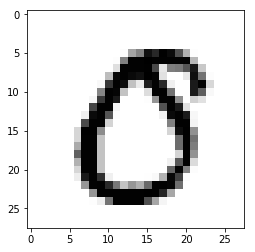

Pred value: 3
True value: 9


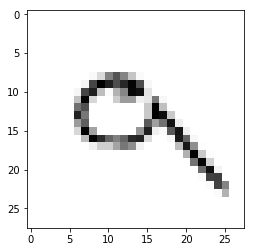

Pred value: 5
True value: 9


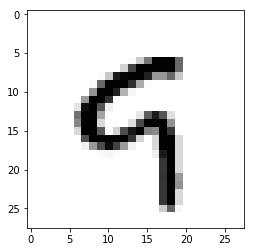

Pred value: 5
True value: 8


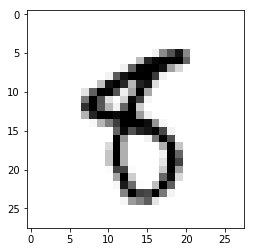

Pred value: 5
True value: 0


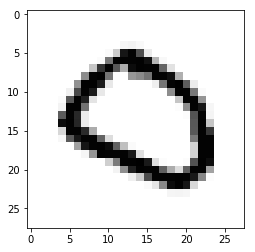

Pred value: 2
True value: 7


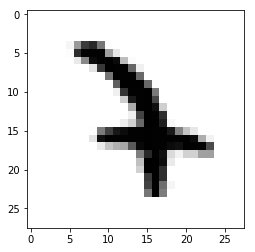

Pred value: 2
True value: 3


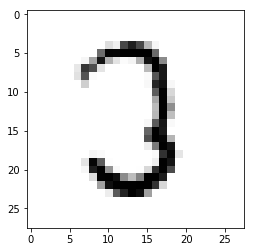

Pred value: 0
True value: 6


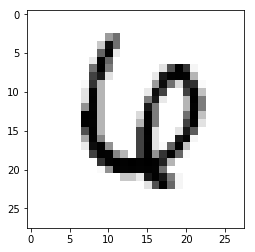

Pred value: 2
True value: 3


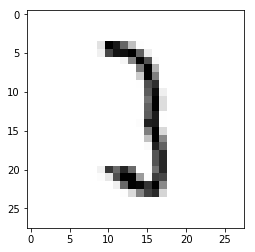

Pred value: 8
True value: 9


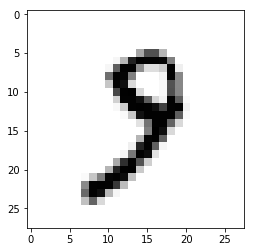

Pred value: 6
True value: 0


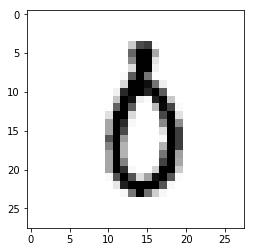

Pred value: 7
True value: 9


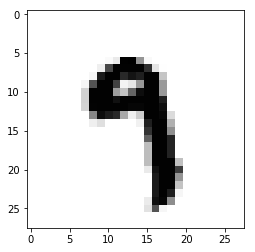

Pred value: 5
True value: 9


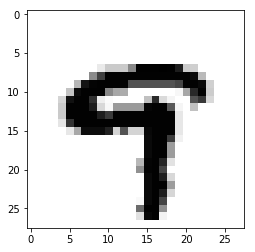

Pred value: 8
True value: 7


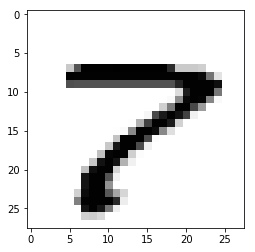

Pred value: 3
True value: 9


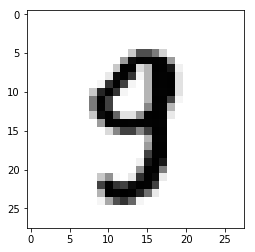

Pred value: 7
True value: 9


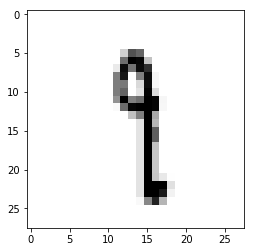

Pred value: 3
True value: 2


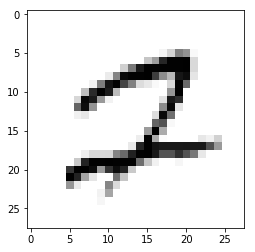

Pred value: 4
True value: 9


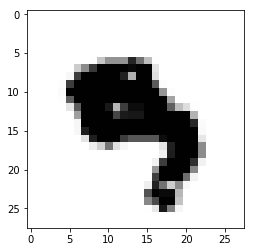

Pred value: 2
True value: 1


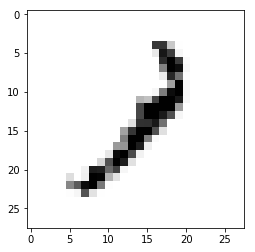

Pred value: 8
True value: 9


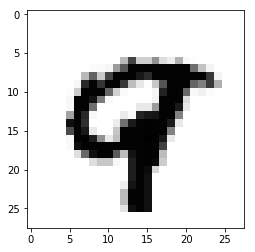

Pred value: 5
True value: 6


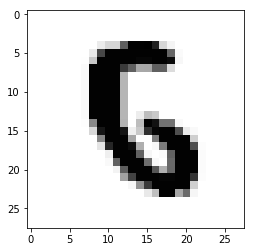

Pred value: 8
True value: 7


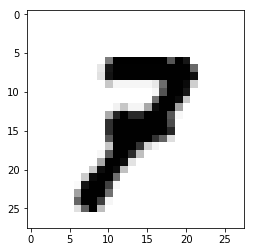

Pred value: 4
True value: 6


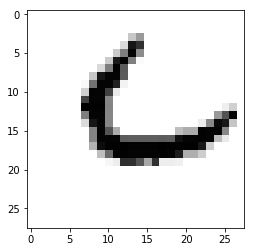

Pred value: 2
True value: 5


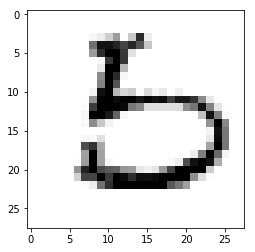

Pred value: 8
True value: 9


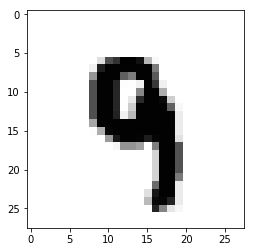

Pred value: 2
True value: 1


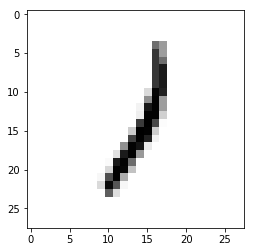

Pred value: 2
True value: 7


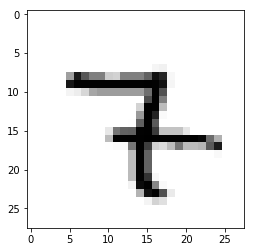

Pred value: 8
True value: 5


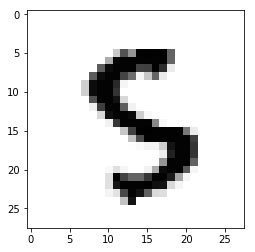

Pred value: 5
True value: 9


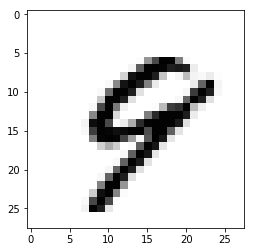

Pred value: 8
True value: 6


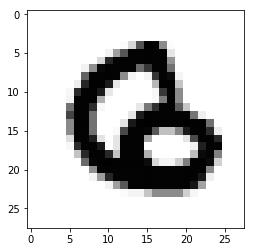

Pred value: 8
True value: 1


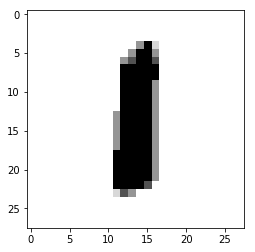

Pred value: 2
True value: 4


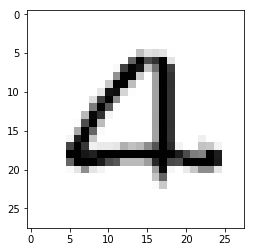

Pred value: 7
True value: 8


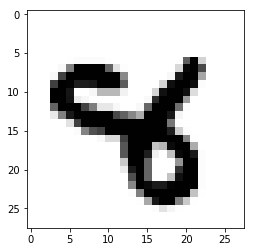

Pred value: 5
True value: 0


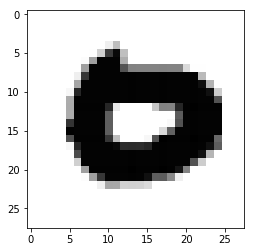

Pred value: 5
True value: 0


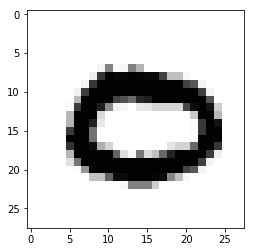

Pred value: 5
True value: 0


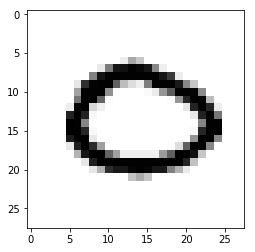

Pred value: 2
True value: 6


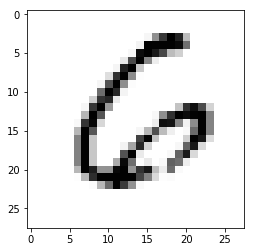

Pred value: 8
True value: 6


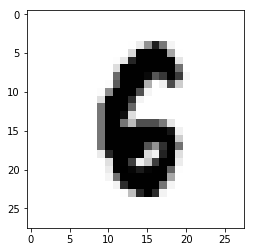

Pred value: 4
True value: 9


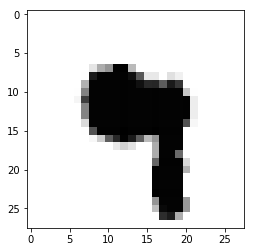

Pred value: 5
True value: 9


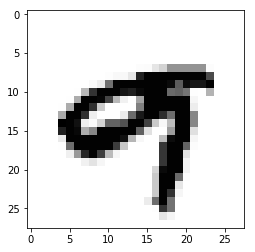

Pred value: 4
True value: 9


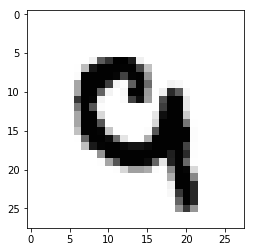

Pred value: 2
True value: 7


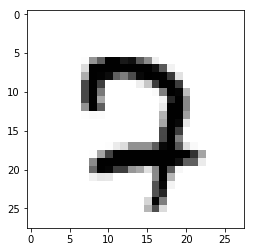

Pred value: 8
True value: 6


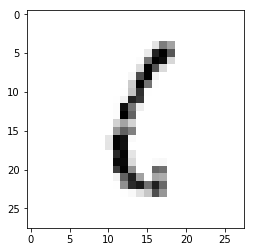

Pred value: 5
True value: 6


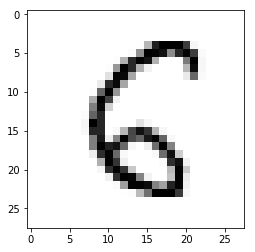

Pred value: 2
True value: 0


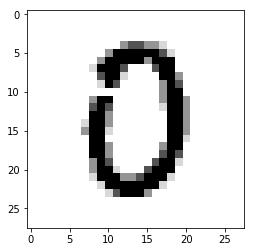

Pred value: 2
True value: 7


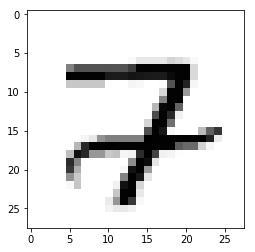

Pred value: 2
True value: 0


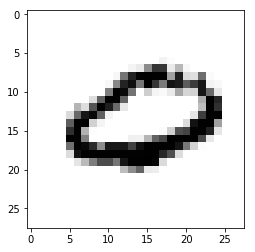

Pred value: 4
True value: 1


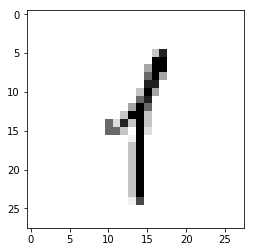

Pred value: 8
True value: 9


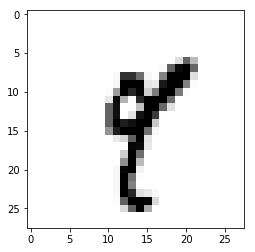

Pred value: 5
True value: 4


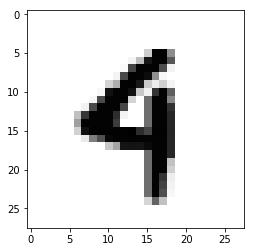

Pred value: 8
True value: 3


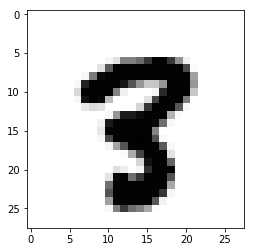

Pred value: 5
True value: 0


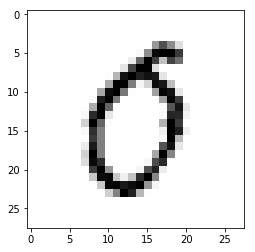

Pred value: 8
True value: 6


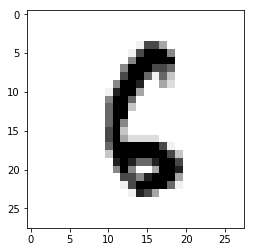

Pred value: 5
True value: 8


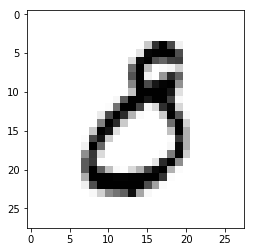

Pred value: 0
True value: 6


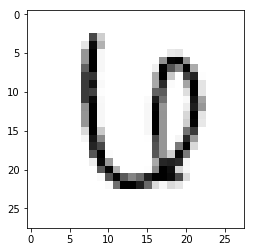

Pred value: 2
True value: 9


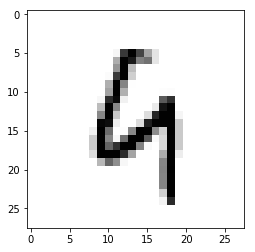

Pred value: 5
True value: 6


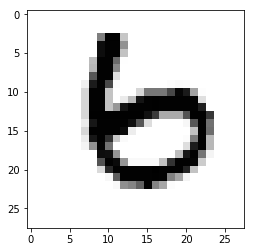

Pred value: 5
True value: 0


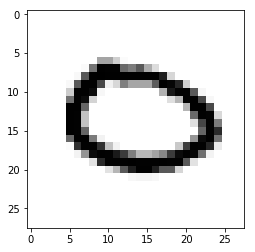

Pred value: 2
True value: 7


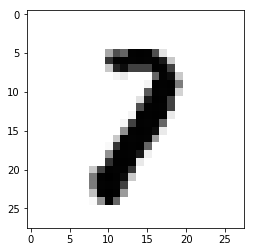

Pred value: 5
True value: 6


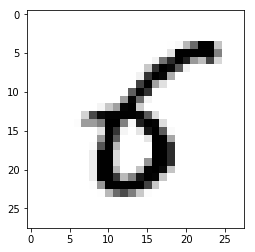

Pred value: 8
True value: 4


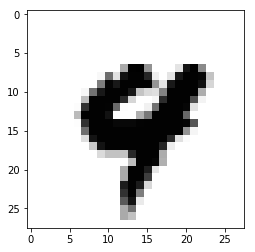

Pred value: 8
True value: 7


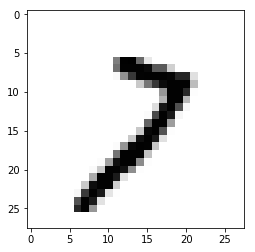

Pred value: 5
True value: 9


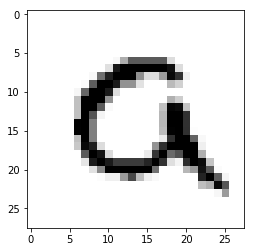

Pred value: 4
True value: 1


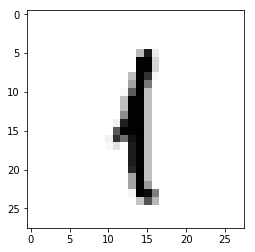

Pred value: 8
True value: 0


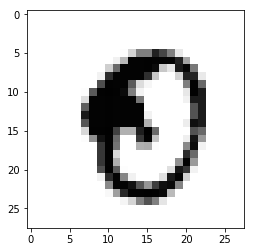

Pred value: 5
True value: 6


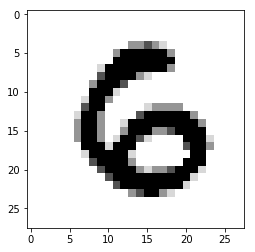

Pred value: 8
True value: 7


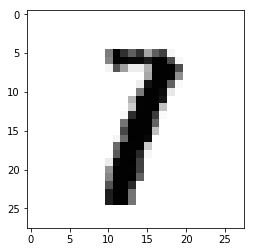

Pred value: 3
True value: 5


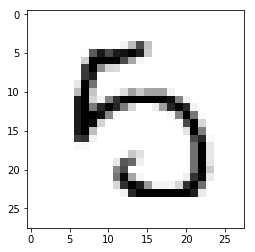

Pred value: 5
True value: 6


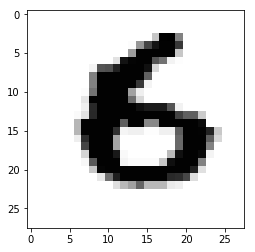

Pred value: 8
True value: 5


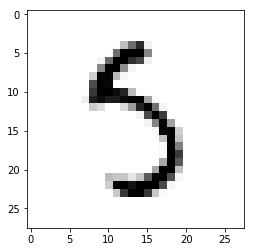

Pred value: 5
True value: 6


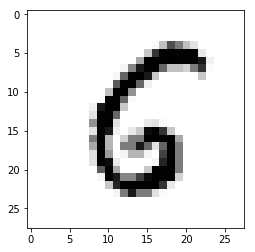

Pred value: 4
True value: 8


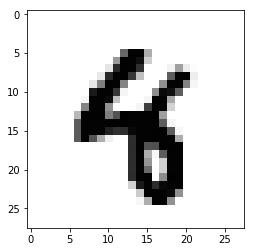

Pred value: 5
True value: 9


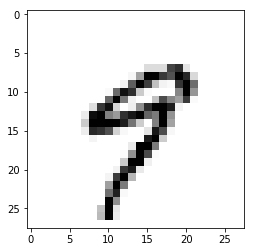

Pred value: 3
True value: 9


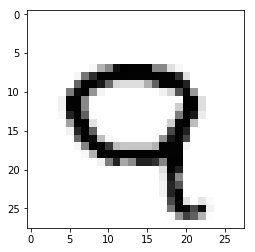

Pred value: 8
True value: 3


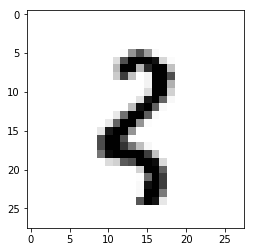

Pred value: 2
True value: 0


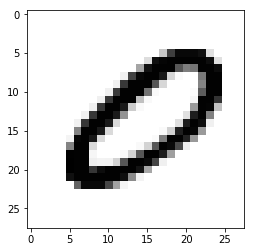

Pred value: 5
True value: 9


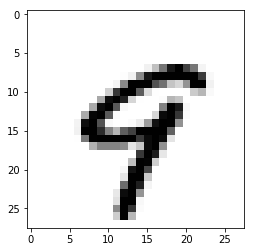

Pred value: 5
True value: 8


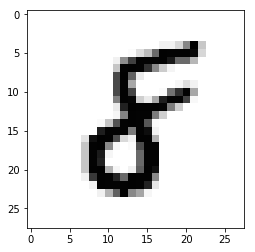

Pred value: 5
True value: 3


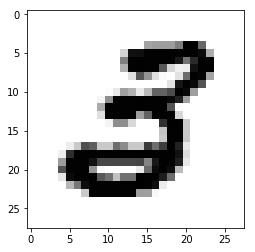

Pred value: 5
True value: 9


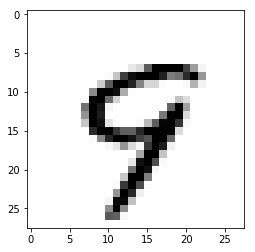

Pred value: 8
True value: 3


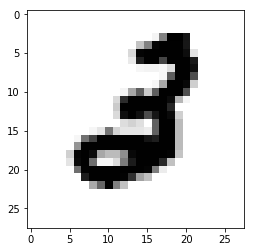

Pred value: 5
True value: 3


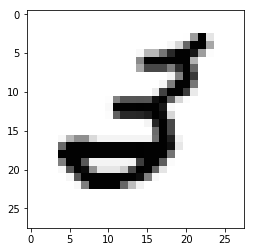

Pred value: 8
True value: 2


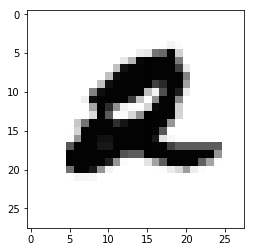

Pred value: 8
True value: 1


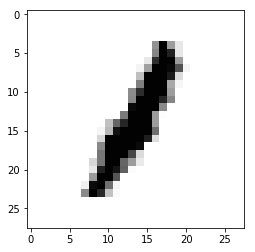

Pred value: 8
True value: 1


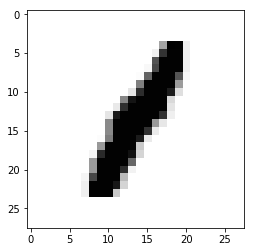

Pred value: 8
True value: 1


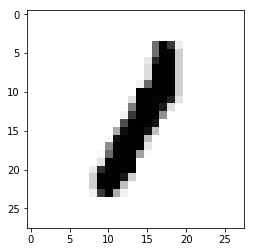

Pred value: 8
True value: 9


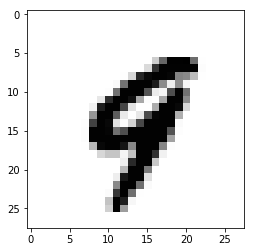

Pred value: 5
True value: 8


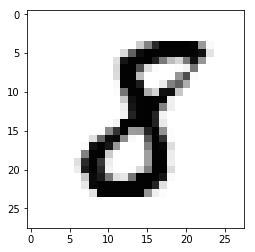

Pred value: 5
True value: 9


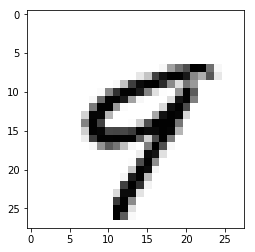

Pred value: 5
True value: 8


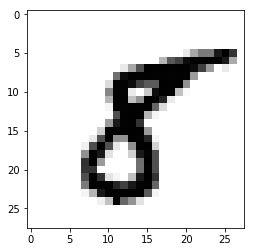

Pred value: 5
True value: 3


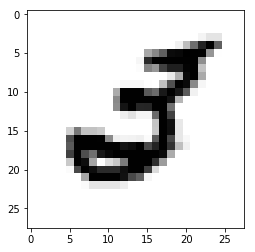

Pred value: 5
True value: 0


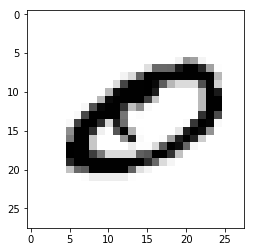

Pred value: 9
True value: 4


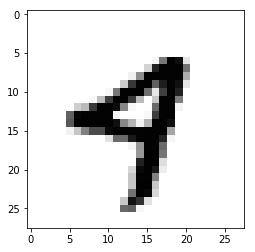

Pred value: 2
True value: 0


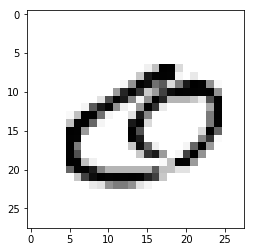

Pred value: 9
True value: 7


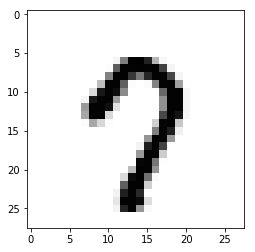

Pred value: 8
True value: 7


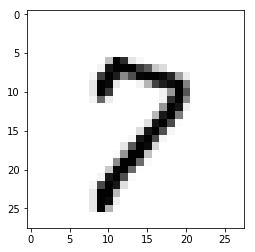

Pred value: 5
True value: 9


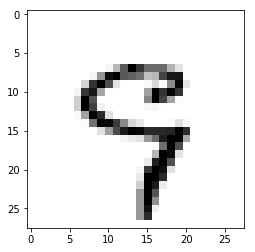

Pred value: 0
True value: 6


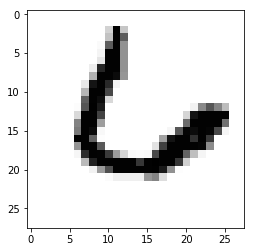

Pred value: 5
True value: 0


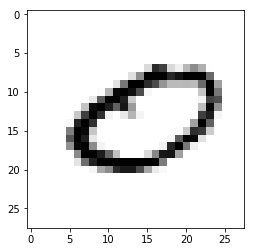

Pred value: 2
True value: 7


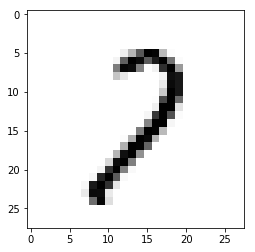

Pred value: 5
True value: 0


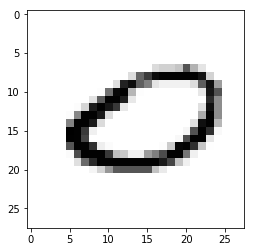

Pred value: 4
True value: 1


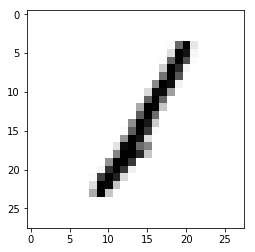

Pred value: 8
True value: 7


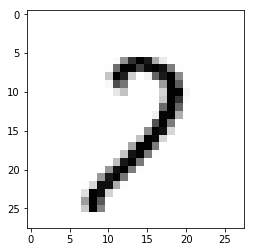

Pred value: 3
True value: 9


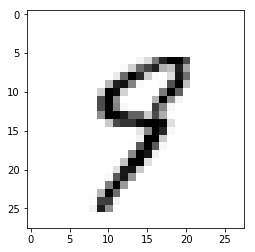

Pred value: 2
True value: 6


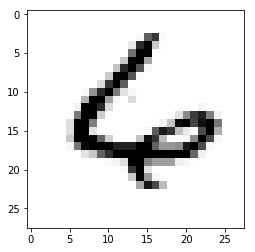

Pred value: 8
True value: 9


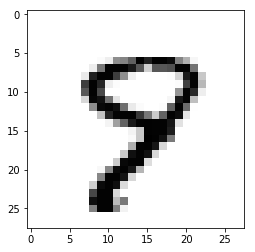

Pred value: 8
True value: 9


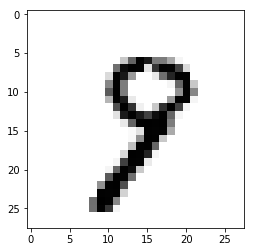

Pred value: 6
True value: 1


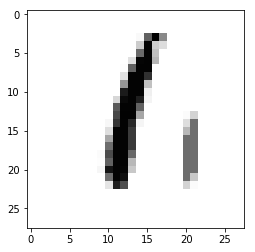

Pred value: 7
True value: 0


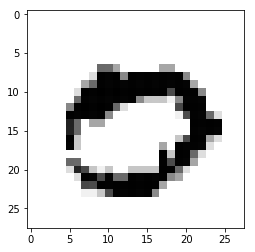

Pred value: 8
True value: 1


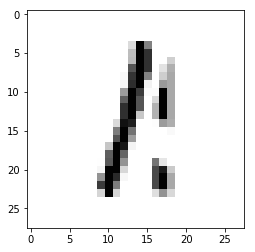

Pred value: 9
True value: 7


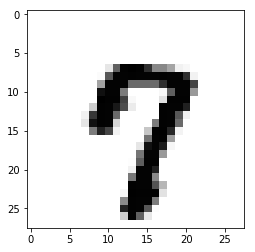

Pred value: 8
True value: 1


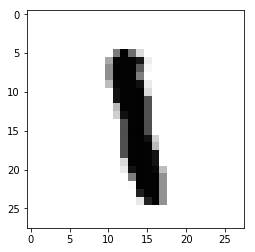

Pred value: 9
True value: 7


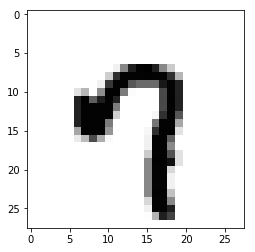

Pred value: 5
True value: 1


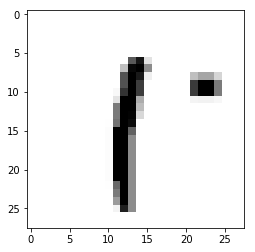

Pred value: 9
True value: 7


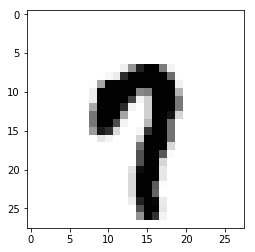

Pred value: 8
True value: 7


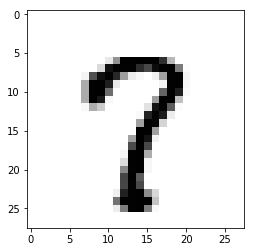

Pred value: 9
True value: 7


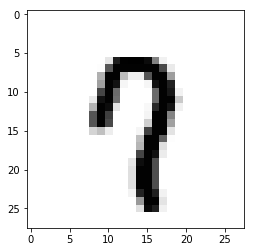

Pred value: 5
True value: 9


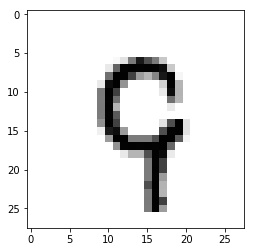

Pred value: 4
True value: 6


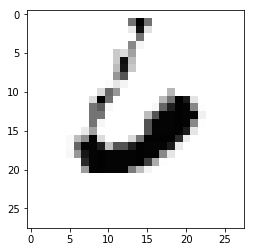

Pred value: 2
True value: 6


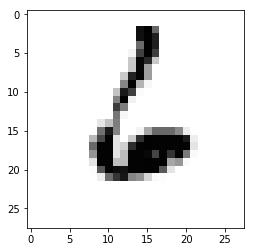

Pred value: 3
True value: 5


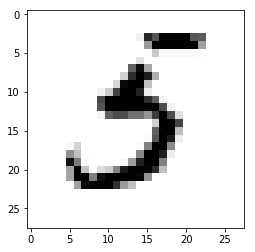

Pred value: 5
True value: 9


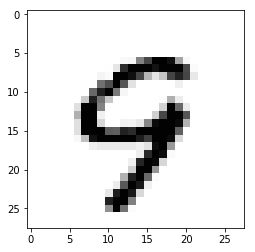

Pred value: 3
True value: 9


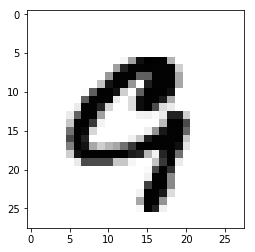

Pred value: 2
True value: 6


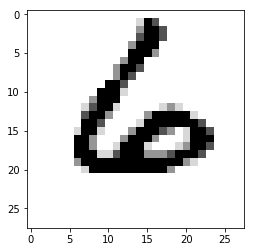

Pred value: 2
True value: 0


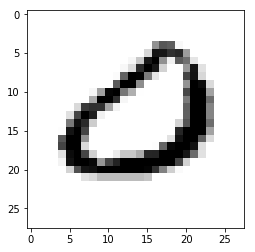

Pred value: 8
True value: 9


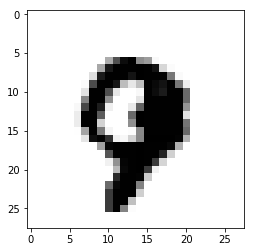

Pred value: 2
True value: 0


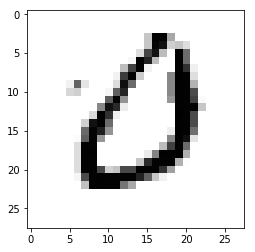

Pred value: 5
True value: 9


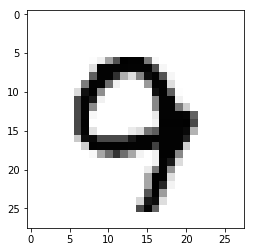

Pred value: 2
True value: 6


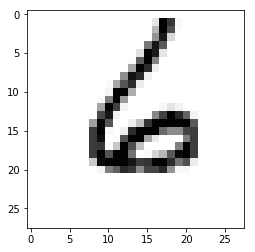

Pred value: 5
True value: 7


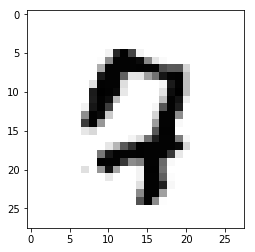

Pred value: 7
True value: 4


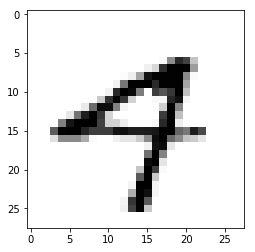

Pred value: 2
True value: 6


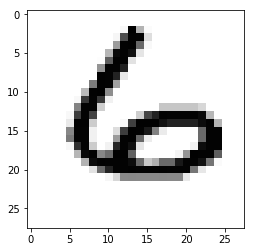

Pred value: 2
True value: 7


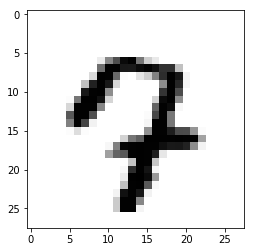

Pred value: 2
True value: 7


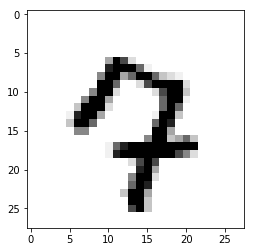

Pred value: 8
True value: 7


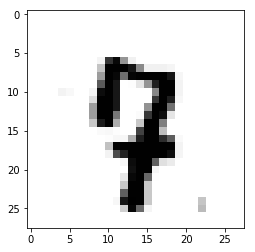

Pred value: 5
True value: 9


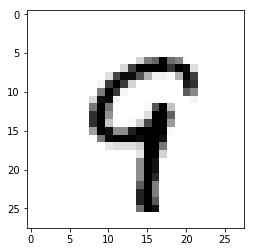

Pred value: 5
True value: 9


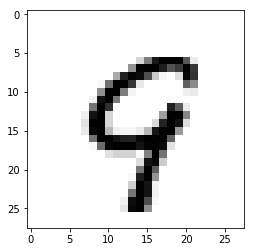

Pred value: 0
True value: 7


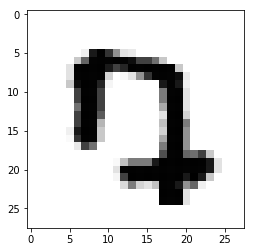

Pred value: 0
True value: 4


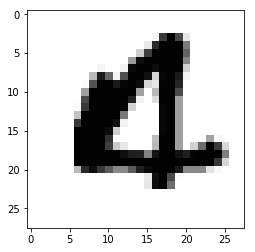

Pred value: 5
True value: 9


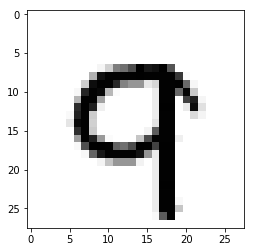

Pred value: 8
True value: 2


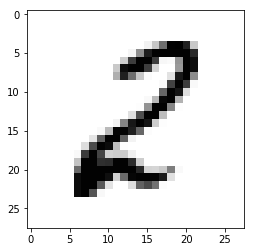

Pred value: 3
True value: 5


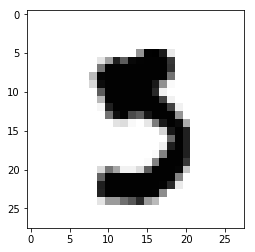

Pred value: 8
True value: 3


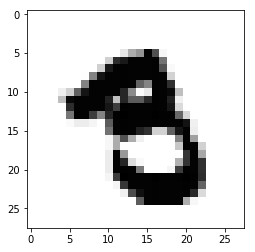

Pred value: 7
True value: 9


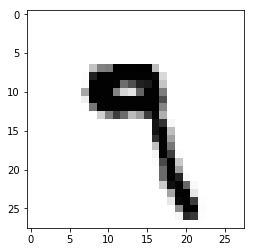

Pred value: 5
True value: 0


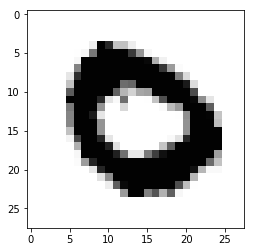

Pred value: 3
True value: 5


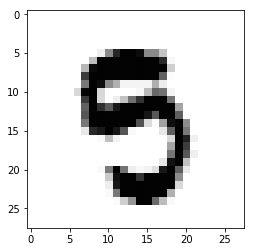

Pred value: 5
True value: 0


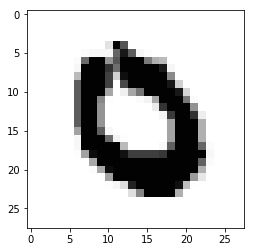

Pred value: 5
True value: 9


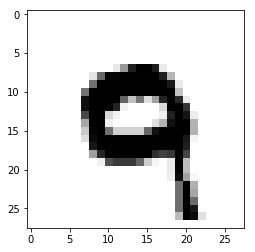

Pred value: 8
True value: 5


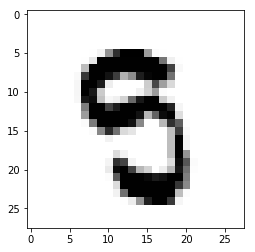

Pred value: 3
True value: 5


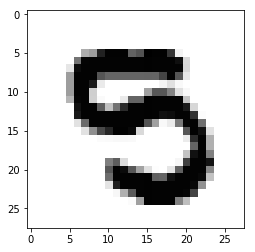

Pred value: 8
True value: 3


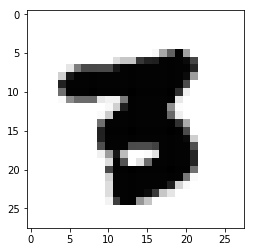

Pred value: 5
True value: 9


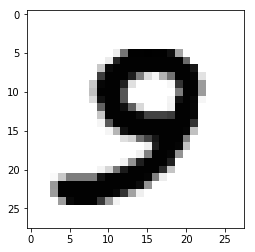

Pred value: 5
True value: 9


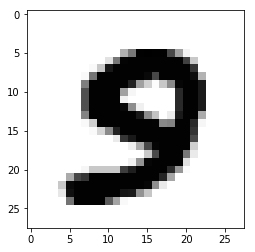

Pred value: 8
True value: 1


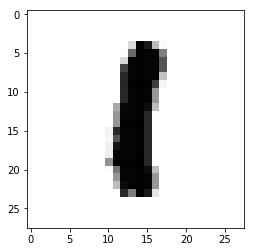

Pred value: 5
True value: 9


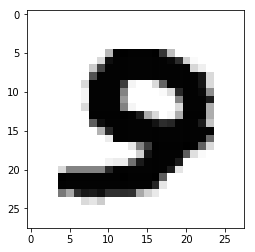

Pred value: 8
True value: 1


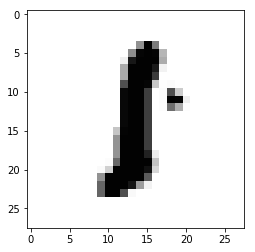

Pred value: 8
True value: 1


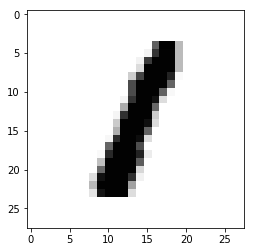

Pred value: 8
True value: 1


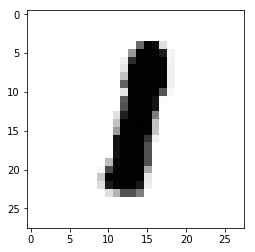

Pred value: 8
True value: 9


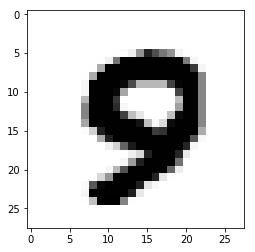

Pred value: 8
True value: 9


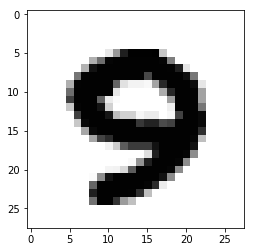

Pred value: 5
True value: 9


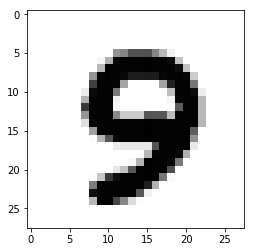

Pred value: 8
True value: 9


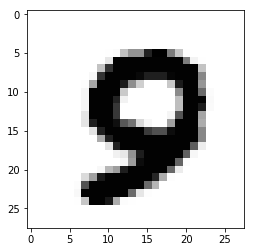

Pred value: 8
True value: 3


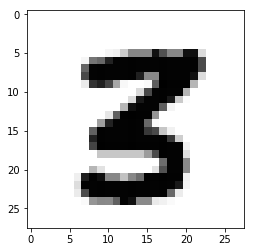

Pred value: 5
True value: 9


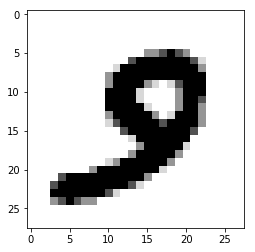

Pred value: 5
True value: 9


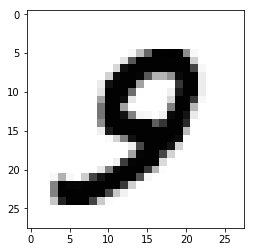

Pred value: 5
True value: 9


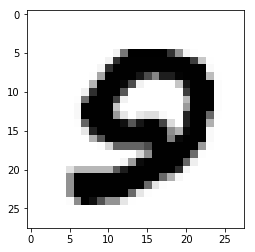

Pred value: 5
True value: 9


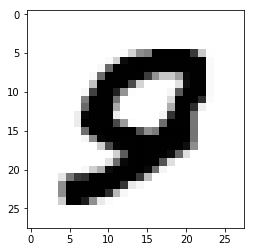

Pred value: 5
True value: 8


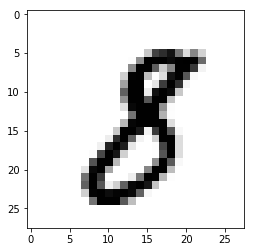

Pred value: 2
True value: 0


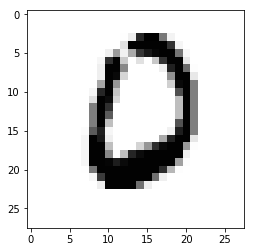

Pred value: 0
True value: 9


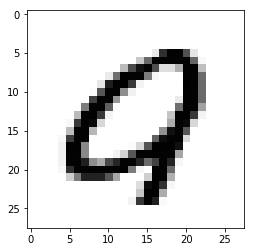

Pred value: 5
True value: 9


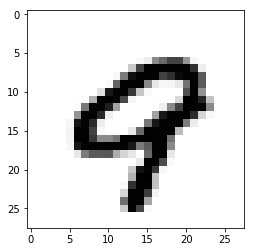

Pred value: 2
True value: 6


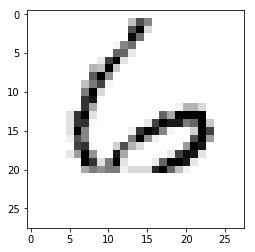

Pred value: 2
True value: 6


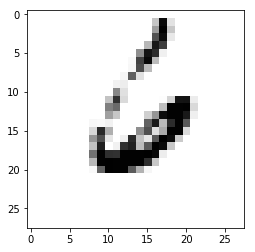

Pred value: 5
True value: 0


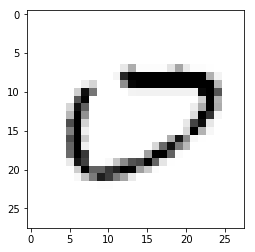

Pred value: 2
True value: 0


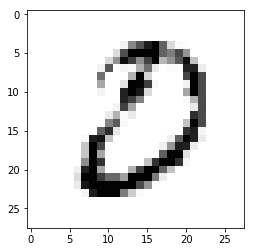

Pred value: 2
True value: 6


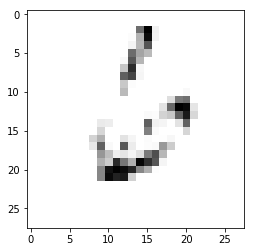

Pred value: 5
True value: 9


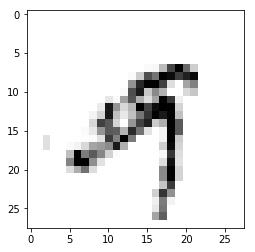

Pred value: 3
True value: 7


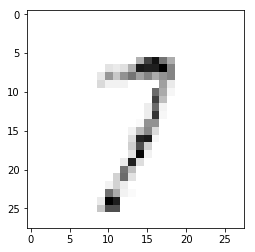

Pred value: 3
True value: 9


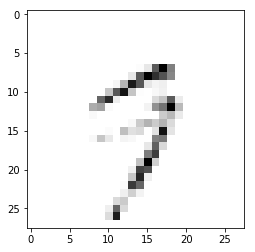

Pred value: 8
True value: 1


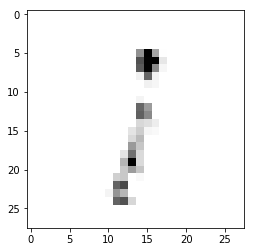

Pred value: 2
True value: 7


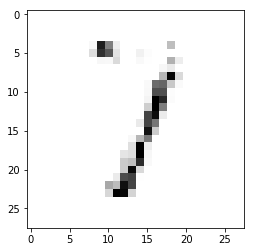

Pred value: 2
True value: 7


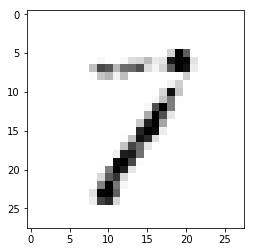

Pred value: 5
True value: 9


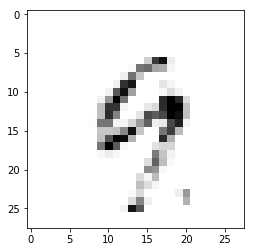

Pred value: 2
True value: 6


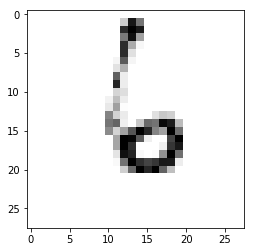

Pred value: 2
True value: 6


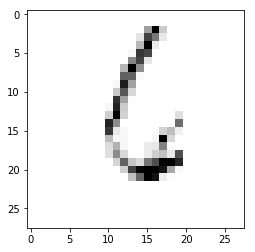

Pred value: 5
True value: 9


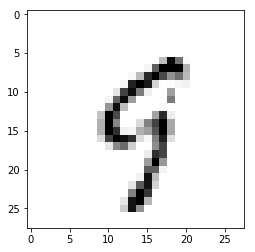

Pred value: 5
True value: 9


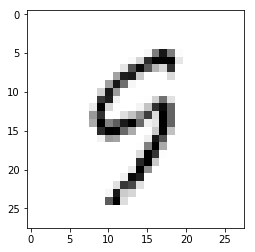

Pred value: 2
True value: 6


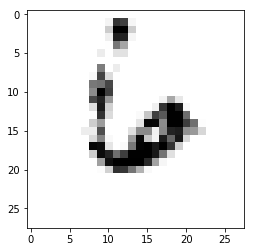

Pred value: 2
True value: 1


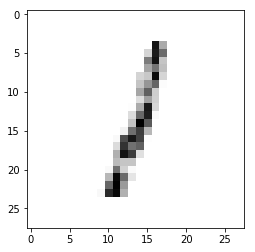

Pred value: 2
True value: 8


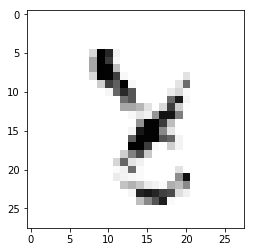

Pred value: 5
True value: 9


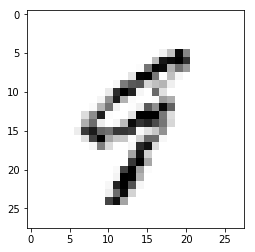

Pred value: 5
True value: 9


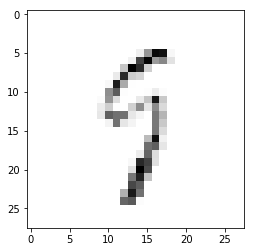

Pred value: 5
True value: 8


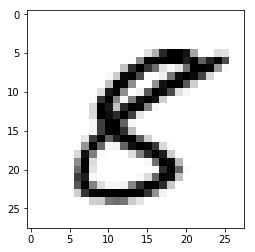

Pred value: 5
True value: 9


Pred value: 2
True value: 0


Pred value: 5
True value: 0


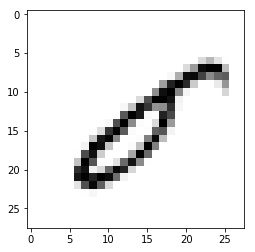

Pred value: 4
True value: 1


Pred value: 5
True value: 8


Pred value: 4
True value: 1


Pred value: 3
True value: 7


Pred value: 5
True value: 6


Pred value: 5
True value: 6


Pred value: 2
True value: 0


Pred value: 8
True value: 1


Pred value: 4
True value: 1


Pred value: 5
True value: 6


Pred value: 5
True value: 9


Pred value: 4
True value: 1


Pred value: 8
True value: 9


Pred value: 8
True value: 1


Pred value: 8
True value: 9


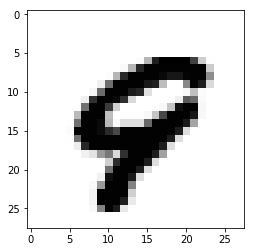

Pred value: 5
True value: 9


Pred value: 8
True value: 7


Pred value: 4
True value: 1


Pred value: 5
True value: 3


Pred value: 8
True value: 9


Pred value: 8
True value: 1


Pred value: 3
True value: 7


Pred value: 4
True value: 1


Pred value: 8
True value: 7


Pred value: 8
True value: 7


Pred value: 8
True value: 1


Pred value: 8
True value: 9


Pred value: 8
True value: 9


Pred value: 8
True value: 9


Pred value: 2
True value: 1


Pred value: 2
True value: 0


Pred value: 7
True value: 9


Pred value: 8
True value: 9


Pred value: 7
True value: 9


Pred value: 8
True value: 7


Pred value: 2
True value: 0


Pred value: 3
True value: 9


Pred value: 2
True value: 0


Pred value: 8
True value: 9


Pred value: 8
True value: 9


Pred value: 8
True value: 1


Pred value: 5
True value: 6


Pred value: 3
True value: 9


Pred value: 3
True value: 0


Pred value: 5
True value: 6


Pred value: 2
True value: 8


Pred value: 8
True value: 7


Pred value: 5
True value: 6


Pred value: 5
True value: 6


Pred value: 6
True value: 0


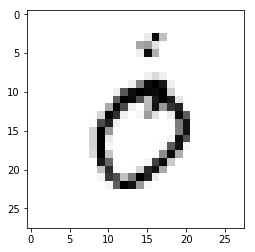

Pred value: 4
True value: 1


Pred value: 3
True value: 7


Pred value: 2
True value: 3


Pred value: 5
True value: 8


Pred value: 3
True value: 7


Pred value: 4
True value: 1


Pred value: 5
True value: 3


Pred value: 4
True value: 1


Pred value: 5
True value: 6


Pred value: 8
True value: 7


Pred value: 4
True value: 1


Pred value: 5
True value: 8


Pred value: 5
True value: 7


Pred value: 8
True value: 7


Pred value: 8
True value: 9


Pred value: 8
True value: 7


Pred value: 8
True value: 7


Pred value: 8
True value: 5


Pred value: 2
True value: 6


Pred value: 5
True value: 1


Pred value: 2
True value: 6


Pred value: 4
True value: 1


Pred value: 5
True value: 9


Pred value: 2
True value: 6


Pred value: 2
True value: 7


Pred value: 5
True value: 8


Pred value: 5
True value: 4


Pred value: 2
True value: 7


Pred value: 2
True value: 0


Pred value: 8
True value: 7


Pred value: 2
True value: 0


Pred value: 5
True value: 1


Pred value: 2
True value: 0


Pred value: 5
True value: 9


Pred value: 2
True value: 6


Pred value: 4
True value: 1


Pred value: 5
True value: 9


Pred value: 2
True value: 0


Pred value: 5
True value: 1


Pred value: 5
True value: 9


Pred value: 5
True value: 4


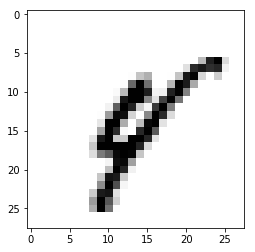

Pred value: 5
True value: 9


Pred value: 5
True value: 9


Pred value: 2
True value: 7


Pred value: 2
True value: 0


Pred value: 2
True value: 0


Pred value: 2
True value: 6


Pred value: 2
True value: 1


Pred value: 8
True value: 9


Pred value: 5
True value: 9


Pred value: 8
True value: 9


Pred value: 8
True value: 9


Pred value: 8
True value: 1


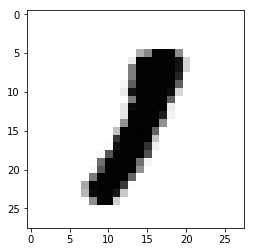

Pred value: 8
True value: 1


Pred value: 2
True value: 3


Pred value: 8
True value: 1


Pred value: 8
True value: 1


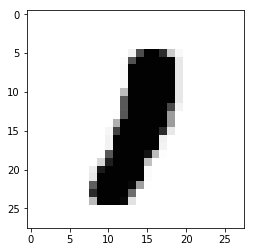

Pred value: 8
True value: 9


Pred value: 2
True value: 3


Pred value: 8
True value: 1


Pred value: 8
True value: 9


Pred value: 8
True value: 1


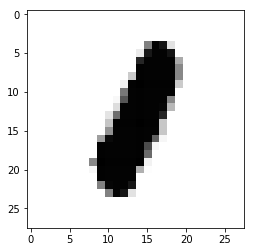

Pred value: 5
True value: 3


Pred value: 8
True value: 1


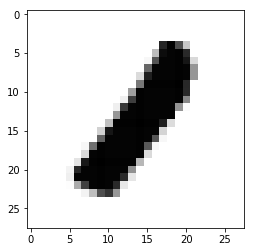

Pred value: 5
True value: 3


Pred value: 8
True value: 9


Pred value: 8
True value: 1


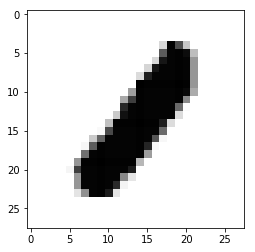

Pred value: 8
True value: 9


Pred value: 8
True value: 9


Pred value: 5
True value: 9


Pred value: 5
True value: 3


Pred value: 8
True value: 9


Pred value: 8
True value: 9


Pred value: 8
True value: 1


Pred value: 8
True value: 1


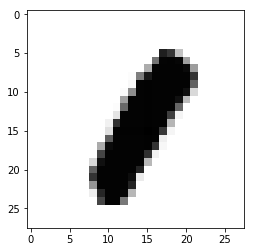

Pred value: 8
True value: 1


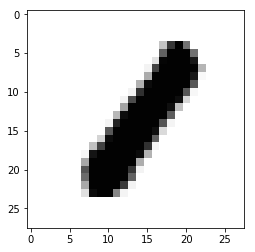

Pred value: 8
True value: 7


Pred value: 4
True value: 1


Pred value: 8
True value: 7


Pred value: 8
True value: 1


KeyboardInterrupt: ignored

In [0]:
# Loading dataset
(train_x, y_train), (test_x, y_test) = tf.keras.datasets.mnist.load_data()
# Reshaping the array to 4-dims so that it can work with the Keras API
x_train = train_x.reshape(train_x.shape[0], 28, 28, 1)
x_test = test_x.reshape(test_x.shape[0], 28, 28, 1)
input_shape = (28, 28, 1)
# Making sure that the values are float so that we can get decimal points after division
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
# Normalizing the RGB codes by dividing it to the max RGB value.
#x_train /= 255
#x_test /= 255
print('x_train shape:', x_train.shape)
print('Number of images in x_train', x_train.shape[0])
print('Number of images in x_test', x_test.shape[0])
# Creating a Sequential Model and adding the layers
model = Sequential()
#model.add(Conv2D(28, kernel_size=(5,5), input_shape=input_shape))
#model.add(MaxPooling2D(pool_size=(2, 2)))
#model.add(Conv2D(28, kernel_size=(3,3), input_shape=input_shape))
#model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(28, kernel_size=(5,1)))
model.add(Conv2D(28, kernel_size=(1,5)))
model.add(MaxPooling2D(pool_size=(4, 4)))
model.add(Conv2D(28, kernel_size=(3,1)))
model.add(Conv2D(28, kernel_size=(1,3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten()) # Flattening the 2D arrays for fully connected layers
#model.add(Dense(128, activation=tf.nn.relu))
model.add(Dropout(0.2))      
model.add(Dense(10,activation=tf.nn.softmax))
model.compile(optimizer='adam', 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)
his = model.fit(x=x_train,y=y_train, epochs=10)
_, train_acc = model.evaluate(x_train, y_train, verbose=0)
_, test_acc = model.evaluate(x_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
y_pred = model.predict(x_test)
print(y_pred.shape)
print(y_test.shape)
y = np.argmax(y_pred, axis=1)
print(y.shape)
confusion_matrix(y_test, y)
for i in range(10000):
    if(y[i] != y_test[i]):
        print("Pred value:",y[i])
        print("True value:",y_test[i])
        plt.figure
        plt.imshow(x_test[i].reshape(28, 28),cmap='Greys')
        plt.show()

x_train shape: (60000, 28, 28, 1)
Number of images in x_train 60000
Number of images in x_test 10000
Epoch 1/50
60000/60000 [==============================] - 66s 1ms/step - loss: 7.7968 - acc: 0.5120
Epoch 2/50
60000/60000 [==============================] - 66s 1ms/step - loss: 4.7276 - acc: 0.7049
Epoch 3/50
60000/60000 [==============================] - 67s 1ms/step - loss: 3.6139 - acc: 0.7741
Epoch 4/50
60000/60000 [==============================] - 66s 1ms/step - loss: 2.4388 - acc: 0.8474
Epoch 5/50
60000/60000 [==============================] - 65s 1ms/step - loss: 2.2817 - acc: 0.8577
Epoch 6/50
60000/60000 [==============================] - 65s 1ms/step - loss: 2.3699 - acc: 0.8525
Epoch 7/50
60000/60000 [==============================] - 66s 1ms/step - loss: 2.3242 - acc: 0.8553
Epoch 8/50
60000/60000 [==============================] - 65s 1ms/step - loss: 2.1535 - acc: 0.8659
Epoch 9/50
60000/60000 [==============================] - 65s 1ms/step - loss: 2.0718 - acc: 0.8712

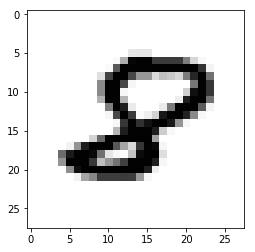

Pred value: 5
True value: 8


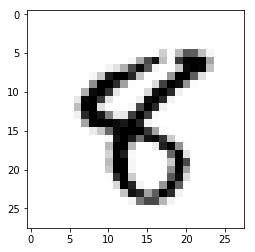

Pred value: 3
True value: 7


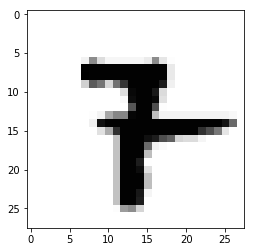

Pred value: 3
True value: 8


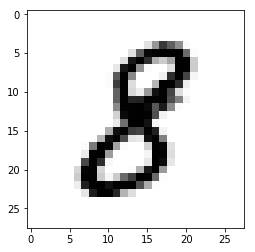

Pred value: 5
True value: 7


Pred value: 9
True value: 2


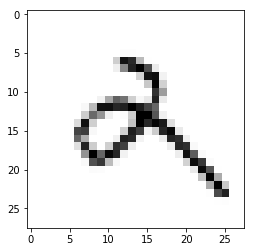

Pred value: 3
True value: 8


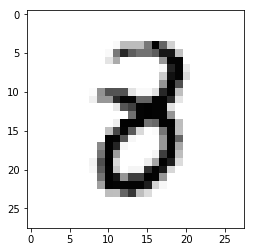

Pred value: 5
True value: 6


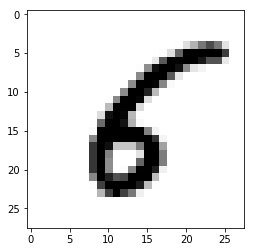

Pred value: 3
True value: 2


Pred value: 9
True value: 8


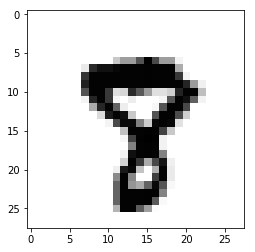

Pred value: 1
True value: 8


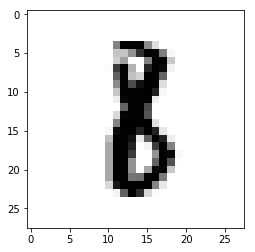

Pred value: 0
True value: 6


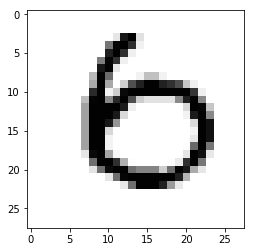

Pred value: 0
True value: 8


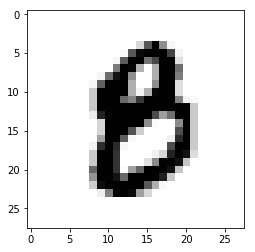

Pred value: 5
True value: 8


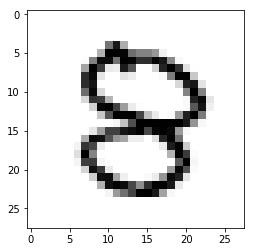

Pred value: 3
True value: 7


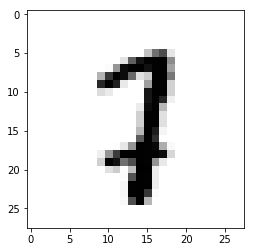

Pred value: 5
True value: 8


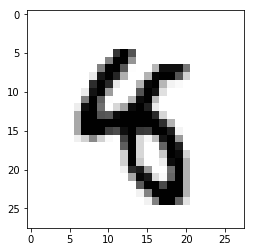

Pred value: 3
True value: 8


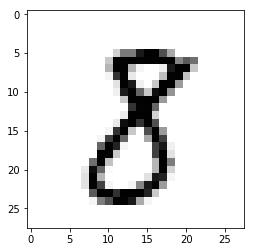

Pred value: 3
True value: 2


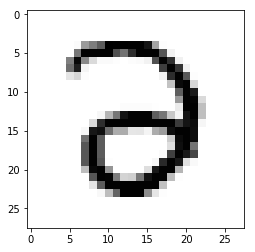

Pred value: 7
True value: 9


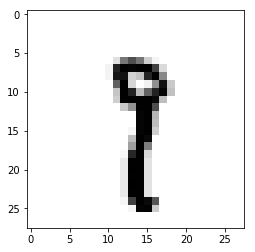

Pred value: 5
True value: 8


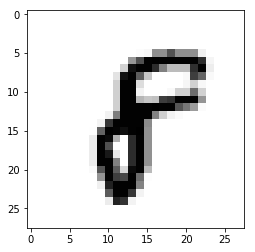

Pred value: 9
True value: 4


Pred value: 5
True value: 6


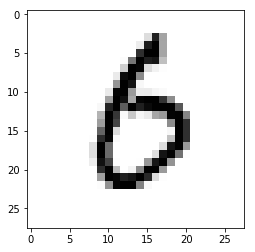

Pred value: 3
True value: 8


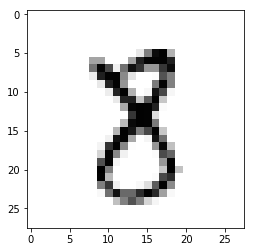

Pred value: 9
True value: 8


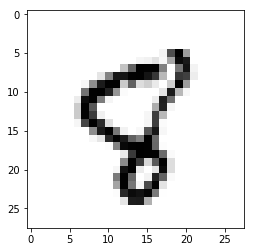

Pred value: 7
True value: 8


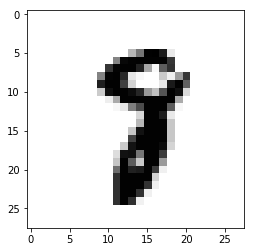

Pred value: 0
True value: 6


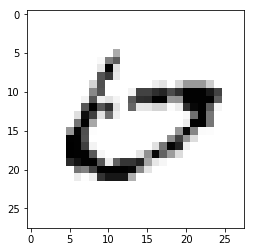

Pred value: 9
True value: 4


Pred value: 5
True value: 3


Pred value: 5
True value: 6


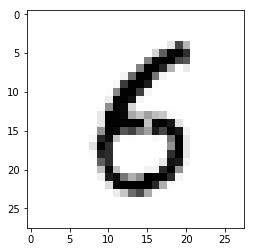

Pred value: 9
True value: 8


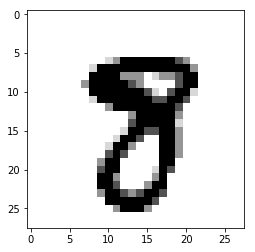

Pred value: 5
True value: 8


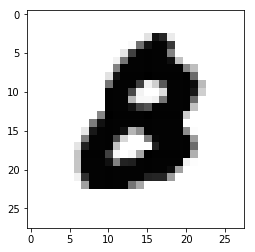

Pred value: 5
True value: 6


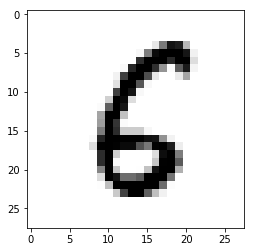

Pred value: 7
True value: 4


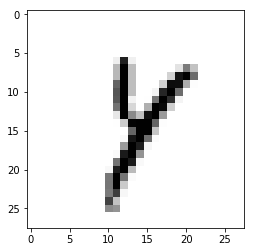

Pred value: 5
True value: 8


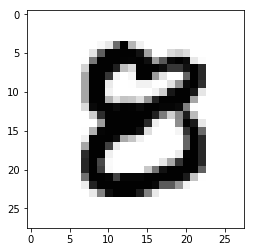

Pred value: 3
True value: 2


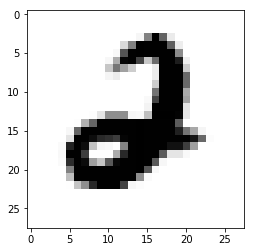

Pred value: 4
True value: 8


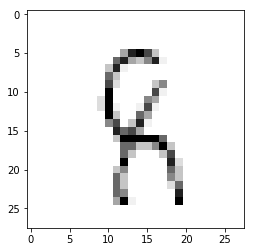

Pred value: 2
True value: 8


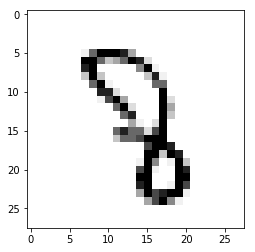

Pred value: 9
True value: 7


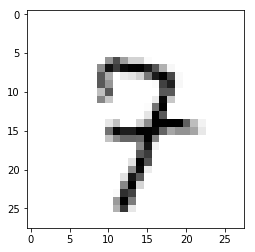

Pred value: 3
True value: 7


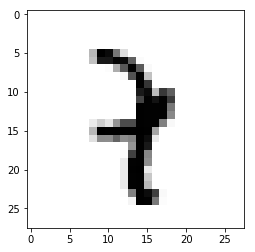

Pred value: 5
True value: 0


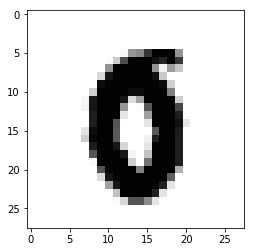

Pred value: 5
True value: 8


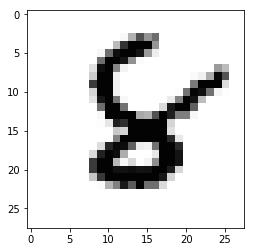

Pred value: 9
True value: 8


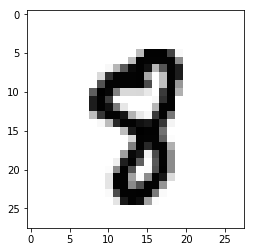

Pred value: 2
True value: 3


Pred value: 3
True value: 8


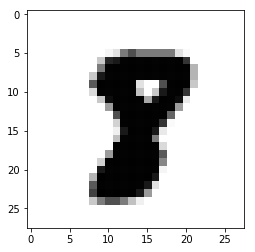

Pred value: 3
True value: 8


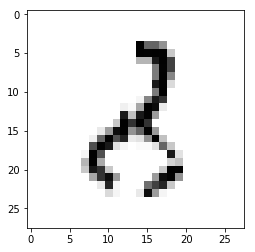

Pred value: 3
True value: 2


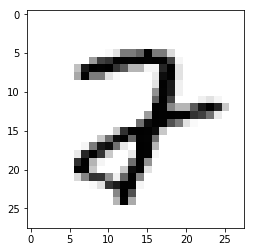

Pred value: 3
True value: 8


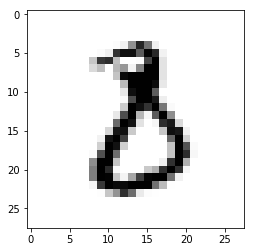

Pred value: 9
True value: 7


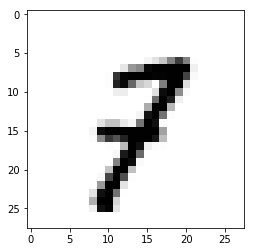

Pred value: 3
True value: 8


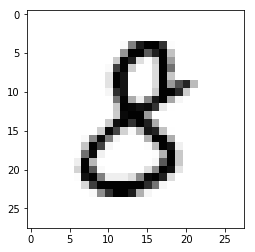

Pred value: 9
True value: 0


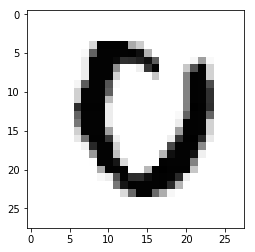

Pred value: 3
True value: 2


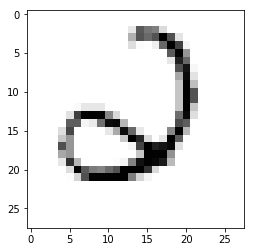

Pred value: 3
True value: 8


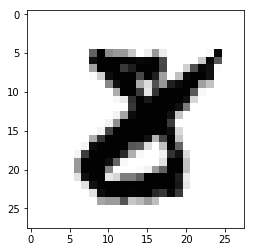

Pred value: 9
True value: 7


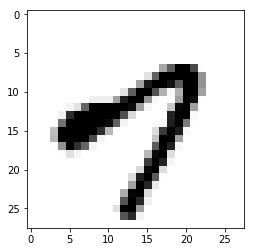

Pred value: 7
True value: 2


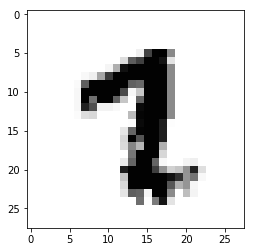

Pred value: 3
True value: 5


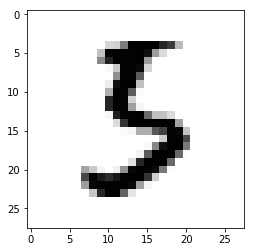

Pred value: 3
True value: 7


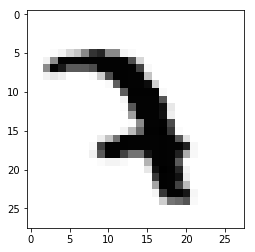

Pred value: 9
True value: 7


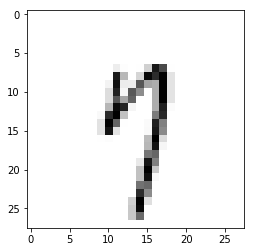

Pred value: 4
True value: 8


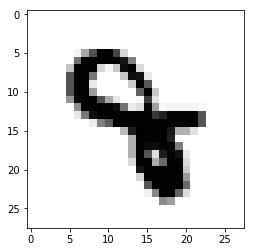

Pred value: 1
True value: 8


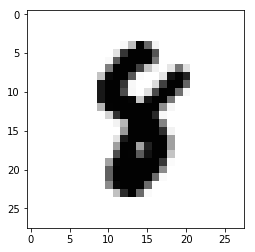

Pred value: 9
True value: 4


Pred value: 2
True value: 8


Pred value: 7
True value: 1


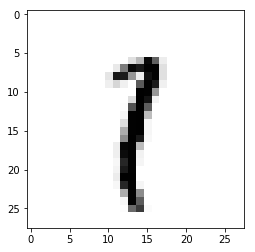

Pred value: 5
True value: 0


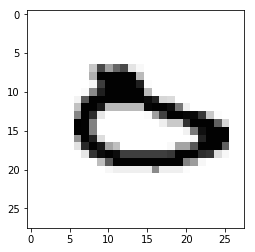

Pred value: 8
True value: 5


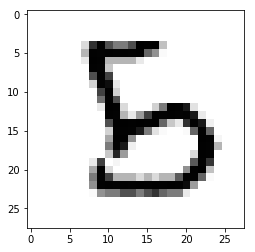

Pred value: 5
True value: 7


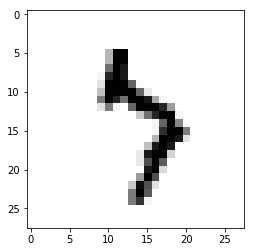

Pred value: 9
True value: 4


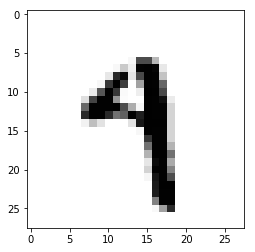

Pred value: 5
True value: 8


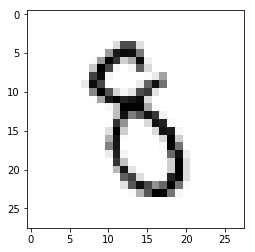

Pred value: 5
True value: 6


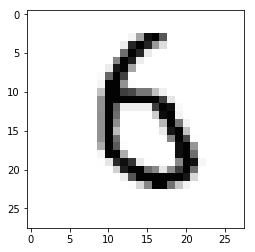

Pred value: 5
True value: 8


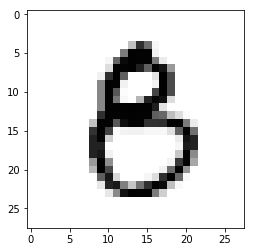

Pred value: 2
True value: 7


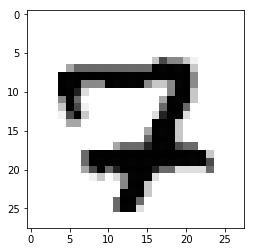

Pred value: 3
True value: 8


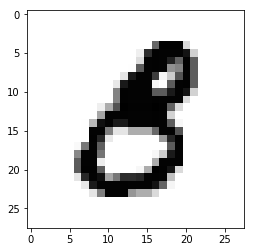

Pred value: 7
True value: 8


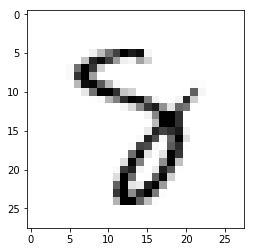

Pred value: 9
True value: 7


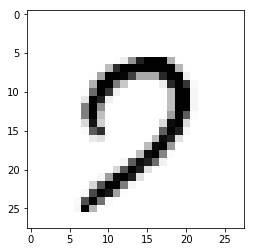

Pred value: 5
True value: 8


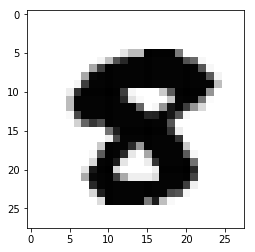

Pred value: 5
True value: 8


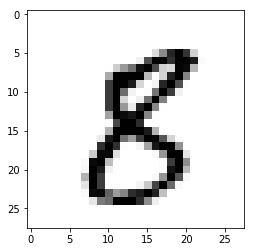

Pred value: 9
True value: 4


Pred value: 3
True value: 7


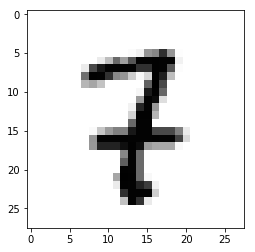

Pred value: 3
True value: 8


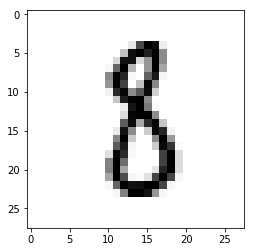

Pred value: 5
True value: 8


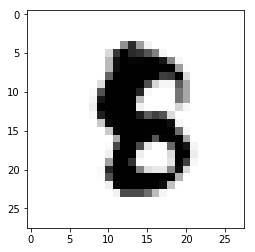

Pred value: 9
True value: 8


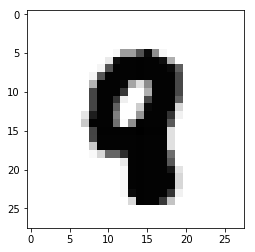

Pred value: 9
True value: 7


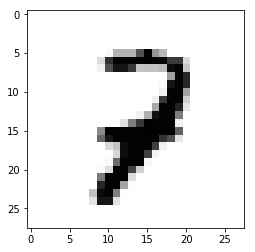

Pred value: 3
True value: 1


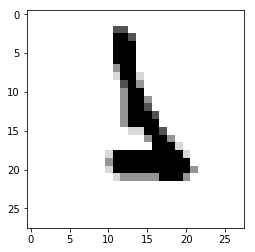

Pred value: 9
True value: 7


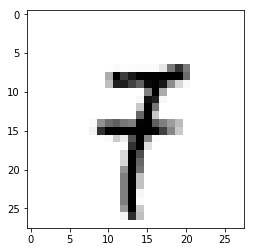

Pred value: 0
True value: 6


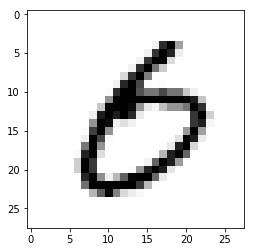

Pred value: 3
True value: 2


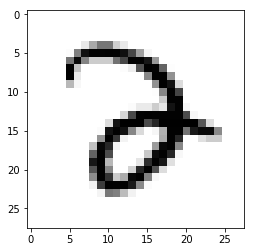

Pred value: 5
True value: 8


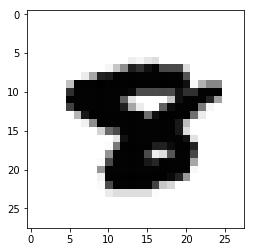

Pred value: 9
True value: 8


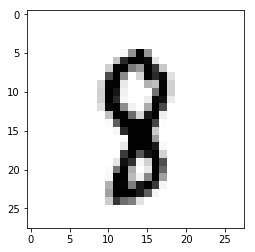

Pred value: 9
True value: 7


Pred value: 5
True value: 6


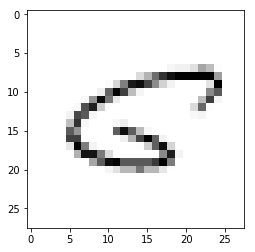

Pred value: 9
True value: 8


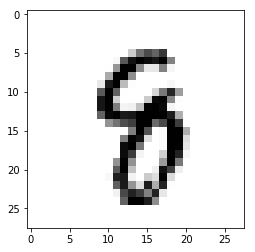

Pred value: 9
True value: 8


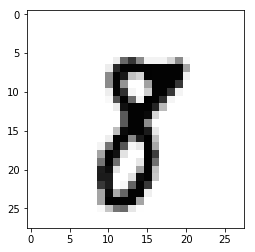

Pred value: 3
True value: 8


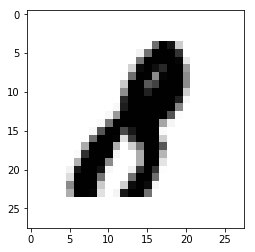

Pred value: 4
True value: 7


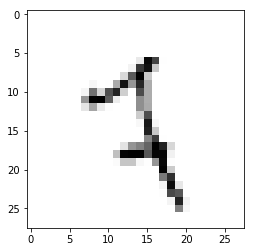

Pred value: 3
True value: 2


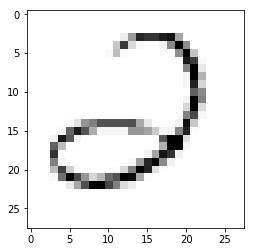

Pred value: 5
True value: 8


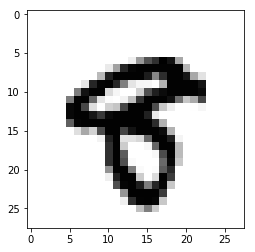

Pred value: 9
True value: 7


Pred value: 9
True value: 3


Pred value: 4
True value: 8


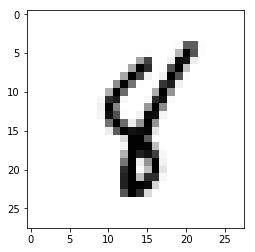

Pred value: 2
True value: 8


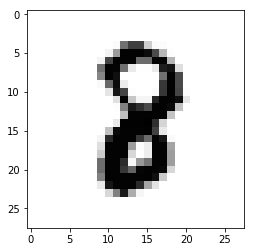

Pred value: 9
True value: 7


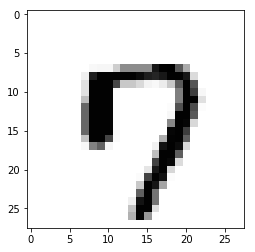

Pred value: 5
True value: 8


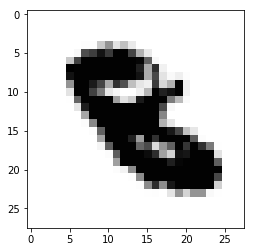

Pred value: 6
True value: 4


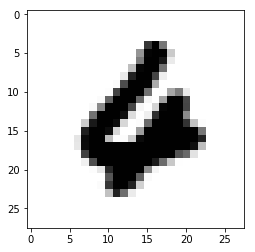

Pred value: 9
True value: 8


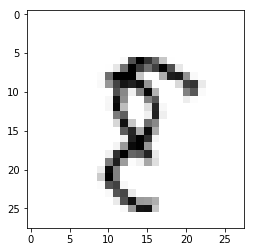

Pred value: 3
True value: 7


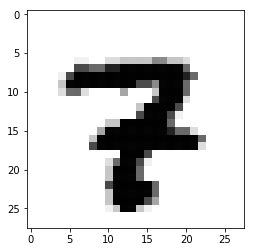

Pred value: 5
True value: 6


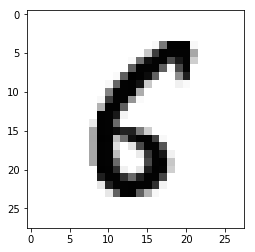

Pred value: 5
True value: 6


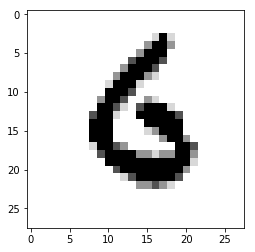

Pred value: 5
True value: 8


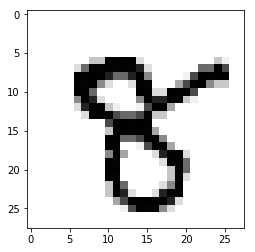

Pred value: 9
True value: 7


Pred value: 5
True value: 6


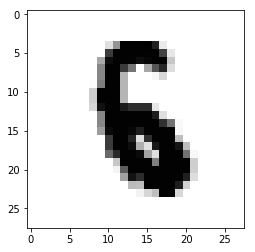

Pred value: 5
True value: 8


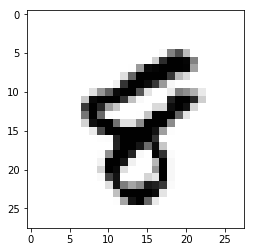

Pred value: 5
True value: 0


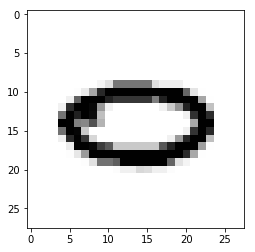

Pred value: 5
True value: 8


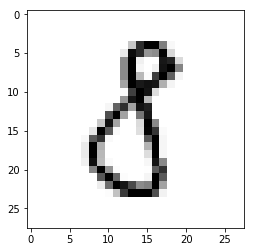

Pred value: 5
True value: 8


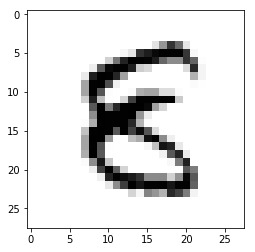

Pred value: 2
True value: 7


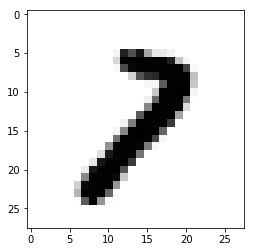

Pred value: 5
True value: 6


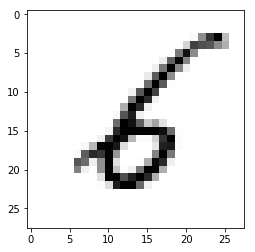

Pred value: 2
True value: 8


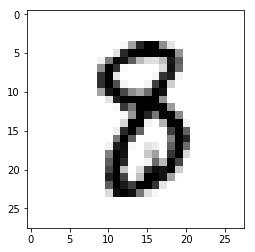

Pred value: 2
True value: 7


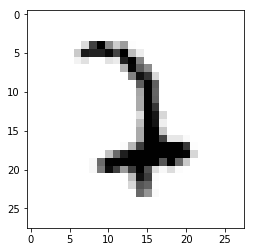

Pred value: 3
True value: 9


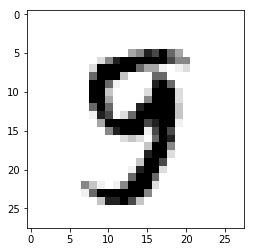

Pred value: 2
True value: 8


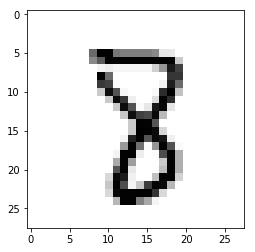

Pred value: 1
True value: 9


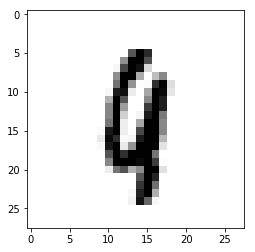

Pred value: 5
True value: 8


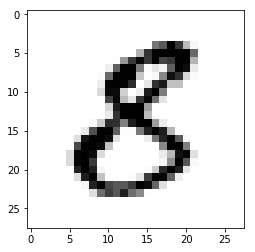

Pred value: 9
True value: 4


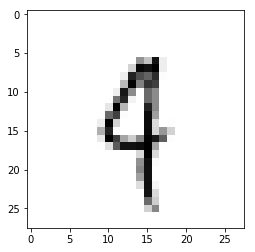

Pred value: 5
True value: 9


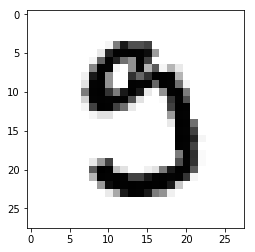

Pred value: 3
True value: 8


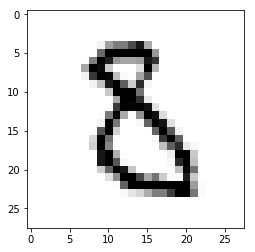

Pred value: 5
True value: 0


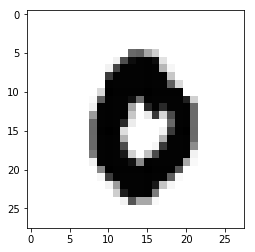

Pred value: 2
True value: 7


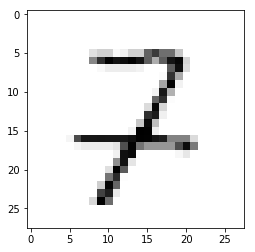

Pred value: 5
True value: 8


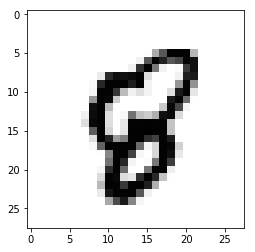

Pred value: 3
True value: 8


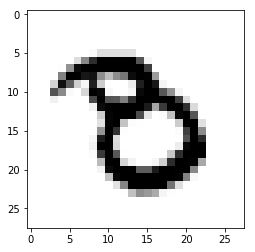

Pred value: 2
True value: 8


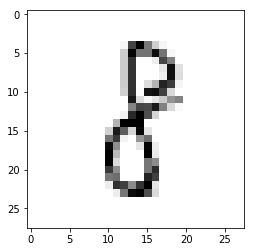

Pred value: 5
True value: 8


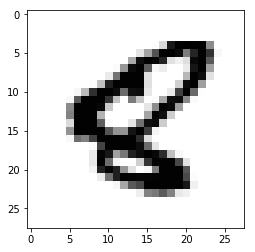

Pred value: 2
True value: 7


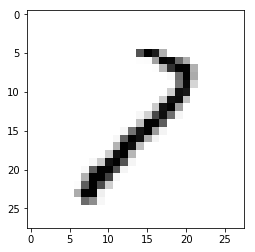

Pred value: 9
True value: 7


Pred value: 2
True value: 8


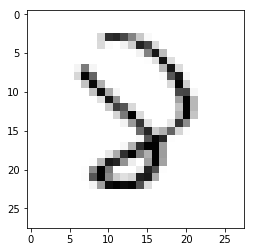

Pred value: 3
True value: 2


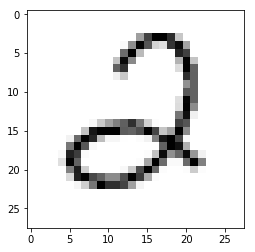

Pred value: 5
True value: 6


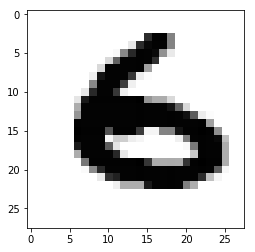

Pred value: 3
True value: 5


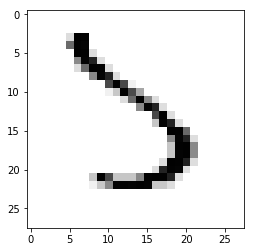

Pred value: 3
True value: 2


Pred value: 3
True value: 8


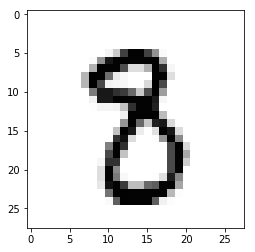

Pred value: 6
True value: 1


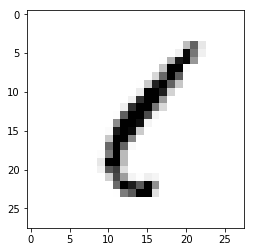

Pred value: 5
True value: 8


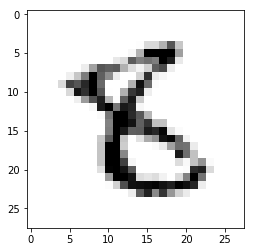

Pred value: 6
True value: 8


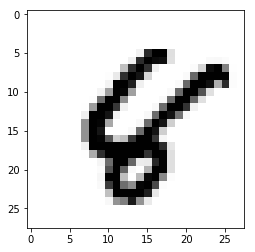

Pred value: 3
True value: 8


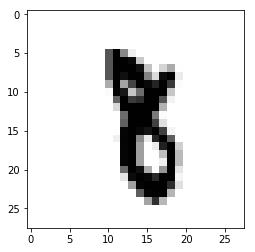

Pred value: 5
True value: 0


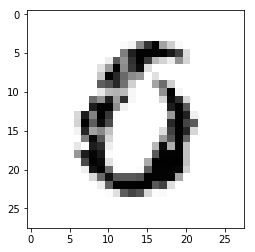

Pred value: 9
True value: 8


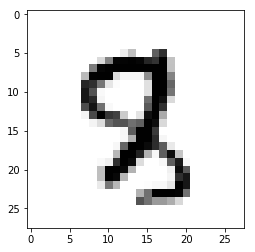

Pred value: 9
True value: 4


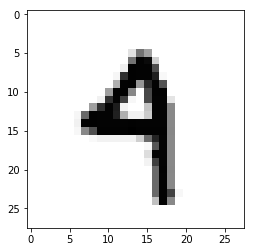

Pred value: 5
True value: 6


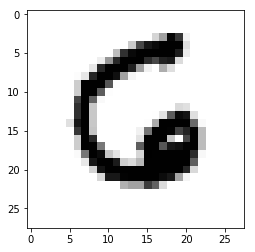

Pred value: 3
True value: 2


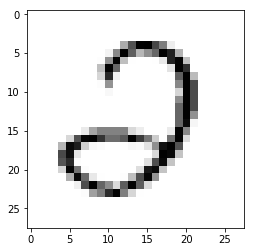

Pred value: 3
True value: 8


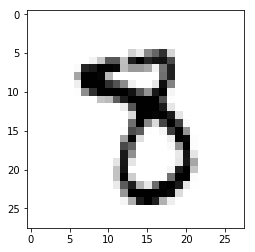

Pred value: 3
True value: 8


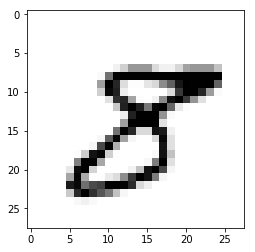

Pred value: 2
True value: 8


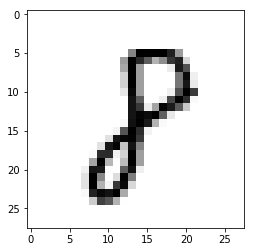

Pred value: 3
True value: 8


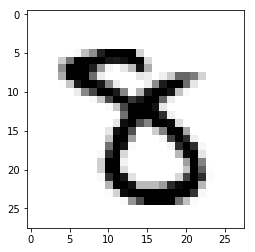

Pred value: 2
True value: 7


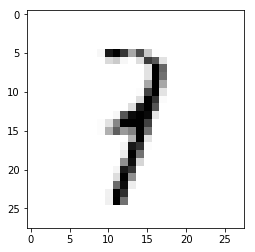

Pred value: 5
True value: 8


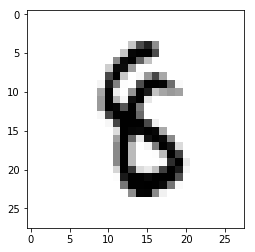

Pred value: 9
True value: 7


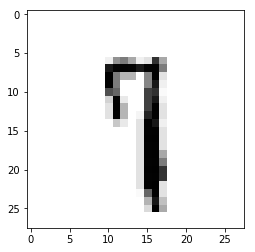

Pred value: 5
True value: 8


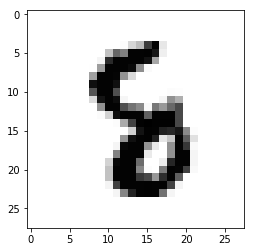

Pred value: 3
True value: 1


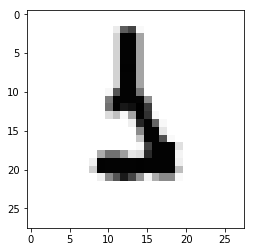

Pred value: 7
True value: 8


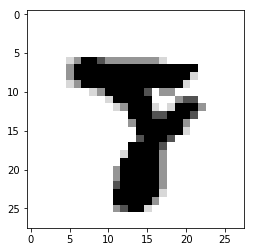

Pred value: 3
True value: 9


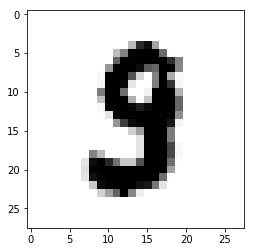

Pred value: 9
True value: 8


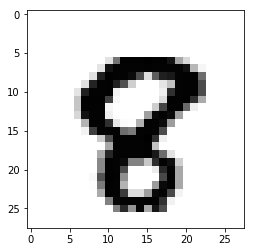

Pred value: 9
True value: 0


Pred value: 3
True value: 9


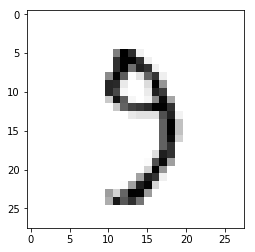

Pred value: 5
True value: 8


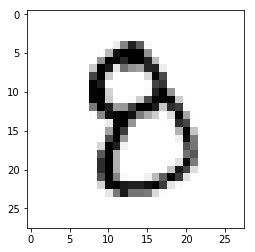

Pred value: 5
True value: 8


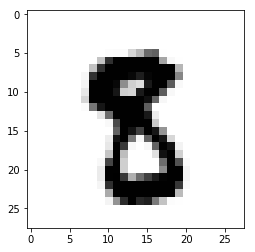

Pred value: 9
True value: 8


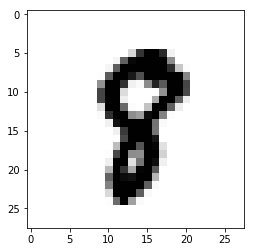

Pred value: 9
True value: 7


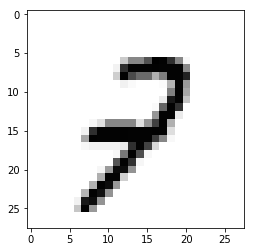

Pred value: 2
True value: 8


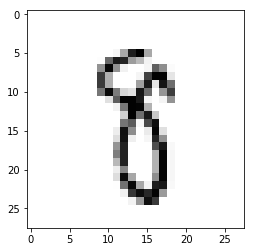

Pred value: 9
True value: 8


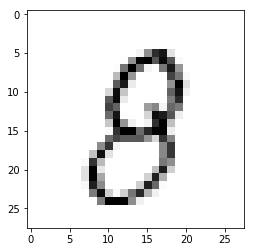

Pred value: 5
True value: 6


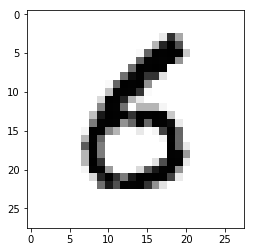

Pred value: 5
True value: 2


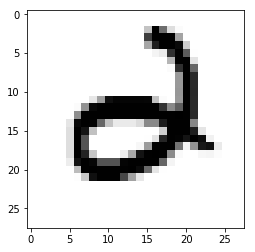

Pred value: 6
True value: 0


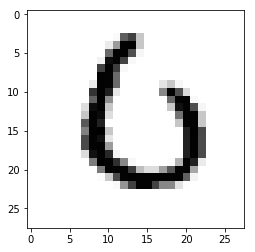

Pred value: 5
True value: 6


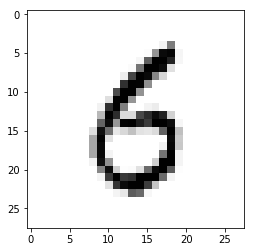

Pred value: 7
True value: 4


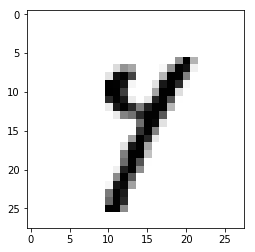

Pred value: 2
True value: 7


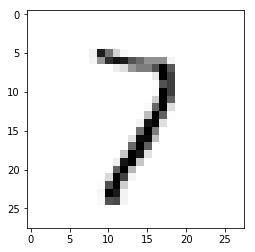

Pred value: 3
True value: 8


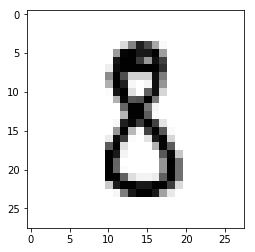

Pred value: 5
True value: 7


Pred value: 5
True value: 6


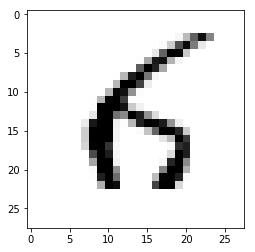

Pred value: 7
True value: 3


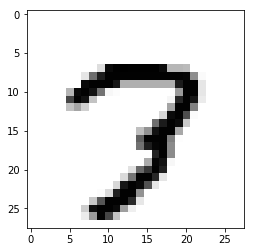

Pred value: 5
True value: 8


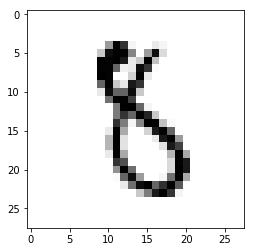

Pred value: 1
True value: 8


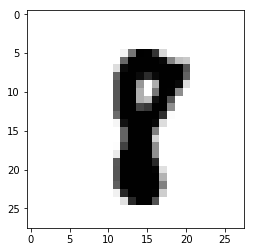

Pred value: 2
True value: 8


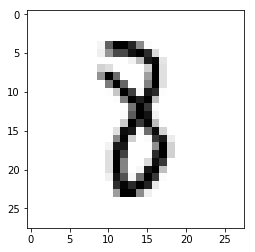

Pred value: 3
True value: 8


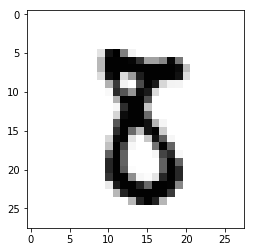

Pred value: 5
True value: 9


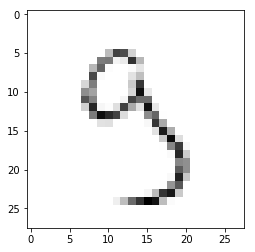

Pred value: 0
True value: 8


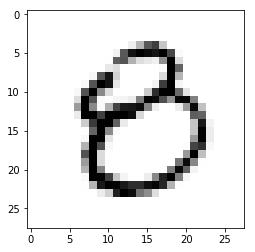

Pred value: 3
True value: 7


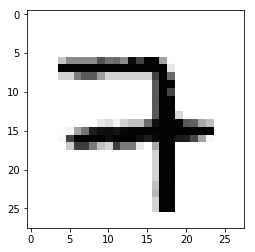

Pred value: 9
True value: 7


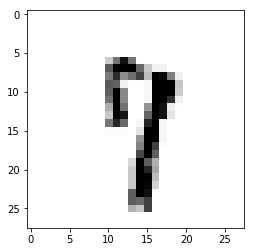

Pred value: 4
True value: 2


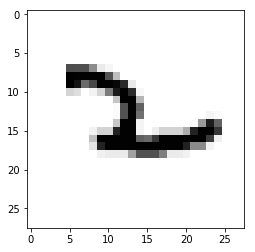

Pred value: 2
True value: 5


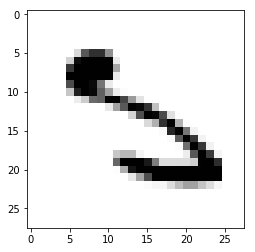

Pred value: 5
True value: 8


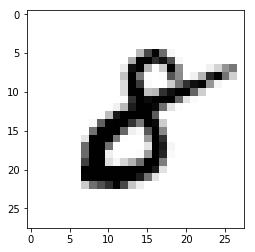

Pred value: 9
True value: 0


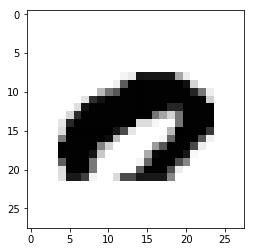

Pred value: 2
True value: 7


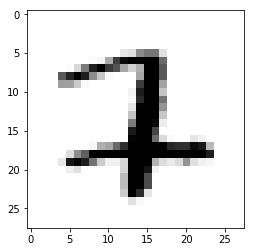

Pred value: 5
True value: 8


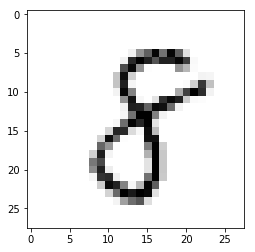

Pred value: 5
True value: 8


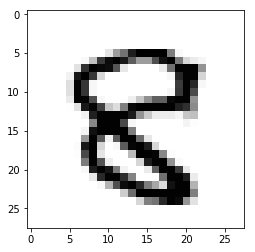

Pred value: 5
True value: 8


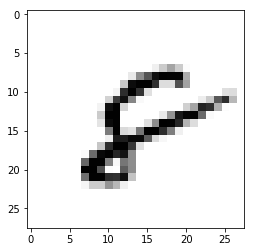

Pred value: 4
True value: 7


Pred value: 5
True value: 8


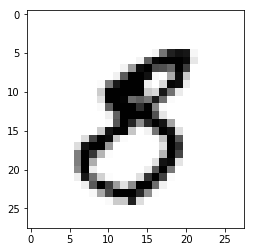

Pred value: 4
True value: 8


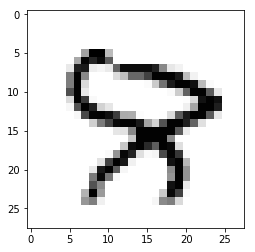

Pred value: 7
True value: 2


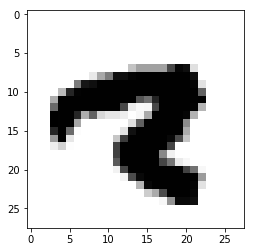

Pred value: 4
True value: 6


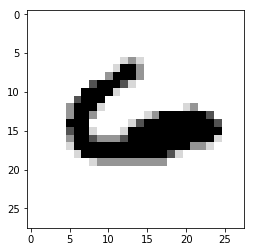

Pred value: 6
True value: 0


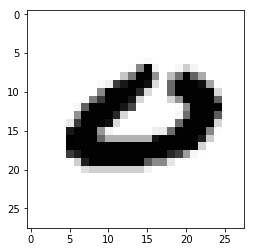

Pred value: 3
True value: 2


Pred value: 5
True value: 8


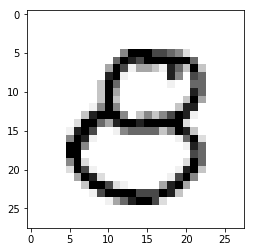

Pred value: 5
True value: 6


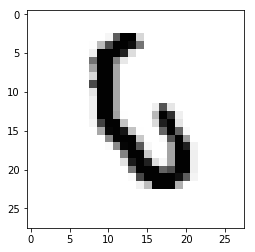

Pred value: 7
True value: 8


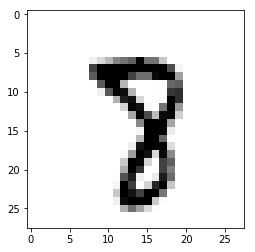

Pred value: 4
True value: 8


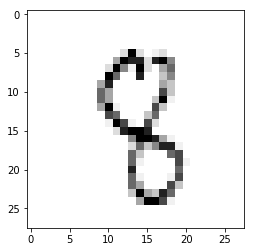

Pred value: 4
True value: 1


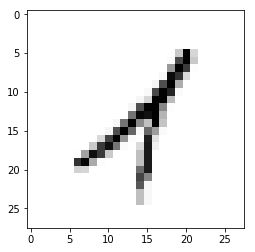

Pred value: 3
True value: 8


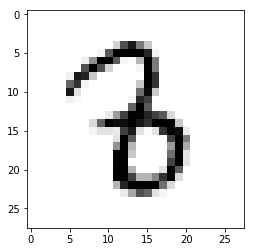

Pred value: 3
True value: 8


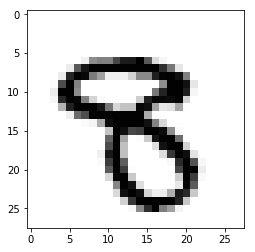

Pred value: 3
True value: 8


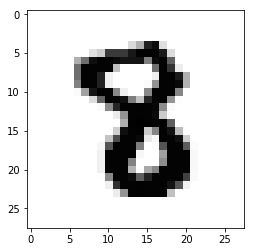

Pred value: 3
True value: 8


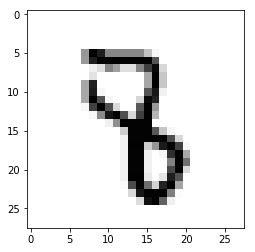

Pred value: 4
True value: 9


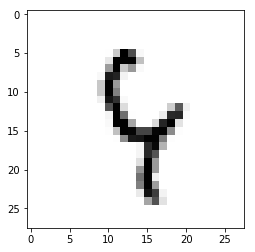

Pred value: 4
True value: 7


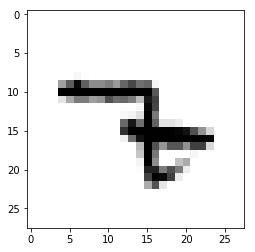

Pred value: 4
True value: 2


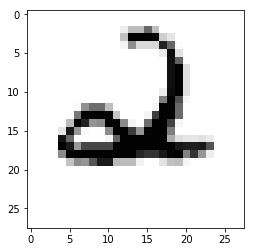

Pred value: 2
True value: 7


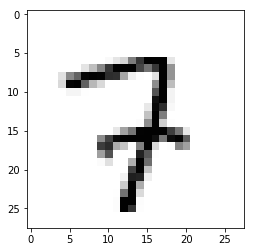

Pred value: 4
True value: 7


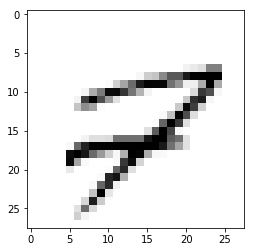

Pred value: 3
True value: 8


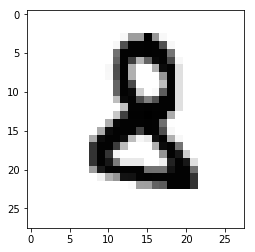

Pred value: 9
True value: 8


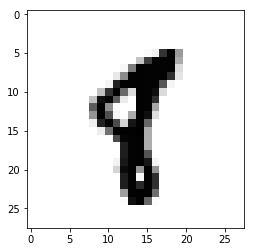

Pred value: 5
True value: 8


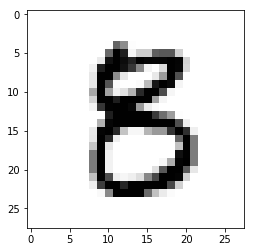

Pred value: 5
True value: 2


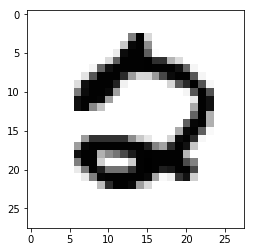

Pred value: 9
True value: 5


Pred value: 9
True value: 8


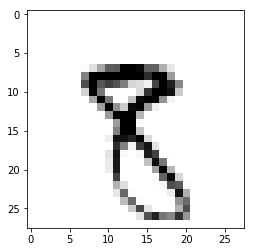

Pred value: 2
True value: 7


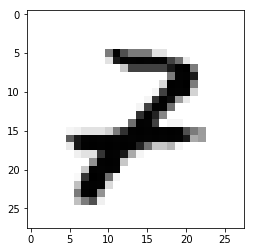

Pred value: 9
True value: 7


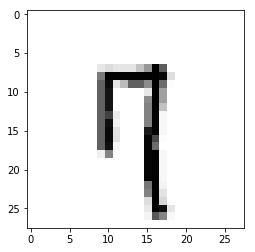

Pred value: 2
True value: 8


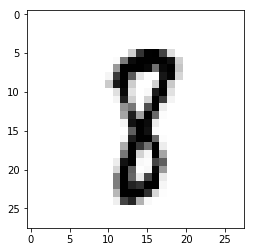

Pred value: 8
True value: 4


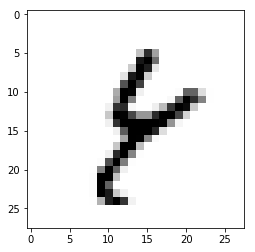

Pred value: 5
True value: 6


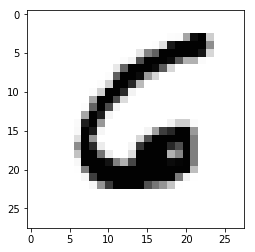

Pred value: 9
True value: 7


Pred value: 9
True value: 8


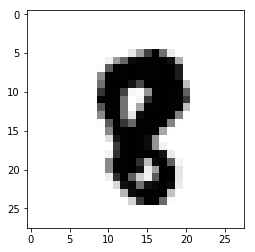

Pred value: 4
True value: 8


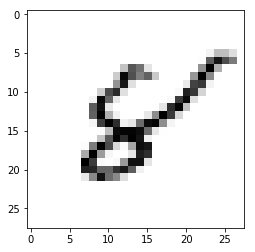

Pred value: 9
True value: 4


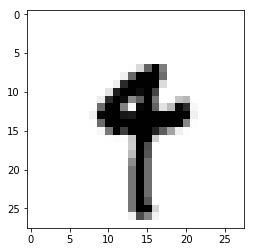

Pred value: 9
True value: 7


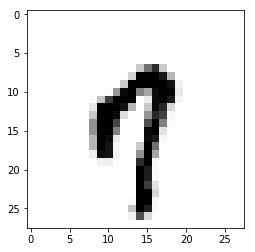

Pred value: 2
True value: 8


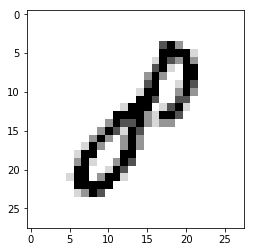

Pred value: 2
True value: 7


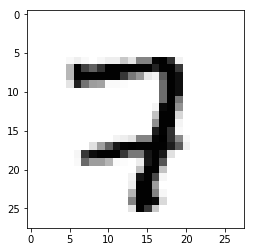

Pred value: 0
True value: 2


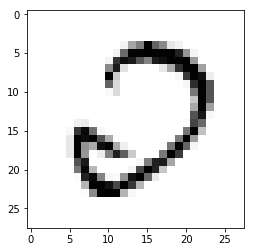

Pred value: 5
True value: 8


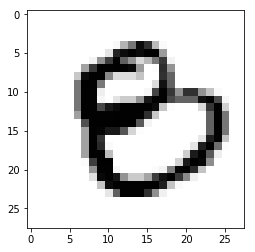

Pred value: 4
True value: 3


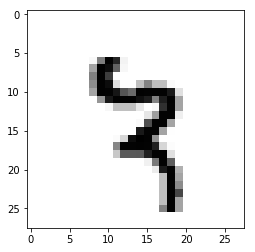

Pred value: 5
True value: 6


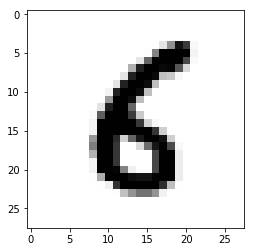

Pred value: 5
True value: 6


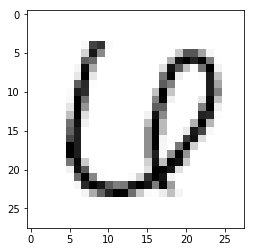

Pred value: 9
True value: 5


Pred value: 9
True value: 4


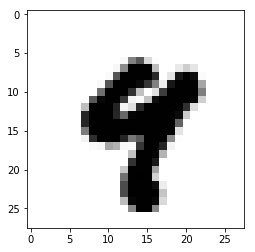

Pred value: 1
True value: 6


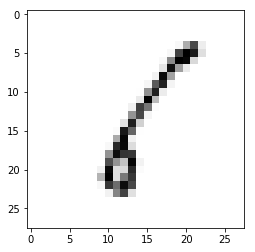

Pred value: 3
True value: 8


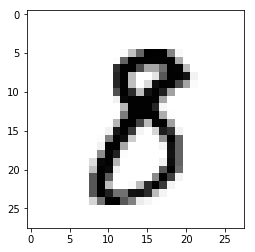

Pred value: 2
True value: 8


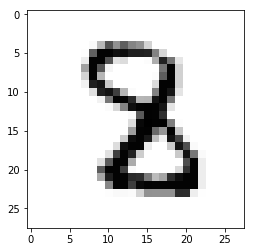

Pred value: 3
True value: 8


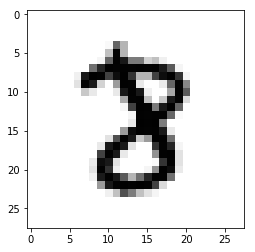

Pred value: 3
True value: 1


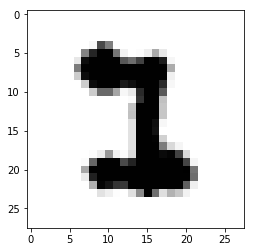

Pred value: 3
True value: 2


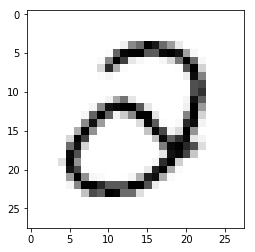

Pred value: 1
True value: 9


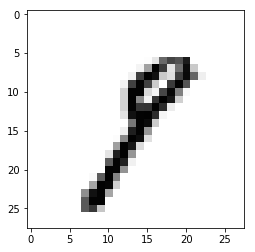

Pred value: 3
True value: 8


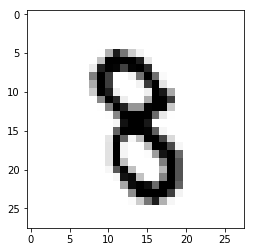

Pred value: 3
True value: 8


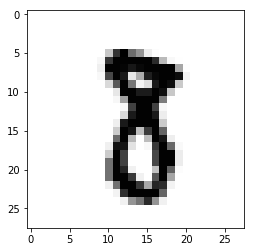

Pred value: 5
True value: 6


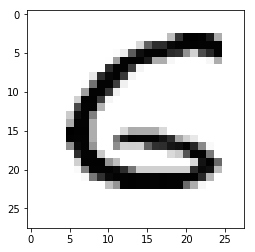

Pred value: 5
True value: 8


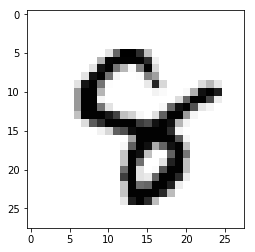

Pred value: 3
True value: 2


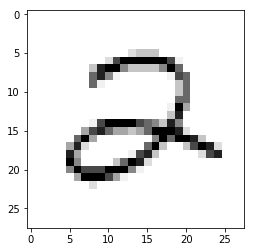

Pred value: 5
True value: 1


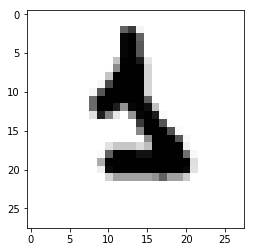

Pred value: 9
True value: 8


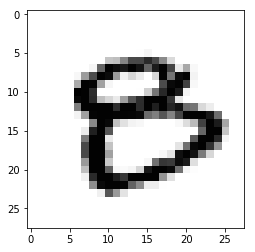

Pred value: 3
True value: 5


Pred value: 5
True value: 3


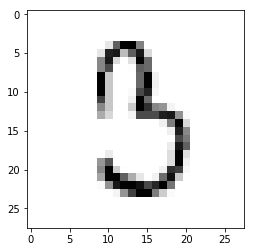

Pred value: 6
True value: 9


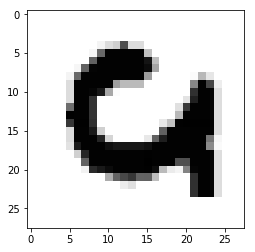

Pred value: 3
True value: 8


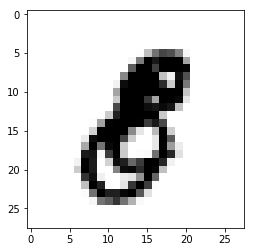

Pred value: 5
True value: 8


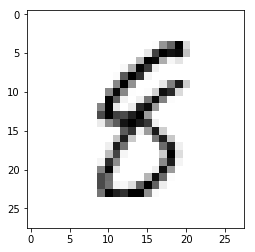

Pred value: 2
True value: 7


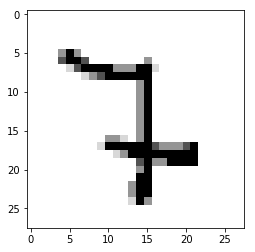

Pred value: 2
True value: 0


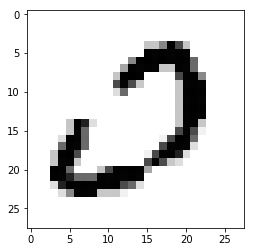

Pred value: 3
True value: 1


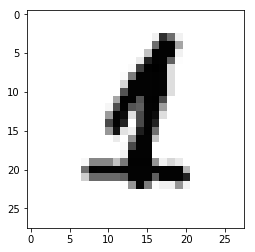

Pred value: 1
True value: 8


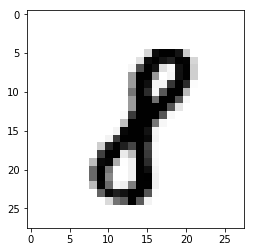

Pred value: 4
True value: 5


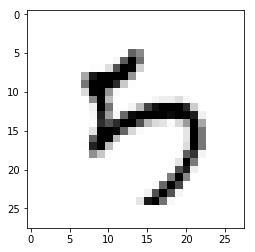

Pred value: 9
True value: 8


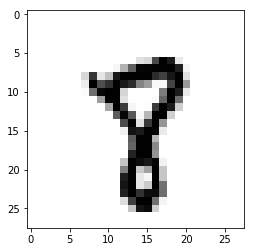

Pred value: 2
True value: 8


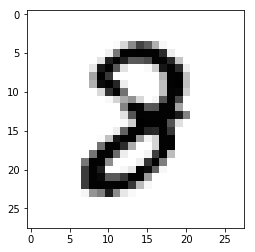

Pred value: 9
True value: 0


Pred value: 1
True value: 9


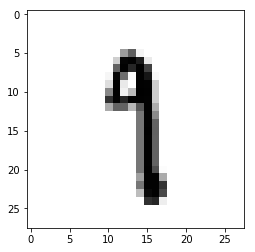

Pred value: 3
True value: 8


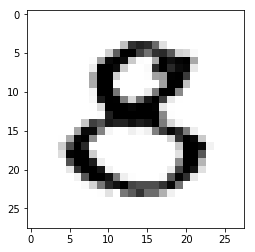

Pred value: 3
True value: 8


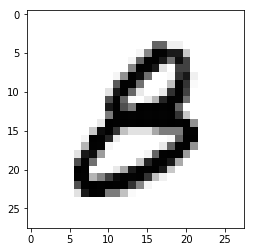

Pred value: 5
True value: 2


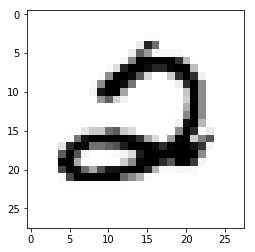

Pred value: 1
True value: 9


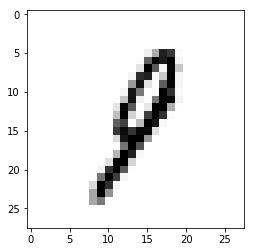

Pred value: 4
True value: 6


Pred value: 9
True value: 8


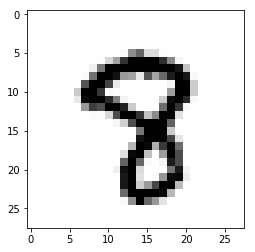

Pred value: 3
True value: 8


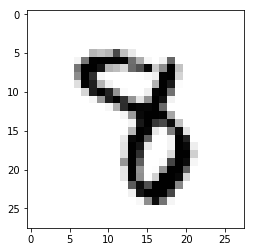

Pred value: 9
True value: 4


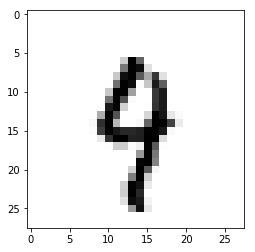

Pred value: 5
True value: 6


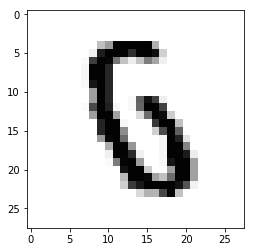

Pred value: 6
True value: 2


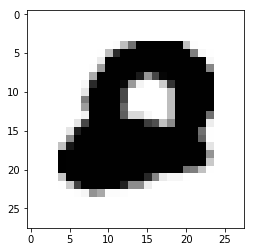

Pred value: 2
True value: 7


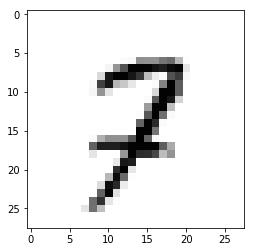

Pred value: 9
True value: 8


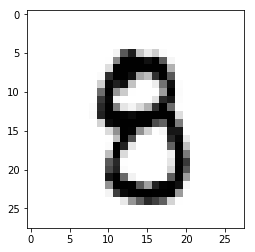

Pred value: 3
True value: 8


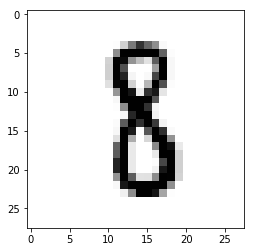

Pred value: 5
True value: 8


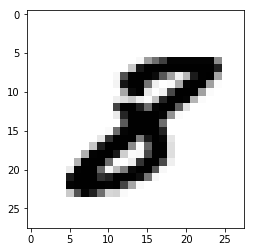

Pred value: 3
True value: 8


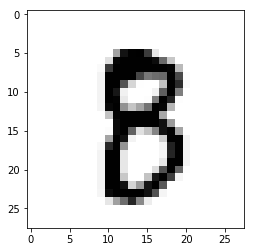

Pred value: 3
True value: 8


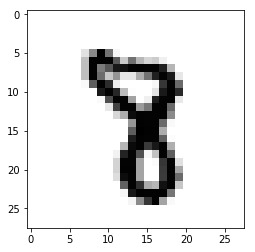

Pred value: 9
True value: 5


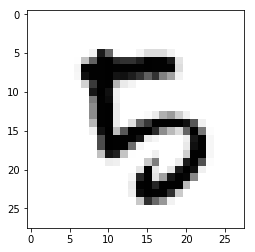

Pred value: 3
True value: 5


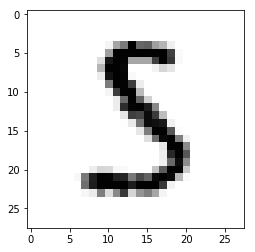

Pred value: 3
True value: 5


Pred value: 2
True value: 7


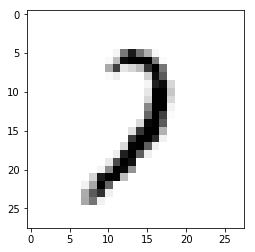

Pred value: 3
True value: 5


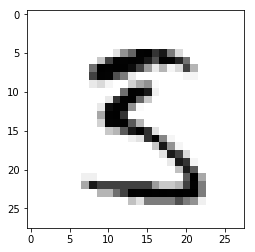

Pred value: 2
True value: 8


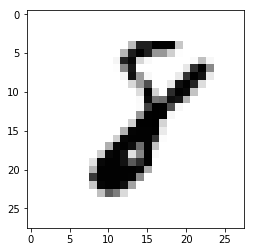

Pred value: 8
True value: 7


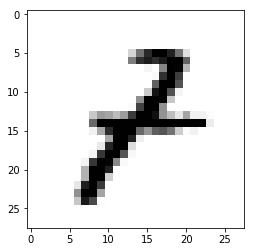

Pred value: 5
True value: 6


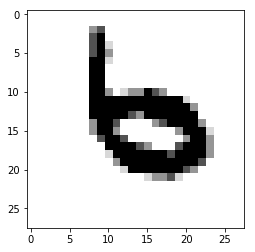

Pred value: 9
True value: 8


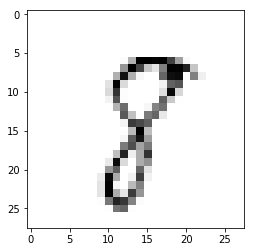

Pred value: 2
True value: 7


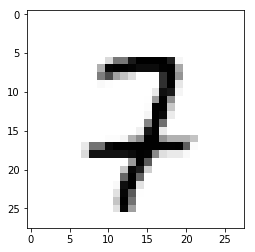

Pred value: 6
True value: 0


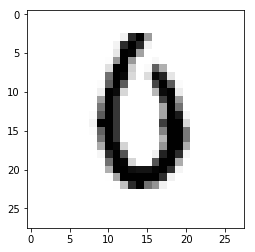

Pred value: 1
True value: 6


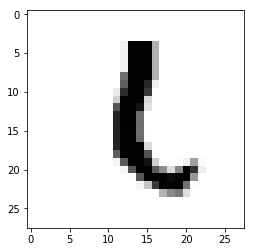

Pred value: 2
True value: 7


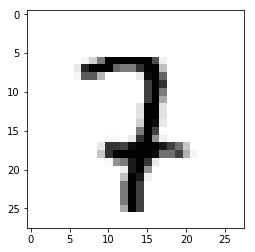

Pred value: 5
True value: 8


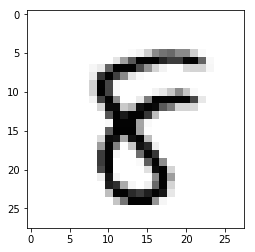

Pred value: 5
True value: 7


Pred value: 8
True value: 0


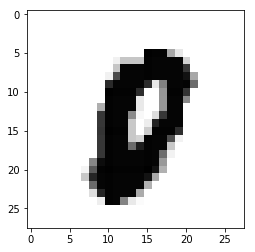

Pred value: 5
True value: 8


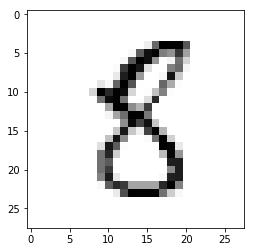

Pred value: 4
True value: 7


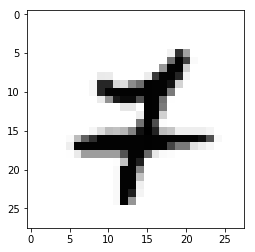

Pred value: 5
True value: 8


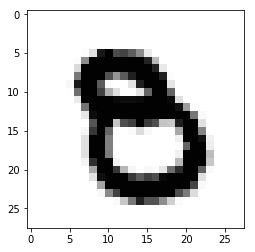

Pred value: 5
True value: 3


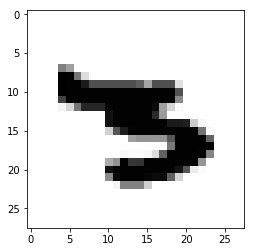

Pred value: 6
True value: 4


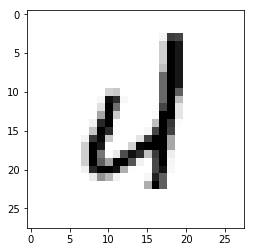

Pred value: 3
True value: 2


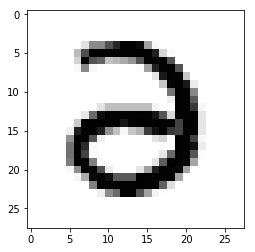

Pred value: 3
True value: 5


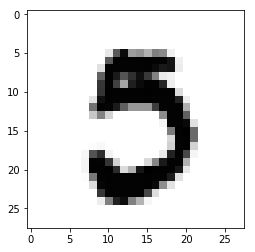

Pred value: 3
True value: 7


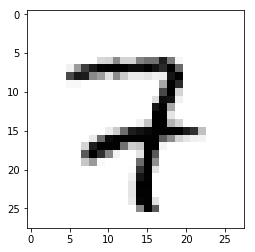

Pred value: 1
True value: 8


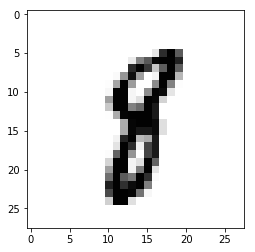

Pred value: 5
True value: 8


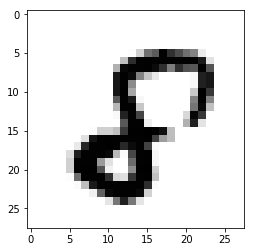

Pred value: 5
True value: 8


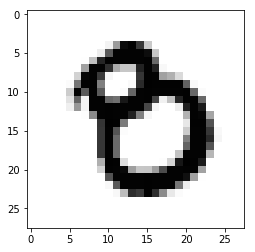

Pred value: 3
True value: 8


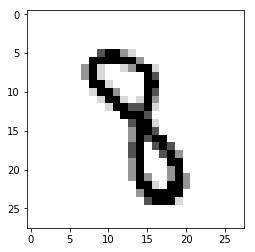

Pred value: 3
True value: 8


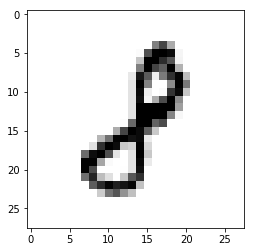

Pred value: 9
True value: 5


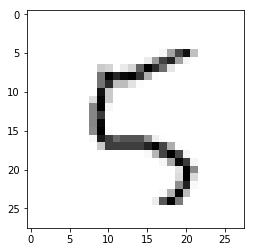

Pred value: 6
True value: 4


Pred value: 5
True value: 9


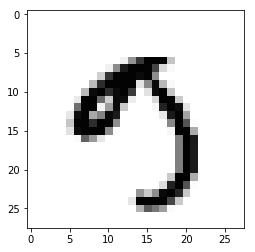

Pred value: 5
True value: 3


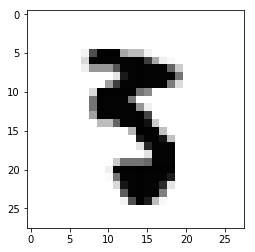

Pred value: 9
True value: 8


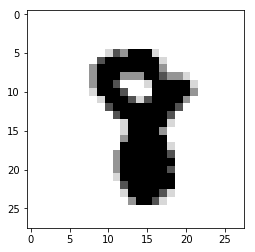

Pred value: 3
True value: 7


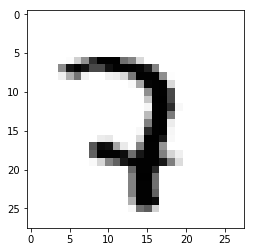

Pred value: 3
True value: 5


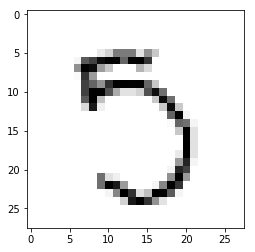

Pred value: 2
True value: 8


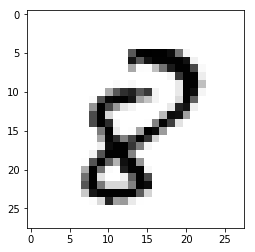

Pred value: 5
True value: 6


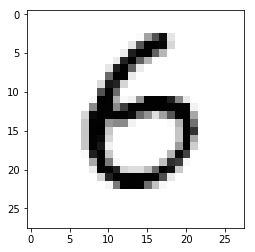

Pred value: 5
True value: 8


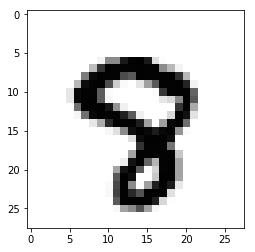

Pred value: 5
True value: 6


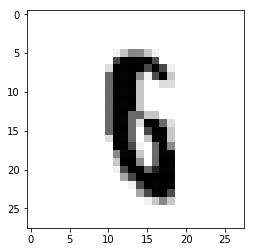

Pred value: 9
True value: 8


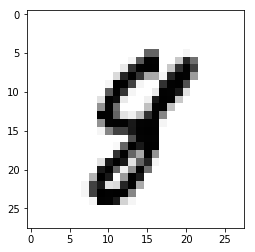

Pred value: 5
True value: 8


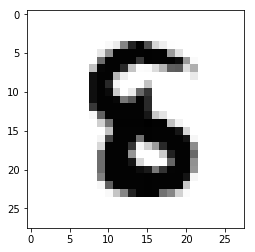

Pred value: 4
True value: 2


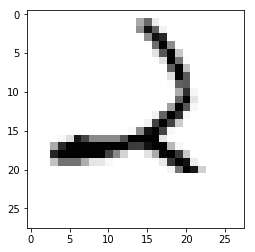

Pred value: 1
True value: 9


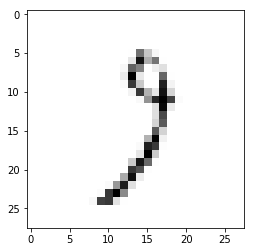

Pred value: 2
True value: 7


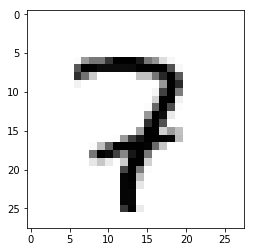

Pred value: 2
True value: 8


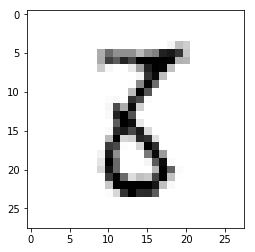

Pred value: 3
True value: 8


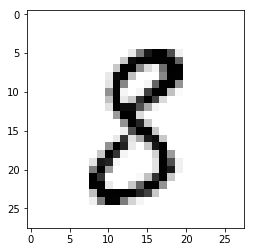

Pred value: 5
True value: 8


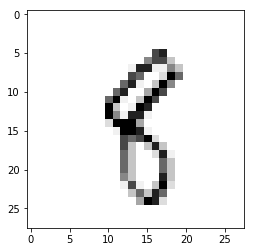

Pred value: 2
True value: 8


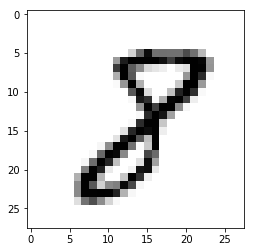

Pred value: 2
True value: 1


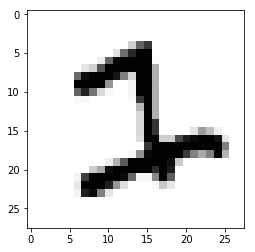

Pred value: 9
True value: 0


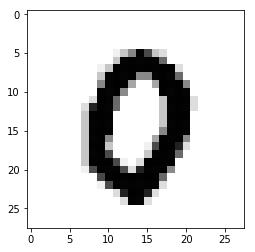

Pred value: 3
True value: 8


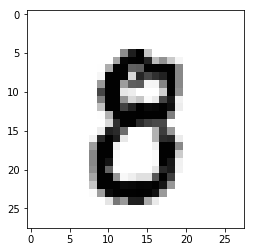

Pred value: 3
True value: 5


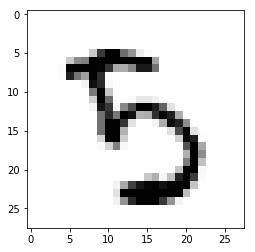

Pred value: 6
True value: 4


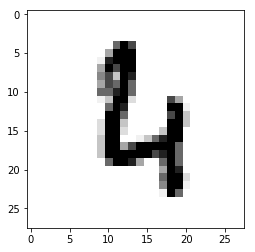

Pred value: 4
True value: 7


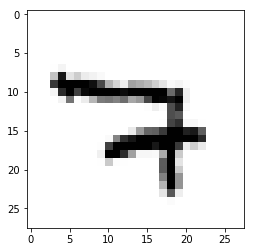

Pred value: 0
True value: 6


Pred value: 2
True value: 1


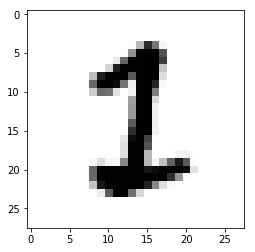

Pred value: 9
True value: 7


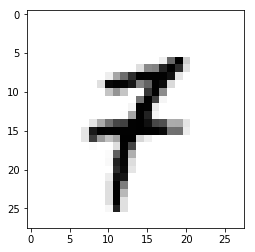

Pred value: 3
True value: 8


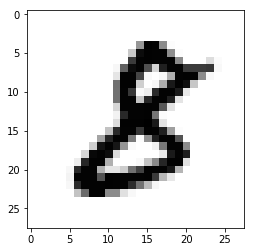

Pred value: 9
True value: 5


Pred value: 3
True value: 8


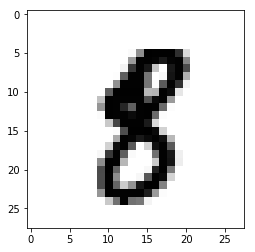

Pred value: 9
True value: 7


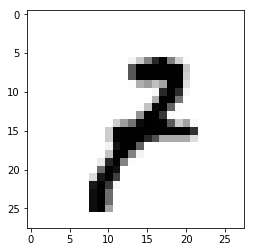

Pred value: 9
True value: 5


Pred value: 4
True value: 7


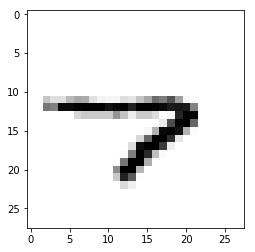

Pred value: 9
True value: 8


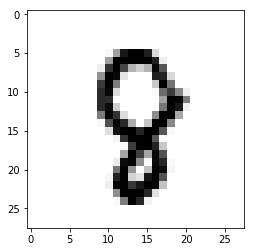

Pred value: 3
True value: 8


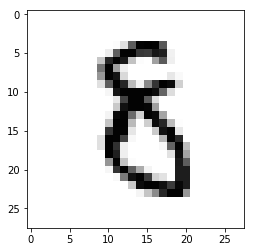

Pred value: 3
True value: 8


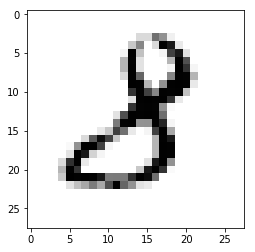

Pred value: 3
True value: 8


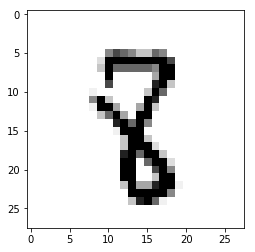

Pred value: 5
True value: 6


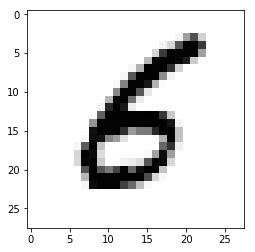

Pred value: 4
True value: 6


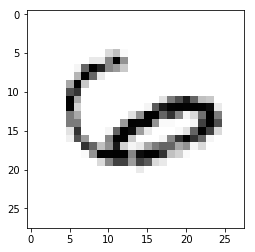

Pred value: 5
True value: 8


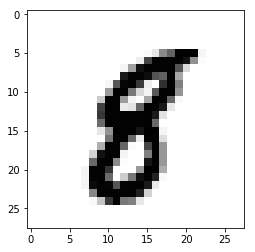

Pred value: 3
True value: 9


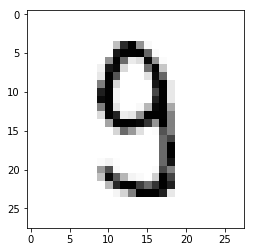

Pred value: 1
True value: 8


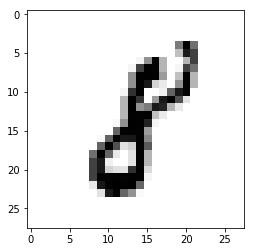

Pred value: 3
True value: 8


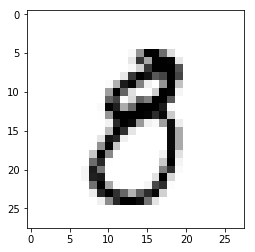

Pred value: 9
True value: 0


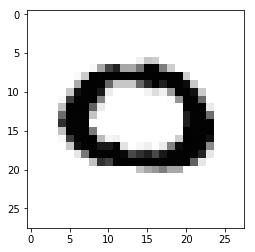

Pred value: 5
True value: 6


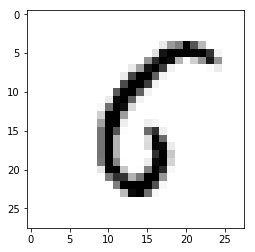

Pred value: 9
True value: 8


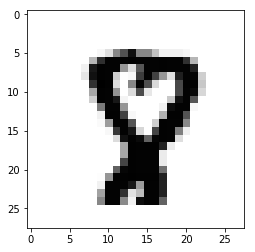

Pred value: 5
True value: 6


Pred value: 7
True value: 8


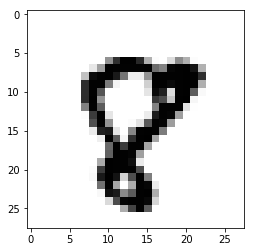

Pred value: 5
True value: 8


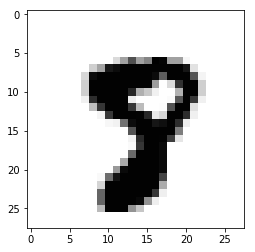

Pred value: 4
True value: 7


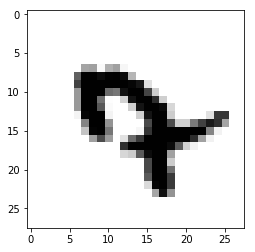

Pred value: 9
True value: 8


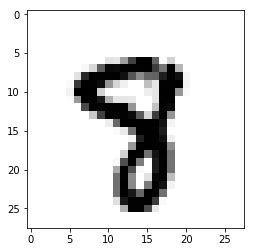

Pred value: 3
True value: 8


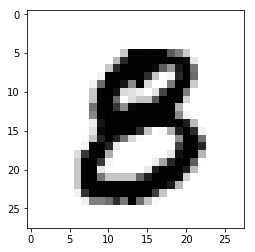

Pred value: 3
True value: 7


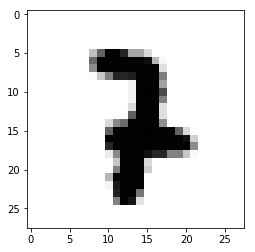

Pred value: 3
True value: 2


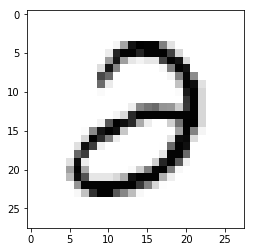

Pred value: 9
True value: 7


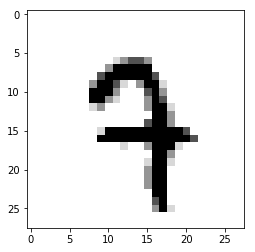

Pred value: 5
True value: 6


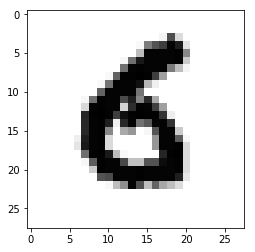

Pred value: 4
True value: 7


Pred value: 3
True value: 8


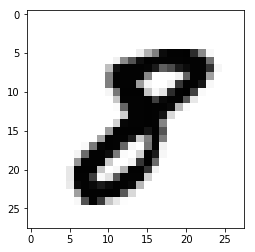

Pred value: 7
True value: 8


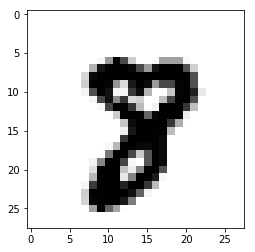

Pred value: 5
True value: 6


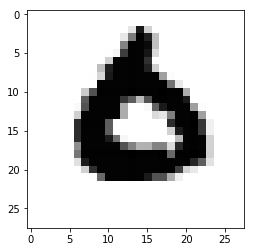

Pred value: 9
True value: 0


Pred value: 5
True value: 8


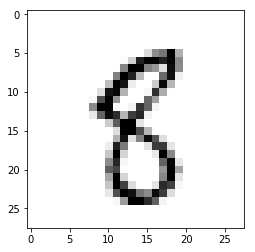

Pred value: 3
True value: 8


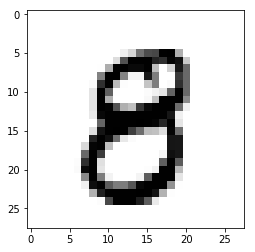

Pred value: 9
True value: 3


Pred value: 9
True value: 4


Pred value: 9
True value: 8


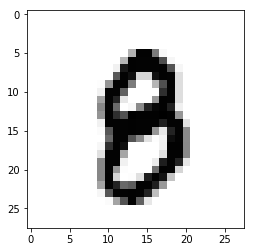

Pred value: 3
True value: 8


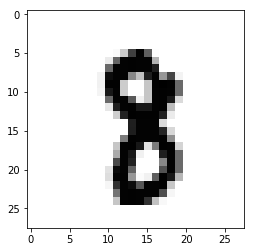

Pred value: 1
True value: 9


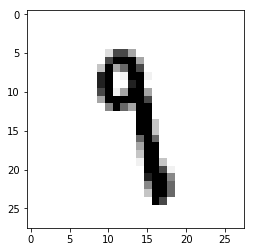

Pred value: 9
True value: 8


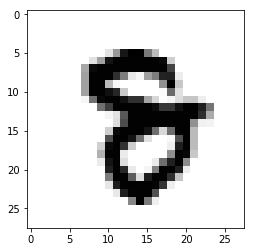

Pred value: 5
True value: 8


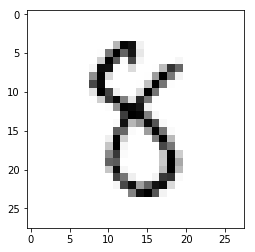

Pred value: 4
True value: 6


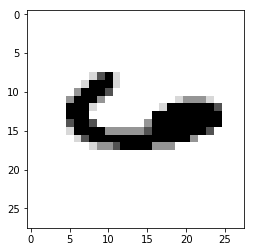

Pred value: 3
True value: 2


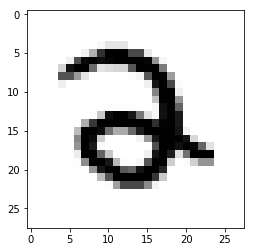

Pred value: 5
True value: 6


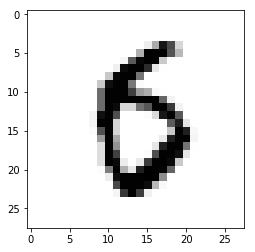

Pred value: 5
True value: 8


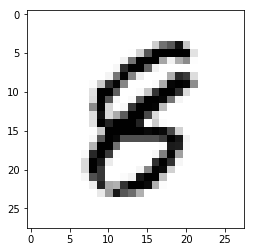

Pred value: 0
True value: 8


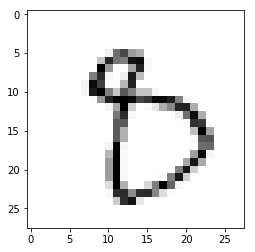

Pred value: 5
True value: 8


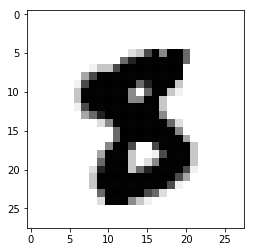

Pred value: 5
True value: 8


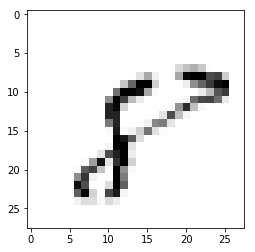

Pred value: 9
True value: 7


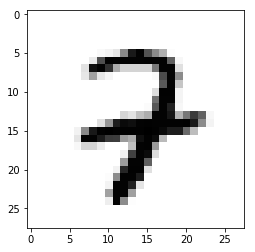

Pred value: 3
True value: 8


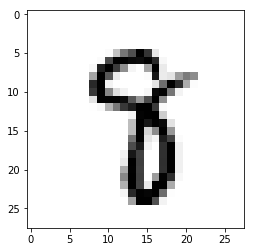

Pred value: 3
True value: 9


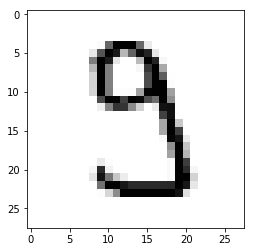

Pred value: 3
True value: 8


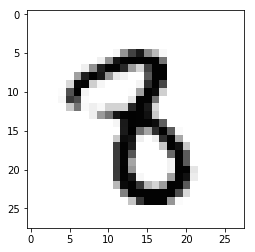

Pred value: 3
True value: 8


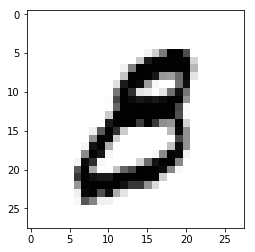

Pred value: 9
True value: 8


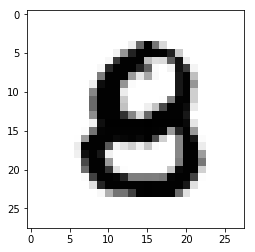

Pred value: 3
True value: 8


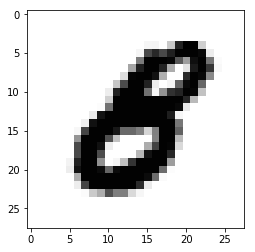

Pred value: 5
True value: 8


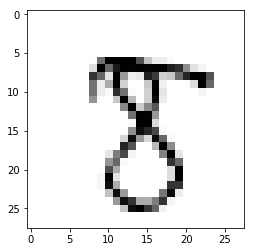

Pred value: 3
True value: 2


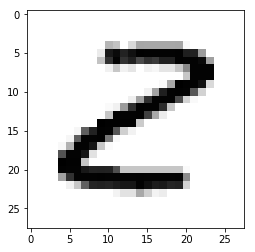

Pred value: 3
True value: 9


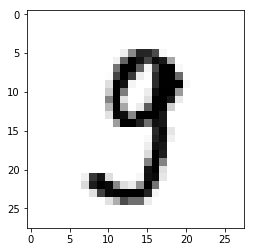

Pred value: 9
True value: 4


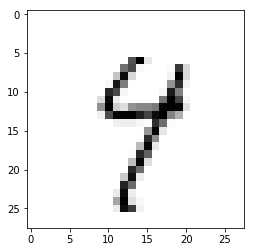

Pred value: 9
True value: 4


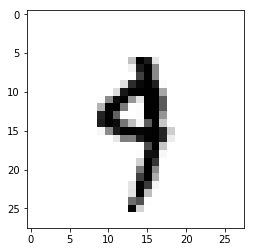

Pred value: 9
True value: 8


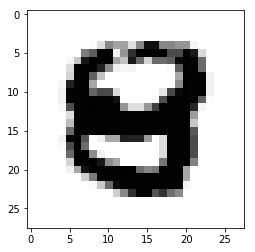

Pred value: 3
True value: 2


Pred value: 9
True value: 7


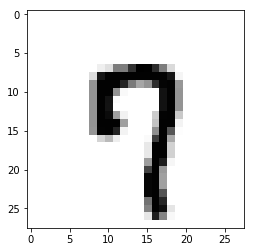

Pred value: 1
True value: 8


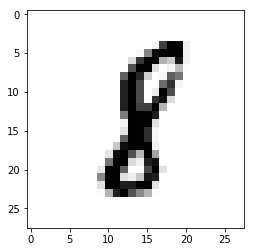

Pred value: 5
True value: 8


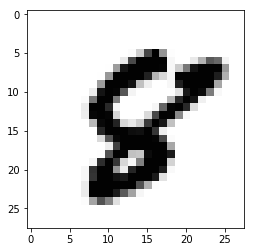

Pred value: 9
True value: 3


Pred value: 5
True value: 6


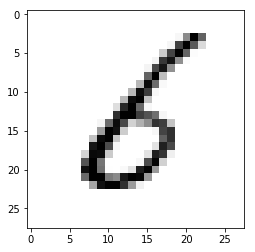

Pred value: 4
True value: 7


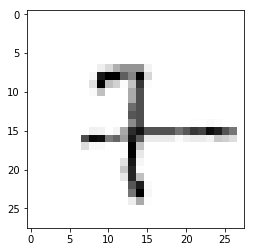

Pred value: 5
True value: 8


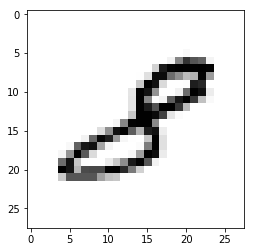

Pred value: 5
True value: 6


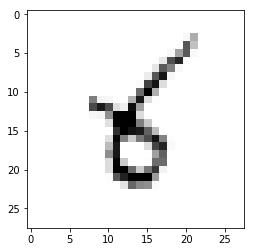

Pred value: 2
True value: 7


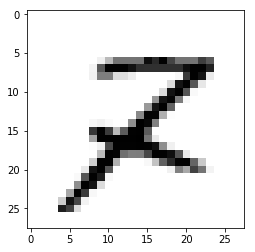

Pred value: 2
True value: 5


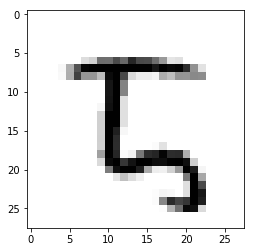

Pred value: 6
True value: 4


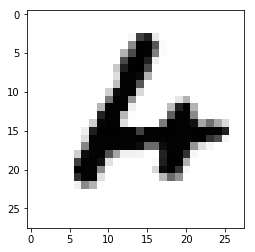

Pred value: 2
True value: 8


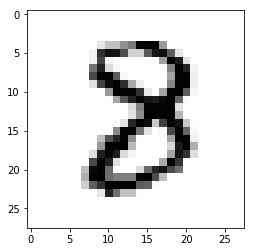

Pred value: 3
True value: 8


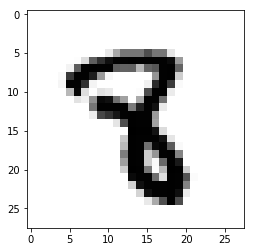

Pred value: 5
True value: 7


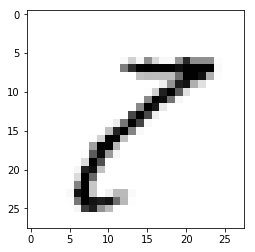

Pred value: 3
True value: 2


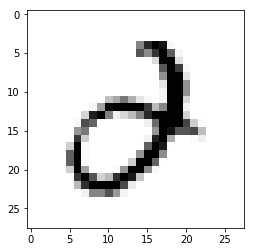

Pred value: 5
True value: 0


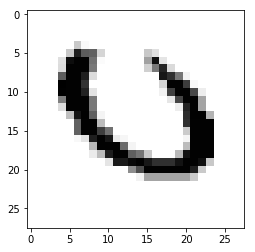

Pred value: 4
True value: 9


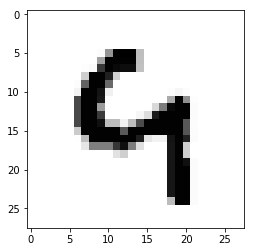

Pred value: 1
True value: 8


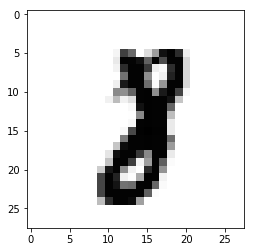

Pred value: 4
True value: 7


Pred value: 4
True value: 7


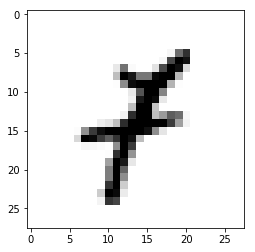

Pred value: 3
True value: 7


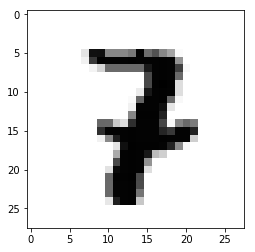

Pred value: 4
True value: 9


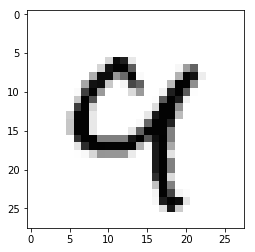

Pred value: 5
True value: 6


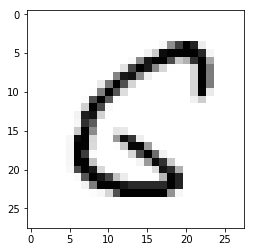

Pred value: 3
True value: 8


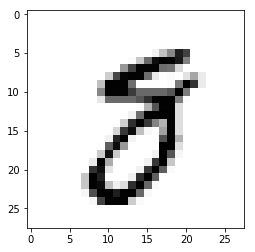

Pred value: 5
True value: 8


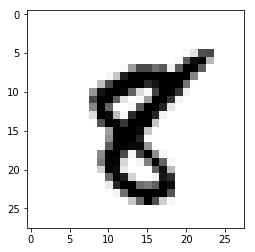

Pred value: 5
True value: 8


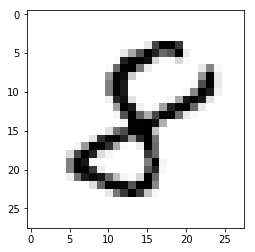

Pred value: 2
True value: 1


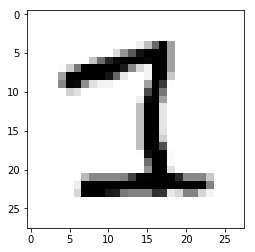

Pred value: 3
True value: 9


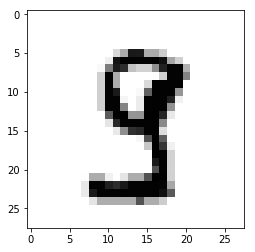

Pred value: 2
True value: 7


Pred value: 2
True value: 8


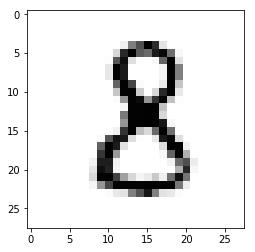

Pred value: 9
True value: 8


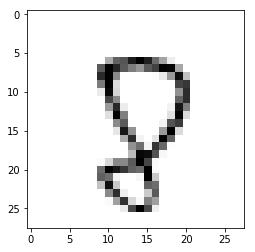

Pred value: 9
True value: 8


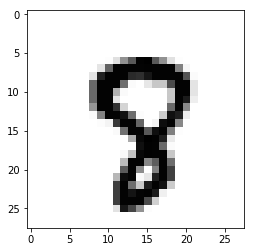

Pred value: 3
True value: 5


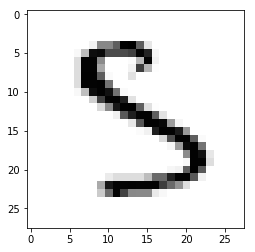

Pred value: 3
True value: 8


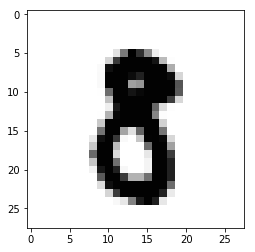

Pred value: 9
True value: 7


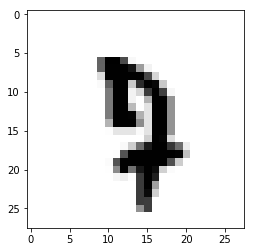

Pred value: 3
True value: 1


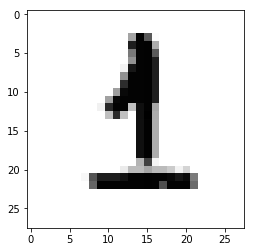

Pred value: 2
True value: 3


Pred value: 3
True value: 8


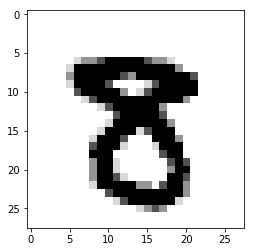

Pred value: 5
True value: 6


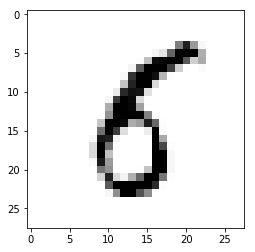

Pred value: 3
True value: 8


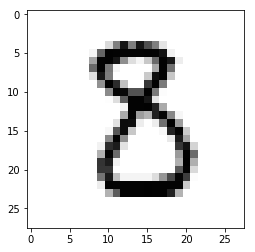

Pred value: 0
True value: 8


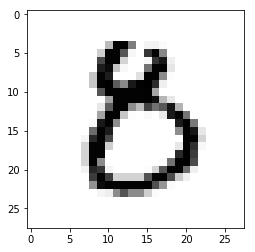

Pred value: 3
True value: 9


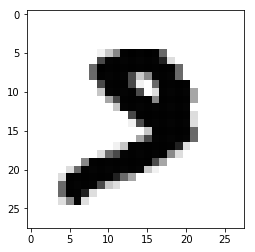

Pred value: 5
True value: 8


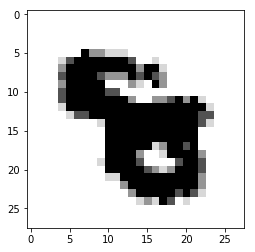

Pred value: 5
True value: 7


Pred value: 4
True value: 8


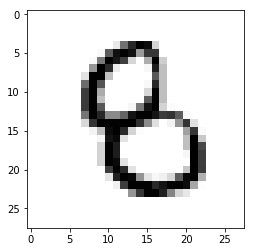

Pred value: 3
True value: 8


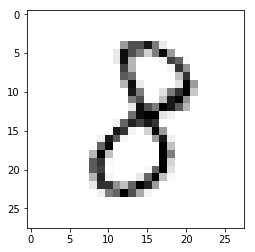

Pred value: 3
True value: 8


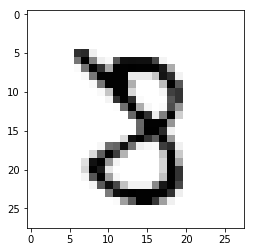

Pred value: 5
True value: 8


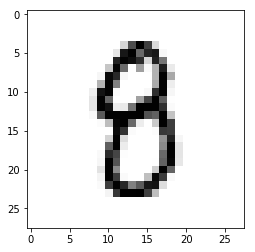

Pred value: 2
True value: 8


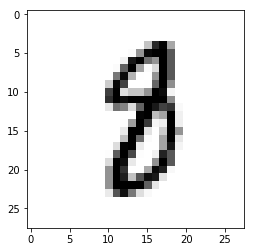

Pred value: 5
True value: 8


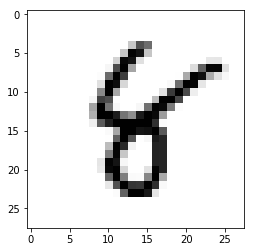

Pred value: 2
True value: 8


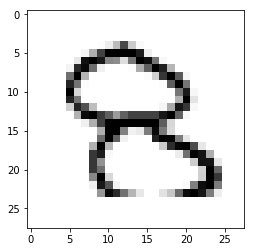

Pred value: 9
True value: 8


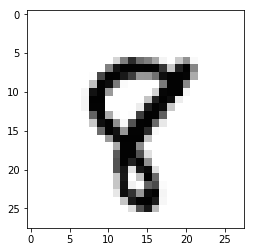

Pred value: 3
True value: 8


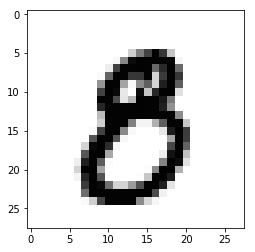

Pred value: 3
True value: 8


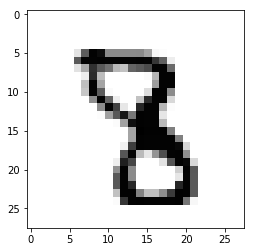

Pred value: 3
True value: 8


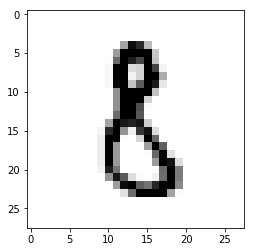

Pred value: 4
True value: 2


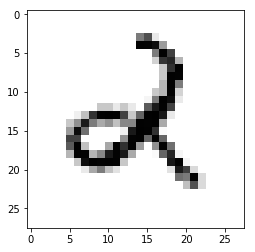

Pred value: 4
True value: 2


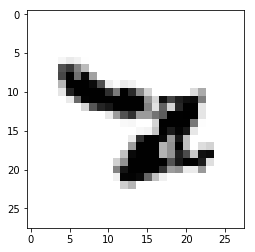

Pred value: 9
True value: 7


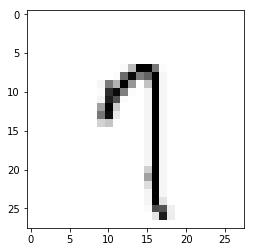

Pred value: 1
True value: 2


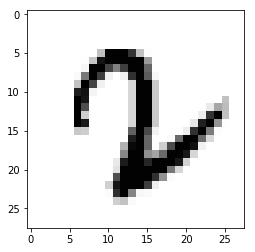

Pred value: 2
True value: 8


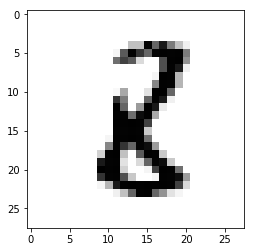

Pred value: 5
True value: 6


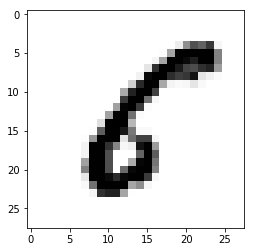

Pred value: 3
True value: 1


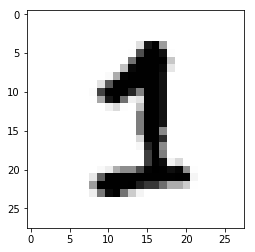

Pred value: 7
True value: 9


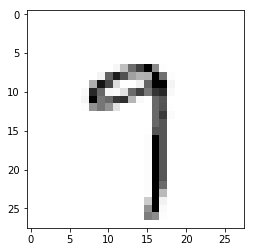

Pred value: 3
True value: 7


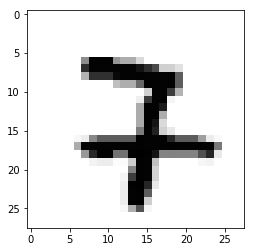

Pred value: 9
True value: 8


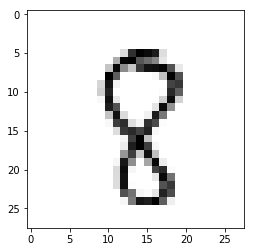

Pred value: 3
True value: 7


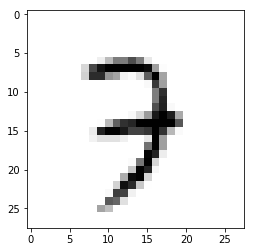

Pred value: 5
True value: 6


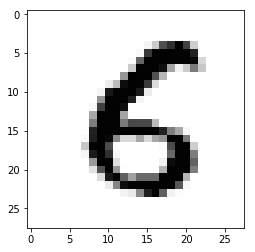

Pred value: 2
True value: 8


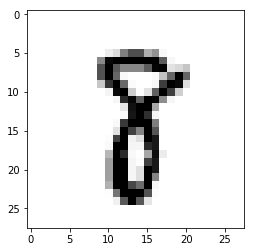

Pred value: 0
True value: 3


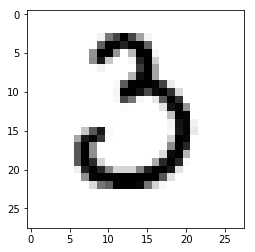

Pred value: 3
True value: 5


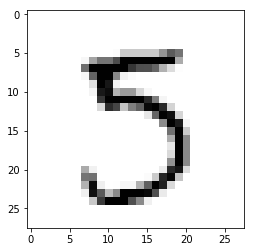

Pred value: 1
True value: 4


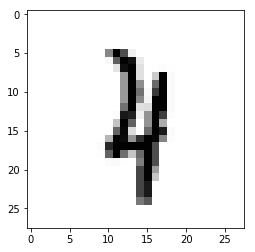

Pred value: 5
True value: 9


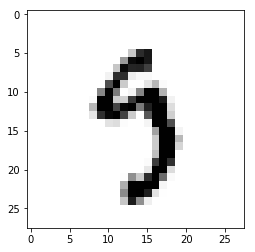

Pred value: 5
True value: 6


Pred value: 7
True value: 2


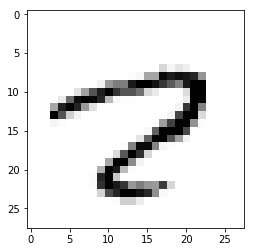

Pred value: 7
True value: 3


Pred value: 5
True value: 4


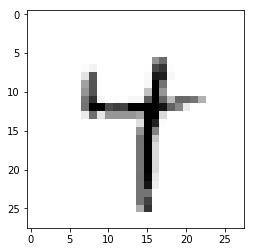

Pred value: 3
True value: 2


Pred value: 4
True value: 9


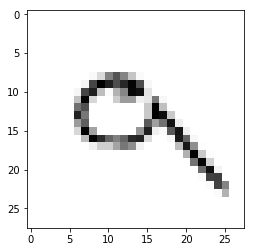

Pred value: 3
True value: 5


Pred value: 5
True value: 8


Pred value: 5
True value: 8


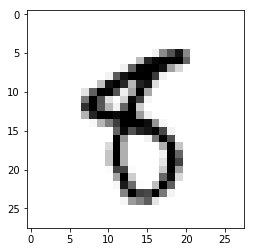

Pred value: 1
True value: 8


Pred value: 7
True value: 8


Pred value: 9
True value: 8


Pred value: 1
True value: 7


Pred value: 5
True value: 8


Pred value: 3
True value: 7


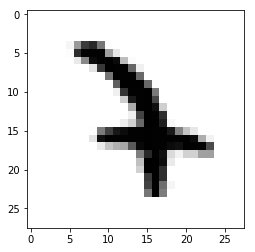

Pred value: 3
True value: 8


Pred value: 7
True value: 3


Pred value: 5
True value: 8


Pred value: 6
True value: 0


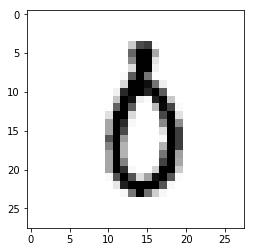

Pred value: 3
True value: 2


Pred value: 3
True value: 7


Pred value: 3
True value: 8


Pred value: 4
True value: 9


Pred value: 9
True value: 8


Pred value: 5
True value: 6


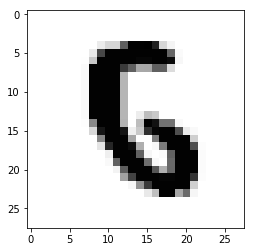

Pred value: 3
True value: 7


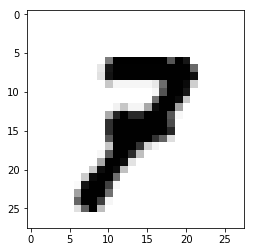

Pred value: 4
True value: 6


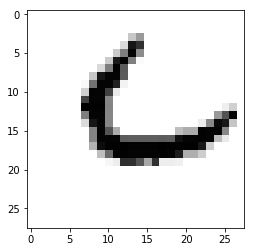

Pred value: 6
True value: 4


Pred value: 9
True value: 4


Pred value: 2
True value: 4


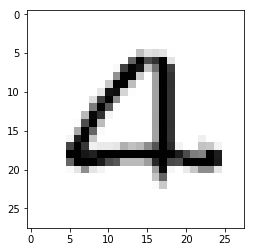

Pred value: 4
True value: 8


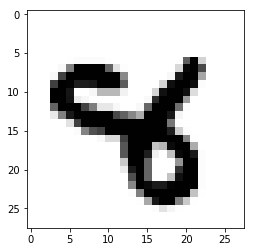

Pred value: 4
True value: 2


Pred value: 5
True value: 6


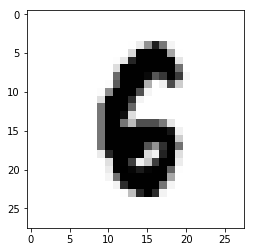

Pred value: 5
True value: 8


Pred value: 9
True value: 8


Pred value: 7
True value: 8


Pred value: 7
True value: 2


Pred value: 2
True value: 3


Pred value: 3
True value: 8


Pred value: 2
True value: 7


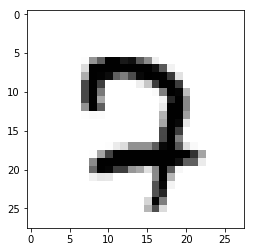

Pred value: 5
True value: 7


Pred value: 9
True value: 8


Pred value: 1
True value: 8


Pred value: 7
True value: 8


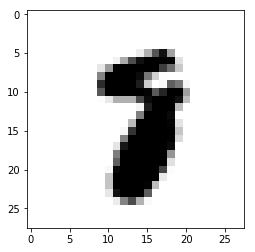

Pred value: 5
True value: 8


Pred value: 5
True value: 3


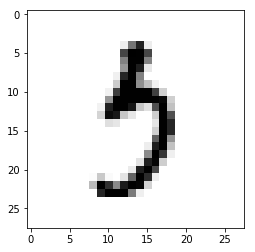

Pred value: 5
True value: 8


Pred value: 3
True value: 8


Pred value: 9
True value: 4


Pred value: 3
True value: 8


Pred value: 6
True value: 4


Pred value: 1
True value: 8


Pred value: 9
True value: 4


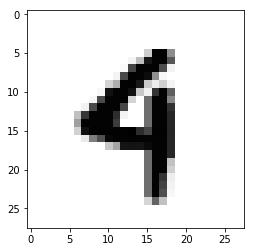

Pred value: 5
True value: 8


Pred value: 0
True value: 8


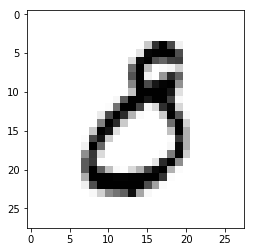

Pred value: 0
True value: 6


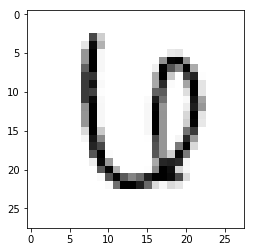

Pred value: 5
True value: 8


Pred value: 4
True value: 9


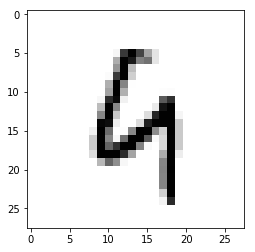

Pred value: 3
True value: 8


Pred value: 2
True value: 7


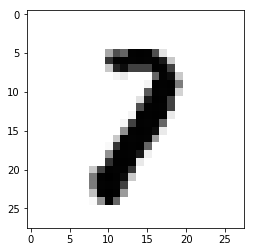

Pred value: 5
True value: 6


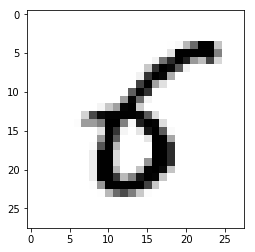

Pred value: 2
True value: 8


Pred value: 3
True value: 8


Pred value: 5
True value: 8


Pred value: 9
True value: 8


Pred value: 4
True value: 2


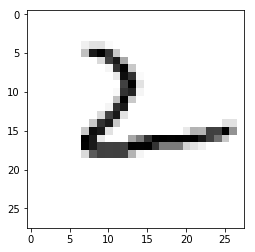

Pred value: 4
True value: 8


Pred value: 5
True value: 0


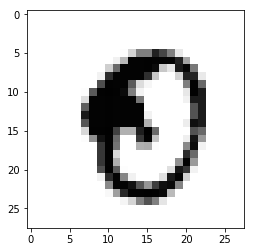

Pred value: 2
True value: 7


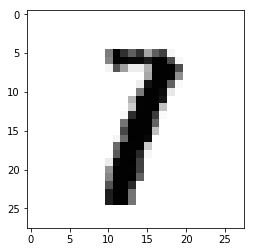

Pred value: 5
True value: 8


Pred value: 5
True value: 6


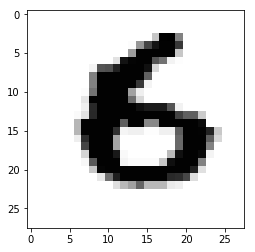

Pred value: 8
True value: 2


Pred value: 9
True value: 8


Pred value: 3
True value: 2


Pred value: 5
True value: 6


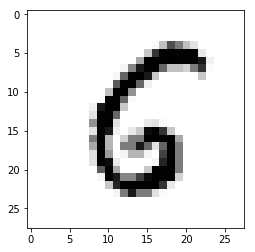

Pred value: 4
True value: 8


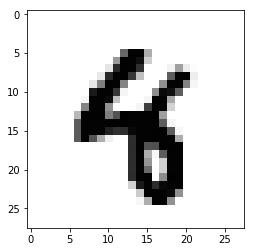

Pred value: 7
True value: 8


Pred value: 5
True value: 8


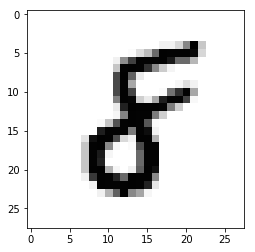

Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 3


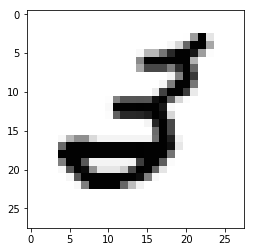

Pred value: 4
True value: 2


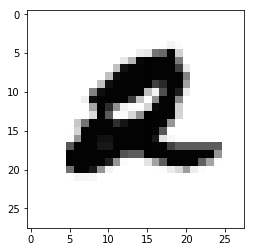

Pred value: 5
True value: 8


Pred value: 5
True value: 8


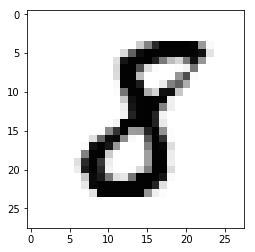

Pred value: 5
True value: 8


Pred value: 5
True value: 8


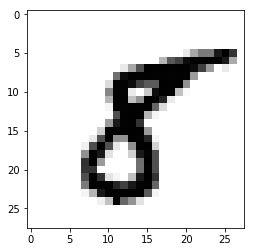

Pred value: 5
True value: 3


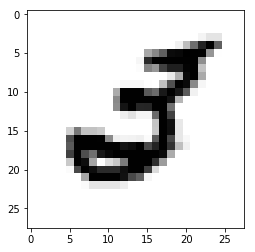

Pred value: 5
True value: 8


Pred value: 5
True value: 0


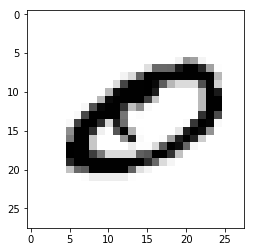

Pred value: 9
True value: 4


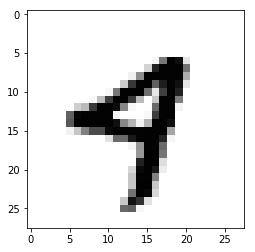

Pred value: 5
True value: 0


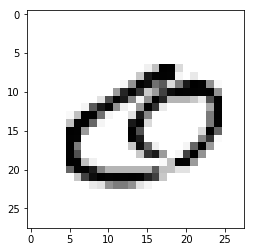

Pred value: 4
True value: 8


Pred value: 9
True value: 7


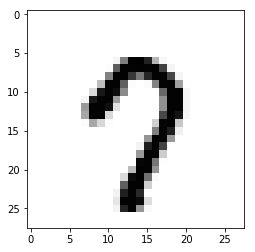

Pred value: 5
True value: 8


Pred value: 9
True value: 4


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 0


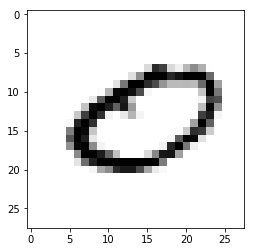

Pred value: 2
True value: 7


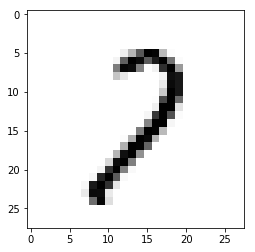

Pred value: 4
True value: 6


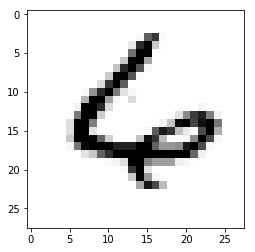

Pred value: 9
True value: 8


Pred value: 0
True value: 8


Pred value: 0
True value: 8


Pred value: 3
True value: 2


Pred value: 6
True value: 1


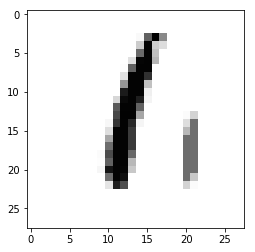

Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 2


Pred value: 6
True value: 4


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 8


Pred value: 3
True value: 8


Pred value: 5
True value: 8


Pred value: 7
True value: 8


Pred value: 3
True value: 8


Pred value: 9
True value: 8


Pred value: 3
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 0
True value: 8


Pred value: 9
True value: 7


Pred value: 4
True value: 8


Pred value: 5
True value: 8


Pred value: 9
True value: 7


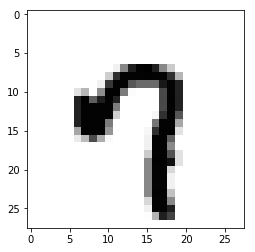

Pred value: 3
True value: 2


Pred value: 5
True value: 1


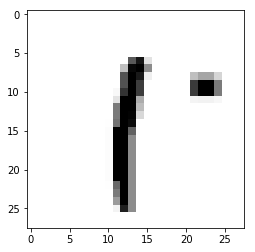

Pred value: 5
True value: 8


Pred value: 9
True value: 7


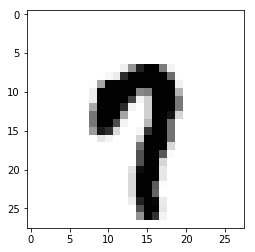

Pred value: 6
True value: 0


Pred value: 5
True value: 8


Pred value: 3
True value: 8


Pred value: 9
True value: 7


Pred value: 1
True value: 8


Pred value: 9
True value: 7


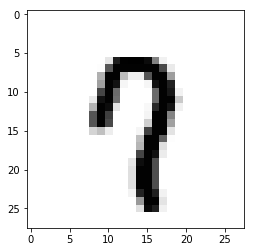

Pred value: 4
True value: 3


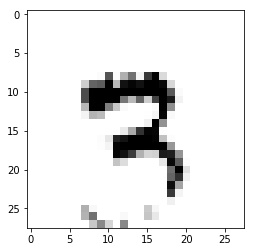

Pred value: 2
True value: 1


Pred value: 2
True value: 1


Pred value: 9
True value: 7


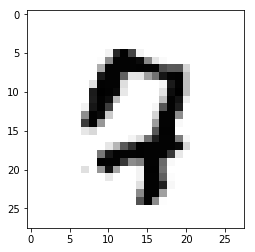

Pred value: 9
True value: 7


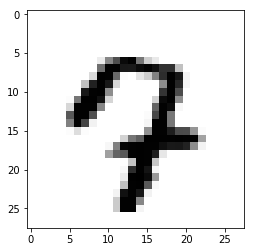

Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 8


Pred value: 9
True value: 7


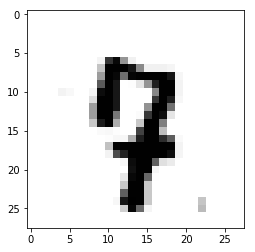

Pred value: 9
True value: 7


Pred value: 3
True value: 8


Pred value: 9
True value: 7


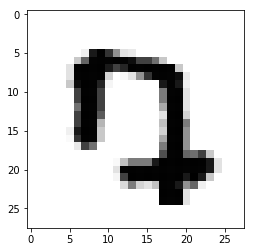

Pred value: 0
True value: 4


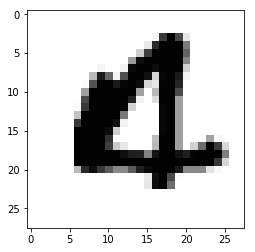

Pred value: 9
True value: 7


Pred value: 9
True value: 7


Pred value: 9
True value: 7


Pred value: 3
True value: 5


Pred value: 3
True value: 5


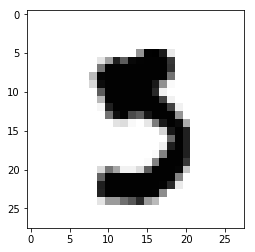

Pred value: 3
True value: 8


Pred value: 3
True value: 8


Pred value: 5
True value: 3


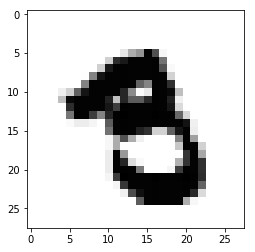

Pred value: 9
True value: 8


Pred value: 5
True value: 0


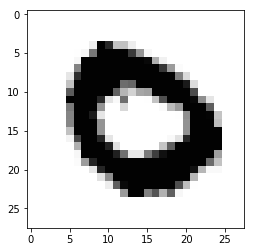

Pred value: 5
True value: 8


Pred value: 3
True value: 5


Pred value: 5
True value: 3


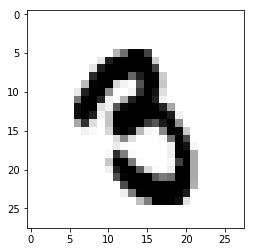

Pred value: 9
True value: 0


Pred value: 3
True value: 8


Pred value: 9
True value: 5


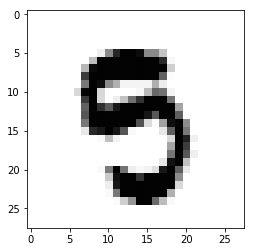

Pred value: 3
True value: 5


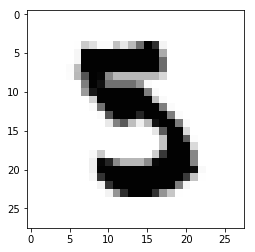

Pred value: 5
True value: 0


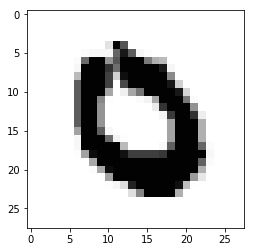

Pred value: 9
True value: 8


Pred value: 3
True value: 8


Pred value: 5
True value: 8


Pred value: 9
True value: 8


Pred value: 3
True value: 8


Pred value: 5
True value: 9


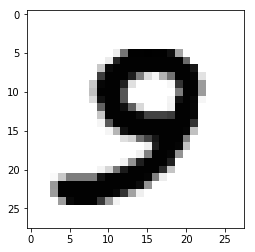

Pred value: 5
True value: 8


Pred value: 5
True value: 9


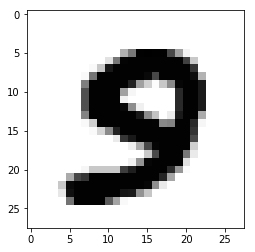

Pred value: 9
True value: 8


Pred value: 5
True value: 9


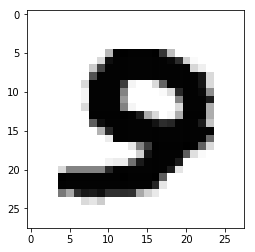

Pred value: 5
True value: 9


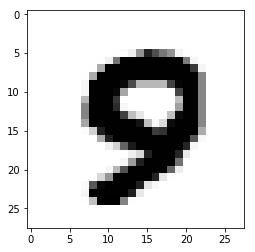

Pred value: 5
True value: 9


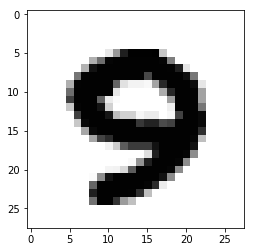

Pred value: 9
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 9


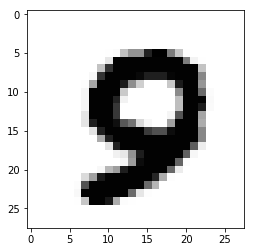

Pred value: 5
True value: 8


Pred value: 5
True value: 9


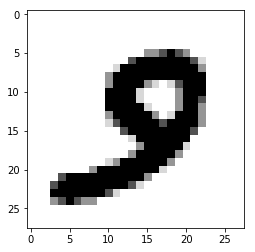

Pred value: 5
True value: 9


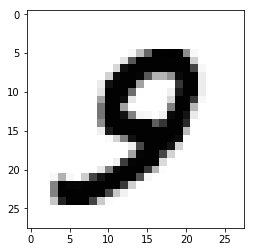

Pred value: 5
True value: 9


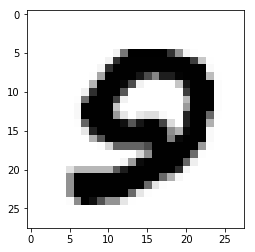

Pred value: 5
True value: 9


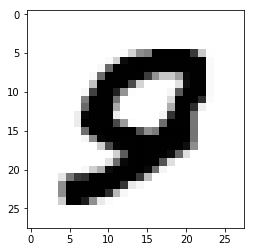

Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 8


Pred value: 3
True value: 8


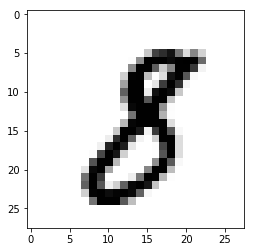

Pred value: 3
True value: 2


Pred value: 3
True value: 8


Pred value: 3
True value: 8


Pred value: 5
True value: 2


Pred value: 4
True value: 2


Pred value: 5
True value: 8


Pred value: 0
True value: 9


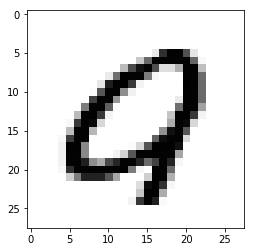

Pred value: 9
True value: 8


Pred value: 5
True value: 2


Pred value: 9
True value: 8


Pred value: 9
True value: 3


Pred value: 2
True value: 1


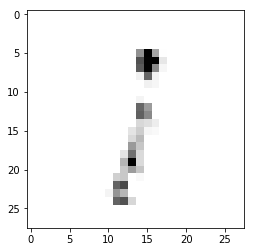

Pred value: 6
True value: 2


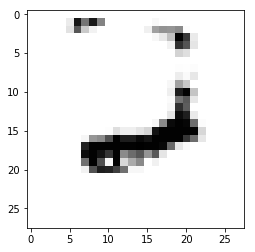

Pred value: 2
True value: 7


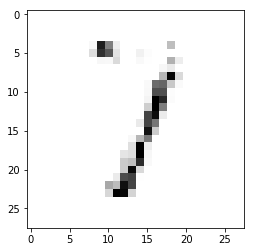

Pred value: 2
True value: 7


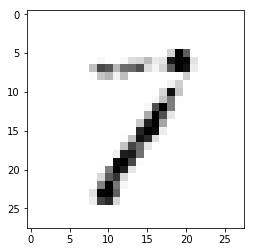

Pred value: 9
True value: 0


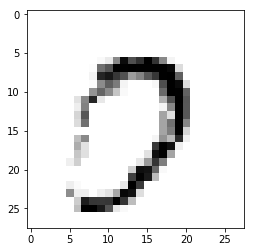

Pred value: 9
True value: 8


Pred value: 5
True value: 9


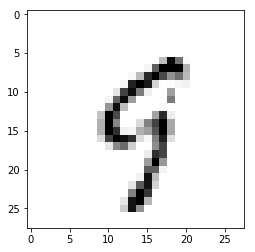

Pred value: 2
True value: 8


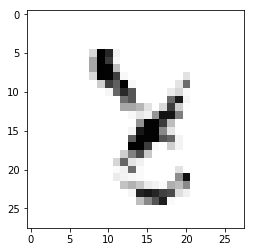

Pred value: 3
True value: 8


Pred value: 5
True value: 8


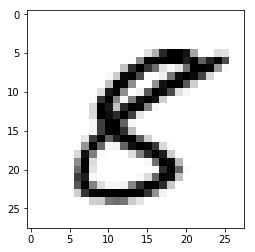

Pred value: 5
True value: 9


Pred value: 5
True value: 8


Pred value: 5
True value: 0


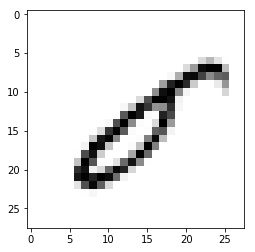

Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 9


Pred value: 5
True value: 9


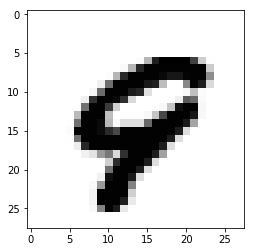

Pred value: 4
True value: 2


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 6
True value: 4


Pred value: 0
True value: 9


Pred value: 8
True value: 2


Pred value: 9
True value: 8


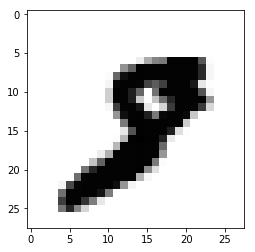

Pred value: 5
True value: 8


Pred value: 5
True value: 9


Pred value: 4
True value: 2


Pred value: 7
True value: 2


Pred value: 3
True value: 8


Pred value: 3
True value: 8


Pred value: 9
True value: 0


Pred value: 3
True value: 8


Pred value: 3
True value: 8


Pred value: 6
True value: 4


Pred value: 9
True value: 0


Pred value: 6
True value: 1


Pred value: 3
True value: 0


Pred value: 9
True value: 8


Pred value: 7
True value: 8


Pred value: 3
True value: 8


Pred value: 3
True value: 8


Pred value: 6
True value: 0


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 8


Pred value: 3
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 4
True value: 2


Pred value: 3
True value: 8


Pred value: 5
True value: 8


Pred value: 9
True value: 2


Pred value: 5
True value: 8


Pred value: 5
True value: 2


Pred value: 5
True value: 6


Pred value: 9
True value: 8


Pred value: 3
True value: 8


Pred value: 2
True value: 8


Pred value: 2
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 8


Pred value: 3
True value: 2


Pred value: 5
True value: 8


Pred value: 2
True value: 7


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 9


Pred value: 4
True value: 2


Pred value: 9
True value: 2


Pred value: 5
True value: 4


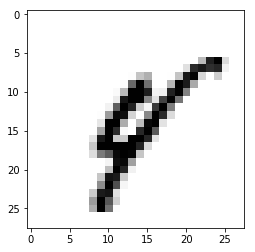

Pred value: 5
True value: 8


Pred value: 2
True value: 7


Pred value: 9
True value: 8


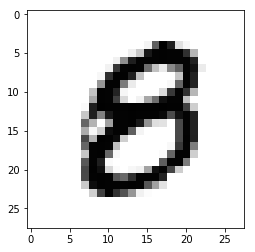

Pred value: 0
True value: 8


Pred value: 5
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 3
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 3
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 2


Pred value: 3
True value: 2


Pred value: 3
True value: 2


Pred value: 3
True value: 2


Pred value: 9
True value: 5


Pred value: 3
True value: 2


Pred value: 3
True value: 2


Pred value: 3
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 8


Pred value: 2
True value: 1


Pred value: 3
True value: 8


Pred value: 9
True value: 3


Pred value: 5
True value: 6


Pred value: 4
True value: 2


Pred value: 4
True value: 2


Pred value: 9
True value: 2


Pred value: 9
True value: 2


Pred value: 9
True value: 2


Pred value: 4
True value: 2


Pred value: 4
True value: 2


Pred value: 9
True value: 2


Pred value: 9
True value: 8


Pred value: 0
True value: 8


Pred value: 9
True value: 2


Pred value: 9
True value: 4


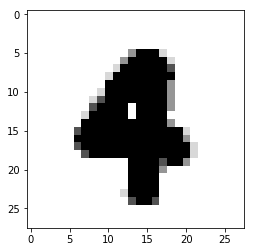

Pred value: 3
True value: 8


Pred value: 6
True value: 4


Pred value: 1
True value: 2


Pred value: 3
True value: 2


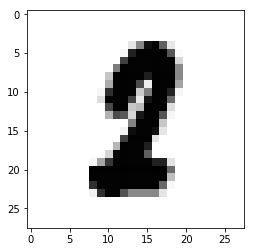

Pred value: 1
True value: 4


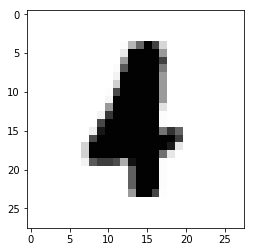

Pred value: 9
True value: 8


Pred value: 4
True value: 2


Pred value: 5
True value: 8


Pred value: 4
True value: 2


Pred value: 5
True value: 9


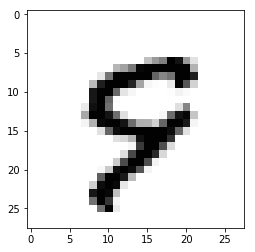

Pred value: 5
True value: 8


Pred value: 4
True value: 2


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 9
True value: 3


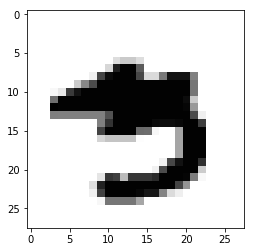

Pred value: 4
True value: 2


Pred value: 5
True value: 8


Pred value: 3
True value: 2


Pred value: 5
True value: 0


Pred value: 5
True value: 8


Pred value: 5
True value: 9


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 2


Pred value: 4
True value: 8


Pred value: 4
True value: 2


Pred value: 9
True value: 7


Pred value: 3
True value: 0


Pred value: 5
True value: 8


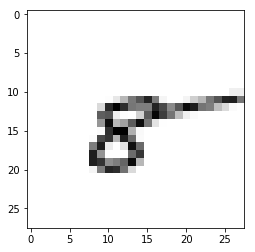

Pred value: 6
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 9


Pred value: 5
True value: 9


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 4


Pred value: 5
True value: 4


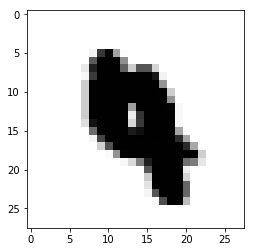

Pred value: 5
True value: 8


Pred value: 5
True value: 2


Pred value: 3
True value: 2


Pred value: 3
True value: 8


Pred value: 3
True value: 2


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 2
True value: 8


Pred value: 2
True value: 8


Pred value: 5
True value: 2


Pred value: 2
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 8


Pred value: 5
True value: 8


Pred value: 2
True value: 7


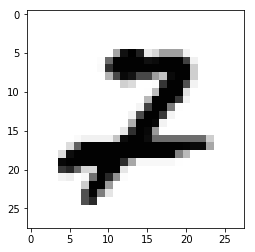

Pred value: 2
True value: 7


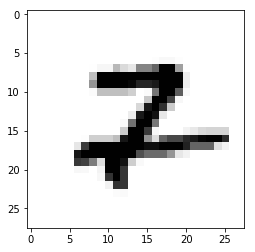

Pred value: 5
True value: 0


Pred value: 2
True value: 7


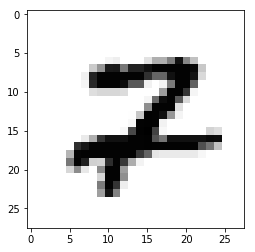

Pred value: 5
True value: 8


Pred value: 2
True value: 7


Pred value: 2
True value: 7


Pred value: 5
True value: 8


Pred value: 2
True value: 7


Pred value: 2
True value: 7


Pred value: 6
True value: 4


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 7


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 2


Pred value: 3
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 4
True value: 2


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 9
True value: 7


Pred value: 9
True value: 7


Pred value: 3
True value: 8


Pred value: 4
True value: 9


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 7
True value: 9


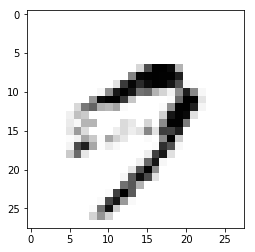

Pred value: 9
True value: 7


Pred value: 7
True value: 2


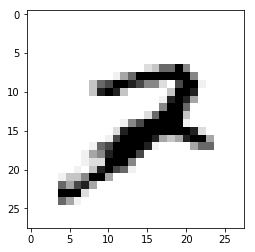

Pred value: 3
True value: 8


Pred value: 4
True value: 2


Pred value: 5
True value: 8


Pred value: 3
True value: 2


Pred value: 5
True value: 8


Pred value: 5
True value: 6


Pred value: 6
True value: 4


Pred value: 1
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 2


Pred value: 5
True value: 2


Pred value: 3
True value: 8


Pred value: 5
True value: 6


Pred value: 9
True value: 4


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 9


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 6
True value: 4


Pred value: 5
True value: 8


Pred value: 2
True value: 0


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 8


Pred value: 5
True value: 2


Pred value: 9
True value: 3


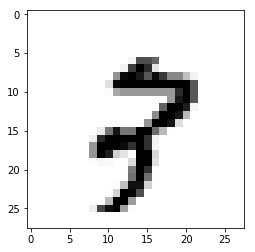

Pred value: 5
True value: 8


Pred value: 9
True value: 4


Pred value: 2
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 2


Pred value: 5
True value: 3


Pred value: 7
True value: 8


Pred value: 5
True value: 8


Pred value: 3
True value: 8


In [0]:
# Loading dataset
(train_x, y_train), (test_x, y_test) = tf.keras.datasets.mnist.load_data()
# Reshaping the array to 4-dims so that it can work with the Keras API
x_train = train_x.reshape(train_x.shape[0], 28, 28, 1)
x_test = test_x.reshape(test_x.shape[0], 28, 28, 1)
input_shape = (28, 28, 1)
# Making sure that the values are float so that we can get decimal points after division
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
# Normalizing the RGB codes by dividing it to the max RGB value.
#x_train /= 255
#x_test /= 255
print('x_train shape:', x_train.shape)
print('Number of images in x_train', x_train.shape[0])
print('Number of images in x_test', x_test.shape[0])
# Creating a Sequential Model and adding the layers
model = Sequential()
#model.add(Conv2D(28, kernel_size=(5,5), input_shape=input_shape))
#model.add(MaxPooling2D(pool_size=(2, 2)))
#model.add(Conv2D(28, kernel_size=(3,3), input_shape=input_shape))
#model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(28, kernel_size=(5,1)))
model.add(Conv2D(28, kernel_size=(1,5)))
model.add(MaxPooling2D(pool_size=(4, 4)))
#model.add(Conv2D(28, kernel_size=(3,1)))
#model.add(Conv2D(28, kernel_size=(1,3)))
#model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten()) # Flattening the 2D arrays for fully connected layers
model.add(Dense(128, activation=tf.nn.relu))
model.add(Dropout(0.5))      
model.add(Dense(10,activation=tf.nn.softmax))
model.compile(optimizer='adam', 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)
his = model.fit(x=x_train,y=y_train, epochs=50)
_, train_acc = model.evaluate(x_train, y_train, verbose=0)
_, test_acc = model.evaluate(x_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
y_pred = model.predict(x_test)
print(y_pred.shape)
print(y_test.shape)
y = np.argmax(y_pred, axis=1)
print(y.shape)
confusion_matrix(y_test, y)
for i in range(10000):
    if(y[i] != y_test[i]):
        print("Pred value:",y[i])
        print("True value:",y_test[i])
        plt.figure
        plt.imshow(x_test[i].reshape(28, 28),cmap='Greys')
        plt.show()

In [0]:
# Loading dataset
(train_x, y_train), (test_x, y_test) = tf.keras.datasets.mnist.load_data()
# Reshaping the array to 4-dims so that it can work with the Keras API
x_train = train_x.reshape(train_x.shape[0], 28, 28, 1)
x_test = test_x.reshape(test_x.shape[0], 28, 28, 1)
input_shape = (28, 28, 1)
# Making sure that the values are float so that we can get decimal points after division
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
# Normalizing the RGB codes by dividing it to the max RGB value.
#x_train /= 255
#x_test /= 255
print('x_train shape:', x_train.shape)
print('Number of images in x_train', x_train.shape[0])
print('Number of images in x_test', x_test.shape[0])
# Creating a Sequential Model and adding the layers
model = Sequential()
model.add(Conv2D(28, kernel_size=(5,5), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(4, 4)))
model.add(Conv2D(28, kernel_size=(3,3), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
#model.add(Conv2D(28, kernel_size=(5,1)))
#model.add(Conv2D(28, kernel_size=(1,5)))
#model.add(MaxPooling2D(pool_size=(4, 4)))
#model.add(Conv2D(28, kernel_size=(3,1)))
#model.add(Conv2D(28, kernel_size=(1,3)))
#model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten()) # Flattening the 2D arrays for fully connected layers
model.add(Dense(100, activation=tf.nn.relu))
model.add(Dropout(0.5))      
model.add(Dense(10,activation=tf.nn.softmax))
print(model.summary())
model.compile(optimizer='adam', 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)
his = model.fit(x=x_train,y=y_train, epochs=50)
_, train_acc = model.evaluate(x_train, y_train, verbose=0)
_, test_acc = model.evaluate(x_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
y_pred = model.predict(x_test)
print(y_pred.shape)
print(y_test.shape)
y = np.argmax(y_pred, axis=1)
print(y.shape)
confusion_matrix(y_test, y)
for i in range(10000):
    if(y[i] != y_test[i]):
        print("Pred value:",y[i])
        print("True value:",y_test[i])
        plt.figure
        plt.imshow(x_test[i].reshape(28, 28),cmap='Greys')
        plt.show()

x_train shape: (60000, 28, 28, 1)
Number of images in x_train 60000
Number of images in x_test 10000
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_5 (Conv2D)            (None, 24, 24, 28)        728       
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 6, 6, 28)          0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 4, 4, 28)          7084      
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 2, 2, 28)          0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 112)               0         
_________________________________________________________________
dense_5 (Dense)              (None, 100)               11300     
_________________________________________

NameError: ignored

In [0]:
# Loading dataset
(train_x, y_train), (test_x, y_test) = tf.keras.datasets.mnist.load_data()
# Reshaping the array to 4-dims so that it can work with the Keras API
x_train = train_x.reshape(train_x.shape[0], 28, 28, 1)
x_test = test_x.reshape(test_x.shape[0], 28, 28, 1)
input_shape = (28, 28, 1)
# Making sure that the values are float so that we can get decimal points after division
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
# Normalizing the RGB codes by dividing it to the max RGB value.
#x_train /= 255
#x_test /= 255
print('x_train shape:', x_train.shape)
print('Number of images in x_train', x_train.shape[0])
print('Number of images in x_test', x_test.shape[0])
# Creating a Sequential Model and adding the layers
model = Sequential()
model.add(Conv2D(28, kernel_size=(5,5), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(4, 4)))
#model.add(Conv2D(28, kernel_size=(3,3), input_shape=input_shape))
#model.add(MaxPooling2D(pool_size=(2, 2)))
#model.add(Conv2D(28, kernel_size=(5,1)))
#model.add(Conv2D(28, kernel_size=(1,5)))
#model.add(MaxPooling2D(pool_size=(4, 4)))
model.add(Conv2D(28, kernel_size=(3,1)))
model.add(Conv2D(28, kernel_size=(1,3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten()) # Flattening the 2D arrays for fully connected layers
model.add(Dense(128, activation=tf.nn.relu))
model.add(Dropout(0.5))      
model.add(Dense(10,activation=tf.nn.softmax))
print(model.summary())
model.compile(optimizer='adam', 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)
his = model.fit(x=x_train,y=y_train, epochs=50)
_, train_acc = model.evaluate(x_train, y_train, verbose=0)
_, test_acc = model.evaluate(x_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
y_pred = model.predict(x_test)
print(y_pred.shape)
print(y_test.shape)
y = np.argmax(y_pred, axis=1)
print(y.shape)
confusion_matrix(y_test, y)
for i in range(10000):
    if(y[i] != y_test[i]):
        print("Pred value:",y[i])
        print("True value:",y_test[i])
        plt.figure
        plt.imshow(x_test[i].reshape(28, 28),cmap='Greys')
        plt.show()

x_train shape: (60000, 28, 28, 1)
Number of images in x_train 60000
Number of images in x_test 10000
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_7 (Conv2D)            (None, 24, 24, 28)        728       
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 6, 6, 28)          0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 4, 6, 28)          2380      
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 4, 4, 28)          2380      
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 2, 2, 28)          0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 112)               0         
_________________________________________

NameError: ignored

x_train shape: (60000, 28, 28, 1)
Number of images in x_train 60000
Number of images in x_test 10000
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 24, 24, 28)        728       
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 6, 6, 28)          0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 4, 4, 28)          7084      
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 2, 2, 28)          0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 112)               0         
_________________________________________________________________
dense_9 (Dense)              (None, 128)               14464     
_________________________________________

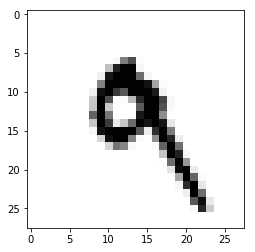

Pred value: 5
True value: 3


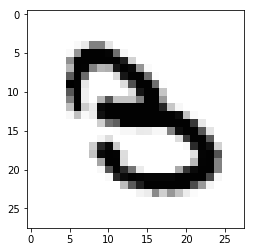

Pred value: 4
True value: 9


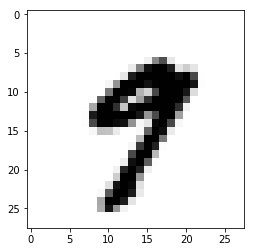

Pred value: 6
True value: 4


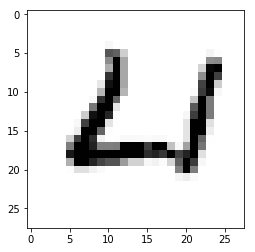

Pred value: 5
True value: 3


Pred value: 8
True value: 9


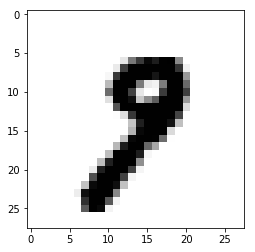

Pred value: 8
True value: 9


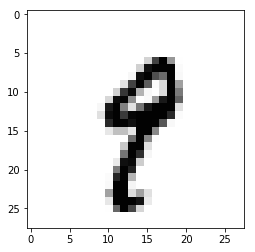

Pred value: 9
True value: 7


Pred value: 4
True value: 9


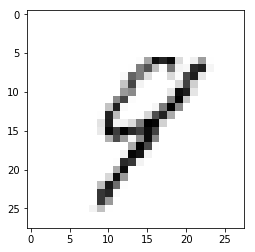

Pred value: 8
True value: 4


Pred value: 4
True value: 9


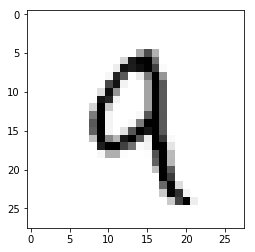

Pred value: 8
True value: 4


Pred value: 4
True value: 5


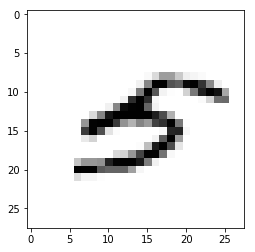

Pred value: 4
True value: 9


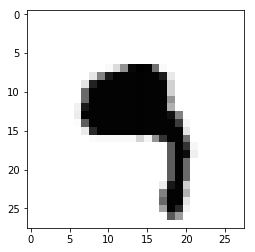

Pred value: 5
True value: 6


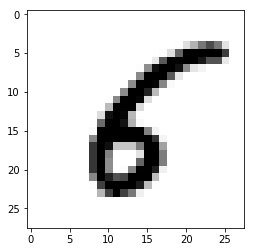

Pred value: 5
True value: 3


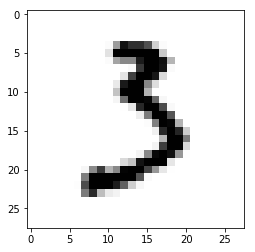

Pred value: 1
True value: 4


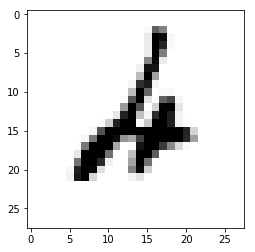

Pred value: 0
True value: 6


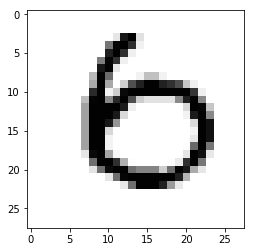

Pred value: 4
True value: 9


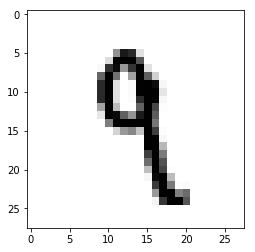

Pred value: 2
True value: 7


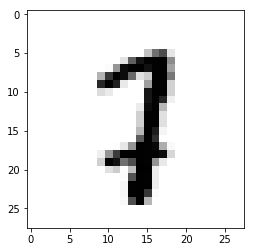

Pred value: 4
True value: 8


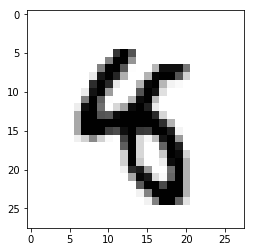

Pred value: 5
True value: 3


Pred value: 7
True value: 9


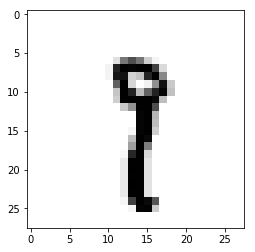

Pred value: 4
True value: 9


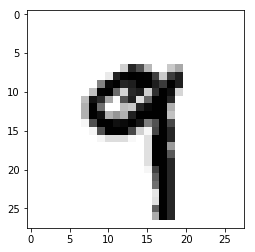

Pred value: 5
True value: 0


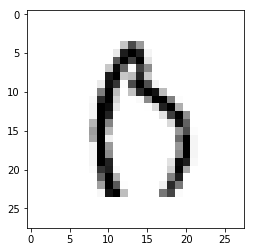

Pred value: 3
True value: 5


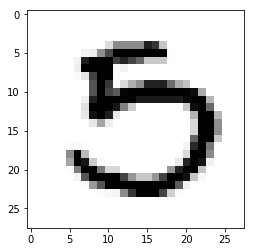

Pred value: 4
True value: 9


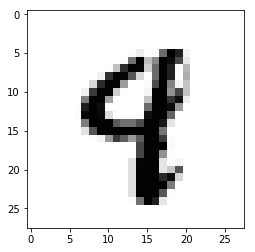

Pred value: 8
True value: 5


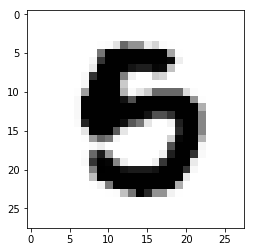

Pred value: 4
True value: 9


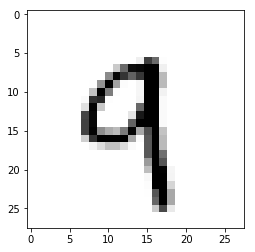

Pred value: 9
True value: 4


Pred value: 0
True value: 2


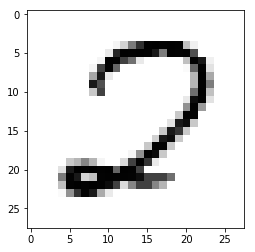

Pred value: 8
True value: 0


Pred value: 0
True value: 6


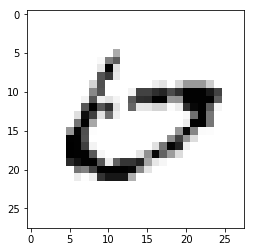

Pred value: 4
True value: 9


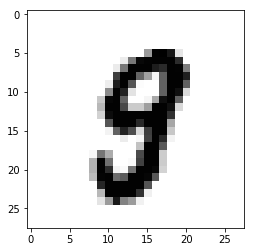

Pred value: 5
True value: 3


Pred value: 5
True value: 3


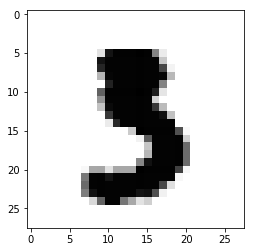

Pred value: 7
True value: 3


Pred value: 4
True value: 9


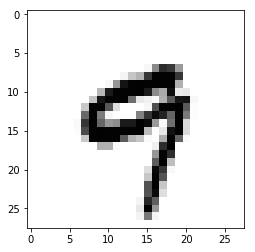

Pred value: 2
True value: 0


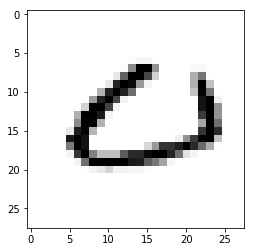

Pred value: 8
True value: 0


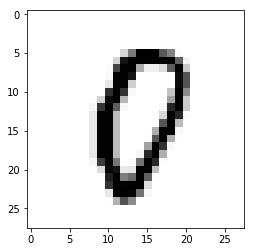

Pred value: 5
True value: 3


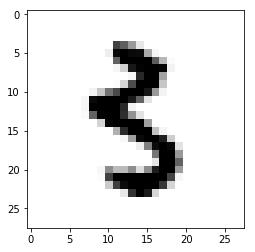

Pred value: 1
True value: 4


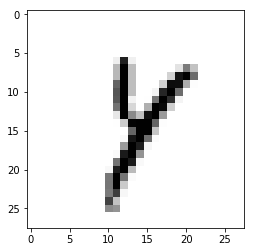

Pred value: 4
True value: 9


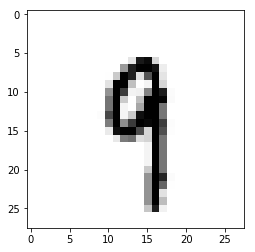

Pred value: 2
True value: 3


Pred value: 4
True value: 9


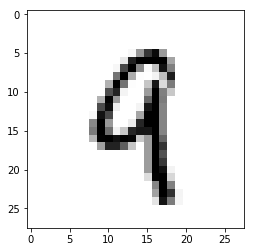

Pred value: 9
True value: 8


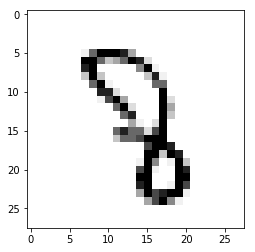

Pred value: 8
True value: 0


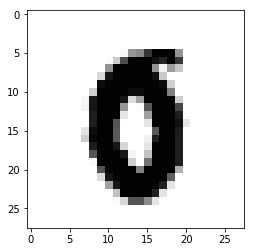

Pred value: 5
True value: 3


Pred value: 4
True value: 9


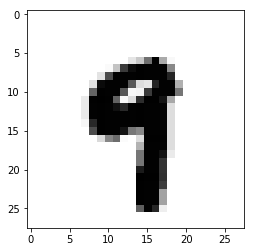

Pred value: 2
True value: 3


Pred value: 2
True value: 8


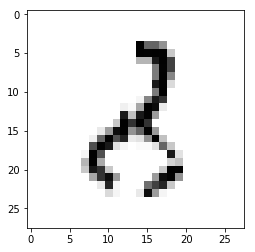

Pred value: 6
True value: 8


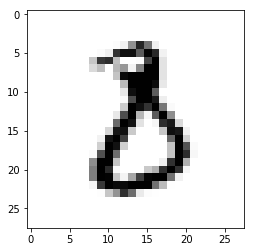

Pred value: 5
True value: 0


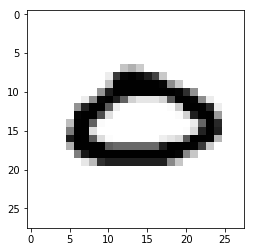

Pred value: 7
True value: 2


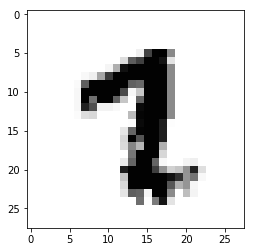

Pred value: 1
True value: 0


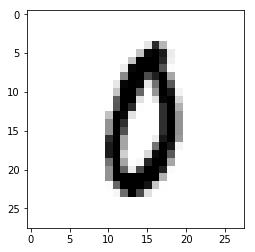

Pred value: 5
True value: 3


Pred value: 3
True value: 7


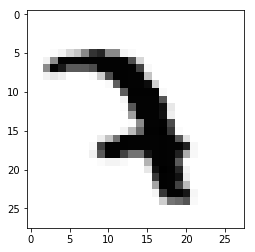

Pred value: 4
True value: 7


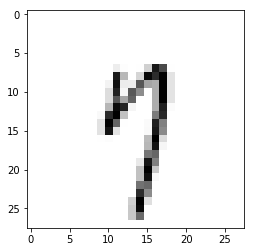

Pred value: 5
True value: 0


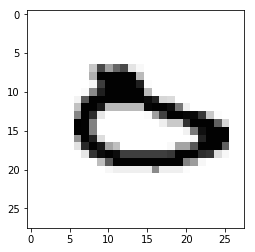

Pred value: 6
True value: 5


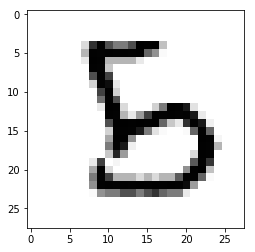

Pred value: 6
True value: 0


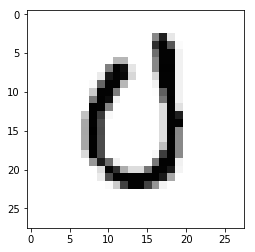

Pred value: 5
True value: 7


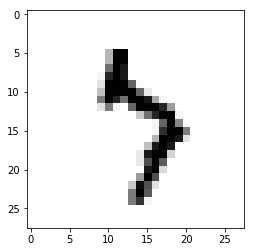

Pred value: 9
True value: 7


Pred value: 5
True value: 6


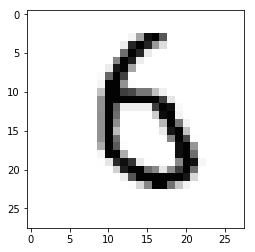

Pred value: 8
True value: 0


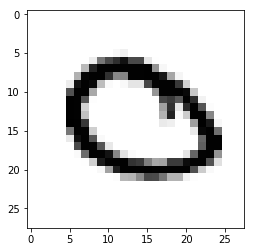

Pred value: 2
True value: 7


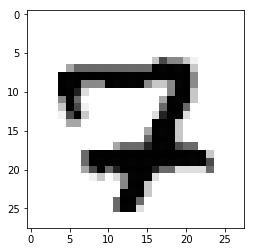

Pred value: 8
True value: 9


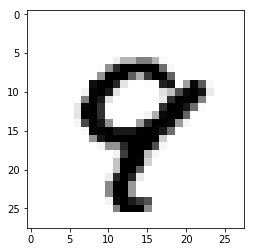

Pred value: 4
True value: 9


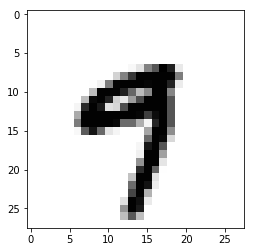

Pred value: 4
True value: 8


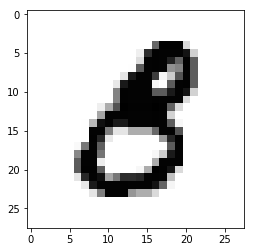

Pred value: 9
True value: 7


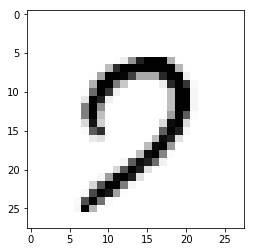

Pred value: 4
True value: 9


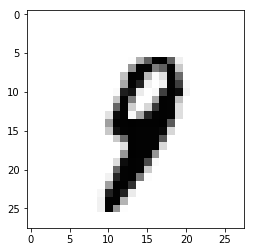

Pred value: 5
True value: 3


Pred value: 2
True value: 7


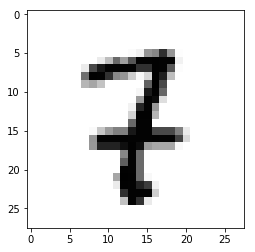

Pred value: 5
True value: 3


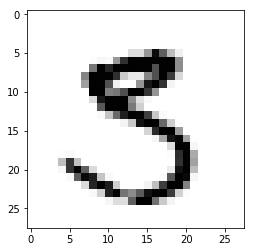

Pred value: 5
True value: 3


Pred value: 4
True value: 9


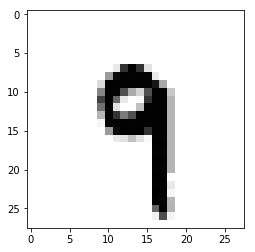

Pred value: 5
True value: 1


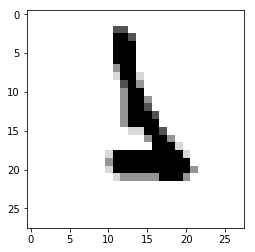

Pred value: 8
True value: 6


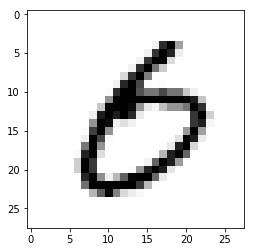

Pred value: 2
True value: 3


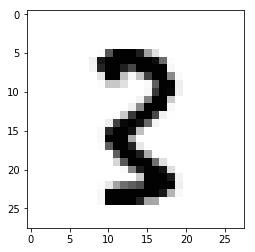

Pred value: 4
True value: 9


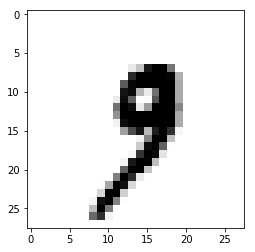

Pred value: 4
True value: 9


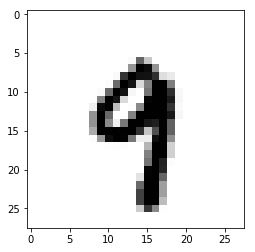

Pred value: 5
True value: 6


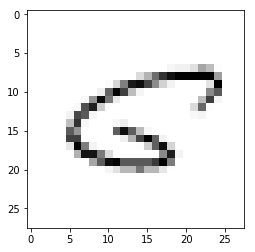

Pred value: 1
True value: 8


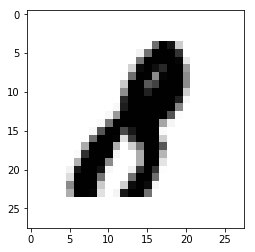

Pred value: 5
True value: 7


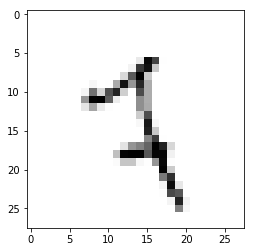

Pred value: 8
True value: 6


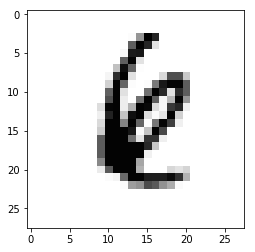

Pred value: 4
True value: 9


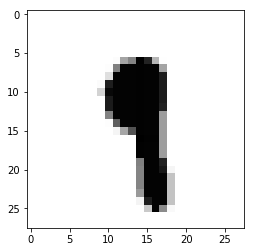

Pred value: 9
True value: 7


Pred value: 7
True value: 3


Pred value: 9
True value: 7


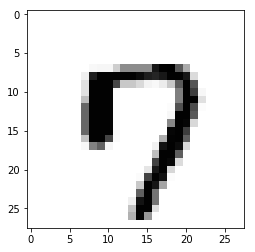

Pred value: 4
True value: 9


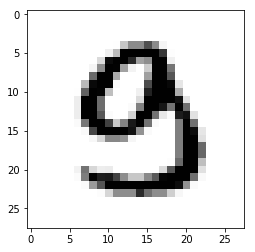

Pred value: 6
True value: 4


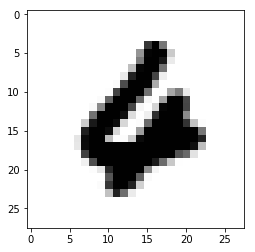

Pred value: 2
True value: 7


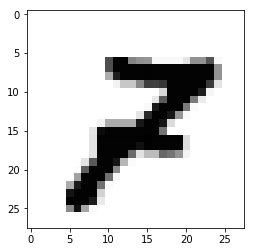

Pred value: 9
True value: 8


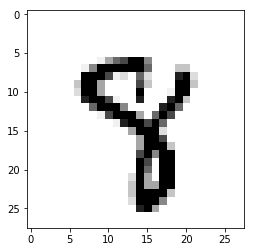

Pred value: 7
True value: 3


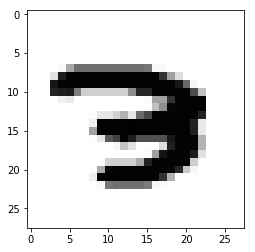

Pred value: 8
True value: 4


Pred value: 9
True value: 7


Pred value: 1
True value: 0


Pred value: 8
True value: 4


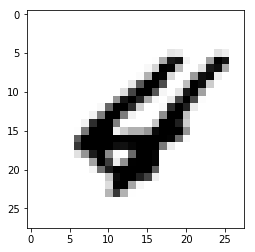

Pred value: 1
True value: 6


Pred value: 5
True value: 6


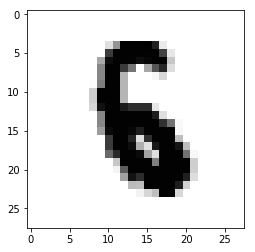

Pred value: 5
True value: 0


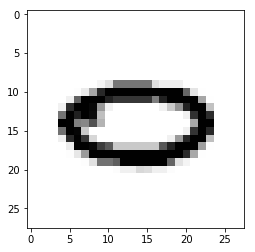

Pred value: 6
True value: 8


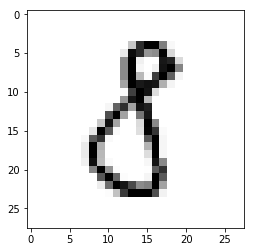

Pred value: 2
True value: 3


Pred value: 5
True value: 3


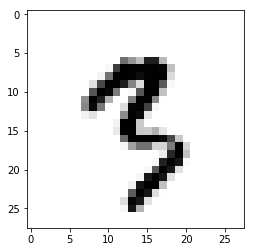

Pred value: 4
True value: 9


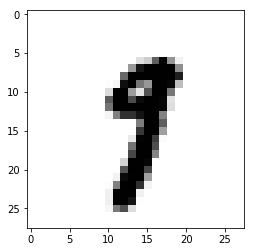

Pred value: 2
True value: 7


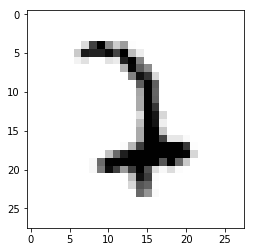

Pred value: 6
True value: 9


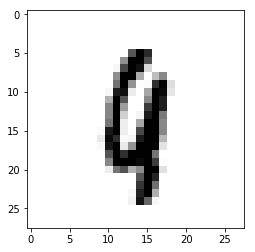

Pred value: 5
True value: 3


Pred value: 3
True value: 9


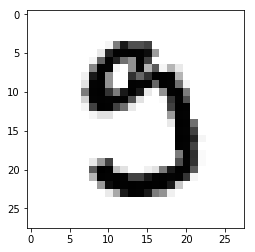

Pred value: 5
True value: 8


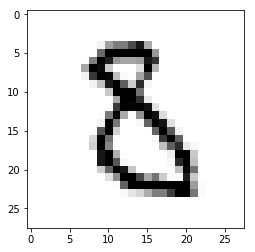

Pred value: 6
True value: 0


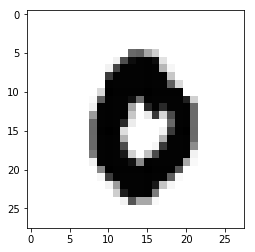

Pred value: 9
True value: 4


Pred value: 2
True value: 7


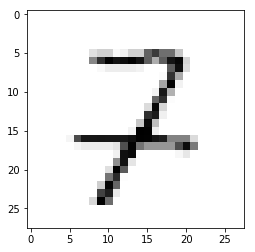

Pred value: 1
True value: 0


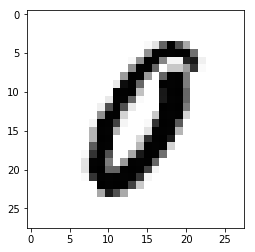

Pred value: 5
True value: 3


Pred value: 3
True value: 5


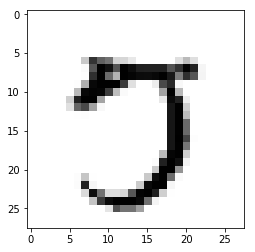

Pred value: 5
True value: 3


Pred value: 7
True value: 2


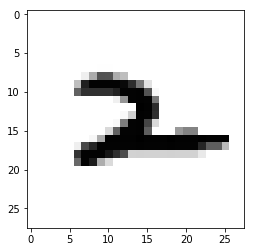

Pred value: 4
True value: 7


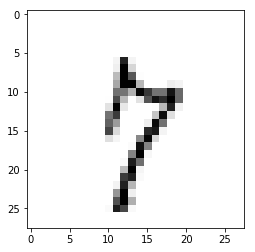

Pred value: 1
True value: 0


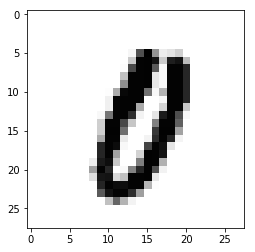

Pred value: 8
True value: 0


Pred value: 4
True value: 9


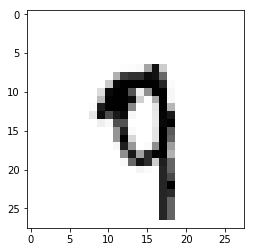

Pred value: 6
True value: 8


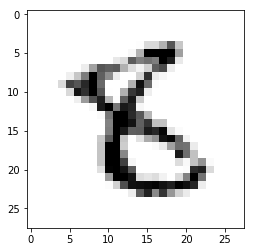

Pred value: 4
True value: 9


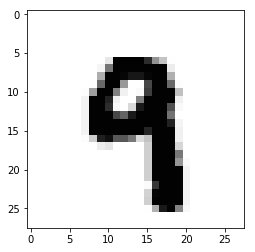

Pred value: 4
True value: 9


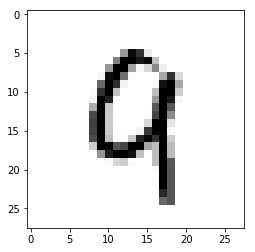

Pred value: 1
True value: 8


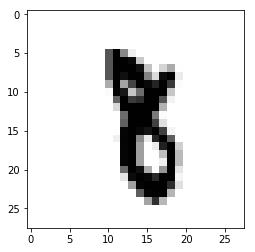

Pred value: 5
True value: 0


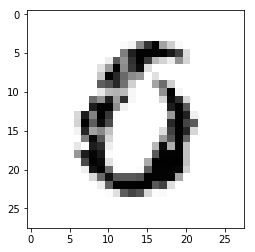

Pred value: 4
True value: 9


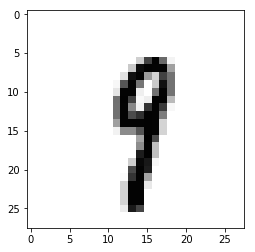

Pred value: 8
True value: 0


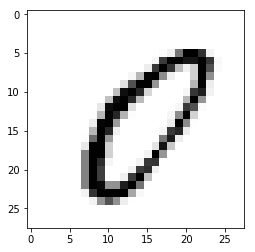

Pred value: 5
True value: 3


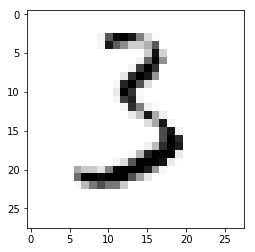

Pred value: 5
True value: 8


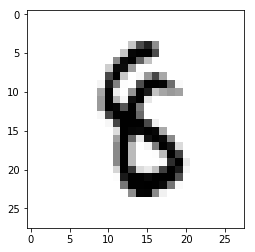

Pred value: 4
True value: 9


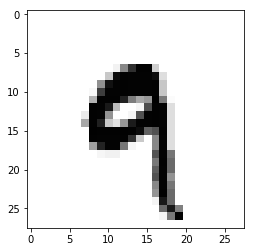

Pred value: 9
True value: 7


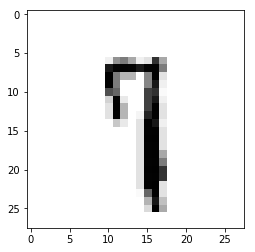

Pred value: 5
True value: 8


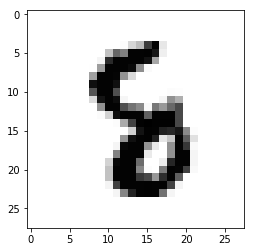

Pred value: 5
True value: 1


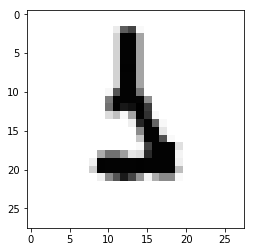

Pred value: 5
True value: 3


Pred value: 3
True value: 9


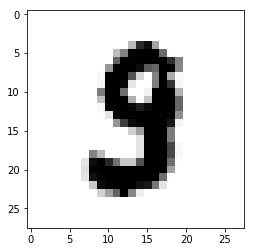

Pred value: 8
True value: 0


Pred value: 5
True value: 9


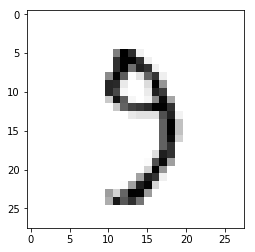

Pred value: 4
True value: 6


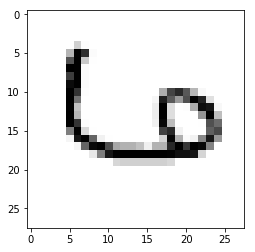

Pred value: 4
True value: 9


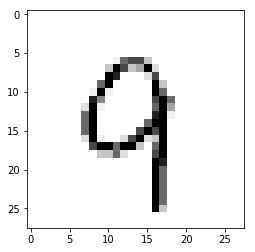

Pred value: 5
True value: 3


Pred value: 5
True value: 3


Pred value: 5
True value: 3


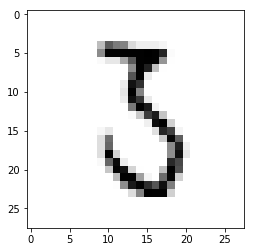

Pred value: 6
True value: 0


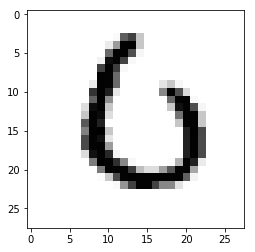

Pred value: 5
True value: 6


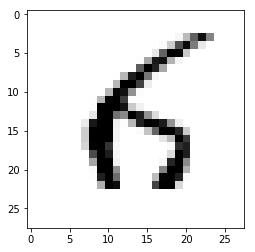

Pred value: 1
True value: 2


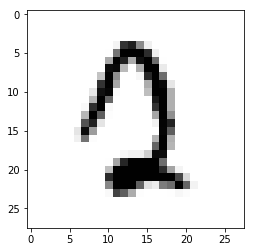

Pred value: 7
True value: 3


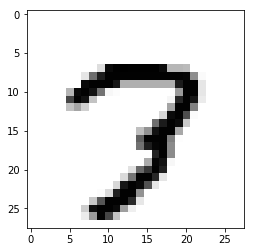

Pred value: 5
True value: 8


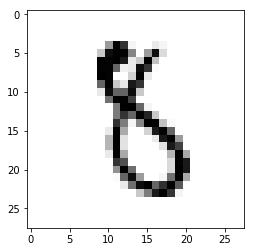

Pred value: 5
True value: 9


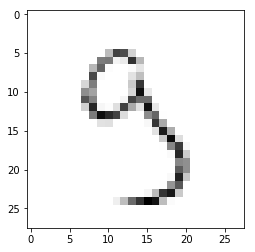

Pred value: 4
True value: 7


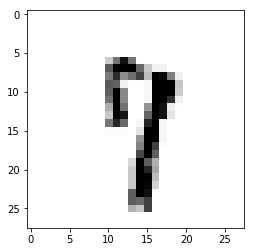

Pred value: 7
True value: 2


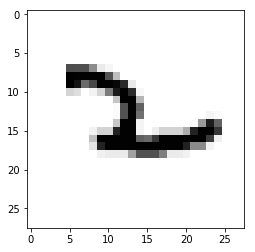

Pred value: 5
True value: 3


Pred value: 4
True value: 0


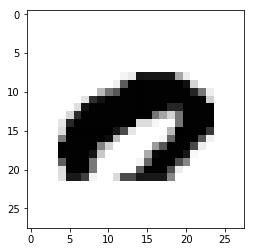

Pred value: 2
True value: 7


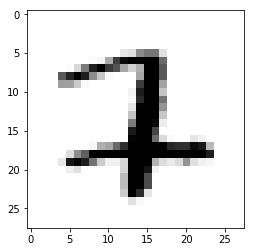

Pred value: 5
True value: 7


Pred value: 4
True value: 9


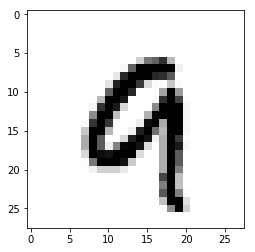

Pred value: 7
True value: 2


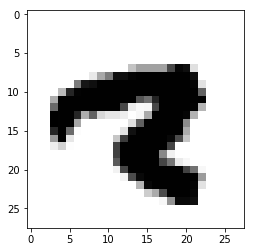

Pred value: 4
True value: 0


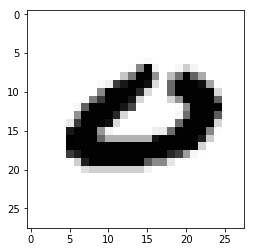

Pred value: 0
True value: 8


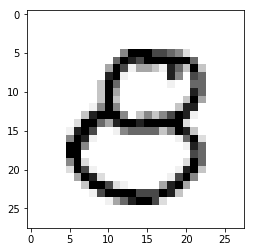

Pred value: 5
True value: 6


Pred value: 5
True value: 6


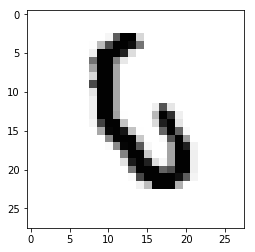

Pred value: 4
True value: 9


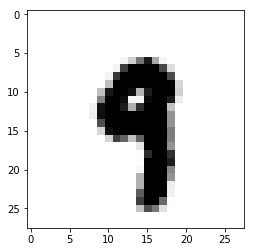

Pred value: 2
True value: 0


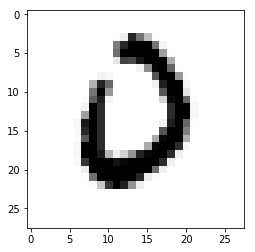

Pred value: 8
True value: 5


Pred value: 4
True value: 9


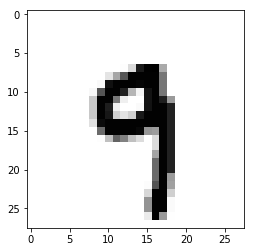

Pred value: 3
True value: 8


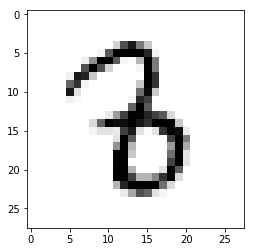

Pred value: 8
True value: 9


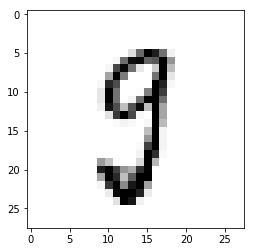

Pred value: 0
True value: 9


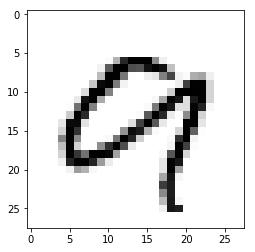

Pred value: 2
True value: 7


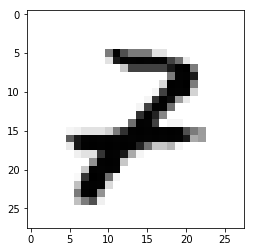

Pred value: 5
True value: 3


Pred value: 8
True value: 4


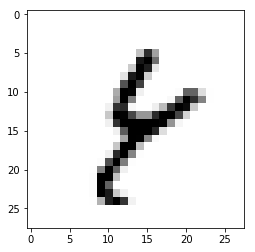

Pred value: 4
True value: 9


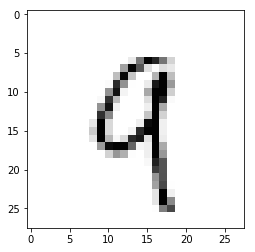

Pred value: 8
True value: 0


Pred value: 4
True value: 9


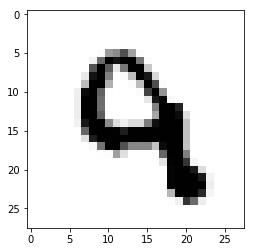

Pred value: 4
True value: 7


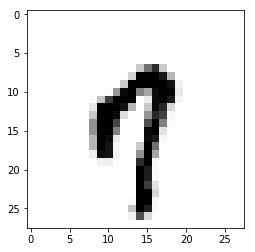

Pred value: 4
True value: 9


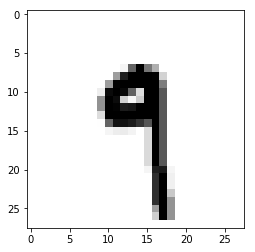

Pred value: 5
True value: 3


Pred value: 9
True value: 3


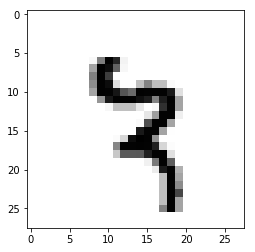

Pred value: 0
True value: 6


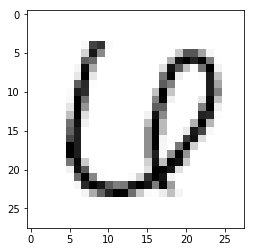

Pred value: 8
True value: 9


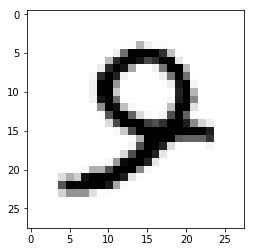

Pred value: 1
True value: 6


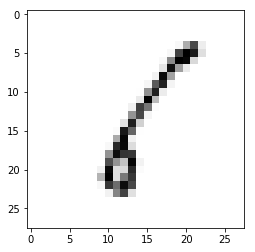

Pred value: 5
True value: 3


Pred value: 4
True value: 9


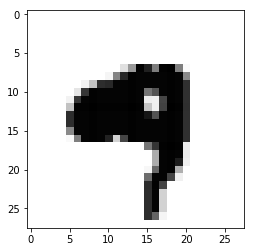

Pred value: 4
True value: 5


Pred value: 3
True value: 1


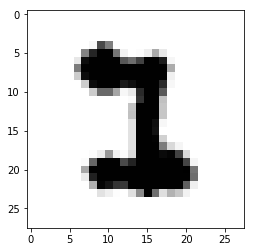

Pred value: 8
True value: 0


Pred value: 3
True value: 2


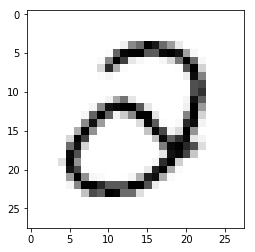

Pred value: 8
True value: 0


Pred value: 1
True value: 9


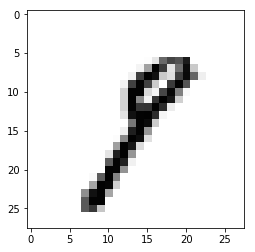

Pred value: 4
True value: 9


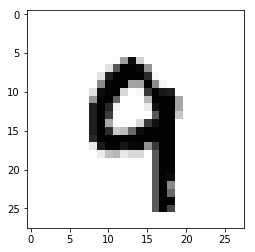

Pred value: 4
True value: 9


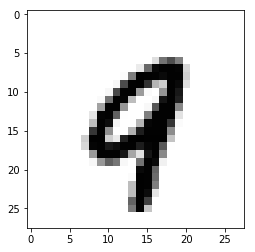

Pred value: 5
True value: 1


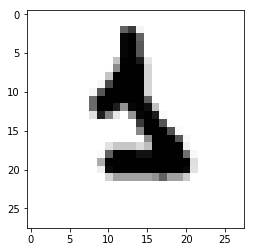

Pred value: 9
True value: 7


Pred value: 5
True value: 3


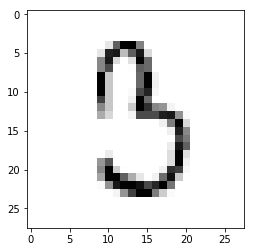

Pred value: 6
True value: 9


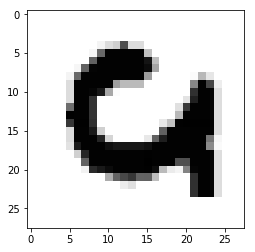

Pred value: 8
True value: 3


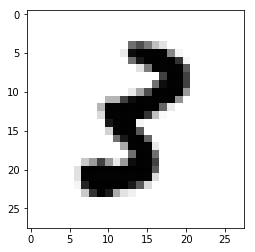

Pred value: 4
True value: 9


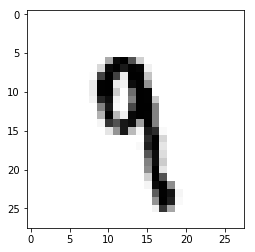

Pred value: 4
True value: 9


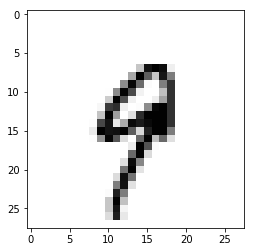

Pred value: 5
True value: 0


Pred value: 9
True value: 0


Pred value: 7
True value: 9


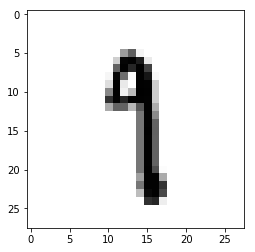

Pred value: 1
True value: 9


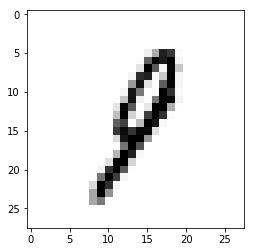

Pred value: 5
True value: 3


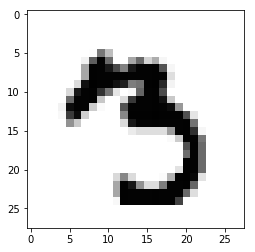

Pred value: 4
True value: 9


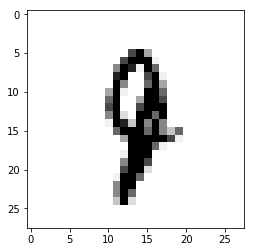

Pred value: 8
True value: 0


Pred value: 5
True value: 3


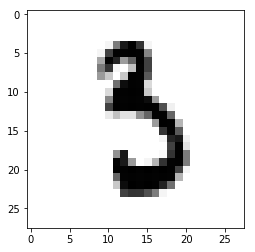

Pred value: 5
True value: 6


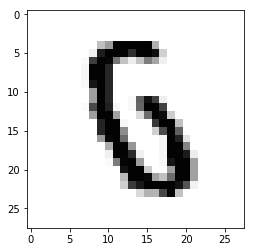

Pred value: 6
True value: 2


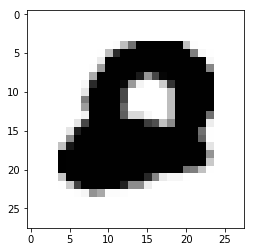

Pred value: 4
True value: 9


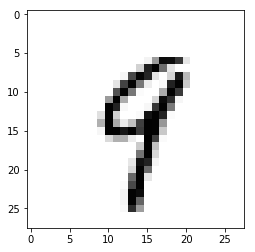

Pred value: 4
True value: 9


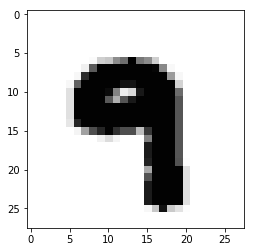

Pred value: 4
True value: 9


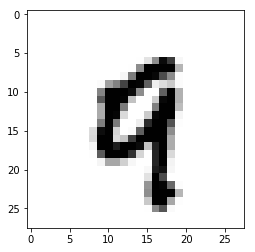

Pred value: 5
True value: 3


Pred value: 4
True value: 9


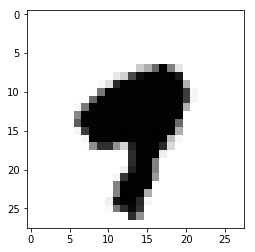

Pred value: 8
True value: 0


Pred value: 8
True value: 5


Pred value: 4
True value: 9


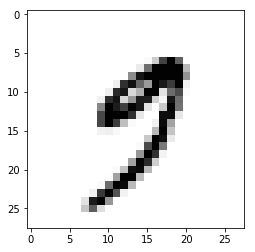

Pred value: 3
True value: 5


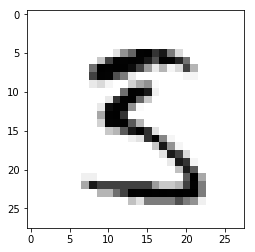

Pred value: 5
True value: 3


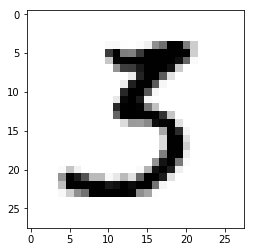

Pred value: 2
True value: 7


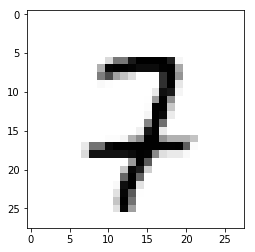

Pred value: 6
True value: 0


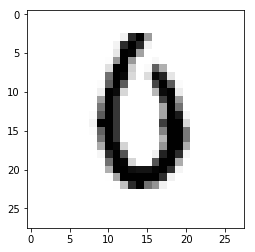

Pred value: 7
True value: 2


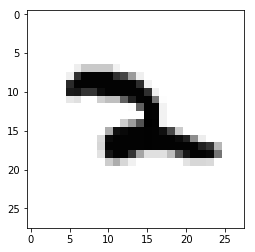

Pred value: 4
True value: 9


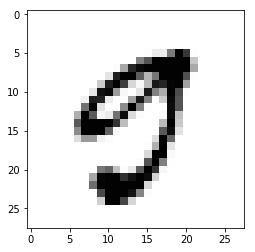

Pred value: 1
True value: 6


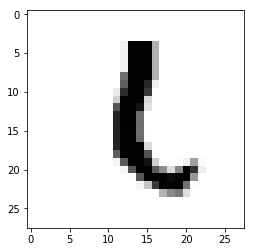

Pred value: 2
True value: 7


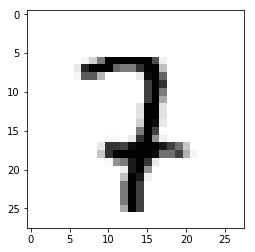

Pred value: 4
True value: 9


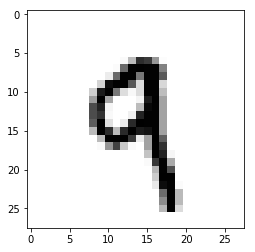

Pred value: 5
True value: 7


Pred value: 8
True value: 0


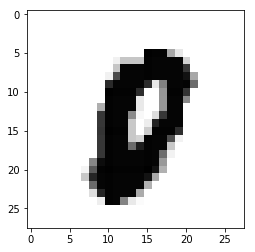

Pred value: 4
True value: 9


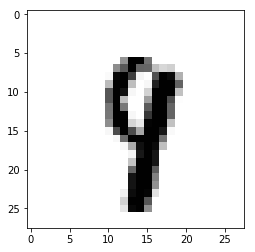

Pred value: 4
True value: 7


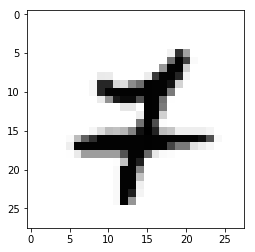

Pred value: 4
True value: 9


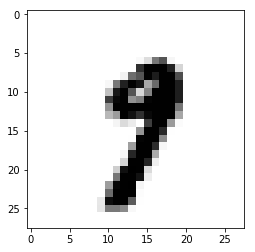

Pred value: 9
True value: 7


Pred value: 5
True value: 6


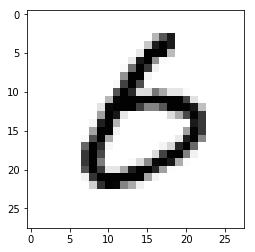

Pred value: 4
True value: 9


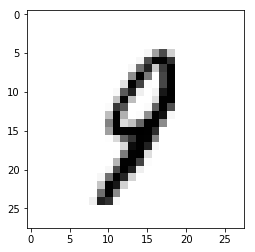

Pred value: 4
True value: 3


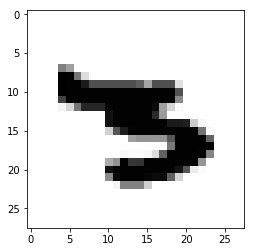

Pred value: 3
True value: 2


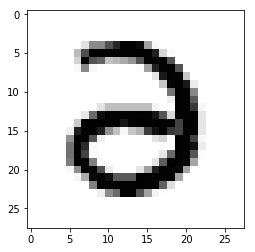

Pred value: 4
True value: 9


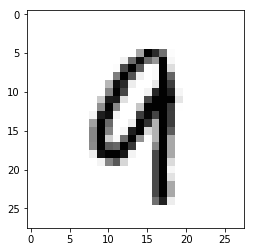

Pred value: 8
True value: 4


Pred value: 4
True value: 7


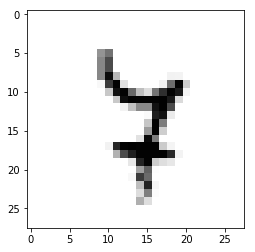

Pred value: 4
True value: 9


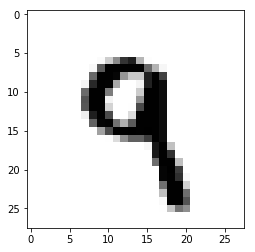

Pred value: 4
True value: 9


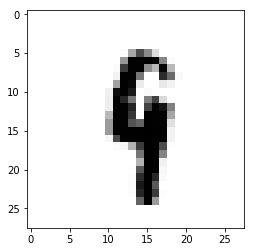

Pred value: 4
True value: 9


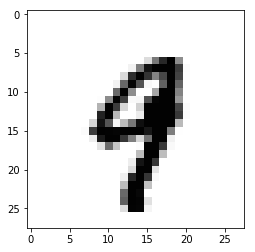

Pred value: 5
True value: 0


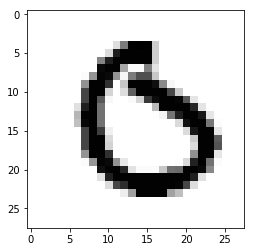

Pred value: 5
True value: 3


Pred value: 4
True value: 9


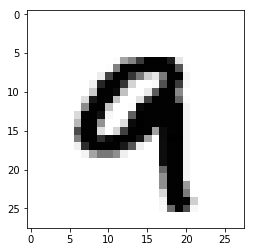

Pred value: 4
True value: 9


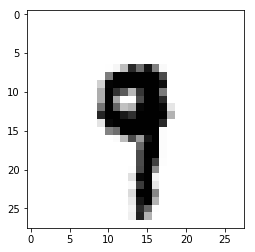

Pred value: 2
True value: 3


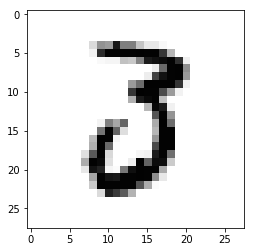

Pred value: 7
True value: 3


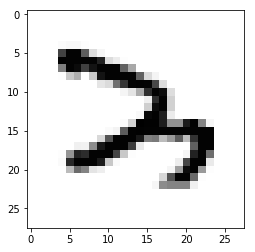

Pred value: 1
True value: 5


Pred value: 6
True value: 4


Pred value: 5
True value: 9


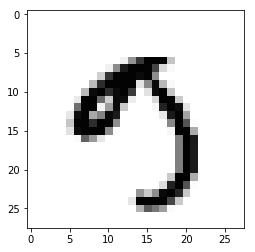

Pred value: 7
True value: 3


Pred value: 5
True value: 3


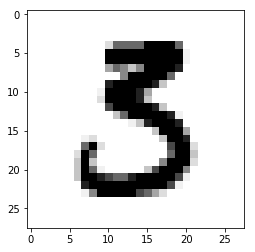

Pred value: 5
True value: 3


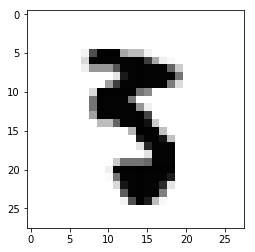

Pred value: 4
True value: 9


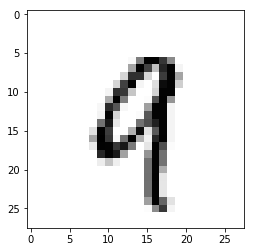

Pred value: 3
True value: 5


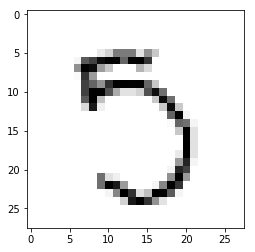

Pred value: 6
True value: 0


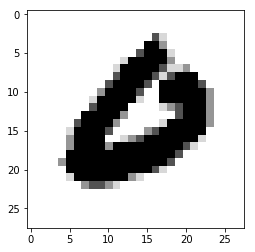

Pred value: 4
True value: 9


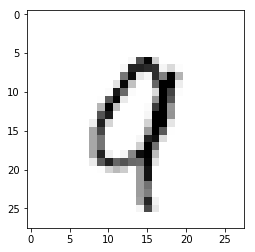

Pred value: 5
True value: 6


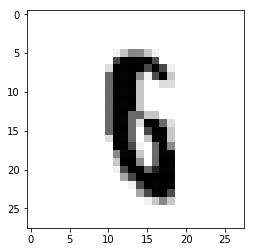

Pred value: 1
True value: 9


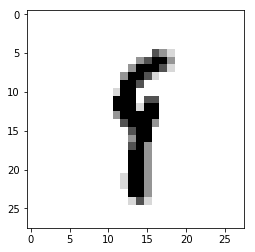

Pred value: 4
True value: 9


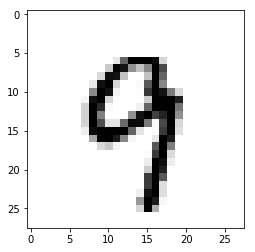

Pred value: 5
True value: 0


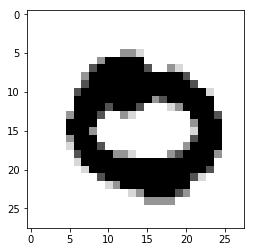

Pred value: 5
True value: 8


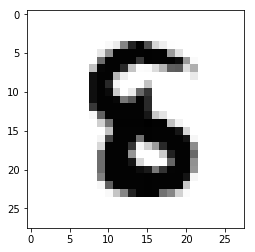

Pred value: 8
True value: 6


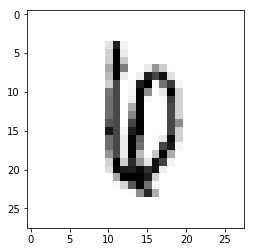

Pred value: 4
True value: 7


Pred value: 1
True value: 9


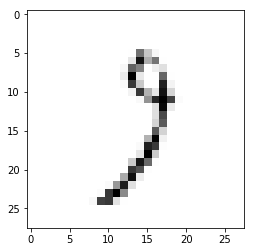

Pred value: 2
True value: 1


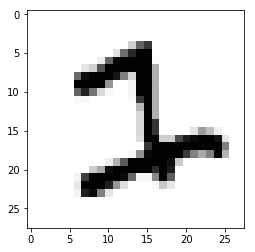

Pred value: 9
True value: 7


Pred value: 5
True value: 3


Pred value: 5
True value: 6


Pred value: 2
True value: 1


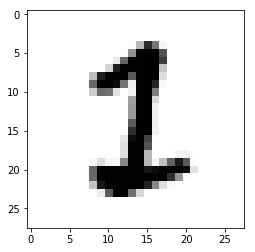

Pred value: 5
True value: 3


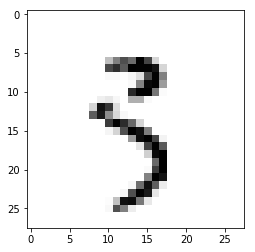

Pred value: 4
True value: 9


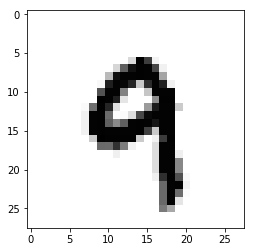

Pred value: 1
True value: 7


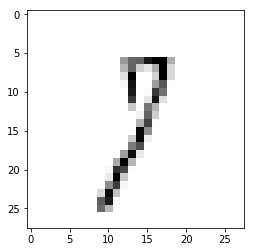

Pred value: 4
True value: 9


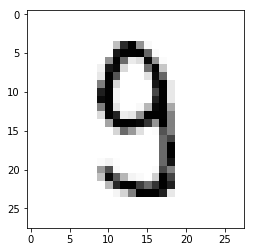

Pred value: 9
True value: 0


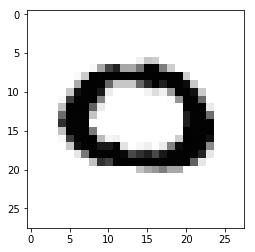

Pred value: 5
True value: 0


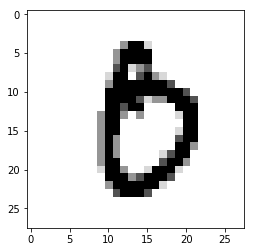

Pred value: 6
True value: 0


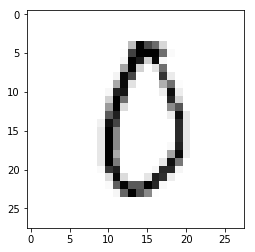

Pred value: 4
True value: 7


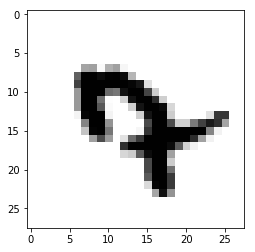

Pred value: 5
True value: 0


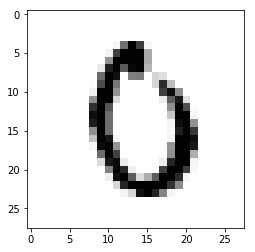

Pred value: 2
True value: 7


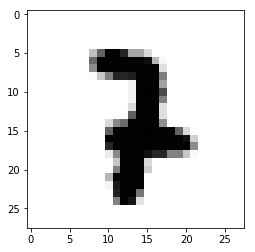

Pred value: 4
True value: 7


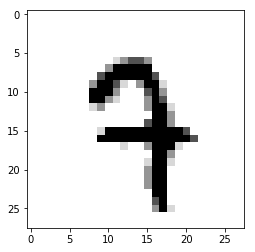

Pred value: 7
True value: 2


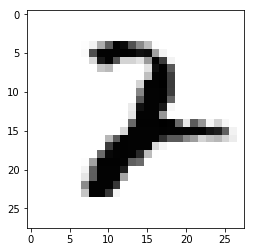

Pred value: 5
True value: 0


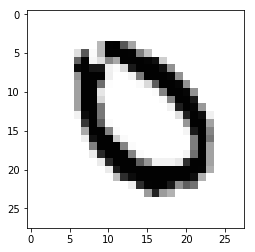

Pred value: 8
True value: 0


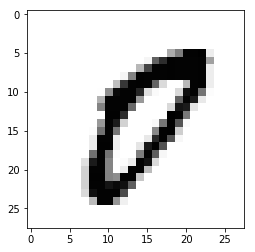

Pred value: 6
True value: 2


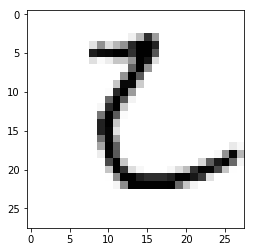

Pred value: 7
True value: 2


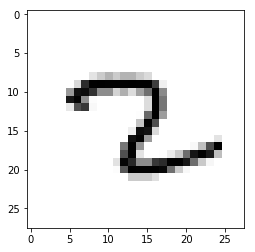

Pred value: 8
True value: 0


Pred value: 8
True value: 7


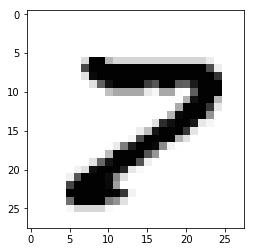

Pred value: 2
True value: 6


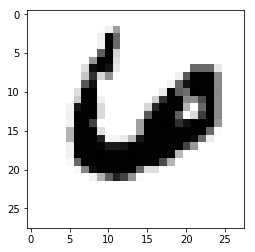

Pred value: 8
True value: 0


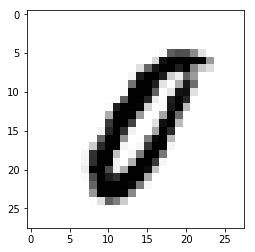

Pred value: 4
True value: 9


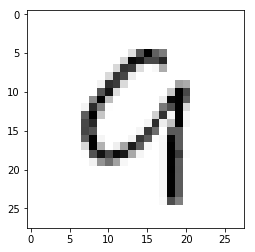

Pred value: 7
True value: 3


Pred value: 7
True value: 2


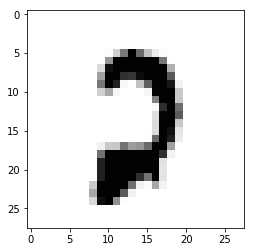

Pred value: 4
True value: 6


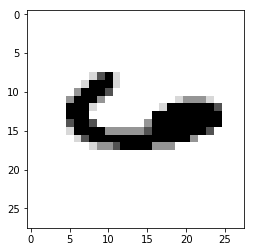

Pred value: 2
True value: 3


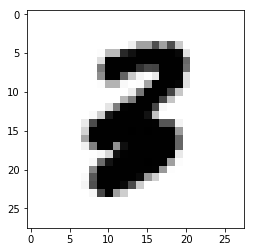

Pred value: 5
True value: 6


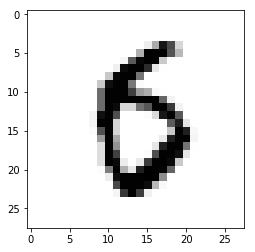

Pred value: 7
True value: 2


Pred value: 3
True value: 9


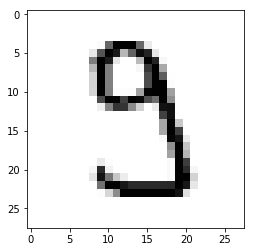

Pred value: 5
True value: 1


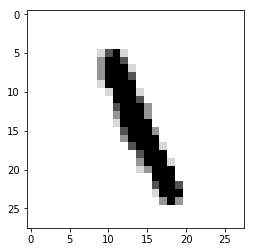

Pred value: 3
True value: 8


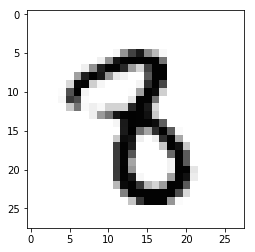

Pred value: 6
True value: 0


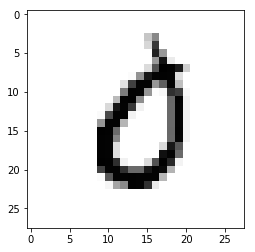

Pred value: 4
True value: 9


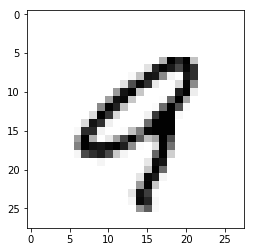

Pred value: 5
True value: 6


Pred value: 4
True value: 9


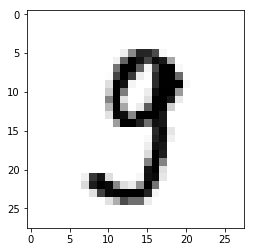

Pred value: 8
True value: 9


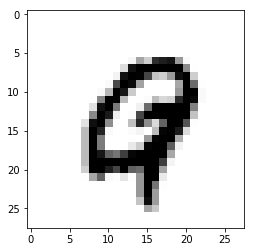

Pred value: 9
True value: 7


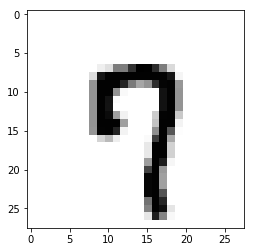

Pred value: 5
True value: 3


Pred value: 9
True value: 3


Pred value: 2
True value: 9


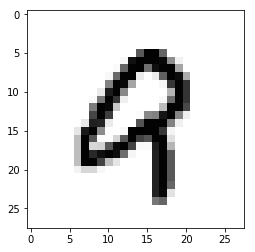

Pred value: 2
True value: 7


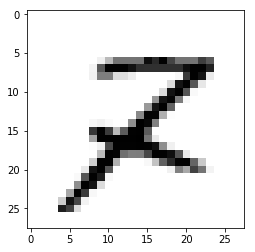

Pred value: 8
True value: 0


Pred value: 2
True value: 5


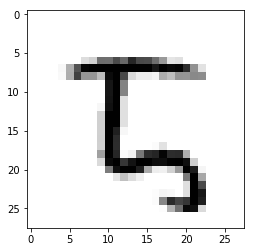

Pred value: 6
True value: 4


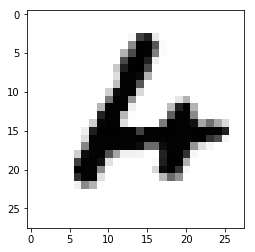

Pred value: 8
True value: 2


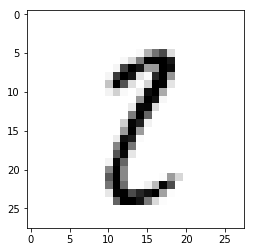

Pred value: 8
True value: 5


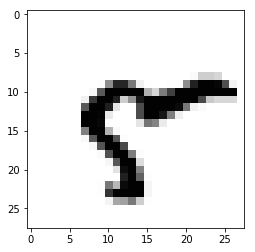

Pred value: 8
True value: 7


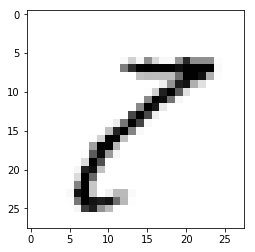

Pred value: 3
True value: 2


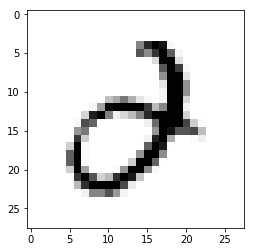

Pred value: 8
True value: 0


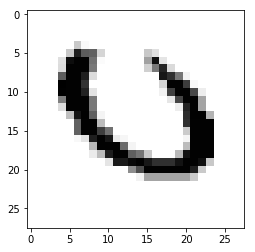

Pred value: 4
True value: 9


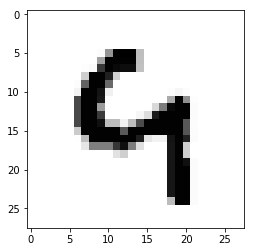

Pred value: 5
True value: 3


Pred value: 4
True value: 7


Pred value: 4
True value: 7


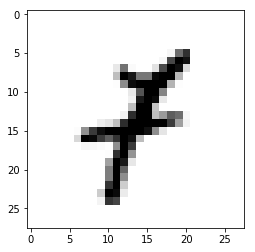

Pred value: 4
True value: 9


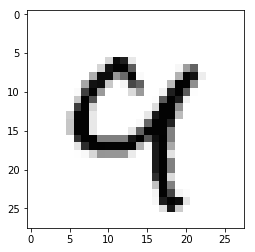

Pred value: 8
True value: 6


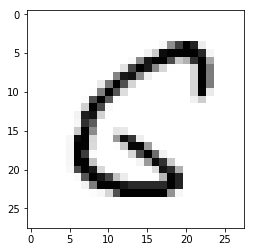

Pred value: 8
True value: 5


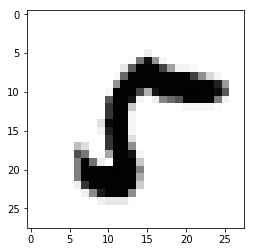

Pred value: 4
True value: 9


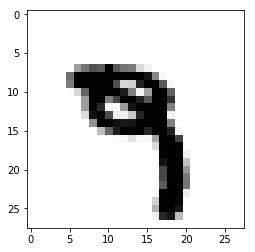

Pred value: 4
True value: 9


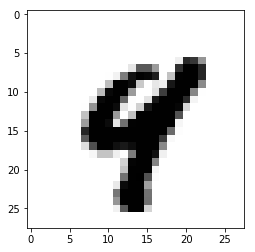

Pred value: 3
True value: 1


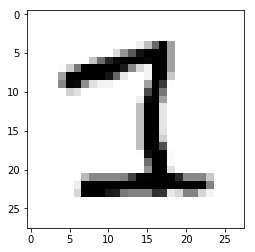

Pred value: 4
True value: 9


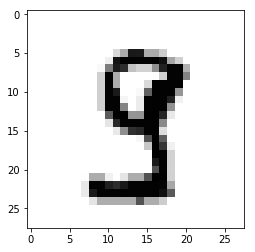

Pred value: 5
True value: 3


Pred value: 4
True value: 9


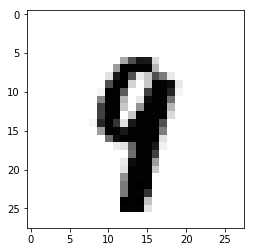

Pred value: 8
True value: 4


Pred value: 4
True value: 9


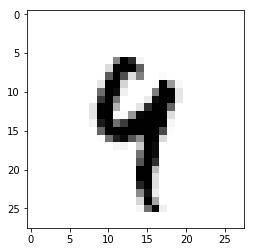

Pred value: 1
True value: 0


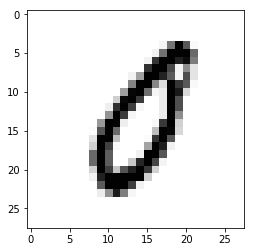

Pred value: 8
True value: 5


Pred value: 5
True value: 3


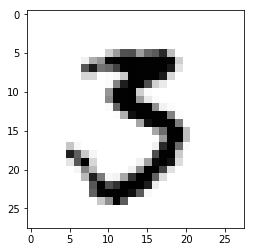

Pred value: 4
True value: 7


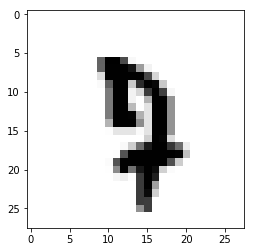

Pred value: 4
True value: 9


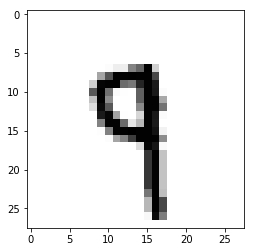

Pred value: 5
True value: 3


Pred value: 5
True value: 6


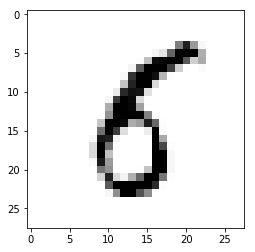

Pred value: 2
True value: 0


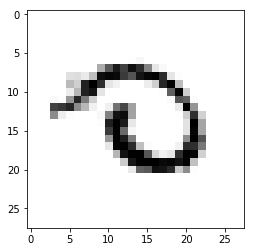

Pred value: 5
True value: 8


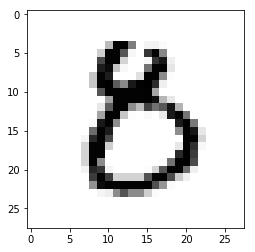

Pred value: 8
True value: 9


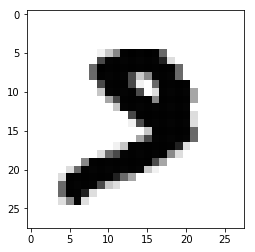

Pred value: 4
True value: 9


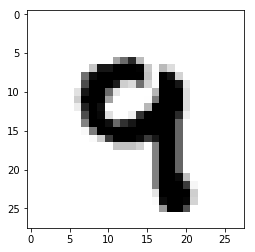

Pred value: 4
True value: 9


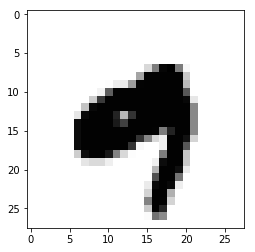

Pred value: 5
True value: 7


Pred value: 4
True value: 9


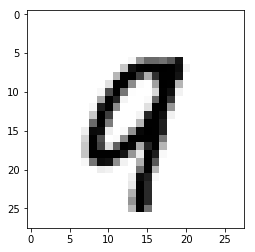

Pred value: 4
True value: 9


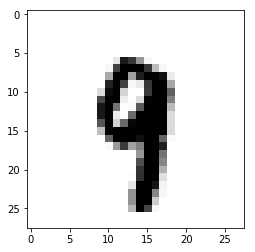

Pred value: 6
True value: 0


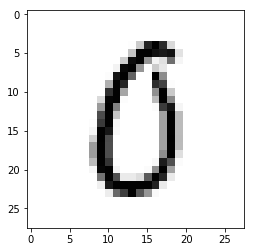

Pred value: 4
True value: 9


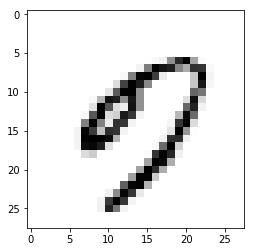

Pred value: 7
True value: 2


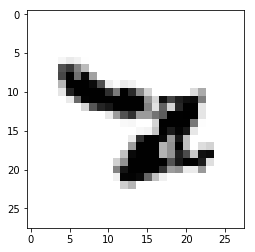

Pred value: 9
True value: 7


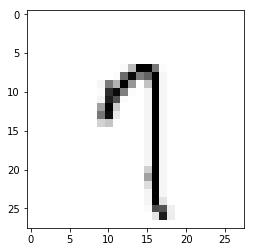

Pred value: 7
True value: 2


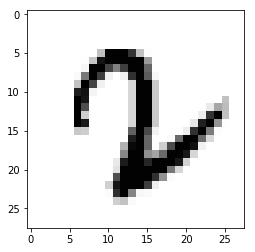

Pred value: 8
True value: 6


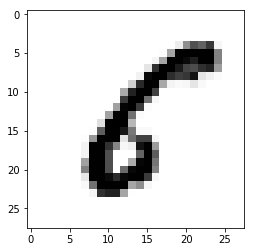

Pred value: 7
True value: 9


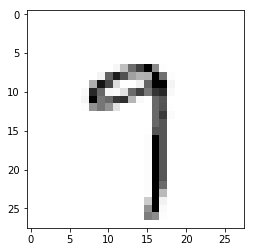

Pred value: 4
True value: 9


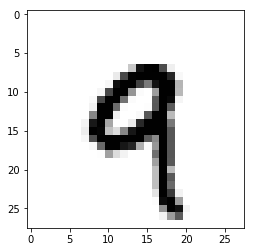

Pred value: 4
True value: 9


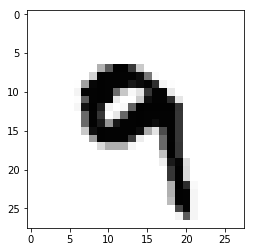

Pred value: 1
True value: 2


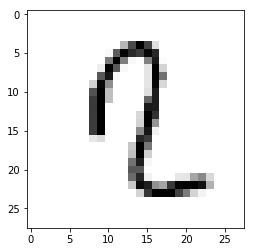

Pred value: 4
True value: 9


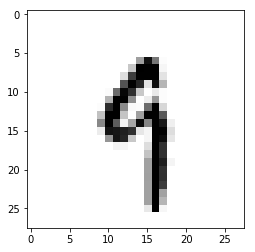

Pred value: 1
True value: 4


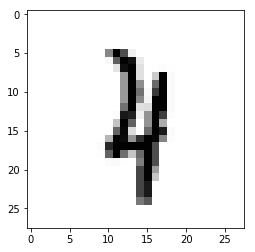

Pred value: 4
True value: 9


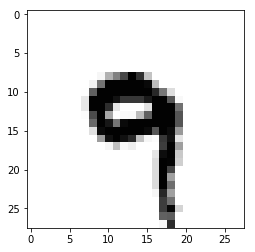

Pred value: 5
True value: 9


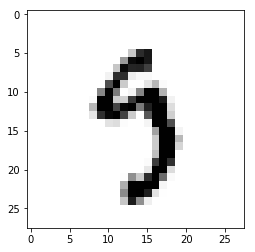

Pred value: 8
True value: 2


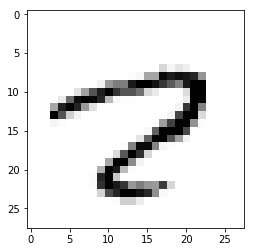

Pred value: 4
True value: 9


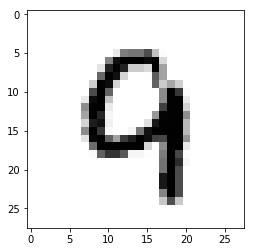

Pred value: 7
True value: 3


Pred value: 4
True value: 9


Pred value: 5
True value: 3


Pred value: 5
True value: 3


Pred value: 4
True value: 9


Pred value: 4
True value: 9


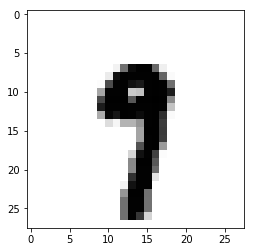

Pred value: 4
True value: 9


Pred value: 4
True value: 9


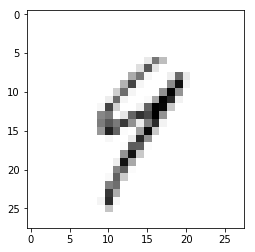

Pred value: 8
True value: 5


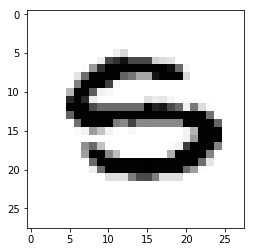

Pred value: 5
True value: 8


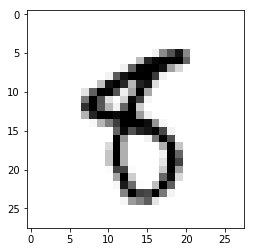

Pred value: 9
True value: 7


Pred value: 4
True value: 9


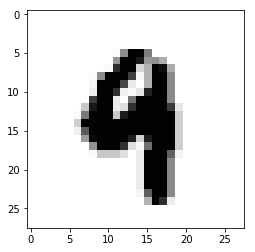

Pred value: 7
True value: 3


Pred value: 2
True value: 6


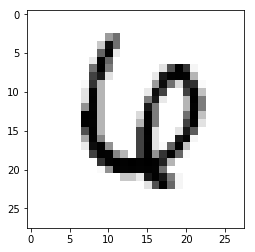

Pred value: 8
True value: 6


Pred value: 8
True value: 2


Pred value: 8
True value: 9


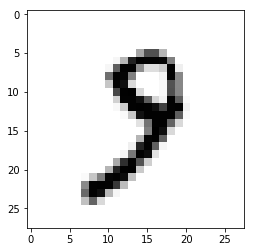

Pred value: 6
True value: 0


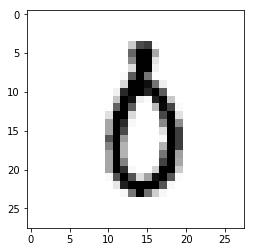

Pred value: 4
True value: 9


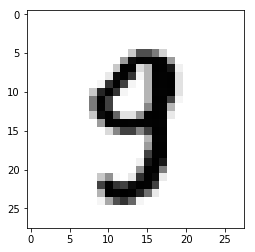

Pred value: 7
True value: 8


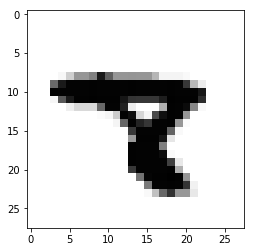

Pred value: 1
True value: 9


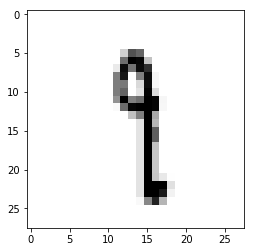

Pred value: 4
True value: 9


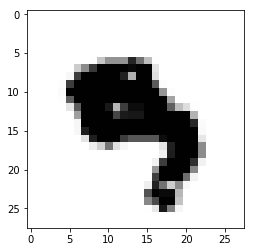

Pred value: 5
True value: 3


Pred value: 5
True value: 6


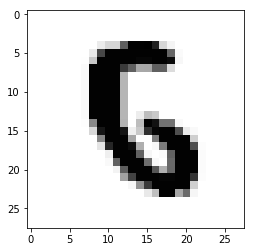

Pred value: 4
True value: 9


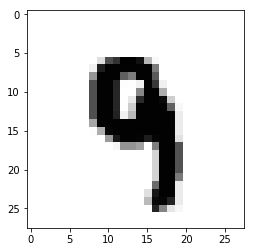

Pred value: 2
True value: 4


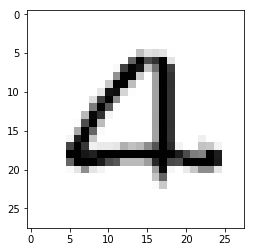

Pred value: 4
True value: 9


Pred value: 4
True value: 8


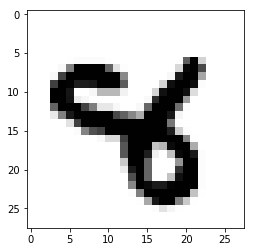

Pred value: 8
True value: 0


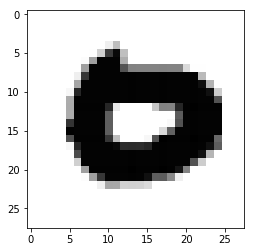

Pred value: 5
True value: 0


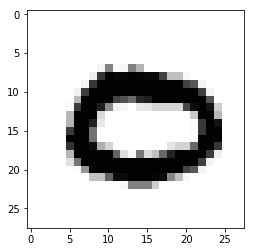

Pred value: 9
True value: 8


Pred value: 7
True value: 2


Pred value: 2
True value: 3


Pred value: 4
True value: 9


Pred value: 4
True value: 9


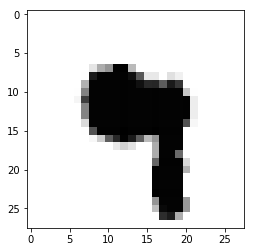

Pred value: 4
True value: 9


Pred value: 9
True value: 7


Pred value: 1
True value: 6


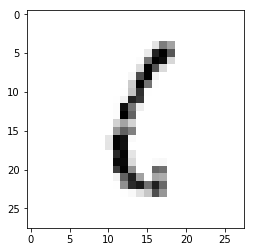

Pred value: 9
True value: 5


Pred value: 4
True value: 9


Pred value: 5
True value: 3


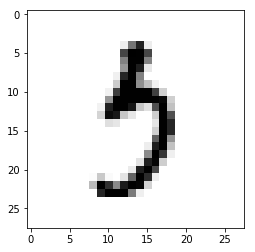

Pred value: 6
True value: 0


Pred value: 4
True value: 7


Pred value: 6
True value: 4


Pred value: 5
True value: 3


Pred value: 4
True value: 9


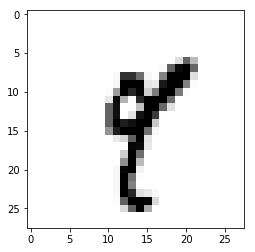

Pred value: 1
True value: 8


Pred value: 3
True value: 8


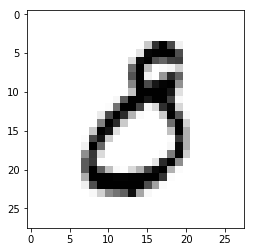

Pred value: 5
True value: 3


Pred value: 4
True value: 6


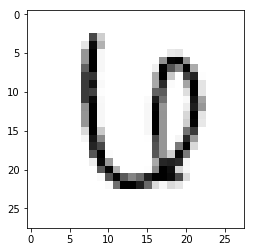

Pred value: 4
True value: 9


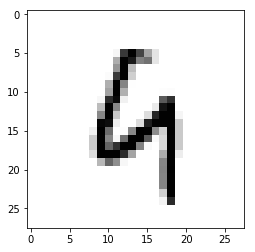

Pred value: 8
True value: 0


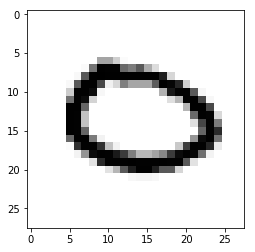

Pred value: 5
True value: 6


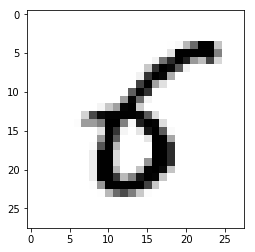

Pred value: 4
True value: 9


Pred value: 6
True value: 9


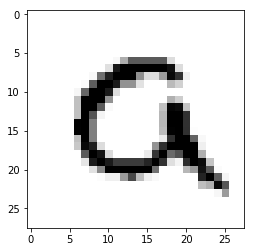

Pred value: 5
True value: 8


Pred value: 8
True value: 0


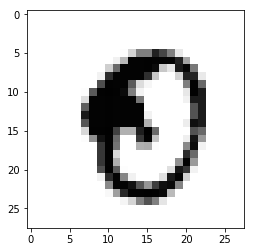

Pred value: 1
True value: 7


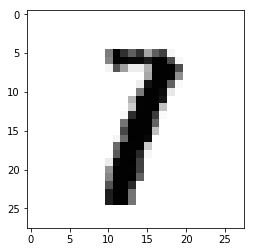

Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 3
True value: 2


Pred value: 4
True value: 8


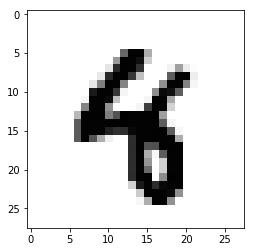

Pred value: 8
True value: 0


Pred value: 2
True value: 3


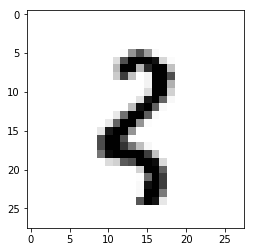

Pred value: 4
True value: 9


Pred value: 2
True value: 3


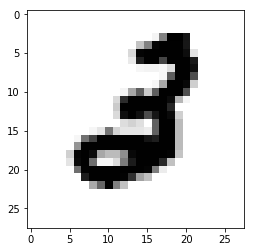

Pred value: 8
True value: 3


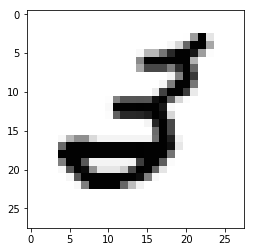

Pred value: 4
True value: 9


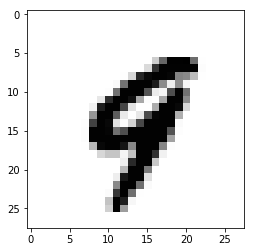

Pred value: 8
True value: 3


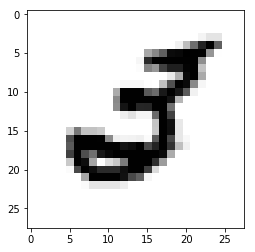

Pred value: 8
True value: 0


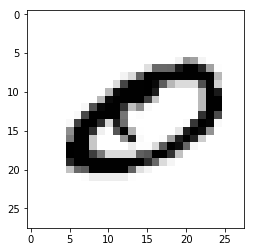

Pred value: 8
True value: 9


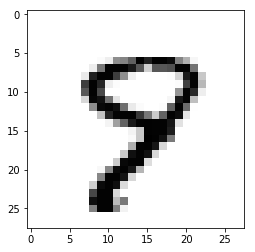

Pred value: 8
True value: 9


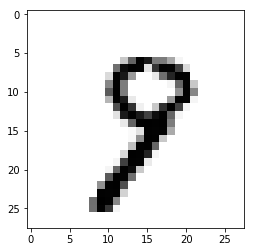

Pred value: 6
True value: 4


Pred value: 8
True value: 0


Pred value: 6
True value: 0


Pred value: 9
True value: 7


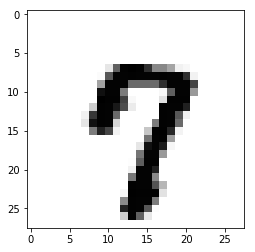

Pred value: 5
True value: 3


Pred value: 6
True value: 0


Pred value: 4
True value: 7


Pred value: 9
True value: 7


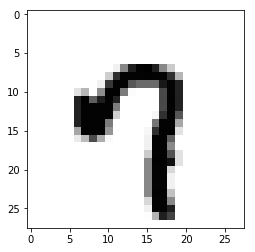

Pred value: 4
True value: 7


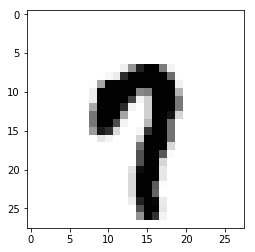

Pred value: 6
True value: 0


Pred value: 5
True value: 8


Pred value: 9
True value: 7


Pred value: 8
True value: 0


Pred value: 9
True value: 7


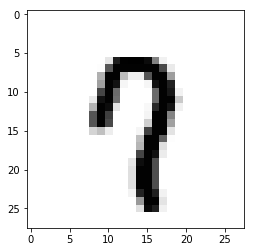

Pred value: 8
True value: 0


Pred value: 7
True value: 3


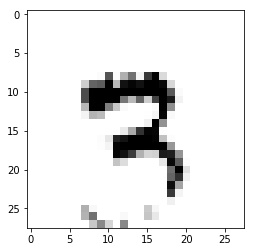

Pred value: 2
True value: 6


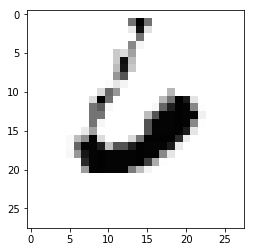

Pred value: 8
True value: 9


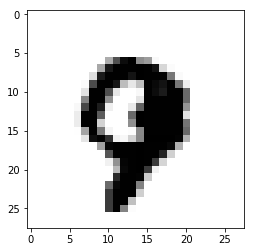

Pred value: 0
True value: 7


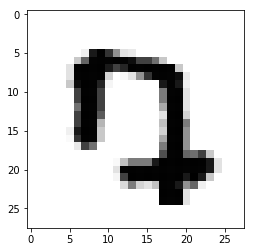

Pred value: 6
True value: 4


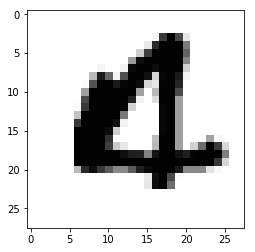

Pred value: 9
True value: 7


Pred value: 8
True value: 0


Pred value: 8
True value: 3


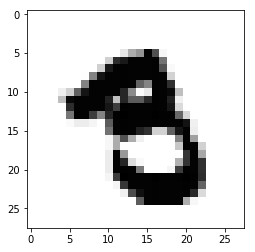

Pred value: 5
True value: 3


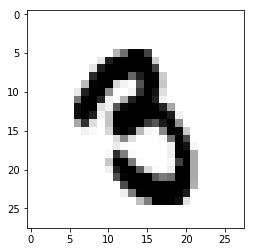

Pred value: 4
True value: 9


Pred value: 5
True value: 0


Pred value: 3
True value: 5


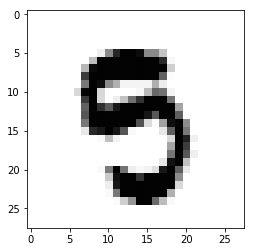

Pred value: 5
True value: 0


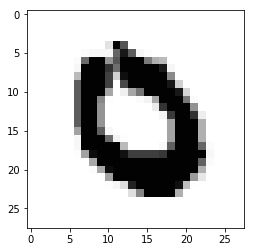

Pred value: 9
True value: 5


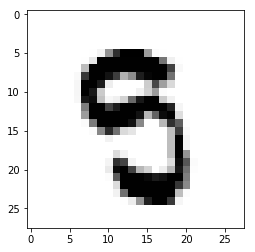

Pred value: 4
True value: 9


Pred value: 9
True value: 8


Pred value: 5
True value: 3


Pred value: 5
True value: 0


Pred value: 5
True value: 3


Pred value: 9
True value: 5


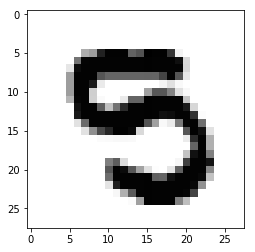

Pred value: 8
True value: 5


Pred value: 8
True value: 3


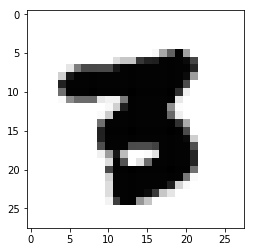

Pred value: 5
True value: 3


Pred value: 5
True value: 9


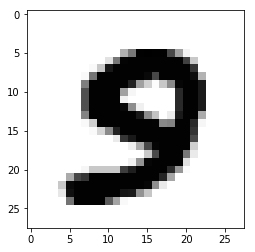

Pred value: 5
True value: 9


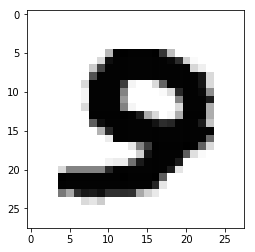

Pred value: 8
True value: 1


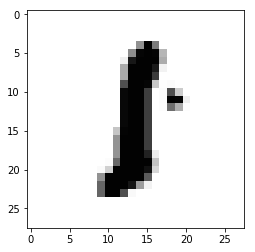

Pred value: 5
True value: 3


Pred value: 5
True value: 3


Pred value: 8
True value: 9


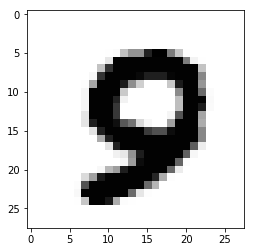

Pred value: 8
True value: 9


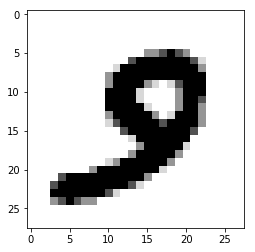

Pred value: 4
True value: 9


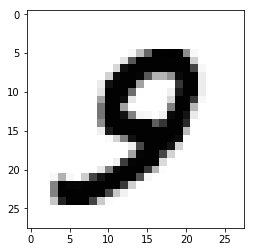

Pred value: 5
True value: 9


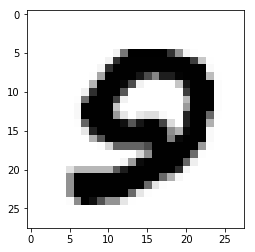

Pred value: 8
True value: 9


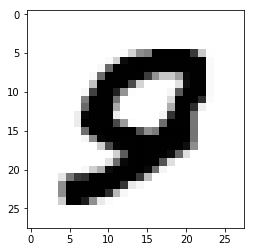

Pred value: 5
True value: 3


Pred value: 9
True value: 7


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 1
True value: 7


Pred value: 1
True value: 7


Pred value: 1
True value: 7


Pred value: 4
True value: 9


Pred value: 0
True value: 9


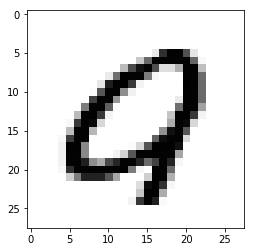

Pred value: 2
True value: 6


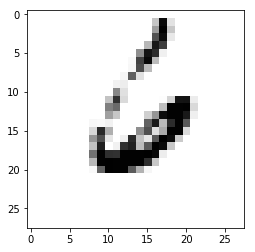

Pred value: 9
True value: 8


Pred value: 2
True value: 6


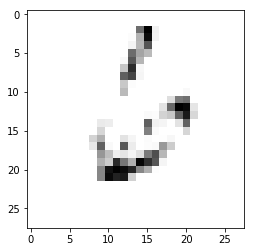

Pred value: 4
True value: 9


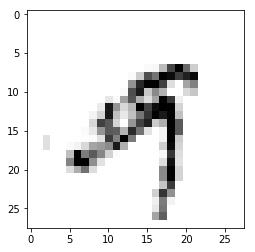

Pred value: 7
True value: 9


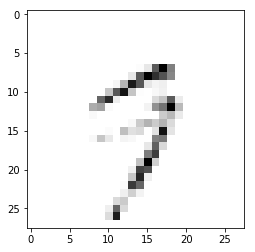

Pred value: 1
True value: 7


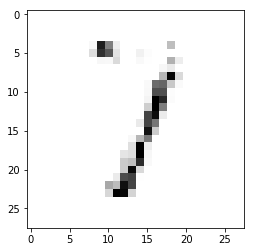

Pred value: 5
True value: 8


Pred value: 4
True value: 9


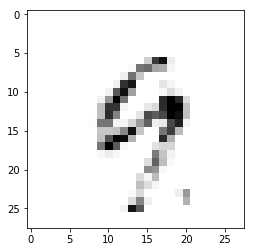

Pred value: 7
True value: 0


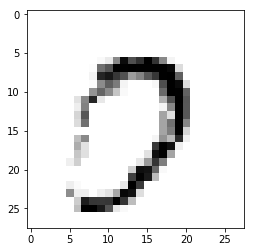

Pred value: 1
True value: 8


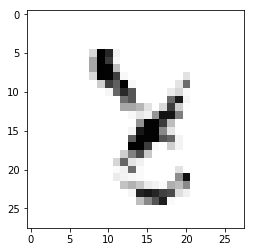

Pred value: 2
True value: 0


Pred value: 2
True value: 0


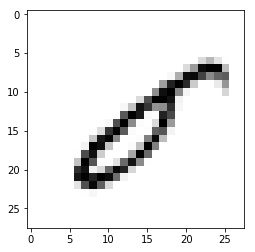

Pred value: 8
True value: 9


Pred value: 8
True value: 9


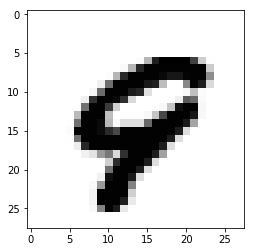

Pred value: 7
True value: 2


Pred value: 8
True value: 4


Pred value: 8
True value: 4


Pred value: 8
True value: 4


Pred value: 0
True value: 9


Pred value: 7
True value: 2


Pred value: 8
True value: 9


Pred value: 8
True value: 4


Pred value: 8
True value: 4


Pred value: 8
True value: 4


Pred value: 4
True value: 9


Pred value: 8
True value: 9


Pred value: 4
True value: 2


Pred value: 4
True value: 9


Pred value: 8
True value: 9


Pred value: 7
True value: 2


Pred value: 3
True value: 0


Pred value: 4
True value: 9


Pred value: 4
True value: 6


Pred value: 4
True value: 9


Pred value: 6
True value: 0


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 1
True value: 0


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 7
True value: 2


Pred value: 4
True value: 9


Pred value: 1
True value: 0


Pred value: 2
True value: 3


Pred value: 7
True value: 2


Pred value: 6
True value: 0


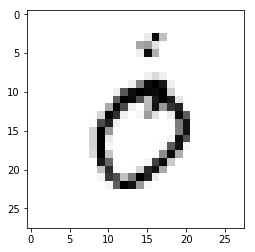

Pred value: 4
True value: 7


Pred value: 6
True value: 0


Pred value: 8
True value: 4


Pred value: 8
True value: 4


Pred value: 8
True value: 4


Pred value: 2
True value: 3


Pred value: 8
True value: 5


Pred value: 1
True value: 0


Pred value: 1
True value: 4


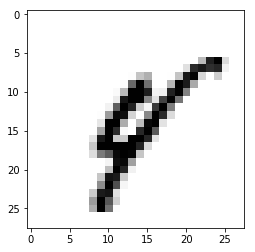

Pred value: 8
True value: 0


Pred value: 1
True value: 4


Pred value: 2
True value: 0


Pred value: 4
True value: 9


Pred value: 4
True value: 8


Pred value: 2
True value: 0


Pred value: 4
True value: 9


Pred value: 4
True value: 7


Pred value: 1
True value: 4


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 5
True value: 0


Pred value: 5
True value: 8


Pred value: 4
True value: 9


Pred value: 8
True value: 9


Pred value: 6
True value: 5


Pred value: 8
True value: 1


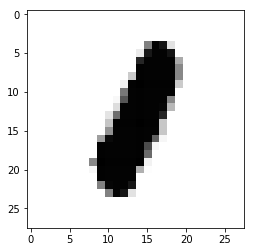

Pred value: 8
True value: 5


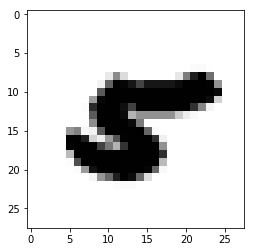

Pred value: 4
True value: 3


Pred value: 8
True value: 5


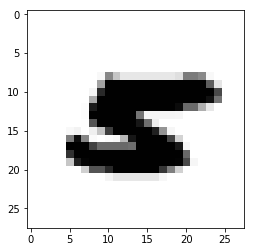

Pred value: 8
True value: 9


Pred value: 4
True value: 9


Pred value: 8
True value: 9


Pred value: 4
True value: 2


Pred value: 4
True value: 9


Pred value: 8
True value: 9


Pred value: 8
True value: 5


Pred value: 2
True value: 4


Pred value: 4
True value: 9


Pred value: 6
True value: 4


Pred value: 4
True value: 9


Pred value: 8
True value: 2


Pred value: 4
True value: 9


Pred value: 8
True value: 2


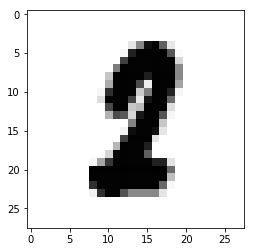

Pred value: 6
True value: 4


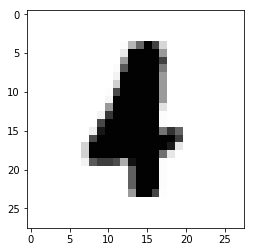

Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 8
True value: 3


Pred value: 3
True value: 5


Pred value: 4
True value: 2


Pred value: 8
True value: 9


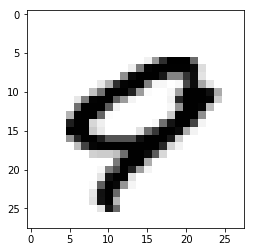

Pred value: 8
True value: 9


Pred value: 2
True value: 0


Pred value: 8
True value: 0


Pred value: 4
True value: 3


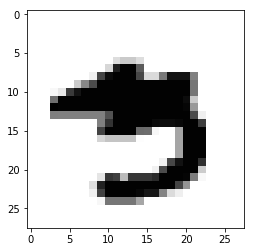

Pred value: 5
True value: 3


Pred value: 5
True value: 3


Pred value: 1
True value: 4


Pred value: 5
True value: 3


Pred value: 2
True value: 0


Pred value: 5
True value: 3


Pred value: 2
True value: 7


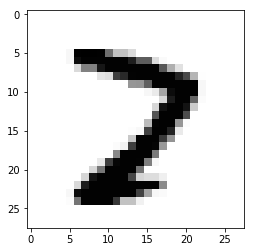

Pred value: 6
True value: 0


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 4
True value: 7


Pred value: 2
True value: 0


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 2
True value: 7


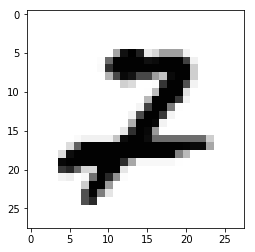

Pred value: 8
True value: 2


Pred value: 2
True value: 7


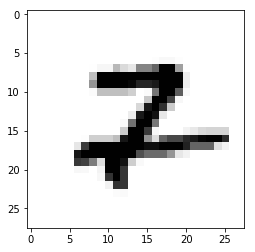

Pred value: 8
True value: 0


Pred value: 2
True value: 7


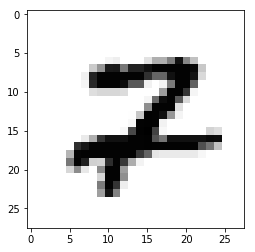

Pred value: 2
True value: 7


Pred value: 2
True value: 7


Pred value: 2
True value: 7


Pred value: 8
True value: 1


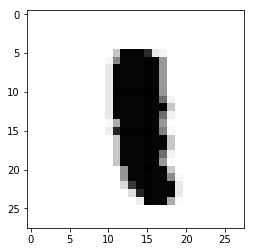

Pred value: 4
True value: 9


Pred value: 4
True value: 7


Pred value: 9
True value: 7


Pred value: 8
True value: 0


Pred value: 9
True value: 7


Pred value: 8
True value: 9


Pred value: 9
True value: 7


Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 9
True value: 7


Pred value: 4
True value: 7


Pred value: 8
True value: 9


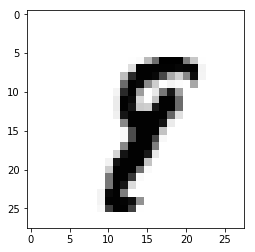

Pred value: 8
True value: 9


Pred value: 4
True value: 9


Pred value: 1
True value: 0


Pred value: 8
True value: 9


Pred value: 4
True value: 9


Pred value: 2
True value: 6


Pred value: 8
True value: 0


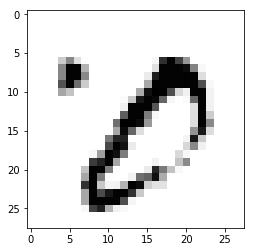

Pred value: 7
True value: 9


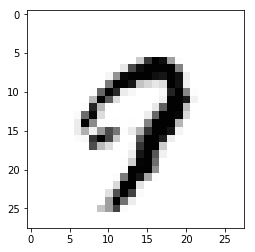

Pred value: 7
True value: 9


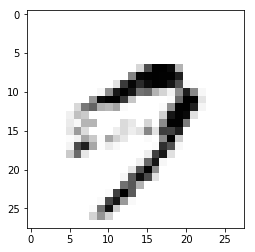

Pred value: 8
True value: 3


Pred value: 7
True value: 2


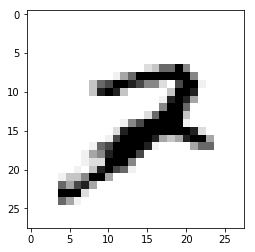

Pred value: 8
True value: 0


Pred value: 2
True value: 0


Pred value: 7
True value: 9


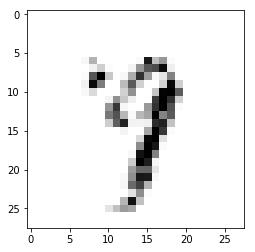

Pred value: 7
True value: 2


Pred value: 3
True value: 2


Pred value: 6
True value: 5


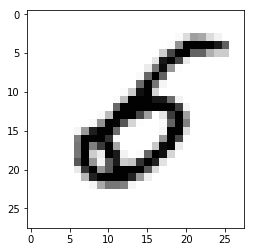

Pred value: 1
True value: 4


Pred value: 8
True value: 0


Pred value: 8
True value: 9


Pred value: 2
True value: 3


Pred value: 1
True value: 4


Pred value: 6
True value: 5


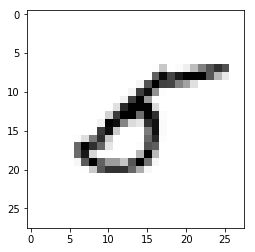

Pred value: 2
True value: 3


Pred value: 1
True value: 4


Pred value: 8
True value: 2


Pred value: 8
True value: 5


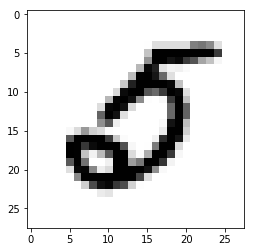

Pred value: 4
True value: 9


Pred value: 4
True value: 9


Pred value: 8
True value: 2


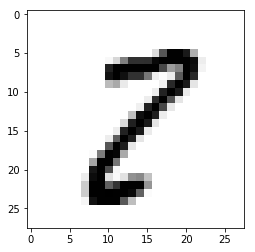

Pred value: 8
True value: 0


Pred value: 8
True value: 0


Pred value: 4
True value: 9


Pred value: 8
True value: 2


Pred value: 4
True value: 9


Pred value: 8
True value: 0


Pred value: 8
True value: 2


Pred value: 2
True value: 4


Pred value: 8
True value: 0


Pred value: 8
True value: 6


Pred value: 7
True value: 3


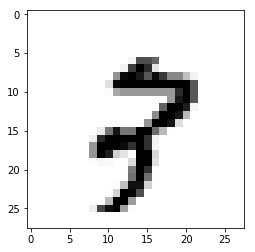

Pred value: 2
True value: 4


Pred value: 8
True value: 3


Pred value: 4
True value: 9


Pred value: 2
True value: 3


Pred value: 6
True value: 5


Pred value: 8
True value: 0


In [0]:
# Loading dataset
(train_x, y_train), (test_x, y_test) = tf.keras.datasets.mnist.load_data()
# Reshaping the array to 4-dims so that it can work with the Keras API
x_train = train_x.reshape(train_x.shape[0], 28, 28, 1)
x_test = test_x.reshape(test_x.shape[0], 28, 28, 1)
input_shape = (28, 28, 1)
# Making sure that the values are float so that we can get decimal points after division
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
# Normalizing the RGB codes by dividing it to the max RGB value.
#x_train /= 255
#x_test /= 255
print('x_train shape:', x_train.shape)
print('Number of images in x_train', x_train.shape[0])
print('Number of images in x_test', x_test.shape[0])
# Creating a Sequential Model and adding the layers
model = Sequential()
model.add(Conv2D(28, kernel_size=(5,5), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(4, 4)))
model.add(Conv2D(28, kernel_size=(3,3), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten()) # Flattening the 2D arrays for fully connected layers
model.add(Dense(128, activation=tf.nn.relu))
model.add(Dropout(0.5))      
model.add(Dense(10,activation=tf.nn.softmax))
print(model.summary())
model.compile(optimizer='adam', 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)
his = model.fit(x=x_train,y=y_train, epochs=50)
_, train_acc = model.evaluate(x_train, y_train, verbose=0)
_, test_acc = model.evaluate(x_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
y_pred = model.predict(x_test)
print(y_pred.shape)
print(y_test.shape)
y = np.argmax(y_pred, axis=1)
print(y.shape)
confusion_matrix(y_test, y)
for i in range(10000):
    if(y[i] != y_test[i]):
        print("Pred value:",y[i])
        print("True value:",y_test[i])
        plt.figure
        plt.imshow(x_test[i].reshape(28, 28),cmap='Greys')
        plt.show()

x_train shape: (60000, 28, 28, 1)
Number of images in x_train 60000
Number of images in x_test 10000
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_25 (Conv2D)           (None, 26, 26, 28)        280       
_________________________________________________________________
max_pooling2d_22 (MaxPooling (None, 13, 13, 28)        0         
_________________________________________________________________
conv2d_26 (Conv2D)           (None, 9, 9, 20)          14020     
_________________________________________________________________
max_pooling2d_23 (MaxPooling (None, 4, 4, 20)          0         
_________________________________________________________________
conv2d_27 (Conv2D)           (None, 2, 2, 28)          5068      
_________________________________________________________________
max_pooling2d_24 (MaxPooling (None, 1, 1, 28)          0         
_________________________________________

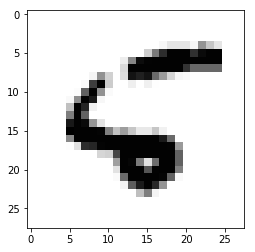

Pred value: 9
True value: 3


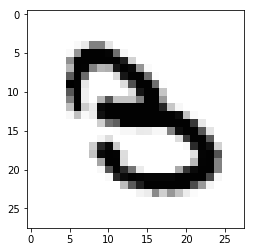

Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 7


Pred value: 2
True value: 3


Pred value: 1
True value: 3


Pred value: 5
True value: 6


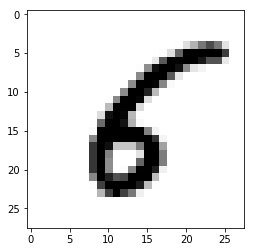

Pred value: 9
True value: 8


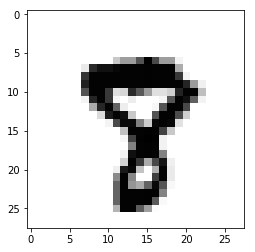

Pred value: 1
True value: 8


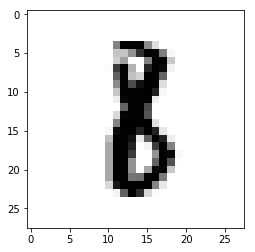

Pred value: 0
True value: 6


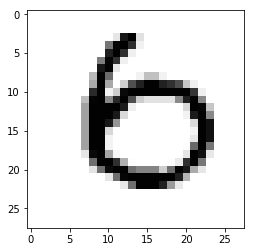

Pred value: 4
True value: 8


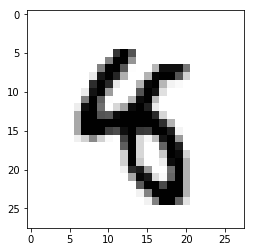

Pred value: 1
True value: 4


Pred value: 7
True value: 2


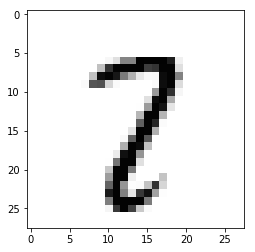

Pred value: 5
True value: 0


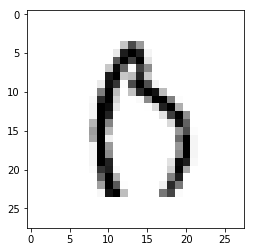

Pred value: 1
True value: 5


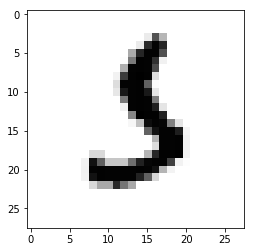

Pred value: 9
True value: 3


Pred value: 9
True value: 7


Pred value: 7
True value: 3


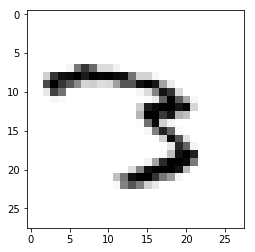

Pred value: 9
True value: 8


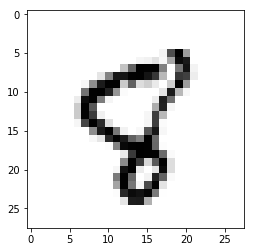

Pred value: 9
True value: 8


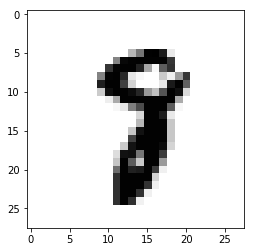

Pred value: 5
True value: 6


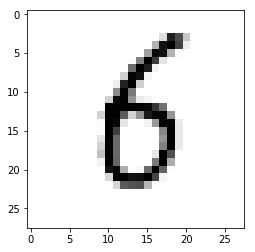

Pred value: 0
True value: 6


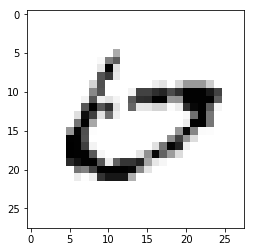

Pred value: 8
True value: 4


Pred value: 5
True value: 3


Pred value: 1
True value: 3


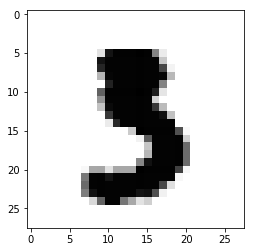

Pred value: 5
True value: 6


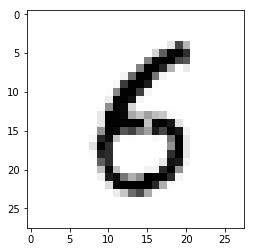

Pred value: 9
True value: 3


Pred value: 9
True value: 8


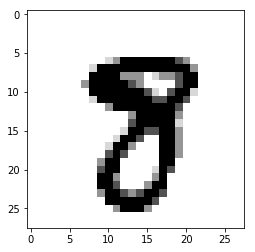

Pred value: 9
True value: 8


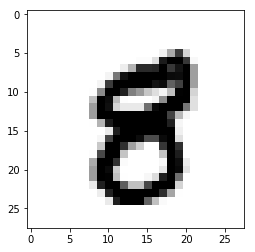

Pred value: 1
True value: 5


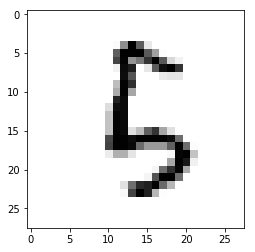

Pred value: 1
True value: 8


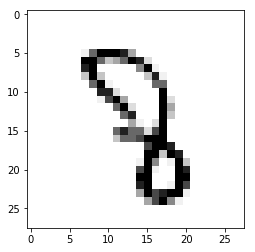

Pred value: 9
True value: 7


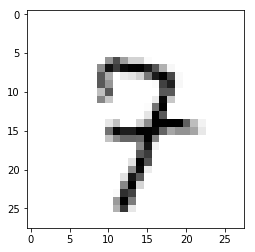

Pred value: 9
True value: 0


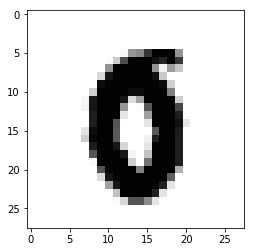

Pred value: 9
True value: 4


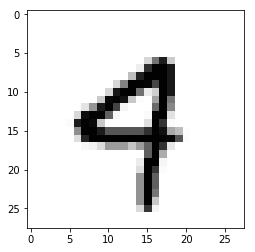

Pred value: 9
True value: 8


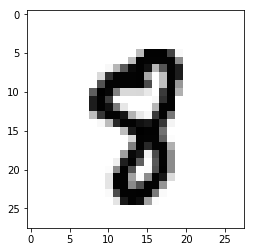

Pred value: 7
True value: 3


Pred value: 2
True value: 8


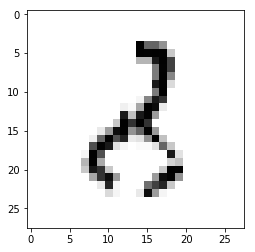

Pred value: 1
True value: 8


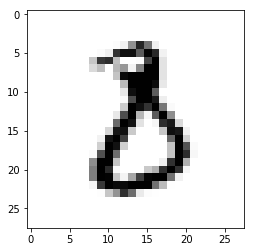

Pred value: 9
True value: 0


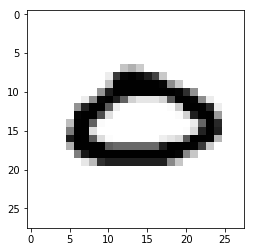

Pred value: 9
True value: 8


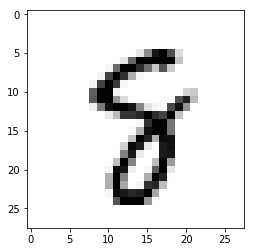

Pred value: 9
True value: 7


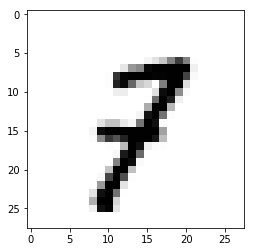

Pred value: 4
True value: 6


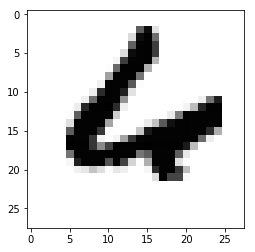

Pred value: 9
True value: 3


Pred value: 1
True value: 2


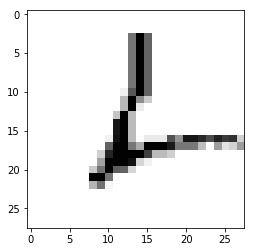

Pred value: 7
True value: 2


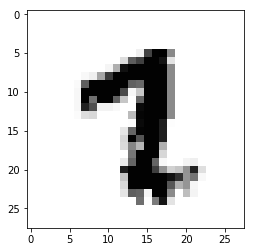

Pred value: 1
True value: 0


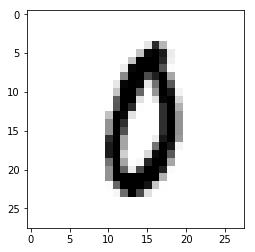

Pred value: 1
True value: 5


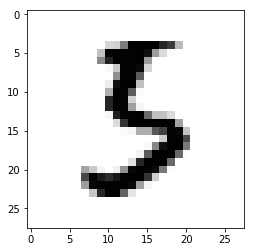

Pred value: 9
True value: 7


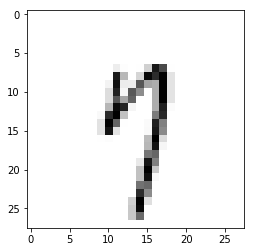

Pred value: 4
True value: 8


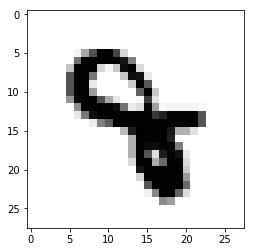

Pred value: 9
True value: 3


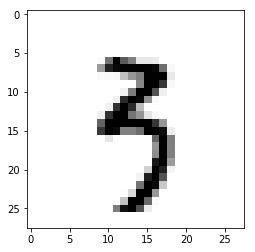

Pred value: 9
True value: 4


Pred value: 9
True value: 4


Pred value: 5
True value: 0


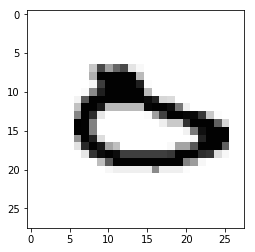

Pred value: 6
True value: 5


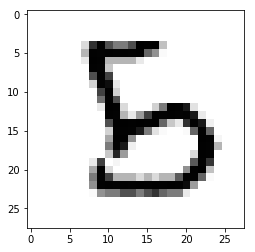

Pred value: 9
True value: 7


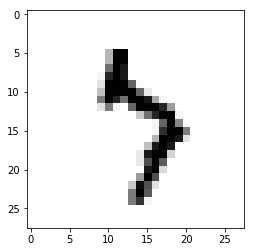

Pred value: 9
True value: 4


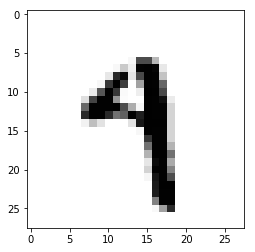

Pred value: 7
True value: 3


Pred value: 9
True value: 4


Pred value: 1
True value: 6


Pred value: 1
True value: 2


Pred value: 9
True value: 8


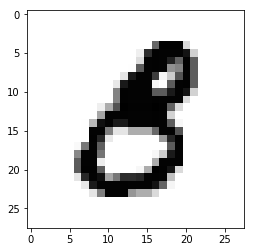

Pred value: 7
True value: 8


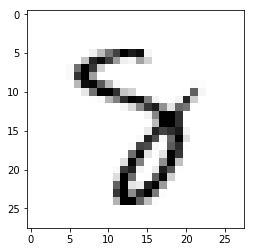

Pred value: 5
True value: 6


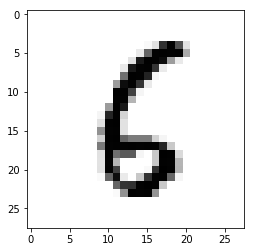

Pred value: 1
True value: 8


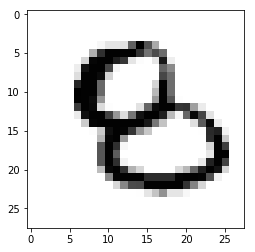

Pred value: 7
True value: 3


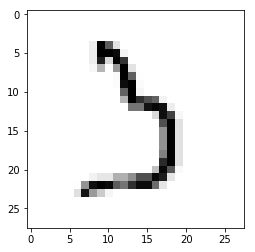

Pred value: 2
True value: 0


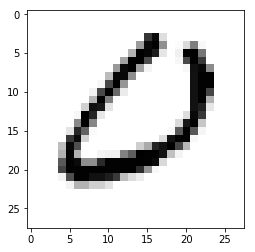

Pred value: 7
True value: 2


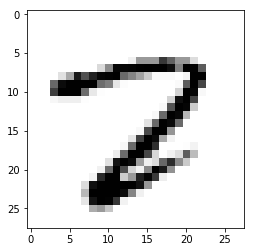

Pred value: 5
True value: 3


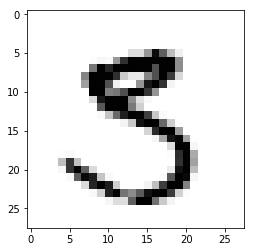

Pred value: 9
True value: 8


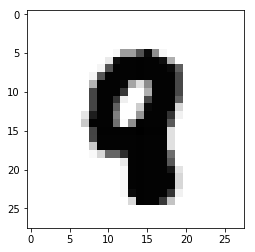

Pred value: 2
True value: 7


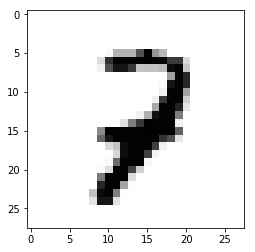

Pred value: 9
True value: 5


Pred value: 9
True value: 3


Pred value: 9
True value: 7


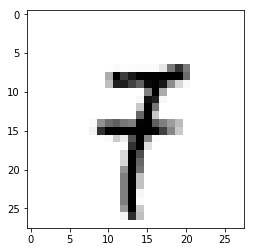

Pred value: 5
True value: 6


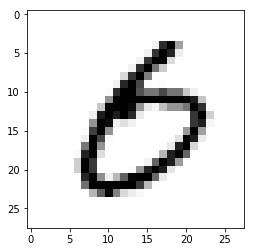

Pred value: 8
True value: 3


Pred value: 5
True value: 3


Pred value: 9
True value: 7


Pred value: 5
True value: 6


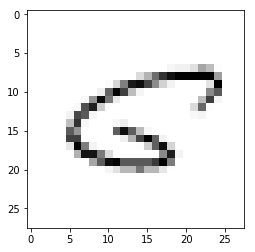

Pred value: 9
True value: 8


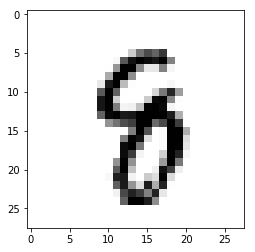

Pred value: 1
True value: 8


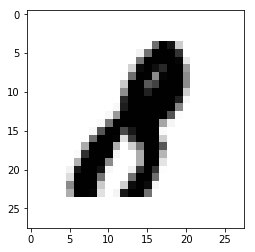

Pred value: 4
True value: 7


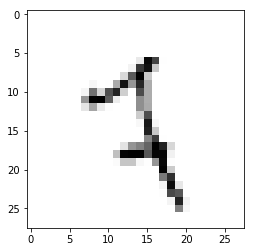

Pred value: 8
True value: 6


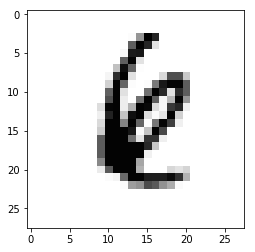

Pred value: 9
True value: 8


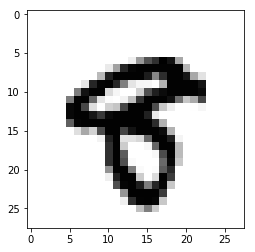

Pred value: 9
True value: 3


Pred value: 4
True value: 8


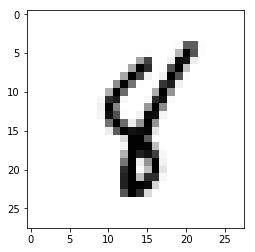

Pred value: 9
True value: 3


Pred value: 5
True value: 3


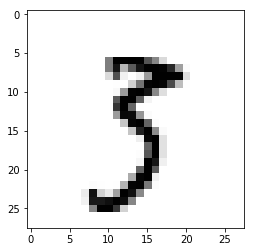

Pred value: 9
True value: 3


Pred value: 7
True value: 3


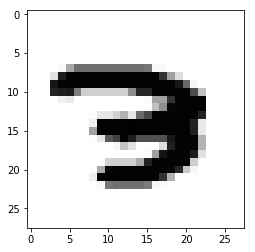

Pred value: 1
True value: 7


Pred value: 1
True value: 3


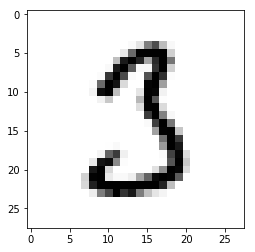

Pred value: 1
True value: 4


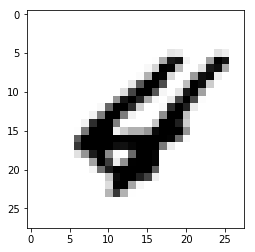

Pred value: 1
True value: 6


Pred value: 1
True value: 6


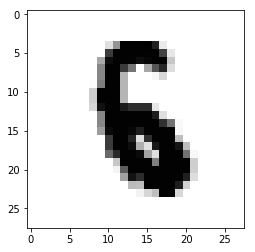

Pred value: 9
True value: 8


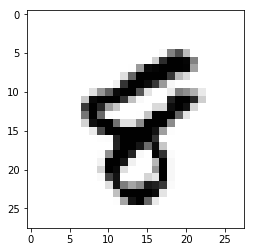

Pred value: 9
True value: 7


Pred value: 5
True value: 0


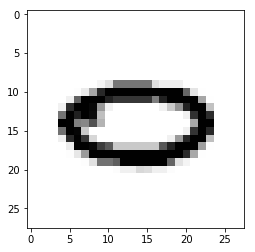

Pred value: 4
True value: 8


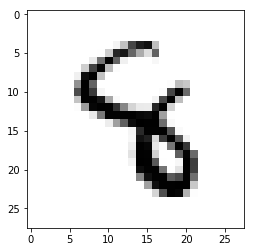

Pred value: 7
True value: 3


Pred value: 2
True value: 7


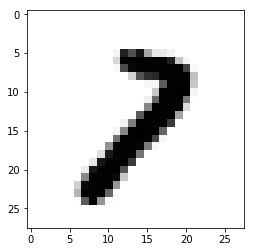

Pred value: 9
True value: 3


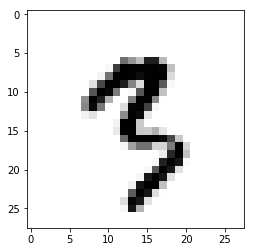

Pred value: 4
True value: 2


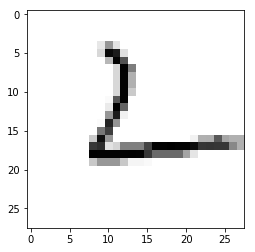

Pred value: 2
True value: 7


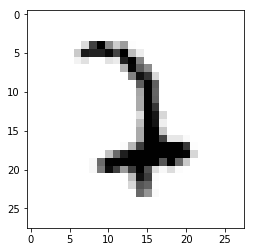

Pred value: 4
True value: 9


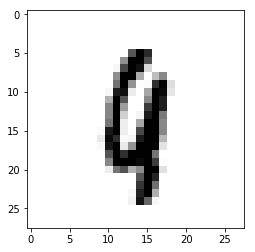

Pred value: 5
True value: 3


Pred value: 9
True value: 4


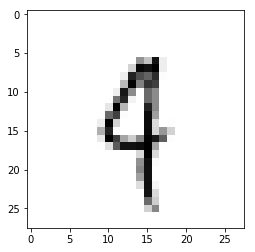

Pred value: 0
True value: 9


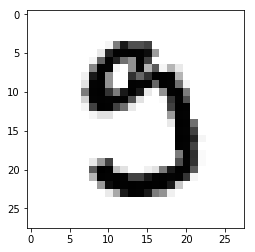

Pred value: 1
True value: 7


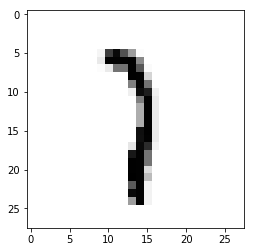

Pred value: 9
True value: 0


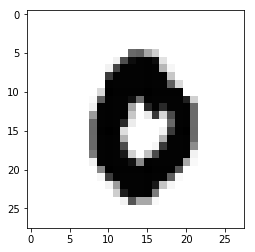

Pred value: 2
True value: 7


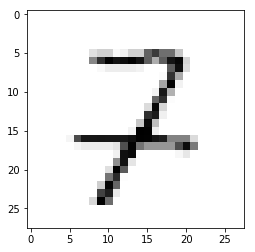

Pred value: 1
True value: 6


Pred value: 7
True value: 5


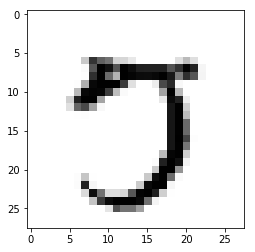

Pred value: 7
True value: 3


Pred value: 9
True value: 8


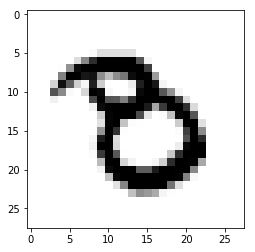

Pred value: 6
True value: 8


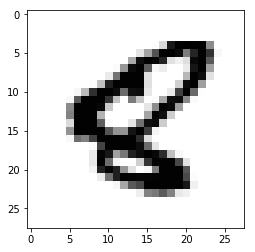

Pred value: 2
True value: 7


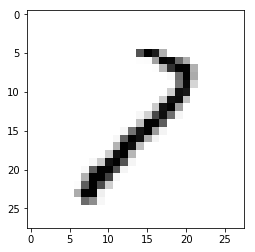

Pred value: 1
True value: 6


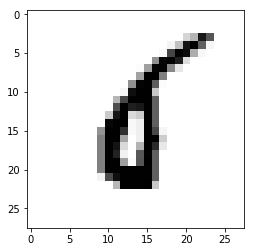

Pred value: 9
True value: 7


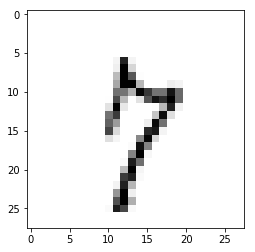

Pred value: 9
True value: 3


Pred value: 7
True value: 5


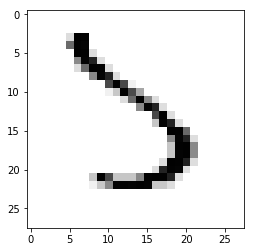

Pred value: 1
True value: 0


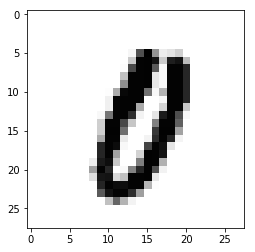

Pred value: 4
True value: 8


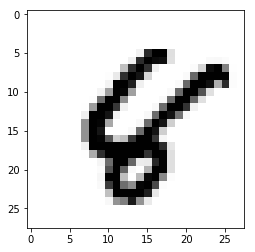

Pred value: 1
True value: 6


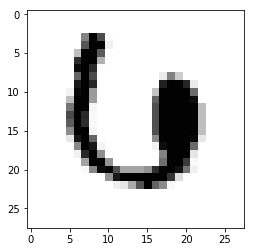

Pred value: 7
True value: 3


Pred value: 7
True value: 8


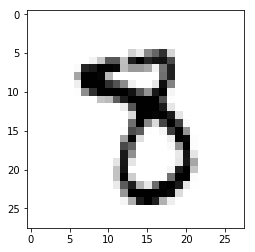

Pred value: 1
True value: 4


Pred value: 1
True value: 4


Pred value: 1
True value: 7


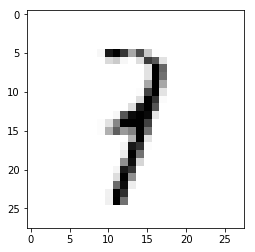

Pred value: 9
True value: 4


Pred value: 1
True value: 2


Pred value: 9
True value: 7


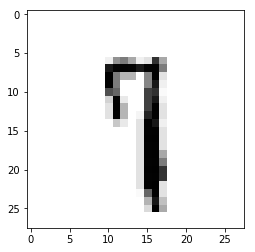

Pred value: 3
True value: 1


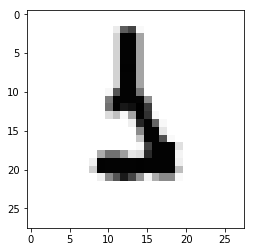

Pred value: 7
True value: 8


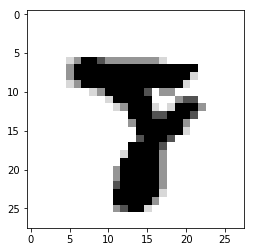

Pred value: 9
True value: 7


Pred value: 9
True value: 7


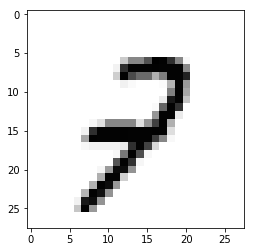

Pred value: 9
True value: 8


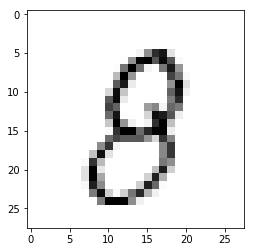

Pred value: 5
True value: 6


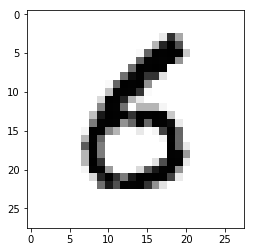

Pred value: 1
True value: 3


Pred value: 1
True value: 3


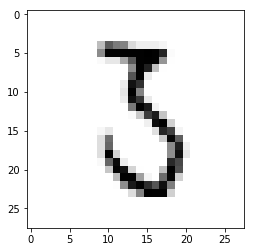

Pred value: 7
True value: 3


Pred value: 9
True value: 5


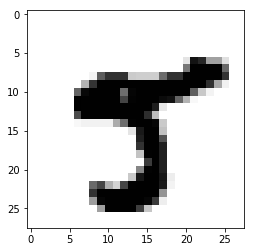

Pred value: 6
True value: 0


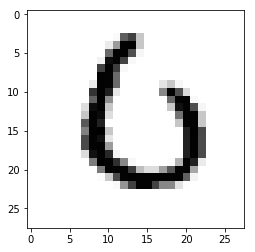

Pred value: 5
True value: 6


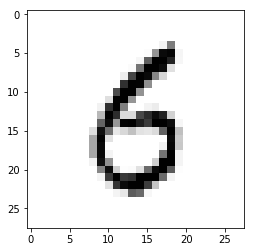

Pred value: 9
True value: 4


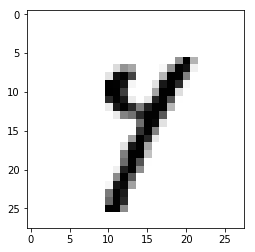

Pred value: 2
True value: 7


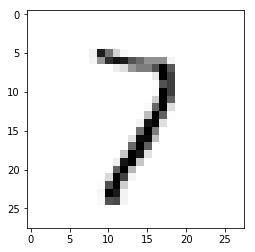

Pred value: 9
True value: 7


Pred value: 7
True value: 1


Pred value: 5
True value: 6


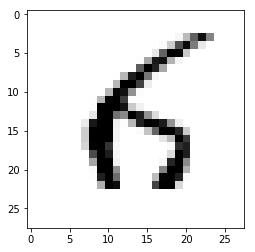

Pred value: 7
True value: 3


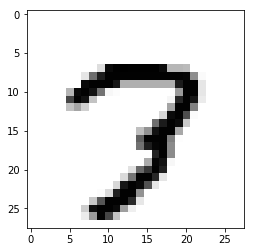

Pred value: 1
True value: 8


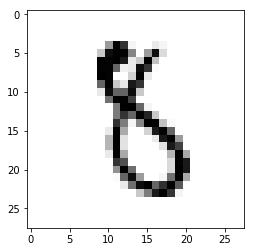

Pred value: 1
True value: 0


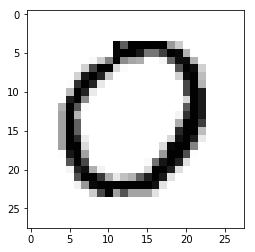

Pred value: 1
True value: 7


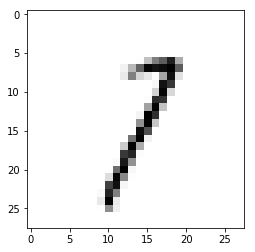

Pred value: 9
True value: 7


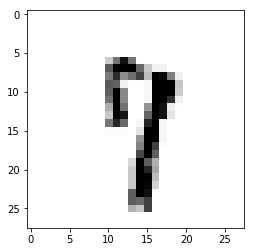

Pred value: 1
True value: 6


Pred value: 7
True value: 3


Pred value: 1
True value: 3


Pred value: 9
True value: 0


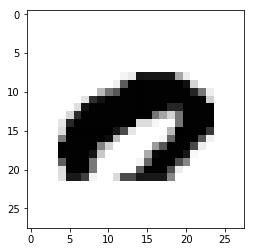

Pred value: 2
True value: 7


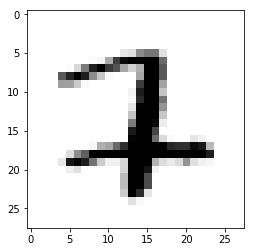

Pred value: 9
True value: 7


Pred value: 7
True value: 2


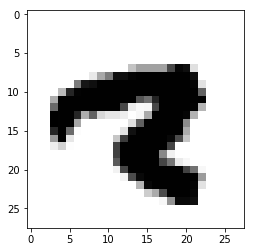

Pred value: 4
True value: 6


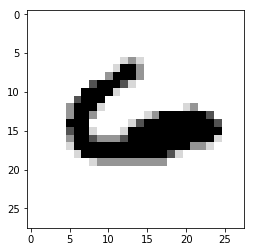

Pred value: 2
True value: 0


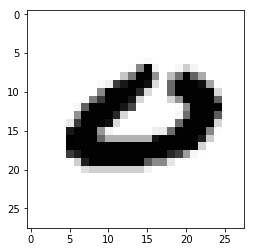

Pred value: 5
True value: 8


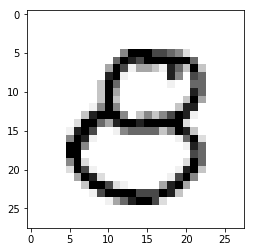

Pred value: 5
True value: 6


Pred value: 7
True value: 3


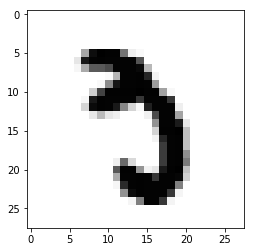

Pred value: 9
True value: 3


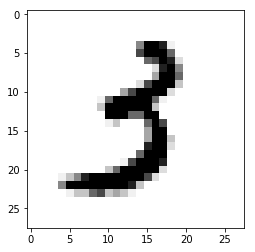

Pred value: 7
True value: 8


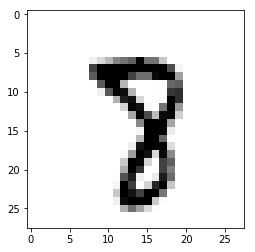

Pred value: 1
True value: 4


Pred value: 4
True value: 6


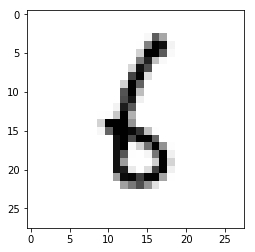

Pred value: 4
True value: 9


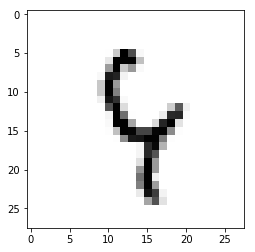

Pred value: 2
True value: 7


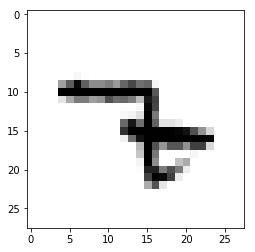

Pred value: 9
True value: 4


Pred value: 6
True value: 4


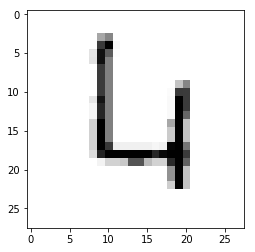

Pred value: 1
True value: 8


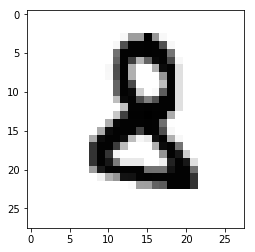

Pred value: 9
True value: 4


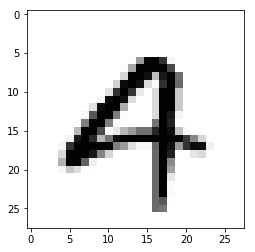

Pred value: 0
True value: 2


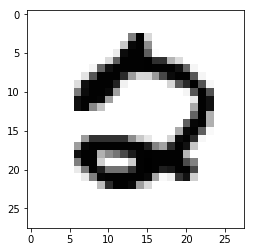

Pred value: 1
True value: 4


Pred value: 2
True value: 7


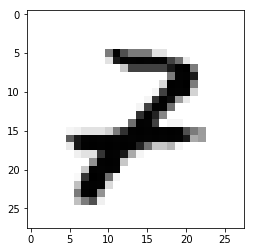

Pred value: 9
True value: 7


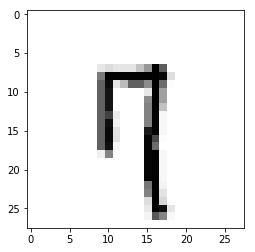

Pred value: 7
True value: 2


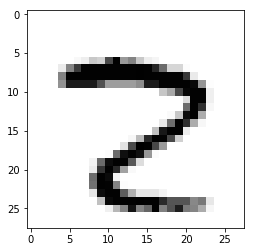

Pred value: 9
True value: 7


Pred value: 4
True value: 8


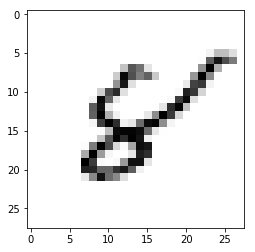

Pred value: 9
True value: 4


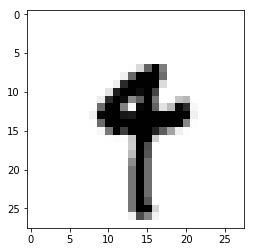

Pred value: 2
True value: 7


Pred value: 9
True value: 7


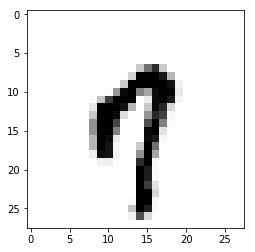

Pred value: 1
True value: 6


Pred value: 7
True value: 3


Pred value: 9
True value: 3


Pred value: 1
True value: 8


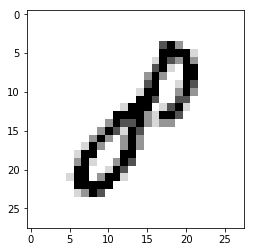

Pred value: 9
True value: 8


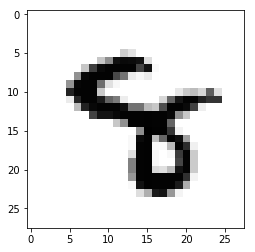

Pred value: 9
True value: 3


Pred value: 9
True value: 8


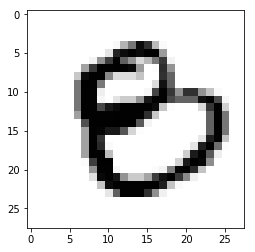

Pred value: 9
True value: 3


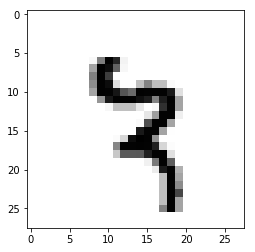

Pred value: 1
True value: 6


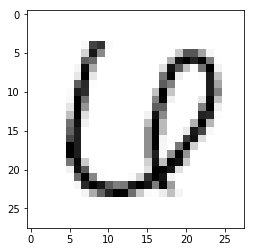

Pred value: 8
True value: 9


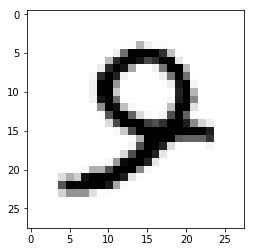

Pred value: 9
True value: 4


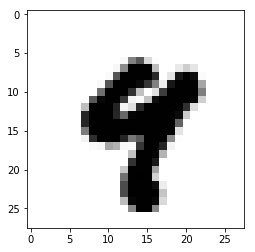

Pred value: 1
True value: 6


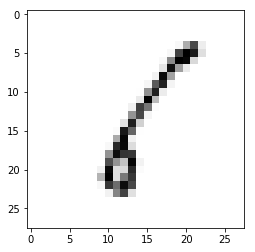

Pred value: 9
True value: 4


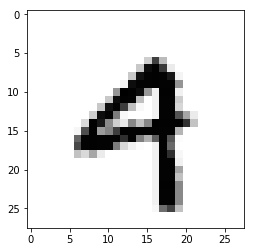

Pred value: 2
True value: 1


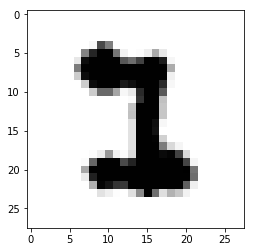

Pred value: 1
True value: 0


Pred value: 9
True value: 0


Pred value: 1
True value: 2


Pred value: 9
True value: 8


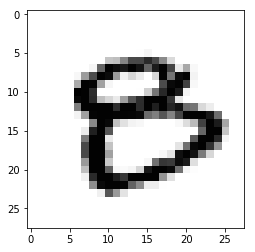

Pred value: 1
True value: 3


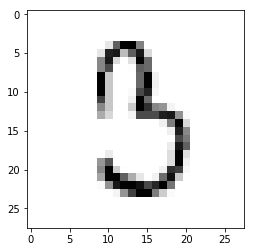

Pred value: 9
True value: 5


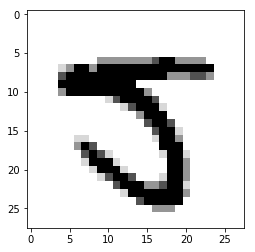

Pred value: 2
True value: 9


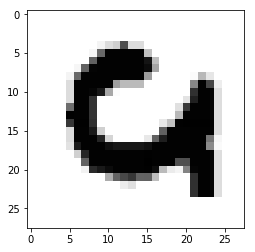

Pred value: 7
True value: 2


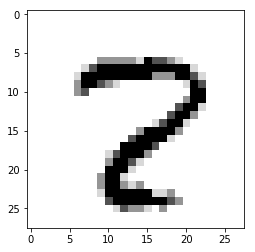

Pred value: 7
True value: 3


Pred value: 5
True value: 3


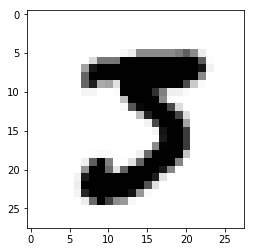

Pred value: 2
True value: 7


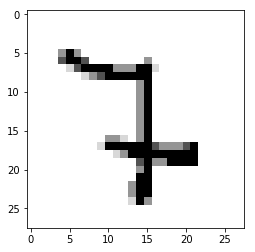

Pred value: 4
True value: 9


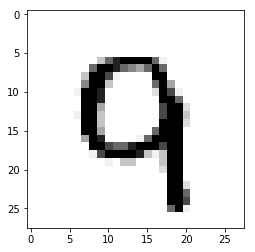

Pred value: 1
True value: 8


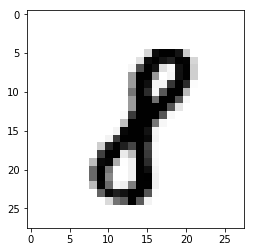

Pred value: 9
True value: 7


Pred value: 9
True value: 5


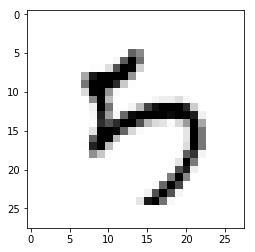

Pred value: 2
True value: 0


Pred value: 0
True value: 9


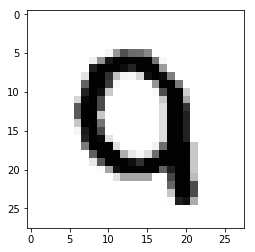

Pred value: 9
True value: 8


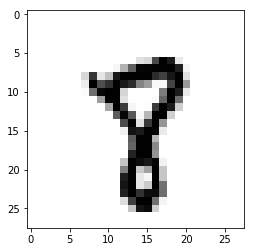

Pred value: 9
True value: 4


Pred value: 7
True value: 5


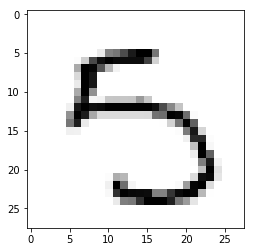

Pred value: 9
True value: 3


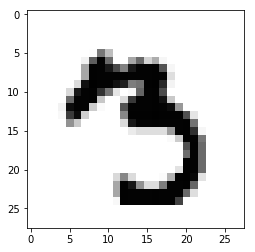

Pred value: 4
True value: 9


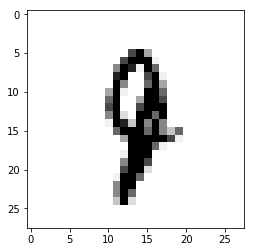

Pred value: 1
True value: 6


Pred value: 1
True value: 2


Pred value: 1
True value: 2


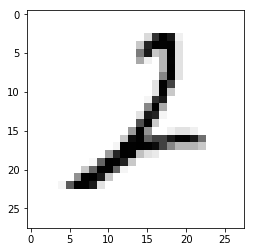

Pred value: 7
True value: 3


Pred value: 2
True value: 0


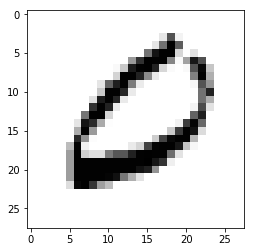

Pred value: 4
True value: 2


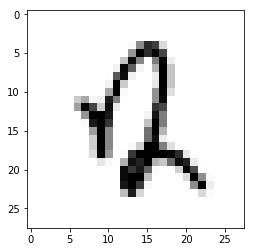

Pred value: 1
True value: 9


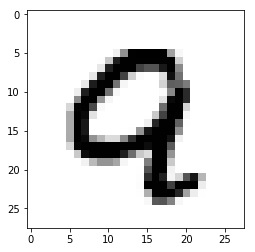

Pred value: 1
True value: 3


Pred value: 5
True value: 3


Pred value: 9
True value: 5


Pred value: 1
True value: 3


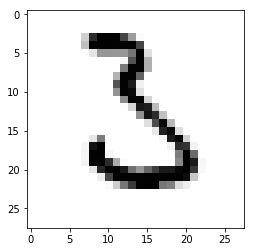

Pred value: 9
True value: 5


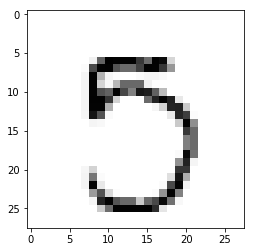

Pred value: 2
True value: 7


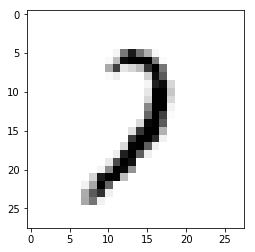

Pred value: 7
True value: 3


Pred value: 1
True value: 8


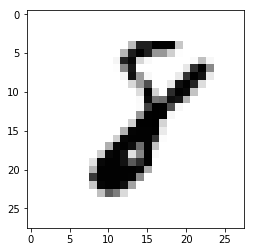

Pred value: 2
True value: 7


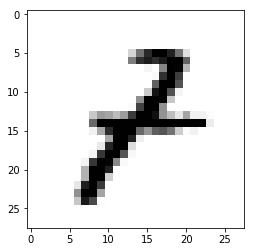

Pred value: 5
True value: 3


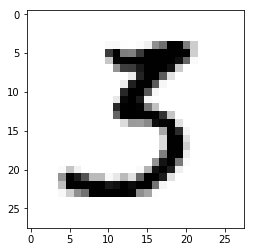

Pred value: 6
True value: 0


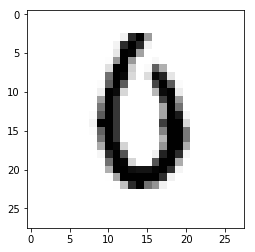

Pred value: 1
True value: 6


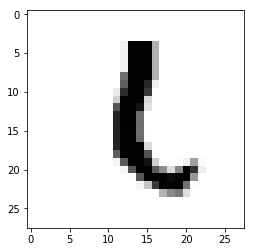

Pred value: 7
True value: 3


Pred value: 9
True value: 5


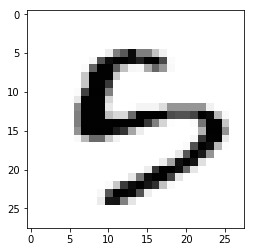

Pred value: 7
True value: 3


Pred value: 9
True value: 7


Pred value: 8
True value: 0


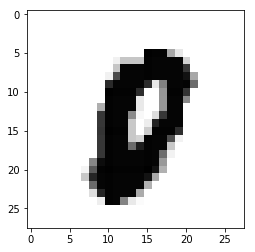

Pred value: 1
True value: 6


Pred value: 2
True value: 9


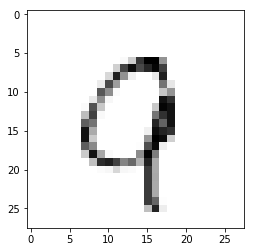

Pred value: 9
True value: 7


Pred value: 4
True value: 6


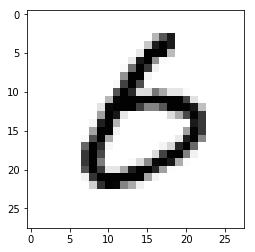

Pred value: 9
True value: 8


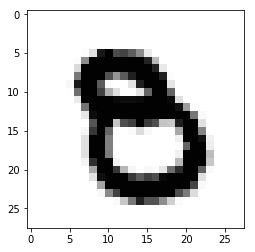

Pred value: 4
True value: 3


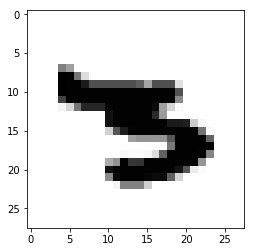

Pred value: 9
True value: 4


Pred value: 1
True value: 4


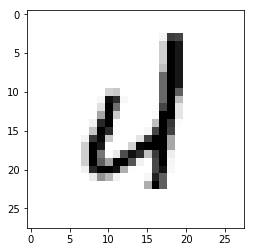

Pred value: 4
True value: 9


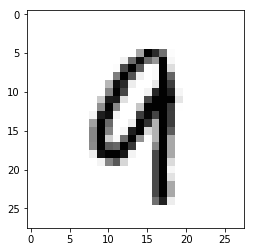

Pred value: 9
True value: 7


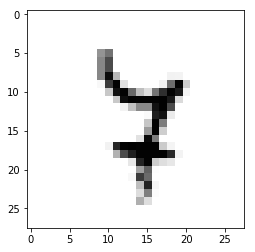

Pred value: 9
True value: 4


Pred value: 9
True value: 7


Pred value: 8
True value: 3


Pred value: 9
True value: 3


Pred value: 2
True value: 3


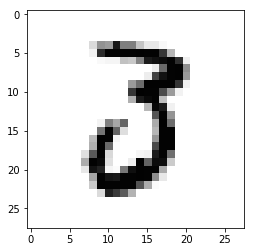

Pred value: 7
True value: 3


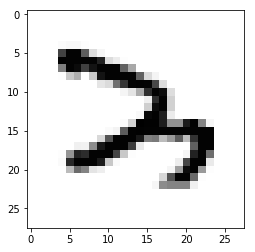

Pred value: 9
True value: 3


Pred value: 5
True value: 9


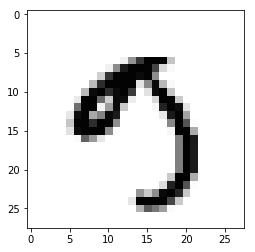

Pred value: 9
True value: 3


Pred value: 5
True value: 3


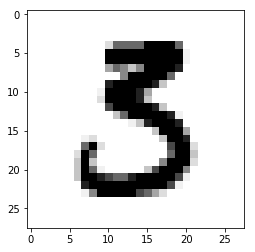

Pred value: 5
True value: 3


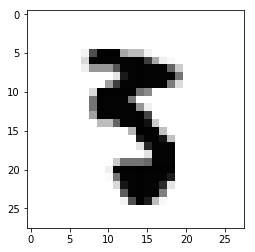

Pred value: 2
True value: 0


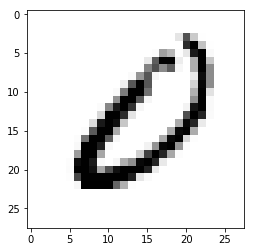

Pred value: 7
True value: 2


Pred value: 7
True value: 5


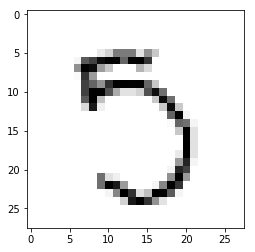

Pred value: 2
True value: 8


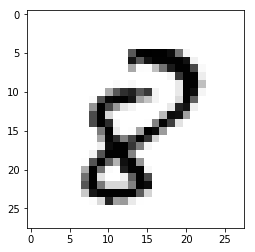

Pred value: 5
True value: 6


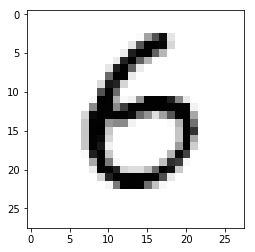

Pred value: 9
True value: 8


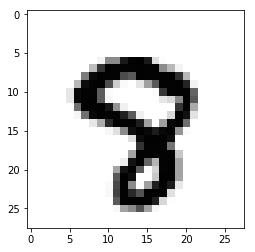

Pred value: 1
True value: 6


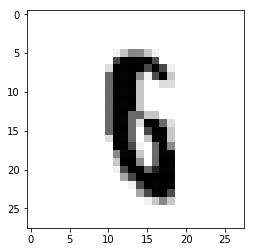

Pred value: 1
True value: 2


Pred value: 1
True value: 6


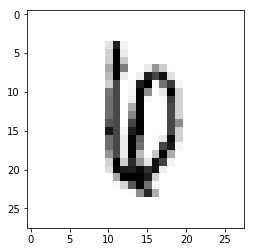

Pred value: 9
True value: 7


Pred value: 1
True value: 8


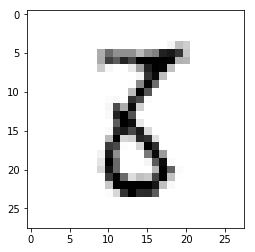

Pred value: 9
True value: 8


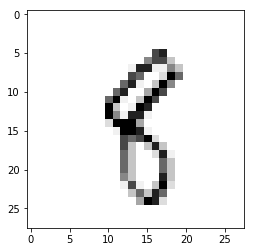

Pred value: 2
True value: 1


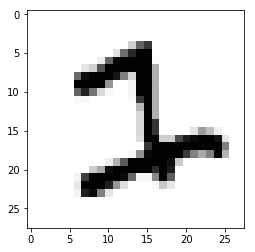

Pred value: 5
True value: 3


Pred value: 1
True value: 4


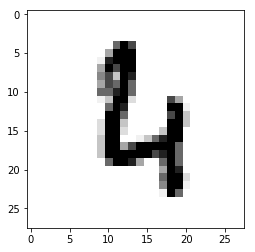

Pred value: 2
True value: 1


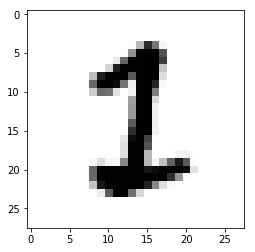

Pred value: 9
True value: 7


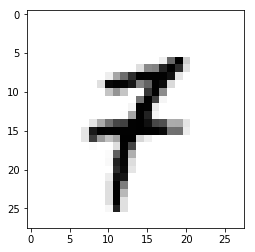

Pred value: 5
True value: 3


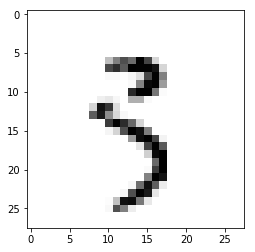

Pred value: 1
True value: 8


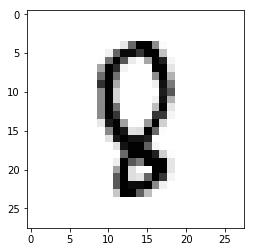

Pred value: 9
True value: 7


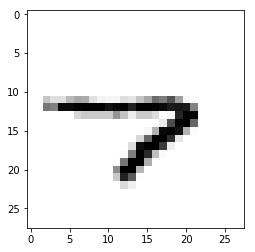

Pred value: 9
True value: 8


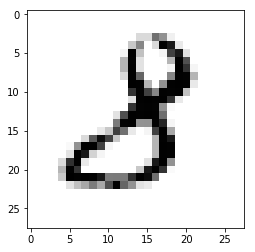

Pred value: 5
True value: 6


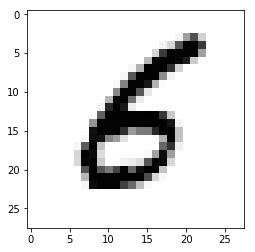

Pred value: 1
True value: 7


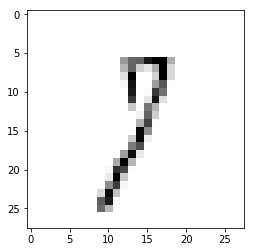

Pred value: 1
True value: 4


Pred value: 9
True value: 8


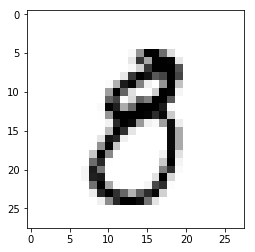

Pred value: 9
True value: 3


Pred value: 9
True value: 0


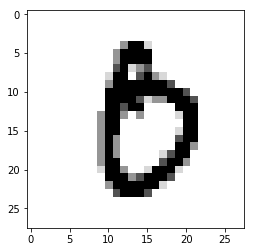

Pred value: 7
True value: 8


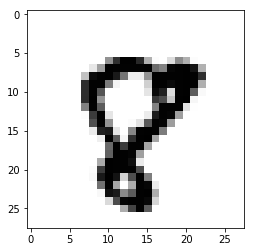

Pred value: 9
True value: 4


Pred value: 9
True value: 8


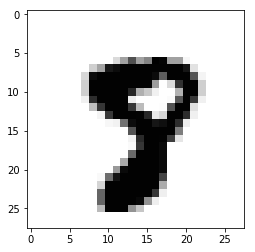

Pred value: 9
True value: 3


Pred value: 4
True value: 7


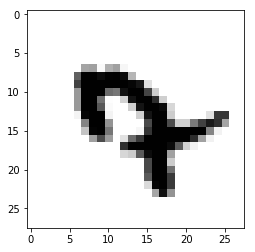

Pred value: 9
True value: 7


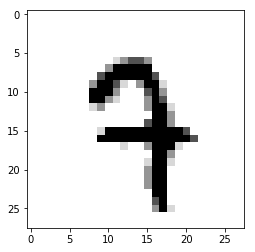

Pred value: 5
True value: 6


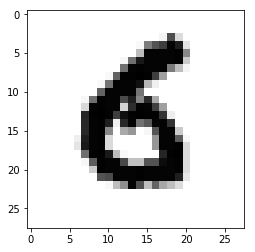

Pred value: 9
True value: 5


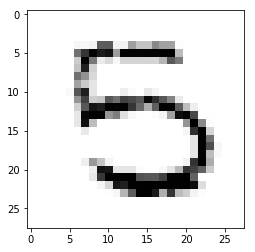

Pred value: 9
True value: 7


Pred value: 8
True value: 3


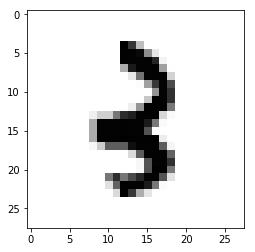

Pred value: 8
True value: 6


Pred value: 1
True value: 9


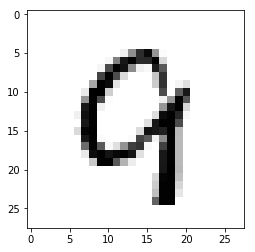

Pred value: 4
True value: 6


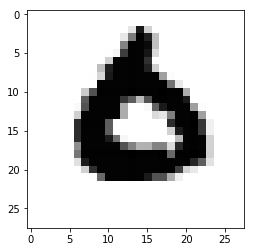

Pred value: 1
True value: 0


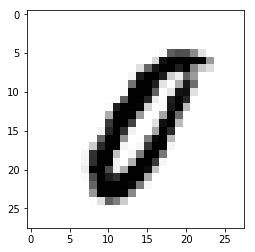

Pred value: 5
True value: 3


Pred value: 1
True value: 9


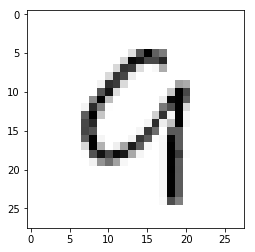

Pred value: 1
True value: 2


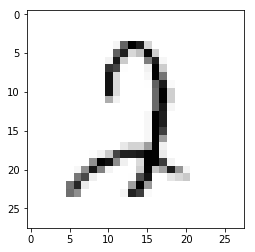

Pred value: 7
True value: 3


Pred value: 9
True value: 4


Pred value: 4
True value: 6


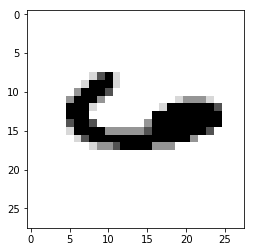

Pred value: 9
True value: 4


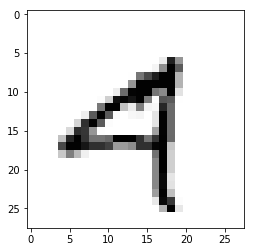

Pred value: 1
True value: 4


Pred value: 2
True value: 3


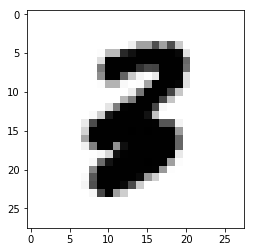

Pred value: 5
True value: 6


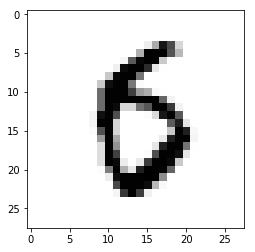

Pred value: 1
True value: 6


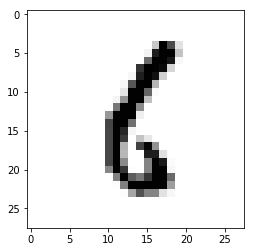

Pred value: 9
True value: 5


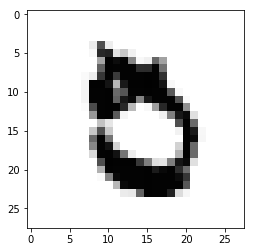

Pred value: 2
True value: 7


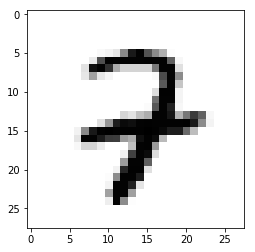

Pred value: 9
True value: 5


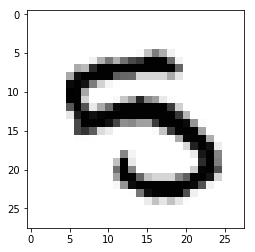

Pred value: 8
True value: 9


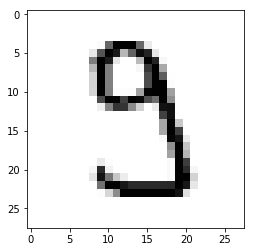

Pred value: 1
True value: 2


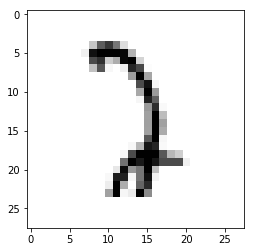

Pred value: 2
True value: 7


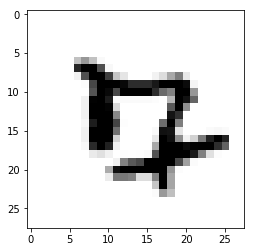

Pred value: 2
True value: 0


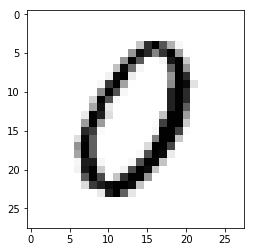

Pred value: 1
True value: 2


Pred value: 5
True value: 8


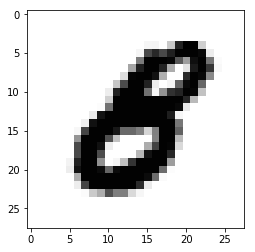

Pred value: 1
True value: 6


Pred value: 9
True value: 4


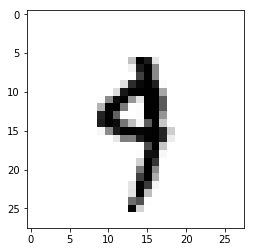

Pred value: 2
True value: 8


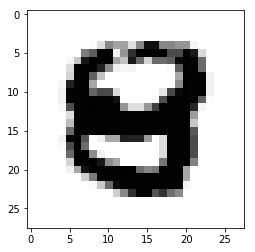

Pred value: 9
True value: 7


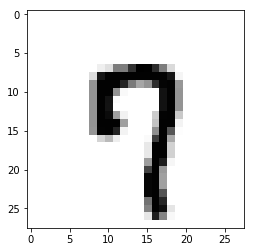

Pred value: 9
True value: 3


Pred value: 7
True value: 3


Pred value: 1
True value: 7


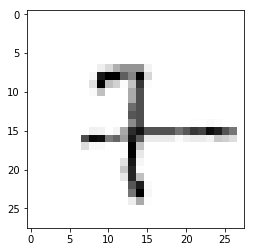

Pred value: 1
True value: 4


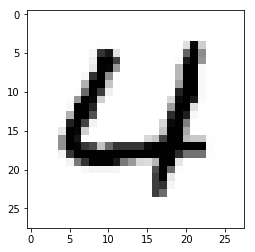

Pred value: 9
True value: 5


Pred value: 5
True value: 8


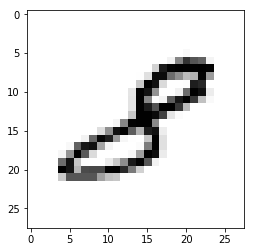

Pred value: 4
True value: 6


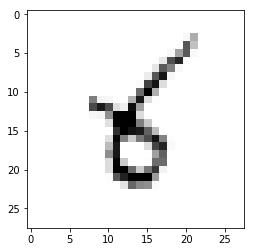

Pred value: 2
True value: 7


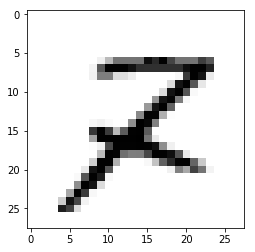

Pred value: 9
True value: 3


Pred value: 1
True value: 4


Pred value: 6
True value: 5


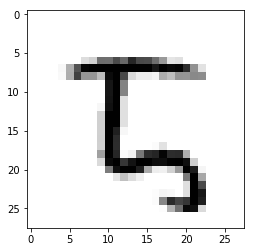

Pred value: 9
True value: 3


Pred value: 8
True value: 2


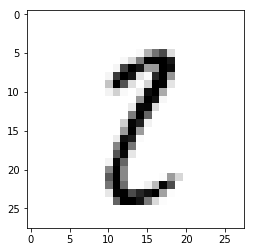

Pred value: 9
True value: 7


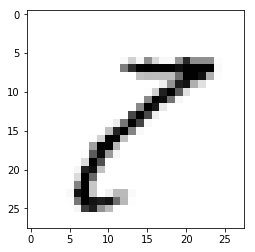

Pred value: 6
True value: 0


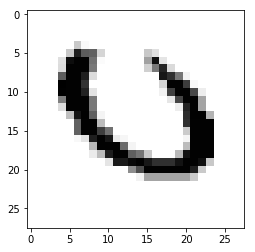

Pred value: 4
True value: 9


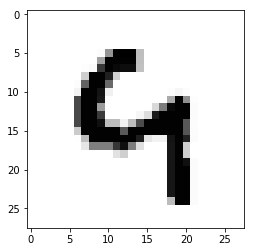

Pred value: 1
True value: 8


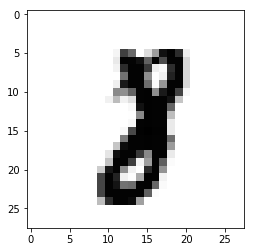

Pred value: 2
True value: 3


Pred value: 9
True value: 7


Pred value: 9
True value: 7


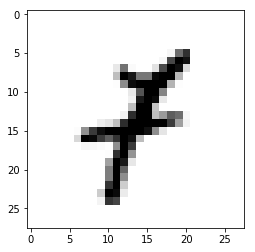

Pred value: 1
True value: 7


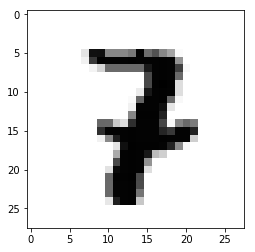

Pred value: 0
True value: 6


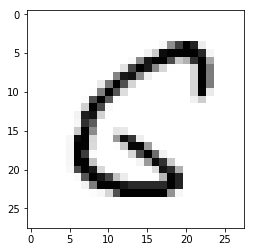

Pred value: 0
True value: 5


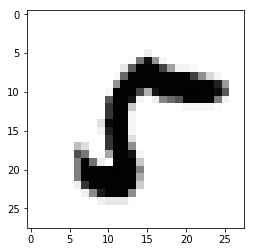

Pred value: 9
True value: 8


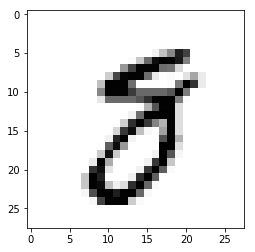

Pred value: 2
True value: 9


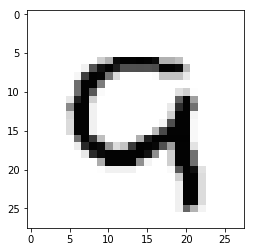

Pred value: 2
True value: 1


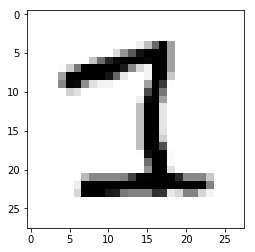

Pred value: 1
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 8


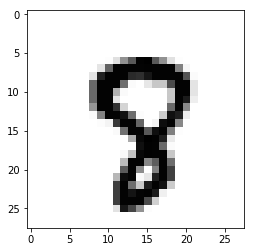

Pred value: 4
True value: 3


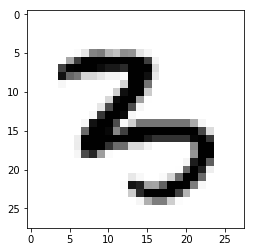

Pred value: 9
True value: 5


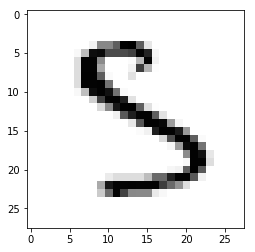

Pred value: 9
True value: 8


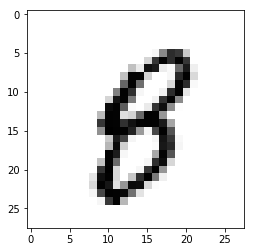

Pred value: 5
True value: 3


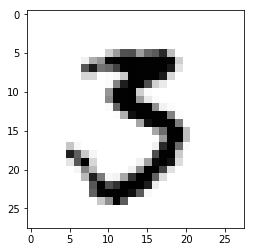

Pred value: 9
True value: 7


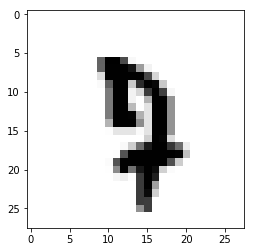

Pred value: 1
True value: 3


Pred value: 5
True value: 6


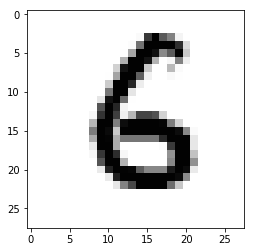

Pred value: 9
True value: 7


Pred value: 1
True value: 6


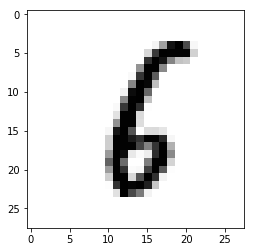

Pred value: 9
True value: 7


Pred value: 5
True value: 6


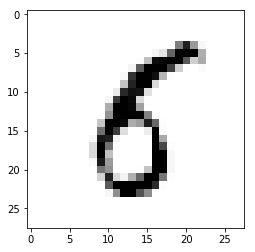

Pred value: 9
True value: 0


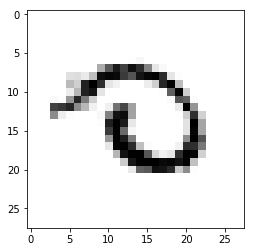

Pred value: 1
True value: 4


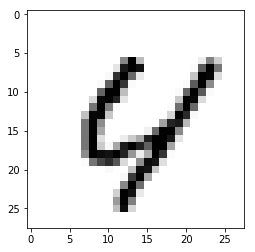

Pred value: 7
True value: 3


Pred value: 4
True value: 9


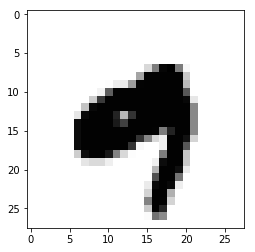

Pred value: 9
True value: 7


Pred value: 4
True value: 9


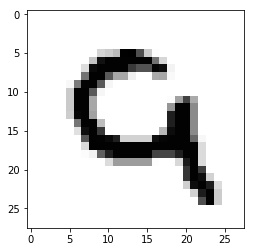

Pred value: 9
True value: 8


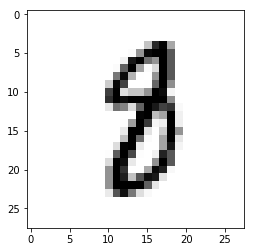

Pred value: 9
True value: 8


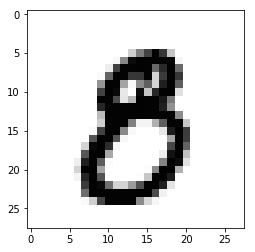

Pred value: 1
True value: 0


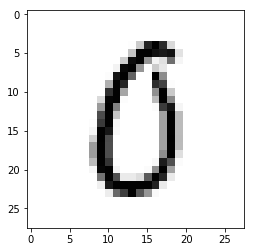

Pred value: 5
True value: 9


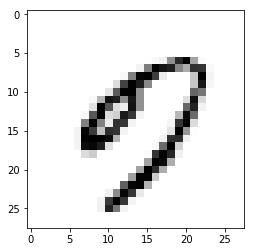

Pred value: 1
True value: 8


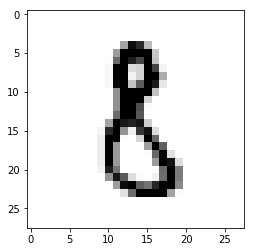

Pred value: 9
True value: 2


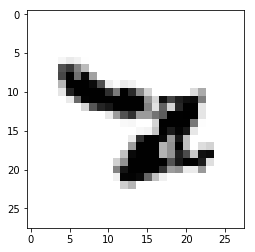

Pred value: 9
True value: 4


Pred value: 9
True value: 7


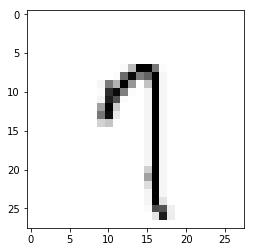

Pred value: 4
True value: 1


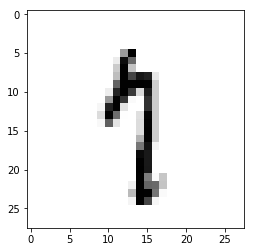

Pred value: 2
True value: 8


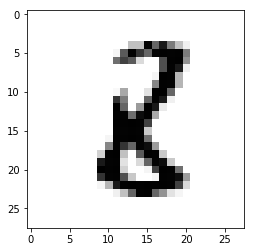

Pred value: 7
True value: 1


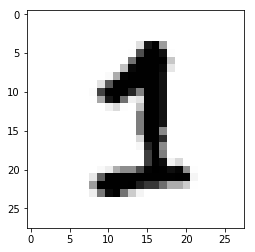

Pred value: 9
True value: 7


Pred value: 9
True value: 4


Pred value: 7
True value: 9


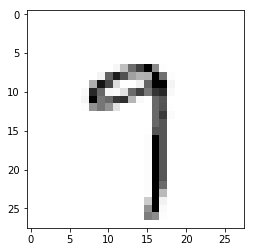

Pred value: 6
True value: 8


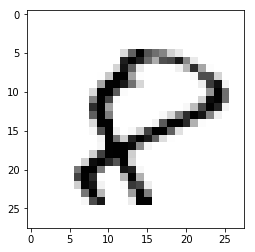

Pred value: 5
True value: 6


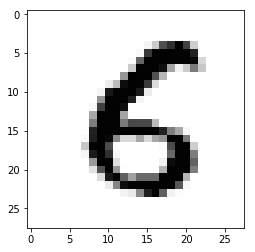

Pred value: 1
True value: 2


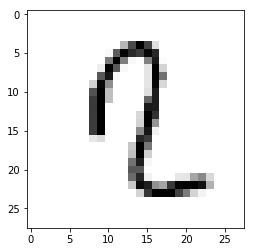

Pred value: 2
True value: 3


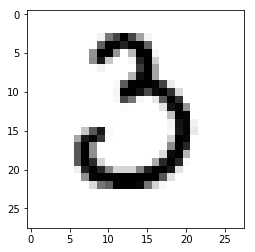

Pred value: 1
True value: 4


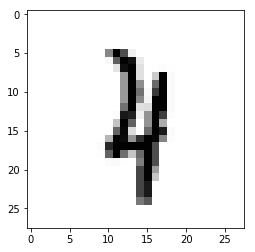

Pred value: 1
True value: 4


Pred value: 7
True value: 2


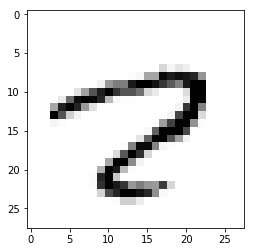

Pred value: 4
True value: 9


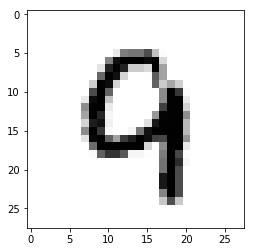

Pred value: 7
True value: 3


Pred value: 9
True value: 4


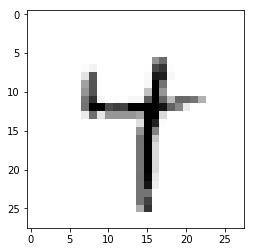

Pred value: 8
True value: 5


Pred value: 9
True value: 3


Pred value: 7
True value: 5


Pred value: 9
True value: 5


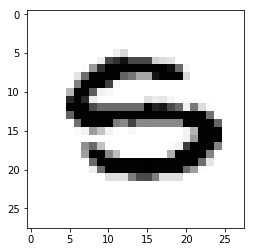

Pred value: 5
True value: 8


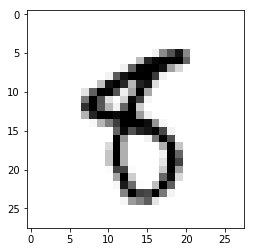

Pred value: 7
True value: 8


Pred value: 9
True value: 7


Pred value: 1
True value: 9


Pred value: 1
True value: 6


Pred value: 1
True value: 4


Pred value: 7
True value: 3


Pred value: 1
True value: 3


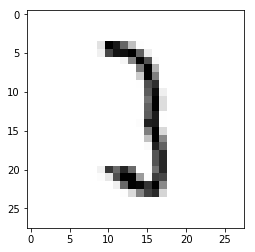

Pred value: 6
True value: 8


Pred value: 1
True value: 0


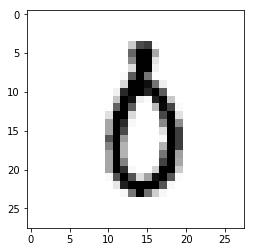

Pred value: 7
True value: 8


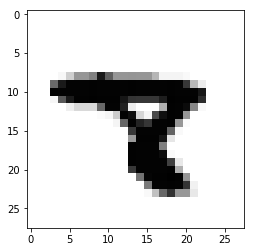

Pred value: 7
True value: 2


Pred value: 5
True value: 3


Pred value: 7
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 7


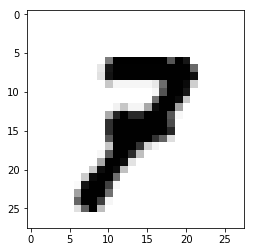

Pred value: 9
True value: 3


Pred value: 4
True value: 6


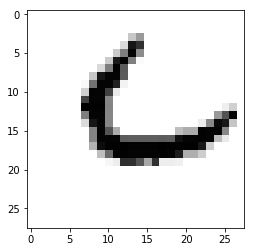

Pred value: 9
True value: 3


Pred value: 4
True value: 9


Pred value: 2
True value: 6


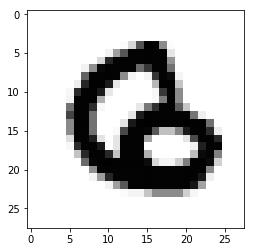

Pred value: 2
True value: 4


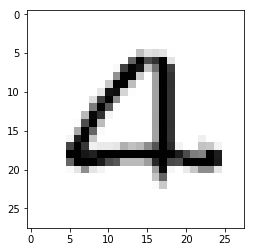

Pred value: 9
True value: 7


Pred value: 4
True value: 8


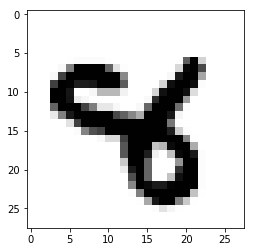

Pred value: 1
True value: 6


Pred value: 7
True value: 3


Pred value: 9
True value: 8


Pred value: 9
True value: 3


Pred value: 7
True value: 2


Pred value: 1
True value: 2


Pred value: 2
True value: 7


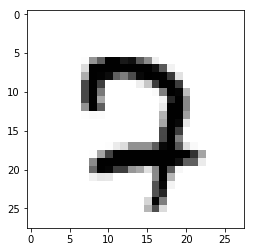

Pred value: 1
True value: 6


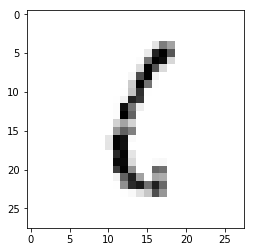

Pred value: 7
True value: 8


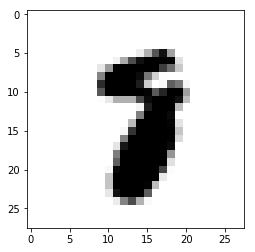

Pred value: 4
True value: 0


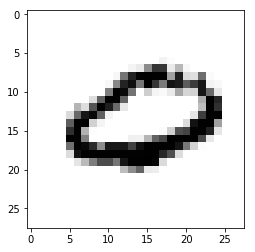

Pred value: 9
True value: 3


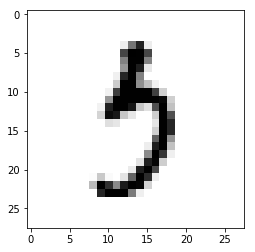

Pred value: 9
True value: 7


Pred value: 1
True value: 4


Pred value: 1
True value: 3


Pred value: 7
True value: 3


Pred value: 9
True value: 4


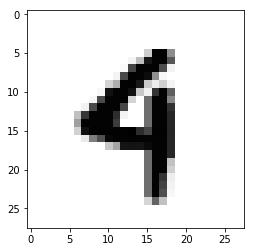

Pred value: 9
True value: 3


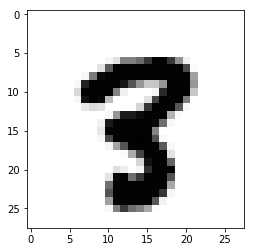

Pred value: 9
True value: 7


Pred value: 1
True value: 6


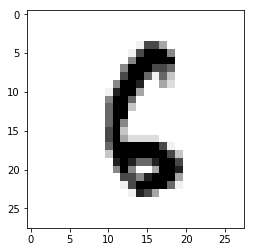

Pred value: 9
True value: 3


Pred value: 1
True value: 6


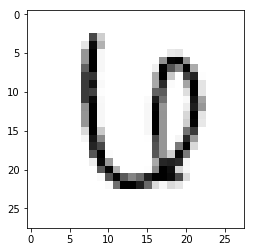

Pred value: 4
True value: 9


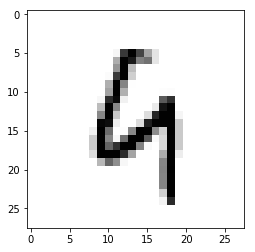

Pred value: 2
True value: 7


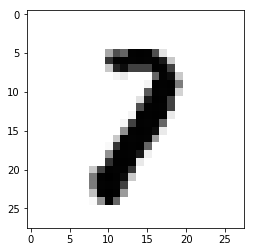

Pred value: 5
True value: 6


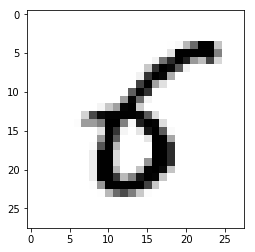

Pred value: 9
True value: 3


Pred value: 7
True value: 3


Pred value: 0
True value: 9


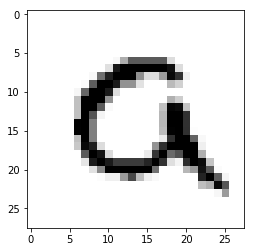

Pred value: 4
True value: 2


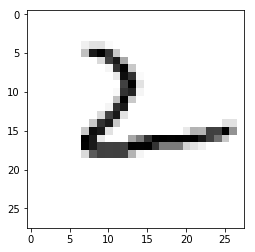

Pred value: 1
True value: 8


Pred value: 9
True value: 0


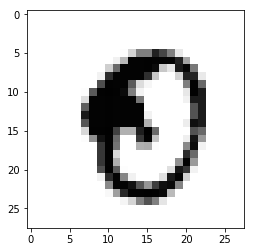

Pred value: 1
True value: 7


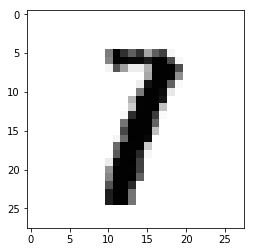

Pred value: 7
True value: 3


Pred value: 5
True value: 6


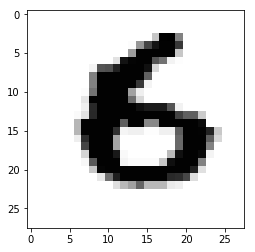

Pred value: 7
True value: 2


Pred value: 4
True value: 8


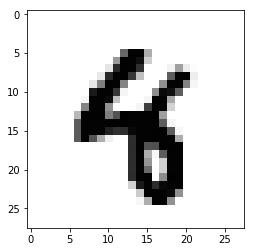

Pred value: 9
True value: 7


Pred value: 7
True value: 9


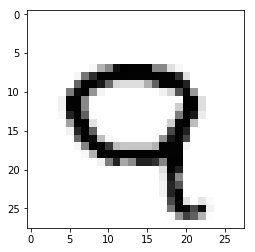

Pred value: 1
True value: 4


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 5
True value: 3


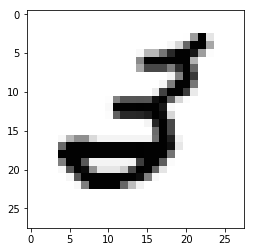

Pred value: 9
True value: 2


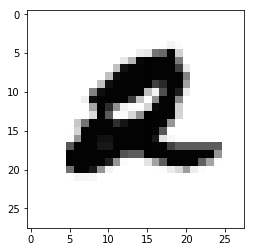

Pred value: 9
True value: 7


Pred value: 5
True value: 3


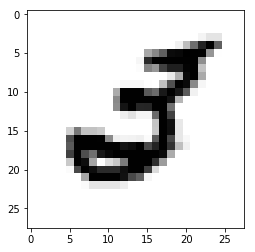

Pred value: 9
True value: 3


Pred value: 9
True value: 4


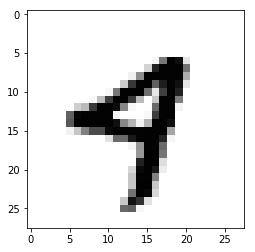

Pred value: 9
True value: 0


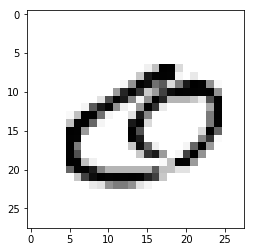

Pred value: 1
True value: 4


Pred value: 2
True value: 7


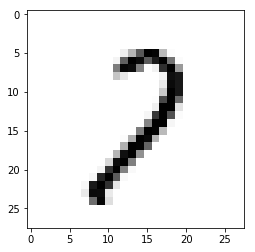

Pred value: 1
True value: 0


Pred value: 2
True value: 0


Pred value: 2
True value: 7


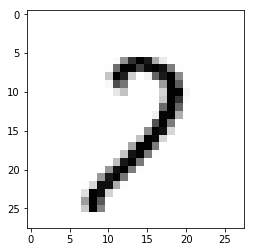

Pred value: 4
True value: 6


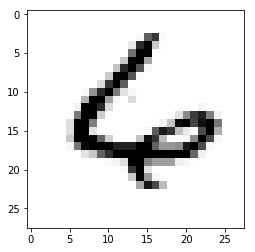

Pred value: 9
True value: 0


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 1
True value: 6


Pred value: 9
True value: 3


Pred value: 9
True value: 8


Pred value: 9
True value: 3


Pred value: 1
True value: 0


Pred value: 9
True value: 3


Pred value: 5
True value: 3


Pred value: 9
True value: 7


Pred value: 9
True value: 3


Pred value: 9
True value: 7


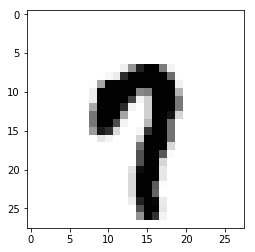

Pred value: 9
True value: 7


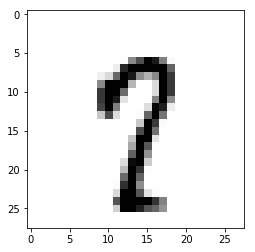

Pred value: 9
True value: 7


Pred value: 7
True value: 3


Pred value: 9
True value: 7


Pred value: 9
True value: 7


Pred value: 7
True value: 3


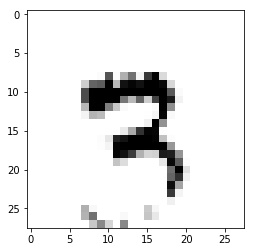

Pred value: 2
True value: 6


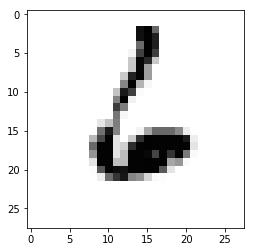

Pred value: 2
True value: 0


Pred value: 2
True value: 0


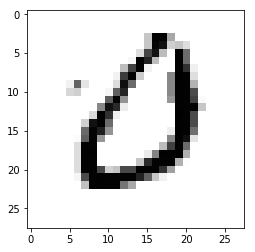

Pred value: 9
True value: 3


Pred value: 2
True value: 7


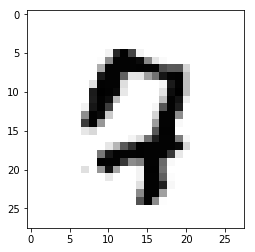

Pred value: 9
True value: 3


Pred value: 9
True value: 4


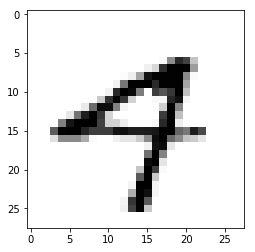

Pred value: 9
True value: 7


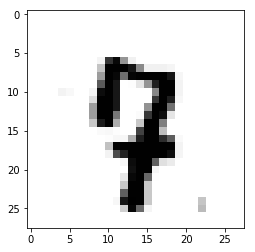

Pred value: 4
True value: 6


Pred value: 0
True value: 7


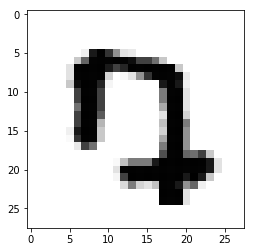

Pred value: 1
True value: 0


Pred value: 4
True value: 7


Pred value: 9
True value: 7


Pred value: 9
True value: 3


Pred value: 9
True value: 5


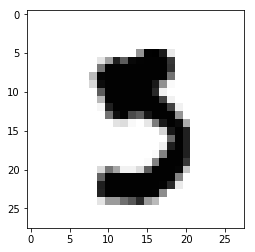

Pred value: 9
True value: 3


Pred value: 9
True value: 7


Pred value: 9
True value: 3


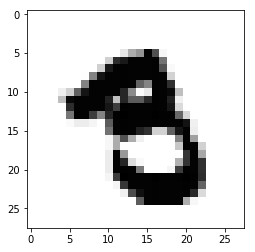

Pred value: 1
True value: 6


Pred value: 9
True value: 5


Pred value: 9
True value: 3


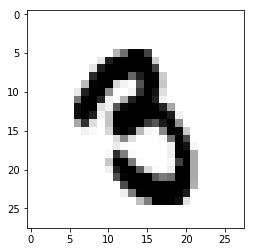

Pred value: 9
True value: 5


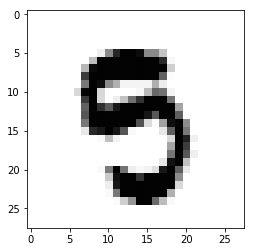

Pred value: 8
True value: 5


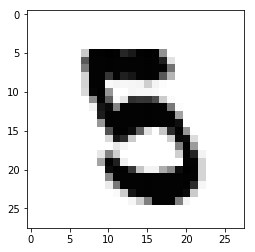

Pred value: 1
True value: 6


Pred value: 9
True value: 7


Pred value: 9
True value: 5


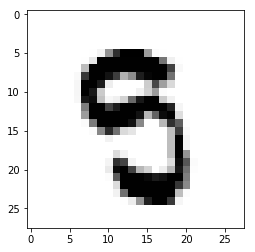

Pred value: 9
True value: 8


Pred value: 9
True value: 3


Pred value: 1
True value: 3


Pred value: 9
True value: 3


Pred value: 7
True value: 3


Pred value: 9
True value: 3


Pred value: 4
True value: 2


Pred value: 9
True value: 5


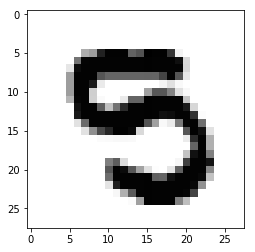

Pred value: 9
True value: 5


Pred value: 9
True value: 3


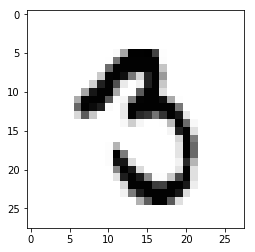

Pred value: 1
True value: 3


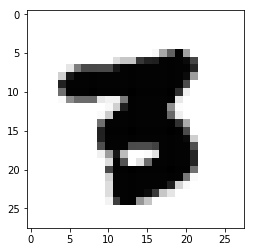

Pred value: 9
True value: 3


Pred value: 5
True value: 9


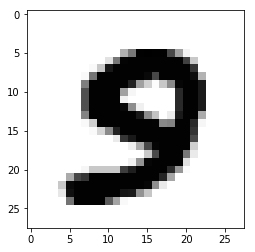

Pred value: 5
True value: 9


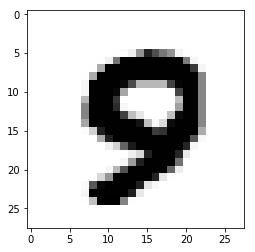

Pred value: 9
True value: 3


Pred value: 5
True value: 9


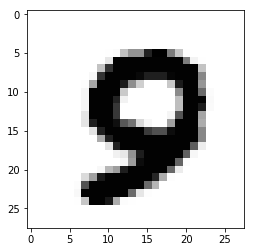

Pred value: 0
True value: 8


Pred value: 5
True value: 9


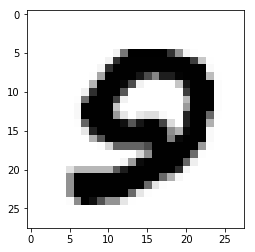

Pred value: 5
True value: 9


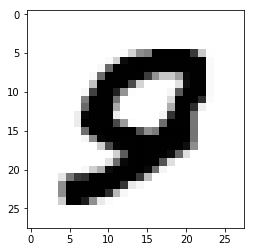

Pred value: 9
True value: 3


Pred value: 1
True value: 8


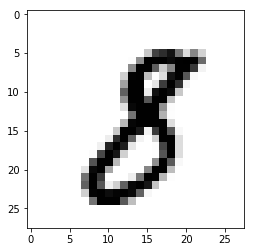

Pred value: 9
True value: 3


Pred value: 6
True value: 5


Pred value: 2
True value: 0


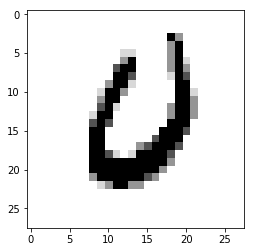

Pred value: 9
True value: 3


Pred value: 9
True value: 8


Pred value: 0
True value: 9


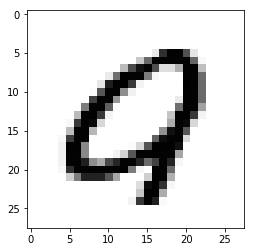

Pred value: 9
True value: 3


Pred value: 2
True value: 3


Pred value: 9
True value: 3


Pred value: 7
True value: 3


Pred value: 9
True value: 8


Pred value: 2
True value: 0


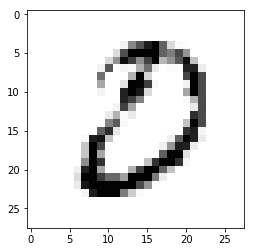

Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 1
True value: 7


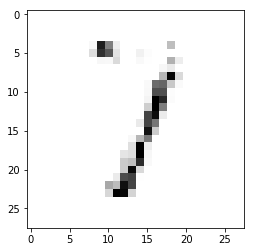

Pred value: 2
True value: 7


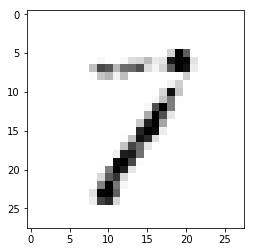

Pred value: 9
True value: 3


Pred value: 7
True value: 0


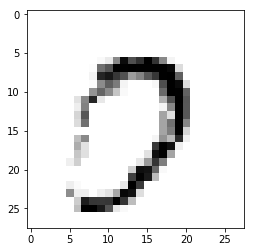

Pred value: 9
True value: 7


Pred value: 9
True value: 8


Pred value: 1
True value: 8


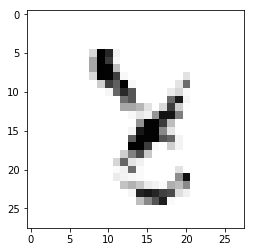

Pred value: 9
True value: 3


Pred value: 5
True value: 8


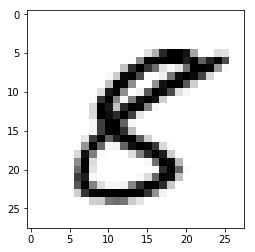

Pred value: 1
True value: 0


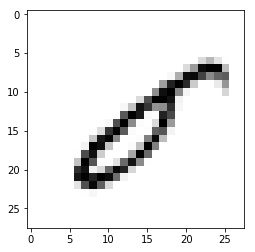

Pred value: 7
True value: 3


Pred value: 9
True value: 3


Pred value: 7
True value: 2


Pred value: 0
True value: 6


Pred value: 9
True value: 5


Pred value: 4
True value: 2


Pred value: 9
True value: 3


Pred value: 9
True value: 7


Pred value: 0
True value: 9


Pred value: 9
True value: 7


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 7
True value: 2


Pred value: 4
True value: 6


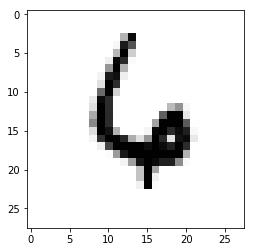

Pred value: 9
True value: 8


Pred value: 9
True value: 3


Pred value: 2
True value: 0


Pred value: 6
True value: 0


Pred value: 7
True value: 3


Pred value: 1
True value: 0


Pred value: 9
True value: 8


Pred value: 5
True value: 3


Pred value: 9
True value: 8


Pred value: 7
True value: 2


Pred value: 1
True value: 0


Pred value: 1
True value: 8


Pred value: 7
True value: 3


Pred value: 9
True value: 8


Pred value: 5
True value: 6


Pred value: 9
True value: 3


Pred value: 7
True value: 2


Pred value: 7
True value: 3


Pred value: 8
True value: 0


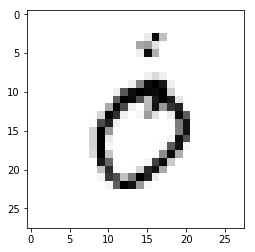

Pred value: 7
True value: 3


Pred value: 9
True value: 2


Pred value: 5
True value: 3


Pred value: 7
True value: 3


Pred value: 5
True value: 6


Pred value: 7
True value: 8


Pred value: 1
True value: 7


Pred value: 9
True value: 3


Pred value: 1
True value: 4


Pred value: 9
True value: 3


Pred value: 6
True value: 0


Pred value: 9
True value: 8


Pred value: 1
True value: 0


Pred value: 2
True value: 3


Pred value: 2
True value: 7


Pred value: 9
True value: 4


Pred value: 9
True value: 3


Pred value: 2
True value: 0


Pred value: 1
True value: 4


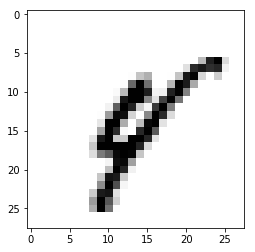

Pred value: 9
True value: 3


Pred value: 7
True value: 3


Pred value: 1
True value: 4


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 1
True value: 4


Pred value: 9
True value: 7


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 7


Pred value: 9
True value: 8


Pred value: 2
True value: 0


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 5
True value: 3


Pred value: 8
True value: 5


Pred value: 9
True value: 7


Pred value: 2
True value: 3


Pred value: 2
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 7
True value: 2


Pred value: 4
True value: 2


Pred value: 9
True value: 3


Pred value: 9
True value: 7


Pred value: 9
True value: 8


Pred value: 9
True value: 8


Pred value: 9
True value: 3


Pred value: 1
True value: 4


Pred value: 1
True value: 2


Pred value: 1
True value: 4


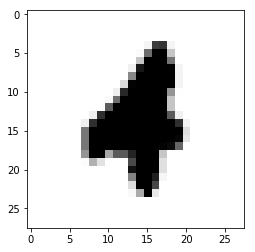

Pred value: 1
True value: 2


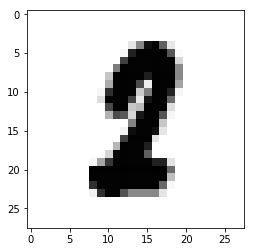

Pred value: 1
True value: 4


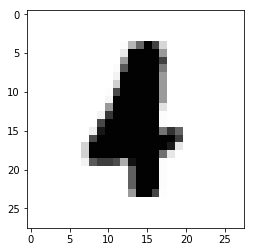

Pred value: 9
True value: 8


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 7
True value: 2


Pred value: 9
True value: 3


Pred value: 7
True value: 9


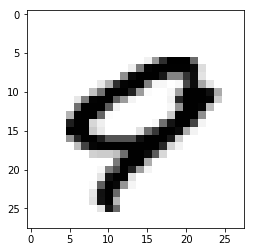

Pred value: 5
True value: 8


Pred value: 5
True value: 3


Pred value: 2
True value: 0


Pred value: 9
True value: 2


Pred value: 1
True value: 4


Pred value: 4
True value: 8


Pred value: 9
True value: 3


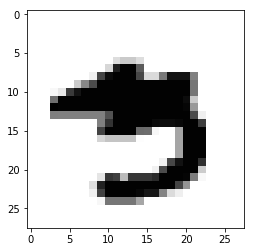

Pred value: 9
True value: 2


Pred value: 9
True value: 3


Pred value: 2
True value: 6


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 7
True value: 0


Pred value: 9
True value: 3


Pred value: 9
True value: 0


Pred value: 2
True value: 6


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 5
True value: 3


Pred value: 5
True value: 8


Pred value: 9
True value: 3


Pred value: 4
True value: 6


Pred value: 1
True value: 0


Pred value: 2
True value: 6


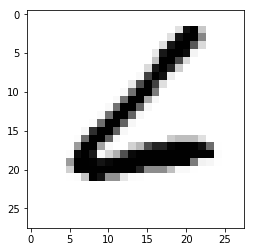

Pred value: 9
True value: 3


Pred value: 9
True value: 8


Pred value: 7
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 7


Pred value: 9
True value: 3


Pred value: 9
True value: 0


Pred value: 2
True value: 0


Pred value: 9
True value: 3


Pred value: 7
True value: 3


Pred value: 9
True value: 8


Pred value: 9
True value: 4


Pred value: 6
True value: 8


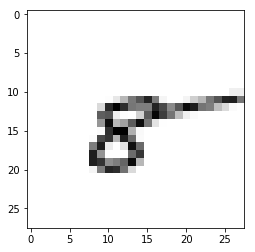

Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 1
True value: 8


Pred value: 9
True value: 4


Pred value: 9
True value: 8


Pred value: 7
True value: 3


Pred value: 7
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 1
True value: 8


Pred value: 1
True value: 8


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 5
True value: 3


Pred value: 2
True value: 7


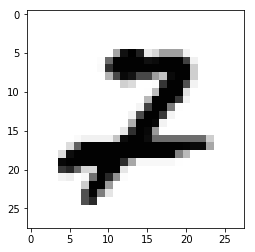

Pred value: 5
True value: 0


Pred value: 9
True value: 8


Pred value: 2
True value: 7


Pred value: 2
True value: 7


Pred value: 9
True value: 7


Pred value: 9
True value: 7


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 9
True value: 3


Pred value: 2
True value: 3


Pred value: 5
True value: 8


Pred value: 9
True value: 7


Pred value: 9
True value: 3


Pred value: 9
True value: 4


Pred value: 9
True value: 3


Pred value: 7
True value: 3


Pred value: 9
True value: 3


Pred value: 7
True value: 3


Pred value: 5
True value: 8


Pred value: 5
True value: 3


Pred value: 9
True value: 8


Pred value: 7
True value: 0


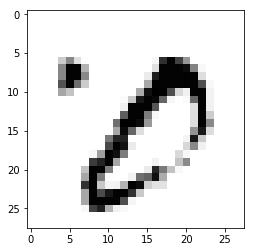

Pred value: 7
True value: 9


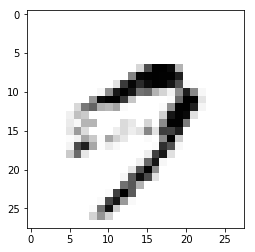

Pred value: 5
True value: 3


Pred value: 7
True value: 2


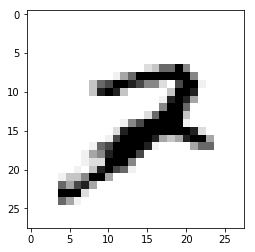

Pred value: 1
True value: 0


Pred value: 9
True value: 4


Pred value: 9
True value: 8


Pred value: 1
True value: 6


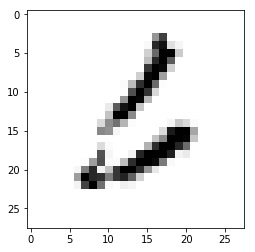

Pred value: 5
True value: 2


Pred value: 5
True value: 6


Pred value: 1
True value: 4


Pred value: 1
True value: 8


Pred value: 1
True value: 4


Pred value: 9
True value: 8


Pred value: 9
True value: 7


Pred value: 5
True value: 2


Pred value: 0
True value: 5


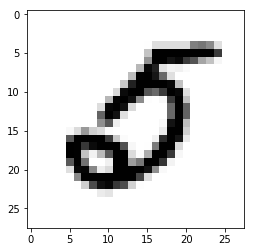

Pred value: 5
True value: 2


Pred value: 1
True value: 0


Pred value: 5
True value: 3


Pred value: 7
True value: 2


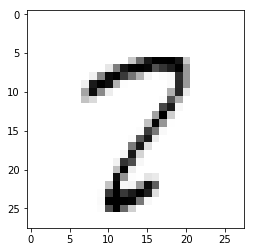

Pred value: 4
True value: 0


Pred value: 5
True value: 8


Pred value: 9
True value: 8


Pred value: 1
True value: 0


Pred value: 8
True value: 6


Pred value: 5
True value: 8


Pred value: 8
True value: 2


Pred value: 7
True value: 3


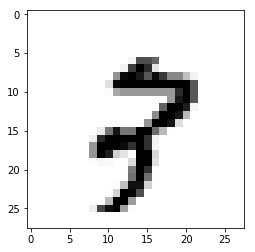

Pred value: 2
True value: 4


Pred value: 9
True value: 3


Pred value: 9
True value: 4


Pred value: 5
True value: 3


Pred value: 9
True value: 3


Pred value: 1
True value: 4


Pred value: 9
True value: 8


Pred value: 2
True value: 0


In [0]:
# Loading dataset
(train_x, y_train), (test_x, y_test) = tf.keras.datasets.mnist.load_data()
# Reshaping the array to 4-dims so that it can work with the Keras API
x_train = train_x.reshape(train_x.shape[0], 28, 28, 1)
x_test = test_x.reshape(test_x.shape[0], 28, 28, 1)
input_shape = (28, 28, 1)
# Making sure that the values are float so that we can get decimal points after division
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
# Normalizing the RGB codes by dividing it to the max RGB value.
#x_train /= 255
#x_test /= 255
print('x_train shape:', x_train.shape)
print('Number of images in x_train', x_train.shape[0])
print('Number of images in x_test', x_test.shape[0])
# Creating a Sequential Model and adding the layers
model = Sequential()
model.add(Conv2D(28, kernel_size=(3,3), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(20, kernel_size=(5,5), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(28, kernel_size=(3,3), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten()) # Flattening the 2D arrays for fully connected layers
model.add(Dense(128, activation=tf.nn.relu))
model.add(Dropout(0.5))      
model.add(Dense(10,activation=tf.nn.softmax))
print(model.summary())
model.compile(optimizer='adam', 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)
his = model.fit(x=x_train,y=y_train, epochs=50)
_, train_acc = model.evaluate(x_train, y_train, verbose=0)
_, test_acc = model.evaluate(x_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
y_pred = model.predict(x_test)
print(y_pred.shape)
print(y_test.shape)
y = np.argmax(y_pred, axis=1)
print(y.shape)
confusion_matrix(y_test, y)
for i in range(10000):
    if(y[i] != y_test[i]):
        print("Pred value:",y[i])
        print("True value:",y_test[i])
        plt.figure
        plt.imshow(x_test[i].reshape(28, 28),cmap='Greys')
        plt.show()

11493376/11490434 [==============================] - 0s 0us/step


W0807 00:04:15.480462 140663381047168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0807 00:04:15.521165 140663381047168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0807 00:04:15.531637 140663381047168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0807 00:04:15.580626 140663381047168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3976: The name tf.nn.max_pool is deprecated. Please use tf.nn.max_pool2d instead.

W0807 00:04:15.634746 140663381047168 deprecation_wrapp

x_train shape: (60000, 28, 28, 1)
Number of images in x_train 60000
Number of images in x_test 10000
_________________________________________________________________


W0807 00:04:15.682572 140663381047168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.

W0807 00:04:15.710128 140663381047168 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3341: The name tf.log is deprecated. Please use tf.math.log instead.

W0807 00:04:15.844907 140663381047168 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 24, 24, 28)        728       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 6, 6, 28)          0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 4, 4, 28)          7084      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 2, 2, 28)          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 112)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 100)               11300     
_________________________________________________________________
dropout_1 (Dropout)          (None, 100)               0         
_________________________________________________________________
dense_2 (D

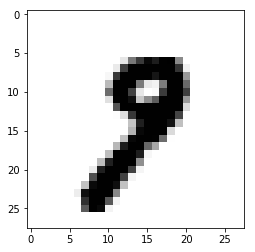

Pred value: 7
True value: 9


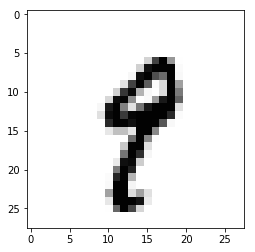

Pred value: 7
True value: 9


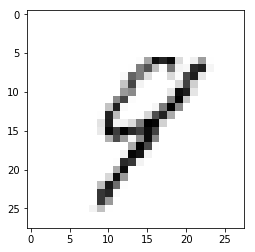

Pred value: 9
True value: 4


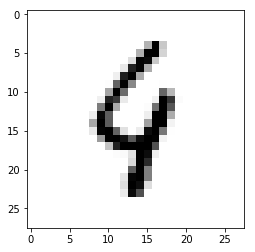

Pred value: 7
True value: 9


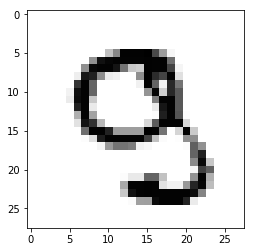

Pred value: 8
True value: 9


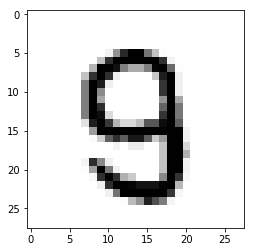

Pred value: 7
True value: 2


Pred value: 6
True value: 4


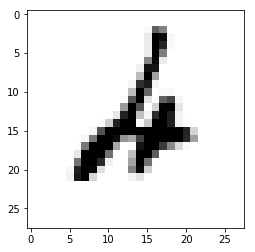

Pred value: 3
True value: 2


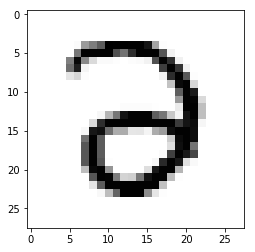

Pred value: 7
True value: 9


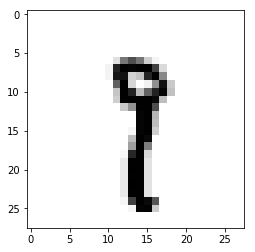

Pred value: 7
True value: 2


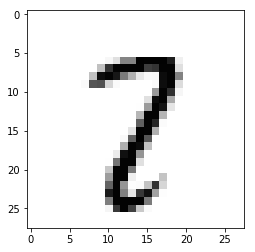

Pred value: 8
True value: 0


Pred value: 8
True value: 9


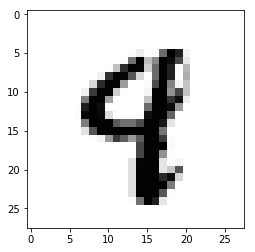

Pred value: 7
True value: 2


Pred value: 8
True value: 6


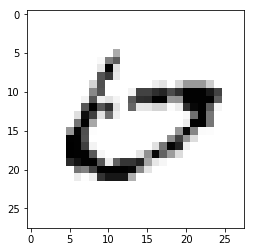

Pred value: 8
True value: 9


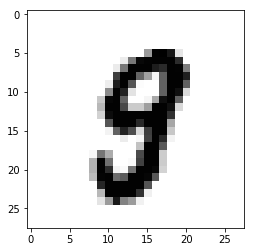

Pred value: 5
True value: 3


Pred value: 5
True value: 3


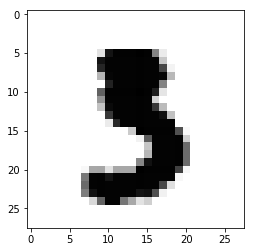

Pred value: 7
True value: 3


Pred value: 5
True value: 9


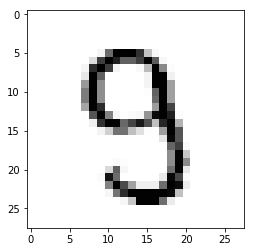

Pred value: 8
True value: 0


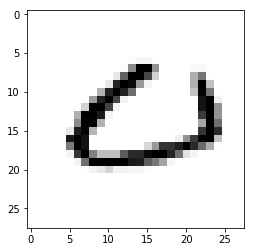

Pred value: 8
True value: 0


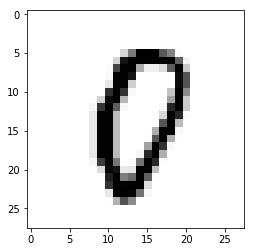

Pred value: 7
True value: 4


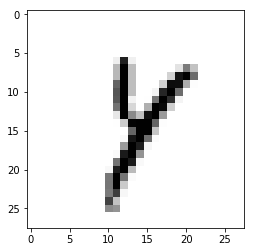

Pred value: 7
True value: 3


Pred value: 2
True value: 8


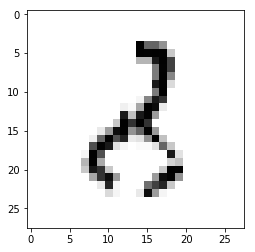

Pred value: 7
True value: 2


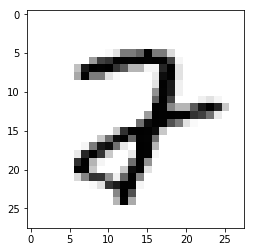

Pred value: 8
True value: 0


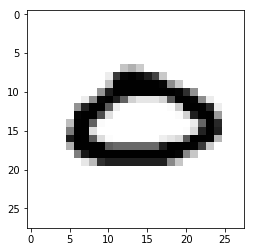

Pred value: 6
True value: 4


Pred value: 7
True value: 2


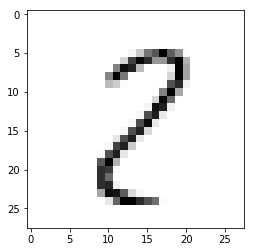

Pred value: 6
True value: 2


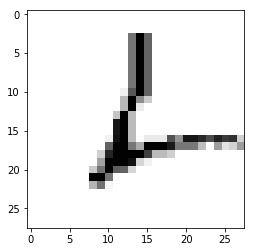

Pred value: 7
True value: 2


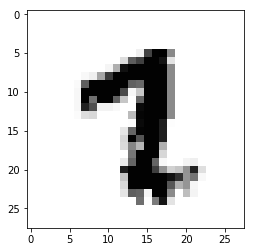

Pred value: 7
True value: 8


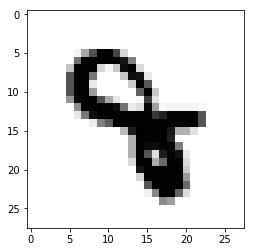

Pred value: 8
True value: 4


Pred value: 7
True value: 1


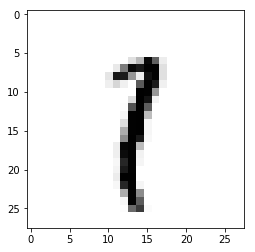

Pred value: 5
True value: 0


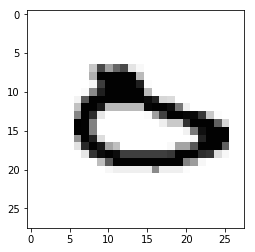

Pred value: 9
True value: 4


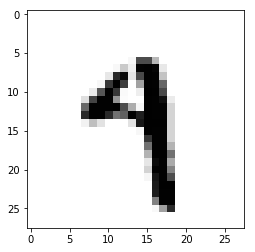

Pred value: 5
True value: 6


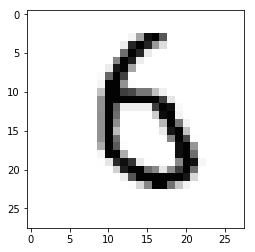

Pred value: 8
True value: 0


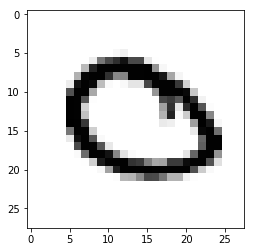

Pred value: 3
True value: 8


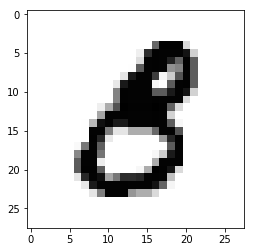

Pred value: 7
True value: 8


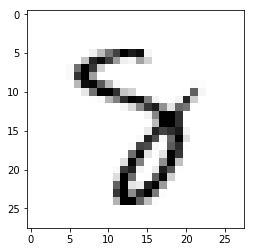

Pred value: 9
True value: 7


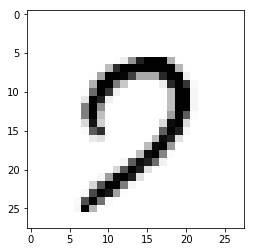

Pred value: 7
True value: 9


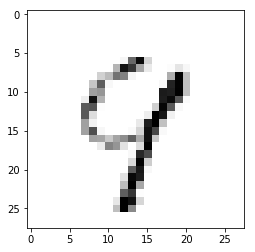

Pred value: 5
True value: 3


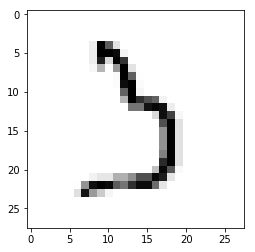

Pred value: 5
True value: 3


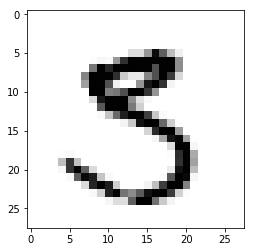

Pred value: 8
True value: 1


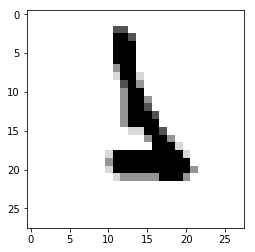

Pred value: 8
True value: 4


Pred value: 5
True value: 6


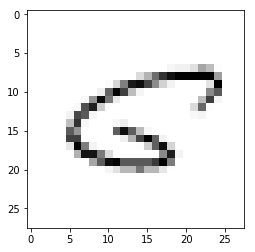

Pred value: 8
True value: 7


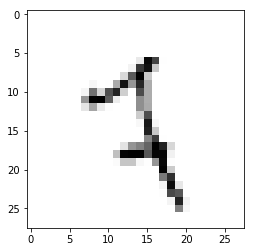

Pred value: 8
True value: 6


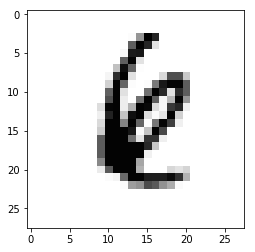

Pred value: 8
True value: 9


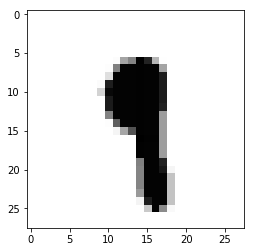

Pred value: 7
True value: 3


Pred value: 5
True value: 3


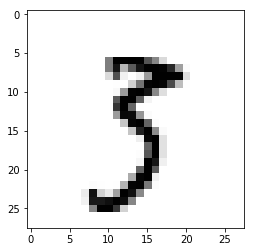

Pred value: 5
True value: 9


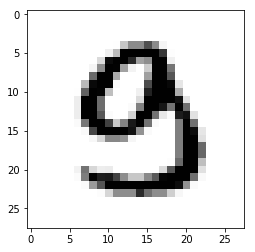

Pred value: 6
True value: 4


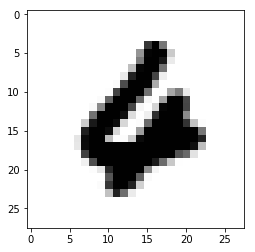

Pred value: 8
True value: 3


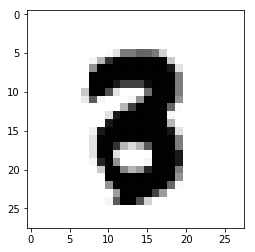

Pred value: 8
True value: 3


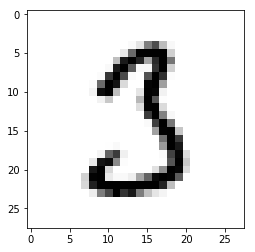

Pred value: 7
True value: 0


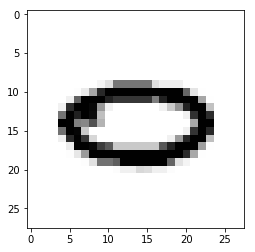

Pred value: 8
True value: 9


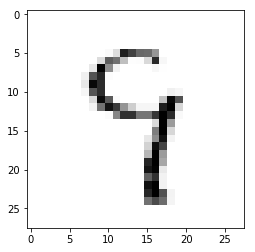

Pred value: 8
True value: 3


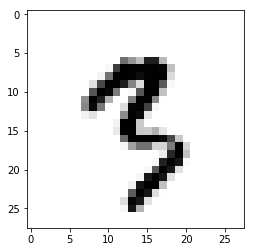

Pred value: 8
True value: 9


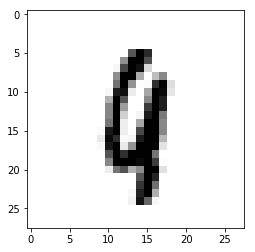

Pred value: 5
True value: 3


Pred value: 5
True value: 9


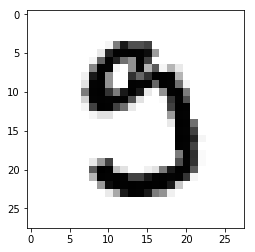

Pred value: 7
True value: 4


Pred value: 8
True value: 0


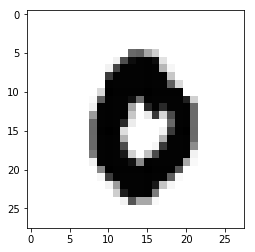

Pred value: 5
True value: 3


Pred value: 7
True value: 3


Pred value: 7
True value: 2


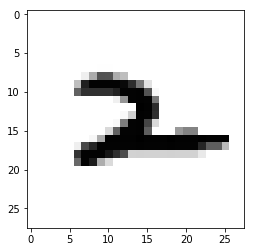

Pred value: 8
True value: 0


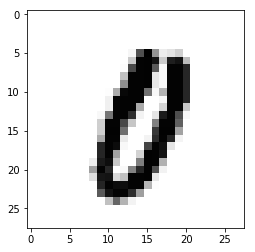

Pred value: 8
True value: 0


Pred value: 8
True value: 9


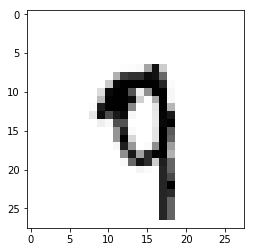

Pred value: 4
True value: 9


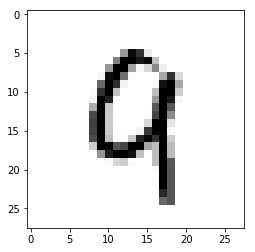

Pred value: 8
True value: 9


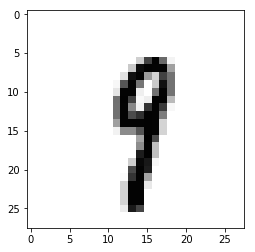

Pred value: 9
True value: 4


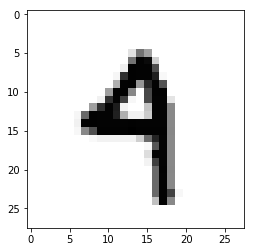

Pred value: 7
True value: 3


Pred value: 8
True value: 1


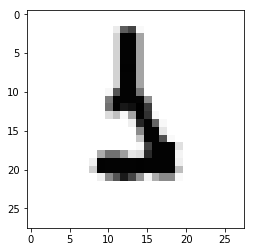

Pred value: 7
True value: 8


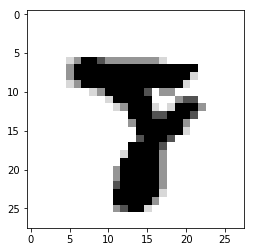

Pred value: 6
True value: 4


Pred value: 8
True value: 2


Pred value: 5
True value: 9


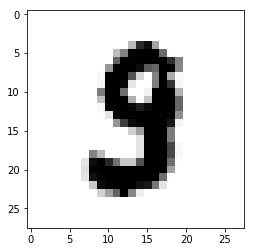

Pred value: 5
True value: 9


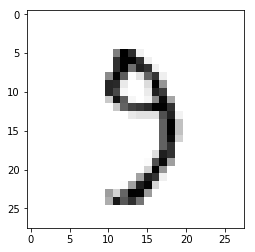

Pred value: 8
True value: 4


Pred value: 8
True value: 2


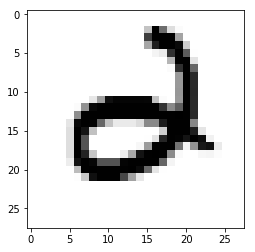

Pred value: 5
True value: 3


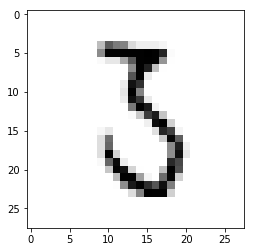

Pred value: 6
True value: 0


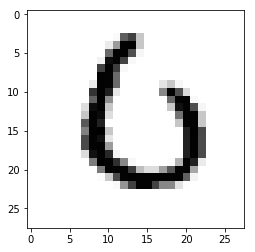

Pred value: 7
True value: 4


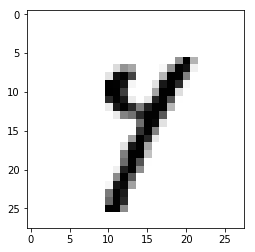

Pred value: 7
True value: 3


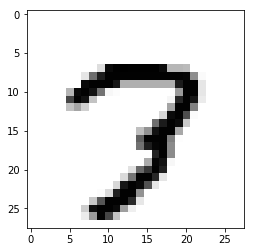

Pred value: 7
True value: 9


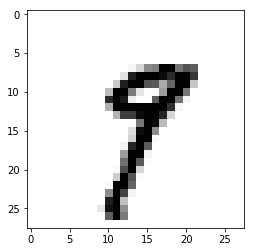

Pred value: 5
True value: 9


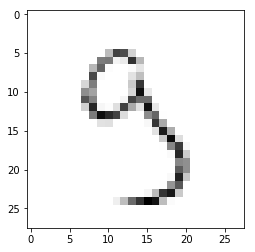

Pred value: 7
True value: 2


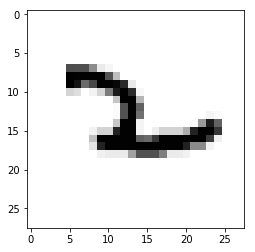

Pred value: 7
True value: 5


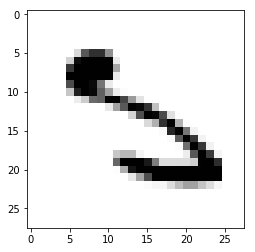

Pred value: 7
True value: 8


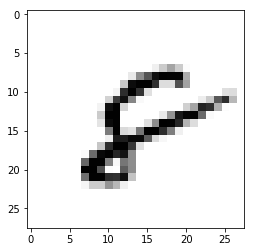

Pred value: 7
True value: 2


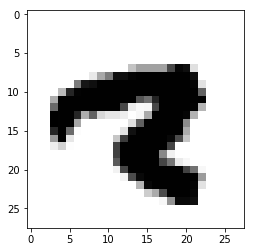

Pred value: 5
True value: 8


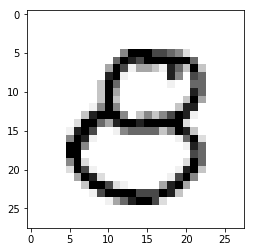

Pred value: 7
True value: 3


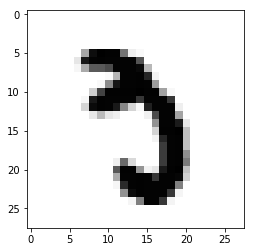

Pred value: 7
True value: 8


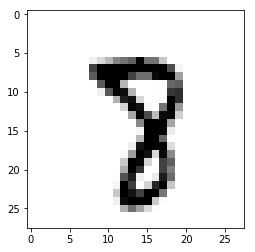

Pred value: 3
True value: 8


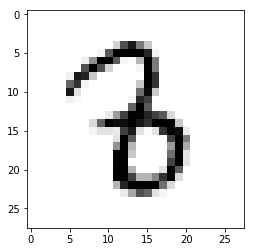

Pred value: 8
True value: 9


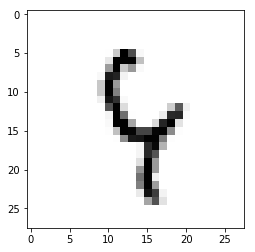

Pred value: 8
True value: 9


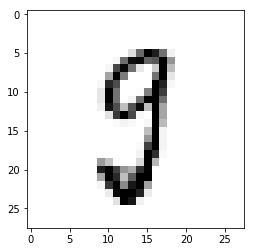

Pred value: 8
True value: 4


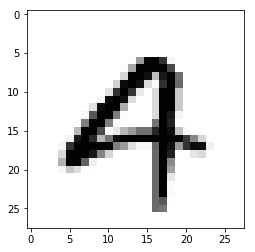

Pred value: 8
True value: 4


Pred value: 8
True value: 9


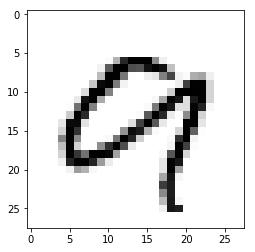

Pred value: 6
True value: 5


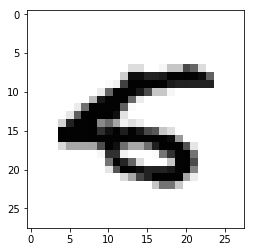

Pred value: 8
True value: 4


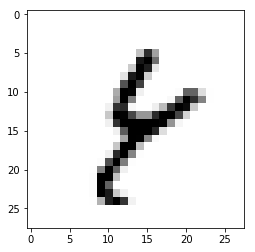

Pred value: 7
True value: 2


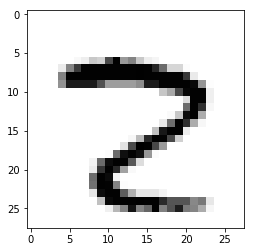

Pred value: 7
True value: 4


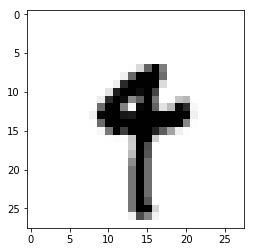

Pred value: 6
True value: 0


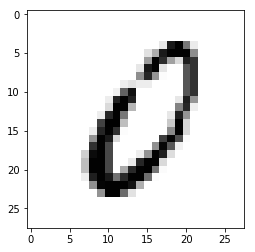

Pred value: 8
True value: 7


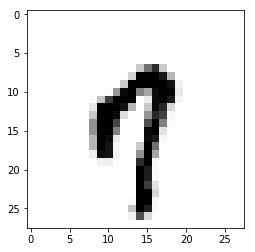

Pred value: 8
True value: 4


Pred value: 5
True value: 3


Pred value: 7
True value: 3


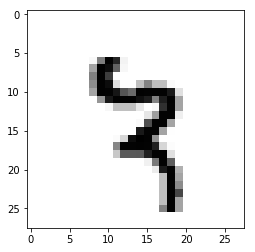

Pred value: 0
True value: 6


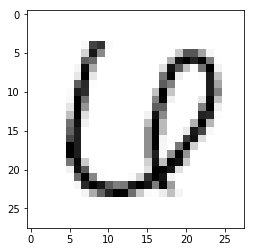

Pred value: 8
True value: 9


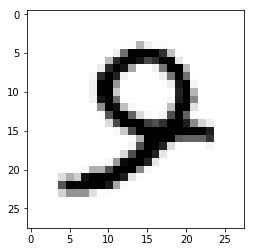

Pred value: 9
True value: 4


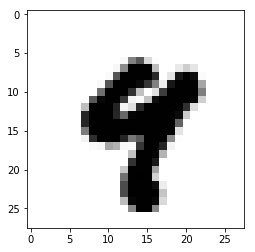

Pred value: 1
True value: 6


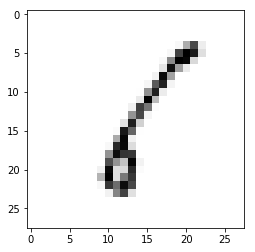

Pred value: 8
True value: 4


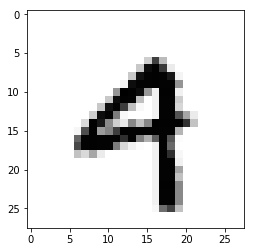

Pred value: 8
True value: 1


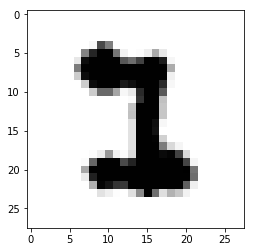

Pred value: 8
True value: 0


Pred value: 7
True value: 9


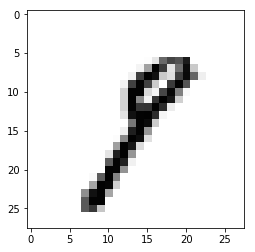

Pred value: 5
True value: 3


Pred value: 8
True value: 9


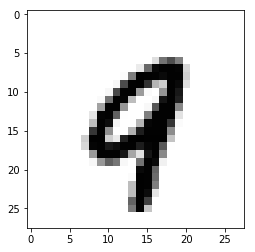

Pred value: 8
True value: 1


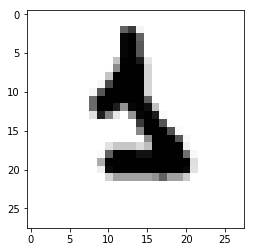

Pred value: 6
True value: 1


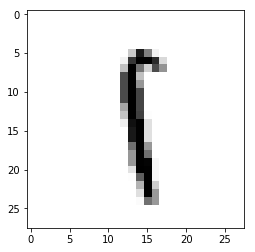

Pred value: 5
True value: 3


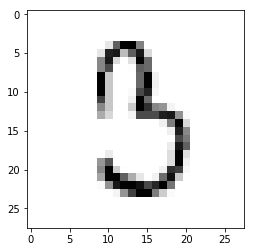

Pred value: 8
True value: 9


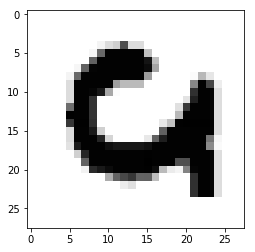

Pred value: 7
True value: 2


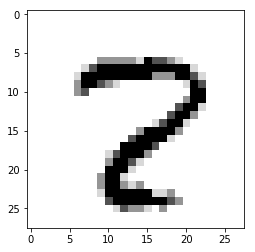

Pred value: 5
True value: 3


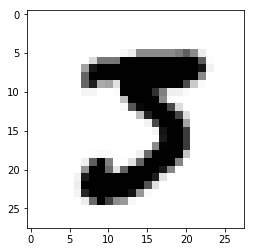

Pred value: 8
True value: 9


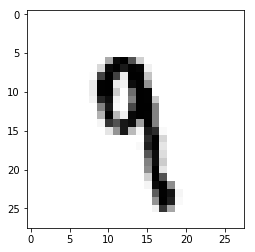

Pred value: 7
True value: 5


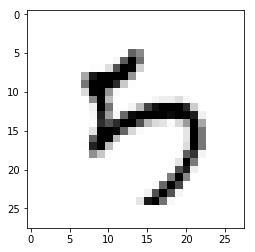

Pred value: 5
True value: 0


Pred value: 8
True value: 9


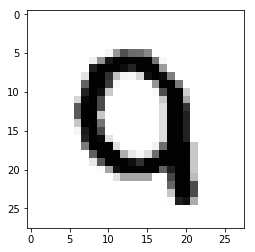

Pred value: 8
True value: 9


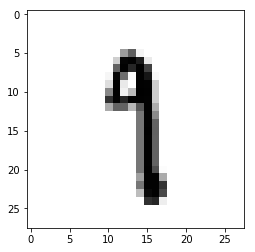

Pred value: 1
True value: 9


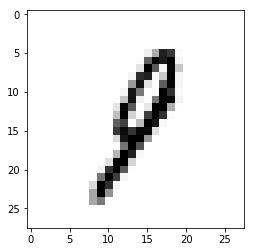

Pred value: 5
True value: 3


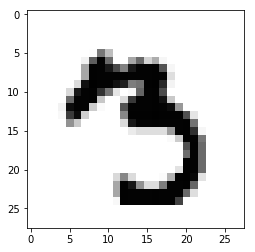

Pred value: 4
True value: 6


Pred value: 7
True value: 2


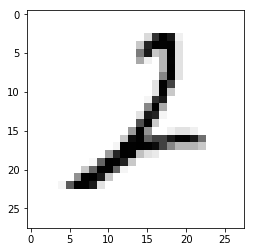

Pred value: 9
True value: 4


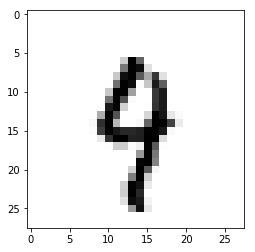

Pred value: 8
True value: 0


Pred value: 5
True value: 6


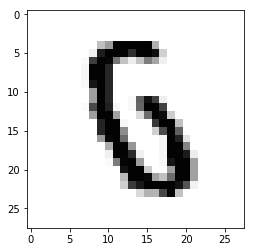

Pred value: 6
True value: 0


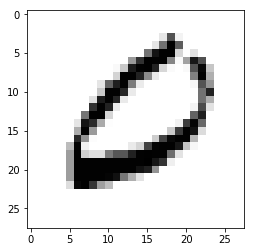

Pred value: 5
True value: 3


Pred value: 7
True value: 9


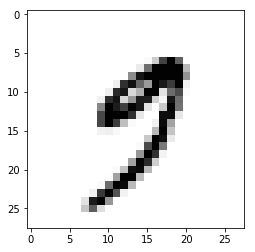

Pred value: 3
True value: 5


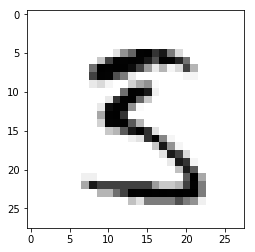

Pred value: 5
True value: 3


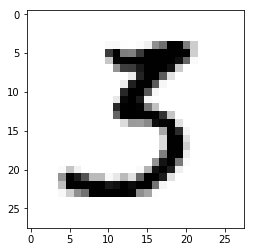

Pred value: 7
True value: 2


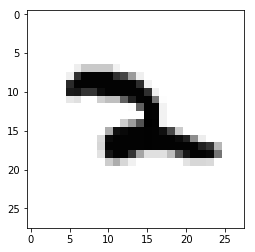

Pred value: 1
True value: 6


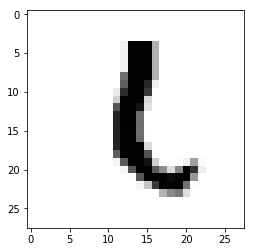

Pred value: 9
True value: 7


Pred value: 8
True value: 0


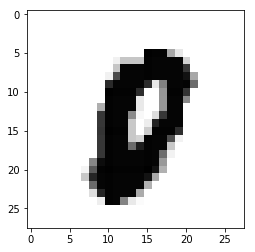

Pred value: 8
True value: 9


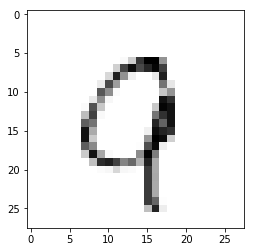

Pred value: 8
True value: 9


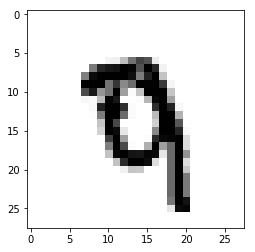

Pred value: 8
True value: 3


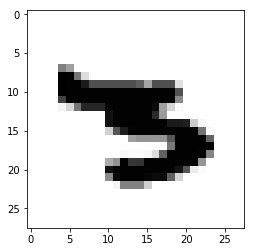

Pred value: 3
True value: 2


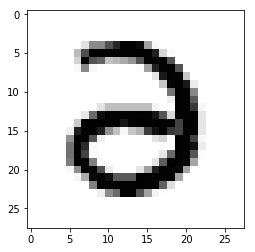

Pred value: 5
True value: 0


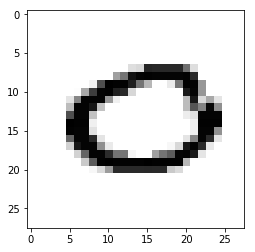

Pred value: 8
True value: 9


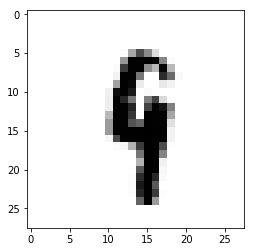

Pred value: 5
True value: 0


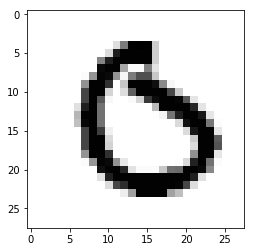

Pred value: 7
True value: 3


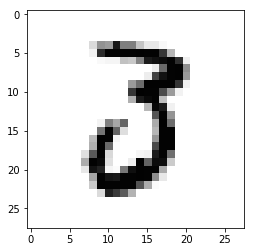

Pred value: 7
True value: 3


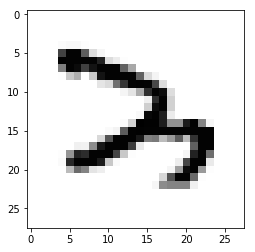

Pred value: 5
True value: 9


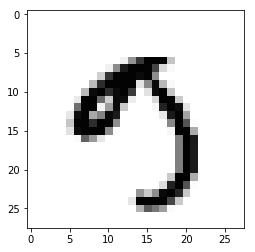

Pred value: 7
True value: 3


Pred value: 5
True value: 3


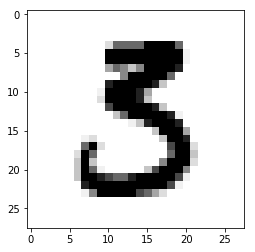

Pred value: 5
True value: 3


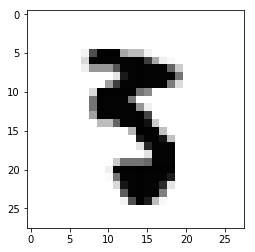

Pred value: 8
True value: 9


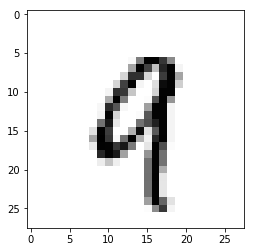

Pred value: 8
True value: 9


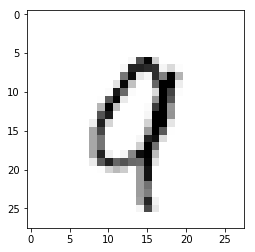

Pred value: 8
True value: 9


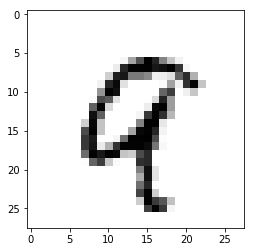

Pred value: 8
True value: 2


Pred value: 8
True value: 9


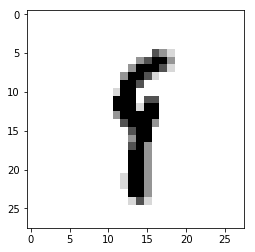

Pred value: 5
True value: 0


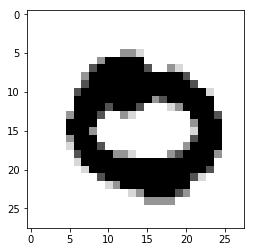

Pred value: 8
True value: 6


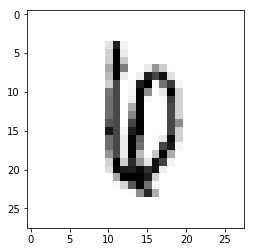

Pred value: 7
True value: 9


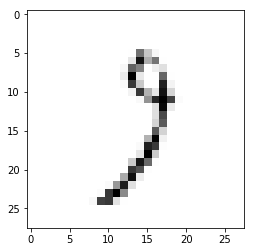

Pred value: 8
True value: 1


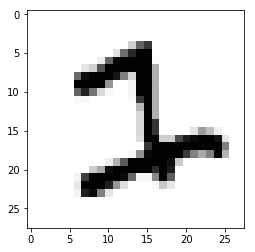

Pred value: 5
True value: 3


Pred value: 8
True value: 4


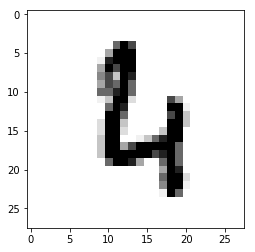

Pred value: 5
True value: 3


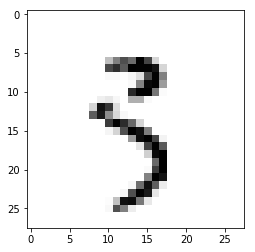

Pred value: 8
True value: 9


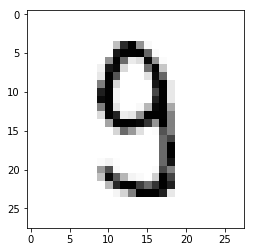

Pred value: 6
True value: 2


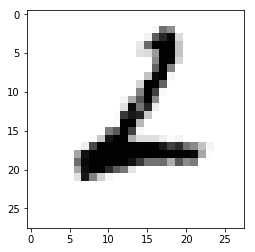

Pred value: 8
True value: 0


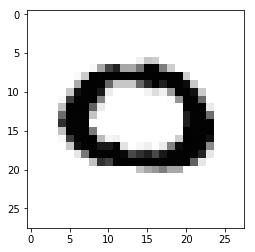

Pred value: 8
True value: 0


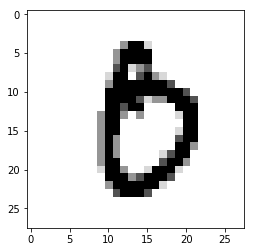

Pred value: 7
True value: 2


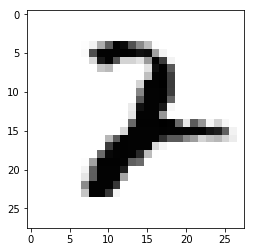

Pred value: 8
True value: 0


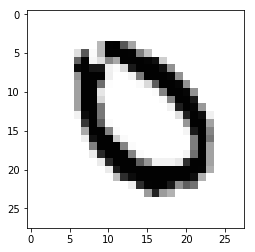

Pred value: 7
True value: 0


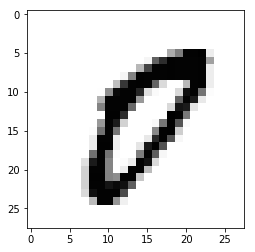

Pred value: 7
True value: 9


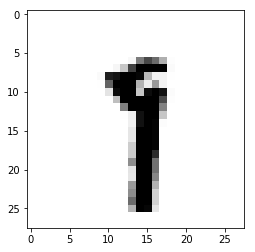

Pred value: 8
True value: 4


Pred value: 6
True value: 0


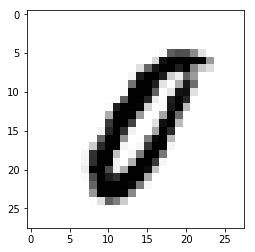

Pred value: 7
True value: 3


Pred value: 8
True value: 4


Pred value: 8
True value: 9


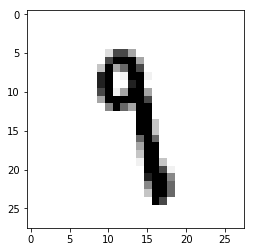

Pred value: 7
True value: 2


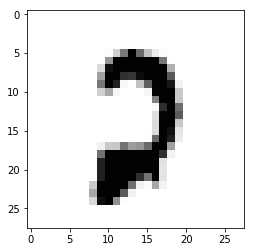

Pred value: 8
True value: 0


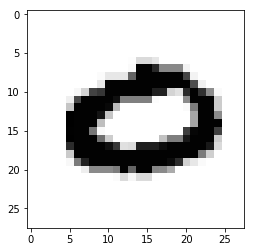

Pred value: 8
True value: 3


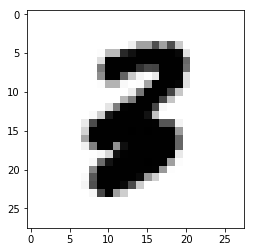

Pred value: 5
True value: 6


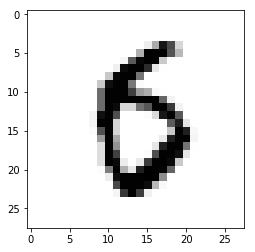

Pred value: 9
True value: 8


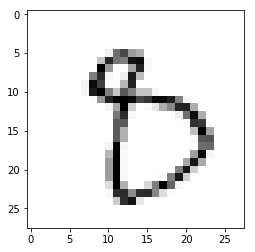

Pred value: 7
True value: 8


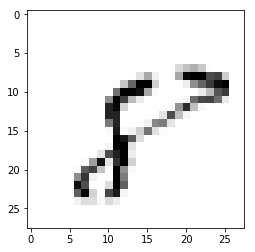

Pred value: 5
True value: 9


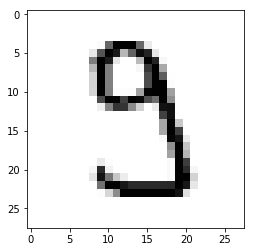

Pred value: 8
True value: 1


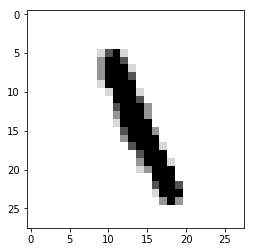

Pred value: 7
True value: 2


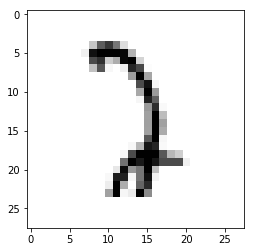

Pred value: 8
True value: 9


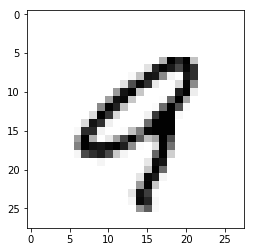

Pred value: 8
True value: 4


Pred value: 5
True value: 9


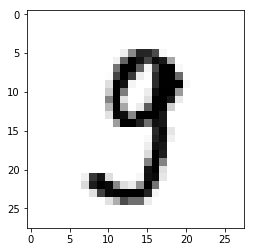

Pred value: 8
True value: 9


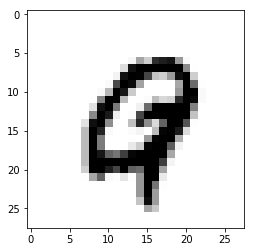

Pred value: 8
True value: 4


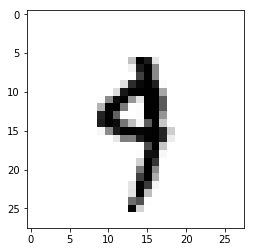

Pred value: 8
True value: 3


Pred value: 4
True value: 6


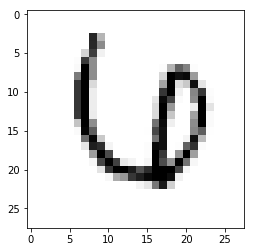

Pred value: 8
True value: 9


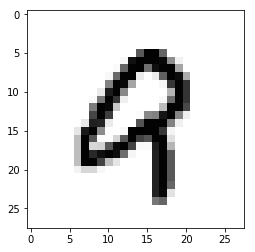

Pred value: 5
True value: 3


Pred value: 6
True value: 4


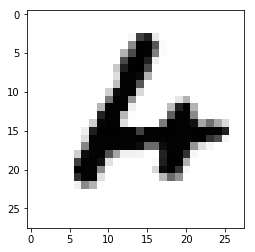

Pred value: 8
True value: 2


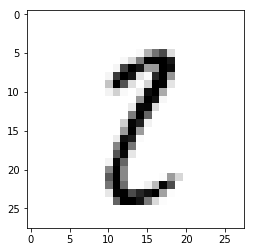

Pred value: 5
True value: 0


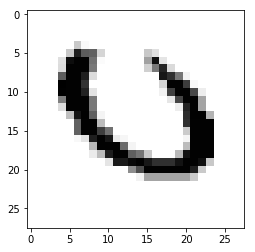

Pred value: 4
True value: 9


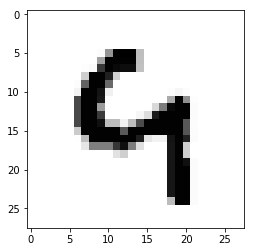

Pred value: 4
True value: 9


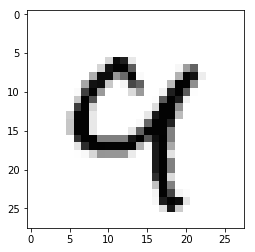

Pred value: 3
True value: 1


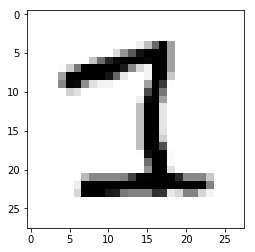

Pred value: 5
True value: 9


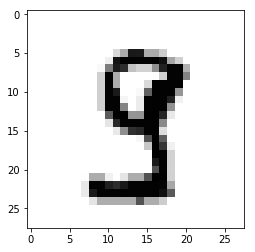

Pred value: 8
True value: 0


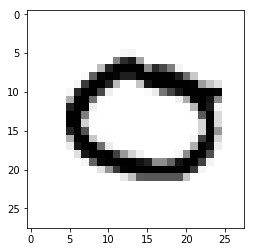

Pred value: 6
True value: 4


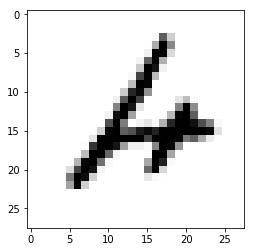

Pred value: 7
True value: 2


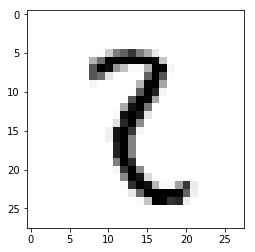

Pred value: 5
True value: 3


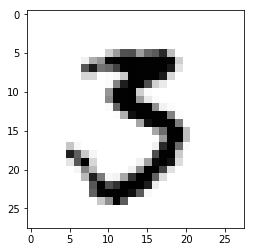

Pred value: 8
True value: 9


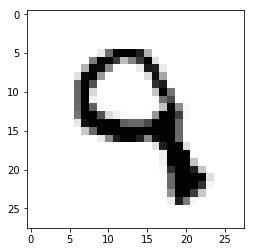

Pred value: 8
True value: 4


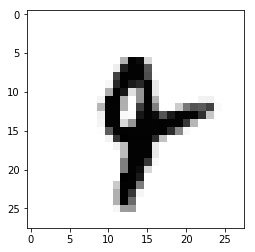

Pred value: 5
True value: 3


Pred value: 8
True value: 0


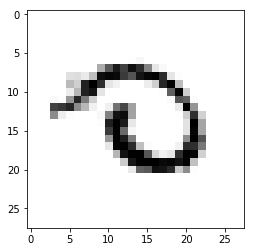

Pred value: 5
True value: 8


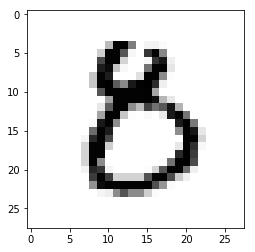

Pred value: 8
True value: 9


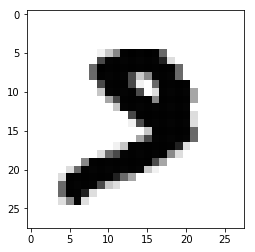

Pred value: 5
True value: 0


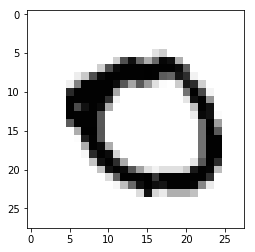

Pred value: 8
True value: 9


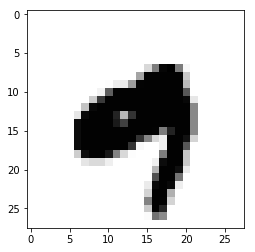

Pred value: 8
True value: 9


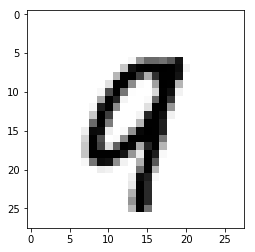

Pred value: 8
True value: 9


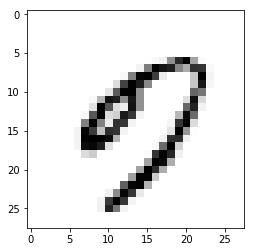

Pred value: 7
True value: 2


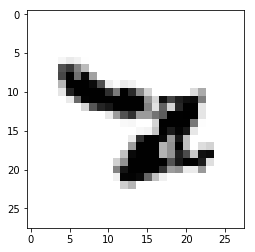

Pred value: 8
True value: 4


Pred value: 8
True value: 1


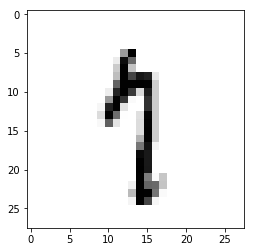

Pred value: 8
True value: 4


Pred value: 7
True value: 9


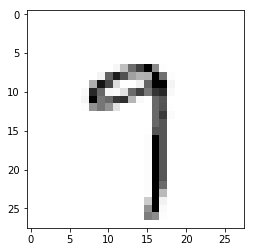

Pred value: 8
True value: 9


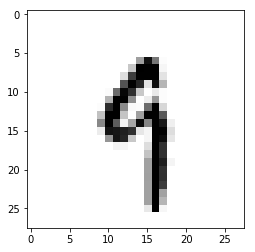

Pred value: 8
True value: 4


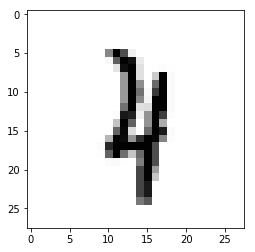

Pred value: 7
True value: 2


Pred value: 5
True value: 9


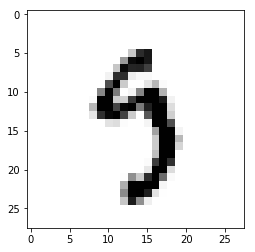

Pred value: 7
True value: 3


Pred value: 9
True value: 3


Pred value: 8
True value: 9


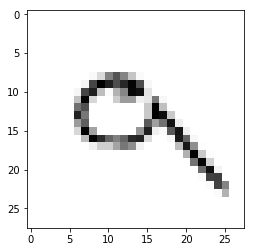

Pred value: 7
True value: 9


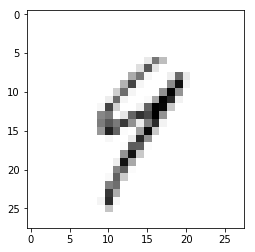

Pred value: 5
True value: 8


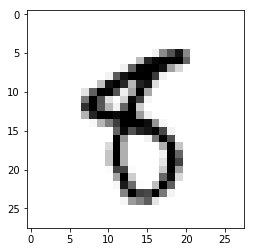

Pred value: 5
True value: 3


Pred value: 5
True value: 0


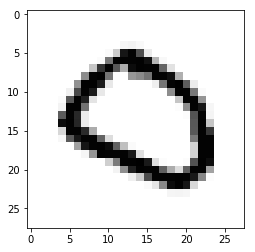

Pred value: 7
True value: 3


Pred value: 6
True value: 0


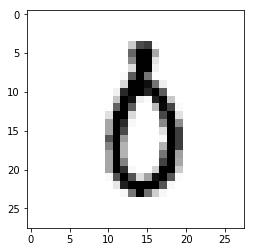

Pred value: 8
True value: 3


Pred value: 7
True value: 8


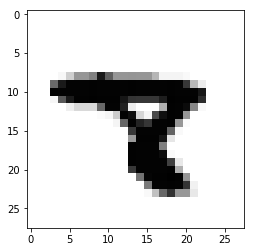

Pred value: 8
True value: 9


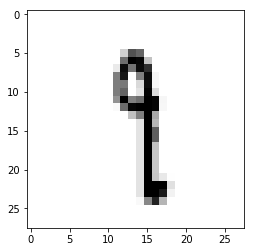

Pred value: 7
True value: 2


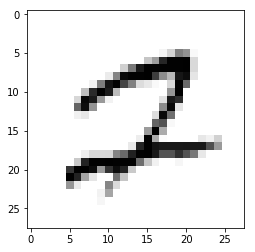

Pred value: 4
True value: 9


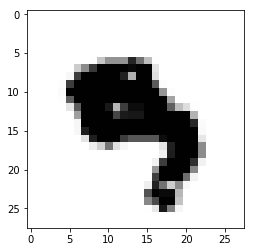

Pred value: 8
True value: 9


Pred value: 5
True value: 3


Pred value: 2
True value: 4


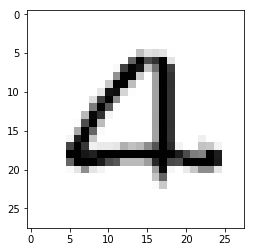

Pred value: 4
True value: 8


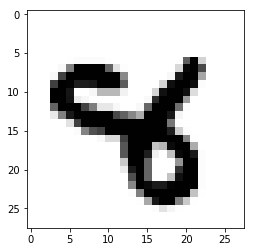

Pred value: 1
True value: 2


Pred value: 8
True value: 0


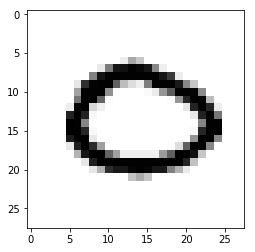

Pred value: 5
True value: 3


Pred value: 9
True value: 8


Pred value: 7
True value: 2


Pred value: 1
True value: 6


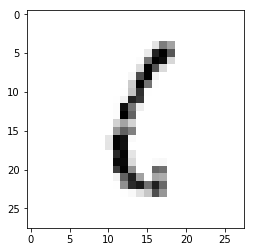

Pred value: 7
True value: 8


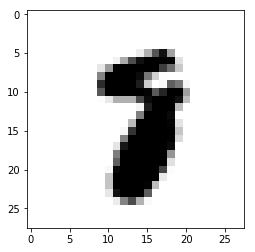

Pred value: 8
True value: 0


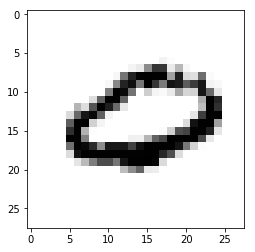

Pred value: 5
True value: 3


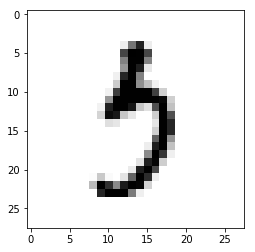

Pred value: 8
True value: 4


Pred value: 6
True value: 4


Pred value: 8
True value: 9


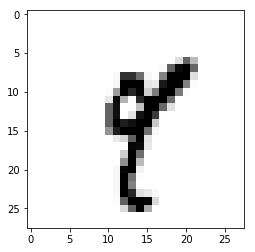

Pred value: 8
True value: 4


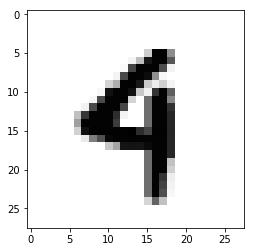

Pred value: 8
True value: 4


Pred value: 5
True value: 3


Pred value: 4
True value: 6


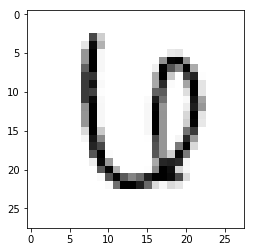

Pred value: 8
True value: 9


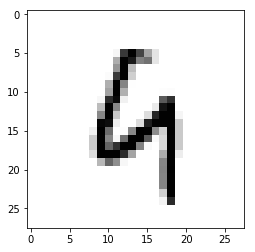

Pred value: 5
True value: 0


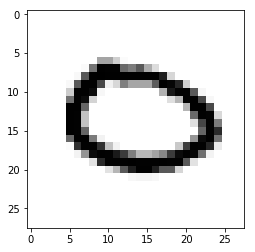

Pred value: 5
True value: 6


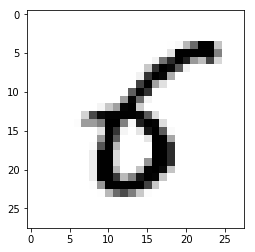

Pred value: 9
True value: 4


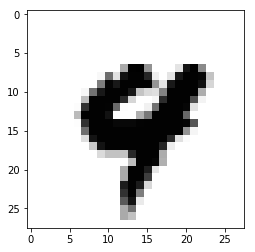

Pred value: 8
True value: 9


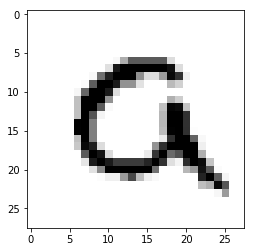

Pred value: 4
True value: 2


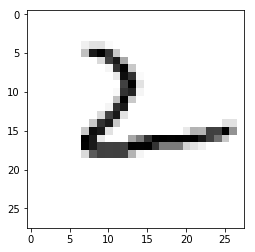

Pred value: 7
True value: 2


Pred value: 6
True value: 8


Pred value: 8
True value: 0


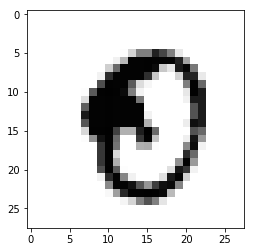

Pred value: 5
True value: 3


Pred value: 5
True value: 0


Pred value: 7
True value: 9


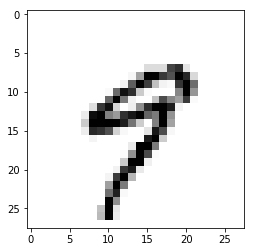

Pred value: 7
True value: 8


Pred value: 8
True value: 3


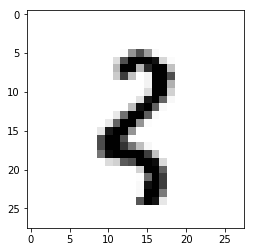

Pred value: 5
True value: 3


Pred value: 8
True value: 3


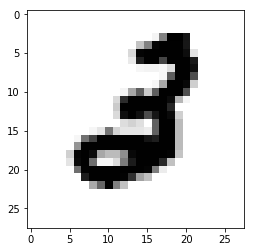

Pred value: 5
True value: 3


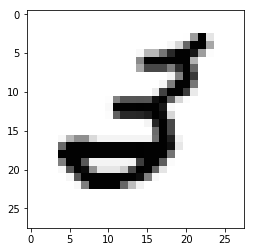

Pred value: 8
True value: 2


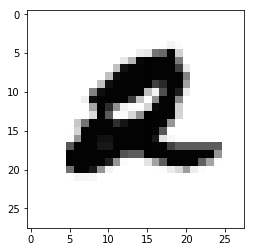

Pred value: 7
True value: 2


Pred value: 5
True value: 3


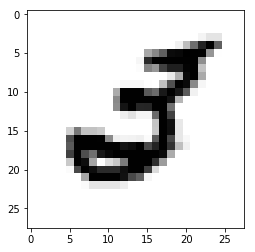

Pred value: 8
True value: 0


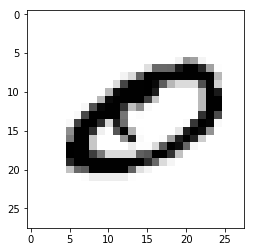

Pred value: 6
True value: 0


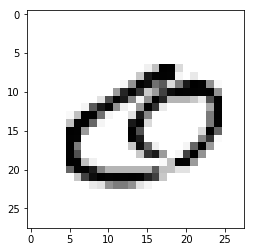

Pred value: 8
True value: 0


Pred value: 7
True value: 9


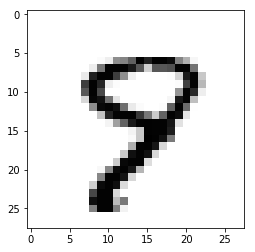

Pred value: 7
True value: 2


Pred value: 8
True value: 9


Pred value: 8
True value: 0


Pred value: 7
True value: 4


Pred value: 7
True value: 4


Pred value: 7
True value: 3


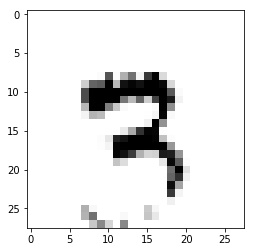

Pred value: 8
True value: 7


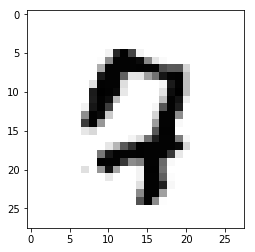

Pred value: 5
True value: 3


Pred value: 7
True value: 4


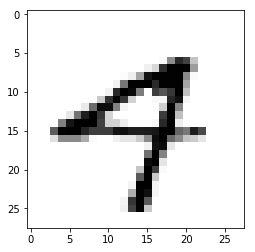

Pred value: 8
True value: 4


Pred value: 8
True value: 3


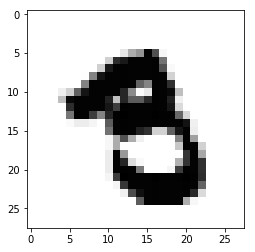

Pred value: 8
True value: 0


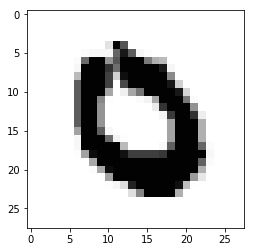

Pred value: 5
True value: 3


Pred value: 5
True value: 0


Pred value: 8
True value: 3


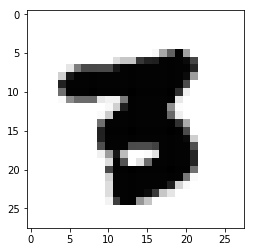

Pred value: 5
True value: 9


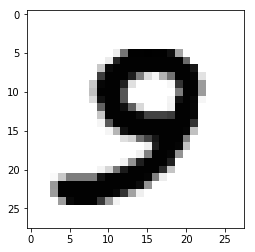

Pred value: 5
True value: 9


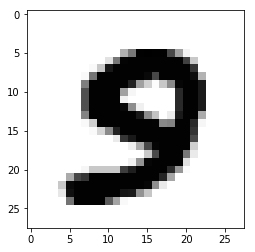

Pred value: 5
True value: 9


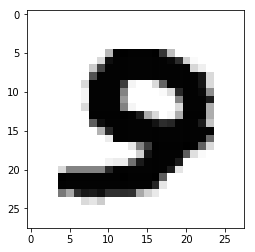

Pred value: 5
True value: 9


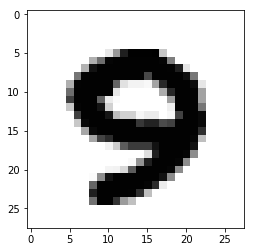

Pred value: 8
True value: 9


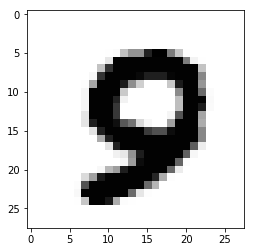

Pred value: 5
True value: 9


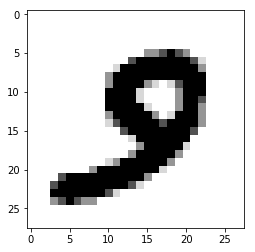

Pred value: 5
True value: 9


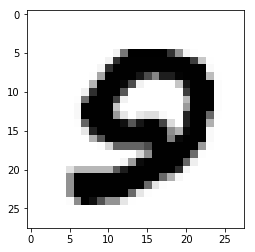

Pred value: 8
True value: 9


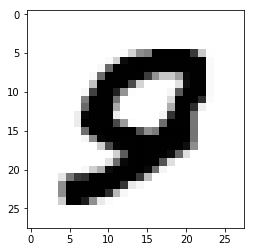

Pred value: 8
True value: 2


Pred value: 7
True value: 2


Pred value: 8
True value: 9


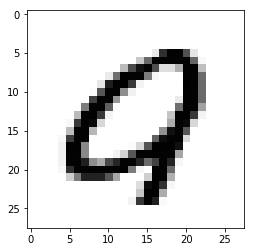

Pred value: 8
True value: 2


Pred value: 7
True value: 8


Pred value: 8
True value: 9


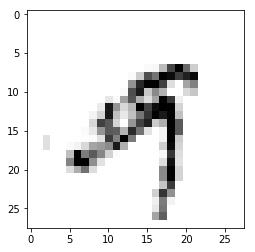

Pred value: 7
True value: 9


Pred value: 7
True value: 3


Pred value: 7
True value: 9


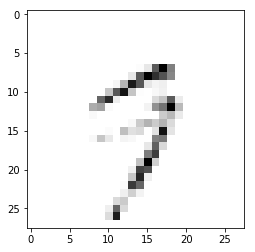

Pred value: 7
True value: 1


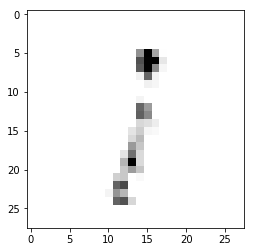

Pred value: 6
True value: 2


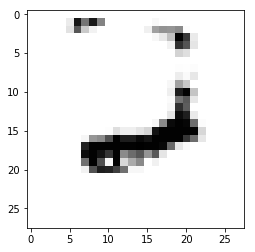

Pred value: 8
True value: 9


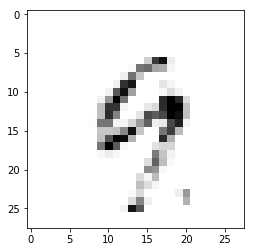

Pred value: 7
True value: 0


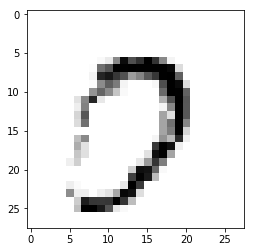

Pred value: 5
True value: 9


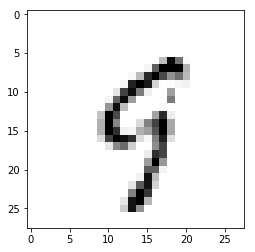

Pred value: 7
True value: 8


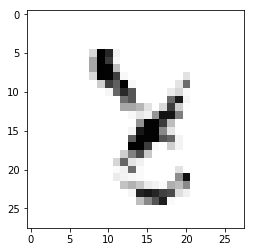

Pred value: 7
True value: 9


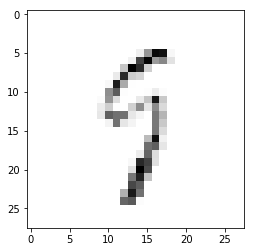

Pred value: 7
True value: 2


Pred value: 8
True value: 0


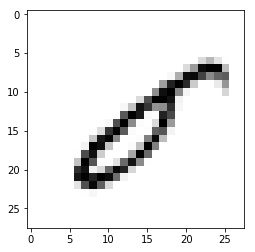

Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 5
True value: 3


Pred value: 3
True value: 8


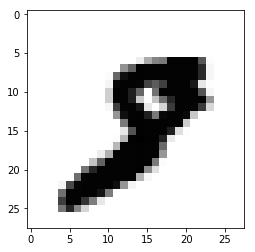

Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 9


Pred value: 8
True value: 9


Pred value: 8
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 6
True value: 0


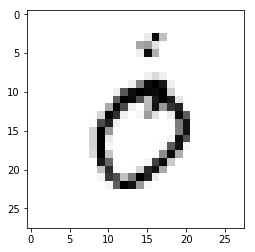

Pred value: 7
True value: 2


Pred value: 5
True value: 3


Pred value: 7
True value: 2


Pred value: 5
True value: 3


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 9


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 3


Pred value: 7
True value: 3


Pred value: 8
True value: 5


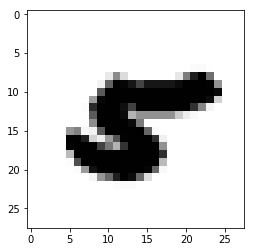

Pred value: 8
True value: 3


Pred value: 8
True value: 2


Pred value: 8
True value: 2


Pred value: 8
True value: 4


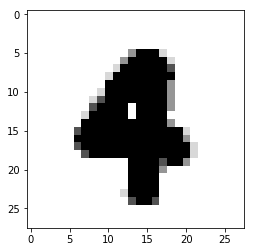

Pred value: 8
True value: 4


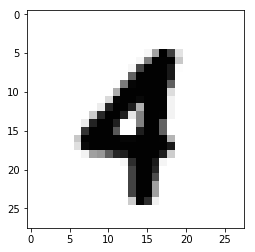

Pred value: 6
True value: 4


Pred value: 8
True value: 2


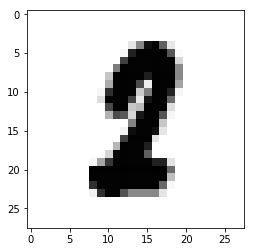

Pred value: 1
True value: 4


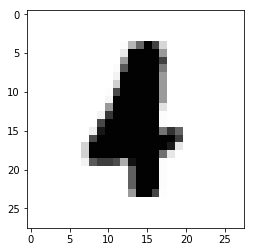

Pred value: 8
True value: 4


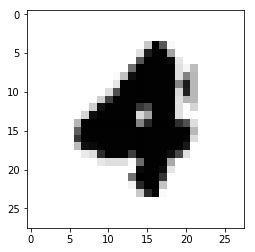

Pred value: 8
True value: 3


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 5
True value: 0


Pred value: 7
True value: 2


Pred value: 8
True value: 3


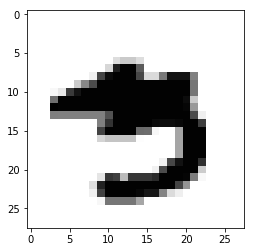

Pred value: 7
True value: 2


Pred value: 5
True value: 3


Pred value: 8
True value: 4


Pred value: 7
True value: 2


Pred value: 5
True value: 3


Pred value: 8
True value: 0


Pred value: 7
True value: 8


Pred value: 5
True value: 3


Pred value: 7
True value: 2


Pred value: 5
True value: 3


Pred value: 7
True value: 2


Pred value: 2
True value: 7


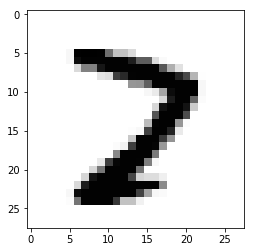

Pred value: 7
True value: 2


Pred value: 6
True value: 0


Pred value: 7
True value: 9


Pred value: 7
True value: 2


Pred value: 8
True value: 2


Pred value: 2
True value: 0


Pred value: 0
True value: 3


Pred value: 8
True value: 4


Pred value: 8
True value: 4


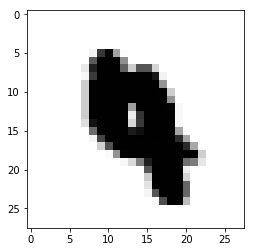

Pred value: 5
True value: 3


Pred value: 8
True value: 0


Pred value: 8
True value: 0


Pred value: 8
True value: 0


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 9


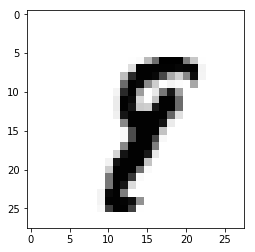

Pred value: 7
True value: 9


Pred value: 7
True value: 9


Pred value: 7
True value: 2


Pred value: 7
True value: 2


Pred value: 7
True value: 9


Pred value: 7
True value: 0


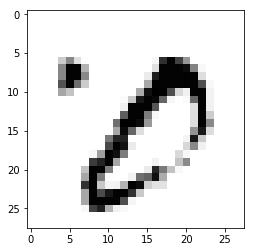

Pred value: 5
True value: 3


Pred value: 7
True value: 9


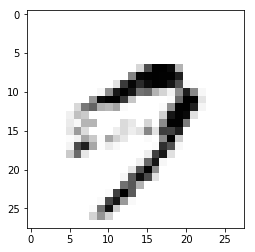

Pred value: 5
True value: 3


Pred value: 7
True value: 2


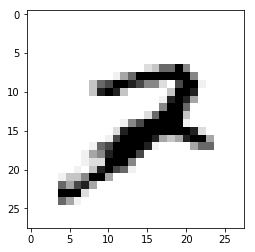

Pred value: 7
True value: 4


Pred value: 7
True value: 2


Pred value: 7
True value: 9


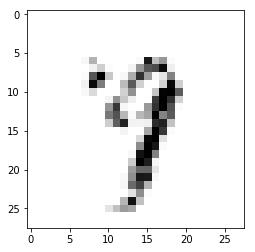

Pred value: 7
True value: 2


Pred value: 8
True value: 2


Pred value: 6
True value: 5


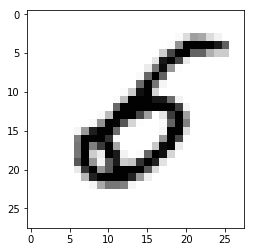

Pred value: 3
True value: 2


Pred value: 7
True value: 2


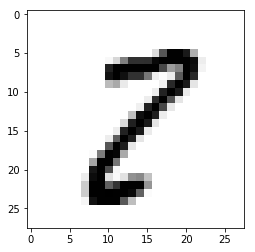

Pred value: 5
True value: 3


Pred value: 8
True value: 9


Pred value: 7
True value: 2


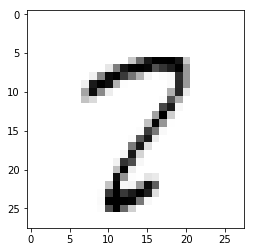

Pred value: 8
True value: 0


Pred value: 5
True value: 9


Pred value: 8
True value: 0


Pred value: 8
True value: 2


Pred value: 7
True value: 3


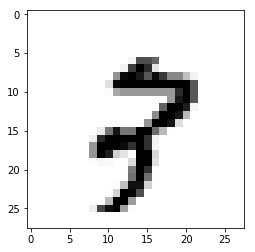

Pred value: 7
True value: 2


Pred value: 8
True value: 0


In [0]:
# Loading dataset
(train_x, y_train), (test_x, y_test) = tf.keras.datasets.mnist.load_data()
# Reshaping the array to 4-dims so that it can work with the Keras API
x_train = train_x.reshape(train_x.shape[0], 28, 28, 1)
x_test = test_x.reshape(test_x.shape[0], 28, 28, 1)
input_shape = (28, 28, 1)
# Making sure that the values are float so that we can get decimal points after division
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
# Normalizing the RGB codes by dividing it to the max RGB value.
#x_train /= 255
#x_test /= 255
print('x_train shape:', x_train.shape)
print('Number of images in x_train', x_train.shape[0])
print('Number of images in x_test', x_test.shape[0])
# Creating a Sequential Model and adding the layers
model = Sequential()
model.add(Conv2D(28, kernel_size=(5,5), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(4, 4)))
model.add(Conv2D(28, kernel_size=(3,3), input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten()) # Flattening the 2D arrays for fully connected layers
model.add(Dense(100, activation=tf.nn.relu))
model.add(Dropout(0.5))      
model.add(Dense(10,activation=tf.nn.softmax))
print(model.summary())
model.compile(optimizer='adam', 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)
his = model.fit(x=x_train,y=y_train, epochs=50)
_, train_acc = model.evaluate(x_train, y_train, verbose=0)
_, test_acc = model.evaluate(x_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
y_pred = model.predict(x_test)
print(y_pred.shape)
print(y_test.shape)
y = np.argmax(y_pred, axis=1)
print(y.shape)
confusion_matrix(y_test, y)
for i in range(10000):
    if(y[i] != y_test[i]):
        print("Pred value:",y[i])
        print("True value:",y_test[i])
        plt.figure
        plt.imshow(x_test[i].reshape(28, 28),cmap='Greys')
        plt.show()